In [1]:
import cv2 as cv
import numpy as np
from  matplotlib import pyplot as plt
%matplotlib inline
import math
import copy as cp
import os 
from PIL import Image

In [2]:
path=r'D:\Documents\WeChat Files\wxid_txb2wzx5w29u22\FileStorage\File\2022-12\xuexi'
wjm=os.listdir(path)
tp_path=[]
for i in wjm:
    dis='%s\%s'%(path,i)
    tp_path.append(dis)
a=tp_path[7]

In [3]:
a

'D:\\Documents\\WeChat Files\\wxid_txb2wzx5w29u22\\FileStorage\\File\\2022-12\\xuexi\\id1_img100_t20221206_084759.206.jpg'

In [4]:
#  cv.imshow('otsu_img ',gray_img)         
#  cv.waitKey(0)
#  cv.destroyAllWindows()

In [2]:
def huoqu_lj():
    path=r'D:\Documents\WeChat Files\wxid_txb2wzx5w29u22\FileStorage\File\2022-12\xuexi'
    wjm=os.listdir(path)
    tp_path=[]
    for i in wjm:
        dis='%s\%s'%(path,i)
        tp_path.append(dis) 
    return tp_path

#转换通道位置
def RGB_ZB(sets):
    b,g,r=cv.split(sets)
    m=cv.merge((r,g,b))
    return m

#展现图片
def TP_JZ(path):
    f=path
    d=RGB_ZB(cv.imread(f,cv.IMREAD_COLOR))
    d_h=cv.imread(f,cv.IMREAD_GRAYSCALE)
    list_t=[d,d_h]
    N=2
    M=3
    fig=plt.figure(figsize=(16,10))
    for i  in  range(len(list_t)):
        plt.subplot(N,M,i+1)#表示第i张图片，下标只能从1开始，不能从0，
        plt.imshow(list_t[i])
        #下面两行是消除每张图片自己单独的横纵坐标，不然每张图片会有单独的横纵坐标，影响美观
        plt.xticks([])
        plt.yticks([])
    return d,d_h 


def TP_JZ_SS(path):
    d=RGB_ZB(cv.imread(path,cv.IMREAD_COLOR))
    d_h=cv.cvtColor(d,cv.COLOR_RGB2GRAY) 
    return  d,d_h 



#使用灰度图，计算二值化的阈值
def ostu(d_h):
    gray_img=d_h
    h = gray_img.shape[0]
    w = gray_img.shape[1]
    threshold_t = 0
    max_g = 0
    
    # 遍历每一个灰度层
    for t in range(255):
        n0 = gray_img[np.where(gray_img < t)]
        n1 = gray_img[np.where(gray_img >= t)]
        w0 = len(n0) / (h * w)
        w1 = len(n1) / (h * w)
        u0 = np.mean(n0) if len(n0) > 0 else 0.
        u1 = np.mean(n1) if len(n0) > 0 else 0.
        
        g = w0 * w1 * (u0 - u1) ** 2
        if g > max_g:
            max_g = g
            threshold_t = t
    print('类间方差最大阈值：', threshold_t)
   
    gray_img[gray_img < threshold_t] = 0
    gray_img[gray_img >= threshold_t] = 255
    
    IMG_OUT= cv.cvtColor(gray_img,cv.COLOR_GRAY2RGB)  #转换成rgb的通道
    
    plt.imshow(IMG_OUT)
    plt.show()
    
    return gray_img   
#     显示
#     cv.namedWindow('otsu_img', 0)    
#     cv.namedWindow('img', cv.WINDOW_NORMAL)


#     cv.imshow('otsu_img ', gray_img)
#     cv.waitKey(0)
#     cv.destroyAllWindows()
#     return  gray_img

# #公用图片展示
# def zxtp(b):
    
# #     cv.namedWindow('input',cv.WINDOW_NORMAL)
# #         # # 显示
# #     cv2.namedWindow('findCorners', 0)    
#     cv.resizeWindow('findCorners', 700, 900)   # 自己设定窗口图片的大小
# #     cv2.imshow("findCorners", img)
# #     cv2.waitKey(0)
# #     cv2.destroyAllWindows()

#     cv.imshow('otsu_img ', b)
#     cv.waitKey(0)
#     cv.destroyAllWindows()

def ostu_1(a,b):
    a[a < b] = 0
    a[a >=b] = 255
    return(a)
def huakuang_ss(otsu_img,d):
    asdas=[]
    for i in range(otsu_img.shape[0]):
        for j  in range(otsu_img.shape[1]):
            asdas.append(otsu_img[i][j])
    first = last = -1
    flag = False
    for chengluo in range(len(asdas)):
        if asdas[chengluo] == 0:
            if not flag:
                first = last = chengluo    ##什么爱情1000   100
                flag = True
            else:
                last = chengluo
    #print(first,last)
    zuo_1=(first+1)//otsu_img.shape[1]
    zuo_0=first-otsu_img.shape[1]*zuo_1

    you_1=otsu_img.shape[0]-((otsu_img.shape[0]*otsu_img.shape[1]-last-1)//otsu_img.shape[1])-1
    you_0=last-(you_1*otsu_img.shape[1])
  
    zhijin=you_1-zuo_1
    zuo_left=0
    zuo_right=0
    if zuo_0>you_0:
        zuo_left=zuo_0-zhijin/2-15
        zuo_right=you_0+zhijin/2+15    
    else:
        zuo_left=you_0-zhijin/2-15
        zuo_right=zuo_0+zhijin/2+15
    zuo_1=zuo_1-15
    you_1=you_1+15
    
    c=d
    r,g,b= cv.split(c)
    for i in range(r.shape[0]):
        for j in range(r.shape[1]):
            if j==zuo_left or j==zuo_right:
                if i>=zuo_1 and i<=you_1:
                    r[i][j]=255
            if i==zuo_1  or i==you_1:
                if j>=zuo_left  and j<=zuo_right:
                    r[i][j]=255 
                    
    for i in range(g.shape[0]):
        for j in range(g.shape[1]):
            if j==zuo_left or j==zuo_right:
                if i>=zuo_1 and i<=you_1:
                    g[i][j]=0
            if i==zuo_1  or i==you_1:
                if j>=zuo_left  and j<=zuo_right:
                    g[i][j]=0
    for i in range(b.shape[0]):
        for j in range(b.shape[1]):
            if j==zuo_left or j==zuo_right:
                if i>=zuo_1 and i<=you_1:
                    b[i][j]=0
            if i==zuo_1  or i==you_1:
                if j>=zuo_left  and j<=zuo_right:
                    b[i][j]=0
   
 

#     for i in range(g.shape[0]):
#         for j in range(g.shape[1]):
#             if j==zuo_b or j==zuo_y:
#                 if i>=zuo_1 and i<=you_1:
#                     g[i][j]=0
#             if j==zuo_1  or j==you_1:
#                 if j>=zuo_b and j<=zuo_y:
#                     g[i][j]=0 

#     for i in range(b.shape[0]):
#         for j in range(b.shape[1]):
#             if j==zuo_b or j==zuo_y:
#                 if i>=zuo_1 and i<=you_1:
#                     b[i][j]=0

#             if j==zuo_1  or j==you_1:
#                 if j>=zuo_b and j<=zuo_y:
#                     b[i][j]=0
    a=(int(zuo_1),int(you_1),int(zuo_left),int(zuo_right))                
    out_jpg=cv.merge((r,g,b))
    plt.imshow(out_jpg)
    plt.show()
    
    mianji=(you_1-zuo_1)*(zuo_right-zuo_left)
    return  out_jpg,mianji,a



#画出画框    
def huakuang(otsu_img,d):
    asdas=[]
    for i in range(otsu_img.shape[0]):
        for j  in range(otsu_img.shape[1]):
            asdas.append(otsu_img[i][j])
    first = last = -1
    flag = False
    for chengluo in range(len(asdas)):
        if asdas[chengluo] == 0:
            if not flag:
                first = last = chengluo    ##什么爱情1000   100
                flag = True
            else:
                last = chengluo
    print(first,last)
    zuo_1=(first+1)//otsu_img.shape[1]
    zuo_0=first-otsu_img.shape[1]*zuo_1
    print('行是%d，列是%d '%(zuo_1,zuo_0))
    you_1=otsu_img.shape[0]-((otsu_img.shape[0]*otsu_img.shape[1]-last-1)//otsu_img.shape[1])-1
    you_0=last-(you_1*otsu_img.shape[1])
    print('行是%d,列是%d'%(you_1,you_0))
    
    zhijin=you_1-zuo_1
    zuo_left=0
    zuo_right=0
    if zuo_0>you_0:
        zuo_left=zuo_0-zhijin/2-15
        zuo_right=you_0+zhijin/2+15    
    else:
        zuo_left=you_0-zhijin/2-15
        zuo_right=zuo_0+zhijin/2+15
    zuo_1=zuo_1-15
    you_1=you_1+15
    
    c=d
    r,g,b= cv.split(c)
    for i in range(r.shape[0]):
        for j in range(r.shape[1]):
            if j==zuo_left or j==zuo_right:
                if i>=zuo_1 and i<=you_1:
                    r[i][j]=255
            if i==zuo_1  or i==you_1:
                if j>=zuo_left  and j<=zuo_right:
                    r[i][j]=255 
                    
    for i in range(g.shape[0]):
        for j in range(g.shape[1]):
            if j==zuo_left or j==zuo_right:
                if i>=zuo_1 and i<=you_1:
                    g[i][j]=0
            if i==zuo_1  or i==you_1:
                if j>=zuo_left  and j<=zuo_right:
                    g[i][j]=0
    for i in range(b.shape[0]):
        for j in range(b.shape[1]):
            if j==zuo_left or j==zuo_right:
                if i>=zuo_1 and i<=you_1:
                    b[i][j]=0
            if i==zuo_1  or i==you_1:
                if j>=zuo_left  and j<=zuo_right:
                    b[i][j]=0
   
 

#     for i in range(g.shape[0]):
#         for j in range(g.shape[1]):
#             if j==zuo_b or j==zuo_y:
#                 if i>=zuo_1 and i<=you_1:
#                     g[i][j]=0
#             if j==zuo_1  or j==you_1:
#                 if j>=zuo_b and j<=zuo_y:
#                     g[i][j]=0 

#     for i in range(b.shape[0]):
#         for j in range(b.shape[1]):
#             if j==zuo_b or j==zuo_y:
#                 if i>=zuo_1 and i<=you_1:
#                     b[i][j]=0

#             if j==zuo_1  or j==you_1:
#                 if j>=zuo_b and j<=zuo_y:
#                     b[i][j]=0
    a=(int(zuo_1),int(you_1),int(zuo_left),int(zuo_right))                
    out_jpg=cv.merge((r,g,b))
    plt.imshow(out_jpg)
    plt.show()
    
    mianji=(you_1-zuo_1)*(zuo_right-zuo_left)
    print(mianji)
    return  out_jpg,mianji,a
def tishi(xianshi,mianji):
    if xianshi<mianji*0.85 or xianshi>mianji*1.15:
        print("抠图失败")
        a=1
    else:
        a=2
        print("抠图成功")
    return a

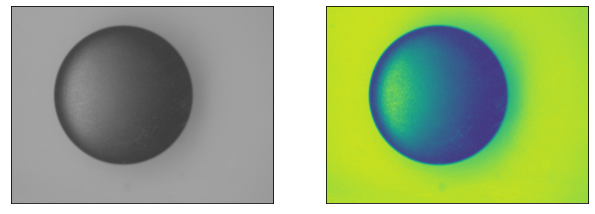

In [29]:
yuantu,huidutu=TP_JZ(a)

类间方差最大阈值： 119


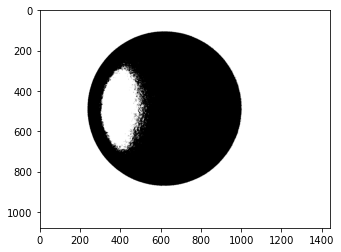

In [30]:
erzhi_t=ostu(huidutu)

#### 对于整数图像是0和255
#### 对于浮点图像是0和1
#### 这就跟选择题一样，要么为0要么为1
#### 对于整数图像最小值为00000000，最大值为11111111
#### 即为0和255

### kernel = np.ones((5, 5), np.uint8)
### 图像的膨胀和腐蚀都是相对于高亮区域的

### 图像的腐蚀，默认迭代次数
erosion = cv.erode(erzhi_t, kernel)
### 图像的膨胀
dst = cv.dilate(erosion, kernel)
### 先腐蚀后膨胀也叫做开运算.
cv.imshow('fushi',erosion)
cv.imshow('pengzhang',dst)
cv.waitKey(0)
cv.destroyAllWindows()

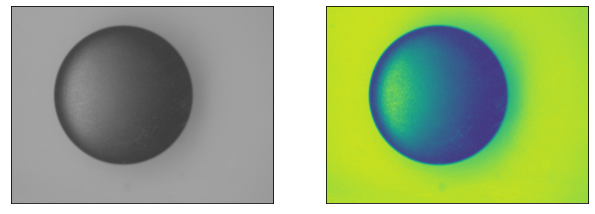

In [7]:
yuantu,huidutu=TP_JZ(a)

类间方差最大阈值： 1


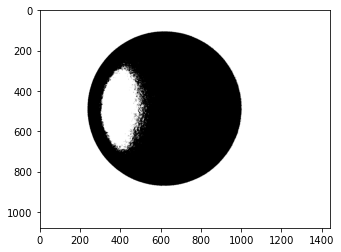

In [9]:
erzhi_t=ostu(huidutu)

151808 1254844
行是105，列是608 
行是871,列是604


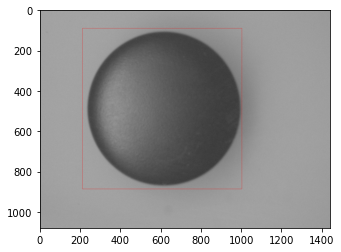

630432.0


In [13]:
kout,mianji,jiequ=huakuang(erzhi_t,yuantu)

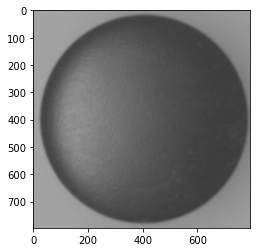

In [14]:
jietu=kout[jiequ[0]:jiequ[1],jiequ[2]:jiequ[3]]  
plt.imshow(jietu)
plt.show()

In [15]:
biaozhun=mianji

In [16]:
tishi(jietu.shape[0]*jietu.shape[1],mianji)

抠图成功


2

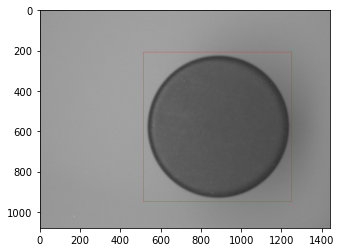

NameError: name 'biaozhun' is not defined

In [67]:
Path=huoqu_lj()
for i in range(len(Path)):
    yuantu,huidutu=TP_JZ_SS(Path[i])
    erzhi_t=ostu_1(huidutu,119)
    kout,cn,jiequ=huakuang_ss(erzhi_t,yuantu)
    jietu=kout[jiequ[0]:jiequ[1],jiequ[2]:jiequ[3]]  
    xinhao=tishi(cn,biaozhun)
    if jiequ[0]<0  or jiequ[1]>yuantu.shape[0] or jiequ[2]<0 or jiequ[3]>yuantu.shape[1]:
        ai=Image.fromarray(np.uint8(yuantu))
        ai.save(r'D:/Documents/WeChat Files/wxid_txb2wzx5w29u22/FileStorage/File/2022-12/image_saved/koutu_sb/'+str(i+1)+'.jpg')
    else:
        if  xinhao==2:
            ai=Image.fromarray(np.uint8(jietu))
            ai.save(r'D:/Documents/WeChat Files/wxid_txb2wzx5w29u22/FileStorage/File/2022-12/image_saved/koutu_cg/'+str(i+1)+'.jpg') 
        else:
            ai=Image.fromarray(np.uint8(yuantu))
            ai.save(r'D:/Documents/WeChat Files/wxid_txb2wzx5w29u22/FileStorage/File/2022-12/image_saved/koutu_sb/'+str(i+1)+'.jpg')

In [3]:
lb_lj=r'D:\Documents\WeChat Files\wxid_txb2wzx5w29u22\FileStorage\File\2022-12\Camera1\wi'
lb_mc=os.listdir(lb_lj)
lb_mc

['djc', 'ng', 'ok']

In [4]:
lables=[]
data_list=[]
dst_size =(128,128)

for j in range(len(lb_mc)):
    lb_lj_ng='%s\%s'%(lb_lj,lb_mc[j])  
    lb_lj_ng_list=os.listdir(lb_lj_ng)
    for i in range(len(lb_lj_ng_list)):
        lb_lj_ng_list[i]='%s\%s'%(lb_lj_ng,lb_lj_ng_list[i])  
        dissa=RGB_ZB(cv.imread(lb_lj_ng_list[i],cv.IMREAD_COLOR))
        img_resize= cv.resize(dissa,dst_size,interpolation=cv.INTER_AREA)
        img_ywjz=img_resize.reshape((1,dst_size[1]*dst_size[0]*3))
#         data_list.append(img_ywjz[np.newaxis, :])
        data_list.append(img_ywjz)
#         lables.append(lb_mc[j])
        lables.append(j)
    data=np.concatenate(data_list,axis=0)
#     data=np.hstack([data,np.ones((data.shape[0],1))])
lables=np.array(lables).reshape((len(lables),1))
data=np.hstack([data,lables])
np.random.shuffle(data)

In [10]:
data[:,-1][:50]

array([1, 0, 0, 2, 2, 2, 1, 0, 1, 1, 1, 2, 1, 2, 2, 2, 0, 2, 1, 1, 1, 2,
       2, 0, 0, 1, 1, 2, 0, 2, 2, 0, 0, 1, 2, 2, 1, 2, 1, 1, 0, 2, 2, 2,
       0, 1, 0, 1, 2, 1])

In [11]:
data.shape

(2767, 49153)

In [12]:
def data_split(split_ratio,data):

    label=data[:,-1]
    train_label=label[int(split_ratio * data.shape[0]):]
    test_label=label[:int(split_ratio*data.shape[0])]
    
    
    data=data[:,:-1]         
    mean_data=np.mean(data,axis=0)           #算出数据集在每个像素点的平均灰度   80%train  20%test
    
    train_data=data[int(split_ratio * data.shape[0]):]-mean_data
    train_data=np.hstack([train_data,np.ones((train_data.shape[0],1))])
    
    test_data=data[:int(split_ratio*data.shape[0])]-mean_data
    test_data=np.hstack([test_data,np.ones((test_data.shape[0],1))])
    return train_data,train_label,test_data,test_label


def flq(W,X,Y,ZZXS):
    dw=np.zeros(W.shape)
    loss=0
    class_num=W.shape[0]
    data_num=X.shape[0]
    for i in range(data_num):
        grade=np.dot(W,X[i].T)
        label_grade=grade[int(Y[i])]
        for j in range(class_num):
            if j==Y[i]:
                continue
            class_gap=grade[j]-label_grade+1
            if class_gap>0:
                loss+=class_gap
                dw[j,:]+=X[i]                   #平均变化量
                dw[int(Y[i]),:]-=X[i] 
    loss/=data_num
    dw/=data_num
    loss+=ZZXS*np.sum(W*W)                             
    dw+=2*ZZXS*W                                    
    
    return loss,dw 

def rs_yz(X,W):
    result_grade=np.dot(X,W.T)
    class_index=np.argmax(result_grade,axis=1)
    
    return class_index
    
def ppl(X,Y,W):
    class_index=rs_yz(X,W)
    ppl=(class_index==Y).mean()
    return(ppl)
    

def model_xxflq(X,Y,XXL,ZZXS,LBS,INTERATION):
#     W=np.random.randn(LBS,X.shape[1]) * 0.0001
    W=m

#     X=np.hstack([X,np.ones(X.shape[0],1)])
    for i in range(INTERATION):
        loss,buchang=flq(W,X,Y,ZZXS)
        W-=XXL*buchang
        print("The {} step,loss={}, accuracy={}".format(i,loss,ppl(X,Y,W)))
        print("Test accuracy of the model is {}".format(ppl(test_data,test_label,W)))  
    print('训练完成')
    return W

In [68]:
train_data,train_label,test_data,test_label=data_split(0.2,data)   
m=model_xxflq(train_data,train_label,0.00000015,50,len(lb_mc),150000)

The 0 step,loss=0.1308889250174448, accuracy=0.9905149051490515
Test accuracy of the model is 0.9891500904159132
The 1 step,loss=0.13085976428532392, accuracy=0.9914182475158085
Test accuracy of the model is 0.9927667269439421
The 2 step,loss=0.13075574790922057, accuracy=0.9905149051490515
Test accuracy of the model is 0.9891500904159132
The 3 step,loss=0.1305943359222516, accuracy=0.9914182475158085
Test accuracy of the model is 0.9927667269439421
The 4 step,loss=0.13045877504769698, accuracy=0.9905149051490515
Test accuracy of the model is 0.9891500904159132
The 5 step,loss=0.1304383038474514, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 6 step,loss=0.13040926881295892, accuracy=0.9905149051490515
Test accuracy of the model is 0.9891500904159132
The 7 step,loss=0.13041755417982503, accuracy=0.9914182475158085
Test accuracy of the model is 0.9927667269439421
The 8 step,loss=0.13044981438373193, accuracy=0.9905149051490515
Test accuracy of the model i

The 72 step,loss=0.13013328606513444, accuracy=0.9905149051490515
Test accuracy of the model is 0.9891500904159132
The 73 step,loss=0.13006830670233105, accuracy=0.9914182475158085
Test accuracy of the model is 0.9927667269439421
The 74 step,loss=0.13003311425034153, accuracy=0.9905149051490515
Test accuracy of the model is 0.9891500904159132
The 75 step,loss=0.1300076727095212, accuracy=0.9914182475158085
Test accuracy of the model is 0.9927667269439421
The 76 step,loss=0.1300004782362042, accuracy=0.9905149051490515
Test accuracy of the model is 0.9891500904159132
The 77 step,loss=0.13001180523654216, accuracy=0.9914182475158085
Test accuracy of the model is 0.9927667269439421
The 78 step,loss=0.1300088446473275, accuracy=0.9905149051490515
Test accuracy of the model is 0.9891500904159132
The 79 step,loss=0.13000606182421648, accuracy=0.9914182475158085
Test accuracy of the model is 0.9927667269439421
The 80 step,loss=0.12998636896079896, accuracy=0.9905149051490515
Test accuracy of 

The 144 step,loss=0.12895078182723646, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 145 step,loss=0.12896476834642553, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 146 step,loss=0.12895600753295028, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 147 step,loss=0.12895942918876077, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 148 step,loss=0.12893270069824664, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 149 step,loss=0.1289309613825769, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 150 step,loss=0.12889746860710316, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 151 step,loss=0.12891819935725662, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 152 step,loss=0.12890234230053887, accuracy=0.99096657633243
Test accuracy of the mod

Test accuracy of the model is 0.9927667269439421
The 217 step,loss=0.1285025605982064, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 218 step,loss=0.12846519046304594, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 219 step,loss=0.12848394829876247, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 220 step,loss=0.12844199522867042, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 221 step,loss=0.12845074486648986, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 222 step,loss=0.12840708103570053, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 223 step,loss=0.12841073607694503, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 224 step,loss=0.1283781074212942, accuracy=0.99096657633243
Test accuracy of the model is 0.9927667269439421
The 225 step,loss=0.12837944233461812, ac

The 288 step,loss=0.12871930727322142, accuracy=0.9905149051490515
Test accuracy of the model is 0.9909584086799277
The 289 step,loss=0.12873938251577316, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 290 step,loss=0.1287394224288863, accuracy=0.9905149051490515
Test accuracy of the model is 0.9909584086799277
The 291 step,loss=0.12869119019752354, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 292 step,loss=0.12864250612914618, accuracy=0.9905149051490515
Test accuracy of the model is 0.9927667269439421
The 293 step,loss=0.1286678738897411, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 294 step,loss=0.12864240752812503, accuracy=0.9905149051490515
Test accuracy of the model is 0.9927667269439421
The 295 step,loss=0.12863984701080816, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 296 step,loss=0.1286376896852422, accuracy=0.9905149051490515
Test acc

The 359 step,loss=0.12876879529030827, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 360 step,loss=0.12861169615885554, accuracy=0.9905149051490515
Test accuracy of the model is 0.9909584086799277
The 361 step,loss=0.12856542151731118, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 362 step,loss=0.12856196582498625, accuracy=0.9905149051490515
Test accuracy of the model is 0.9909584086799277
The 363 step,loss=0.12847303506102242, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 364 step,loss=0.1283408868730187, accuracy=0.9905149051490515
Test accuracy of the model is 0.9927667269439421
The 365 step,loss=0.1281681312244587, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 366 step,loss=0.12808598162564844, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 367 step,loss=0.12806479068365373, accuracy=0.9914182475158085
Test ac

Test accuracy of the model is 0.9963833634719711
The 430 step,loss=0.12771591924783038, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 431 step,loss=0.12771371844364293, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 432 step,loss=0.1276790428262755, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 433 step,loss=0.12772365283553094, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 434 step,loss=0.12768409933612204, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 435 step,loss=0.1276833543968362, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 436 step,loss=0.1276499796984464, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 437 step,loss=0.12762652064134217, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 438 step,loss=0.127630

The 501 step,loss=0.1265822459080257, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 502 step,loss=0.12656972599711708, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 503 step,loss=0.12658069462951527, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 504 step,loss=0.12656538815754076, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 505 step,loss=0.1265570318725366, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 506 step,loss=0.12653885090175018, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 507 step,loss=0.1265420604629222, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 508 step,loss=0.12652215973672165, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 509 step,loss=0.1265127750207174, accuracy=0.9914182475158085
Test accuracy of 

The 573 step,loss=0.12607541843173842, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 574 step,loss=0.12607236246366418, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 575 step,loss=0.12609152387908756, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 576 step,loss=0.1261143827676261, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 577 step,loss=0.1261707668518039, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 578 step,loss=0.12615565859256547, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 579 step,loss=0.12622247596285796, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 580 step,loss=0.1263596631775268, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 581 step,loss=0.12668252234637525, accuracy=0.9914182475158085
Test accuracy of

The 645 step,loss=0.12696383842767617, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 646 step,loss=0.12682963535491346, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 647 step,loss=0.12682327131397378, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 648 step,loss=0.1267447475286892, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 649 step,loss=0.12665734218618513, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 650 step,loss=0.12651499836747265, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 651 step,loss=0.12625958116913913, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 652 step,loss=0.12621170179740848, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 653 step,loss=0.12623709167563166, accuracy=0.9914182475158085
Test accurac

Test accuracy of the model is 0.9945750452079566
The 717 step,loss=0.1259116847356343, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 718 step,loss=0.12583647550074206, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 719 step,loss=0.12581403587314327, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 720 step,loss=0.12579626404200372, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 721 step,loss=0.1258140866506295, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 722 step,loss=0.12584444441104298, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 723 step,loss=0.12588752145027918, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 724 step,loss=0.12578313687714288, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 725 step,loss=0.1257517556289

The 789 step,loss=0.12471693240951265, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 790 step,loss=0.12472505780981538, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 791 step,loss=0.1247068418916112, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 792 step,loss=0.12469854915586381, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 793 step,loss=0.124669005320102, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 794 step,loss=0.12468579633227107, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 795 step,loss=0.12467602787280077, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 796 step,loss=0.12469287466654959, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 797 step,loss=0.12470101769465655, accuracy=0.9914182475158085
Test accuracy of

The 860 step,loss=0.12472998166233101, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 861 step,loss=0.12466736873341991, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 862 step,loss=0.1246403187219181, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 863 step,loss=0.12461878734640484, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 864 step,loss=0.12456446771099128, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 865 step,loss=0.1245700231198267, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 866 step,loss=0.12444223336730831, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 867 step,loss=0.12448735172653012, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 868 step,loss=0.12436910287915352, accuracy=0.99096657633243
Test accuracy of 

Test accuracy of the model is 0.9945750452079566
The 933 step,loss=0.12460391764781864, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 934 step,loss=0.1246317463255145, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 935 step,loss=0.12460876781096915, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 936 step,loss=0.12460149605114135, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 937 step,loss=0.12458073437585962, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 938 step,loss=0.1246045793270169, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 939 step,loss=0.12464808628862009, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 940 step,loss=0.1245921906003417, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 941 step,loss=0.12460593034935

Test accuracy of the model is 0.9945750452079566
The 1005 step,loss=0.12417893054249823, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1006 step,loss=0.12411400805095307, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 1007 step,loss=0.12396625641420192, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1008 step,loss=0.12393746560101374, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 1009 step,loss=0.12376578157992804, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1010 step,loss=0.12366080221631012, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 1011 step,loss=0.12363482245100901, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1012 step,loss=0.12352341974910092, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 1013 step,loss=0.12

The 1076 step,loss=0.12288720041730206, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1077 step,loss=0.1228787753172453, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1078 step,loss=0.12286913083061465, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1079 step,loss=0.12286116755186452, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1080 step,loss=0.12285991259622245, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1081 step,loss=0.12285063388235329, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1082 step,loss=0.12284429650261904, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1083 step,loss=0.1228361274265847, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1084 step,loss=0.12283289232954711, accuracy=0.991418247515808

The 1147 step,loss=0.12242895327882436, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1148 step,loss=0.12242041067077025, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1149 step,loss=0.12241736244292414, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1150 step,loss=0.12241045213782005, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1151 step,loss=0.12240878278367118, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1152 step,loss=0.12240040470569825, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1153 step,loss=0.12240081648674478, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1154 step,loss=0.12238394946481859, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1155 step,loss=0.12238150781968524, accuracy=0.9914182475158

The 1218 step,loss=0.12406978587616854, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1219 step,loss=0.12432926602512337, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 1220 step,loss=0.12403075598350206, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1221 step,loss=0.12434260017417018, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 1222 step,loss=0.12413124284682464, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1223 step,loss=0.12451449809974671, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 1224 step,loss=0.12410703851222038, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1225 step,loss=0.12429146760906262, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 1226 step,loss=0.12394035943200774, accuracy=0.9914182475158

The 1289 step,loss=0.12309912875248014, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 1290 step,loss=0.12283830566116691, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1291 step,loss=0.12311356654441191, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 1292 step,loss=0.12285150295363961, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1293 step,loss=0.12307413917151826, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 1294 step,loss=0.1227879283570476, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1295 step,loss=0.12306558173893851, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 1296 step,loss=0.12278018895575049, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1297 step,loss=0.1229963333622418, accuracy=0.99096657633243


The 1360 step,loss=0.12212197819038079, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1361 step,loss=0.12229091348836808, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 1362 step,loss=0.12216635954770567, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1363 step,loss=0.12247419198612103, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 1364 step,loss=0.1224185588370905, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1365 step,loss=0.12266804778713877, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 1366 step,loss=0.12255132928687848, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1367 step,loss=0.12289840145881756, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 1368 step,loss=0.1226705529778985, accuracy=0.9914182475158085
Te

The 1431 step,loss=0.12156628812421484, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1432 step,loss=0.12166006344541597, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1433 step,loss=0.12164352271343923, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1434 step,loss=0.12171056394140137, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1435 step,loss=0.12166933838800693, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1436 step,loss=0.12166259511399202, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1437 step,loss=0.12164949416852655, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1438 step,loss=0.12166043257116184, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1439 step,loss=0.12162965087446033, accuracy=0.9914182475158

The 1502 step,loss=0.12131041396480341, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1503 step,loss=0.12130331847110079, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1504 step,loss=0.12130299200291625, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1505 step,loss=0.12128880573839076, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1506 step,loss=0.12126104729647132, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1507 step,loss=0.12122937234727749, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1508 step,loss=0.12125735855087658, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1509 step,loss=0.1212500311668182, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1510 step,loss=0.1212562481256331, accuracy=0.991418247515808

The 1573 step,loss=0.12059295379298443, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1574 step,loss=0.12055826917680282, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1575 step,loss=0.12051081628638467, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1576 step,loss=0.12056035119249821, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1577 step,loss=0.12051479208412079, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1578 step,loss=0.12058985783135343, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1579 step,loss=0.12059074590029797, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1580 step,loss=0.12068110558733142, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1581 step,loss=0.12067428332095788, accuracy=0.9914182475158

The 1644 step,loss=0.12165482790370755, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1645 step,loss=0.12199885101103074, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 1646 step,loss=0.12186103795849595, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1647 step,loss=0.12208125479410026, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 1648 step,loss=0.12172033126705342, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1649 step,loss=0.12193699846505343, accuracy=0.9905149051490515
Test accuracy of the model is 0.9945750452079566
The 1650 step,loss=0.12160068366291876, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1651 step,loss=0.12166059291164388, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 1652 step,loss=0.12118977176248426, accuracy=0.991418247515808

The 1715 step,loss=0.12032126645663038, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1716 step,loss=0.12027151396976274, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1717 step,loss=0.12038030636384268, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1718 step,loss=0.12019202560382217, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1719 step,loss=0.12024389247436346, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1720 step,loss=0.12018522252830763, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1721 step,loss=0.12025444332148198, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1722 step,loss=0.12023880748753475, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1723 step,loss=0.12039961705203103, accuracy=0.9914182475158

The 1786 step,loss=0.1205137799212044, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1787 step,loss=0.12045371962574591, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 1788 step,loss=0.1202516043050243, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1789 step,loss=0.120238849023801, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1790 step,loss=0.1198374346049377, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1791 step,loss=0.11988462511826706, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1792 step,loss=0.11967363832333008, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1793 step,loss=0.11956986956451833, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1794 step,loss=0.11954795384735793, accuracy=0.9914182475158085
Tes

The 1857 step,loss=0.11942949312873752, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1858 step,loss=0.11945611922158124, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1859 step,loss=0.11953727365586328, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1860 step,loss=0.11947729173991425, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1861 step,loss=0.11961094225041533, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1862 step,loss=0.1195078993055292, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1863 step,loss=0.11973808882339305, accuracy=0.9914182475158085
Test accuracy of the model is 0.9945750452079566
The 1864 step,loss=0.11956290422566965, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1865 step,loss=0.11979524200615152, accuracy=0.99141824751580

The 1928 step,loss=0.11853410447946006, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1929 step,loss=0.11848726050266695, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1930 step,loss=0.11846287839865069, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1931 step,loss=0.11849260529524812, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1932 step,loss=0.11852331203177832, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1933 step,loss=0.11849858993129579, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1934 step,loss=0.11852999171631083, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1935 step,loss=0.11849802565458561, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 1936 step,loss=0.11850976849248473, accuracy=0.9914182475158

The 1999 step,loss=0.1190450222138204, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2000 step,loss=0.1188294542448139, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2001 step,loss=0.11884969642286525, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2002 step,loss=0.11870707491481985, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2003 step,loss=0.11864661079494343, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2004 step,loss=0.1186396500163945, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2005 step,loss=0.11863425351084156, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2006 step,loss=0.1186553471466114, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2007 step,loss=0.11861827843530082, accuracy=0.9914182475158085


The 2070 step,loss=0.11842583811519328, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2071 step,loss=0.11836114456466057, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2072 step,loss=0.11830170449094492, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2073 step,loss=0.1182557586647554, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2074 step,loss=0.11822173743666638, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2075 step,loss=0.11818859187258147, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2076 step,loss=0.11814203874715422, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2077 step,loss=0.11810310390702315, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2078 step,loss=0.11807258524315373, accuracy=0.99141824751580

The 2141 step,loss=0.11930624047259156, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 2142 step,loss=0.1191280741358855, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2143 step,loss=0.11931679540703902, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 2144 step,loss=0.11909465462859703, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2145 step,loss=0.11926707291234513, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 2146 step,loss=0.11908179327339086, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2147 step,loss=0.11926158598869076, accuracy=0.99096657633243
Test accuracy of the model is 0.9945750452079566
The 2148 step,loss=0.11904526402949445, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2149 step,loss=0.11921007367831023, accuracy=0.99096657633243
Test ac

The 2212 step,loss=0.11814438031687957, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2213 step,loss=0.11812674196981135, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2214 step,loss=0.11816721958968088, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2215 step,loss=0.11820292469212865, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2216 step,loss=0.1182017256548581, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2217 step,loss=0.11830774148437918, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2218 step,loss=0.1182326155004411, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2219 step,loss=0.11823784238988672, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2220 step,loss=0.11812836955270388, accuracy=0.9914182475158085
Test a

The 2282 step,loss=0.1170714210887454, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2283 step,loss=0.1170401668694641, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2284 step,loss=0.11707909517613035, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2285 step,loss=0.11706846417720625, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2286 step,loss=0.11704994095613874, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2287 step,loss=0.11702335200380502, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2288 step,loss=0.11705809351876588, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2289 step,loss=0.11710513789294705, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2290 step,loss=0.11710599037966597, accuracy=0.991418247515808

The 2353 step,loss=0.11770411818314419, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2354 step,loss=0.11755940389080885, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2355 step,loss=0.1177325873789726, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2356 step,loss=0.11766582537540687, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2357 step,loss=0.11781745987449443, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2358 step,loss=0.11766726220886845, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2359 step,loss=0.11773832091263998, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2360 step,loss=0.11762028747339545, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2361 step,loss=0.1176546405802078, accuracy=0.99096657633243
Test acc

The 2424 step,loss=0.11710710537661655, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2425 step,loss=0.1174181169252487, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2426 step,loss=0.11718860127734157, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2427 step,loss=0.11753256426515096, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2428 step,loss=0.11736574616518755, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2429 step,loss=0.11747885113026263, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2430 step,loss=0.11733931109869583, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2431 step,loss=0.11743093709488392, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2432 step,loss=0.11721206477730817, accuracy=0.9914182475158085
Test 

The 2495 step,loss=0.11592928640998515, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2496 step,loss=0.11592239649485958, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2497 step,loss=0.11591371247082974, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2498 step,loss=0.11591707126495616, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2499 step,loss=0.11590745239638137, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2500 step,loss=0.11590231399402351, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2501 step,loss=0.11589187974097481, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2502 step,loss=0.1158972418379218, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2503 step,loss=0.11588167730793986, accuracy=0.99141824751580

The 2566 step,loss=0.11597938248177106, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2567 step,loss=0.11604204125923681, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2568 step,loss=0.11598626289274261, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2569 step,loss=0.11610309323958606, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2570 step,loss=0.1159401748667349, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2571 step,loss=0.11601455645746671, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2572 step,loss=0.1159792817231696, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2573 step,loss=0.11614797288334056, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2574 step,loss=0.11601948366554224, accuracy=0.991418247515808

The 2636 step,loss=0.11573549497724253, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2637 step,loss=0.11583880688843184, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2638 step,loss=0.11573440559434386, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2639 step,loss=0.11579497010977666, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2640 step,loss=0.11564058658970555, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2641 step,loss=0.11568376910653996, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2642 step,loss=0.11568192068951605, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2643 step,loss=0.11574136983413667, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2644 step,loss=0.11562972958330028, accuracy=0.9914182475158

The 2707 step,loss=0.11552441247270237, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2708 step,loss=0.11540278067142595, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2709 step,loss=0.11534755781807254, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2710 step,loss=0.11529282345884591, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2711 step,loss=0.11529523325091282, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2712 step,loss=0.11517216617553423, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2713 step,loss=0.11517386966093324, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2714 step,loss=0.11511205900435649, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2715 step,loss=0.11507523878621345, accuracy=0.9914182475158

The 2778 step,loss=0.11513619266743885, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2779 step,loss=0.11538261195101165, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2780 step,loss=0.11535594776384908, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2781 step,loss=0.11565320362950113, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2782 step,loss=0.11564762522589653, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2783 step,loss=0.11597991029204788, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2784 step,loss=0.11563431632899063, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2785 step,loss=0.11598522787491726, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2786 step,loss=0.1156088271697035, accuracy=0.9914182475158085
Tes

The 2849 step,loss=0.11509503337033236, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2850 step,loss=0.11498997641044387, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2851 step,loss=0.11511928908365032, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2852 step,loss=0.1150950660604894, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2853 step,loss=0.11514893915173086, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2854 step,loss=0.11513183469015412, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2855 step,loss=0.1151883963173592, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2856 step,loss=0.11521127506200657, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2857 step,loss=0.11525797457799128, accuracy=0.99096657633243
Test

The 2920 step,loss=0.1143073809839042, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2921 step,loss=0.11428076658475228, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2922 step,loss=0.11426935317757751, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2923 step,loss=0.1142508122922492, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2924 step,loss=0.11422462066536587, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2925 step,loss=0.11416766140860174, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2926 step,loss=0.11414904736552131, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2927 step,loss=0.1141302842305214, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2928 step,loss=0.11411111723613288, accuracy=0.9914182475158085

The 2991 step,loss=0.11423480376150177, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2992 step,loss=0.1142568461447944, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2993 step,loss=0.11442679958077465, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2994 step,loss=0.1144877986773796, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2995 step,loss=0.11476028160876697, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2996 step,loss=0.11464244094141296, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2997 step,loss=0.11502328006063951, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 2998 step,loss=0.11467885415088232, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 2999 step,loss=0.11506524080462588, accuracy=0.99096657633243
Te

The 3062 step,loss=0.1142756077039577, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3063 step,loss=0.11430242279061317, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 3064 step,loss=0.11428574170139098, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3065 step,loss=0.1142747226187503, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3066 step,loss=0.11422064265928725, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3067 step,loss=0.11431460803219387, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 3068 step,loss=0.11427026799709793, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3069 step,loss=0.11425494602737239, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3070 step,loss=0.11416244141702284, accuracy=0.9914182475158085
Te

The 3132 step,loss=0.1132718265562457, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3133 step,loss=0.11324737187809872, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3134 step,loss=0.1132546228588673, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3135 step,loss=0.11324090462230496, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3136 step,loss=0.1132656255761702, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3137 step,loss=0.11324656705828122, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3138 step,loss=0.11329476125942253, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3139 step,loss=0.1132669597825287, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3140 step,loss=0.11336319332285065, accuracy=0.9914182475158085


The 3203 step,loss=0.11390579760521216, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 3204 step,loss=0.1138467649469193, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3205 step,loss=0.11387054169324967, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3206 step,loss=0.1137068750361514, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3207 step,loss=0.11372620376587952, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3208 step,loss=0.11360132406000037, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3209 step,loss=0.11369828972549609, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3210 step,loss=0.11353717439384509, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3211 step,loss=0.1135697735757493, accuracy=0.9914182475158085
T

The 3274 step,loss=0.11358819466844725, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3275 step,loss=0.11362415025304157, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 3276 step,loss=0.11349173634513342, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3277 step,loss=0.11348225487378012, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3278 step,loss=0.1133229454168625, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3279 step,loss=0.11331180952176867, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3280 step,loss=0.11320703416332788, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3281 step,loss=0.11312185259797705, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3282 step,loss=0.11300386102654422, accuracy=0.9914182475158085

The 3344 step,loss=0.11259436640889228, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3345 step,loss=0.11267423490648226, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3346 step,loss=0.11263834278987775, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3347 step,loss=0.1128229109787926, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3348 step,loss=0.1128207624167109, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3349 step,loss=0.11294328303398093, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3350 step,loss=0.11296641063274608, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3351 step,loss=0.11317152869956722, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3352 step,loss=0.11319641950976053, accuracy=0.991418247515808

The 3415 step,loss=0.11265381707570879, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3416 step,loss=0.11267414505987555, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3417 step,loss=0.1125823747173732, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3418 step,loss=0.11252492823924103, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3419 step,loss=0.11250121653329673, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3420 step,loss=0.112380813291287, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3421 step,loss=0.11245193060578063, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3422 step,loss=0.1123608820856288, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3423 step,loss=0.11242791220444123, accuracy=0.9914182475158085


The 3486 step,loss=0.112220332680431, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3487 step,loss=0.11226975339129508, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3488 step,loss=0.11222258878459801, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3489 step,loss=0.11228732573365302, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3490 step,loss=0.11225016735233631, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3491 step,loss=0.11229175647919565, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3492 step,loss=0.11226879561638715, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3493 step,loss=0.11227872232207914, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3494 step,loss=0.11226649573266279, accuracy=0.991418247515808

The 3557 step,loss=0.11310461396029632, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 3558 step,loss=0.11273705827631225, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3559 step,loss=0.11301334736314925, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 3560 step,loss=0.11254437083335606, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3561 step,loss=0.11283766908314687, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3562 step,loss=0.11239499961234456, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3563 step,loss=0.11255344334706563, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3564 step,loss=0.11241495165082532, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3565 step,loss=0.11255205337579126, accuracy=0.9914182475158085


The 3627 step,loss=0.11143634537447134, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3628 step,loss=0.1114450843208977, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3629 step,loss=0.11142883470686862, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3630 step,loss=0.1114362223244694, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3631 step,loss=0.11141058083095541, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3632 step,loss=0.11142005148308508, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3633 step,loss=0.11142133087301367, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3634 step,loss=0.1114265389781407, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3635 step,loss=0.11142780240171114, accuracy=0.9914182475158085

Test accuracy of the model is 0.9963833634719711
The 3698 step,loss=0.11121408938036591, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3699 step,loss=0.11124818903010475, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3700 step,loss=0.11124692025584682, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3701 step,loss=0.11122669014874002, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3702 step,loss=0.1111980296989444, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3703 step,loss=0.11122731362944527, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3704 step,loss=0.11120396871231038, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3705 step,loss=0.1112396312895498, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3706 step,los

The 3768 step,loss=0.11170823565425017, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3769 step,loss=0.11199045370881688, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3770 step,loss=0.11169721500988469, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3771 step,loss=0.11190502604790607, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3772 step,loss=0.11169847902364602, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3773 step,loss=0.11196622027681516, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3774 step,loss=0.11163798144168402, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3775 step,loss=0.11180655434436235, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3776 step,loss=0.11171960124408607, accuracy=0.9914182475158

The 3839 step,loss=0.11091569613907543, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3840 step,loss=0.11092805139625239, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3841 step,loss=0.11086781980368693, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3842 step,loss=0.1108731820786483, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3843 step,loss=0.11090699738576484, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3844 step,loss=0.11089371085884421, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3845 step,loss=0.11087107636483254, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3846 step,loss=0.11087149341399388, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3847 step,loss=0.11087802991874439, accuracy=0.99141824751580

The 3910 step,loss=0.11047284181233237, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3911 step,loss=0.11043710204620283, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3912 step,loss=0.11036605675817321, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3913 step,loss=0.11035624827640905, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3914 step,loss=0.1102909932063655, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3915 step,loss=0.11029782499058413, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3916 step,loss=0.11027692440154327, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3917 step,loss=0.1102821383018241, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3918 step,loss=0.11027467278072034, accuracy=0.991418247515808

The 3981 step,loss=0.110211627340453, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3982 step,loss=0.11018331829930711, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3983 step,loss=0.11021456834741547, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3984 step,loss=0.11023165272272534, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3985 step,loss=0.11019217314974519, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3986 step,loss=0.11020489838666397, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3987 step,loss=0.11019003150220967, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3988 step,loss=0.1102038764103841, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 3989 step,loss=0.11019052008223335, accuracy=0.9914182475158085

The 4052 step,loss=0.11098890926536614, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4053 step,loss=0.11139781233658728, accuracy=0.99096657633243
Test accuracy of the model is 0.9963833634719711
The 4054 step,loss=0.11100685574870325, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4055 step,loss=0.11142518950208512, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4056 step,loss=0.11096362005761526, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4057 step,loss=0.11139130390584437, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4058 step,loss=0.11095027925090317, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4059 step,loss=0.11133511530444662, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4060 step,loss=0.11089586335466645, accuracy=0.991418247515808

The 4123 step,loss=0.11051710163250264, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4124 step,loss=0.11030795057551583, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4125 step,loss=0.1105530177722725, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4126 step,loss=0.11031375052893533, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4127 step,loss=0.11054547089078756, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4128 step,loss=0.11030653075743337, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4129 step,loss=0.11053810545903942, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4130 step,loss=0.11032457581009705, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4131 step,loss=0.11050530769424709, accuracy=0.99141824751580

The 4194 step,loss=0.10929775675661356, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4195 step,loss=0.10929536555457163, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4196 step,loss=0.10930010872323405, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4197 step,loss=0.10931490399869588, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4198 step,loss=0.10929204024994804, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4199 step,loss=0.10930827842152344, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4200 step,loss=0.1092830538464955, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4201 step,loss=0.10929233125341384, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4202 step,loss=0.10927712512381561, accuracy=0.99141824751580

The 4265 step,loss=0.10956753002801387, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4266 step,loss=0.10941890217558539, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4267 step,loss=0.10959739760478684, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4268 step,loss=0.10940012665889001, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4269 step,loss=0.10960200737101511, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4270 step,loss=0.10941876512044688, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4271 step,loss=0.10956933046557196, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4272 step,loss=0.10939999003091966, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4273 step,loss=0.10957394717218233, accuracy=0.9914182475158

The 4336 step,loss=0.11014600008511066, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4337 step,loss=0.11040945960604898, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4338 step,loss=0.11001701546085128, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4339 step,loss=0.11029873326911385, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4340 step,loss=0.10983249929778996, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4341 step,loss=0.11006035822782365, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4342 step,loss=0.10960439959519594, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4343 step,loss=0.10976413132446713, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4344 step,loss=0.10941266166516042, accuracy=0.9914182475158

The 4407 step,loss=0.10886861071248721, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4408 step,loss=0.10883464549350685, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4409 step,loss=0.10887419192121225, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4410 step,loss=0.10883246997895188, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4411 step,loss=0.10886731118098089, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4412 step,loss=0.1088215608081367, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4413 step,loss=0.10892688290525902, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4414 step,loss=0.10892334708426303, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4415 step,loss=0.1090308282273095, accuracy=0.991418247515808

The 4478 step,loss=0.1087398654824766, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4479 step,loss=0.10895683547595329, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4480 step,loss=0.10874953664615641, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4481 step,loss=0.10900022582858541, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4482 step,loss=0.10880522792480862, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4483 step,loss=0.10896729901022792, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4484 step,loss=0.10875004183715205, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4485 step,loss=0.1089714140530468, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4486 step,loss=0.10874177009723603, accuracy=0.991418247515808

The 4549 step,loss=0.10826480342004577, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4550 step,loss=0.10824402149902221, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4551 step,loss=0.10829288115506841, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4552 step,loss=0.108247349431732, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4553 step,loss=0.10829518330954653, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4554 step,loss=0.10825374614544134, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4555 step,loss=0.10831405003311644, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4556 step,loss=0.10828972417525234, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4557 step,loss=0.10835121275625949, accuracy=0.991418247515808

The 4620 step,loss=0.10915818371199118, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4621 step,loss=0.10960572546905628, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4622 step,loss=0.10922168659876327, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4623 step,loss=0.10958995341213032, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4624 step,loss=0.10907154561675031, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4625 step,loss=0.10948748273359221, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4626 step,loss=0.10914897022925375, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4627 step,loss=0.10949159247692059, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4628 step,loss=0.10912906947817749, accuracy=0.9914182475158

The 4691 step,loss=0.10777766766483783, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4692 step,loss=0.1076968778959861, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4693 step,loss=0.10775732456801827, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4694 step,loss=0.10770322142805994, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4695 step,loss=0.10777896983124932, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4696 step,loss=0.10769812631075341, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4697 step,loss=0.10777003277516227, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4698 step,loss=0.10769303155677754, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4699 step,loss=0.1077610961976569, accuracy=0.991418247515808

The 4762 step,loss=0.10781596832300204, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4763 step,loss=0.10798950685685564, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4764 step,loss=0.10779674851012867, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4765 step,loss=0.1079570742216007, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4766 step,loss=0.1077882590097763, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4767 step,loss=0.10798044422900269, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4768 step,loss=0.10781146609911593, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4769 step,loss=0.10794383984626846, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4770 step,loss=0.10777484559356365, accuracy=0.991418247515808

The 4832 step,loss=0.10761029770538656, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4833 step,loss=0.1077631113688591, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4834 step,loss=0.1075674932407633, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4835 step,loss=0.1076866762263383, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4836 step,loss=0.10752899195637002, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4837 step,loss=0.10759574033894988, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4838 step,loss=0.10744831937898433, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4839 step,loss=0.10748121061733742, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4840 step,loss=0.10738804143294606, accuracy=0.9914182475158085

The 4903 step,loss=0.10828431440396005, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4904 step,loss=0.10808390921667882, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4905 step,loss=0.10858792629200159, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4906 step,loss=0.1082539906419226, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4907 step,loss=0.10858266842120999, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4908 step,loss=0.10823696238757044, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4909 step,loss=0.10853086187406903, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4910 step,loss=0.10827178522746064, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4911 step,loss=0.10859379387204424, accuracy=0.99141824751580

The 4973 step,loss=0.10711684574551775, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4974 step,loss=0.1070530866526491, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4975 step,loss=0.10716402015309748, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4976 step,loss=0.10704360310775862, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4977 step,loss=0.10718081446696885, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4978 step,loss=0.10701460518652317, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4979 step,loss=0.10708227800026524, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4980 step,loss=0.10703150903819476, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 4981 step,loss=0.10714622841611313, accuracy=0.99141824751580

The 5044 step,loss=0.10647749243234247, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5045 step,loss=0.10647317126586112, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5046 step,loss=0.10646877435783157, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5047 step,loss=0.10646449936125399, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5048 step,loss=0.10646082656570673, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5049 step,loss=0.10645607234357636, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5050 step,loss=0.10645199459355498, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5051 step,loss=0.10644811862016648, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5052 step,loss=0.10644344835292774, accuracy=0.9914182475158

The 5115 step,loss=0.10788482020188891, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5116 step,loss=0.10758479641412658, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5117 step,loss=0.10793948793847759, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5118 step,loss=0.10756581003204849, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5119 step,loss=0.10794254095845138, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5120 step,loss=0.10767498302904496, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5121 step,loss=0.10793427848718774, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5122 step,loss=0.10758406136457595, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5123 step,loss=0.1078918875081176, accuracy=0.99141824751580

The 5186 step,loss=0.10667316225197232, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5187 step,loss=0.10695813804276622, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5188 step,loss=0.10673529696998915, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5189 step,loss=0.10710355729579436, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5190 step,loss=0.10678256304356595, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5191 step,loss=0.10715784578323503, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5192 step,loss=0.10679868094124112, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5193 step,loss=0.10721643079779526, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5194 step,loss=0.10675795215427483, accuracy=0.9914182475158

Test accuracy of the model is 0.9963833634719711
The 5257 step,loss=0.10633068136125577, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5258 step,loss=0.1061737912569423, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5259 step,loss=0.10636400689176076, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5260 step,loss=0.1061854923384229, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5261 step,loss=0.10633895898179269, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5262 step,loss=0.10613917309462152, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5263 step,loss=0.10628797472155758, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5264 step,loss=0.10607497175334485, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5265 step,los

The 5327 step,loss=0.10576009533889777, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5328 step,loss=0.1056841072695465, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5329 step,loss=0.1057550061634462, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5330 step,loss=0.10567593917467083, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5331 step,loss=0.10575024747257858, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5332 step,loss=0.10564622541236879, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5333 step,loss=0.10570908815597868, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5334 step,loss=0.10563147711552279, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5335 step,loss=0.10569307028476815, accuracy=0.991418247515808

The 5397 step,loss=0.10644867162585317, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5398 step,loss=0.10616638679994744, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5399 step,loss=0.10648021185218988, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5400 step,loss=0.10617783145687715, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5401 step,loss=0.10667307147570693, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5402 step,loss=0.10615402914292253, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5403 step,loss=0.10645873414298174, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5404 step,loss=0.10616581363752298, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5405 step,loss=0.10652333343378353, accuracy=0.9914182475158

Test accuracy of the model is 0.9963833634719711
The 5469 step,loss=0.1054756824592665, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5470 step,loss=0.1053327874737731, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5471 step,loss=0.10539338030799895, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5472 step,loss=0.10522575697309003, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5473 step,loss=0.10522595923273247, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5474 step,loss=0.10521481576093696, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5475 step,loss=0.10522134730884605, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5476 step,loss=0.10520387511030885, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5477 step,los

The 5539 step,loss=0.10530660795694853, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5540 step,loss=0.10522189924436724, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5541 step,loss=0.10550834547394528, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5542 step,loss=0.1054492262347956, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5543 step,loss=0.10595618853061464, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 5544 step,loss=0.10582205208791941, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5545 step,loss=0.1063103076357579, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 5546 step,loss=0.10612423429172363, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5547 step,loss=0.10663603114056275, accuracy=0.991869918699187
T

The 5610 step,loss=0.10517535900134531, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5611 step,loss=0.10534774637619389, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5612 step,loss=0.10517636486943865, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5613 step,loss=0.10533453061369855, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5614 step,loss=0.10512875133032834, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5615 step,loss=0.10533542133013402, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5616 step,loss=0.10516395139527106, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5617 step,loss=0.10532224233619415, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5618 step,loss=0.10511632106001875, accuracy=0.9914182475158

The 5681 step,loss=0.1045664130140234, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5682 step,loss=0.10455849168652677, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5683 step,loss=0.10455940240136434, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5684 step,loss=0.10456199317219449, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5685 step,loss=0.10456494535710036, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5686 step,loss=0.10456252176075392, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5687 step,loss=0.1045639285015884, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5688 step,loss=0.10456301332902605, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5689 step,loss=0.10459135145037698, accuracy=0.991418247515808

Test accuracy of the model is 0.9963833634719711
The 5752 step,loss=0.10537310368228048, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5753 step,loss=0.10578221772921462, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 5754 step,loss=0.10525180762502974, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5755 step,loss=0.10550622314171829, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 5756 step,loss=0.10508479373106186, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5757 step,loss=0.10543631599565258, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 5758 step,loss=0.1050927198131783, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5759 step,loss=0.10545827443648867, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 5760 step,loss=0

The 5823 step,loss=0.10497846971017027, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 5824 step,loss=0.10472596822162264, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5825 step,loss=0.10502017199696519, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 5826 step,loss=0.1047818583678068, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5827 step,loss=0.1051650810890227, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 5828 step,loss=0.10482479729952751, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5829 step,loss=0.10529771449879963, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 5830 step,loss=0.10488181861185504, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5831 step,loss=0.10541267533484733, accuracy=0.991869918699187
Tes

Test accuracy of the model is 0.9963833634719711
The 5894 step,loss=0.10396275172611169, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5895 step,loss=0.10397112524288511, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5896 step,loss=0.10395112789624203, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5897 step,loss=0.10394644283137647, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5898 step,loss=0.10395626548001331, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5899 step,loss=0.10397825772741257, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5900 step,loss=0.10395719996011987, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5901 step,loss=0.10397333338641879, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5902 step,l

The 5964 step,loss=0.10486975561639474, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5965 step,loss=0.10525954069073284, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 5966 step,loss=0.10489086302430146, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5967 step,loss=0.10539122469454583, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 5968 step,loss=0.10491969767906997, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5969 step,loss=0.10531936802491244, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 5970 step,loss=0.10493485267293243, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 5971 step,loss=0.10531154757901266, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 5972 step,loss=0.10492278189605235, accuracy=0.9914182475158

The 6035 step,loss=0.10444009915812613, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6036 step,loss=0.10415580615472746, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6037 step,loss=0.10454624808651428, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6038 step,loss=0.10413097554521156, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6039 step,loss=0.10448677809588683, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6040 step,loss=0.10412506560100632, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6041 step,loss=0.10447509994889621, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6042 step,loss=0.10413096880415255, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6043 step,loss=0.10445688221761901, accuracy=0.9918699186991

The 6105 step,loss=0.10343757174995835, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6106 step,loss=0.1034285758985107, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6107 step,loss=0.10354644673646995, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6108 step,loss=0.10339375480930324, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6109 step,loss=0.10341468351964946, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6110 step,loss=0.10342672554222326, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6111 step,loss=0.1035432713187338, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6112 step,loss=0.10338722625272063, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6113 step,loss=0.10339363829528542, accuracy=0.991869918699187
Tes

The 6175 step,loss=0.10363205807158836, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6176 step,loss=0.1034329627582041, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6177 step,loss=0.10370273696771301, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6178 step,loss=0.10348379131193686, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6179 step,loss=0.10364068353627642, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6180 step,loss=0.10339168806105371, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6181 step,loss=0.10359866661452946, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6182 step,loss=0.10334743317839758, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6183 step,loss=0.103596470402049, accuracy=0.991869918699187
T

The 6245 step,loss=0.10462717447899549, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6246 step,loss=0.10423483093728549, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6247 step,loss=0.1047094183434914, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6248 step,loss=0.10428097030737093, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6249 step,loss=0.10477862587306044, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6250 step,loss=0.10425955501435034, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6251 step,loss=0.10466666381353287, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6252 step,loss=0.1042964589808255, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6253 step,loss=0.10479499895742526, accuracy=0.992321589882565

The 6316 step,loss=0.10280080340274542, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6317 step,loss=0.10284609933443918, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6318 step,loss=0.10277132533871525, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6319 step,loss=0.10279794986137569, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6320 step,loss=0.10278897101850608, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6321 step,loss=0.10283104001592173, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6322 step,loss=0.10276036280041843, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6323 step,loss=0.10278350207030452, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6324 step,loss=0.10277868264130569, accuracy=0.9914182475158085


Test accuracy of the model is 0.9963833634719711
The 6388 step,loss=0.10351122552040169, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6389 step,loss=0.10405313613162231, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6390 step,loss=0.10352276329943583, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6391 step,loss=0.10402718331798054, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6392 step,loss=0.10352578996834653, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6393 step,loss=0.10400976044877691, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6394 step,loss=0.10357901476349515, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6395 step,loss=0.10399986720278821, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6396 step,l

Test accuracy of the model is 0.9963833634719711
The 6459 step,loss=0.10241002209707831, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6460 step,loss=0.1024033945178506, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6461 step,loss=0.10244049376513596, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6462 step,loss=0.10239351018526022, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6463 step,loss=0.10242784888139529, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6464 step,loss=0.10237827197346472, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6465 step,loss=0.10240468904991312, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6466 step,loss=0.10237209929717964, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6467 step,loss=0

The 6529 step,loss=0.10373027316158807, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6530 step,loss=0.10328353861993497, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6531 step,loss=0.10372018307886702, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6532 step,loss=0.10332228469729861, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6533 step,loss=0.10366767515303096, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6534 step,loss=0.1031484365972305, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6535 step,loss=0.10367669887534263, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6536 step,loss=0.10323032376890669, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6537 step,loss=0.10363449803293139, accuracy=0.99232158988256

The 6600 step,loss=0.10245338130785929, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6601 step,loss=0.10260695122970853, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6602 step,loss=0.10234103984529046, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6603 step,loss=0.10257457108208723, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6604 step,loss=0.10229341408226572, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6605 step,loss=0.10251549020105405, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6606 step,loss=0.10220971353682845, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6607 step,loss=0.10240607912165275, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6608 step,loss=0.10216111948358911, accuracy=0.9914182475158

The 6670 step,loss=0.10179885528189511, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6671 step,loss=0.10184146795200265, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6672 step,loss=0.10182178515943564, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6673 step,loss=0.10191786315855374, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6674 step,loss=0.10176942819842777, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6675 step,loss=0.10176370335051386, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6676 step,loss=0.10174590762335095, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6677 step,loss=0.1017579044912019, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6678 step,loss=0.10172724606136353, accuracy=0.9923215898825655
T

The 6741 step,loss=0.1036308988008065, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 6742 step,loss=0.1032915862324282, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6743 step,loss=0.10350804296776228, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 6744 step,loss=0.1030869514577217, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6745 step,loss=0.10333896383432262, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6746 step,loss=0.10277882000243906, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6747 step,loss=0.10303209339222616, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6748 step,loss=0.1024654944706106, accuracy=0.9914182475158085
Test accuracy of the model is 0.9963833634719711
The 6749 step,loss=0.10249423433365579, accuracy=0.9923215898825655


The 6812 step,loss=0.10143181148465905, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6813 step,loss=0.10148766951779403, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6814 step,loss=0.10142478443185424, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6815 step,loss=0.10145585682512737, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6816 step,loss=0.10142892625535643, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6817 step,loss=0.10150984420354103, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6818 step,loss=0.10140740417791565, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6819 step,loss=0.1014490602903828, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6820 step,loss=0.1014010420043968, accuracy=0.992321589882565

The 6883 step,loss=0.10189080788262103, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6884 step,loss=0.101636067794972, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6885 step,loss=0.10188126051285117, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6886 step,loss=0.10160275934291929, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6887 step,loss=0.10185652589807073, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6888 step,loss=0.10157892765491548, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6889 step,loss=0.10188816160591982, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6890 step,loss=0.10160485360593555, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6891 step,loss=0.10187679562002785, accuracy=0.9923215898825655
Te

The 6954 step,loss=0.10134275623385805, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6955 step,loss=0.10166836753915974, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6956 step,loss=0.10135246140558811, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6957 step,loss=0.10165016610748143, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6958 step,loss=0.10133227191228243, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6959 step,loss=0.10164599876504102, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6960 step,loss=0.1013253861970095, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 6961 step,loss=0.10165509061175512, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 6962 step,loss=0.10136909463336558, accuracy=0.991869918699187
Te

Test accuracy of the model is 0.9963833634719711
The 7025 step,loss=0.10091794194299361, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7026 step,loss=0.10088720039159203, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7027 step,loss=0.10092294931692128, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7028 step,loss=0.10086868108058501, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7029 step,loss=0.10088547278001876, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7030 step,loss=0.10087737973483149, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7031 step,loss=0.10092320347808248, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7032 step,loss=0.10085715695341246, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7033 step,l

The 7095 step,loss=0.10075135584641749, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7096 step,loss=0.10066292938213066, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7097 step,loss=0.1006985870511652, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7098 step,loss=0.10067119448335375, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7099 step,loss=0.10074563481105189, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7100 step,loss=0.10065587831329095, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7101 step,loss=0.10069875658784722, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7102 step,loss=0.10064631635013792, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7103 step,loss=0.10068857894238474, accuracy=0.99232158988256

The 7166 step,loss=0.10116038045703614, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 7167 step,loss=0.10132139987243914, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7168 step,loss=0.10094620395061554, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 7169 step,loss=0.1011482225699619, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 7170 step,loss=0.10080009527324538, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7171 step,loss=0.10105210551624201, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 7172 step,loss=0.10077742350012672, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7173 step,loss=0.10104069756577763, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 7174 step,loss=0.10077115076464487, accuracy=0.9923215898825655

The 7237 step,loss=0.10054413598485473, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 7238 step,loss=0.10037259741052547, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7239 step,loss=0.10051972398260693, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7240 step,loss=0.10033560495863925, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7241 step,loss=0.10047194827470868, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7242 step,loss=0.10032715443923383, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7243 step,loss=0.10046886795175278, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7244 step,loss=0.10031466078296124, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7245 step,loss=0.10044220797960196, accuracy=0.9923215898825

The 7308 step,loss=0.10152608942640781, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 7309 step,loss=0.10189607097159736, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7310 step,loss=0.10160426396308583, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 7311 step,loss=0.1019300389855533, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7312 step,loss=0.10166149800793653, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 7313 step,loss=0.10191591958072319, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7314 step,loss=0.10161720240248068, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 7315 step,loss=0.10188989503865986, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7316 step,loss=0.10158675117628657, accuracy=0.991869918699187
Test a

The 7378 step,loss=0.0998522476042819, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7379 step,loss=0.09984887397050846, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7380 step,loss=0.09984591589701292, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7381 step,loss=0.0998427381569803, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7382 step,loss=0.09983971367501748, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7383 step,loss=0.09983619112855197, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7384 step,loss=0.09983306887357063, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7385 step,loss=0.09982984610621709, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7386 step,loss=0.09982705983169321, accuracy=0.992321589882565

The 7448 step,loss=0.0996363973764193, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7449 step,loss=0.0996327860201994, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7450 step,loss=0.09962972754269431, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7451 step,loss=0.0996268505891257, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7452 step,loss=0.0996234371879189, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7453 step,loss=0.09962155811519191, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7454 step,loss=0.09961780831073477, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7455 step,loss=0.09961456959458415, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7456 step,loss=0.09961187697670948, accuracy=0.9923215898825655


The 7518 step,loss=0.10200872024175467, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7519 step,loss=0.1015755813572824, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 7520 step,loss=0.10180144392842574, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7521 step,loss=0.10125974313606736, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 7522 step,loss=0.10149017933691858, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7523 step,loss=0.10104776609193793, accuracy=0.991869918699187
Test accuracy of the model is 0.9963833634719711
The 7524 step,loss=0.10138520674621165, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7525 step,loss=0.10101845833991077, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7526 step,loss=0.1012170064499989, accuracy=0.993676603432701
Test a

The 7589 step,loss=0.09961758965352163, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7590 step,loss=0.09983939944296, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7591 step,loss=0.09963411438977976, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7592 step,loss=0.09983516477061279, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7593 step,loss=0.09969077881074354, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7594 step,loss=0.10000028567142319, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7595 step,loss=0.0997167984619231, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7596 step,loss=0.09998357536341693, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7597 step,loss=0.09969968840555539, accuracy=0.9923215898825655


Test accuracy of the model is 0.9981916817359855
The 7661 step,loss=0.09925245730354842, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7662 step,loss=0.0993411499676312, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7663 step,loss=0.0992476944858155, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7664 step,loss=0.09934968368194762, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7665 step,loss=0.09923937264457972, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7666 step,loss=0.09934210040603023, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7667 step,loss=0.09923281270173417, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7668 step,loss=0.09933610151781516, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7669 step,los

Test accuracy of the model is 0.9963833634719711
The 7732 step,loss=0.10130638525194158, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7733 step,loss=0.10082946670025611, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7734 step,loss=0.10128747040094589, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7735 step,loss=0.10082983849065491, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7736 step,loss=0.10123964186580908, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7737 step,loss=0.10085469283954972, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7738 step,loss=0.10113698890971069, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7739 step,loss=0.10070358646995263, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7740 step,loss=

The 7802 step,loss=0.09886649089725866, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7803 step,loss=0.09884977082227825, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7804 step,loss=0.09890379200594424, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7805 step,loss=0.09885189916861828, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7806 step,loss=0.09897400490098038, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7807 step,loss=0.09890539159499763, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7808 step,loss=0.09903948264036228, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7809 step,loss=0.09897040899794139, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7810 step,loss=0.0990933839496911, accuracy=0.99322493224932

The 7873 step,loss=0.09873454921088817, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7874 step,loss=0.09884247140205488, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7875 step,loss=0.09869685558678927, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 7876 step,loss=0.09872241100892107, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7877 step,loss=0.09865658507432332, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 7878 step,loss=0.09868018806436558, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7879 step,loss=0.09865652635182678, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 7880 step,loss=0.09866134270044816, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 7881 step,loss=0.09863436381854722, accuracy=0.9923215898825

The 7944 step,loss=0.10075093042317966, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7945 step,loss=0.1002270807381007, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7946 step,loss=0.10059240695992679, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7947 step,loss=0.10009406597674042, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7948 step,loss=0.10031998179252585, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7949 step,loss=0.0998629269930171, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7950 step,loss=0.1001849644178688, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 7951 step,loss=0.0997646346559056, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 7952 step,loss=0.10016156747356399, accuracy=0.993676603432701
Test 

The 8015 step,loss=0.098298095552191, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8016 step,loss=0.09831718056241422, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8017 step,loss=0.09829193245262889, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8018 step,loss=0.09831037677720605, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8019 step,loss=0.09828720078682048, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8020 step,loss=0.0983054689459019, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8021 step,loss=0.09828015499193642, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 8022 step,loss=0.09828449364578964, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8023 step,loss=0.09828983136896216, accuracy=0.9923215898825655
Tes

The 8086 step,loss=0.10005670267994639, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8087 step,loss=0.09963931236913692, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 8088 step,loss=0.09990193905343309, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8089 step,loss=0.09952536687532557, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 8090 step,loss=0.09993084315712977, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8091 step,loss=0.09948384593945653, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 8092 step,loss=0.09980437960762728, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8093 step,loss=0.09939048425502804, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 8094 step,loss=0.09988565472625327, accuracy=0.993676603432701
T

The 8157 step,loss=0.09820644242812358, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8158 step,loss=0.09835624014229154, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8159 step,loss=0.0981782901705865, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8160 step,loss=0.0982289143166832, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8161 step,loss=0.09801939859519362, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8162 step,loss=0.0980837366351473, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8163 step,loss=0.09796179464068694, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 8164 step,loss=0.09796664649240747, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8165 step,loss=0.09791369945032524, accuracy=0.9932249322493225
Tes

The 8228 step,loss=0.10006030482669369, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8229 step,loss=0.09957902229905977, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 8230 step,loss=0.09995793320515117, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8231 step,loss=0.09932088728418038, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 8232 step,loss=0.09969852989857617, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8233 step,loss=0.09922399399179584, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 8234 step,loss=0.09951991532130858, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8235 step,loss=0.09908173950567653, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 8236 step,loss=0.09949359399443135, accuracy=0.993676603432701
T

Test accuracy of the model is 0.9981916817359855
The 8299 step,loss=0.0979306299470139, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8300 step,loss=0.09814915927492243, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8301 step,loss=0.0979324129616715, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8302 step,loss=0.09813682134623641, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8303 step,loss=0.09791690521711446, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8304 step,loss=0.09810749636137298, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8305 step,loss=0.09787469299967319, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8306 step,loss=0.09803298247231212, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8307 step,loss=0.

The 8369 step,loss=0.09786670775261937, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8370 step,loss=0.09806866442716654, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8371 step,loss=0.09782131243647746, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8372 step,loss=0.09798896008326385, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8373 step,loss=0.097743680665543, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8374 step,loss=0.09782456481086019, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8375 step,loss=0.09763446160651983, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 8376 step,loss=0.09768992906017031, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8377 step,loss=0.09748721349265649, accuracy=0.9932249322493225
Te

The 8440 step,loss=0.09730939613633208, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8441 step,loss=0.0972696285317965, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 8442 step,loss=0.09731425159517784, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8443 step,loss=0.09725386789021731, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 8444 step,loss=0.09728229236858814, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8445 step,loss=0.09723688082977829, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 8446 step,loss=0.09727169995241404, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8447 step,loss=0.09723648340654338, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 8448 step,loss=0.09726132058239885, accuracy=0.993676603432701
Te

The 8511 step,loss=0.0985256788392393, accuracy=0.9923215898825655
Test accuracy of the model is 0.9963833634719711
The 8512 step,loss=0.09879424358906258, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8513 step,loss=0.09826249070330666, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8514 step,loss=0.09864530568149692, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8515 step,loss=0.0982855408336211, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8516 step,loss=0.09872507719715043, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8517 step,loss=0.09825149337616015, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8518 step,loss=0.09857561616673313, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8519 step,loss=0.0982718124997991, accuracy=0.9923215898825655
Tes

The 8582 step,loss=0.09707525672501194, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8583 step,loss=0.0969515967030043, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8584 step,loss=0.09696739208936145, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8585 step,loss=0.09692740776150859, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8586 step,loss=0.09694590852867838, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8587 step,loss=0.09690505717014149, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8588 step,loss=0.09691638304442632, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8589 step,loss=0.09688043237987737, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8590 step,loss=0.09690515248343227, accuracy=0.993676603432701
Test a

The 8653 step,loss=0.09685836572899675, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8654 step,loss=0.09693952834810164, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8655 step,loss=0.09685084751406983, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8656 step,loss=0.09693691922280737, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8657 step,loss=0.0968029406869777, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8658 step,loss=0.09685753122547994, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8659 step,loss=0.09675499652469988, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8660 step,loss=0.09676082452436977, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8661 step,loss=0.09672828036263445, accuracy=0.993676603432701
Test a

The 8724 step,loss=0.09812558253132833, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8725 step,loss=0.09770508525001083, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8726 step,loss=0.09807833687434601, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8727 step,loss=0.09774118951970749, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8728 step,loss=0.09822317215080494, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8729 step,loss=0.09770356442125702, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8730 step,loss=0.09807287050736548, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8731 step,loss=0.09772388521482991, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8732 step,loss=0.09820148679993143, accuracy=0.993676603432701
T

The 8795 step,loss=0.09634528319518834, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8796 step,loss=0.09635765121170897, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8797 step,loss=0.09633189588901125, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8798 step,loss=0.09636155771457366, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8799 step,loss=0.09632817622420431, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8800 step,loss=0.09635341168625595, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8801 step,loss=0.09631351848463549, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8802 step,loss=0.09632466927968894, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8803 step,loss=0.0963189373137426, accuracy=0.993676603432701
Test a

The 8866 step,loss=0.09867205314882156, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8867 step,loss=0.09826028330144589, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8868 step,loss=0.0986237956003684, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8869 step,loss=0.09821646297045863, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8870 step,loss=0.09867164667367838, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8871 step,loss=0.09814901569672835, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8872 step,loss=0.09847592935244023, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8873 step,loss=0.0979754225636216, accuracy=0.9923215898825655
Test accuracy of the model is 0.9981916817359855
The 8874 step,loss=0.09823877444460037, accuracy=0.993676603432701
Tes

The 8936 step,loss=0.09656718126186115, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8937 step,loss=0.0964277007484866, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8938 step,loss=0.09658274976637207, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8939 step,loss=0.09639956663397224, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8940 step,loss=0.0965608501751527, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8941 step,loss=0.09639471823463779, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8942 step,loss=0.09657959543099069, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8943 step,loss=0.09646022199390797, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 8944 step,loss=0.09661788658286746, accuracy=0.993676603432701
Test ac

The 9007 step,loss=0.09581663080818449, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9008 step,loss=0.09582552782626462, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9009 step,loss=0.0958218306306168, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9010 step,loss=0.09585184290423553, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9011 step,loss=0.09580811009183111, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9012 step,loss=0.09583467080822217, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9013 step,loss=0.09580164109701855, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9014 step,loss=0.09582885991859527, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9015 step,loss=0.09579603873761465, accuracy=0.993676603432701
Test a

The 9078 step,loss=0.09745015580513468, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9079 step,loss=0.09702124037936867, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 9080 step,loss=0.09742128044737396, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9081 step,loss=0.09692208790649906, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 9082 step,loss=0.09745846306985637, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9083 step,loss=0.09699516879052841, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 9084 step,loss=0.09737435867690862, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9085 step,loss=0.09683506405884407, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 9086 step,loss=0.09718254141751856, accuracy=0.993676603432701
T

The 9149 step,loss=0.09569478274071683, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9150 step,loss=0.09576307421833444, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9151 step,loss=0.09573279756158355, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9152 step,loss=0.09580180710589137, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9153 step,loss=0.09574051109166659, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9154 step,loss=0.09586480218455165, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9155 step,loss=0.09577001159624599, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9156 step,loss=0.0959491549295812, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9157 step,loss=0.09593385254494566, accuracy=0.993676603432701
Test a

The 9220 step,loss=0.09539780947994958, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9221 step,loss=0.0953765799704552, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9222 step,loss=0.0954047966302794, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9223 step,loss=0.0953755067545628, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9224 step,loss=0.09539386069338539, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9225 step,loss=0.09537468840798757, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9226 step,loss=0.09538404986693333, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9227 step,loss=0.09537259434337089, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9228 step,loss=0.09540753174900414, accuracy=0.993676603432701
Test acc

The 9291 step,loss=0.09660521267307995, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9292 step,loss=0.09695022935506137, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9293 step,loss=0.0965565250438643, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9294 step,loss=0.09698668706100279, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9295 step,loss=0.09657584427234062, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9296 step,loss=0.09695517852613889, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9297 step,loss=0.09652715789044672, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9298 step,loss=0.09699206912257709, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9299 step,loss=0.0966292899608523, accuracy=0.993676603432701
Test ac

The 9362 step,loss=0.09510864641845879, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9363 step,loss=0.0950723856199483, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9364 step,loss=0.0951195087394027, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9365 step,loss=0.09512879011831964, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9366 step,loss=0.09518207991566406, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9367 step,loss=0.09510674716831882, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9368 step,loss=0.09516729543413105, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9369 step,loss=0.09509985335088766, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9370 step,loss=0.09514088948414001, accuracy=0.993676603432701
Test ac

Test accuracy of the model is 0.9981916817359855
The 9434 step,loss=0.09501225780696369, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9435 step,loss=0.09491601066975477, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9436 step,loss=0.09492570154724092, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9437 step,loss=0.09487716775056884, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9438 step,loss=0.0949295146473746, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9439 step,loss=0.09487785034121976, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9440 step,loss=0.09491405247901832, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9441 step,loss=0.09486524438392371, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9442 step,loss=0.094

The 9505 step,loss=0.0958848843710656, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9506 step,loss=0.09655472600950485, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9507 step,loss=0.09621273577176215, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9508 step,loss=0.09681601927268627, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9509 step,loss=0.09658549939517858, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9510 step,loss=0.09690190248668878, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9511 step,loss=0.09680797481780345, accuracy=0.9932249322493225
Test accuracy of the model is 0.9981916817359855
The 9512 step,loss=0.09749540847431773, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9513 step,loss=0.09658493915792608, accuracy=0.993676603432701
Test 

The 9576 step,loss=0.09460144589488102, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9577 step,loss=0.09456998811899024, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9578 step,loss=0.09459305123188247, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9579 step,loss=0.09458376119902982, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9580 step,loss=0.09464514239087352, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9581 step,loss=0.09460343726480755, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9582 step,loss=0.0946633692898168, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9583 step,loss=0.09461772824076103, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9584 step,loss=0.09467269116235916, accuracy=0.993676603432701
Test a

The 9647 step,loss=0.09460264791062889, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9648 step,loss=0.0945638420559765, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9649 step,loss=0.09443675966439662, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9650 step,loss=0.09444919435644342, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9651 step,loss=0.09438175966379606, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9652 step,loss=0.09440276210312339, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9653 step,loss=0.09436330483490471, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9654 step,loss=0.09439217339080797, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9655 step,loss=0.09434475624405285, accuracy=0.993676603432701
Test a

The 9718 step,loss=0.09659706973062249, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9719 step,loss=0.09620393471296461, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9720 step,loss=0.09671252918262715, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9721 step,loss=0.09620705942814929, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9722 step,loss=0.09677100571661472, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9723 step,loss=0.0961776751347776, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9724 step,loss=0.09647550878495964, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9725 step,loss=0.0961333283594413, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9726 step,loss=0.0963587156249783, accuracy=0.993676603432701
Test acc

The 9789 step,loss=0.09440290357547966, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9790 step,loss=0.09457349672950667, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9791 step,loss=0.09439154550282039, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9792 step,loss=0.09454768641778852, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9793 step,loss=0.09439501898412025, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9794 step,loss=0.0945342540585793, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9795 step,loss=0.09436559839409275, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9796 step,loss=0.09444637941910135, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9797 step,loss=0.09426414295035973, accuracy=0.993676603432701
Test a

The 9860 step,loss=0.09406805256780737, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9861 step,loss=0.09405980689821053, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9862 step,loss=0.09423620880314106, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9863 step,loss=0.09417782745092644, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9864 step,loss=0.09439011744717278, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9865 step,loss=0.09441682942653469, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9866 step,loss=0.09460410477009801, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9867 step,loss=0.09452366383420216, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9868 step,loss=0.09486957381256263, accuracy=0.993676603432701
Test 

The 9931 step,loss=0.09386671807181009, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9932 step,loss=0.09382709152109711, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9933 step,loss=0.09371864253042897, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9934 step,loss=0.09373506508682283, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9935 step,loss=0.09369613773750059, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9936 step,loss=0.09374172107968493, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9937 step,loss=0.09370774084175235, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9938 step,loss=0.09373160194164654, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 9939 step,loss=0.09370429329002383, accuracy=0.993676603432701
Test 

The 10002 step,loss=0.09356985585384342, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10003 step,loss=0.09358716407369247, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10004 step,loss=0.09363326197320762, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10005 step,loss=0.09364537051389041, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10006 step,loss=0.09368282961578901, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10007 step,loss=0.09369473578544965, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10008 step,loss=0.09389907913112631, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10009 step,loss=0.09386077946599418, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10010 step,loss=0.09409023008197859, accuracy=0.993676603432

The 10073 step,loss=0.09393128193541654, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10074 step,loss=0.09404265971926207, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10075 step,loss=0.0938104642976061, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10076 step,loss=0.09388174708022122, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10077 step,loss=0.09370922651200714, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10078 step,loss=0.09370605689547766, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10079 step,loss=0.09352431031426423, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10080 step,loss=0.09347839317844207, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10081 step,loss=0.0933843944409099, accuracy=0.99367660343270

The 10144 step,loss=0.09469298632670436, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10145 step,loss=0.0944951183603292, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10146 step,loss=0.09522351330179396, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10147 step,loss=0.09517494719245073, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10148 step,loss=0.0958627079480687, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10149 step,loss=0.09529195012317611, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10150 step,loss=0.096084328788508, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10151 step,loss=0.09519375030756307, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10152 step,loss=0.09599139533770261, accuracy=0.993676603432701


The 10215 step,loss=0.09300263056889332, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10216 step,loss=0.09304389401207398, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10217 step,loss=0.09298833199980634, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10218 step,loss=0.09300868769674767, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10219 step,loss=0.09300182178505696, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10220 step,loss=0.09302794002178069, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10221 step,loss=0.09297810169158699, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10222 step,loss=0.09300496155283713, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10223 step,loss=0.09298943236719913, accuracy=0.993676603432

The 10286 step,loss=0.09377041127130654, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10287 step,loss=0.09360684669955738, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10288 step,loss=0.09365526702560927, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10289 step,loss=0.0934785793699948, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10290 step,loss=0.09361751016528033, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10291 step,loss=0.09346056749426523, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10292 step,loss=0.09358038786120454, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10293 step,loss=0.09343885412404024, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10294 step,loss=0.09356851958428414, accuracy=0.9936766034327

The 10357 step,loss=0.09274065958109547, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10358 step,loss=0.09276921181793363, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10359 step,loss=0.09274703836365536, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10360 step,loss=0.09277382246994519, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10361 step,loss=0.09274813127861113, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10362 step,loss=0.09276865726783223, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10363 step,loss=0.0927550052533726, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10364 step,loss=0.09278467594093492, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10365 step,loss=0.09274716709236772, accuracy=0.9936766034327

The 10428 step,loss=0.09400787227771673, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10429 step,loss=0.09367465810762438, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10430 step,loss=0.09388221461097011, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10431 step,loss=0.09348754802053716, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10432 step,loss=0.09344076360584472, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10433 step,loss=0.09325278247511266, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10434 step,loss=0.09322050199882143, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10435 step,loss=0.09303948726417292, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10436 step,loss=0.09308938456364152, accuracy=0.993676603432

The 10499 step,loss=0.09306038975981226, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10500 step,loss=0.09345512257081087, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10501 step,loss=0.09335978665540143, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10502 step,loss=0.09365065812579523, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10503 step,loss=0.09354972641962006, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10504 step,loss=0.0940599903296436, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10505 step,loss=0.0939017160418672, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10506 step,loss=0.09450050557432325, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10507 step,loss=0.09423868074596692, accuracy=0.99367660343270

The 10569 step,loss=0.09227076995320345, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10570 step,loss=0.09228594749760316, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10571 step,loss=0.0922366968161932, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10572 step,loss=0.09224484218594697, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10573 step,loss=0.09220631986976272, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10574 step,loss=0.09223226467919343, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10575 step,loss=0.0922019863525349, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10576 step,loss=0.09222303386099362, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10577 step,loss=0.09219613449305128, accuracy=0.99367660343270

The 10640 step,loss=0.09449446614437065, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 10641 step,loss=0.09384971432264783, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10642 step,loss=0.09417617813277446, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 10643 step,loss=0.09368134178940911, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10644 step,loss=0.09380303283096407, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10645 step,loss=0.09334287854217342, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10646 step,loss=0.09364352642287314, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10647 step,loss=0.09326520073314398, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10648 step,loss=0.09369013195370841, accuracy=0.9936766034

The 10711 step,loss=0.09212824134480964, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10712 step,loss=0.09219421521155301, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10713 step,loss=0.09217594032940371, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10714 step,loss=0.0922955475946924, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10715 step,loss=0.09229130773160303, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10716 step,loss=0.09240966004455242, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10717 step,loss=0.0923345143434143, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10718 step,loss=0.09245619411046932, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10719 step,loss=0.09242438735857662, accuracy=0.99367660343270

The 10782 step,loss=0.09181699395098901, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10783 step,loss=0.0917840802178094, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10784 step,loss=0.09181373344826785, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10785 step,loss=0.09177605900662612, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10786 step,loss=0.09180398446027599, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10787 step,loss=0.0917754063390869, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10788 step,loss=0.0917822239397439, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10789 step,loss=0.09177047834185517, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10790 step,loss=0.09178834545275245, accuracy=0.993676603432701

The 10853 step,loss=0.09190370059230682, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10854 step,loss=0.09212144252847597, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10855 step,loss=0.09212723939185719, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10856 step,loss=0.09243001738517716, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10857 step,loss=0.09245016495607569, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10858 step,loss=0.09285530208499457, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10859 step,loss=0.09291630948808335, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10860 step,loss=0.09362345119354298, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 10861 step,loss=0.09358172785665951, accuracy=0.99367660343

The 10923 step,loss=0.09144340173146931, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10924 step,loss=0.09147244869710935, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10925 step,loss=0.09144368391107233, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10926 step,loss=0.09145950783167049, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10927 step,loss=0.0914388772271619, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10928 step,loss=0.09147657495823, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10929 step,loss=0.09143604568419655, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10930 step,loss=0.09145191032502512, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10931 step,loss=0.09142864035246388, accuracy=0.993676603432701


The 10994 step,loss=0.09230582074005764, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10995 step,loss=0.09228117651435033, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10996 step,loss=0.09233679094763783, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10997 step,loss=0.09223971785585612, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10998 step,loss=0.09230807992847125, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 10999 step,loss=0.0922164538679977, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11000 step,loss=0.09226875288930841, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11001 step,loss=0.0921140856593949, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11002 step,loss=0.09210282904403572, accuracy=0.99367660343270

The 11064 step,loss=0.09185465745500415, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11065 step,loss=0.09194590814589892, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11066 step,loss=0.09209871656218135, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11067 step,loss=0.09198474402011024, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11068 step,loss=0.0922620569783825, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11069 step,loss=0.09214808738552722, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11070 step,loss=0.09249225005809458, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11071 step,loss=0.09239871429074341, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11072 step,loss=0.09271407412365792, accuracy=0.9941282746160

The 11135 step,loss=0.0909843902346052, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11136 step,loss=0.09102758790628993, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11137 step,loss=0.090989723430498, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11138 step,loss=0.09102466296595901, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11139 step,loss=0.0909807131706351, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11140 step,loss=0.09100748729573896, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11141 step,loss=0.09098645306834285, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11142 step,loss=0.0910185957008186, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11143 step,loss=0.09099329420915947, accuracy=0.993676603432701
T

The 11206 step,loss=0.09457419396319565, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 11207 step,loss=0.09347914132253304, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11208 step,loss=0.09432329520802357, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 11209 step,loss=0.0931682733331491, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11210 step,loss=0.09352302308039684, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 11211 step,loss=0.09265008376583761, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11212 step,loss=0.09268600575532805, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 11213 step,loss=0.09194676018770684, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11214 step,loss=0.09180812980737776, accuracy=0.994128274

The 11277 step,loss=0.09088285852420543, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11278 step,loss=0.09093479863664336, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11279 step,loss=0.09088779712528038, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11280 step,loss=0.09094546052457797, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11281 step,loss=0.09089143384492976, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11282 step,loss=0.09092535167725992, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11283 step,loss=0.0908739621865378, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11284 step,loss=0.09093213929897165, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11285 step,loss=0.09090318530398377, accuracy=0.9936766034327

The 11347 step,loss=0.09077314036997937, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11348 step,loss=0.0906487239300274, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11349 step,loss=0.09056366677909301, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11350 step,loss=0.09056542818553975, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11351 step,loss=0.09053250287692705, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11352 step,loss=0.09053632452110175, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11353 step,loss=0.09051864985841122, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11354 step,loss=0.09051725038065267, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11355 step,loss=0.09050684037114731, accuracy=0.9936766034327

The 11418 step,loss=0.0905529364711563, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11419 step,loss=0.09049665771403288, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11420 step,loss=0.0905202739685541, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11421 step,loss=0.09047958715533035, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11422 step,loss=0.09048473534151764, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11423 step,loss=0.09048829947200125, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11424 step,loss=0.09052909297072081, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11425 step,loss=0.09048622009722607, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11426 step,loss=0.09052135822600077, accuracy=0.99367660343270

The 11489 step,loss=0.09053088214921375, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11490 step,loss=0.09051312742947014, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11491 step,loss=0.0904168074277656, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11492 step,loss=0.09036672283131636, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11493 step,loss=0.09027871289457835, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11494 step,loss=0.09026262677835417, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11495 step,loss=0.09023525293774236, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11496 step,loss=0.0902368332662982, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11497 step,loss=0.09023461450962918, accuracy=0.99367660343270

Test accuracy of the model is 0.9981916817359855
The 11560 step,loss=0.09022130706122135, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11561 step,loss=0.09018014475121687, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11562 step,loss=0.09022682692978276, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11563 step,loss=0.09020371130972028, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11564 step,loss=0.09027039038997622, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11565 step,loss=0.09026358304517668, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11566 step,loss=0.09040196384659413, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11567 step,loss=0.09045706558287539, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11568 step,

The 11630 step,loss=0.08996128878811506, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11631 step,loss=0.0899378306482011, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11632 step,loss=0.08995476114509536, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11633 step,loss=0.08994300105739331, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11634 step,loss=0.08995119125124518, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11635 step,loss=0.08992999605166695, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11636 step,loss=0.08994151840247112, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11637 step,loss=0.08992630124529322, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11638 step,loss=0.08993197898041935, accuracy=0.9936766034327

The 11701 step,loss=0.09115622714547951, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11702 step,loss=0.09144643895178195, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 11703 step,loss=0.09109854087102494, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11704 step,loss=0.09130007360164569, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 11705 step,loss=0.09090887787067711, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11706 step,loss=0.09082565773467571, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 11707 step,loss=0.09081369858546635, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11708 step,loss=0.09077837291223342, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 11709 step,loss=0.09075686025976915, accuracy=0.99367660

The 11771 step,loss=0.09014267213791838, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11772 step,loss=0.09008008589296515, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11773 step,loss=0.09006873900320544, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11774 step,loss=0.09011154536305203, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11775 step,loss=0.09015058701302933, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11776 step,loss=0.0901079680289017, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11777 step,loss=0.09014881634949301, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11778 step,loss=0.09012246910815089, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11779 step,loss=0.09016724427906553, accuracy=0.9936766034327

The 11842 step,loss=0.08994161466083081, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11843 step,loss=0.08994147583388998, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11844 step,loss=0.08995381834274464, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11845 step,loss=0.08997565168789745, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11846 step,loss=0.08998791881431456, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 11847 step,loss=0.09003910149226892, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11848 step,loss=0.08998319757015062, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11849 step,loss=0.09001221200927696, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11850 step,loss=0.0899675585686713, accuracy=0.993676603432

The 11913 step,loss=0.08937542985513304, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11914 step,loss=0.0893542249642618, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11915 step,loss=0.0893650400721937, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11916 step,loss=0.08933271012827868, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11917 step,loss=0.08935497388815855, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11918 step,loss=0.08931607004604729, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11919 step,loss=0.0893416984272935, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11920 step,loss=0.08931921873199314, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11921 step,loss=0.08933910739380206, accuracy=0.993676603432701

The 11984 step,loss=0.094397765182262, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 11985 step,loss=0.09325898690467971, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11986 step,loss=0.09612970199985141, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 11987 step,loss=0.09387714292294605, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11988 step,loss=0.09651849094433466, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 11989 step,loss=0.09361138381943931, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11990 step,loss=0.09618284865519688, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 11991 step,loss=0.09344105740124749, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 11992 step,loss=0.09595043802523123, accuracy=0.9941282746

The 12054 step,loss=0.09006388253534464, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12055 step,loss=0.09003975575967221, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12056 step,loss=0.09002362410996036, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12057 step,loss=0.08999515913612885, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12058 step,loss=0.09001371233447619, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12059 step,loss=0.08999359741185094, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12060 step,loss=0.08997158932482766, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12061 step,loss=0.08998010343620531, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12062 step,loss=0.09005653002046429, accuracy=0.99412827

Test accuracy of the model is 0.9981916817359855
The 12125 step,loss=0.0892613321840651, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12126 step,loss=0.08918938859762664, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12127 step,loss=0.08901747228955623, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12128 step,loss=0.08893361035337104, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12129 step,loss=0.08887758228215967, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12130 step,loss=0.08888874770366183, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12131 step,loss=0.08887423869124846, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12132 step,loss=0.08890808343865592, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12133 step,l

The 12195 step,loss=0.08872690177038114, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12196 step,loss=0.08871682718989102, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12197 step,loss=0.08869201450152547, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12198 step,loss=0.08869717799279275, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12199 step,loss=0.08868926944756622, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12200 step,loss=0.08868957267875538, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12201 step,loss=0.08868654827048637, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12202 step,loss=0.08869447530768762, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12203 step,loss=0.08869345573998509, accuracy=0.993676603432

The 12265 step,loss=0.09040254150589079, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12266 step,loss=0.09050188338113874, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12267 step,loss=0.08999966230430805, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12268 step,loss=0.0902313748766102, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12269 step,loss=0.08985225042175189, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12270 step,loss=0.08990384890827936, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12271 step,loss=0.08966517597367864, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12272 step,loss=0.08961790226975713, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12273 step,loss=0.08962679257899997, accuracy=0.993676603

The 12336 step,loss=0.0885347468806436, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12337 step,loss=0.08854313787713378, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12338 step,loss=0.0885233032068852, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12339 step,loss=0.08851515697729002, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12340 step,loss=0.0884929222798882, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12341 step,loss=0.08847987673824557, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12342 step,loss=0.08850430429586545, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12343 step,loss=0.08851228233291553, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12344 step,loss=0.08851253619003682, accuracy=0.993676603432701

Test accuracy of the model is 0.9981916817359855
The 12407 step,loss=0.09135875205264557, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12408 step,loss=0.09240151393634158, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12409 step,loss=0.09101555053797354, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12410 step,loss=0.09193793504477618, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12411 step,loss=0.09080704595237465, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12412 step,loss=0.09173713442834958, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12413 step,loss=0.09078830928139572, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12414 step,loss=0.09167062395161561, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12415 s

The 12477 step,loss=0.08819104552176923, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12478 step,loss=0.08819031356091792, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12479 step,loss=0.08815286686171969, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12480 step,loss=0.08820141403639206, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12481 step,loss=0.08816533990739853, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12482 step,loss=0.08819782695140863, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12483 step,loss=0.08819204404899236, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12484 step,loss=0.0881931705654483, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12485 step,loss=0.08818690586413153, accuracy=0.9936766034327

The 12547 step,loss=0.08799882516282864, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12548 step,loss=0.08799250528878573, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12549 step,loss=0.08797589509719883, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12550 step,loss=0.08798040505334996, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12551 step,loss=0.08796671679419932, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12552 step,loss=0.08797584418335844, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12553 step,loss=0.08796980079951965, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12554 step,loss=0.08796608094720798, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12555 step,loss=0.08794249388893882, accuracy=0.993676603432

The 12618 step,loss=0.0919933932530599, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12619 step,loss=0.09089568810632594, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12620 step,loss=0.0933663829374384, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12621 step,loss=0.09175935098989467, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12622 step,loss=0.09454263245389434, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12623 step,loss=0.091445372849289, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12624 step,loss=0.0940831961135424, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12625 step,loss=0.09184699456771118, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12626 step,loss=0.09419499137066313, accuracy=0.9941282746160

The 12689 step,loss=0.0877307414015658, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12690 step,loss=0.08777897320958404, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12691 step,loss=0.08775255197494805, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12692 step,loss=0.08776810776930441, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12693 step,loss=0.08773580672304995, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12694 step,loss=0.08775385560718311, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12695 step,loss=0.08772709949594101, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12696 step,loss=0.08775983615473675, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12697 step,loss=0.0877313297787552, accuracy=0.99367660343270

Test accuracy of the model is 0.9981916817359855
The 12760 step,loss=0.0883298844701712, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12761 step,loss=0.08833264697852118, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12762 step,loss=0.08816698639181977, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12763 step,loss=0.0881496880075564, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12764 step,loss=0.08790977590256847, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12765 step,loss=0.08791774733050342, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12766 step,loss=0.0877932620667658, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12767 step,loss=0.08771659783290527, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12768 step

The 12830 step,loss=0.08924763532498362, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12831 step,loss=0.08960645922847978, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12832 step,loss=0.08904240574679909, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12833 step,loss=0.0892711682977871, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12834 step,loss=0.08892580375285386, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12835 step,loss=0.08925182067197998, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12836 step,loss=0.08895217605142117, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12837 step,loss=0.08921418832126134, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12838 step,loss=0.08892859260233095, accuracy=0.993676603

The 12900 step,loss=0.08794717958333845, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12901 step,loss=0.08776886743051301, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12902 step,loss=0.08787164293962393, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12903 step,loss=0.087720219504497, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12904 step,loss=0.08764485587418018, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12905 step,loss=0.08760778534824373, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12906 step,loss=0.08764988219085831, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12907 step,loss=0.08768549734700154, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 12908 step,loss=0.08762687127622343, accuracy=0.9936766034

The 12970 step,loss=0.08716351856438177, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12971 step,loss=0.08716246545064854, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12972 step,loss=0.08715483602471204, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12973 step,loss=0.08715582291607642, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12974 step,loss=0.08715013918666181, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12975 step,loss=0.08716198914429327, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12976 step,loss=0.08716514273820745, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12977 step,loss=0.0871748200294251, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 12978 step,loss=0.08713925799757935, accuracy=0.9936766034327

The 13040 step,loss=0.09266138070466008, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13041 step,loss=0.09580375761529168, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13042 step,loss=0.09190025762438733, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13043 step,loss=0.09422501773734336, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13044 step,loss=0.0909243612858871, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13045 step,loss=0.09236031033935593, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13046 step,loss=0.09008447349898036, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13047 step,loss=0.09080441918662552, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13048 step,loss=0.08966614005213044, accuracy=0.993676603

The 13110 step,loss=0.08688592841230508, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13111 step,loss=0.08694056552649156, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13112 step,loss=0.08687652890258384, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13113 step,loss=0.08692652573047421, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13114 step,loss=0.0868714124834718, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13115 step,loss=0.08692853750787734, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13116 step,loss=0.08688121046578968, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13117 step,loss=0.08693667248179586, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13118 step,loss=0.08689858463979672, accuracy=0.993676603432

The 13180 step,loss=0.08674538497651105, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13181 step,loss=0.08673458153916605, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13182 step,loss=0.08671668935507564, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13183 step,loss=0.08671565248554954, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13184 step,loss=0.0866977479744745, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13185 step,loss=0.0866914188198869, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13186 step,loss=0.08669029248388044, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13187 step,loss=0.08668893735716769, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13188 step,loss=0.08668292839784277, accuracy=0.99367660343270

The 13250 step,loss=0.09060644923054567, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13251 step,loss=0.09345738297043606, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13252 step,loss=0.09072925487835193, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13253 step,loss=0.09351263330254811, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13254 step,loss=0.09042113048225184, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13255 step,loss=0.09295546737532925, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13256 step,loss=0.0901726202604508, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13257 step,loss=0.09192560906197304, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13258 step,loss=0.0898033235120507, accuracy=0.9936766034

The 13320 step,loss=0.0863995033782486, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13321 step,loss=0.08639827243000747, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13322 step,loss=0.08639537759793901, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13323 step,loss=0.08639114787641297, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13324 step,loss=0.08639046837107174, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13325 step,loss=0.08639543766051007, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13326 step,loss=0.08639602654796469, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13327 step,loss=0.08640541266912982, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13328 step,loss=0.0864112089340491, accuracy=0.9936766034327

The 13390 step,loss=0.08761200416385184, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13391 step,loss=0.08773352852423882, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13392 step,loss=0.08758914987252857, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13393 step,loss=0.0876284966806195, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13394 step,loss=0.08739948488941554, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13395 step,loss=0.08742929361647858, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13396 step,loss=0.08745028995013462, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13397 step,loss=0.0874168887996728, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13398 step,loss=0.08734304807250606, accuracy=0.9936766034

Test accuracy of the model is 0.9981916817359855
The 13461 step,loss=0.08751232944130405, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13462 step,loss=0.08741876001603183, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13463 step,loss=0.08750304587459408, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13464 step,loss=0.08740323058175745, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13465 step,loss=0.08751003398287595, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13466 step,loss=0.08741307054667842, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13467 step,loss=0.08749217451092703, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13468 step,loss=0.08734560982001721, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13469 s

The 13531 step,loss=0.08604472850149152, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13532 step,loss=0.08603652693034708, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13533 step,loss=0.08606760453946427, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13534 step,loss=0.08601468228151862, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13535 step,loss=0.08601023800323879, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13536 step,loss=0.08600954415691629, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13537 step,loss=0.08601396398075738, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13538 step,loss=0.08602927969113408, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13539 step,loss=0.08608499124647281, accuracy=0.99412827

The 13601 step,loss=0.09320648695420754, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13602 step,loss=0.08989196462156951, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13603 step,loss=0.09168545515842923, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13604 step,loss=0.089159965053591, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13605 step,loss=0.090569160636513, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13606 step,loss=0.08870374024937434, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13607 step,loss=0.08924495008902078, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13608 step,loss=0.08809479259329396, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13609 step,loss=0.08824569610226003, accuracy=0.994128274616

The 13671 step,loss=0.08575384745362072, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13672 step,loss=0.085779041652424, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13673 step,loss=0.08575027929395318, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13674 step,loss=0.0858085635815221, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13675 step,loss=0.08574836745811815, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13676 step,loss=0.08580100899238342, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13677 step,loss=0.08574660861675248, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13678 step,loss=0.08580761276346903, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13679 step,loss=0.08577201761660368, accuracy=0.99367660343

The 13741 step,loss=0.08566586998998604, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13742 step,loss=0.08568992952998516, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13743 step,loss=0.08563709731852273, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13744 step,loss=0.08566036020238305, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13745 step,loss=0.08563087291110225, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13746 step,loss=0.08564647737391215, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13747 step,loss=0.08562550500593592, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13748 step,loss=0.0856380682175628, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13749 step,loss=0.08562302491425833, accuracy=0.993676603

The 13811 step,loss=0.08642118525802245, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13812 step,loss=0.08620777258393361, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13813 step,loss=0.08625539743649843, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13814 step,loss=0.08606870394304107, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13815 step,loss=0.08597033640362345, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13816 step,loss=0.08579421441368368, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13817 step,loss=0.0856807460868701, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13818 step,loss=0.08567669227495105, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13819 step,loss=0.08557340585600165, accuracy=0.993676603

The 13881 step,loss=0.08539605778401937, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13882 step,loss=0.08547450186668953, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13883 step,loss=0.08549501365846085, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13884 step,loss=0.08559037251840729, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13885 step,loss=0.08558938706308356, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13886 step,loss=0.08566624510569669, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13887 step,loss=0.08579000792270743, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13888 step,loss=0.08619885696140497, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13889 step,loss=0.08641039143851192, accuracy=0.99367660

The 13951 step,loss=0.08534919897424106, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13952 step,loss=0.08540864193770614, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13953 step,loss=0.08535278689762944, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13954 step,loss=0.08539575375451436, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13955 step,loss=0.08534024181602785, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13956 step,loss=0.08539550490057277, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13957 step,loss=0.08534012197940169, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 13958 step,loss=0.08540965178583722, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 13959 step,loss=0.08536192811967326, accuracy=0.99367660

The 14021 step,loss=0.08633780794468228, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14022 step,loss=0.08640796305059863, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14023 step,loss=0.08635600757691624, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14024 step,loss=0.08649748384793782, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14025 step,loss=0.08642381639969346, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14026 step,loss=0.08648454961883487, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14027 step,loss=0.08634358464084776, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14028 step,loss=0.08637707523228921, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14029 step,loss=0.08627457620349357, accuracy=0.99367660

The 14091 step,loss=0.08492763971522282, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14092 step,loss=0.08491927252403039, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14093 step,loss=0.08492370737858027, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14094 step,loss=0.08492579337681827, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14095 step,loss=0.0849292719031529, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14096 step,loss=0.08496995635805676, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14097 step,loss=0.08493654357580233, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14098 step,loss=0.08498765947616452, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14099 step,loss=0.08493933363000432, accuracy=0.9936766

The 14161 step,loss=0.08485155289076429, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14162 step,loss=0.08484575144078717, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14163 step,loss=0.08484016722490513, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14164 step,loss=0.08483497156648004, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14165 step,loss=0.0848296233441515, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14166 step,loss=0.08482451998270134, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14167 step,loss=0.08482081591461416, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14168 step,loss=0.08481651345735503, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14169 step,loss=0.08481231298827688, accuracy=0.99412

The 14231 step,loss=0.08637002898772511, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14232 step,loss=0.08618218862106544, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14233 step,loss=0.08622135609640835, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14234 step,loss=0.08594597816548469, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14235 step,loss=0.08609203958421958, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14236 step,loss=0.08601226169471834, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14237 step,loss=0.08601569437507668, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14238 step,loss=0.08591374210641024, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14239 step,loss=0.08586832414558088, accuracy=0.99412827

The 14301 step,loss=0.08516120408271155, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14302 step,loss=0.08532328226997198, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14303 step,loss=0.08548432030367764, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14304 step,loss=0.08564942079889049, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14305 step,loss=0.08617317003591307, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14306 step,loss=0.08631492601252586, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14307 step,loss=0.08684773420404338, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14308 step,loss=0.08639444573171515, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14309 step,loss=0.08700580852695267, accuracy=0.99412827

The 14371 step,loss=0.08443396076193359, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14372 step,loss=0.08442977647625599, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14373 step,loss=0.08442683735557543, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14374 step,loss=0.08442433140784152, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14375 step,loss=0.08442008563881116, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14376 step,loss=0.08441701094628426, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14377 step,loss=0.08441195825733205, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14378 step,loss=0.08440969093605169, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14379 step,loss=0.08440411678639859, accuracy=0.9941

The 14441 step,loss=0.08561459187260781, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14442 step,loss=0.0858448312355984, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14443 step,loss=0.08570072383393995, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14444 step,loss=0.08584656526353229, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14445 step,loss=0.08564105106096662, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14446 step,loss=0.08579951693454865, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14447 step,loss=0.08554998533381887, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14448 step,loss=0.08560127513893259, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14449 step,loss=0.085509803014211, accuracy=0.99367660343

The 14511 step,loss=0.08417306939899616, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14512 step,loss=0.08420743380583331, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14513 step,loss=0.08416717427008091, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14514 step,loss=0.08420333466627108, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14515 step,loss=0.08415967799898458, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14516 step,loss=0.08418848161322637, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14517 step,loss=0.08415437241865517, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14518 step,loss=0.08418503276318492, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14519 step,loss=0.08415007244321261, accuracy=0.9941

The 14581 step,loss=0.08416248802641557, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14582 step,loss=0.084192578299838, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14583 step,loss=0.08416010255700153, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14584 step,loss=0.08418966916411345, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14585 step,loss=0.08412420402890422, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14586 step,loss=0.08414429628516713, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14587 step,loss=0.08409943539880303, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14588 step,loss=0.08414052919525424, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14589 step,loss=0.08408997631638859, accuracy=0.994128

The 14651 step,loss=0.08518216537432732, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14652 step,loss=0.08527740167948428, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14653 step,loss=0.08518046466176915, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14654 step,loss=0.08526911399071505, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14655 step,loss=0.08514830719123936, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14656 step,loss=0.08523796601637348, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14657 step,loss=0.08512714348784492, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14658 step,loss=0.08514224233145809, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14659 step,loss=0.08509707650439174, accuracy=0.99367660

The 14721 step,loss=0.08377456794180468, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14722 step,loss=0.08382812989331195, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14723 step,loss=0.08377206472807538, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14724 step,loss=0.08382510344811617, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14725 step,loss=0.08377688213275496, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14726 step,loss=0.08383423772761181, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14727 step,loss=0.08376928569863126, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14728 step,loss=0.08382049702123211, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14729 step,loss=0.08377306722204406, accuracy=0.9941

Test accuracy of the model is 0.9981916817359855
The 14792 step,loss=0.08375812256103106, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14793 step,loss=0.08372439613717368, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14794 step,loss=0.08375611783579115, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14795 step,loss=0.08371781084703059, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14796 step,loss=0.08374939534643959, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14797 step,loss=0.08370672131291906, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14798 step,loss=0.0837416199541378, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14799 step,loss=0.0836811440354388, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14800

The 14862 step,loss=0.08536779672345178, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14863 step,loss=0.08509276402943157, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14864 step,loss=0.08524058496770691, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14865 step,loss=0.0850981336139505, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14866 step,loss=0.08523991935375773, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14867 step,loss=0.08507957950366725, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14868 step,loss=0.0851923184305043, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14869 step,loss=0.08492002416505554, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14870 step,loss=0.08505917710792187, accuracy=0.9941282746

The 14932 step,loss=0.08356050300161291, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14933 step,loss=0.08350906424112864, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14934 step,loss=0.08355164920838457, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14935 step,loss=0.0835090906669945, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14936 step,loss=0.08356364838290258, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14937 step,loss=0.08356298024408021, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14938 step,loss=0.08364768750220523, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 14939 step,loss=0.08363663178860602, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 14940 step,loss=0.0838064124221233, accuracy=0.9941282

The 15002 step,loss=0.08332402573903157, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15003 step,loss=0.08331808350042569, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15004 step,loss=0.08331283017731729, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15005 step,loss=0.08331167374788949, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15006 step,loss=0.083318180282846, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15007 step,loss=0.08329933426545652, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15008 step,loss=0.0832999784492196, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15009 step,loss=0.08329101829771482, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15010 step,loss=0.08328833767642665, accuracy=0.9941282

The 15072 step,loss=0.0843078895877501, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15073 step,loss=0.08432578575754368, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15074 step,loss=0.08450744606621258, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15075 step,loss=0.08444753297667507, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15076 step,loss=0.0846157959914868, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15077 step,loss=0.08458727086174585, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15078 step,loss=0.08482464866578533, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15079 step,loss=0.08490372603322888, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15080 step,loss=0.08545094239962898, accuracy=0.9941282746

The 15142 step,loss=0.08357999272208547, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15143 step,loss=0.08361335463008726, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15144 step,loss=0.0836561153455738, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15145 step,loss=0.08379892893142293, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15146 step,loss=0.0837857705126081, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15147 step,loss=0.08382426684019145, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15148 step,loss=0.0837847610539655, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15149 step,loss=0.08384465465843674, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15150 step,loss=0.08391708108715434, accuracy=0.99412827461

The 15212 step,loss=0.08293165781689364, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15213 step,loss=0.08291673636075399, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15214 step,loss=0.08291911488637685, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15215 step,loss=0.08290702178130246, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15216 step,loss=0.0829125145338771, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15217 step,loss=0.08289793323283405, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15218 step,loss=0.08290185127207118, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15219 step,loss=0.08289274980908365, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15220 step,loss=0.08290838753005804, accuracy=0.99412

The 15282 step,loss=0.08321256069882868, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15283 step,loss=0.08318880446402427, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15284 step,loss=0.08322102042419305, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15285 step,loss=0.08318117868177878, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15286 step,loss=0.08322046100529558, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15287 step,loss=0.08318504594148646, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15288 step,loss=0.08320846113091405, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15289 step,loss=0.0831889132071655, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15290 step,loss=0.08319678592983791, accuracy=0.99412

The 15352 step,loss=0.08280613048554918, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15353 step,loss=0.08274244128014352, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15354 step,loss=0.08282488847991801, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15355 step,loss=0.08274756896920735, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15356 step,loss=0.08283303730911798, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15357 step,loss=0.08273409320331598, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15358 step,loss=0.08281587728636569, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15359 step,loss=0.08273915811977668, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15360 step,loss=0.08282398711499406, accuracy=0.9941

The 15422 step,loss=0.08268628142692123, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15423 step,loss=0.0826768489593584, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15424 step,loss=0.08266711960960871, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15425 step,loss=0.08265776934002114, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15426 step,loss=0.08264874982000155, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15427 step,loss=0.08264057775532609, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15428 step,loss=0.08263265165592318, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15429 step,loss=0.08262455315354325, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15430 step,loss=0.08261798919825153, accuracy=0.99412

The 15491 step,loss=0.08254936333716795, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15492 step,loss=0.0824835800754386, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15493 step,loss=0.08257088918774028, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15494 step,loss=0.08249554458630758, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15495 step,loss=0.08257117012001552, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15496 step,loss=0.08249909707753109, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15497 step,loss=0.08256346610445649, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15498 step,loss=0.08249735492000215, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15499 step,loss=0.08255053512040322, accuracy=0.99412

The 15561 step,loss=0.08240039464007383, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15562 step,loss=0.08231915182321962, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15563 step,loss=0.08240260635368393, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15564 step,loss=0.08231430814538367, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15565 step,loss=0.08237917724674426, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15566 step,loss=0.0822910265267385, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15567 step,loss=0.08233061650661574, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15568 step,loss=0.08229153352738514, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15569 step,loss=0.08233843327816147, accuracy=0.99412

Test accuracy of the model is 0.9981916817359855
The 15631 step,loss=0.08272559280256508, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15632 step,loss=0.08269546300006622, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15633 step,loss=0.08245093758414943, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15634 step,loss=0.08232841551335252, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15635 step,loss=0.08237708761675067, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15636 step,loss=0.08226501820119594, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15637 step,loss=0.08229756282341019, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15638 step,loss=0.0821989430929487, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 1563

The 15700 step,loss=0.08325804384140403, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15701 step,loss=0.08303089459018317, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15702 step,loss=0.08303559964289367, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15703 step,loss=0.08290407612127615, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15704 step,loss=0.08280866806617024, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15705 step,loss=0.08278052083767319, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15706 step,loss=0.08272668030420079, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15707 step,loss=0.08257678975538621, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15708 step,loss=0.08254488091148397, accuracy=0.9941

The 15770 step,loss=0.08368916861124691, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15771 step,loss=0.08404696290318625, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15772 step,loss=0.08346768561741112, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15773 step,loss=0.08335606710121302, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15774 step,loss=0.08319983949936052, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15775 step,loss=0.08303787520658584, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15776 step,loss=0.08300879433550906, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15777 step,loss=0.08285894276766934, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15778 step,loss=0.08285311608751159, accuracy=0.994128

The 15840 step,loss=0.08707948905333104, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15841 step,loss=0.09032248465691335, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15842 step,loss=0.08752242223074508, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15843 step,loss=0.09066651674203413, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15844 step,loss=0.08769519595476638, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15845 step,loss=0.09078955449898271, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15846 step,loss=0.08773398406964716, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 15847 step,loss=0.09064469292279481, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15848 step,loss=0.08746357117667168, accuracy=0.99367660

The 15910 step,loss=0.08169953587281846, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15911 step,loss=0.08179651539157039, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15912 step,loss=0.08171752441700443, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15913 step,loss=0.08180211100891802, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15914 step,loss=0.0817402916996311, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15915 step,loss=0.08182552045804307, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15916 step,loss=0.08179393383077643, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15917 step,loss=0.08191141845337355, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15918 step,loss=0.08192385606708877, accuracy=0.99412

The 15980 step,loss=0.08168545121343986, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15981 step,loss=0.08172759477430117, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15982 step,loss=0.08166218870198723, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15983 step,loss=0.08168927792090694, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15984 step,loss=0.08162173269376441, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15985 step,loss=0.08168323617640645, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15986 step,loss=0.0816184585385235, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15987 step,loss=0.08167719475289201, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 15988 step,loss=0.08161530636433471, accuracy=0.99412

The 16050 step,loss=0.08151037155790519, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16051 step,loss=0.08150445850365667, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16052 step,loss=0.08149936147451747, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16053 step,loss=0.0814960042904513, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16054 step,loss=0.08148470798127741, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16055 step,loss=0.08148142812183821, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16056 step,loss=0.08147221883015128, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16057 step,loss=0.0814720632523154, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16058 step,loss=0.08146589670589871, accuracy=0.994128

The 16120 step,loss=0.08170958570926651, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16121 step,loss=0.08168389718157014, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16122 step,loss=0.0816463047014536, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16123 step,loss=0.08160039966385133, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16124 step,loss=0.08159404867847814, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16125 step,loss=0.08159057837800068, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16126 step,loss=0.08154565488375018, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16127 step,loss=0.08150332865918236, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16128 step,loss=0.08145891523413862, accuracy=0.99412

The 16189 step,loss=0.08577212141567839, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16190 step,loss=0.08431501374484657, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 16191 step,loss=0.08707515556187347, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16192 step,loss=0.08502390176120488, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 16193 step,loss=0.08795206870880486, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16194 step,loss=0.08564531503129544, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 16195 step,loss=0.08899645047878628, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16196 step,loss=0.08622732892931481, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 16197 step,loss=0.08949792729676603, accuracy=0.99412827

The 16259 step,loss=0.08107561663487309, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16260 step,loss=0.08105707445108432, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16261 step,loss=0.08106006945485185, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16262 step,loss=0.0810561175636777, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16263 step,loss=0.08106447671544821, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16264 step,loss=0.08104524050259379, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16265 step,loss=0.08104364663299976, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16266 step,loss=0.08104160244670783, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16267 step,loss=0.08104409408875254, accuracy=0.99412

The 16329 step,loss=0.08253569126507591, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16330 step,loss=0.08239469274140987, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16331 step,loss=0.082530235391597, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16332 step,loss=0.08231208723287708, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16333 step,loss=0.08240078710156856, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16334 step,loss=0.08215223351052367, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16335 step,loss=0.08209041660523804, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16336 step,loss=0.08198533245431293, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16337 step,loss=0.08187462576917098, accuracy=0.994128

The 16398 step,loss=0.08112014129169032, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16399 step,loss=0.08117851193677786, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16400 step,loss=0.08117200601066778, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16401 step,loss=0.08120392448327873, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16402 step,loss=0.08125442074714126, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16403 step,loss=0.08122605167426145, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16404 step,loss=0.08125633518211459, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16405 step,loss=0.08121411384593262, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16406 step,loss=0.08128227316386548, accuracy=0.9941

The 16468 step,loss=0.08086307924318573, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16469 step,loss=0.08085458774572749, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16470 step,loss=0.08084623441094368, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16471 step,loss=0.08083887047134576, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16472 step,loss=0.08083086847407547, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16473 step,loss=0.08082474402450741, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16474 step,loss=0.08081899949934811, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16475 step,loss=0.08081694648601796, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16476 step,loss=0.08080921627699175, accuracy=0.9941

The 16537 step,loss=0.08074897421108997, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16538 step,loss=0.08069056583211351, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16539 step,loss=0.08076204077199571, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16540 step,loss=0.08071438658137699, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16541 step,loss=0.08075567405260037, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16542 step,loss=0.08068232103720914, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16543 step,loss=0.08075415775393205, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16544 step,loss=0.0806897222542888, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16545 step,loss=0.08073805765288902, accuracy=0.99412

Test accuracy of the model is 0.9981916817359855
The 16608 step,loss=0.08118009477713453, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16609 step,loss=0.08116265138462903, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16610 step,loss=0.08117023995538426, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16611 step,loss=0.08116485210376405, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16612 step,loss=0.08114475030643752, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16613 step,loss=0.08105563526691655, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16614 step,loss=0.08112597558839438, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16615 step,loss=0.08106629680399297, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 166

Test accuracy of the model is 0.9981916817359855
The 16678 step,loss=0.0804169106572016, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16679 step,loss=0.08041131124862272, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16680 step,loss=0.08041014966365237, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16681 step,loss=0.08041842165715199, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16682 step,loss=0.08040125982212651, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16683 step,loss=0.08040614360783574, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16684 step,loss=0.08039720835828446, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16685 step,loss=0.08040152728088788, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 1668

The 16748 step,loss=0.08060396274342073, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16749 step,loss=0.08058116522214534, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16750 step,loss=0.08061019847155604, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16751 step,loss=0.08060097914404145, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16752 step,loss=0.08064493178802867, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16753 step,loss=0.08061007076691606, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16754 step,loss=0.08067547059375971, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16755 step,loss=0.0806700428379093, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16756 step,loss=0.0807320113230406, accuracy=0.994128

The 16818 step,loss=0.08163378602203246, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16819 step,loss=0.08220103426495314, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16820 step,loss=0.08231044003124795, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 16821 step,loss=0.08413029232871873, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16822 step,loss=0.08360127627379446, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 16823 step,loss=0.08698421960406075, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16824 step,loss=0.08542283209219098, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16825 step,loss=0.08999505291043977, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16826 step,loss=0.08715278320598453, accuracy=0.994128

Test accuracy of the model is 0.9981916817359855
The 16888 step,loss=0.08007967674198768, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16889 step,loss=0.08011101126972471, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16890 step,loss=0.0800856900156775, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16891 step,loss=0.08010748891185497, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16892 step,loss=0.080064645947932, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16893 step,loss=0.08008606799658996, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16894 step,loss=0.0800725966999361, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16895 step,loss=0.08009790319363082, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16896 s

The 16958 step,loss=0.08023517923710562, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16959 step,loss=0.08022812040729652, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16960 step,loss=0.08026725832047202, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16961 step,loss=0.08024002469423583, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16962 step,loss=0.08025182805895235, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16963 step,loss=0.08024746513333131, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16964 step,loss=0.08029948973497361, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16965 step,loss=0.08022562101974079, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 16966 step,loss=0.0802277075458547, accuracy=0.99412

The 17027 step,loss=0.08121128695948449, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17028 step,loss=0.08123745681968564, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17029 step,loss=0.08175287504224824, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17030 step,loss=0.08178065887841049, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 17031 step,loss=0.08304969937699916, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17032 step,loss=0.08239447324736064, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 17033 step,loss=0.08448840320320476, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17034 step,loss=0.08318810735128332, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 17035 step,loss=0.08619074004859853, accuracy=0.9941282

The 17097 step,loss=0.07974823069372172, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17098 step,loss=0.07977369473112257, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17099 step,loss=0.07976396358501019, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17100 step,loss=0.07977144620495469, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17101 step,loss=0.07975083453385677, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17102 step,loss=0.07975331153534887, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17103 step,loss=0.07974804735088264, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17104 step,loss=0.07976629825801385, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17105 step,loss=0.07973142244459637, accuracy=0.9941

The 17167 step,loss=0.0810781017309555, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17168 step,loss=0.0811514988328792, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17169 step,loss=0.08094359169153531, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17170 step,loss=0.08098999347614429, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17171 step,loss=0.0808501577874248, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17172 step,loss=0.0808504420504106, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17173 step,loss=0.08076597383133943, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17174 step,loss=0.08078623618755287, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17175 step,loss=0.08069171561577754, accuracy=0.99412827

Test accuracy of the model is 0.9981916817359855
The 17238 step,loss=0.07940032985879433, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17239 step,loss=0.07939425112089277, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17240 step,loss=0.07939178014865914, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17241 step,loss=0.07938931150961206, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17242 step,loss=0.07938708889320645, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17243 step,loss=0.07938399723220625, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17244 step,loss=0.07938131697631755, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17245 step,loss=0.07937963801398168, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 172

The 17307 step,loss=0.07962610567184394, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17308 step,loss=0.07953301041161921, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17309 step,loss=0.07951675728890786, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17310 step,loss=0.07950548565323155, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17311 step,loss=0.07949602911411606, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17312 step,loss=0.07948390023801001, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17313 step,loss=0.07946742070446768, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17314 step,loss=0.07945619490651586, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17315 step,loss=0.07944655378809683, accuracy=0.9941

The 17377 step,loss=0.07967665973872476, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17378 step,loss=0.0796516350667392, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17379 step,loss=0.07980620862151819, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17380 step,loss=0.07998603369860942, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17381 step,loss=0.07998515609455215, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17382 step,loss=0.08007382366327592, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17383 step,loss=0.08006416263591903, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17384 step,loss=0.08012878822099304, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17385 step,loss=0.0802254354572364, accuracy=0.994128

The 17446 step,loss=0.07919899259325164, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17447 step,loss=0.07915593409436689, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17448 step,loss=0.0792113603526908, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17449 step,loss=0.07916911451377819, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17450 step,loss=0.0792132703936784, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17451 step,loss=0.07916946642251864, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17452 step,loss=0.07920255245526502, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17453 step,loss=0.07914260454005792, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17454 step,loss=0.07921049119307857, accuracy=0.994128

Test accuracy of the model is 0.9981916817359855
The 17517 step,loss=0.08225339567670628, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 17518 step,loss=0.08406124909200968, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17519 step,loss=0.08186102180138898, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 17520 step,loss=0.08308510764460098, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17521 step,loss=0.08172586698197633, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17522 step,loss=0.08260420472706836, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17523 step,loss=0.08141681362740438, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17524 step,loss=0.08204648265986295, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17525

The 17587 step,loss=0.07884823361452051, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17588 step,loss=0.07884564141343983, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17589 step,loss=0.07884423041627533, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17590 step,loss=0.07884311352830564, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17591 step,loss=0.07884122244708312, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17592 step,loss=0.07883850502699591, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17593 step,loss=0.07883619991830966, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17594 step,loss=0.07883669466873107, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17595 step,loss=0.07882851144409189, accuracy=0.9941

The 17657 step,loss=0.07900161939702008, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17658 step,loss=0.07898666096919887, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17659 step,loss=0.07896036995520656, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17660 step,loss=0.07894115289413023, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17661 step,loss=0.07892070060491055, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17662 step,loss=0.07890494902789331, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17663 step,loss=0.0788938407463812, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17664 step,loss=0.07888505483527575, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17665 step,loss=0.07887950891277032, accuracy=0.99412

The 17727 step,loss=0.07903093193079885, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17728 step,loss=0.0790702026984359, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17729 step,loss=0.07899200554081726, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17730 step,loss=0.07897964890254858, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17731 step,loss=0.07892072978521625, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17732 step,loss=0.0789652417000675, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17733 step,loss=0.07889961721876965, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17734 step,loss=0.07897279927254477, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17735 step,loss=0.0789550419271545, accuracy=0.9941282

The 17797 step,loss=0.08028372438528578, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17798 step,loss=0.08026670579009271, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17799 step,loss=0.0808331283767845, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17800 step,loss=0.08077759286373451, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17801 step,loss=0.08217709075495759, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17802 step,loss=0.08126908023613992, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 17803 step,loss=0.08323957266817872, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17804 step,loss=0.08176169452096016, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 17805 step,loss=0.08435483342750545, accuracy=0.9941282

The 17867 step,loss=0.07843089844366297, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17868 step,loss=0.07842336025902266, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17869 step,loss=0.07842410028517018, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17870 step,loss=0.07841843883301483, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17871 step,loss=0.07841854281166558, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17872 step,loss=0.0784136351716007, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17873 step,loss=0.07841716776024837, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17874 step,loss=0.07841550313679221, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17875 step,loss=0.07841029719845893, accuracy=0.99412

The 17937 step,loss=0.07918118549756016, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17938 step,loss=0.07889527273352478, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17939 step,loss=0.07885489582120878, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17940 step,loss=0.07870169574917667, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17941 step,loss=0.07859053045403466, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17942 step,loss=0.07854012973596308, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17943 step,loss=0.07853575764384377, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17944 step,loss=0.0785056506055547, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 17945 step,loss=0.07845324077184217, accuracy=0.99412

The 18006 step,loss=0.07839833809857649, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18007 step,loss=0.07833222413474943, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18008 step,loss=0.07836250073809171, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18009 step,loss=0.07829076169667196, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18010 step,loss=0.07833559456160716, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18011 step,loss=0.07828708957943006, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18012 step,loss=0.07834648698788005, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18013 step,loss=0.07828967818747055, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18014 step,loss=0.07833559610303861, accuracy=0.9941

The 18076 step,loss=0.08076791171550984, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18077 step,loss=0.07951143621172076, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18078 step,loss=0.07877406827229158, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18079 step,loss=0.07861392589845054, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18080 step,loss=0.07853028768025733, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18081 step,loss=0.07843065266705979, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18082 step,loss=0.07837301641821684, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18083 step,loss=0.07829136537382986, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18084 step,loss=0.07827128692092772, accuracy=0.9941

Test accuracy of the model is 0.9981916817359855
The 18147 step,loss=0.07807987287341638, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18148 step,loss=0.07805472422703666, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18149 step,loss=0.07813770511185064, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18150 step,loss=0.07807195042761529, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18151 step,loss=0.07816511961714825, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18152 step,loss=0.07811567947198039, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18153 step,loss=0.07817997898084805, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18154 step,loss=0.0781326730030309, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 1815

The 18217 step,loss=0.07860337673358095, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18218 step,loss=0.07858266115036719, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18219 step,loss=0.07859838002584857, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18220 step,loss=0.07860443068336335, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18221 step,loss=0.07856944726932799, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18222 step,loss=0.07856145460289103, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18223 step,loss=0.07860289571056792, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18224 step,loss=0.07858594481083991, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18225 step,loss=0.0785739965908625, accuracy=0.99412

The 18287 step,loss=0.08372392309437443, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18288 step,loss=0.08129660755584461, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 18289 step,loss=0.08376481086125215, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18290 step,loss=0.08117693801731823, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 18291 step,loss=0.08365479376781597, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18292 step,loss=0.08112028003588617, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 18293 step,loss=0.08337401249637938, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18294 step,loss=0.08110823650657395, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 18295 step,loss=0.08332419923816639, accuracy=0.99412827

The 18357 step,loss=0.0776566053213592, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18358 step,loss=0.07765870586828043, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18359 step,loss=0.07766768648029271, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18360 step,loss=0.07766992834097981, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18361 step,loss=0.0776788124346244, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18362 step,loss=0.0776707173496802, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18363 step,loss=0.07768493725678832, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18364 step,loss=0.07769824780886928, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18365 step,loss=0.07777060368127325, accuracy=0.9941282

The 18427 step,loss=0.0841401024638083, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18428 step,loss=0.08104142582910148, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18429 step,loss=0.08212610843674689, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18430 step,loss=0.08033545737559394, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18431 step,loss=0.08073069755731603, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18432 step,loss=0.07927597609187886, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18433 step,loss=0.07865149374876461, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18434 step,loss=0.07851434691044393, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18435 step,loss=0.07819580766929486, accuracy=0.99412

The 18497 step,loss=0.07762478600142284, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18498 step,loss=0.07757647536436776, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18499 step,loss=0.07761785200217677, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18500 step,loss=0.07754301008994861, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18501 step,loss=0.07761985810481373, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18502 step,loss=0.0776058035205596, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18503 step,loss=0.07766475536728834, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18504 step,loss=0.07766322716109969, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18505 step,loss=0.0776838224961832, accuracy=0.994128

The 18567 step,loss=0.07738877708879402, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18568 step,loss=0.0773729966356206, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18569 step,loss=0.07737736286481171, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18570 step,loss=0.0773658853208873, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18571 step,loss=0.07737773799724436, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18572 step,loss=0.07736119570036584, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18573 step,loss=0.07737378540845155, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18574 step,loss=0.07735655193620794, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18575 step,loss=0.07736918078778626, accuracy=0.994128

The 18637 step,loss=0.07743635577665069, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18638 step,loss=0.07738997084450754, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18639 step,loss=0.0774379807828253, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18640 step,loss=0.07740534052727834, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18641 step,loss=0.07743411029802807, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18642 step,loss=0.07739666548357998, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18643 step,loss=0.07743333069785936, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18644 step,loss=0.07739051634015945, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18645 step,loss=0.0774320479201921, accuracy=0.994128

The 18707 step,loss=0.09009455099202276, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18708 step,loss=0.08444851707593663, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18709 step,loss=0.08720345778134944, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18710 step,loss=0.0829230351847059, accuracy=0.993676603432701
Test accuracy of the model is 0.9981916817359855
The 18711 step,loss=0.08434023769431523, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18712 step,loss=0.08061907172443522, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18713 step,loss=0.08120866856990233, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18714 step,loss=0.07910921685105402, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18715 step,loss=0.07827169597225908, accuracy=0.994128

The 18777 step,loss=0.0771456389506379, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18778 step,loss=0.07707664672885917, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18779 step,loss=0.07714225607637255, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18780 step,loss=0.07706656337791991, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18781 step,loss=0.07711084006104424, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18782 step,loss=0.07707198678914354, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18783 step,loss=0.07713684088012535, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18784 step,loss=0.07706881756049362, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18785 step,loss=0.07714918910627828, accuracy=0.99412

The 18847 step,loss=0.08388168689014892, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18848 step,loss=0.08161496339191504, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18849 step,loss=0.08542206822506306, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18850 step,loss=0.08261441529842968, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18851 step,loss=0.08641701734419747, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18852 step,loss=0.08325992117381052, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18853 step,loss=0.0875003916635605, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18854 step,loss=0.08358069465464242, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18855 step,loss=0.08860435523751788, accuracy=0.99412

Test accuracy of the model is 0.9981916817359855
The 18917 step,loss=0.07683258992451965, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18918 step,loss=0.07682453257041287, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18919 step,loss=0.07683229646416254, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18920 step,loss=0.0768115027151263, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18921 step,loss=0.07681883563505211, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18922 step,loss=0.0768094506469074, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18923 step,loss=0.07681719231408467, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18924 step,loss=0.07680438965880544, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18925

The 18987 step,loss=0.08095400993629141, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18988 step,loss=0.0799505151937926, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18989 step,loss=0.08241242228340757, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18990 step,loss=0.08016172351601984, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18991 step,loss=0.08259176339860537, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18992 step,loss=0.0800019195580457, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18993 step,loss=0.08228423729028986, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18994 step,loss=0.08003983307394313, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 18995 step,loss=0.08231855040672695, accuracy=0.994128

The 19056 step,loss=0.07665270281570129, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19057 step,loss=0.07670981936697908, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19058 step,loss=0.07664004100555774, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19059 step,loss=0.07668968993573022, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19060 step,loss=0.0766448157190009, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19061 step,loss=0.07670241045162339, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19062 step,loss=0.07663591669956873, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19063 step,loss=0.07670253039691827, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19064 step,loss=0.07662451291846001, accuracy=0.99412

The 19126 step,loss=0.07725695057628792, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19127 step,loss=0.07724644926025372, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19128 step,loss=0.07722394504794622, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19129 step,loss=0.07722797357229959, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19130 step,loss=0.07716523878043752, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19131 step,loss=0.07720395314296309, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19132 step,loss=0.07716357914096617, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19133 step,loss=0.0771965033659851, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19134 step,loss=0.07721009175810686, accuracy=0.99412

The 19195 step,loss=0.07663760709774357, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19196 step,loss=0.07659022634295615, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19197 step,loss=0.07652851093574514, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19198 step,loss=0.07644449200661523, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19199 step,loss=0.07642911477034287, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19200 step,loss=0.0764130125917478, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19201 step,loss=0.07641778493489108, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19202 step,loss=0.07639956321250443, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19203 step,loss=0.07640340215212074, accuracy=0.99412

The 19264 step,loss=0.07954108052887475, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19265 step,loss=0.08260507455637892, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19266 step,loss=0.08080095880235785, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19267 step,loss=0.08544215147502025, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19268 step,loss=0.08316592280494253, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19269 step,loss=0.08855410340473752, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19270 step,loss=0.08460180861496772, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19271 step,loss=0.09174365696991811, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19272 step,loss=0.08656857062704235, accuracy=0.99457

Test accuracy of the model is 0.9981916817359855
The 19334 step,loss=0.07621356834330378, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19335 step,loss=0.07620662485362019, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19336 step,loss=0.0762055111873942, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19337 step,loss=0.07620036345654235, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19338 step,loss=0.07620495617859316, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19339 step,loss=0.07619786146535643, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19340 step,loss=0.07620067406331321, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19341 step,loss=0.07619101768479443, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 1934

The 19404 step,loss=0.07626191695711772, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19405 step,loss=0.0762850217622155, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19406 step,loss=0.07624901012539029, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19407 step,loss=0.0762625581542376, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19408 step,loss=0.07625526370247608, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19409 step,loss=0.076255331381607, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19410 step,loss=0.07625524390975977, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19411 step,loss=0.07625255521842947, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19412 step,loss=0.0762507841022032, accuracy=0.994128274

The 19474 step,loss=0.09317637799247164, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19475 step,loss=0.08565276666282153, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19476 step,loss=0.0926659451103547, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19477 step,loss=0.0853304683506729, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19478 step,loss=0.09095799131871188, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19479 step,loss=0.08445871880863154, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19480 step,loss=0.08912934411287535, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19481 step,loss=0.08352076052818863, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19482 step,loss=0.08747975471741606, accuracy=0.9941282746

The 19544 step,loss=0.0758684676642449, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19545 step,loss=0.0758613731419175, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19546 step,loss=0.07587364730563786, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19547 step,loss=0.07587001125242764, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19548 step,loss=0.07588231398986817, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19549 step,loss=0.07591589777466927, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19550 step,loss=0.07596224514301259, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19551 step,loss=0.07591473672255064, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19552 step,loss=0.0759467142865721, accuracy=0.9941282

The 19614 step,loss=0.08137132602756367, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19615 step,loss=0.07929975767067615, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19616 step,loss=0.08208771058750466, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19617 step,loss=0.07972245908715489, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19618 step,loss=0.08232960052609761, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19619 step,loss=0.07986616036330033, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19620 step,loss=0.08267314905836315, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19621 step,loss=0.08008896785472008, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19622 step,loss=0.0830420382915015, accuracy=0.994128274

The 19684 step,loss=0.07565849347824496, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19685 step,loss=0.07565155454656709, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19686 step,loss=0.07565512049633977, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19687 step,loss=0.07564811967239594, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19688 step,loss=0.07564796110544489, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19689 step,loss=0.07564274658267992, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19690 step,loss=0.07565808783162513, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19691 step,loss=0.07566391569047895, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19692 step,loss=0.07565476997407292, accuracy=0.9941

The 19754 step,loss=0.08184964332436206, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19755 step,loss=0.07940016060666685, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19756 step,loss=0.08195363153325165, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19757 step,loss=0.0793694572262721, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19758 step,loss=0.08173848839095676, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19759 step,loss=0.07931865309142118, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19760 step,loss=0.08165201974045731, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19761 step,loss=0.079150636309814, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19762 step,loss=0.08148964329224805, accuracy=0.9941282746

The 19824 step,loss=0.07544699504159265, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19825 step,loss=0.075452650713286, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19826 step,loss=0.07545100590270815, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19827 step,loss=0.07545756096744397, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19828 step,loss=0.07544627529687782, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19829 step,loss=0.07545675479502191, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19830 step,loss=0.07544241128280123, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19831 step,loss=0.0754557436825048, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19832 step,loss=0.07546470533507722, accuracy=0.9941282

The 19894 step,loss=0.09321611173478087, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19895 step,loss=0.08567134112805073, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19896 step,loss=0.09205004900003652, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19897 step,loss=0.08466285267983734, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19898 step,loss=0.08942496936739036, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19899 step,loss=0.08371497614521206, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19900 step,loss=0.08763244213840196, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19901 step,loss=0.08209310703010148, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 19902 step,loss=0.08470257328036297, accuracy=0.99412827

The 19964 step,loss=0.07526915193894956, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19965 step,loss=0.0752845099351514, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19966 step,loss=0.07531100739259486, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19967 step,loss=0.07534169731820392, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19968 step,loss=0.07531980911568946, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19969 step,loss=0.07534666717551308, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19970 step,loss=0.07530981621854044, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19971 step,loss=0.07534633932199941, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 19972 step,loss=0.07530672210892213, accuracy=0.99412

The 20034 step,loss=0.07846869702064789, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 20035 step,loss=0.08112632217921034, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20036 step,loss=0.07865950300512681, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 20037 step,loss=0.08118399037369464, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20038 step,loss=0.07866439615201429, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 20039 step,loss=0.08114247212202011, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20040 step,loss=0.07871521825809133, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 20041 step,loss=0.08120660095273148, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20042 step,loss=0.07863115788215486, accuracy=0.99412827

Test accuracy of the model is 0.9981916817359855
The 20104 step,loss=0.07504278761137824, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20105 step,loss=0.07503321823458906, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20106 step,loss=0.07502982782637438, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20107 step,loss=0.07501962732712103, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20108 step,loss=0.0750320024297789, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20109 step,loss=0.07502670921253982, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20110 step,loss=0.07504481066405222, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20111 step,loss=0.07507429277814087, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 2011

The 20174 step,loss=0.0750232942127265, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20175 step,loss=0.0749777768350088, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20176 step,loss=0.0749634142544903, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20177 step,loss=0.0749641101734794, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20178 step,loss=0.07495639039285484, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20179 step,loss=0.0749547298080322, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20180 step,loss=0.0749461910901785, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20181 step,loss=0.07494813563492526, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20182 step,loss=0.07493667934942452, accuracy=0.9941282746

The 20244 step,loss=0.07489663033179247, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20245 step,loss=0.0749747351329224, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20246 step,loss=0.07499688744263304, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20247 step,loss=0.07506432405048685, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20248 step,loss=0.07510263703197231, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20249 step,loss=0.0751467755472399, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20250 step,loss=0.07530237774772244, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20251 step,loss=0.0755852381964968, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20252 step,loss=0.07588526942782393, accuracy=0.9941282

Test accuracy of the model is 0.9981916817359855
The 20315 step,loss=0.07482308230413055, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20316 step,loss=0.07481246369466028, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20317 step,loss=0.0748070076998506, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20318 step,loss=0.07480218698938589, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20319 step,loss=0.07479670196009301, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20320 step,loss=0.07479295337987582, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20321 step,loss=0.07479222621922525, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20322 step,loss=0.07479575105965866, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 2032

The 20385 step,loss=0.07479299721655308, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20386 step,loss=0.07476152213222034, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20387 step,loss=0.0747846224523039, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20388 step,loss=0.07471373273835655, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20389 step,loss=0.07478798044171069, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20390 step,loss=0.0747398678618027, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20391 step,loss=0.07477073894299992, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20392 step,loss=0.07468874214801711, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20393 step,loss=0.07476353454024344, accuracy=0.994128

The 20455 step,loss=0.07497816568974183, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20456 step,loss=0.07496010709852677, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20457 step,loss=0.0749367151384843, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20458 step,loss=0.07492185667887845, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20459 step,loss=0.07489825710667725, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20460 step,loss=0.07488546822193647, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20461 step,loss=0.07486090807546864, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20462 step,loss=0.07485509595314101, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20463 step,loss=0.07485199070713736, accuracy=0.99412

The 20525 step,loss=0.08044748123383276, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20526 step,loss=0.0781429147046824, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 20527 step,loss=0.08059962515737698, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20528 step,loss=0.07832166947018927, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 20529 step,loss=0.0806261956076662, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20530 step,loss=0.0781591876377973, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 20531 step,loss=0.08031981166044358, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20532 step,loss=0.07769986701393433, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20533 step,loss=0.07949758221011777, accuracy=0.9941282746

The 20594 step,loss=0.07441547294178098, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20595 step,loss=0.07452770216091681, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20596 step,loss=0.0745620282753626, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20597 step,loss=0.07458897558560398, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20598 step,loss=0.0747135393078572, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20599 step,loss=0.0748457109056386, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20600 step,loss=0.07498171665956792, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20601 step,loss=0.0753738500352271, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20602 step,loss=0.07555356298161553, accuracy=0.99412827

The 20664 step,loss=0.07480406698146268, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20665 step,loss=0.07474462297349269, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20666 step,loss=0.07469978854161083, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20667 step,loss=0.07467696291839829, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20668 step,loss=0.074619077570317, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20669 step,loss=0.0746212534368061, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20670 step,loss=0.07462870956976819, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20671 step,loss=0.07466987834521269, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20672 step,loss=0.07466411674274195, accuracy=0.9941282

Test accuracy of the model is 0.9981916817359855
The 20735 step,loss=0.07457549262263027, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20736 step,loss=0.07453018218313896, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20737 step,loss=0.07452058440327325, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20738 step,loss=0.07448352944289419, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20739 step,loss=0.07444330237519234, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20740 step,loss=0.07433726687467615, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20741 step,loss=0.07425249029863415, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20742 step,loss=0.07419900165932881, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 207

The 20805 step,loss=0.07525945750957887, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20806 step,loss=0.0755320796657469, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20807 step,loss=0.07608615733765936, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20808 step,loss=0.07626622179523941, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20809 step,loss=0.07793652902726711, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20810 step,loss=0.0772095499588697, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 20811 step,loss=0.08001134977103758, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20812 step,loss=0.07834793141874416, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 20813 step,loss=0.08274979918489199, accuracy=0.99412827

The 20875 step,loss=0.07399937929853223, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20876 step,loss=0.07399907176002166, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20877 step,loss=0.07399513969522976, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20878 step,loss=0.07400258542502117, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20879 step,loss=0.0740005758209113, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20880 step,loss=0.07398331377928284, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20881 step,loss=0.07397118102388717, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20882 step,loss=0.07396663006322422, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20883 step,loss=0.07396129566055738, accuracy=0.99412

The 20945 step,loss=0.0756446580260987, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20946 step,loss=0.07544639356174498, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20947 step,loss=0.07560130277805031, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20948 step,loss=0.07545082848356971, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20949 step,loss=0.0755869824162935, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20950 step,loss=0.07548449167765857, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20951 step,loss=0.07566023421684717, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20952 step,loss=0.07543333652905526, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 20953 step,loss=0.07549103132717472, accuracy=0.994128

The 21014 step,loss=0.07379858256825755, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21015 step,loss=0.07380733871702348, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21016 step,loss=0.07381958161449838, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21017 step,loss=0.07387174954138982, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21018 step,loss=0.07382910323623296, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21019 step,loss=0.07390738929272052, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21020 step,loss=0.07387183885096142, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21021 step,loss=0.07389901886710612, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21022 step,loss=0.07387258994544624, accuracy=0.9941

The 21084 step,loss=0.07374133317921326, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21085 step,loss=0.07372978732826631, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21086 step,loss=0.07372741861645345, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21087 step,loss=0.07372022084117805, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21088 step,loss=0.07371973598879983, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21089 step,loss=0.07371216378488742, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21090 step,loss=0.07371976397293116, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21091 step,loss=0.07371153520967322, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21092 step,loss=0.07371337286650444, accuracy=0.9941

The 21154 step,loss=0.07368993268671037, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21155 step,loss=0.07369388008200507, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21156 step,loss=0.07368266329994426, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21157 step,loss=0.07369356068631024, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21158 step,loss=0.07367550441385717, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21159 step,loss=0.0736785235731437, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21160 step,loss=0.0736645074346141, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21161 step,loss=0.07365095967145882, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21162 step,loss=0.07363526730118533, accuracy=0.994128

The 21224 step,loss=0.07387611978728699, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21225 step,loss=0.07382165482145597, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21226 step,loss=0.07377954040833282, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21227 step,loss=0.07377062314971712, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21228 step,loss=0.07371781135287972, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21229 step,loss=0.0736078179059185, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21230 step,loss=0.07357221227088298, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21231 step,loss=0.07355004517398796, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21232 step,loss=0.07355086226051472, accuracy=0.99412

The 21294 step,loss=0.07356597995779668, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21295 step,loss=0.07359021745982959, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21296 step,loss=0.07358300504191888, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21297 step,loss=0.07366702590849519, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21298 step,loss=0.07380094370659854, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21299 step,loss=0.07383169055806554, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21300 step,loss=0.07399045009414595, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21301 step,loss=0.07415732200662352, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21302 step,loss=0.07448383723902235, accuracy=0.9941

The 21363 step,loss=0.07327613372550444, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21364 step,loss=0.073273495909367, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21365 step,loss=0.07326957051588827, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21366 step,loss=0.07326604270489215, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21367 step,loss=0.07326330210876059, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21368 step,loss=0.0732611051004943, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21369 step,loss=0.07325652190647883, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21370 step,loss=0.07325452849290635, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21371 step,loss=0.07324985741873125, accuracy=0.9941282

The 21433 step,loss=0.07474819150217824, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21434 step,loss=0.07431207535818829, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21435 step,loss=0.07415243332105753, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21436 step,loss=0.07393089221232577, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21437 step,loss=0.07385703974967098, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21438 step,loss=0.07374667317670405, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21439 step,loss=0.07377357138783752, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21440 step,loss=0.07365252918944423, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21441 step,loss=0.07364116196498519, accuracy=0.9941

The 21503 step,loss=0.07503751033332931, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21504 step,loss=0.07583675044768094, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21505 step,loss=0.07540772075029131, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21506 step,loss=0.07685611991652752, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21507 step,loss=0.07590585521576085, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 21508 step,loss=0.07811421734159371, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21509 step,loss=0.07608385087124424, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 21510 step,loss=0.07838340282698941, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21511 step,loss=0.07652092934434594, accuracy=0.994579

The 21572 step,loss=0.07387810531677318, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21573 step,loss=0.07391613146210928, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21574 step,loss=0.07384221316602146, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21575 step,loss=0.07378517096688686, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21576 step,loss=0.07386325501846769, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21577 step,loss=0.07390296762207343, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21578 step,loss=0.0738294755463533, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21579 step,loss=0.07375182208124889, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21580 step,loss=0.07388485414969147, accuracy=0.99412

The 21641 step,loss=0.07290320320574291, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21642 step,loss=0.07289912500867769, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21643 step,loss=0.07289742764814344, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21644 step,loss=0.07289105145177896, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21645 step,loss=0.07288823095033224, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21646 step,loss=0.07288673612039376, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21647 step,loss=0.07288528268276286, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21648 step,loss=0.0728923933482068, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21649 step,loss=0.07289087665946763, accuracy=0.99412

The 21711 step,loss=0.08477354866586624, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 21712 step,loss=0.09276392044012827, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 21713 step,loss=0.08396774757582437, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 21714 step,loss=0.09204772695454455, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 21715 step,loss=0.08379984579354773, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 21716 step,loss=0.0915038042256367, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 21717 step,loss=0.08315273689584982, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 21718 step,loss=0.08956312105098055, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 21719 step,loss=0.08242610229510673, accuracy=0.9945799457994

The 21781 step,loss=0.07272874542535315, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21782 step,loss=0.07272360979693684, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21783 step,loss=0.07272022856353168, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21784 step,loss=0.07271720260182543, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21785 step,loss=0.07271477791451068, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21786 step,loss=0.07271273794969949, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21787 step,loss=0.07272034484508913, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21788 step,loss=0.07272186404519773, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21789 step,loss=0.07274439340249168, accuracy=0.9941

The 21851 step,loss=0.07443479444437168, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21852 step,loss=0.07421135001788294, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21853 step,loss=0.07443768305238921, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21854 step,loss=0.07423531491114449, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21855 step,loss=0.07437811834781853, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21856 step,loss=0.07419384131517927, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21857 step,loss=0.07434145674342645, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21858 step,loss=0.07415673497682691, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21859 step,loss=0.07429931145151697, accuracy=0.9941

Test accuracy of the model is 0.9981916817359855
The 21921 step,loss=0.07255079489405929, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21922 step,loss=0.07255191306590032, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21923 step,loss=0.07253793969975762, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21924 step,loss=0.07252606308049517, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21925 step,loss=0.07253512353621806, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21926 step,loss=0.07253756675843367, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21927 step,loss=0.07252268563426521, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21928 step,loss=0.07251546070808697, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 219

The 21991 step,loss=0.07265829775075988, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21992 step,loss=0.07266001780950301, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21993 step,loss=0.07260298251383306, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21994 step,loss=0.07258501980330177, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21995 step,loss=0.07257239461333223, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21996 step,loss=0.07256912844609233, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21997 step,loss=0.07255867117408385, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21998 step,loss=0.07255341750733965, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 21999 step,loss=0.07254607692525823, accuracy=0.9941

The 22060 step,loss=0.07263755701856102, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22061 step,loss=0.07264120446646775, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22062 step,loss=0.07265418689096327, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22063 step,loss=0.07264551790631629, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22064 step,loss=0.0726684515693752, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22065 step,loss=0.07262519161973283, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22066 step,loss=0.07255384467450691, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22067 step,loss=0.07252613082425209, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22068 step,loss=0.07250283515156522, accuracy=0.99412

The 22130 step,loss=0.07564190136533963, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 22131 step,loss=0.07778620036530755, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22132 step,loss=0.07569156445501078, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 22133 step,loss=0.07755224468541044, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22134 step,loss=0.07571099673588585, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 22135 step,loss=0.07750409556891309, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22136 step,loss=0.07553673835657383, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 22137 step,loss=0.07715592972681505, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22138 step,loss=0.07516353378707442, accuracy=0.99412827

The 22200 step,loss=0.07252175361299201, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22201 step,loss=0.07252952794359525, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22202 step,loss=0.07260473243204738, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22203 step,loss=0.0727032903316545, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22204 step,loss=0.07272297580345824, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22205 step,loss=0.07284053493833523, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22206 step,loss=0.07294859152364817, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22207 step,loss=0.07330198737282986, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22208 step,loss=0.07368866153362987, accuracy=0.99412

The 22270 step,loss=0.07211784482221106, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22271 step,loss=0.07209986549905496, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22272 step,loss=0.07210107590456302, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22273 step,loss=0.07209242768860756, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22274 step,loss=0.0720980903811016, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22275 step,loss=0.0720903204183601, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22276 step,loss=0.07211132849420389, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22277 step,loss=0.07209916759306464, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22278 step,loss=0.07210385515918409, accuracy=0.994128

The 22340 step,loss=0.07235744599406578, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22341 step,loss=0.07222539873513963, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22342 step,loss=0.07219603004818315, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22343 step,loss=0.0721073172707046, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22344 step,loss=0.07210374504365166, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22345 step,loss=0.07204942267515718, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22346 step,loss=0.07204175455649127, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22347 step,loss=0.07202055169627597, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22348 step,loss=0.07201548401357546, accuracy=0.99412

The 22410 step,loss=0.07410386137912384, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22411 step,loss=0.07536658671407817, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22412 step,loss=0.07417211034689186, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22413 step,loss=0.07538040465442715, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22414 step,loss=0.0741403723425207, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22415 step,loss=0.07532101738612426, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22416 step,loss=0.07412270871825336, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22417 step,loss=0.07530092923255068, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22418 step,loss=0.07412744955132064, accuracy=0.99412

Test accuracy of the model is 0.9981916817359855
The 22481 step,loss=0.07193958820688674, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22482 step,loss=0.07198340561299732, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22483 step,loss=0.07203460623404387, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22484 step,loss=0.0721152415812939, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22485 step,loss=0.0721127437989911, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22486 step,loss=0.07213759780984302, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22487 step,loss=0.07210949918110657, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22488 step,loss=0.07213333351266171, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22489

The 22551 step,loss=0.07189468816782199, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22552 step,loss=0.07188633543195025, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22553 step,loss=0.07187780201980051, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22554 step,loss=0.07186962978669174, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22555 step,loss=0.07186116926649606, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22556 step,loss=0.07185434598547383, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22557 step,loss=0.07184614842557967, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22558 step,loss=0.07183886587806744, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22559 step,loss=0.07183261142976968, accuracy=0.9941

The 22621 step,loss=0.07181644328177188, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22622 step,loss=0.07181434771133903, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22623 step,loss=0.07182400588019111, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22624 step,loss=0.07182608161107817, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22625 step,loss=0.07184737988794339, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22626 step,loss=0.07184316021607702, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22627 step,loss=0.07184254188945093, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22628 step,loss=0.0718412808907238, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22629 step,loss=0.07181592419957433, accuracy=0.99412

The 22690 step,loss=0.07177547405286462, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22691 step,loss=0.07178382030101366, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22692 step,loss=0.07183033065183853, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22693 step,loss=0.07188624402428664, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22694 step,loss=0.07192336724164725, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22695 step,loss=0.07205353871682778, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22696 step,loss=0.07229229056635811, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22697 step,loss=0.07227171777903774, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22698 step,loss=0.07257587499155263, accuracy=0.9941

Test accuracy of the model is 0.9981916817359855
The 22761 step,loss=0.07155294942164564, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22762 step,loss=0.07154722198840495, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22763 step,loss=0.07153746325935588, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22764 step,loss=0.0715299391433157, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22765 step,loss=0.07152461763303075, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22766 step,loss=0.07151935313494233, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22767 step,loss=0.071513901544595, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22768 step,loss=0.07150870620016796, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22769 

The 22831 step,loss=0.07169044058923901, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22832 step,loss=0.07165100138281831, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22833 step,loss=0.07175162175694318, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22834 step,loss=0.07178705471264776, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22835 step,loss=0.07185333948951916, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22836 step,loss=0.07199757874535664, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22837 step,loss=0.07200971714899577, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22838 step,loss=0.07215624279504586, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22839 step,loss=0.07211506644922251, accuracy=0.9941

The 22901 step,loss=0.07131945495514211, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22902 step,loss=0.07128382503887301, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22903 step,loss=0.07131421119590024, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22904 step,loss=0.07127879807143052, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22905 step,loss=0.07130933277669788, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22906 step,loss=0.07128056908601432, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22907 step,loss=0.0713098407423276, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22908 step,loss=0.07128120211349157, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22909 step,loss=0.07129924088193862, accuracy=0.99412

The 22971 step,loss=0.07187525352219079, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22972 step,loss=0.07166955327173705, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22973 step,loss=0.07166262661095998, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22974 step,loss=0.0715705440376048, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22975 step,loss=0.07155630486531461, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22976 step,loss=0.07142992704576345, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22977 step,loss=0.07139344724484692, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22978 step,loss=0.07129934131640313, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 22979 step,loss=0.07132742892270347, accuracy=0.99412

Test accuracy of the model is 0.9981916817359855
The 23042 step,loss=0.07135511325010145, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23043 step,loss=0.07141527562364086, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23044 step,loss=0.07138403564017522, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23045 step,loss=0.07146728153616294, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23046 step,loss=0.07158945944342031, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23047 step,loss=0.07166789682370821, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23048 step,loss=0.07186455262901494, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23049 step,loss=0.07199039025682699, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 230

Test accuracy of the model is 0.9981916817359855
The 23112 step,loss=0.07114688047048834, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23113 step,loss=0.07113904647440086, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23114 step,loss=0.07112998877635435, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23115 step,loss=0.07112251802145313, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23116 step,loss=0.07111672219487726, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23117 step,loss=0.07111113076682142, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23118 step,loss=0.07111707376075785, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23119 step,loss=0.07110517564113293, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 231

The 23182 step,loss=0.0712030121738704, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23183 step,loss=0.07126935338838163, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23184 step,loss=0.071228638600613, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23185 step,loss=0.07132860329101837, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23186 step,loss=0.07131027679290924, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23187 step,loss=0.07138134384889361, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23188 step,loss=0.07138998982454346, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23189 step,loss=0.07143690862887811, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23190 step,loss=0.07162262646066082, accuracy=0.9941282

The 23252 step,loss=0.07084141223344836, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23253 step,loss=0.070863108784129, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23254 step,loss=0.07083963806614052, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23255 step,loss=0.07085531409043323, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23256 step,loss=0.07083827489838879, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23257 step,loss=0.07084818306100599, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23258 step,loss=0.07083653612872266, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23259 step,loss=0.07087046713386658, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23260 step,loss=0.07082786526286124, accuracy=0.994128

The 23322 step,loss=0.07099425627600886, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23323 step,loss=0.07096734732743239, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23324 step,loss=0.07094732971213613, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23325 step,loss=0.07092980372634308, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23326 step,loss=0.07091787868365479, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23327 step,loss=0.0709093827136072, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23328 step,loss=0.07090080105742623, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23329 step,loss=0.07089267533418248, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23330 step,loss=0.07088450499745452, accuracy=0.99412

The 23392 step,loss=0.07088814262466855, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23393 step,loss=0.07091702467353406, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23394 step,loss=0.0708710143551932, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23395 step,loss=0.07094946161642848, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23396 step,loss=0.07095236266566501, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23397 step,loss=0.07100172265572605, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23398 step,loss=0.0709756992770249, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23399 step,loss=0.07104031745826, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23400 step,loss=0.07101920438295241, accuracy=0.994128274

The 23461 step,loss=0.07103830161367088, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23462 step,loss=0.07095454814394359, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23463 step,loss=0.07092402961842931, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23464 step,loss=0.07083139603057413, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23465 step,loss=0.0707973615753451, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23466 step,loss=0.07068062396658645, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23467 step,loss=0.07070976851049614, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23468 step,loss=0.07061210250376475, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23469 step,loss=0.07060387730940337, accuracy=0.99412

The 23530 step,loss=0.07380634770033812, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23531 step,loss=0.07257040222730454, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23532 step,loss=0.07358080270753029, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23533 step,loss=0.07255771847618489, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23534 step,loss=0.07348217594596909, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23535 step,loss=0.07240294392545409, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23536 step,loss=0.07303001360972033, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23537 step,loss=0.07223169835152976, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23538 step,loss=0.07257071627950759, accuracy=0.9941

The 23599 step,loss=0.07046170079065829, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23600 step,loss=0.0704236559805153, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23601 step,loss=0.07054652804123777, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23602 step,loss=0.07056810474120993, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23603 step,loss=0.070595911819599, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23604 step,loss=0.07067668682930377, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23605 step,loss=0.07083803895228508, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23606 step,loss=0.07105397346621238, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23607 step,loss=0.07133359314947867, accuracy=0.9941282

The 23669 step,loss=0.07041210067354019, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23670 step,loss=0.07040949872554597, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23671 step,loss=0.07040007035039583, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23672 step,loss=0.07039855113553875, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23673 step,loss=0.07039156287015175, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23674 step,loss=0.07039293956345181, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23675 step,loss=0.07038992554182034, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23676 step,loss=0.07038730099445381, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23677 step,loss=0.07037931388595281, accuracy=0.9941

The 23738 step,loss=0.07049271227461625, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23739 step,loss=0.07054388836960485, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23740 step,loss=0.07060234399947031, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23741 step,loss=0.07073068455756841, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23742 step,loss=0.07083885991559498, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23743 step,loss=0.07083593107899258, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23744 step,loss=0.07109260516715955, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23745 step,loss=0.07114416630489274, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23746 step,loss=0.07153290456864854, accuracy=0.9941

The 23808 step,loss=0.071238860350885, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23809 step,loss=0.07107058604490935, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23810 step,loss=0.07105519533429154, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23811 step,loss=0.0710502464882985, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23812 step,loss=0.0710164711994205, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23813 step,loss=0.0709339758997898, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23814 step,loss=0.07092219818959539, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23815 step,loss=0.0708167382476727, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23816 step,loss=0.07071771362259585, accuracy=0.9941282746

The 23878 step,loss=0.07020656287901834, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23879 step,loss=0.07030346270613028, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23880 step,loss=0.07031645553346373, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23881 step,loss=0.07044975836873534, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23882 step,loss=0.07051220936613652, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23883 step,loss=0.07057432029689285, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23884 step,loss=0.07077312253111151, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23885 step,loss=0.07118710833671027, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23886 step,loss=0.07190056054353999, accuracy=0.9941

The 23948 step,loss=0.07005084767568845, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23949 step,loss=0.0700488005212383, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23950 step,loss=0.07004034880974719, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23951 step,loss=0.0700323873167369, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23952 step,loss=0.07003559427902413, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23953 step,loss=0.07003517136390024, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23954 step,loss=0.07003290126674408, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23955 step,loss=0.0700370106728046, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 23956 step,loss=0.07004579052204957, accuracy=0.9941282

Test accuracy of the model is 0.9981916817359855
The 24019 step,loss=0.07123205324271634, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24020 step,loss=0.07178944155016057, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24021 step,loss=0.07163504275270405, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24022 step,loss=0.0723608423625875, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24023 step,loss=0.07167879734848966, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24024 step,loss=0.07245028966774328, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24025 step,loss=0.07174215671855275, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24026 step,loss=0.07258472643348744, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 2402

The 24088 step,loss=0.06983700488216502, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24089 step,loss=0.06988736430188378, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24090 step,loss=0.069819819246913, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24091 step,loss=0.06985914143389224, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24092 step,loss=0.06980795887861085, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24093 step,loss=0.06982921723886597, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24094 step,loss=0.06980698722162836, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24095 step,loss=0.06984228385306354, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24096 step,loss=0.0698076930255928, accuracy=0.9941282

The 24158 step,loss=0.0698047132182163, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24159 step,loss=0.06981698804899861, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24160 step,loss=0.06980148878323711, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24161 step,loss=0.06981474528524866, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24162 step,loss=0.06979336433405171, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24163 step,loss=0.06980904700653044, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24164 step,loss=0.06978292250936835, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24165 step,loss=0.06979095470920417, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24166 step,loss=0.06976493156791178, accuracy=0.99412

The 24228 step,loss=0.07527507037336933, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 24229 step,loss=0.07314293204578393, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 24230 step,loss=0.07526077406477738, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 24231 step,loss=0.07318812686978117, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 24232 step,loss=0.07527579601705502, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 24233 step,loss=0.0731417598227501, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 24234 step,loss=0.07508252125129405, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 24235 step,loss=0.07309041429510858, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 24236 step,loss=0.07506566969207003, accuracy=0.9945799457994

Test accuracy of the model is 0.9981916817359855
The 24299 step,loss=0.06951714366289008, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24300 step,loss=0.06951667139946516, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24301 step,loss=0.06951455995389315, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24302 step,loss=0.06952067278785198, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24303 step,loss=0.06953856116475379, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24304 step,loss=0.0695870927948265, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24305 step,loss=0.06958550923216238, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24306 step,loss=0.0697020713782977, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24307

Test accuracy of the model is 0.9981916817359855
The 24370 step,loss=0.06973166038931272, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24371 step,loss=0.06971797687340818, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24372 step,loss=0.069706468826285, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24373 step,loss=0.06968949925798346, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24374 step,loss=0.06966530786718461, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24375 step,loss=0.06964212639291523, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24376 step,loss=0.06963264819084417, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24377 step,loss=0.06962340019246106, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24378

The 24440 step,loss=0.069426769566486, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24441 step,loss=0.06947127476485088, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24442 step,loss=0.06942422160715875, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24443 step,loss=0.06947865489697469, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24444 step,loss=0.06941951247364521, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24445 step,loss=0.06946067620219891, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24446 step,loss=0.0693985399763225, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24447 step,loss=0.0694063886723352, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24448 step,loss=0.06939260897212711, accuracy=0.99412827

Test accuracy of the model is 0.9981916817359855
The 24511 step,loss=0.07086358020014527, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24512 step,loss=0.07115143365880414, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24513 step,loss=0.07074171586885511, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24514 step,loss=0.07078282095662565, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24515 step,loss=0.07070522485190062, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24516 step,loss=0.07071840035215395, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24517 step,loss=0.07070656694072525, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24518 step,loss=0.0707641672915445, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 2451

The 24581 step,loss=0.06921129185343108, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24582 step,loss=0.06920705343790912, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24583 step,loss=0.06920665645978875, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24584 step,loss=0.06920352536142774, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24585 step,loss=0.06920053758385078, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24586 step,loss=0.06919937832865997, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24587 step,loss=0.06919885159206679, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24588 step,loss=0.06919171038654462, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24589 step,loss=0.06919292615576314, accuracy=0.9941

The 24651 step,loss=0.0725486761626986, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24652 step,loss=0.07075245066593575, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24653 step,loss=0.07020138010605206, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24654 step,loss=0.06980634262011942, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24655 step,loss=0.06967972668779338, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24656 step,loss=0.06959391633626254, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24657 step,loss=0.0694336626392058, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24658 step,loss=0.06942626352481507, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24659 step,loss=0.0693830747932837, accuracy=0.9941282

The 24721 step,loss=0.06928301197440284, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24722 step,loss=0.06927676966483076, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24723 step,loss=0.06932327311084337, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24724 step,loss=0.06929561700461992, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24725 step,loss=0.06931894152599544, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24726 step,loss=0.0692913567047316, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24727 step,loss=0.0693243684466342, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24728 step,loss=0.06929308094089241, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24729 step,loss=0.06931412817624315, accuracy=0.994128

The 24791 step,loss=0.06901300966874596, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24792 step,loss=0.06901411488480616, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24793 step,loss=0.06901430380948567, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24794 step,loss=0.06900974863979538, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24795 step,loss=0.06902471573720166, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24796 step,loss=0.06900555955981913, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24797 step,loss=0.06901645280199536, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24798 step,loss=0.06899184968517912, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24799 step,loss=0.0690023571443384, accuracy=0.99412

The 24861 step,loss=0.0799946842965863, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 24862 step,loss=0.08790784420997469, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 24863 step,loss=0.07982390720194923, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 24864 step,loss=0.08676561643597196, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 24865 step,loss=0.07909963812276431, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 24866 step,loss=0.08417102402972808, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 24867 step,loss=0.07763261277917242, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 24868 step,loss=0.08157653440980893, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 24869 step,loss=0.07565714352431073, accuracy=0.9945799

The 24931 step,loss=0.0688220080941833, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24932 step,loss=0.06882365085261123, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24933 step,loss=0.0688316383107628, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24934 step,loss=0.06881917940059831, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24935 step,loss=0.0688236463673017, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24936 step,loss=0.0688092782951061, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24937 step,loss=0.06880873855865724, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24938 step,loss=0.06881315231524075, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 24939 step,loss=0.06882461920594568, accuracy=0.99412827

The 25001 step,loss=0.07007389557844464, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25002 step,loss=0.06984206627188769, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25003 step,loss=0.06976639863015689, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25004 step,loss=0.0695847943869637, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25005 step,loss=0.06944982008213592, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25006 step,loss=0.06931797683225263, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25007 step,loss=0.06920894411011547, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25008 step,loss=0.06918957063553866, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25009 step,loss=0.06910652483718589, accuracy=0.99412

The 25071 step,loss=0.0742235605867616, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25072 step,loss=0.07222359851279302, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25073 step,loss=0.07540264206506883, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25074 step,loss=0.07333763826258304, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25075 step,loss=0.07764294488771226, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25076 step,loss=0.0750445954589571, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 25077 step,loss=0.08058491112891447, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25078 step,loss=0.07672650744127762, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 25079 step,loss=0.08330329090842085, accuracy=0.995031616982

The 25141 step,loss=0.0686162378023968, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25142 step,loss=0.06860668446383247, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25143 step,loss=0.06860539097718822, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25144 step,loss=0.06860286639913635, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25145 step,loss=0.06860396819048735, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25146 step,loss=0.0685954589823906, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25147 step,loss=0.06859410437519622, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25148 step,loss=0.06858758609243067, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25149 step,loss=0.0685844804642572, accuracy=0.9941282

The 25211 step,loss=0.06993130500726795, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25212 step,loss=0.07020682193613802, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25213 step,loss=0.06995978068802, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25214 step,loss=0.07029930594390453, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25215 step,loss=0.06992541132340092, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25216 step,loss=0.07021746004405552, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25217 step,loss=0.069899162599325, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25218 step,loss=0.07012971977960283, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25219 step,loss=0.0699584878890464, accuracy=0.9941282746

The 25281 step,loss=0.06928077469725141, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25282 step,loss=0.06956220135085932, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25283 step,loss=0.06962473697108403, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25284 step,loss=0.07009683446977742, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25285 step,loss=0.07001369672386767, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25286 step,loss=0.07107422610510933, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25287 step,loss=0.0705683344913021, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25288 step,loss=0.07235091045514208, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25289 step,loss=0.07114179803788401, accuracy=0.99457994

The 25351 step,loss=0.06839548881797487, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25352 step,loss=0.06839966726042505, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25353 step,loss=0.06838821019068586, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25354 step,loss=0.06839233528000059, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25355 step,loss=0.06838273901959585, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25356 step,loss=0.06838435322935775, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25357 step,loss=0.06837403980960585, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25358 step,loss=0.06837509465565063, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25359 step,loss=0.06836540159768002, accuracy=0.9941

The 25421 step,loss=0.06946981398309272, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25422 step,loss=0.06976555936272807, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25423 step,loss=0.06975027658753048, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25424 step,loss=0.07058287147423893, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25425 step,loss=0.06981080851538968, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25426 step,loss=0.07055646622267946, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25427 step,loss=0.06980708628230975, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25428 step,loss=0.07048579002224575, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25429 step,loss=0.0698007574374613, accuracy=0.99412

Test accuracy of the model is 0.9981916817359855
The 25492 step,loss=0.06820689177478531, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25493 step,loss=0.06824523598702227, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25494 step,loss=0.06818866666251074, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25495 step,loss=0.06822318658636142, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25496 step,loss=0.06820167566402228, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25497 step,loss=0.06824395305953301, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25498 step,loss=0.0681924803816936, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25499 step,loss=0.06822630400315438, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 2550

The 25562 step,loss=0.0704453834965542, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25563 step,loss=0.06954704251461694, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25564 step,loss=0.06901003757631818, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25565 step,loss=0.06860977045510597, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25566 step,loss=0.06850071681640746, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25567 step,loss=0.0684597177013966, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25568 step,loss=0.06835260850340683, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25569 step,loss=0.06833186967893141, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25570 step,loss=0.06832968365527206, accuracy=0.994128

The 25632 step,loss=0.06801783893278969, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25633 step,loss=0.06800591678054989, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25634 step,loss=0.06801342231066157, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25635 step,loss=0.0680100297541306, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25636 step,loss=0.06802672079227597, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25637 step,loss=0.06806073185117141, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25638 step,loss=0.06809855463378228, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25639 step,loss=0.06825710922206388, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25640 step,loss=0.06825896694407076, accuracy=0.99412

The 25702 step,loss=0.06952164879599727, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25703 step,loss=0.06928679391443936, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25704 step,loss=0.06931601029272547, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25705 step,loss=0.06901215119388664, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25706 step,loss=0.06885701447356266, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25707 step,loss=0.06867343669135595, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25708 step,loss=0.06850720238274993, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25709 step,loss=0.06840454839522231, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25710 step,loss=0.06830818913005726, accuracy=0.9941

The 25772 step,loss=0.07077881481647985, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25773 step,loss=0.07031937009777713, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25774 step,loss=0.07273005624869072, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25775 step,loss=0.07116424393145904, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25776 step,loss=0.0741639046096578, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25777 step,loss=0.0719729553972592, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25778 step,loss=0.07514064195651211, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25779 step,loss=0.07303157282524794, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 25780 step,loss=0.07803599973751876, accuracy=0.99457994579945

Test accuracy of the model is 0.9981916817359855
The 25843 step,loss=0.06782804928706529, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25844 step,loss=0.06781972985862933, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25845 step,loss=0.06781493665755366, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25846 step,loss=0.06781207223710783, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25847 step,loss=0.06780878438364833, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25848 step,loss=0.06780401972384437, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25849 step,loss=0.06780080840850819, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25850 step,loss=0.06779701455930595, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 258

The 25912 step,loss=0.06901387767798016, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25913 step,loss=0.06930846792551563, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25914 step,loss=0.06910367225520897, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25915 step,loss=0.06945705639677599, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25916 step,loss=0.06910547893929701, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25917 step,loss=0.06944758002058278, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25918 step,loss=0.06910729757228164, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25919 step,loss=0.06938053000368394, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25920 step,loss=0.06906385750898271, accuracy=0.9941

The 25982 step,loss=0.06783929243711943, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25983 step,loss=0.0678922323629986, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25984 step,loss=0.06791297557570776, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25985 step,loss=0.06795531596570184, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25986 step,loss=0.06792031775266036, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25987 step,loss=0.0679314189079519, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25988 step,loss=0.06790958070621507, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25989 step,loss=0.06790012809190066, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 25990 step,loss=0.06790643675948121, accuracy=0.994128

The 26052 step,loss=0.07462341427937479, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26053 step,loss=0.07965905168731785, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26054 step,loss=0.07558623974128563, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26055 step,loss=0.08132746338459784, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26056 step,loss=0.07582888668154136, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26057 step,loss=0.0817637201500554, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26058 step,loss=0.07614052279525103, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26059 step,loss=0.08191550773879219, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26060 step,loss=0.07591725883588774, accuracy=0.99503

The 26122 step,loss=0.06746107228387109, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26123 step,loss=0.06745852481553495, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26124 step,loss=0.0674559340122218, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26125 step,loss=0.06745317200516997, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26126 step,loss=0.06745010116549961, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26127 step,loss=0.06744738346779137, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26128 step,loss=0.06744472991586112, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26129 step,loss=0.06744200416401201, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26130 step,loss=0.0674392877392434, accuracy=0.994128

The 26191 step,loss=0.06783800256755533, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26192 step,loss=0.06780095556855205, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26193 step,loss=0.0678101343802067, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26194 step,loss=0.06781880009450775, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26195 step,loss=0.06785554914290519, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26196 step,loss=0.06782468927669796, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26197 step,loss=0.06786610815534996, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26198 step,loss=0.06784330981438463, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26199 step,loss=0.06792154566050385, accuracy=0.99412

The 26261 step,loss=0.07715881507781878, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 26262 step,loss=0.07473171881794163, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26263 step,loss=0.08127791057789967, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26264 step,loss=0.07654308838299863, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26265 step,loss=0.08412435421419495, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26266 step,loss=0.07869448636099143, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26267 step,loss=0.08667173504459852, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26268 step,loss=0.07965164127148516, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26269 step,loss=0.08643130710924554, accuracy=0.99503

The 26331 step,loss=0.06726618407507393, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26332 step,loss=0.0672625062546811, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26333 step,loss=0.06726480602149612, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26334 step,loss=0.06726119075963374, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26335 step,loss=0.06727118313150744, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26336 step,loss=0.06726389666470839, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26337 step,loss=0.06725892887156941, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26338 step,loss=0.06725032133663071, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26339 step,loss=0.06725387741636091, accuracy=0.99412

The 26401 step,loss=0.06733577070671017, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26402 step,loss=0.06734988619127538, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26403 step,loss=0.06735444840058119, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26404 step,loss=0.06734643138540089, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26405 step,loss=0.06735148056119043, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26406 step,loss=0.06734316809969879, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26407 step,loss=0.06737082466629529, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26408 step,loss=0.06732297087247627, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26409 step,loss=0.06734081526477123, accuracy=0.9941

The 26471 step,loss=0.06721763181912443, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26472 step,loss=0.06721907354908843, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26473 step,loss=0.06720333134556726, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26474 step,loss=0.06719728029886952, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26475 step,loss=0.06718745373770794, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26476 step,loss=0.06718189587830242, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26477 step,loss=0.06717725984100659, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26478 step,loss=0.06717487285189652, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26479 step,loss=0.06716975528715649, accuracy=0.9941

The 26541 step,loss=0.06720108394522942, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26542 step,loss=0.06725261770352066, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26543 step,loss=0.06725586778781792, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26544 step,loss=0.0672557304202539, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26545 step,loss=0.06726716062696006, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26546 step,loss=0.06725662915882118, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26547 step,loss=0.06728882941351585, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26548 step,loss=0.06733695356316333, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26549 step,loss=0.06742670197179766, accuracy=0.99412

The 26611 step,loss=0.06695689141150982, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26612 step,loss=0.06697213858364932, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26613 step,loss=0.06698685450578376, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26614 step,loss=0.0670689822519112, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26615 step,loss=0.06700835596690022, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26616 step,loss=0.06708490247504674, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26617 step,loss=0.06699786599402008, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26618 step,loss=0.06708176364373433, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26619 step,loss=0.06700709401596573, accuracy=0.99412

The 26681 step,loss=0.07895975584335405, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26682 step,loss=0.07455513348043952, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26683 step,loss=0.07975653314140466, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26684 step,loss=0.07431019770053196, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26685 step,loss=0.07943705539722574, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26686 step,loss=0.07418928407395946, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26687 step,loss=0.07840990532837719, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26688 step,loss=0.0740142787010836, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26689 step,loss=0.07809643867196321, accuracy=0.99503

The 26751 step,loss=0.06676350153224124, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26752 step,loss=0.0667611510652919, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26753 step,loss=0.06675919333666369, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26754 step,loss=0.06675733145542365, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26755 step,loss=0.06675571847589325, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26756 step,loss=0.06675765118897173, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26757 step,loss=0.06675563480801942, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26758 step,loss=0.06676619387794233, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26759 step,loss=0.06675898253313683, accuracy=0.99412

The 26821 step,loss=0.0667879141066714, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26822 step,loss=0.06674665393636933, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26823 step,loss=0.06678239282092494, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26824 step,loss=0.06675505437017162, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26825 step,loss=0.0667845187749716, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26826 step,loss=0.06674568630752498, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26827 step,loss=0.06676868408711831, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26828 step,loss=0.06675175143820035, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26829 step,loss=0.06678294204053374, accuracy=0.994128

The 26891 step,loss=0.07474376425943619, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26892 step,loss=0.08141493366500593, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26893 step,loss=0.07574495399654876, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26894 step,loss=0.08267433685919359, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26895 step,loss=0.07757224545402344, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26896 step,loss=0.0850845807536868, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26897 step,loss=0.0785569701827744, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26898 step,loss=0.08542128251809294, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 26899 step,loss=0.07798561049656492, accuracy=0.995031

Test accuracy of the model is 0.9981916817359855
The 26962 step,loss=0.06655542642817569, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26963 step,loss=0.06655505913628959, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26964 step,loss=0.06654894666343988, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26965 step,loss=0.06654596825357188, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26966 step,loss=0.06654252593902235, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26967 step,loss=0.06654104580276143, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26968 step,loss=0.06654338949904197, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 26969 step,loss=0.06653495927506047, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 269

The 27032 step,loss=0.06799872791217695, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27033 step,loss=0.06751808370165771, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27034 step,loss=0.06747356763533917, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27035 step,loss=0.06730411697699772, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27036 step,loss=0.06733513179076916, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27037 step,loss=0.06708295907829971, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27038 step,loss=0.0670047192725663, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27039 step,loss=0.06686867906380618, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27040 step,loss=0.06680407175973326, accuracy=0.99412

The 27102 step,loss=0.0670144152982589, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27103 step,loss=0.06702259558816355, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27104 step,loss=0.06721728316676054, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27105 step,loss=0.06732126157111785, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27106 step,loss=0.06767616850162649, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27107 step,loss=0.06762144003018454, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27108 step,loss=0.06842993391034893, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27109 step,loss=0.06797549866247429, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27110 step,loss=0.0693350660806269, accuracy=0.994579945

The 27172 step,loss=0.06638532427748209, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27173 step,loss=0.06638171262736901, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27174 step,loss=0.0663827537247317, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27175 step,loss=0.06638107437322828, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27176 step,loss=0.06636748651514125, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27177 step,loss=0.06636142194677053, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27178 step,loss=0.0663575208767236, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27179 step,loss=0.06635226355708335, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27180 step,loss=0.06634799694260975, accuracy=0.994128

The 27242 step,loss=0.06785612192934187, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27243 step,loss=0.06850436292161305, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27244 step,loss=0.0676716592934784, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27245 step,loss=0.06801562852093448, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27246 step,loss=0.06758744932932799, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27247 step,loss=0.06797011510399074, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27248 step,loss=0.06749171628196399, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27249 step,loss=0.06792663220703209, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27250 step,loss=0.06749385787327813, accuracy=0.99412827461

The 27312 step,loss=0.06712359546636956, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27313 step,loss=0.06727266370050719, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27314 step,loss=0.06713070781339416, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27315 step,loss=0.06726028808477279, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27316 step,loss=0.06710930109288753, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27317 step,loss=0.06723438953174062, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27318 step,loss=0.06710990221421988, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27319 step,loss=0.06727100751710742, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27320 step,loss=0.06715184069175688, accuracy=0.9941

The 27382 step,loss=0.06614031574513263, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27383 step,loss=0.06610934954377032, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27384 step,loss=0.0661261767861425, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27385 step,loss=0.06609087439392232, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27386 step,loss=0.06610354320702298, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27387 step,loss=0.0660962668915522, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27388 step,loss=0.0661275603897382, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27389 step,loss=0.06608650646312074, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27390 step,loss=0.0661041124773929, accuracy=0.99412827

The 27452 step,loss=0.06627085297624714, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27453 step,loss=0.06625014167955665, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27454 step,loss=0.06622187664917818, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27455 step,loss=0.06621265630198021, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27456 step,loss=0.06621324068524276, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27457 step,loss=0.06619228972534258, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27458 step,loss=0.06619550189606148, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27459 step,loss=0.06617308977138282, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27460 step,loss=0.0661845589695089, accuracy=0.99412

The 27521 step,loss=0.06633225626336417, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27522 step,loss=0.0663473499364935, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27523 step,loss=0.06644983361194287, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27524 step,loss=0.06644645570218122, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27525 step,loss=0.06664582698367044, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27526 step,loss=0.06649885143178093, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27527 step,loss=0.06669886839952707, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27528 step,loss=0.06671826308486742, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27529 step,loss=0.06690464440060148, accuracy=0.99412

The 27591 step,loss=0.06594816873834514, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27592 step,loss=0.06594748397580187, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27593 step,loss=0.0659442974734547, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27594 step,loss=0.06595222837617284, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27595 step,loss=0.06594010144632445, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27596 step,loss=0.0659508246398754, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27597 step,loss=0.06593168781045629, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27598 step,loss=0.06594983440388415, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27599 step,loss=0.065946854793179, accuracy=0.99412827

The 27661 step,loss=0.07408656944630584, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27662 step,loss=0.07045363340006165, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27663 step,loss=0.07260955448970709, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27664 step,loss=0.06951492845949635, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27665 step,loss=0.0709993141635559, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27666 step,loss=0.06852356755982791, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27667 step,loss=0.06962187918609229, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27668 step,loss=0.0676321864156094, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27669 step,loss=0.06763535462118536, accuracy=0.9945799457994

The 27732 step,loss=0.06574745566550004, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27733 step,loss=0.06580398842131205, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27734 step,loss=0.06590233832419479, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27735 step,loss=0.06598823052896598, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27736 step,loss=0.0660051127769529, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27737 step,loss=0.0660823372728907, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27738 step,loss=0.06613883289926714, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27739 step,loss=0.06622831952350519, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27740 step,loss=0.0663042933652138, accuracy=0.9941282

The 27802 step,loss=0.06573975378302604, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27803 step,loss=0.06571865105159225, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27804 step,loss=0.06574095344433951, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27805 step,loss=0.06573368034324499, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27806 step,loss=0.06580826429825745, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27807 step,loss=0.06576987262511812, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27808 step,loss=0.06585860881635246, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27809 step,loss=0.06574566651364679, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27810 step,loss=0.06579390815827668, accuracy=0.9941

The 27872 step,loss=0.06646996156382293, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27873 step,loss=0.06657490170863238, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27874 step,loss=0.06647906213395126, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27875 step,loss=0.06660465250864889, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27876 step,loss=0.0665137155219366, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27877 step,loss=0.06665136622181667, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27878 step,loss=0.0665549612877592, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27879 step,loss=0.06669888829237386, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27880 step,loss=0.06655827748832263, accuracy=0.9941282746

The 27942 step,loss=0.06820719692673834, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27943 step,loss=0.06963106464417311, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27944 step,loss=0.06768988114781789, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27945 step,loss=0.06852233196398871, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27946 step,loss=0.06705124191839613, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27947 step,loss=0.0670403276662843, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 27948 step,loss=0.06639623970709621, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27949 step,loss=0.06619264444462844, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 27950 step,loss=0.06597387678110679, accuracy=0.9941282746

The 28012 step,loss=0.06544096928665823, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28013 step,loss=0.06543886038978856, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28014 step,loss=0.06543390426251527, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28015 step,loss=0.06543826646203031, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28016 step,loss=0.06543771721741193, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28017 step,loss=0.06544787309091557, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28018 step,loss=0.0654808103918865, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28019 step,loss=0.06545400938658777, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28020 step,loss=0.06546646487191447, accuracy=0.99412

Test accuracy of the model is 0.9981916817359855
The 28083 step,loss=0.06560703662447855, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28084 step,loss=0.06559323106361993, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28085 step,loss=0.06556414891604266, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28086 step,loss=0.06555019696380981, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28087 step,loss=0.0655374585157899, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28088 step,loss=0.06552641021136939, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28089 step,loss=0.06551645159798919, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28090 step,loss=0.06551130670293104, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 2809

The 28153 step,loss=0.0652666762882137, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28154 step,loss=0.06526546013735146, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28155 step,loss=0.0652738992824489, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28156 step,loss=0.06528807404999235, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28157 step,loss=0.06533281349210804, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28158 step,loss=0.06542493372429174, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28159 step,loss=0.06538818164270237, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28160 step,loss=0.06545306561806499, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28161 step,loss=0.06546772288111857, accuracy=0.994128

The 28223 step,loss=0.06568431316689129, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28224 step,loss=0.06561236531618328, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28225 step,loss=0.06565232989801315, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28226 step,loss=0.06560499087111311, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28227 step,loss=0.06565070349233577, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28228 step,loss=0.06560035240191969, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28229 step,loss=0.0656180167334831, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28230 step,loss=0.06560348000133508, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28231 step,loss=0.06564238880688679, accuracy=0.99412

The 28293 step,loss=0.06553575380946937, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28294 step,loss=0.06554600244905745, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28295 step,loss=0.06578783111049408, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28296 step,loss=0.06579858578156723, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28297 step,loss=0.06593135851754678, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28298 step,loss=0.0661040884074675, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28299 step,loss=0.06682175311727055, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28300 step,loss=0.06666053265937372, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28301 step,loss=0.06805789406219369, accuracy=0.994579945

The 28363 step,loss=0.06511983881534916, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28364 step,loss=0.0651149631834024, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28365 step,loss=0.06511176076327509, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28366 step,loss=0.06510560789897502, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28367 step,loss=0.0651014422478539, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28368 step,loss=0.06509710853137755, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28369 step,loss=0.06509288869015692, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28370 step,loss=0.06508868231459168, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28371 step,loss=0.06508516266419374, accuracy=0.994128

The 28433 step,loss=0.06612608874338317, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28434 step,loss=0.06614797227488672, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28435 step,loss=0.0658911336052806, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28436 step,loss=0.0660509046995815, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28437 step,loss=0.06581039602598474, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28438 step,loss=0.06581990807927307, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28439 step,loss=0.06565632189408051, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28440 step,loss=0.06548658683876615, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28441 step,loss=0.06542557470511186, accuracy=0.994128274

The 28503 step,loss=0.06798423764666385, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28504 step,loss=0.07010628069216411, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28505 step,loss=0.06789137598462236, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28506 step,loss=0.06994851120780829, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28507 step,loss=0.0679272660306451, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28508 step,loss=0.06981887271848952, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28509 step,loss=0.06774524654896774, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28510 step,loss=0.06975654054781256, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28511 step,loss=0.0677163200913179, accuracy=0.99457994579945

The 28573 step,loss=0.06490294339679852, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28574 step,loss=0.06489236421190414, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28575 step,loss=0.06490107104396972, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28576 step,loss=0.06489532296815675, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28577 step,loss=0.06491239739915222, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28578 step,loss=0.06489765550723524, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28579 step,loss=0.06492484666559534, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28580 step,loss=0.0649316406547307, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28581 step,loss=0.06494706990483227, accuracy=0.99412

The 28643 step,loss=0.0649149439482902, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28644 step,loss=0.06490885196511294, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28645 step,loss=0.06490767040278353, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28646 step,loss=0.06489340170477843, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28647 step,loss=0.06488799692811556, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28648 step,loss=0.06488180664616788, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28649 step,loss=0.06487848212375244, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28650 step,loss=0.06487186359543322, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28651 step,loss=0.06486388974313616, accuracy=0.99412

The 28713 step,loss=0.06573525274938244, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28714 step,loss=0.06633157653942386, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28715 step,loss=0.06594677814897443, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28716 step,loss=0.06661292002266785, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28717 step,loss=0.06607325321530064, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28718 step,loss=0.06714336874715299, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28719 step,loss=0.06636799401143283, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28720 step,loss=0.06743839418091419, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 28721 step,loss=0.06635761607596655, accuracy=0.994579945799

The 28783 step,loss=0.06467800360451001, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28784 step,loss=0.06465423532750414, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28785 step,loss=0.06465287017672659, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28786 step,loss=0.06463864778748923, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28787 step,loss=0.06465022516038482, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28788 step,loss=0.06465104958252219, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28789 step,loss=0.06465355867487443, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28790 step,loss=0.06464693794696376, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28791 step,loss=0.06465768512525873, accuracy=0.9941

The 28853 step,loss=0.07299900681891483, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 28854 step,loss=0.08030429835103972, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 28855 step,loss=0.07594122992989383, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 28856 step,loss=0.0842820176253225, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 28857 step,loss=0.0768602561265748, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 28858 step,loss=0.08406951105731647, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 28859 step,loss=0.07673780781435714, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 28860 step,loss=0.08376075422433872, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 28861 step,loss=0.07620137501106253, accuracy=0.995031

The 28923 step,loss=0.06450839793766837, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28924 step,loss=0.06450776254286776, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28925 step,loss=0.0645058032147123, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28926 step,loss=0.06450268694054558, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28927 step,loss=0.06449822603983375, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28928 step,loss=0.06449911821299453, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28929 step,loss=0.06449474764545665, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28930 step,loss=0.06449816670054459, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28931 step,loss=0.06448765689586257, accuracy=0.99412

The 28993 step,loss=0.0648302753969052, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28994 step,loss=0.06494262100023927, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28995 step,loss=0.06482220230823708, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28996 step,loss=0.06487518475096553, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28997 step,loss=0.06476501211152418, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28998 step,loss=0.0648899686899187, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 28999 step,loss=0.06482704017680867, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29000 step,loss=0.06489179564761952, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29001 step,loss=0.06482197795144364, accuracy=0.994128

The 29063 step,loss=0.06474472113429612, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29064 step,loss=0.06476614383941333, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29065 step,loss=0.06458854454482056, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29066 step,loss=0.06451400001696883, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29067 step,loss=0.06446200586741527, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29068 step,loss=0.06444615499786574, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29069 step,loss=0.06444562788583799, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29070 step,loss=0.0644518893401393, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29071 step,loss=0.06443459466794219, accuracy=0.99412

The 29133 step,loss=0.06740250056691793, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29134 step,loss=0.07031600242844599, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 29135 step,loss=0.06824864696492233, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29136 step,loss=0.07140063393886795, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 29137 step,loss=0.06884030304745481, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29138 step,loss=0.07201852836705164, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 29139 step,loss=0.06960638072976566, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 29140 step,loss=0.0739282101145373, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 29141 step,loss=0.07044949516284753, accuracy=0.99503161

Test accuracy of the model is 0.9981916817359855
The 29203 step,loss=0.06428367433862076, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29204 step,loss=0.0643216996984619, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29205 step,loss=0.06432676797650663, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29206 step,loss=0.06430767751942239, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29207 step,loss=0.06427936236653144, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29208 step,loss=0.06430022829586836, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29209 step,loss=0.06429071377411566, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29210 step,loss=0.06429725452155605, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 2921

The 29273 step,loss=0.06456962373819529, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29274 step,loss=0.06467626159571663, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29275 step,loss=0.0645268929959635, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29276 step,loss=0.06460363543246773, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29277 step,loss=0.06447321934097486, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29278 step,loss=0.0645583683579861, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29279 step,loss=0.06448018446507993, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29280 step,loss=0.06454204125035666, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29281 step,loss=0.0644958628752662, accuracy=0.9941282746

The 29343 step,loss=0.06527082147970778, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29344 step,loss=0.06505937536122106, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29345 step,loss=0.06486325869239512, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29346 step,loss=0.0647203363540266, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29347 step,loss=0.06454176231293984, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29348 step,loss=0.06460711608117606, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29349 step,loss=0.06446918344579561, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29350 step,loss=0.06453039434021146, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29351 step,loss=0.06433284383633801, accuracy=0.99412827

The 29412 step,loss=0.0640003492708499, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29413 step,loss=0.06399254949849033, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29414 step,loss=0.06399351033598553, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29415 step,loss=0.06399192796000217, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29416 step,loss=0.06399647653241347, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29417 step,loss=0.06398825100017798, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29418 step,loss=0.06399181720165856, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29419 step,loss=0.06398288591863714, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29420 step,loss=0.063990164538798, accuracy=0.9941282

The 29482 step,loss=0.06421863975145449, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29483 step,loss=0.0642126884615293, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29484 step,loss=0.06415327528759754, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29485 step,loss=0.06414908984660711, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29486 step,loss=0.06411883754924316, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29487 step,loss=0.06410714703057363, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29488 step,loss=0.06409545686261706, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29489 step,loss=0.06408398214279404, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29490 step,loss=0.06407438848283337, accuracy=0.99412

The 29552 step,loss=0.06456024214097714, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29553 step,loss=0.0644804829699473, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29554 step,loss=0.06473282818668497, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29555 step,loss=0.06476125440982856, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29556 step,loss=0.06502598104855715, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29557 step,loss=0.06493488304642803, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29558 step,loss=0.0654894017502773, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29559 step,loss=0.06503498240038287, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29560 step,loss=0.06563370972330931, accuracy=0.99457994579945

The 29622 step,loss=0.06414252511149117, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29623 step,loss=0.06411257970972192, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29624 step,loss=0.06421930678966795, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29625 step,loss=0.06414130520055113, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29626 step,loss=0.06419704804835732, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29627 step,loss=0.06412278604877611, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29628 step,loss=0.06420691370081551, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29629 step,loss=0.0641332982686755, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29630 step,loss=0.06417880264471645, accuracy=0.994579945

The 29692 step,loss=0.06380156659247335, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29693 step,loss=0.06378619317514916, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29694 step,loss=0.0637789042911869, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29695 step,loss=0.0637615966160835, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29696 step,loss=0.06376082756994544, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29697 step,loss=0.0637500452599973, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29698 step,loss=0.06374776801800314, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29699 step,loss=0.0637442736245634, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29700 step,loss=0.06374731854342111, accuracy=0.99412827

The 29762 step,loss=0.06819752468248236, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 29763 step,loss=0.07157987473192666, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 29764 step,loss=0.06914009718715473, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 29765 step,loss=0.07356359913652016, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 29766 step,loss=0.07035159510659017, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 29767 step,loss=0.07557050367918908, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 29768 step,loss=0.0714800171838322, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 29769 step,loss=0.07793716284617513, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 29770 step,loss=0.0730083296025177, accuracy=0.995031

The 29832 step,loss=0.06362128402046649, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29833 step,loss=0.06361766362384445, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29834 step,loss=0.0636134448714085, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29835 step,loss=0.063610755539286, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29836 step,loss=0.06361131538877741, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29837 step,loss=0.06361150425802703, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29838 step,loss=0.06360066439298717, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29839 step,loss=0.06359895348650615, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29840 step,loss=0.06359721366235088, accuracy=0.9941282

The 29902 step,loss=0.06448157581488691, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29903 step,loss=0.06470288507013497, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29904 step,loss=0.0645597323368303, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29905 step,loss=0.06482221664777921, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29906 step,loss=0.06451612767158507, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29907 step,loss=0.0647328166160393, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29908 step,loss=0.06451980864022477, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29909 step,loss=0.06476885235143556, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 29910 step,loss=0.06454979687962688, accuracy=0.99457994579945

The 29972 step,loss=0.06345141226260183, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29973 step,loss=0.06345899638413748, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29974 step,loss=0.06344797205200052, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29975 step,loss=0.06346750910827012, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29976 step,loss=0.06345806903417345, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29977 step,loss=0.06346098423168707, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29978 step,loss=0.06344193041164979, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29979 step,loss=0.06346148587666067, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 29980 step,loss=0.06345042558585043, accuracy=0.9941

The 30042 step,loss=0.07196877052501913, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 30043 step,loss=0.07961910191955539, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 30044 step,loss=0.07532015863768629, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 30045 step,loss=0.08349803453658508, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 30046 step,loss=0.07596439530776092, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 30047 step,loss=0.08355399497525148, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 30048 step,loss=0.07544412616666306, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 30049 step,loss=0.08302428597502626, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 30050 step,loss=0.07523593971353051, accuracy=0.9950

The 30112 step,loss=0.06337172364641822, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30113 step,loss=0.06339636734028346, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30114 step,loss=0.06337877490540103, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30115 step,loss=0.06340274128447933, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30116 step,loss=0.06338201886220975, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30117 step,loss=0.06341167957916072, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30118 step,loss=0.06342039924335219, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30119 step,loss=0.0634093579185733, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30120 step,loss=0.06343029981720792, accuracy=0.99412

The 30182 step,loss=0.06624301076378747, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30183 step,loss=0.06761494090009026, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30184 step,loss=0.06564386928336076, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30185 step,loss=0.06676544179148831, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30186 step,loss=0.065006460587122, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30187 step,loss=0.06503226471397984, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30188 step,loss=0.06429196419857917, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30189 step,loss=0.06421631061370646, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30190 step,loss=0.0639580093905662, accuracy=0.994128274616079

The 30252 step,loss=0.06367991685910698, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30253 step,loss=0.0637359205032331, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30254 step,loss=0.06362773389986043, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30255 step,loss=0.06368000953432992, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30256 step,loss=0.06350694586076135, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30257 step,loss=0.06356576429782922, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30258 step,loss=0.06349526494768415, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30259 step,loss=0.06357088240133839, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30260 step,loss=0.06350790858813794, accuracy=0.994128274

The 30322 step,loss=0.06310637312437421, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30323 step,loss=0.06309386102859847, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30324 step,loss=0.06310388255064361, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30325 step,loss=0.0630787724363714, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30326 step,loss=0.06307742480551927, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30327 step,loss=0.0630757159802715, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30328 step,loss=0.06307318369292965, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30329 step,loss=0.06307265972532572, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30330 step,loss=0.06306902481451483, accuracy=0.994128

The 30392 step,loss=0.063200777838057, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30393 step,loss=0.0631906873352628, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30394 step,loss=0.06318197787682374, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30395 step,loss=0.0631746455302427, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30396 step,loss=0.06316709459457076, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30397 step,loss=0.0631606397114967, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30398 step,loss=0.06315781257030414, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30399 step,loss=0.06315020826975004, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30400 step,loss=0.06314486793707241, accuracy=0.994128274

The 30462 step,loss=0.06548196112303366, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30463 step,loss=0.06459528225883535, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30464 step,loss=0.06552995397937697, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30465 step,loss=0.06456558225027713, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30466 step,loss=0.06536127164595372, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30467 step,loss=0.06454804747846105, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30468 step,loss=0.06530816541509257, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30469 step,loss=0.06457824119157794, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30470 step,loss=0.06527793829698872, accuracy=0.994579945799

The 30533 step,loss=0.06389412150323126, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30534 step,loss=0.06418703989092661, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30535 step,loss=0.06384412825217346, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30536 step,loss=0.06414033533851643, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30537 step,loss=0.06390718663397146, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30538 step,loss=0.06416447489137084, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30539 step,loss=0.06385699321144662, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30540 step,loss=0.06416575641881324, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30541 step,loss=0.06388363711413678, accuracy=0.994579945799

The 30603 step,loss=0.06571052906634563, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30604 step,loss=0.06695539960798094, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30605 step,loss=0.0651005077127754, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30606 step,loss=0.06588774574621895, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30607 step,loss=0.06434887516815893, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30608 step,loss=0.06406704761549667, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30609 step,loss=0.06365041410464706, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30610 step,loss=0.06353132364856488, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30611 step,loss=0.0632916871120441, accuracy=0.9941282746160

Test accuracy of the model is 0.9981916817359855
The 30674 step,loss=0.06289993499141629, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30675 step,loss=0.06285337936631723, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30676 step,loss=0.06291146199130046, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30677 step,loss=0.06291540182190386, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30678 step,loss=0.06298573924919641, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30679 step,loss=0.06302192468098816, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30680 step,loss=0.06315185217630213, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30681 step,loss=0.06310743703289184, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30682 st

Test accuracy of the model is 0.9981916817359855
The 30744 step,loss=0.06280561827973101, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30745 step,loss=0.06279768404415426, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30746 step,loss=0.06278766584606778, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30747 step,loss=0.06277926166853068, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30748 step,loss=0.06277487617315301, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30749 step,loss=0.06277046283500959, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30750 step,loss=0.06276744528888265, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30751 step,loss=0.06275937644622817, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 307

The 30814 step,loss=0.06309460742754652, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30815 step,loss=0.0629441643661465, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30816 step,loss=0.06309768299442957, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30817 step,loss=0.06296871235583072, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30818 step,loss=0.06306669553204249, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30819 step,loss=0.06295923965932737, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30820 step,loss=0.06306970350707372, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30821 step,loss=0.06295003059086679, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30822 step,loss=0.06305601735166644, accuracy=0.9945799457

Test accuracy of the model is 0.9981916817359855
The 30885 step,loss=0.06269776365753409, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30886 step,loss=0.06267663158173914, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30887 step,loss=0.06269441113511351, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30888 step,loss=0.06269797826747768, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30889 step,loss=0.06266762502591793, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30890 step,loss=0.06266286888902181, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30891 step,loss=0.06265134868229116, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 30892 step,loss=0.0626454488586897, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30893 st

The 30955 step,loss=0.06298325443610141, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30956 step,loss=0.06346012722297767, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30957 step,loss=0.06360557783399351, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30958 step,loss=0.06446839663275203, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30959 step,loss=0.06412725465784613, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30960 step,loss=0.06552876672548257, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30961 step,loss=0.06456806292452598, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 30962 step,loss=0.06628902253750757, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 30963 step,loss=0.06534197562677738, accuracy=0.99457994579

The 31025 step,loss=0.06251436386161982, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31026 step,loss=0.0625109730487525, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31027 step,loss=0.06250383676306595, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31028 step,loss=0.06249978638141622, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31029 step,loss=0.0624964529426485, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31030 step,loss=0.06249257065040934, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31031 step,loss=0.06248837491149472, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31032 step,loss=0.06248553629795152, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31033 step,loss=0.06247952893470764, accuracy=0.994128

The 31095 step,loss=0.0646543415716998, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31096 step,loss=0.06391722576460561, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31097 step,loss=0.06444045153545362, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31098 step,loss=0.06361599837275464, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31099 step,loss=0.06396253986872409, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31100 step,loss=0.06334340232426997, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31101 step,loss=0.06335470553926269, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31102 step,loss=0.06312963701213237, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31103 step,loss=0.06307627614705988, accuracy=0.9945799457994

The 31165 step,loss=0.06374881828315195, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31166 step,loss=0.06336276416826767, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31167 step,loss=0.06372157403095784, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31168 step,loss=0.06329840930532915, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31169 step,loss=0.06364485632406146, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31170 step,loss=0.06331396596707098, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31171 step,loss=0.06360843467873277, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31172 step,loss=0.06328339721021414, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31173 step,loss=0.06365424638872563, accuracy=0.994579945799

The 31236 step,loss=0.06456207725589992, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31237 step,loss=0.06542064726497515, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31238 step,loss=0.06369281615257881, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31239 step,loss=0.06349579809697858, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31240 step,loss=0.0630798766912119, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31241 step,loss=0.06292512447696115, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31242 step,loss=0.06261556226620703, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31243 step,loss=0.06261570018178393, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31244 step,loss=0.06244017126718365, accuracy=0.99412827461

The 31305 step,loss=0.06221784079086343, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31306 step,loss=0.062219715884245796, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31307 step,loss=0.062228683781831134, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31308 step,loss=0.06221553012554516, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31309 step,loss=0.06222311715523273, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31310 step,loss=0.06221338026111166, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31311 step,loss=0.06221755081137628, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31312 step,loss=0.0622116310051669, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31313 step,loss=0.0622653214607377, accuracy=0.99457994

The 31375 step,loss=0.08152686130071965, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 31376 step,loss=0.0736695470149341, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 31377 step,loss=0.08038534362220595, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 31378 step,loss=0.07325278530187988, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 31379 step,loss=0.07926906074439359, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 31380 step,loss=0.07217512147128503, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 31381 step,loss=0.07856830985309704, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 31382 step,loss=0.07222115519982342, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 31383 step,loss=0.07791092335322766, accuracy=0.99503

The 31445 step,loss=0.06208639308690886, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31446 step,loss=0.06208776289841815, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31447 step,loss=0.06211157289720834, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31448 step,loss=0.06209943566105246, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31449 step,loss=0.06213020679174952, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31450 step,loss=0.06210291815197027, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31451 step,loss=0.06212185833558291, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31452 step,loss=0.062100542386718464, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31453 step,loss=0.06211961180098877, accuracy=0.9945799

The 31515 step,loss=0.06210955228602034, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31516 step,loss=0.062171885253442645, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31517 step,loss=0.06232432013041655, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31518 step,loss=0.0622841423330383, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31519 step,loss=0.06242643669960676, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31520 step,loss=0.062358566622652704, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31521 step,loss=0.06266186569060722, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31522 step,loss=0.06265681048006634, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31523 step,loss=0.06311512746155004, accuracy=0.99457994579

The 31585 step,loss=0.06200916369665051, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31586 step,loss=0.06199287074864787, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31587 step,loss=0.061987865540934016, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31588 step,loss=0.06198225102389043, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31589 step,loss=0.0619759092929566, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31590 step,loss=0.06197218295173346, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31591 step,loss=0.0619637888526352, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31592 step,loss=0.06196231166257597, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31593 step,loss=0.06195961123377546, accuracy=0.994128274

The 31655 step,loss=0.06679876760522804, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 31656 step,loss=0.06484995189196438, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31657 step,loss=0.06685928653577707, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 31658 step,loss=0.06485438818364624, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31659 step,loss=0.06694838945020129, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 31660 step,loss=0.06489917727338065, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31661 step,loss=0.06698158908361983, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 31662 step,loss=0.06494255328898645, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31663 step,loss=0.06696987744513144, accuracy=0.99503161

Test accuracy of the model is 0.9981916817359855
The 31726 step,loss=0.06238820780010115, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31727 step,loss=0.06258882838750136, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31728 step,loss=0.06244659767957367, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31729 step,loss=0.06259374591754939, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31730 step,loss=0.062420389101029046, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31731 step,loss=0.06258167007822632, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31732 step,loss=0.062378259627616964, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31733 step,loss=0.06255686888609206, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31734 ste

The 31796 step,loss=0.062374400937425675, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31797 step,loss=0.06252558996784954, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31798 step,loss=0.062447167392417194, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31799 step,loss=0.06262868751134149, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31800 step,loss=0.06255081646005617, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31801 step,loss=0.06289377795781526, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31802 step,loss=0.06273331252303035, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31803 step,loss=0.06321781758866968, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31804 step,loss=0.06277082873145026, accuracy=0.9945799457

The 31866 step,loss=0.061641475808023545, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31867 step,loss=0.061646107187087636, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31868 step,loss=0.061643831364696054, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31869 step,loss=0.06165858132139937, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31870 step,loss=0.06166008994653224, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31871 step,loss=0.06168586461155215, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31872 step,loss=0.061684955329557076, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31873 step,loss=0.061713640587108765, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31874 step,loss=0.061680759665086085, accuracy=0.99

The 31936 step,loss=0.06183752753128007, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31937 step,loss=0.061813377530096206, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31938 step,loss=0.06181298467168114, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 31939 step,loss=0.06179384254350006, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31940 step,loss=0.06177948668177799, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31941 step,loss=0.06173934369205511, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31942 step,loss=0.06173195302144629, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31943 step,loss=0.061724399023066985, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 31944 step,loss=0.061718276526511455, accuracy=0.9945799

Test accuracy of the model is 0.9981916817359855
The 32007 step,loss=0.061642229942214036, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 32008 step,loss=0.06167716931330202, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32009 step,loss=0.06167442888919671, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32010 step,loss=0.061744594798914254, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32011 step,loss=0.061778763637704355, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32012 step,loss=0.061910285086102135, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32013 step,loss=0.06183999344912143, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32014 step,loss=0.06195673040798081, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32015 

The 32077 step,loss=0.061968187894382666, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32078 step,loss=0.06221449718499254, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32079 step,loss=0.06198192452639213, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32080 step,loss=0.06226433593677594, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32081 step,loss=0.06204002929954183, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32082 step,loss=0.06220017704109347, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32083 step,loss=0.061984043066869665, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32084 step,loss=0.0622181396465578, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32085 step,loss=0.062009640529436166, accuracy=0.9945799457

The 32147 step,loss=0.06198984813063506, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32148 step,loss=0.062167975713043194, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32149 step,loss=0.06197969208864689, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32150 step,loss=0.062170589682998115, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32151 step,loss=0.06197903351078782, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32152 step,loss=0.06213109747573051, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32153 step,loss=0.06190620879941508, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32154 step,loss=0.06213181500557556, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32155 step,loss=0.06199620002705343, accuracy=0.9945799457

The 32217 step,loss=0.06140242906773718, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32218 step,loss=0.061398692793724376, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32219 step,loss=0.06139523420192924, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32220 step,loss=0.06138875784375744, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32221 step,loss=0.06138603976130862, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32222 step,loss=0.0613805181097635, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32223 step,loss=0.0613779263432655, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32224 step,loss=0.0613749789774459, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32225 step,loss=0.061369366854282334, accuracy=0.9945799457994

The 32287 step,loss=0.06124504599893343, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 32288 step,loss=0.06124875747516383, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32289 step,loss=0.06124680710145004, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 32290 step,loss=0.061253459137683916, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32291 step,loss=0.061240691168594555, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 32292 step,loss=0.06124484111636487, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32293 step,loss=0.06123671967428587, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 32294 step,loss=0.061237032723966356, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32295 step,loss=0.061237643642943075, accuracy=0.9941

The 32357 step,loss=0.07260330830684915, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32358 step,loss=0.07994810060605721, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32359 step,loss=0.07324722431083526, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32360 step,loss=0.08106455331769824, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32361 step,loss=0.07274480045076272, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32362 step,loss=0.07922793797816546, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32363 step,loss=0.07233122074970483, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32364 step,loss=0.07809393641927925, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32365 step,loss=0.07119775230650607, accuracy=0.9950

The 32427 step,loss=0.061155427155877504, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32428 step,loss=0.06115551735595038, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32429 step,loss=0.061158799928439395, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32430 step,loss=0.061167111890441835, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 32431 step,loss=0.06119118234551341, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32432 step,loss=0.06119000578921092, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 32433 step,loss=0.06123586359140186, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32434 step,loss=0.061217687758638076, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 32435 step,loss=0.06125683080069912, accuracy=0.99457

The 32497 step,loss=0.06339570965712399, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32498 step,loss=0.06301553430657868, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32499 step,loss=0.06472195161800692, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32500 step,loss=0.0637711568616748, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32501 step,loss=0.06625663404223936, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32502 step,loss=0.06455480329755577, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32503 step,loss=0.06799093547969703, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32504 step,loss=0.06599679687194715, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32505 step,loss=0.0701352337035541, accuracy=0.99503161

Test accuracy of the model is 0.9981916817359855
The 32568 step,loss=0.06103870779817973, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32569 step,loss=0.061034980238004355, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32570 step,loss=0.061030742584995794, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32571 step,loss=0.06102893170563323, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32572 step,loss=0.06102583787177889, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32573 step,loss=0.06102363427162935, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32574 step,loss=0.0610181745391791, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32575 step,loss=0.06101597811833251, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32576 step

The 32638 step,loss=0.06093325509374728, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 32639 step,loss=0.06094405919962624, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32640 step,loss=0.060924958381986666, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 32641 step,loss=0.060946404265710866, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32642 step,loss=0.06091501729259345, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 32643 step,loss=0.06092986702527731, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32644 step,loss=0.06092290202257717, accuracy=0.9941282746160794
Test accuracy of the model is 0.9981916817359855
The 32645 step,loss=0.060941253430462715, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32646 step,loss=0.06091545180280357, accuracy=0.99412

The 32708 step,loss=0.06106580242966384, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32709 step,loss=0.061055110959222704, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32710 step,loss=0.061047293618613746, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32711 step,loss=0.06104172410424339, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32712 step,loss=0.06103210105859032, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32713 step,loss=0.06101655925697676, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32714 step,loss=0.06101254383420207, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32715 step,loss=0.06099826883107718, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32716 step,loss=0.06099349063178043, accuracy=0.9945799457

The 32778 step,loss=0.0610928060670227, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32779 step,loss=0.06117653175782434, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32780 step,loss=0.061192449079079184, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32781 step,loss=0.06143558981484131, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32782 step,loss=0.061526615216278675, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32783 step,loss=0.062073886578475096, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32784 step,loss=0.06194571963044449, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32785 step,loss=0.06290001713237706, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32786 step,loss=0.06250715300449033, accuracy=0.994579945

The 32848 step,loss=0.06161787861919754, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32849 step,loss=0.06177761868596807, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32850 step,loss=0.061608976019296, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32851 step,loss=0.06178031367541986, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32852 step,loss=0.06165556752402232, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32853 step,loss=0.061899686055125865, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32854 step,loss=0.06173906906312807, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32855 step,loss=0.06215268033941985, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32856 step,loss=0.06171594984159487, accuracy=0.9945799457994

The 32918 step,loss=0.06382743497233102, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32919 step,loss=0.06607762861345108, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32920 step,loss=0.063639940125792, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32921 step,loss=0.06576773913984389, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32922 step,loss=0.06375649202974194, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32923 step,loss=0.0659236940165946, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32924 step,loss=0.06378114317016742, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32925 step,loss=0.06575095952978159, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 32926 step,loss=0.06368811679118093, accuracy=0.99457994579

The 32988 step,loss=0.06076922284902349, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32989 step,loss=0.06080956279115893, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32990 step,loss=0.06075282675221341, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32991 step,loss=0.060801706175860004, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32992 step,loss=0.06073403761720624, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32993 step,loss=0.06075379034371299, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32994 step,loss=0.06072173921117914, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32995 step,loss=0.06075927726700774, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 32996 step,loss=0.060743451573907814, accuracy=0.9945799457

The 33058 step,loss=0.06692244885447302, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33059 step,loss=0.06874645841484371, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33060 step,loss=0.0641345476452198, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33061 step,loss=0.06455933486118212, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33062 step,loss=0.0623665094095877, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33063 step,loss=0.061940424010988815, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33064 step,loss=0.06146774186553972, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33065 step,loss=0.06135152840993092, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33066 step,loss=0.061013971868235095, accuracy=0.9945799457

The 33128 step,loss=0.06061645330592053, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33129 step,loss=0.060672691010377686, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33130 step,loss=0.06064218676959243, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33131 step,loss=0.06067116298187962, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33132 step,loss=0.06067107075855471, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33133 step,loss=0.06069948044885452, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33134 step,loss=0.06067917014482653, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33135 step,loss=0.06073001136928331, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33136 step,loss=0.06073123037742219, accuracy=0.99457994579

The 33198 step,loss=0.06103933795519713, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33199 step,loss=0.061188685841901014, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33200 step,loss=0.0609654156557419, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33201 step,loss=0.06117788903561345, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33202 step,loss=0.06098039350406398, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33203 step,loss=0.06113131759182483, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33204 step,loss=0.06099743361597455, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33205 step,loss=0.061211770792603974, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33206 step,loss=0.06100831070623556, accuracy=0.99457994579

The 33268 step,loss=0.06122533380787437, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33269 step,loss=0.061288924656790096, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33270 step,loss=0.061105165783220866, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33271 step,loss=0.06109423285206455, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33272 step,loss=0.060885550400072014, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33273 step,loss=0.061132868718999464, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33274 step,loss=0.06095284843109507, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33275 step,loss=0.061059191910864306, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33276 step,loss=0.06087578653723573, accuracy=0.9945799

The 33338 step,loss=0.06066449862176587, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33339 step,loss=0.06070741291716544, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33340 step,loss=0.060484674725801366, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33341 step,loss=0.060459437277858914, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33342 step,loss=0.06044026106686512, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33343 step,loss=0.06043465753029898, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33344 step,loss=0.06042589586884538, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33345 step,loss=0.060421125393691155, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33346 step,loss=0.06039923347314303, accuracy=0.994579945

The 33408 step,loss=0.06040648990159538, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33409 step,loss=0.06042873864611901, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33410 step,loss=0.06039272266368422, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33411 step,loss=0.060420678121078444, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33412 step,loss=0.060377082308775705, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33413 step,loss=0.060395405660075216, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33414 step,loss=0.06037763505320319, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33415 step,loss=0.060380637303399966, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33416 step,loss=0.06033714245241944, accuracy=0.99457994

The 33478 step,loss=0.06519703435844372, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33479 step,loss=0.06608350862993842, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33480 step,loss=0.06273798500521148, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33481 step,loss=0.06260591896281621, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33482 step,loss=0.061457951462363505, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33483 step,loss=0.061133493864104785, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33484 step,loss=0.06071840433857406, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33485 step,loss=0.06059737720935124, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33486 step,loss=0.0605054387253752, accuracy=0.9945799457

The 33548 step,loss=0.06015572009301287, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33549 step,loss=0.06017201739557968, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33550 step,loss=0.0601635807767707, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33551 step,loss=0.06018794011959777, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33552 step,loss=0.06017895768233432, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33553 step,loss=0.060198033430702666, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33554 step,loss=0.06018698911544262, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33555 step,loss=0.0602216085749777, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33556 step,loss=0.060193258406263175, accuracy=0.99503161698

The 33618 step,loss=0.060250153648088695, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33619 step,loss=0.060208803766320124, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33620 step,loss=0.060167172912205864, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33621 step,loss=0.060175974328364495, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33622 step,loss=0.06015043827175803, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33623 step,loss=0.060163095732598364, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33624 step,loss=0.0601461216042605, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33625 step,loss=0.060148266112362264, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33626 step,loss=0.06014461258034143, accuracy=0.9945799

The 33688 step,loss=0.06269986060895476, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33689 step,loss=0.06491654355562163, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33690 step,loss=0.0632953222071471, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33691 step,loss=0.06649844827282997, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33692 step,loss=0.06418585977274589, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33693 step,loss=0.06738956255510403, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33694 step,loss=0.06508203026026085, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33695 step,loss=0.06901532777351765, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33696 step,loss=0.0660516091063606, accuracy=0.9950316

The 33758 step,loss=0.059974706742022224, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33759 step,loss=0.05997995223721891, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33760 step,loss=0.05996796466486251, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33761 step,loss=0.059975228658507865, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33762 step,loss=0.05997209326207582, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33763 step,loss=0.0599748167230743, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33764 step,loss=0.05996794452665525, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33765 step,loss=0.06000048198652712, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33766 step,loss=0.05998770060170368, accuracy=0.99457994579

The 33828 step,loss=0.06465027160739759, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33829 step,loss=0.06744261395466396, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33830 step,loss=0.06465242568799279, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33831 step,loss=0.06726957082901479, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33832 step,loss=0.06433782162729049, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33833 step,loss=0.06665005352305352, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33834 step,loss=0.06337933789882541, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33835 step,loss=0.06534595625837278, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33836 step,loss=0.06307225754802426, accuracy=0.99457

The 33898 step,loss=0.059828436763488396, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33899 step,loss=0.059858425536325005, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33900 step,loss=0.05982399780711565, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33901 step,loss=0.05984639072697491, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33902 step,loss=0.059821856845991436, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33903 step,loss=0.05983567311334705, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33904 step,loss=0.0598124071248971, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33905 step,loss=0.059813164997691404, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 33906 step,loss=0.059811566454025335, accuracy=0.9945799

The 33968 step,loss=0.06979189378545182, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33969 step,loss=0.07565212481486272, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33970 step,loss=0.0693252729267018, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33971 step,loss=0.0745908827216335, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33972 step,loss=0.06870288055370735, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33973 step,loss=0.07274094390026375, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33974 step,loss=0.06684696242073421, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33975 step,loss=0.06944377459801987, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 33976 step,loss=0.06475087275707787, accuracy=0.994579

The 34038 step,loss=0.05983562647975658, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34039 step,loss=0.05977634224987341, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34040 step,loss=0.059809371305956455, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34041 step,loss=0.05975828183938397, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34042 step,loss=0.05976758055472639, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34043 step,loss=0.05973813482528905, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34044 step,loss=0.059749321243048756, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34045 step,loss=0.05973074322240765, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34046 step,loss=0.05975452918147885, accuracy=0.9945799

The 34108 step,loss=0.06038828525021253, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34109 step,loss=0.060198807837748926, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34110 step,loss=0.06035615387842844, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34111 step,loss=0.06021784410834548, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34112 step,loss=0.06042588370285247, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34113 step,loss=0.06025642809831033, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34114 step,loss=0.06041786885033994, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34115 step,loss=0.06028048905220642, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34116 step,loss=0.060386770259945266, accuracy=0.9945799457

The 34178 step,loss=0.06036186105712675, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34179 step,loss=0.06028127784338836, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34180 step,loss=0.06038740100812927, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34181 step,loss=0.060196758336362836, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34182 step,loss=0.06031858717028526, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34183 step,loss=0.060185317411395794, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34184 step,loss=0.06032769592217041, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34185 step,loss=0.06024583338100236, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34186 step,loss=0.060328868680437416, accuracy=0.994579945

The 34248 step,loss=0.059580121437177384, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34249 step,loss=0.059577366862554666, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34250 step,loss=0.05957179494161814, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34251 step,loss=0.05956845064885535, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34252 step,loss=0.059568674409173114, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34253 step,loss=0.059563557539775824, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34254 step,loss=0.05956601738909587, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34255 step,loss=0.05955311810326024, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34256 step,loss=0.05955027277477455, accuracy=0.99457994

The 34318 step,loss=0.06666802297544494, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34319 step,loss=0.06460198281898641, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34320 step,loss=0.0690652854659726, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34321 step,loss=0.06567955903980519, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34322 step,loss=0.07029060135894945, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34323 step,loss=0.06704673990313367, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34324 step,loss=0.07360801199429778, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34325 step,loss=0.0698485540924289, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34326 step,loss=0.07822317556876517, accuracy=0.995483

The 34388 step,loss=0.059469283602119324, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34389 step,loss=0.059467969555812614, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34390 step,loss=0.05946170826539362, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34391 step,loss=0.05946205849701041, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34392 step,loss=0.0594554363614868, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34393 step,loss=0.05945831290660253, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34394 step,loss=0.05946463619601924, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34395 step,loss=0.05945284136875269, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34396 step,loss=0.05945809514875851, accuracy=0.99457994579

The 34458 step,loss=0.06524007001027857, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34459 step,loss=0.06285992746221562, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34460 step,loss=0.06514351577286229, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34461 step,loss=0.06290440569793512, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34462 step,loss=0.06529389513053716, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34463 step,loss=0.06272206486708509, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34464 step,loss=0.06510569910795554, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34465 step,loss=0.06270370928404013, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34466 step,loss=0.06486926755219008, accuracy=0.9950

The 34528 step,loss=0.06049387656347853, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34529 step,loss=0.06019104806349111, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34530 step,loss=0.06057341615584952, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34531 step,loss=0.06017741710081925, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34532 step,loss=0.060581564448168666, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34533 step,loss=0.06012717472305706, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34534 step,loss=0.06029839844650601, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34535 step,loss=0.060007963074014806, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34536 step,loss=0.060012604394542965, accuracy=0.99457

The 34598 step,loss=0.06173287533139207, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34599 step,loss=0.06088372513980227, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34600 step,loss=0.06127112809633442, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34601 step,loss=0.06047779750854093, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34602 step,loss=0.06056351339425255, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34603 step,loss=0.060040152373379535, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34604 step,loss=0.060070281970877784, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34605 step,loss=0.059758042272108895, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34606 step,loss=0.05990170426174288, accuracy=0.994579

The 34668 step,loss=0.05915683795898163, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34669 step,loss=0.05916028074854887, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34670 step,loss=0.05915487229149191, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34671 step,loss=0.059167991284995836, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34672 step,loss=0.05916088775732521, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34673 step,loss=0.059192239071395744, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34674 step,loss=0.059180085867035784, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34675 step,loss=0.05922508140799117, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34676 step,loss=0.05922722606886417, accuracy=0.99503

The 34738 step,loss=0.05928836083103651, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34739 step,loss=0.05928046810318163, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34740 step,loss=0.059273394892238776, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34741 step,loss=0.05926662220719898, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34742 step,loss=0.05925980482149418, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34743 step,loss=0.05925310074189356, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34744 step,loss=0.059247042897128045, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34745 step,loss=0.05924179903883966, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34746 step,loss=0.05923755837429047, accuracy=0.9945799457

The 34808 step,loss=0.059493163253103845, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34809 step,loss=0.05942164890604362, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34810 step,loss=0.05968375152483077, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34811 step,loss=0.059601257129716104, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34812 step,loss=0.06001177884779488, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34813 step,loss=0.05995080059197756, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34814 step,loss=0.060512617121458244, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34815 step,loss=0.060231852281060975, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34816 step,loss=0.06119198380810389, accuracy=0.99503

The 34878 step,loss=0.059041515500911745, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34879 step,loss=0.05902210114570867, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34880 step,loss=0.059030886494124676, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34881 step,loss=0.0590224994938679, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34882 step,loss=0.059040829994647284, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34883 step,loss=0.05902228615114141, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34884 step,loss=0.059049123106073804, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34885 step,loss=0.05905219747978847, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34886 step,loss=0.05910053346453905, accuracy=0.994579

The 34948 step,loss=0.06591193106311559, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34949 step,loss=0.06272698828678895, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34950 step,loss=0.0643745485941396, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34951 step,loss=0.06166962503528153, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34952 step,loss=0.06247090637730674, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34953 step,loss=0.060546836360779815, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34954 step,loss=0.060396106901970434, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 34955 step,loss=0.05989155237419912, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 34956 step,loss=0.059800095653764464, accuracy=0.994579

The 35018 step,loss=0.058993770118399964, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35019 step,loss=0.05894848609774478, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35020 step,loss=0.05898440168612573, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35021 step,loss=0.05893757860342985, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35022 step,loss=0.05900444354883527, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35023 step,loss=0.058995182187192144, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35024 step,loss=0.05908545801792332, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35025 step,loss=0.05912559747108738, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35026 step,loss=0.059309877483456064, accuracy=0.995031

The 35088 step,loss=0.05891421110350767, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35089 step,loss=0.05888215450731829, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35090 step,loss=0.05887184323303886, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35091 step,loss=0.05885739420875322, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35092 step,loss=0.0588507239803525, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35093 step,loss=0.058852096082653724, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35094 step,loss=0.05885509822577234, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35095 step,loss=0.05884318423951775, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35096 step,loss=0.05883880299056854, accuracy=0.994579945799

The 35158 step,loss=0.05961560552444957, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35159 step,loss=0.05941115607118741, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35160 step,loss=0.059614903894418744, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35161 step,loss=0.05940200808147186, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35162 step,loss=0.05957819166102408, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35163 step,loss=0.059347300317339154, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35164 step,loss=0.059542688876407554, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35165 step,loss=0.05936328359673827, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35166 step,loss=0.059521179361435375, accuracy=0.9950

The 35228 step,loss=0.06327258940507077, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35229 step,loss=0.061876669745742165, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35230 step,loss=0.06437227911160023, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35231 step,loss=0.062064108042323485, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35232 step,loss=0.06454567849696556, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35233 step,loss=0.06210579946919473, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35234 step,loss=0.06447226373443217, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35235 step,loss=0.06186365527887746, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35236 step,loss=0.06404263099588922, accuracy=0.995

The 35298 step,loss=0.05868005235718711, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35299 step,loss=0.05867103645767535, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35300 step,loss=0.05869183895950182, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35301 step,loss=0.05866384388722061, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35302 step,loss=0.05867702966397866, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35303 step,loss=0.05865703605532729, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35304 step,loss=0.05868040478161188, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35305 step,loss=0.05865130840169507, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35306 step,loss=0.05866463344618972, accuracy=0.99457994

The 35368 step,loss=0.07299765541454659, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35369 step,loss=0.06723711791572548, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35370 step,loss=0.0716076302618223, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35371 step,loss=0.065739111159877, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35372 step,loss=0.06857017719076333, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35373 step,loss=0.0633656058513438, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35374 step,loss=0.06423934266326045, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35375 step,loss=0.06109820852038253, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35376 step,loss=0.06102766403774742, accuracy=0.9950316169

The 35438 step,loss=0.05859464361150536, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35439 step,loss=0.05860648988534038, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35440 step,loss=0.05859232642488125, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35441 step,loss=0.05860227826917021, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35442 step,loss=0.05858383459962846, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35443 step,loss=0.058603762787880986, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35444 step,loss=0.05858818459721024, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35445 step,loss=0.058606068373384626, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35446 step,loss=0.05860919746405802, accuracy=0.995031

The 35507 step,loss=0.06499879912498611, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35508 step,loss=0.06220786598052527, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35509 step,loss=0.06514381125642188, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35510 step,loss=0.06224956757652497, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35511 step,loss=0.06505388004250874, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35512 step,loss=0.06209272817359478, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35513 step,loss=0.06483171962474195, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35514 step,loss=0.06167084591570927, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35515 step,loss=0.06383616715546372, accuracy=0.9950

The 35577 step,loss=0.058575946990727205, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35578 step,loss=0.058545336361507445, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35579 step,loss=0.05858845851430813, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35580 step,loss=0.058527222838823535, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35581 step,loss=0.05853267239207777, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35582 step,loss=0.05850603223863673, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35583 step,loss=0.05850020232374625, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35584 step,loss=0.05844782779550331, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35585 step,loss=0.05846969168384716, accuracy=0.99457

The 35647 step,loss=0.05859629487588841, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35648 step,loss=0.0585843279953825, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35649 step,loss=0.05857181027776688, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35650 step,loss=0.058561539719161684, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35651 step,loss=0.05855127182437156, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35652 step,loss=0.05854190711883576, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35653 step,loss=0.05853307848208301, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35654 step,loss=0.05852529763020169, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35655 step,loss=0.058518334312015786, accuracy=0.99457994579

The 35717 step,loss=0.058346961429349066, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35718 step,loss=0.05832557395800772, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35719 step,loss=0.05834747634596945, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35720 step,loss=0.05831693330539948, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35721 step,loss=0.05833686312269169, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35722 step,loss=0.05830580581454997, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35723 step,loss=0.05833053071173668, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35724 step,loss=0.05830442337109194, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35725 step,loss=0.058324488755906186, accuracy=0.994579

The 35787 step,loss=0.058967743404134944, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35788 step,loss=0.05879804919461075, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35789 step,loss=0.05901565833755115, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35790 step,loss=0.05889697320946496, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35791 step,loss=0.059013393621699065, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35792 step,loss=0.0588547508733148, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35793 step,loss=0.059026187081579876, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35794 step,loss=0.0589079624098523, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35795 step,loss=0.05913680763361282, accuracy=0.9950316

The 35857 step,loss=0.05903270231134734, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35858 step,loss=0.058833004392898555, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35859 step,loss=0.05906836623838941, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35860 step,loss=0.0588882389347511, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35861 step,loss=0.05913262599801117, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35862 step,loss=0.059006571104364074, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35863 step,loss=0.05932852952486124, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35864 step,loss=0.05905092994339038, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35865 step,loss=0.0594075026757461, accuracy=0.99503161

The 35927 step,loss=0.05817566228826247, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35928 step,loss=0.05817697386659717, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35929 step,loss=0.05817243122342758, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35930 step,loss=0.05817210905505948, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35931 step,loss=0.05816235289407461, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35932 step,loss=0.05816637987975799, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35933 step,loss=0.05815811755729143, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35934 step,loss=0.058165324955970515, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 35935 step,loss=0.0581557626120965, accuracy=0.99503161

The 35997 step,loss=0.0696108888076278, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 35998 step,loss=0.07638275031041333, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 35999 step,loss=0.06814696430294988, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36000 step,loss=0.07404688055281325, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 36001 step,loss=0.06757729411782853, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36002 step,loss=0.07292017795673683, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36003 step,loss=0.06671689078295358, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36004 step,loss=0.0710527419145941, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36005 step,loss=0.06494118557664688, accuracy=0.99503161

The 36067 step,loss=0.05806470550510097, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36068 step,loss=0.05808765897682253, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36069 step,loss=0.058080601691007136, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36070 step,loss=0.05811102901425674, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36071 step,loss=0.058099614996694596, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36072 step,loss=0.05812396773390793, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36073 step,loss=0.05812520302294669, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36074 step,loss=0.058185013173670225, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36075 step,loss=0.058083641873591864, accuracy=0.9950

The 36137 step,loss=0.061417506093438205, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36138 step,loss=0.06387327566938444, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36139 step,loss=0.06144502030845589, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36140 step,loss=0.06389122480761958, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36141 step,loss=0.06139669020564473, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36142 step,loss=0.06379064897592811, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36143 step,loss=0.061468932626694395, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36144 step,loss=0.06410718847400862, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36145 step,loss=0.06121878551220828, accuracy=0.99

The 36207 step,loss=0.05813241042614739, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36208 step,loss=0.05830055693073648, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36209 step,loss=0.05810391328340922, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36210 step,loss=0.05820700149419282, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36211 step,loss=0.05811115833377947, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36212 step,loss=0.058267387821127184, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36213 step,loss=0.05811934100891694, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36214 step,loss=0.05835355031774683, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36215 step,loss=0.0582183466600812, accuracy=0.9950

Test accuracy of the model is 0.9981916817359855
The 36278 step,loss=0.057899053039227565, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36279 step,loss=0.05789720218636568, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36280 step,loss=0.05788813909740842, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36281 step,loss=0.0578940118819699, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36282 step,loss=0.05789157567028655, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36283 step,loss=0.057880358303217555, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36284 step,loss=0.057877372336701906, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36285 step,loss=0.05787857707640702, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36286

The 36348 step,loss=0.06400661837663583, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36349 step,loss=0.061162592972782204, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36350 step,loss=0.06374036227855093, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36351 step,loss=0.06119952777038743, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36352 step,loss=0.06377773388462382, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36353 step,loss=0.06122690229120712, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36354 step,loss=0.06379569059389596, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36355 step,loss=0.06117895407725054, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36356 step,loss=0.06381039394405756, accuracy=0.995

The 36418 step,loss=0.05790741919262497, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36419 step,loss=0.05783259605469924, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36420 step,loss=0.057852662800717075, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36421 step,loss=0.0578305465146982, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36422 step,loss=0.05784817580313305, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36423 step,loss=0.05782864719476058, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36424 step,loss=0.05785967742701216, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36425 step,loss=0.057842757777031274, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36426 step,loss=0.05793236783256553, accuracy=0.995

The 36488 step,loss=0.057756559239893465, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36489 step,loss=0.057744457381418784, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36490 step,loss=0.057735922244140606, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36491 step,loss=0.05772806615195506, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36492 step,loss=0.05772601591529312, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36493 step,loss=0.0577223491562973, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36494 step,loss=0.05771811835942975, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36495 step,loss=0.057714903068607847, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36496 step,loss=0.05770821893577713, accuracy=0.99457

The 36558 step,loss=0.06387670105908971, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36559 step,loss=0.06093309001361464, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36560 step,loss=0.06346457461046896, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36561 step,loss=0.06111715284279458, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36562 step,loss=0.06387647463602758, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36563 step,loss=0.060877904431389365, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36564 step,loss=0.0630432626076984, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36565 step,loss=0.060791292695625734, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36566 step,loss=0.0625706341488863, accuracy=0.9950

The 36627 step,loss=0.057689095104531116, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36628 step,loss=0.05773618283620005, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36629 step,loss=0.05766677609845252, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36630 step,loss=0.05769328993957459, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36631 step,loss=0.05768525061520453, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36632 step,loss=0.05774813900174909, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36633 step,loss=0.0576634493531866, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36634 step,loss=0.05769710453652607, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36635 step,loss=0.05766864791972421, accuracy=0.9950

The 36697 step,loss=0.05796233144296786, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36698 step,loss=0.057932150381278115, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36699 step,loss=0.05785525355138771, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36700 step,loss=0.05782062121443615, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36701 step,loss=0.05780624460357134, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36702 step,loss=0.05777327090231249, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36703 step,loss=0.05775976937624326, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36704 step,loss=0.05774601956152867, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36705 step,loss=0.05773469651889207, accuracy=0.9945799457

The 36767 step,loss=0.05757779797825916, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36768 step,loss=0.057528007177557794, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36769 step,loss=0.0575508522963713, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 36770 step,loss=0.05750714285271589, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36771 step,loss=0.0575400493847916, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36772 step,loss=0.05751251493139689, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36773 step,loss=0.05756381943886385, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36774 step,loss=0.057533920180420264, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36775 step,loss=0.057561156973848046, accuracy=0.9950

The 36837 step,loss=0.06433657200739608, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36838 step,loss=0.06144008443697764, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36839 step,loss=0.06410703101969917, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36840 step,loss=0.06129861959458851, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36841 step,loss=0.06412545781540677, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36842 step,loss=0.061034565576884664, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36843 step,loss=0.06381012821473263, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36844 step,loss=0.061012231302634896, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36845 step,loss=0.06360161587030569, accuracy=0.99

The 36907 step,loss=0.057420588871102796, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36908 step,loss=0.05740303129665064, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36909 step,loss=0.05747125704849783, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36910 step,loss=0.05748374889127027, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36911 step,loss=0.05763815473025642, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36912 step,loss=0.05760554948542925, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36913 step,loss=0.05791826490796933, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36914 step,loss=0.0578492247037142, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 36915 step,loss=0.058403771549257896, accuracy=0.9950

The 36977 step,loss=0.05733060522334581, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36978 step,loss=0.05732166768190815, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36979 step,loss=0.05731641434878929, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36980 step,loss=0.05731716917355154, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36981 step,loss=0.05731655116439088, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36982 step,loss=0.05730976272010284, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36983 step,loss=0.057307850323708845, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36984 step,loss=0.057302784096223434, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 36985 step,loss=0.05731385274728407, accuracy=0.99

The 37047 step,loss=0.0588720103221784, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37048 step,loss=0.058375802533003576, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 37049 step,loss=0.058793334046255766, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37050 step,loss=0.058332710761135026, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 37051 step,loss=0.05867726557081165, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37052 step,loss=0.05813595828661626, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37053 step,loss=0.058247329968073386, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37054 step,loss=0.05793072636879944, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37055 step,loss=0.058063649505303065, accuracy=0.99

The 37117 step,loss=0.05855966135407812, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37118 step,loss=0.05805719596288613, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37119 step,loss=0.0581242914330055, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37120 step,loss=0.057788389214333165, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37121 step,loss=0.05793705682033136, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37122 step,loss=0.05773740302959491, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37123 step,loss=0.05794558692527087, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37124 step,loss=0.05772165094501788, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37125 step,loss=0.05795411688263914, accuracy=0.9950

The 37187 step,loss=0.05802995065508681, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37188 step,loss=0.05779236623761136, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37189 step,loss=0.05802754145348246, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37190 step,loss=0.05783650554602266, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37191 step,loss=0.05808958457638514, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37192 step,loss=0.057862475926869134, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37193 step,loss=0.05805942719178801, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37194 step,loss=0.05786321171348088, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37195 step,loss=0.058055175955000426, accuracy=0.99

The 37257 step,loss=0.05741712159589249, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 37258 step,loss=0.05739091331663802, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 37259 step,loss=0.05736126065528083, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 37260 step,loss=0.0573476400914157, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 37261 step,loss=0.057332084678135255, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 37262 step,loss=0.05732878401948269, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37263 step,loss=0.05731736665940662, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 37264 step,loss=0.0573112517072893, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37265 step,loss=0.057302971345072756, accuracy=0.9945799457

Test accuracy of the model is 0.9981916817359855
The 37328 step,loss=0.057059957262032834, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37329 step,loss=0.05707508817233607, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37330 step,loss=0.05705599347492596, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37331 step,loss=0.0570739630724237, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37332 step,loss=0.05704872979270577, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37333 step,loss=0.057062545364548335, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37334 step,loss=0.05705345406030217, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37335 step,loss=0.057089785045096875, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37336

The 37398 step,loss=0.0680183859239964, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37399 step,loss=0.07402563204160097, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37400 step,loss=0.06672079460424718, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37401 step,loss=0.07176103920518853, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37402 step,loss=0.06595701370984879, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37403 step,loss=0.07073816583144205, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37404 step,loss=0.06466113467909956, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37405 step,loss=0.06767114021907855, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37406 step,loss=0.062239044901941376, accuracy=0.995031

The 37468 step,loss=0.05696645102990979, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37469 step,loss=0.05699331675792693, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37470 step,loss=0.056976775630019384, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37471 step,loss=0.057014379693822385, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37472 step,loss=0.05700979635320415, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37473 step,loss=0.05706463367680442, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37474 step,loss=0.05698835695969623, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37475 step,loss=0.05700110245370185, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37476 step,loss=0.056980626753723215, accuracy=0.99503

Test accuracy of the model is 0.9981916817359855
The 37538 step,loss=0.05686089879704422, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37539 step,loss=0.056906552310119575, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37540 step,loss=0.05694394542492073, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37541 step,loss=0.05712762344080277, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37542 step,loss=0.057186188194647804, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37543 step,loss=0.057667748776964, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37544 step,loss=0.05757823721525234, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 37545 step,loss=0.058302110770218185, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 3754

The 37607 step,loss=0.05689331629769431, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37608 step,loss=0.05685841112411678, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37609 step,loss=0.05685772889725069, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37610 step,loss=0.05684346191208224, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37611 step,loss=0.05684364292706486, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37612 step,loss=0.05682864924161734, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37613 step,loss=0.05682623126930414, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37614 step,loss=0.05681885320688085, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37615 step,loss=0.05681927772069034, accuracy=0.99548328

The 37677 step,loss=0.05750060782937811, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37678 step,loss=0.05732083914566953, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37679 step,loss=0.05750177384719042, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37680 step,loss=0.05730550845196802, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37681 step,loss=0.05747178253387885, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37682 step,loss=0.05733063013619414, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37683 step,loss=0.057562784300985374, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37684 step,loss=0.057452533616343164, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37685 step,loss=0.05767342868424122, accuracy=0.99

The 37746 step,loss=0.05736706515216589, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37747 step,loss=0.057643263450494905, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37748 step,loss=0.05742266220943107, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37749 step,loss=0.057660051231255054, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37750 step,loss=0.05741073328218733, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37751 step,loss=0.05764119638469856, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37752 step,loss=0.05741679882519664, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37753 step,loss=0.05765574720748342, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37754 step,loss=0.05739835427983986, accuracy=0.99

The 37816 step,loss=0.05678846736423818, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37817 step,loss=0.056776722261326365, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 37818 step,loss=0.05675283759827198, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37819 step,loss=0.0567608124551687, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 37820 step,loss=0.05673960256309207, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37821 step,loss=0.056733838591732436, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37822 step,loss=0.05671800156766123, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37823 step,loss=0.05670883773011077, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37824 step,loss=0.056703416703250936, accuracy=0.9950

The 37886 step,loss=0.05945971103775459, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37887 step,loss=0.06217973334692865, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37888 step,loss=0.06024035012822669, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37889 step,loss=0.06355040257201777, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37890 step,loss=0.061330403748457336, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37891 step,loss=0.06588019426274014, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37892 step,loss=0.06324008213537322, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37893 step,loss=0.06853996439638065, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37894 step,loss=0.06456466484818442, accuracy=0.99503

The 37956 step,loss=0.056644107190113306, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37957 step,loss=0.05663610523274379, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37958 step,loss=0.05663091893354537, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37959 step,loss=0.0566273225741242, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37960 step,loss=0.056626076088866405, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37961 step,loss=0.05662008418501004, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37962 step,loss=0.05661727603989336, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 37963 step,loss=0.056609799404780475, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 37964 step,loss=0.05660774721511907, accuracy=0.99503

The 38026 step,loss=0.05655250823372096, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38027 step,loss=0.056644784728147025, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38028 step,loss=0.056557233517139906, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38029 step,loss=0.05665018424898707, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38030 step,loss=0.0566066528516545, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38031 step,loss=0.05672825335479006, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38032 step,loss=0.05677583138119889, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38033 step,loss=0.05713227547726508, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38034 step,loss=0.057082639094138576, accuracy=0.9950

The 38096 step,loss=0.05647912200272194, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38097 step,loss=0.056473240466384, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38098 step,loss=0.05647802970241693, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38099 step,loss=0.05647837127220557, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38100 step,loss=0.056469467058693316, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38101 step,loss=0.05647871502401667, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38102 step,loss=0.056459399499370476, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38103 step,loss=0.056458780118027345, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38104 step,loss=0.05645665136912151, accuracy=0.9950316

The 38166 step,loss=0.057324539376396685, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38167 step,loss=0.05752743582761294, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38168 step,loss=0.05727746466917952, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38169 step,loss=0.057393870810838715, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38170 step,loss=0.056985151935329076, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38171 step,loss=0.057142856536220615, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38172 step,loss=0.05689547852194498, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38173 step,loss=0.05714677686869431, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38174 step,loss=0.05692456969349128, accuracy=0.

The 38235 step,loss=0.05797357689483428, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38236 step,loss=0.0574577693533439, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38237 step,loss=0.05786348958072095, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38238 step,loss=0.05740123529296617, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38239 step,loss=0.0577591473721613, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38240 step,loss=0.05734115244927215, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38241 step,loss=0.0577009805771456, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38242 step,loss=0.05728533849592091, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38243 step,loss=0.05765868216090223, accuracy=0.9950316

The 38305 step,loss=0.06299923369934715, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38306 step,loss=0.06080986566300259, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38307 step,loss=0.06451170050970613, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38308 step,loss=0.06169670496391741, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38309 step,loss=0.06641092607062427, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38310 step,loss=0.0626718768954364, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38311 step,loss=0.0669669494750463, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38312 step,loss=0.06281393548735041, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38313 step,loss=0.06715041138363195, accuracy=0.99548328

The 38375 step,loss=0.0562670487436268, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38376 step,loss=0.056245380202057174, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38377 step,loss=0.05625545929230788, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38378 step,loss=0.05623816625421749, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38379 step,loss=0.05624641699004626, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38380 step,loss=0.05624132837884134, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38381 step,loss=0.056264787373743706, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38382 step,loss=0.056243471048441046, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38383 step,loss=0.05626718494780065, accuracy=0.995483

The 38445 step,loss=0.06770023713860028, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38446 step,loss=0.06440124312195006, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38447 step,loss=0.07222606944781682, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38448 step,loss=0.06904000103737734, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 38449 step,loss=0.07860744765355938, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38450 step,loss=0.07107857314190297, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 38451 step,loss=0.08172876363983311, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38452 step,loss=0.07185980040077106, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 38453 step,loss=0.08162261681513594, accuracy=0.99548328

The 38515 step,loss=0.05621424826155605, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38516 step,loss=0.056197020763045655, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38517 step,loss=0.056193221594735464, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38518 step,loss=0.05618675978319735, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38519 step,loss=0.05617813173227748, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38520 step,loss=0.05618144320037704, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38521 step,loss=0.05618001072963627, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38522 step,loss=0.056171021371961415, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38523 step,loss=0.05616279689452948, accuracy=0.99548328

The 38585 step,loss=0.0588069384830205, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38586 step,loss=0.057883135581487555, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 38587 step,loss=0.05889926718923576, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38588 step,loss=0.05780303633116045, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 38589 step,loss=0.05857786853530346, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38590 step,loss=0.05774134826658576, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 38591 step,loss=0.05832840768391797, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38592 step,loss=0.05742040593707081, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 38593 step,loss=0.05806060849808571, accuracy=0.99503161

The 38655 step,loss=0.05893550458690828, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38656 step,loss=0.05767435975508205, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 38657 step,loss=0.058573361538986304, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38658 step,loss=0.05765478110784258, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 38659 step,loss=0.05838471291088248, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38660 step,loss=0.057534076117173705, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 38661 step,loss=0.05799613815659678, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38662 step,loss=0.057244870346997594, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38663 step,loss=0.057550913588528256, accuracy=0.995

The 38725 step,loss=0.0564619411269759, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38726 step,loss=0.056977692862488126, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38727 step,loss=0.05687360618035599, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38728 step,loss=0.057447151004123835, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38729 step,loss=0.05741838521841049, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 38730 step,loss=0.059033577968827466, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38731 step,loss=0.05824798418889778, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38732 step,loss=0.06090200369680692, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38733 step,loss=0.059216938060919336, accuracy=0.99

The 38795 step,loss=0.05604189301438557, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38796 step,loss=0.05604092062345953, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38797 step,loss=0.056031385238989005, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38798 step,loss=0.05602654967738172, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38799 step,loss=0.056018423164311305, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38800 step,loss=0.05600914229741967, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38801 step,loss=0.056006960045986966, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38802 step,loss=0.0560035380537964, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38803 step,loss=0.05599607657342541, accuracy=0.99548328

The 38865 step,loss=0.05636254745502346, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38866 step,loss=0.056249388262123994, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38867 step,loss=0.05670816205100532, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38868 step,loss=0.056476431461425135, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38869 step,loss=0.057001626180986795, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38870 step,loss=0.05693503937611928, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38871 step,loss=0.05755053799403159, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 38872 step,loss=0.05713371055492621, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 38873 step,loss=0.05817141449281234, accuracy=0.99

The 38935 step,loss=0.055842202097601365, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38936 step,loss=0.055836191750802934, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38937 step,loss=0.055849841381321895, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38938 step,loss=0.05582605541983261, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38939 step,loss=0.05583897307771261, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38940 step,loss=0.05582511395603323, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38941 step,loss=0.05583741756463413, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38942 step,loss=0.05582371733521966, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 38943 step,loss=0.05585452093186969, accuracy=0.995483288

The 39005 step,loss=0.05625015945979685, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39006 step,loss=0.05605328016164769, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39007 step,loss=0.05607178814333957, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39008 step,loss=0.055928582608416495, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39009 step,loss=0.05594947766496555, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39010 step,loss=0.05592351453107509, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39011 step,loss=0.0559607119264376, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39012 step,loss=0.05589645867254266, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39013 step,loss=0.05589721285523555, accuracy=0.995483

Test accuracy of the model is 0.9981916817359855
The 39075 step,loss=0.05758869722790824, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39076 step,loss=0.0572228391285486, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 39077 step,loss=0.058469543487747445, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39078 step,loss=0.05749890387562487, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 39079 step,loss=0.0587570346724775, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39080 step,loss=0.05769173555149333, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 39081 step,loss=0.05933360549885901, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39082 step,loss=0.05786608224757403, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39083 s

Test accuracy of the model is 0.9981916817359855
The 39145 step,loss=0.05586766474669039, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39146 step,loss=0.055770051643512876, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39147 step,loss=0.05584341072796068, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39148 step,loss=0.05577131444630594, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39149 step,loss=0.05583424046992863, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39150 step,loss=0.05576872864451831, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39151 step,loss=0.05582899139925506, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39152 step,loss=0.05577023859890607, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39153 

The 39215 step,loss=0.06445729694850606, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39216 step,loss=0.05954672661092329, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39217 step,loss=0.060164005488849356, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39218 step,loss=0.05754182221411761, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39219 step,loss=0.05730406991864595, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39220 step,loss=0.0566722499735863, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39221 step,loss=0.056340962433418094, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39222 step,loss=0.056071502844171325, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39223 step,loss=0.056048730981636284, accuracy=0.9

The 39285 step,loss=0.055676818092032856, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39286 step,loss=0.05564345166540572, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39287 step,loss=0.05569689546122556, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39288 step,loss=0.055620003925885356, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39289 step,loss=0.055663672846103324, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39290 step,loss=0.055640184982004876, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39291 step,loss=0.0556780463660417, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39292 step,loss=0.05562129940415891, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39293 step,loss=0.055660295507334076, accuracy=0.995483

The 39355 step,loss=0.05695785190747828, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39356 step,loss=0.056503030535455134, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39357 step,loss=0.05667484895877679, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39358 step,loss=0.05640385984026401, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39359 step,loss=0.05653568303422983, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39360 step,loss=0.056259325602080655, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39361 step,loss=0.05650625785669098, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39362 step,loss=0.05619519134413972, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39363 step,loss=0.0564328385697266, accuracy=0.995

Test accuracy of the model is 0.9981916817359855
The 39426 step,loss=0.05672175262907941, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39427 step,loss=0.05729582188008128, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39428 step,loss=0.056592889854124986, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39429 step,loss=0.057173122692801864, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39430 step,loss=0.056623302405815826, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39431 step,loss=0.05719245086851068, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39432 step,loss=0.05659910517345737, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39433 step,loss=0.057157359549624503, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The

The 39496 step,loss=0.05544755790559837, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39497 step,loss=0.05544132268113066, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39498 step,loss=0.05543746482489288, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39499 step,loss=0.055432680878853086, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39500 step,loss=0.05542979809631404, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39501 step,loss=0.055426689084960665, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39502 step,loss=0.05542197189372344, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39503 step,loss=0.0554183173419811, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39504 step,loss=0.05541502695609708, accuracy=0.99548328816

The 39566 step,loss=0.06989201884373027, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39567 step,loss=0.06691419311128816, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 39568 step,loss=0.07656933099935961, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39569 step,loss=0.06915935662923708, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 39570 step,loss=0.07858567851029685, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39571 step,loss=0.0696803059879111, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 39572 step,loss=0.07979567799132337, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39573 step,loss=0.07021197600616821, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 39574 step,loss=0.07926096999722347, accuracy=0.995483288

Test accuracy of the model is 0.9981916817359855
The 39637 step,loss=0.05539975809177597, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39638 step,loss=0.05539091793266919, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39639 step,loss=0.05538403099516399, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39640 step,loss=0.0553672347691192, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39641 step,loss=0.05535883218548422, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39642 step,loss=0.05536440225112296, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39643 step,loss=0.05537094174146159, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39644 step,loss=0.055351033729443125, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39645 step,

The 39707 step,loss=0.056837951321356446, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39708 step,loss=0.05631840072729753, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39709 step,loss=0.056638304096505984, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39710 step,loss=0.05620188398552403, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39711 step,loss=0.056233981992119396, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39712 step,loss=0.05584927953150255, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39713 step,loss=0.0560975066984024, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39714 step,loss=0.05584596167058472, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39715 step,loss=0.0560729890736188, accuracy=0.995

The 39777 step,loss=0.05617885750908278, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39778 step,loss=0.05586777824568144, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39779 step,loss=0.05609613234775197, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39780 step,loss=0.05583531061995022, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39781 step,loss=0.056051534021577705, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39782 step,loss=0.0558674316932676, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39783 step,loss=0.05608913119903082, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39784 step,loss=0.0558676662966749, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39785 step,loss=0.05606867782172084, accuracy=0.99503

The 39847 step,loss=0.06892799391263162, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39848 step,loss=0.06482925387157222, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39849 step,loss=0.07178199526265189, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39850 step,loss=0.06573229826457708, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39851 step,loss=0.07290269650192567, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39852 step,loss=0.0656328092143147, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39853 step,loss=0.07254366588629568, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39854 step,loss=0.06544181469056463, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39855 step,loss=0.07170745047628056, accuracy=0.995483288

The 39917 step,loss=0.05518467475823513, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39918 step,loss=0.055183290897590706, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39919 step,loss=0.05517803964045413, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39920 step,loss=0.05517942962491608, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39921 step,loss=0.05517836960610405, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39922 step,loss=0.05518366938210864, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39923 step,loss=0.0551791533467547, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39924 step,loss=0.055173349597201, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39925 step,loss=0.05517330413388273, accuracy=0.99548328816621

The 39987 step,loss=0.05548470213925555, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39988 step,loss=0.05527857851934599, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39989 step,loss=0.055532696496744284, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39990 step,loss=0.05537082695029091, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39991 step,loss=0.0557513189166509, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 39992 step,loss=0.05557089718685116, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39993 step,loss=0.056148464691017475, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39994 step,loss=0.056068426361703165, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 39995 step,loss=0.05668640622044965, accuracy=0.99503

The 40057 step,loss=0.05505384570405311, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40058 step,loss=0.05502935879468193, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40059 step,loss=0.05504333443726244, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40060 step,loss=0.055027743690954284, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40061 step,loss=0.055056017720747016, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40062 step,loss=0.05505060390854403, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40063 step,loss=0.05508459047795244, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40064 step,loss=0.05505330513847554, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40065 step,loss=0.05511019214920613, accuracy=0.9954832881

The 40127 step,loss=0.07427520466999096, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40128 step,loss=0.06552628079430889, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40129 step,loss=0.07197890361984563, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40130 step,loss=0.0646105900244874, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40131 step,loss=0.07000980100516828, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40132 step,loss=0.06453693054702735, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40133 step,loss=0.06963141705469213, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40134 step,loss=0.0640878736324142, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40135 step,loss=0.06881041111784592, accuracy=0.9954832881

The 40197 step,loss=0.05495783209365379, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40198 step,loss=0.05495672570085646, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40199 step,loss=0.05495830340858932, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40200 step,loss=0.0549851967970337, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40201 step,loss=0.05495800333197216, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40202 step,loss=0.05498112192032632, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40203 step,loss=0.05495859907626948, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40204 step,loss=0.05498729208917959, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40205 step,loss=0.054989463866163095, accuracy=0.995483288166

The 40267 step,loss=0.05616328748718277, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40268 step,loss=0.056875060775083766, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40269 step,loss=0.055982640023838494, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40270 step,loss=0.05636681648491565, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40271 step,loss=0.05589311316492034, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40272 step,loss=0.056272572100951726, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40273 step,loss=0.05579366307032572, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40274 step,loss=0.055881621126948056, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40275 step,loss=0.055572985989694776, accuracy=0

The 40337 step,loss=0.05590006657038517, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40338 step,loss=0.05639636277171186, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40339 step,loss=0.05598520718128909, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40340 step,loss=0.05662702250733082, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40341 step,loss=0.05589291630149687, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40342 step,loss=0.05640017436647795, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40343 step,loss=0.055972381298144205, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40344 step,loss=0.05653158566736955, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40345 step,loss=0.05594865534987614, accuracy=0.995

The 40407 step,loss=0.05534554568350462, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40408 step,loss=0.05561318354213136, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40409 step,loss=0.055329853135862216, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40410 step,loss=0.05553035161714445, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40411 step,loss=0.05528625925971922, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40412 step,loss=0.05558216880842276, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40413 step,loss=0.0553018986461158, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40414 step,loss=0.055545072407701554, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40415 step,loss=0.055334394173319826, accuracy=0.99

The 40477 step,loss=0.05469716171228378, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40478 step,loss=0.05469547133698714, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40479 step,loss=0.05469292181431633, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40480 step,loss=0.054709479957432236, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40481 step,loss=0.054703616535552946, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40482 step,loss=0.05474887038264317, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40483 step,loss=0.05472813904748107, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40484 step,loss=0.054766529453023904, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40485 step,loss=0.05476270552354685, accuracy=0.995031616

The 40547 step,loss=0.06617025186686376, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40548 step,loss=0.0728531048075006, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40549 step,loss=0.06542135585843366, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40550 step,loss=0.07158397585844377, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40551 step,loss=0.06521809161453668, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40552 step,loss=0.07103855674271137, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40553 step,loss=0.0644878266541617, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40554 step,loss=0.0696845882060649, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40555 step,loss=0.06380103238328205, accuracy=0.99503161698

The 40617 step,loss=0.05465132915053178, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40618 step,loss=0.05466049431405352, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40619 step,loss=0.05467191552828103, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40620 step,loss=0.05464017432302669, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40621 step,loss=0.05463680678755909, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40622 step,loss=0.05464420662171064, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40623 step,loss=0.05465434147429721, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40624 step,loss=0.054628130759838314, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40625 step,loss=0.05462636155032003, accuracy=0.99548328816

The 40687 step,loss=0.059945338039593885, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40688 step,loss=0.057395579224899504, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40689 step,loss=0.058593681509225344, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40690 step,loss=0.05637479454093976, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40691 step,loss=0.0567258522965948, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40692 step,loss=0.055764274587537965, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40693 step,loss=0.05584620260936589, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40694 step,loss=0.05548047782265337, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40695 step,loss=0.05546982935804535, accuracy=0.9

The 40757 step,loss=0.05716966256150676, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40758 step,loss=0.0561707083446722, accuracy=0.994579945799458
Test accuracy of the model is 0.9981916817359855
The 40759 step,loss=0.057535507908924186, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40760 step,loss=0.05664482642185653, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40761 step,loss=0.059205570507316146, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40762 step,loss=0.05730555858910742, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40763 step,loss=0.060010739138774964, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40764 step,loss=0.05807008385388384, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40765 step,loss=0.060974543720300756, accuracy=0.99

The 40827 step,loss=0.05457870852954991, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40828 step,loss=0.054574700128059456, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40829 step,loss=0.054569714293087414, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40830 step,loss=0.05456834044548741, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40831 step,loss=0.05456144182215741, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40832 step,loss=0.05456123782763458, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40833 step,loss=0.054561447010227554, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40834 step,loss=0.054556347718797304, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40835 step,loss=0.054550171260276954, accuracy=0.9954832

The 40897 step,loss=0.054500202459701934, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40898 step,loss=0.05464633030636955, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40899 step,loss=0.05457843406601708, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40900 step,loss=0.054788621944634366, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40901 step,loss=0.054682821237757986, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40902 step,loss=0.05505435631983498, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 40903 step,loss=0.05489913009754903, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40904 step,loss=0.05541633010468536, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40905 step,loss=0.05532769645441344, accuracy=0.99503

The 40967 step,loss=0.05536743260638817, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40968 step,loss=0.0556716357655754, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40969 step,loss=0.055385812661753915, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40970 step,loss=0.055692904221447376, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40971 step,loss=0.055319440654971824, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40972 step,loss=0.05556338125487956, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40973 step,loss=0.05523504943915976, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40974 step,loss=0.055393962836769305, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 40975 step,loss=0.05496183507566666, accuracy=0.9

The 41037 step,loss=0.0549408537129162, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41038 step,loss=0.05512745559144604, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41039 step,loss=0.054817276069480246, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41040 step,loss=0.05513838267200744, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41041 step,loss=0.05493940683099544, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41042 step,loss=0.055106785067295314, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41043 step,loss=0.05479709941195922, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41044 step,loss=0.05514173992143837, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41045 step,loss=0.05500386070682943, accuracy=0.995

The 41107 step,loss=0.05439617489346871, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41108 step,loss=0.054376800221127286, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41109 step,loss=0.05436577108628941, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41110 step,loss=0.05435828029365555, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41111 step,loss=0.0543522581374387, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41112 step,loss=0.05434731432325416, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41113 step,loss=0.05434289403197474, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41114 step,loss=0.05433881436173246, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41115 step,loss=0.054334277858845474, accuracy=0.99548328816

The 41177 step,loss=0.05961231504114696, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41178 step,loss=0.057800695503624155, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41179 step,loss=0.060575399730615376, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41180 step,loss=0.057871087472546046, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41181 step,loss=0.06055838533211211, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41182 step,loss=0.0578436350408441, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41183 step,loss=0.060491920381311, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41184 step,loss=0.0578746764523438, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41185 step,loss=0.060799077056246445, accuracy=0.99548328

The 41247 step,loss=0.05429800318266984, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41248 step,loss=0.054434383294070535, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41249 step,loss=0.05433448948307098, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41250 step,loss=0.05450369043828332, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41251 step,loss=0.05440570819582742, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41252 step,loss=0.054730047753933156, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41253 step,loss=0.054422424004491946, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41254 step,loss=0.054748515098253986, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41255 step,loss=0.05448511458885606, accuracy=0.995031

The 41317 step,loss=0.06787919177581471, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 41318 step,loss=0.07631028901888079, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41319 step,loss=0.06590223761536904, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 41320 step,loss=0.07346000254959757, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41321 step,loss=0.06477305950044776, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41322 step,loss=0.07179169793181947, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41323 step,loss=0.06459988451594423, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41324 step,loss=0.07145394348606886, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41325 step,loss=0.06447487646975901, accuracy=0.99503161

The 41387 step,loss=0.054151632613317555, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41388 step,loss=0.054145916636469144, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41389 step,loss=0.054150621635464254, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41390 step,loss=0.05414041818168831, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41391 step,loss=0.05414983651927726, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41392 step,loss=0.05413054930324781, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41393 step,loss=0.05413093694559613, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41394 step,loss=0.05412759104294282, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41395 step,loss=0.05414580955398348, accuracy=0.995483288

The 41457 step,loss=0.05807603949593654, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41458 step,loss=0.05645449018720918, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41459 step,loss=0.05880100117124239, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41460 step,loss=0.05680721538802183, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41461 step,loss=0.05930158216920972, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41462 step,loss=0.05752952550143146, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41463 step,loss=0.0601526523521613, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41464 step,loss=0.057831512547410605, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41465 step,loss=0.06043322963431113, accuracy=0.995483

The 41527 step,loss=0.05407083370037312, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41528 step,loss=0.054024044743781745, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41529 step,loss=0.05406408254960098, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41530 step,loss=0.054013067697072537, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41531 step,loss=0.054056248355904925, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41532 step,loss=0.054011239555140686, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41533 step,loss=0.0540616447082718, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41534 step,loss=0.054012202362378255, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41535 step,loss=0.05405375680762638, accuracy=0.99548328

The 41597 step,loss=0.06705651245531714, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41598 step,loss=0.06143119002489347, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41599 step,loss=0.06418135671784579, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41600 step,loss=0.059028866109970685, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41601 step,loss=0.060441695246638685, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41602 step,loss=0.056988056058360805, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41603 step,loss=0.057010991108149944, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41604 step,loss=0.055422523438541774, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41605 step,loss=0.0551551007600956, accuracy=0.99

The 41667 step,loss=0.05394776912053244, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41668 step,loss=0.05400937524263741, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41669 step,loss=0.053992904246143926, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41670 step,loss=0.054078869536078, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41671 step,loss=0.05397957017637469, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41672 step,loss=0.05406002870391964, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41673 step,loss=0.05396268147550468, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41674 step,loss=0.054001397564230794, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41675 step,loss=0.05397207309407418, accuracy=0.995483288166

The 41737 step,loss=0.05493923697292489, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41738 step,loss=0.05535836974367859, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41739 step,loss=0.054945726544535, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41740 step,loss=0.05534722021162752, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41741 step,loss=0.054842851123397963, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41742 step,loss=0.05514572185171786, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41743 step,loss=0.054840618074111884, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41744 step,loss=0.05516035113345069, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41745 step,loss=0.05485107078133547, accuracy=0.9950

The 41806 step,loss=0.05451686320157084, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41807 step,loss=0.05427810005047662, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41808 step,loss=0.05460136589341598, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41809 step,loss=0.054290686556948645, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41810 step,loss=0.05460709336362711, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41811 step,loss=0.05431234130160095, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41812 step,loss=0.05458059861658781, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41813 step,loss=0.0543020155035326, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41814 step,loss=0.054583661979971686, accuracy=0.9954832

The 41876 step,loss=0.055806492344138606, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41877 step,loss=0.05510613680011327, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41878 step,loss=0.05604788975796581, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41879 step,loss=0.05527076131147311, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41880 step,loss=0.05623090200691787, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41881 step,loss=0.055415519615388285, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41882 step,loss=0.056951365372728116, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41883 step,loss=0.05582536874446458, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 41884 step,loss=0.05794089704973611, accuracy=0.99

The 41946 step,loss=0.05374344589961395, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41947 step,loss=0.05374365961375503, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41948 step,loss=0.05373934321744547, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41949 step,loss=0.05373834939163702, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41950 step,loss=0.053738508962080586, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41951 step,loss=0.05374695331201712, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41952 step,loss=0.05374679121307815, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41953 step,loss=0.053780801628060815, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 41954 step,loss=0.05377306128733064, accuracy=0.9954832881

The 42016 step,loss=0.059096485266863834, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42017 step,loss=0.06387524980633133, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42018 step,loss=0.06019950675609856, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42019 step,loss=0.06594823275195859, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42020 step,loss=0.0628311131331563, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42021 step,loss=0.07138824261971563, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 42022 step,loss=0.06517959196915409, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 42023 step,loss=0.07391879946161672, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 42024 step,loss=0.06679643208970626, accuracy=0.995031

The 42086 step,loss=0.053702419865109735, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42087 step,loss=0.053693573788967705, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42088 step,loss=0.053683324096815005, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42089 step,loss=0.053680925452847285, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42090 step,loss=0.053678285563965436, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42091 step,loss=0.05367311852597464, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42092 step,loss=0.053669250148315764, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42093 step,loss=0.053668297451796826, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42094 step,loss=0.05366436806655314, accuracy=0.99548

The 42156 step,loss=0.057057670288229126, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42157 step,loss=0.055543382348611295, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42158 step,loss=0.05713572194335622, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42159 step,loss=0.055517708792324025, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42160 step,loss=0.056904199902587285, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42161 step,loss=0.05538994399611482, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42162 step,loss=0.056386674992619526, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42163 step,loss=0.05518082955693785, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42164 step,loss=0.05595184853185852, accuracy=0.9

Test accuracy of the model is 0.9981916817359855
The 42226 step,loss=0.05430771324971667, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42227 step,loss=0.05401092851647341, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42228 step,loss=0.05429718154308699, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42229 step,loss=0.05407117653274076, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42230 step,loss=0.054350644030857494, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42231 step,loss=0.05416368125694366, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42232 step,loss=0.054414823481056404, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42233 step,loss=0.054174216716169454, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 4223

The 42295 step,loss=0.05451922241383241, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42296 step,loss=0.05489046475204762, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42297 step,loss=0.05452990705565514, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42298 step,loss=0.054995543405790354, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42299 step,loss=0.05457940127645775, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42300 step,loss=0.05523388549901824, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42301 step,loss=0.05458095275063986, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42302 step,loss=0.05520168938576251, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42303 step,loss=0.05460939495226704, accuracy=0.995

Test accuracy of the model is 0.9981916817359855
The 42365 step,loss=0.05340201355241156, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42366 step,loss=0.05341511752729097, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42367 step,loss=0.05340913631572128, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42368 step,loss=0.05344342819982837, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42369 step,loss=0.053448309133982935, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42370 step,loss=0.05351072581664783, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42371 step,loss=0.05348197178701821, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42372 step,loss=0.053649821856148514, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42373 ste

Test accuracy of the model is 0.9981916817359855
The 42435 step,loss=0.0536219880981408, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42436 step,loss=0.053608907975780495, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42437 step,loss=0.05359189576591467, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42438 step,loss=0.053581181981403964, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42439 step,loss=0.05357964490982493, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42440 step,loss=0.05356686155402401, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42441 step,loss=0.05356307925648379, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42442 step,loss=0.0535498855804212, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42443 step,

The 42504 step,loss=0.05343684950654212, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42505 step,loss=0.053386934521941806, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42506 step,loss=0.053461178055040116, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42507 step,loss=0.05340150956672734, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42508 step,loss=0.05349800709574049, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42509 step,loss=0.05343765264234937, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42510 step,loss=0.053541283242910846, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42511 step,loss=0.05346829819898942, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42512 step,loss=0.053624433266769446, accuracy=0.99548328

The 42574 step,loss=0.0533760659343818, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42575 step,loss=0.05336465309322562, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42576 step,loss=0.053365682762562885, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42577 step,loss=0.05335857360895906, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42578 step,loss=0.05335545604583326, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42579 step,loss=0.05334855668302215, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42580 step,loss=0.05333686614967377, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42581 step,loss=0.05333756748203994, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42582 step,loss=0.05333479419005169, accuracy=0.995483288166

The 42644 step,loss=0.053665409681312934, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42645 step,loss=0.05341161115458273, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42646 step,loss=0.05370420966675003, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42647 step,loss=0.05340614062644318, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42648 step,loss=0.053690478397008856, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42649 step,loss=0.05339088610226131, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42650 step,loss=0.05365441427704086, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42651 step,loss=0.05338973829895697, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42652 step,loss=0.053641054563424245, accuracy=0.995483288

The 42714 step,loss=0.053411821791492564, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42715 step,loss=0.05340611851311612, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42716 step,loss=0.05339508836523511, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42717 step,loss=0.05339024346001256, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42718 step,loss=0.05338190693446591, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42719 step,loss=0.053377483568821806, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42720 step,loss=0.05336831787127816, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42721 step,loss=0.0533658819487205, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42722 step,loss=0.0533601036965001, accuracy=0.995483288166

The 42784 step,loss=0.05328157828731104, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42785 step,loss=0.05321770536475557, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42786 step,loss=0.05326481612499056, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42787 step,loss=0.05320522665090221, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42788 step,loss=0.05324313813395862, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42789 step,loss=0.05318033969416911, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42790 step,loss=0.05320896279459415, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42791 step,loss=0.05316458652402255, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42792 step,loss=0.0531973611900939, accuracy=0.9954832881662

The 42854 step,loss=0.05335359118890849, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42855 step,loss=0.053231024004852426, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42856 step,loss=0.05323656843707954, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42857 step,loss=0.053218836328335975, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42858 step,loss=0.05322993568447075, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42859 step,loss=0.053204710083126945, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42860 step,loss=0.053215890726093645, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42861 step,loss=0.053191727618954895, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42862 step,loss=0.05319253408800094, accuracy=0.9954832

The 42924 step,loss=0.05583202371570838, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42925 step,loss=0.05490786849614401, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42926 step,loss=0.05632452588314793, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42927 step,loss=0.055194482289128245, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42928 step,loss=0.05740479260994264, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42929 step,loss=0.05562370244677908, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42930 step,loss=0.05806594066600002, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42931 step,loss=0.05634275002194124, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 42932 step,loss=0.059409730480432715, accuracy=0.9954832

The 42994 step,loss=0.05309983952887698, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42995 step,loss=0.053068042904074186, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42996 step,loss=0.053120032064073036, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42997 step,loss=0.05305222647971297, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42998 step,loss=0.05308832378023112, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 42999 step,loss=0.05306470036756911, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43000 step,loss=0.053136654176358405, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43001 step,loss=0.053060764681498854, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43002 step,loss=0.05311287998713114, accuracy=0.99548328

The 43064 step,loss=0.053867029811654296, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43065 step,loss=0.053456914835896915, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43066 step,loss=0.05359577300564687, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43067 step,loss=0.05322676051068931, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43068 step,loss=0.05326142822768892, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43069 step,loss=0.05314484550612459, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43070 step,loss=0.05318857269791157, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43071 step,loss=0.05310174854414967, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43072 step,loss=0.05312108536116475, accuracy=0.9954832881

The 43134 step,loss=0.05522877260375636, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43135 step,loss=0.05423867703609718, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43136 step,loss=0.05512833159040944, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43137 step,loss=0.054326587453915116, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43138 step,loss=0.05524365120817876, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43139 step,loss=0.05430113533765032, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43140 step,loss=0.055065946348244556, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43141 step,loss=0.05427459334270796, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43142 step,loss=0.054933108148429693, accuracy=0.9

The 43204 step,loss=0.05385919801708527, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43205 step,loss=0.053671123266561524, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43206 step,loss=0.05395913791795666, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43207 step,loss=0.053823915122819935, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43208 step,loss=0.054280930794832684, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43209 step,loss=0.05395916347135676, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43210 step,loss=0.0546288796171529, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43211 step,loss=0.054077978634298036, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43212 step,loss=0.05493227828555677, accuracy=0.99

The 43274 step,loss=0.05297262660428712, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43275 step,loss=0.052888626337653274, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43276 step,loss=0.05290804953022907, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43277 step,loss=0.052861023874857874, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43278 step,loss=0.052873323333397025, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43279 step,loss=0.05283940835276502, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43280 step,loss=0.052832865301791244, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43281 step,loss=0.052830088733948025, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43282 step,loss=0.05282537650153569, accuracy=0.9954832

The 43344 step,loss=0.06743420796367403, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43345 step,loss=0.0622457719141747, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43346 step,loss=0.06709700889286446, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43347 step,loss=0.06159655090966712, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43348 step,loss=0.06574193382030438, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43349 step,loss=0.060341030239007665, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43350 step,loss=0.06296186895209935, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43351 step,loss=0.0580503575157022, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43352 step,loss=0.05918658131786156, accuracy=0.995483288

The 43414 step,loss=0.05278597750754868, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43415 step,loss=0.052793287237454384, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43416 step,loss=0.0527818018004028, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43417 step,loss=0.052802855118634764, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43418 step,loss=0.05277009373674581, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43419 step,loss=0.052768714756099316, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43420 step,loss=0.05277874374496366, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43421 step,loss=0.05281065353921545, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43422 step,loss=0.05278066280483301, accuracy=0.9954832881

The 43484 step,loss=0.05368182393416409, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43485 step,loss=0.053876401386315054, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43486 step,loss=0.05362360454946018, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43487 step,loss=0.05369786311763988, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43488 step,loss=0.05338389438127139, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43489 step,loss=0.05360585707393108, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43490 step,loss=0.053237037655257405, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43491 step,loss=0.05348817221249934, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43492 step,loss=0.05320705408282006, accuracy=0.99503

The 43554 step,loss=0.05376936776869413, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43555 step,loss=0.05478068644437385, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43556 step,loss=0.05404190626259674, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43557 step,loss=0.05532040942423457, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43558 step,loss=0.054574434498734156, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43559 step,loss=0.05687966726149603, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43560 step,loss=0.05556868755799736, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43561 step,loss=0.058317647973938416, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43562 step,loss=0.05695579541513551, accuracy=0.9950316

The 43624 step,loss=0.05270553619162792, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43625 step,loss=0.05270649157818888, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43626 step,loss=0.05269752367166387, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43627 step,loss=0.05269857188677416, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43628 step,loss=0.05268952012349419, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43629 step,loss=0.05268591757748141, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43630 step,loss=0.052681869978989736, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43631 step,loss=0.052683072141115714, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43632 step,loss=0.05268187423412876, accuracy=0.9954832881

The 43694 step,loss=0.05408579194125982, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43695 step,loss=0.05492052012011716, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43696 step,loss=0.054092439484181444, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43697 step,loss=0.05490610504276218, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43698 step,loss=0.05409194703147156, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43699 step,loss=0.054898769956685495, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43700 step,loss=0.054091524057341675, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43701 step,loss=0.05479908620885416, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43702 step,loss=0.05407654107239185, accuracy=0.9

The 43764 step,loss=0.05253910030361044, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43765 step,loss=0.05260578167257232, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43766 step,loss=0.05259392765673072, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43767 step,loss=0.05279030999306794, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43768 step,loss=0.052728102911923896, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43769 step,loss=0.05307059788710366, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43770 step,loss=0.052861792940336175, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43771 step,loss=0.053258947483725276, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43772 step,loss=0.05306747165449848, accuracy=0.995031616

The 43834 step,loss=0.05262264321709554, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43835 step,loss=0.05262093954379043, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43836 step,loss=0.05262312786098737, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43837 step,loss=0.05261912258012842, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43838 step,loss=0.0526108321186823, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43839 step,loss=0.05260810970654326, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43840 step,loss=0.05260012774478667, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43841 step,loss=0.05259140978602465, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43842 step,loss=0.052590831809526783, accuracy=0.995483288166

The 43904 step,loss=0.05389032320195093, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43905 step,loss=0.05474937557487468, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43906 step,loss=0.053863768126583715, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43907 step,loss=0.05467494808269646, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43908 step,loss=0.05387658814313577, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43909 step,loss=0.05463557963350246, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43910 step,loss=0.05377145302871233, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43911 step,loss=0.05437558615751176, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43912 step,loss=0.0535080907877148, accuracy=0.99503

The 43974 step,loss=0.05352520086120961, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43975 step,loss=0.05396734915798303, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43976 step,loss=0.053473772427296125, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43977 step,loss=0.0538557657809287, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 43978 step,loss=0.053447214937942224, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43979 step,loss=0.0538611073528177, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43980 step,loss=0.053500178787323494, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43981 step,loss=0.054073190438549426, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 43982 step,loss=0.05354518949262525, accuracy=0.9950

The 44044 step,loss=0.05308568359207387, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44045 step,loss=0.05332300717119851, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44046 step,loss=0.053052430000912164, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44047 step,loss=0.05324035481999594, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44048 step,loss=0.05305500300431054, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44049 step,loss=0.0533269163955923, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44050 step,loss=0.05304196770526738, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44051 step,loss=0.05317126738445328, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44052 step,loss=0.052901366993022496, accuracy=0.9950316

The 44114 step,loss=0.06148899358225885, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44115 step,loss=0.06602664995320912, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44116 step,loss=0.0601582276561298, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44117 step,loss=0.0632747517259693, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44118 step,loss=0.058069648591315956, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44119 step,loss=0.05985068114470989, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44120 step,loss=0.05602123886828746, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44121 step,loss=0.056759370693310635, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44122 step,loss=0.054260591547493006, accuracy=0.9950316

The 44184 step,loss=0.05230633746274822, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44185 step,loss=0.0523033672456532, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44186 step,loss=0.0523178867789587, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44187 step,loss=0.05229404141586062, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44188 step,loss=0.05230175570535839, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44189 step,loss=0.052288192943581946, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44190 step,loss=0.052305410614689296, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44191 step,loss=0.052289243779464645, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44192 step,loss=0.05232026881327333, accuracy=0.99548328816

The 44254 step,loss=0.06250990546317348, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44255 step,loss=0.05764337707133017, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44256 step,loss=0.060718353609555, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44257 step,loss=0.056794692044999213, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44258 step,loss=0.05973931582159758, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44259 step,loss=0.05663879273449659, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44260 step,loss=0.05917632092969035, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44261 step,loss=0.056473354878421166, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44262 step,loss=0.058567658261031844, accuracy=0.9954832

The 44324 step,loss=0.05240454384719813, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44325 step,loss=0.05264563472192222, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44326 step,loss=0.05242671677149226, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44327 step,loss=0.05264983893782307, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44328 step,loss=0.05244945652813881, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44329 step,loss=0.052680164594643704, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44330 step,loss=0.05241331604466358, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44331 step,loss=0.052640315956546474, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44332 step,loss=0.05239084157994904, accuracy=0.9954832881

The 44394 step,loss=0.05229184631573171, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44395 step,loss=0.05256646200630524, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44396 step,loss=0.05231298979577946, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44397 step,loss=0.05260633275631395, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44398 step,loss=0.052355541093868314, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44399 step,loss=0.05269498743749775, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44400 step,loss=0.05250995637520307, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44401 step,loss=0.0530218007954203, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44402 step,loss=0.05310560071343439, accuracy=0.995031616982

The 44464 step,loss=0.0522185292889294, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44465 step,loss=0.05221444562363588, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44466 step,loss=0.05220957759937209, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44467 step,loss=0.05221421188501678, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44468 step,loss=0.052196322859447745, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44469 step,loss=0.052209113398438256, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44470 step,loss=0.052184310141514444, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44471 step,loss=0.0521852393447216, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44472 step,loss=0.05217668285315039, accuracy=0.99548328816

The 44534 step,loss=0.05438154955073749, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44535 step,loss=0.053634945926264, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44536 step,loss=0.05466781026881343, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44537 step,loss=0.053718065591946904, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44538 step,loss=0.05478633645847582, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44539 step,loss=0.05369612916003505, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44540 step,loss=0.05462124437234385, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44541 step,loss=0.05378005468252096, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44542 step,loss=0.05490203282530526, accuracy=0.9954832881662

The 44604 step,loss=0.05205865348906338, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44605 step,loss=0.05204515250079425, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44606 step,loss=0.05209270765650422, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44607 step,loss=0.052034642250953424, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44608 step,loss=0.052069967479092275, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44609 step,loss=0.052029779347552325, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44610 step,loss=0.05208086456524928, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44611 step,loss=0.052012847851009215, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44612 step,loss=0.05203948455059097, accuracy=0.99548328

The 44674 step,loss=0.07442602568430925, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 44675 step,loss=0.06329978693303745, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 44676 step,loss=0.07098416572134436, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 44677 step,loss=0.062428274358759014, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44678 step,loss=0.06934462387580226, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 44679 step,loss=0.06184217094335813, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44680 step,loss=0.06694394811709627, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 44681 step,loss=0.061256838280219966, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44682 step,loss=0.06556716100790413, accuracy=0.99

The 44744 step,loss=0.05196161013871907, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44745 step,loss=0.05195392601735905, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44746 step,loss=0.05196569066476624, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44747 step,loss=0.051940720661107734, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44748 step,loss=0.05194041504046879, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44749 step,loss=0.051938353810708604, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44750 step,loss=0.051951056257569767, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44751 step,loss=0.05193352063721707, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44752 step,loss=0.05195081653876243, accuracy=0.995483288

The 44814 step,loss=0.052891808269189655, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44815 step,loss=0.05264770695213257, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44816 step,loss=0.052929029315712466, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44817 step,loss=0.05273129194422706, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44818 step,loss=0.05300261000071571, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44819 step,loss=0.05277076540062592, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44820 step,loss=0.053139429305777724, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44821 step,loss=0.052905320928944836, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 44822 step,loss=0.05349856984495235, accuracy=0.995483

The 44884 step,loss=0.051849267989591274, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44885 step,loss=0.05182688409249232, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44886 step,loss=0.05187613182971408, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44887 step,loss=0.05185067081528706, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44888 step,loss=0.05190784207541316, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44889 step,loss=0.05185624349746719, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44890 step,loss=0.051923800879185855, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44891 step,loss=0.05187480306147113, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44892 step,loss=0.0519205601890818, accuracy=0.99548328816

The 44954 step,loss=0.052032381450057584, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44955 step,loss=0.05199831874572084, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44956 step,loss=0.05198517713681434, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44957 step,loss=0.051977934483586875, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44958 step,loss=0.05196502415936229, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44959 step,loss=0.05195942276203299, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44960 step,loss=0.051952797259320296, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44961 step,loss=0.0519483721516452, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 44962 step,loss=0.05193932269757244, accuracy=0.9954832881

The 45024 step,loss=0.05244243719690623, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45025 step,loss=0.05233491551943726, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45026 step,loss=0.052805520842927896, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45027 step,loss=0.052600069745862454, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 45028 step,loss=0.05316086737651316, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 45029 step,loss=0.05282734488043571, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 45030 step,loss=0.05331751947850444, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45031 step,loss=0.052709734047254805, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 45032 step,loss=0.05318768479432796, accuracy=0.99548

The 45094 step,loss=0.05248803204932654, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45095 step,loss=0.052201205835945494, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45096 step,loss=0.052489444331729945, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45097 step,loss=0.05225007930822152, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45098 step,loss=0.05251394230745109, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45099 step,loss=0.05227605535143108, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45100 step,loss=0.05253280303824795, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45101 step,loss=0.05230301973711038, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45102 step,loss=0.052576980446670966, accuracy=0.995483288

The 45164 step,loss=0.05388960815753711, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45165 step,loss=0.05259306828636022, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45166 step,loss=0.05247370722510258, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45167 step,loss=0.05194909018556333, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45168 step,loss=0.05198782966729516, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45169 step,loss=0.051838139793510374, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45170 step,loss=0.05184347432809127, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45171 step,loss=0.05181811597383872, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45172 step,loss=0.05182600220474827, accuracy=0.99548328816

The 45234 step,loss=0.05172884786504131, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45235 step,loss=0.05167957301719287, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45236 step,loss=0.051801083655598275, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45237 step,loss=0.051723083655144, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45238 step,loss=0.05190954892317479, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45239 step,loss=0.051803499095337865, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45240 step,loss=0.05209484824713864, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45241 step,loss=0.05191463304171659, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45242 step,loss=0.052306286152583786, accuracy=0.99548328816

The 45304 step,loss=0.05173857833413984, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45305 step,loss=0.051734335516041306, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45306 step,loss=0.05173778851349227, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45307 step,loss=0.051736456266791554, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45308 step,loss=0.0517304023240352, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45309 step,loss=0.05172646625294017, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45310 step,loss=0.051726014317852405, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45311 step,loss=0.05173481825696065, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45312 step,loss=0.05171550581174778, accuracy=0.9954832881

Test accuracy of the model is 0.9981916817359855
The 45375 step,loss=0.051584066722075765, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45376 step,loss=0.051560307329765374, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45377 step,loss=0.05160873020291672, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45378 step,loss=0.051569415928874957, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45379 step,loss=0.05164043180389232, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45380 step,loss=0.05157165319738061, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45381 step,loss=0.05165088968052681, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45382 step,loss=0.051602326125531076, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45383 s

The 45445 step,loss=0.05165119766204968, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45446 step,loss=0.05163614581106883, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45447 step,loss=0.051650003268787645, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45448 step,loss=0.05162376992319033, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45449 step,loss=0.051633114492493, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45450 step,loss=0.051593497575431274, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45451 step,loss=0.05161319707708995, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45452 step,loss=0.051578226425378945, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45453 step,loss=0.05158624639800444, accuracy=0.99548328816

The 45515 step,loss=0.05300620381978897, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 45516 step,loss=0.05250378815040575, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 45517 step,loss=0.052995679671466504, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 45518 step,loss=0.05250789208858368, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 45519 step,loss=0.052985528226082296, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 45520 step,loss=0.05248095655415598, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 45521 step,loss=0.05300606259573168, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 45522 step,loss=0.05248534863957556, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 45523 step,loss=0.052908115516578, accuracy=0.9959

The 45585 step,loss=0.051884426808988825, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45586 step,loss=0.05158509136364037, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45587 step,loss=0.05182004126932021, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45588 step,loss=0.05164087861342149, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45589 step,loss=0.05190129227061384, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45590 step,loss=0.05167254129485564, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45591 step,loss=0.05202357900306584, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45592 step,loss=0.05185968950745135, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45593 step,loss=0.05241020693112314, accuracy=0.99593495934

The 45655 step,loss=0.05152023217830347, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45656 step,loss=0.05152085378781003, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45657 step,loss=0.05151009324890103, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45658 step,loss=0.051507464381894845, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45659 step,loss=0.05150779704977904, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45660 step,loss=0.05150161091201598, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45661 step,loss=0.051497847768068705, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45662 step,loss=0.05148926548023778, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45663 step,loss=0.05149510073715731, accuracy=0.9954832881

The 45725 step,loss=0.053456795526043016, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 45726 step,loss=0.05264644979832218, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45727 step,loss=0.053490192371153364, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 45728 step,loss=0.05260622689991148, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45729 step,loss=0.05345713234084461, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 45730 step,loss=0.05267171500961983, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45731 step,loss=0.053509989724427165, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 45732 step,loss=0.052716325850708554, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45733 step,loss=0.05353202744507299, accuracy=0.9959

The 45795 step,loss=0.05172233660964353, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45796 step,loss=0.05147073479068529, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45797 step,loss=0.05171723903715016, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45798 step,loss=0.05147158250823321, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45799 step,loss=0.05171214168132854, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45800 step,loss=0.05147258551559534, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45801 step,loss=0.05173219829441644, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45802 step,loss=0.05150884421707392, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45803 step,loss=0.05179388962486729, accuracy=0.995483288166

The 45865 step,loss=0.05139073361323464, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45866 step,loss=0.051390405623543786, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45867 step,loss=0.051381966034883014, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45868 step,loss=0.05138481645640807, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45869 step,loss=0.051382525147683655, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45870 step,loss=0.051369070591804226, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45871 step,loss=0.051372143012462686, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45872 step,loss=0.05136493945496343, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45873 step,loss=0.05136222534357311, accuracy=0.9954832

The 45935 step,loss=0.052642488628933455, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 45936 step,loss=0.05214928950524027, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45937 step,loss=0.052658240442180426, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 45938 step,loss=0.05214726188751429, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45939 step,loss=0.05263687269777202, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 45940 step,loss=0.05213292535759654, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45941 step,loss=0.052519792420688244, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 45942 step,loss=0.052160052369826404, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 45943 step,loss=0.052643741565488456, accuracy=0.995

The 46005 step,loss=0.05609376227293705, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46006 step,loss=0.05455547020959612, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46007 step,loss=0.05746852447113298, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46008 step,loss=0.05560194431020513, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 46009 step,loss=0.058586599345314405, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46010 step,loss=0.05597160262422397, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 46011 step,loss=0.05980246872995881, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46012 step,loss=0.05601582683426385, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 46013 step,loss=0.05946777906761863, accuracy=0.99593495

The 46075 step,loss=0.051216056152069075, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46076 step,loss=0.05118903069377747, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46077 step,loss=0.05124410420060794, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46078 step,loss=0.05117164206163978, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46079 step,loss=0.05122044839910951, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46080 step,loss=0.05117347627043386, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46081 step,loss=0.05123192100192965, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46082 step,loss=0.05116209061271543, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46083 step,loss=0.0512229949241276, accuracy=0.995483288166

The 46145 step,loss=0.06086356739926628, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46146 step,loss=0.05665353968933651, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 46147 step,loss=0.061237178629501454, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46148 step,loss=0.05666972316147742, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 46149 step,loss=0.06086767989405635, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46150 step,loss=0.05639143342498759, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 46151 step,loss=0.05980316950803959, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46152 step,loss=0.05583467421587595, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 46153 step,loss=0.05924454023496295, accuracy=0.995

The 46215 step,loss=0.051029894685947284, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46216 step,loss=0.05103249001773405, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46217 step,loss=0.05106035277856852, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46218 step,loss=0.05108286509576876, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46219 step,loss=0.05116617486329759, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46220 step,loss=0.051092013468746936, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46221 step,loss=0.051243780289908995, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46222 step,loss=0.051170491153816354, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46223 step,loss=0.051352741873371834, accuracy=0.9954832

The 46285 step,loss=0.05176097580172862, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46286 step,loss=0.051425087856738265, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46287 step,loss=0.05163147601981357, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46288 step,loss=0.05134426748720167, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46289 step,loss=0.05153697892962617, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46290 step,loss=0.05122471696215992, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46291 step,loss=0.051359419310364716, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46292 step,loss=0.051122626668134996, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46293 step,loss=0.05125506686476647, accuracy=0.995483288

The 46355 step,loss=0.06872030754413821, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46356 step,loss=0.06314779264375366, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 46357 step,loss=0.07374075619666484, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 46358 step,loss=0.0662982063362029, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 46359 step,loss=0.07653768086142568, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 46360 step,loss=0.06587317812467666, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 46361 step,loss=0.07562698807390628, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 46362 step,loss=0.06504323155969013, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 46363 step,loss=0.07378190096825807, accuracy=0.99638663

The 46425 step,loss=0.05098285404410208, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46426 step,loss=0.05098328026857104, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46427 step,loss=0.05098515419151264, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46428 step,loss=0.050978342612221623, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46429 step,loss=0.05097998833866493, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46430 step,loss=0.050972380476572696, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46431 step,loss=0.05097349014758584, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46432 step,loss=0.05096055813231144, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46433 step,loss=0.05096548966477964, accuracy=0.9954832881

The 46495 step,loss=0.051816204462253476, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46496 step,loss=0.0514795895913411, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46497 step,loss=0.051656417331893745, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46498 step,loss=0.05139679770325998, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46499 step,loss=0.051693535094564744, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46500 step,loss=0.05138894460206282, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46501 step,loss=0.0516993110459941, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46502 step,loss=0.05137814219273146, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46503 step,loss=0.05166592920818938, accuracy=0.99548328816

The 46565 step,loss=0.0522838952568225, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46566 step,loss=0.0518517014357942, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46567 step,loss=0.05218430802455758, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46568 step,loss=0.05181737077925673, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46569 step,loss=0.05204069049531065, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46570 step,loss=0.05161683925455359, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46571 step,loss=0.051838804928397486, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46572 step,loss=0.0514643561062197, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46573 step,loss=0.0516901316835089, accuracy=0.99548328816

The 46635 step,loss=0.0513857814950806, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46636 step,loss=0.05125676529674485, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46637 step,loss=0.051939884715873075, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46638 step,loss=0.05181786150799466, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46639 step,loss=0.05279565391033686, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46640 step,loss=0.05220091179757903, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46641 step,loss=0.05382931370463865, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46642 step,loss=0.053267753155891405, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46643 step,loss=0.056627628934976915, accuracy=0.995934

The 46705 step,loss=0.050857443624052326, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46706 step,loss=0.05085636687660679, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46707 step,loss=0.050835672357779714, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46708 step,loss=0.050838772928172946, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46709 step,loss=0.050827166827508506, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46710 step,loss=0.050826175884856675, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46711 step,loss=0.05082446927158987, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46712 step,loss=0.05082221894505068, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46713 step,loss=0.05081656966203306, accuracy=0.9954832

The 46775 step,loss=0.05532507795288278, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46776 step,loss=0.05853590583390231, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46777 step,loss=0.055437216494025485, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 46778 step,loss=0.05871291230593148, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46779 step,loss=0.055461149665895874, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46780 step,loss=0.05853810760581068, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46781 step,loss=0.05513045895784933, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46782 step,loss=0.057601213828625514, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46783 step,loss=0.05494872760703015, accuracy=0.99548

The 46845 step,loss=0.050739337992356005, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46846 step,loss=0.050838700343642455, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46847 step,loss=0.05078072107464245, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46848 step,loss=0.050919365418873014, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46849 step,loss=0.050793439040466765, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46850 step,loss=0.05092946617615138, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46851 step,loss=0.050818851957910485, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46852 step,loss=0.050965947031066855, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46853 step,loss=0.05084363367455545, accuracy=0.995483

The 46915 step,loss=0.05082696080390787, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46916 step,loss=0.05097040021836546, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46917 step,loss=0.05079414890636355, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46918 step,loss=0.05094686093767218, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46919 step,loss=0.05076435664312108, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46920 step,loss=0.050882088442540274, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46921 step,loss=0.0507216686122037, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46922 step,loss=0.050770283436469034, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46923 step,loss=0.05070280038738836, accuracy=0.99548328816

The 46985 step,loss=0.05156035471128405, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46986 step,loss=0.05222446798989747, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46987 step,loss=0.05190245077811956, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46988 step,loss=0.053289921459718365, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46989 step,loss=0.052734979321460124, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46990 step,loss=0.0554707206772153, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46991 step,loss=0.05410362631504753, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 46992 step,loss=0.05736182810313534, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 46993 step,loss=0.055978917859750135, accuracy=0.995031

The 47055 step,loss=0.05064456106375791, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47056 step,loss=0.05063887935511033, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47057 step,loss=0.05063361741747057, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47058 step,loss=0.05062821493636448, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47059 step,loss=0.050624589416493906, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47060 step,loss=0.05062056850279813, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47061 step,loss=0.050618004674801126, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47062 step,loss=0.050615925838189066, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47063 step,loss=0.050610825670879905, accuracy=0.99548328

The 47125 step,loss=0.053212109120049866, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47126 step,loss=0.05225976831136564, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47127 step,loss=0.05343930838952437, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47128 step,loss=0.05223625473430089, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47129 step,loss=0.053455313436019086, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47130 step,loss=0.05221303829183048, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47131 step,loss=0.05334409862882226, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47132 step,loss=0.05216669020312826, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47133 step,loss=0.053237900758171385, accuracy=0.99593

The 47195 step,loss=0.050561709546818316, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47196 step,loss=0.05049033978456386, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47197 step,loss=0.050551305368226274, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47198 step,loss=0.05049385734165099, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47199 step,loss=0.05056696990245356, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47200 step,loss=0.05052039520786851, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47201 step,loss=0.05056685845606425, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47202 step,loss=0.05052445461721069, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47203 step,loss=0.0505979470242147, accuracy=0.99548328816

The 47265 step,loss=0.06660648736260222, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47266 step,loss=0.05943951017308749, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 47267 step,loss=0.0641578146682451, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47268 step,loss=0.058518576325915395, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 47269 step,loss=0.06282007831801675, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47270 step,loss=0.05690339818430093, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 47271 step,loss=0.05958104710542121, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47272 step,loss=0.054707522566593884, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47273 step,loss=0.05587995945495965, accuracy=0.99548

The 47335 step,loss=0.050602776547361755, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47336 step,loss=0.05048322105512684, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47337 step,loss=0.050570197187818876, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47338 step,loss=0.050493186509078816, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47339 step,loss=0.05059528093349534, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47340 step,loss=0.05048384270545995, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47341 step,loss=0.050557565394509695, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47342 step,loss=0.050474310868206626, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47343 step,loss=0.050527823813661686, accuracy=0.995483

The 47405 step,loss=0.05636606850458241, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47406 step,loss=0.05333792235192367, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47407 step,loss=0.05444911485869923, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47408 step,loss=0.05206775722368045, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 47409 step,loss=0.05234417887081502, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47410 step,loss=0.051292608458299915, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47411 step,loss=0.051271110103960266, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47412 step,loss=0.050743507685340826, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47413 step,loss=0.05078549394938575, accuracy=0.995483

The 47475 step,loss=0.05173335998018919, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47476 step,loss=0.05129174900645417, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47477 step,loss=0.051850982600973386, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47478 step,loss=0.05141066040449021, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47479 step,loss=0.052125194275565695, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47480 step,loss=0.05145189612226354, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47481 step,loss=0.05218741073202028, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47482 step,loss=0.051449512730727405, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47483 step,loss=0.05222612210015865, accuracy=0.99

The 47545 step,loss=0.052244074544333385, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47546 step,loss=0.051408560839289665, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47547 step,loss=0.05225817434660364, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47548 step,loss=0.05138822183865452, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47549 step,loss=0.05208616288592825, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47550 step,loss=0.051306197480094656, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47551 step,loss=0.05188379835465399, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47552 step,loss=0.05136518830946477, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47553 step,loss=0.05205825145211749, accuracy=0.99

The 47615 step,loss=0.0502657877823689, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47616 step,loss=0.05022973328388351, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47617 step,loss=0.05026558949783409, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47618 step,loss=0.05022559794698114, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47619 step,loss=0.05026881148203101, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47620 step,loss=0.050236411475107684, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47621 step,loss=0.050273597430922745, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47622 step,loss=0.050233649079554354, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47623 step,loss=0.05028053629807799, accuracy=0.9954832881

The 47685 step,loss=0.05037749224519244, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47686 step,loss=0.05037637174175952, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47687 step,loss=0.05036711576454541, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47688 step,loss=0.05037059725360389, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47689 step,loss=0.05036307808455151, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47690 step,loss=0.05035447575019042, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47691 step,loss=0.05034792738376897, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47692 step,loss=0.050344990695974395, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47693 step,loss=0.05033365808153458, accuracy=0.99548328816

The 47755 step,loss=0.051869724850241904, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47756 step,loss=0.0513418809918522, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47757 step,loss=0.05239001436741449, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47758 step,loss=0.05154134090364081, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47759 step,loss=0.052671032029854056, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47760 step,loss=0.05170542303020881, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47761 step,loss=0.052838550522018045, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47762 step,loss=0.05189602888252909, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47763 step,loss=0.05322449964195165, accuracy=0.99593

Test accuracy of the model is 0.9981916817359855
The 47826 step,loss=0.050186371252765996, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47827 step,loss=0.05018172567397807, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47828 step,loss=0.05017823992001447, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47829 step,loss=0.05017292773026012, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47830 step,loss=0.0501692091013439, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47831 step,loss=0.050165945986075405, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47832 step,loss=0.050164686524014956, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47833 step,loss=0.050163615562789386, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47834 st

The 47895 step,loss=0.051009870591888794, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47896 step,loss=0.05147610300156717, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47897 step,loss=0.051019778692460396, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47898 step,loss=0.05153904408676067, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47899 step,loss=0.05114437212297326, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47900 step,loss=0.051682474237236674, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47901 step,loss=0.05115087308857455, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47902 step,loss=0.05169458271272907, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47903 step,loss=0.051146209989657465, accuracy=0.9954

The 47965 step,loss=0.05027647136060065, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47966 step,loss=0.05052132220283358, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47967 step,loss=0.050274615745046124, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47968 step,loss=0.05051903721530508, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47969 step,loss=0.05027276024726733, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47970 step,loss=0.05051711422694759, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47971 step,loss=0.050301541434167436, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 47972 step,loss=0.05057331430232075, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 47973 step,loss=0.05024439220256685, accuracy=0.995483

The 48035 step,loss=0.05815141600591947, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 48036 step,loss=0.0619852995299586, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48037 step,loss=0.05621639050374555, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48038 step,loss=0.058992857162436005, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48039 step,loss=0.054159944586466884, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48040 step,loss=0.055018435230960346, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48041 step,loss=0.052169866861383946, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48042 step,loss=0.052319229809160685, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48043 step,loss=0.05115500472168268, accuracy=0.99548

The 48105 step,loss=0.04998844419827597, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48106 step,loss=0.04998709970425476, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48107 step,loss=0.0499832825660371, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48108 step,loss=0.04998260933461628, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48109 step,loss=0.04997994129309079, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48110 step,loss=0.04998149177008871, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48111 step,loss=0.0499798629904964, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48112 step,loss=0.050003478600814465, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48113 step,loss=0.04998802727401783, accuracy=0.9954832881662

The 48175 step,loss=0.05252644448126344, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48176 step,loss=0.05310197393885607, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48177 step,loss=0.051491231434688735, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48178 step,loss=0.051826885928822966, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48179 step,loss=0.05091154455077673, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48180 step,loss=0.050910538405729226, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48181 step,loss=0.05045108714867093, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48182 step,loss=0.05054943143533748, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48183 step,loss=0.05019621517205485, accuracy=0.99548

The 48245 step,loss=0.05000374576987866, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48246 step,loss=0.04992402030420914, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48247 step,loss=0.04998948146746521, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48248 step,loss=0.0499178534204187, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48249 step,loss=0.0499808658311451, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48250 step,loss=0.049917144081456116, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48251 step,loss=0.049983583084057266, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48252 step,loss=0.04990549025014317, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48253 step,loss=0.049951483938006164, accuracy=0.99548328816

Test accuracy of the model is 0.9981916817359855
The 48316 step,loss=0.05028570377357724, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48317 step,loss=0.0503348806733841, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48318 step,loss=0.0501434729843893, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48319 step,loss=0.05012455369461415, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48320 step,loss=0.05008024644870346, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48321 step,loss=0.05006098900944736, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48322 step,loss=0.05004897031233527, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48323 step,loss=0.050037708532657384, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48324 step,l

The 48386 step,loss=0.049876560326893936, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48387 step,loss=0.049970486114146534, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48388 step,loss=0.04990405921010829, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48389 step,loss=0.04998906658237067, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48390 step,loss=0.049894930598432904, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48391 step,loss=0.04999051881202699, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48392 step,loss=0.04989035164955445, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48393 step,loss=0.04998771859241947, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48394 step,loss=0.04988589161620211, accuracy=0.995483288

The 48456 step,loss=0.050439411977055405, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48457 step,loss=0.05063638414188623, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48458 step,loss=0.05028955287927978, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48459 step,loss=0.05053012308004097, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48460 step,loss=0.05015505514573457, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48461 step,loss=0.050311051945717666, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48462 step,loss=0.05005048505835534, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48463 step,loss=0.05018654883796444, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48464 step,loss=0.04997956884436453, accuracy=0.9954832

The 48526 step,loss=0.04994318717645231, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48527 step,loss=0.05020626924174145, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48528 step,loss=0.04996945176904404, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48529 step,loss=0.05026532744504934, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48530 step,loss=0.04996676859493823, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48531 step,loss=0.050267236378173576, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48532 step,loss=0.04999509803168358, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48533 step,loss=0.050345407462931216, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48534 step,loss=0.050170729792627586, accuracy=0.99548

Test accuracy of the model is 0.9981916817359855
The 48597 step,loss=0.049870012033606956, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48598 step,loss=0.049850835922355806, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48599 step,loss=0.04984572558761393, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48600 step,loss=0.04984018711206079, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48601 step,loss=0.04983327965432391, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48602 step,loss=0.049824233313251656, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48603 step,loss=0.049825173847711325, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48604 step,loss=0.0498123633390756, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48605 st

Test accuracy of the model is 0.9981916817359855
The 48667 step,loss=0.050522921204947974, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48668 step,loss=0.05115680235448135, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48669 step,loss=0.05075274259190647, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48670 step,loss=0.05161553495902799, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48671 step,loss=0.051001622045143837, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48672 step,loss=0.05214378055948833, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48673 step,loss=0.05121054715033128, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48674 step,loss=0.05247900998414211, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 4

The 48737 step,loss=0.04971931586170514, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48738 step,loss=0.049786405218447675, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48739 step,loss=0.049710098457927974, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48740 step,loss=0.04978605322160827, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48741 step,loss=0.04969606563537484, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48742 step,loss=0.049749185340810236, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48743 step,loss=0.04965542942077359, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48744 step,loss=0.0496634517778365, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48745 step,loss=0.049630575546626476, accuracy=0.995483288

The 48807 step,loss=0.05057893230027704, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48808 step,loss=0.051149178656508365, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48809 step,loss=0.05059164252570134, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48810 step,loss=0.0510971094454381, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48811 step,loss=0.05054992587862419, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48812 step,loss=0.05103737765902845, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48813 step,loss=0.05058923290864167, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48814 step,loss=0.051088212993544414, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48815 step,loss=0.050568342079114176, accuracy=0.995

The 48877 step,loss=0.05024273070077039, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48878 step,loss=0.05058608633058892, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48879 step,loss=0.05032525418893792, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48880 step,loss=0.050861945585389416, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48881 step,loss=0.050540333335262824, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48882 step,loss=0.05127167083643784, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48883 step,loss=0.050716956932366365, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48884 step,loss=0.051728509777837356, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 48885 step,loss=0.05090691546447591, accuracy=0.99

The 48947 step,loss=0.049647316883796484, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48948 step,loss=0.049646265641495935, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48949 step,loss=0.049634566720659676, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48950 step,loss=0.049639478275710414, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48951 step,loss=0.049627458295155046, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48952 step,loss=0.049626639675182, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48953 step,loss=0.04961962680867636, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48954 step,loss=0.0496180310123608, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 48955 step,loss=0.04960953191711999, accuracy=0.9954832881

The 49017 step,loss=0.04950162476808684, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49018 step,loss=0.049555339442904446, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49019 step,loss=0.049494514773640835, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49020 step,loss=0.04955652958584054, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49021 step,loss=0.049487405081287905, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49022 step,loss=0.04955821846763679, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49023 step,loss=0.049485025623982506, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49024 step,loss=0.049540221870780596, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49025 step,loss=0.049477902105201275, accuracy=0.99

The 49087 step,loss=0.04972738790777772, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49088 step,loss=0.04971964201210919, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49089 step,loss=0.049677344179278174, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49090 step,loss=0.04966222063096325, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49091 step,loss=0.04964721114735399, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49092 step,loss=0.04963084014553716, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49093 step,loss=0.049620729187936585, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49094 step,loss=0.049617508156818625, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49095 step,loss=0.04960963799435443, accuracy=0.995483288

The 49157 step,loss=0.050889975423962334, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49158 step,loss=0.05029478896384223, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49159 step,loss=0.050867549046597085, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49160 step,loss=0.05031127114424811, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49161 step,loss=0.05080670517168414, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49162 step,loss=0.05034552142058012, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49163 step,loss=0.050875039549884496, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49164 step,loss=0.05030163668699138, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49165 step,loss=0.05077206536681833, accuracy=0.99

The 49227 step,loss=0.049853389512548654, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49228 step,loss=0.04963753387706738, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49229 step,loss=0.04996526454834305, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49230 step,loss=0.04958919766158098, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49231 step,loss=0.049840644102368804, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49232 step,loss=0.049649692882563365, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49233 step,loss=0.04995811533218499, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49234 step,loss=0.049582049096449185, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49235 step,loss=0.049826969067089714, accuracy=0.995

The 49297 step,loss=0.07049782951192232, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 49298 step,loss=0.061084156643011464, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 49299 step,loss=0.06879699242692093, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 49300 step,loss=0.060205664995332975, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 49301 step,loss=0.06760343362134229, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 49302 step,loss=0.059918507353007536, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 49303 step,loss=0.06630715316231485, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 49304 step,loss=0.05812318232985386, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 49305 step,loss=0.06285859080244738, accuracy=0.99638

Test accuracy of the model is 0.9981916817359855
The 49368 step,loss=0.049322214616790074, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49369 step,loss=0.04934042089700495, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49370 step,loss=0.04932466308593962, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49371 step,loss=0.04938051935779117, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49372 step,loss=0.04936543692956524, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49373 step,loss=0.04944609814816132, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49374 step,loss=0.04936550280767682, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49375 step,loss=0.04945669624480478, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49376 s

The 49438 step,loss=0.05391665428788668, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49439 step,loss=0.05656145513072158, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49440 step,loss=0.053717619061572935, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49441 step,loss=0.05640951932704831, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49442 step,loss=0.05360630839107022, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49443 step,loss=0.05621072564363, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49444 step,loss=0.053582376894765624, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49445 step,loss=0.0561449533447091, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49446 step,loss=0.05362033952744357, accuracy=0.9954832881

The 49508 step,loss=0.04927211837049224, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49509 step,loss=0.0493422096701303, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49510 step,loss=0.049267550276075274, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49511 step,loss=0.04932978592435763, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49512 step,loss=0.04927739677600155, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49513 step,loss=0.04935782376577924, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49514 step,loss=0.049266040313456425, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49515 step,loss=0.04932627191975057, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49516 step,loss=0.04925570661073484, accuracy=0.9954832

The 49578 step,loss=0.05398271184142615, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49579 step,loss=0.05749652727255582, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49580 step,loss=0.053911018203630826, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49581 step,loss=0.056872640067538116, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49582 step,loss=0.05359192970793157, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49583 step,loss=0.05621548810340473, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49584 step,loss=0.05339706171721986, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49585 step,loss=0.05602813977378027, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49586 step,loss=0.05355599485558399, accuracy=0.995483

The 49648 step,loss=0.0492140870116475, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49649 step,loss=0.049293968496218164, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49650 step,loss=0.04920398193166377, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49651 step,loss=0.04927616629295393, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49652 step,loss=0.04918852738625756, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49653 step,loss=0.04922549316964992, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49654 step,loss=0.0491585340271901, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49655 step,loss=0.049172750970915204, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49656 step,loss=0.049142700032188825, accuracy=0.9954832

The 49718 step,loss=0.050745356804903274, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49719 step,loss=0.05168607308269062, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49720 step,loss=0.050675071467719365, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49721 step,loss=0.051176579400016464, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49722 step,loss=0.05006319748816549, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49723 step,loss=0.050338004732197954, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49724 step,loss=0.049816308713314855, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49725 step,loss=0.050061934408054086, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49726 step,loss=0.04965157161759152, accuracy=0.

Test accuracy of the model is 0.9981916817359855
The 49788 step,loss=0.05244206433821697, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49789 step,loss=0.05534353355662044, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49790 step,loss=0.05325209466237292, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49791 step,loss=0.05660211775706046, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49792 step,loss=0.05408815404860836, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49793 step,loss=0.05861943823472471, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49794 step,loss=0.05442867459539844, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49795 step,loss=0.05892878698875377, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49796 s

The 49858 step,loss=0.04910350924490849, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49859 step,loss=0.04911650975643145, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49860 step,loss=0.0490988302686406, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49861 step,loss=0.04911655344287131, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49862 step,loss=0.049093952972602745, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49863 step,loss=0.049140082207647276, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49864 step,loss=0.04907520789549493, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49865 step,loss=0.04907490117573743, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49866 step,loss=0.04907674388748157, accuracy=0.99548328

The 49928 step,loss=0.050177959737988484, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49929 step,loss=0.05125264852611686, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49930 step,loss=0.05016741809877459, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49931 step,loss=0.051250455165426936, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49932 step,loss=0.05014970046790914, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49933 step,loss=0.05120618614972069, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49934 step,loss=0.0501813082902461, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49935 step,loss=0.051291531834918656, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 49936 step,loss=0.05021473090236898, accuracy=0.99

The 49998 step,loss=0.049073055192017406, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 49999 step,loss=0.04909275321395705, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50000 step,loss=0.04905807842960726, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50001 step,loss=0.04907837395107294, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50002 step,loss=0.049033399246160334, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50003 step,loss=0.04902758656835789, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50004 step,loss=0.049021192081377105, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50005 step,loss=0.04901655576219627, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50006 step,loss=0.04901047843721989, accuracy=0.995483288

The 50068 step,loss=0.04922635279990687, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50069 step,loss=0.04953015531770469, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50070 step,loss=0.0492269567636709, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50071 step,loss=0.04952165184577664, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50072 step,loss=0.049199509984394735, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50073 step,loss=0.049381773417771675, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50074 step,loss=0.049222223779069485, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50075 step,loss=0.04951671813541639, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50076 step,loss=0.04924188569741575, accuracy=0.995483

The 50138 step,loss=0.050665260681215595, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50139 step,loss=0.05255928800723928, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50140 step,loss=0.051086546931452224, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50141 step,loss=0.05359666457298148, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50142 step,loss=0.052152487951159766, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50143 step,loss=0.05536243012072942, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50144 step,loss=0.053636424453063485, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50145 step,loss=0.05805491589064361, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50146 step,loss=0.05446163601192669, accuracy=0.995483

Test accuracy of the model is 0.9981916817359855
The 50208 step,loss=0.04896005833614459, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50209 step,loss=0.04897013844415074, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50210 step,loss=0.048948015224156094, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50211 step,loss=0.04895208230906417, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50212 step,loss=0.04894444215912573, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50213 step,loss=0.048948095010127875, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50214 step,loss=0.04893713286531477, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50215 step,loss=0.04894683858168973, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50216 ste

The 50278 step,loss=0.05011599443105327, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50279 step,loss=0.051133214013771786, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50280 step,loss=0.05012326123766109, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50281 step,loss=0.05111647967635234, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50282 step,loss=0.04997409530827909, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50283 step,loss=0.050710237537431285, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50284 step,loss=0.049845560110767295, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50285 step,loss=0.05035497734637848, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50286 step,loss=0.049785466575573326, accuracy=0.9

The 50348 step,loss=0.04944293242449656, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50349 step,loss=0.04983902206748611, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50350 step,loss=0.04943635238247221, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50351 step,loss=0.04974192919957388, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50352 step,loss=0.049340731123488815, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50353 step,loss=0.04967704650816609, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50354 step,loss=0.049277712211533306, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50355 step,loss=0.04969193377965254, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50356 step,loss=0.049322553655483534, accuracy=0.99548

The 50418 step,loss=0.059577551253203784, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 50419 step,loss=0.06911873071801197, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50420 step,loss=0.06168829293833599, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 50421 step,loss=0.07125860756105928, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50422 step,loss=0.06136099398089716, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 50423 step,loss=0.07063661790215062, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50424 step,loss=0.06073800641635442, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 50425 step,loss=0.06873367068488714, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50426 step,loss=0.059980588979447996, accuracy=0.995031

The 50488 step,loss=0.04877014370497802, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50489 step,loss=0.04876493045226276, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50490 step,loss=0.048761992360147555, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50491 step,loss=0.048758601669746784, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50492 step,loss=0.04875336752122739, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50493 step,loss=0.048753197415322296, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50494 step,loss=0.04875408928084371, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50495 step,loss=0.04876702249756558, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50496 step,loss=0.04876909428252812, accuracy=0.99548

The 50558 step,loss=0.04960063098788893, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50559 step,loss=0.05013422752962044, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50560 step,loss=0.049580235514689194, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50561 step,loss=0.050048847605631455, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50562 step,loss=0.049568658804347306, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50563 step,loss=0.05005646792718174, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50564 step,loss=0.049597378031328014, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50565 step,loss=0.05012601030503263, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50566 step,loss=0.04957684420815365, accuracy=0.

The 50628 step,loss=0.04863795994735555, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50629 step,loss=0.04869139574973584, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50630 step,loss=0.048642400108460174, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50631 step,loss=0.04869949490852574, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50632 step,loss=0.048666764174689826, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50633 step,loss=0.04874255688669536, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50634 step,loss=0.04868523796668878, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50635 step,loss=0.04880149155374828, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50636 step,loss=0.048704012792468776, accuracy=0.99548

The 50698 step,loss=0.0487805947934736, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50699 step,loss=0.0487817357269832, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50700 step,loss=0.04877139896484438, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50701 step,loss=0.04876205593405482, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50702 step,loss=0.04875317588763975, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50703 step,loss=0.04874732520912213, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50704 step,loss=0.048737437412468956, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50705 step,loss=0.04873886474082592, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50706 step,loss=0.048738480995448356, accuracy=0.995483288166

The 50768 step,loss=0.049239631368377744, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50769 step,loss=0.049823292317353635, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50770 step,loss=0.04936598454064364, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50771 step,loss=0.04991801754788729, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50772 step,loss=0.049580749669885876, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50773 step,loss=0.050309401411248886, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50774 step,loss=0.049681195059512955, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50775 step,loss=0.05076938982554846, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50776 step,loss=0.049783740739800374, accuracy=0.9

The 50837 step,loss=0.04872157622030439, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50838 step,loss=0.04862157753343801, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50839 step,loss=0.04871513882501563, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50840 step,loss=0.04862220052045477, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50841 step,loss=0.0487288202547632, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50842 step,loss=0.04861499590416296, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50843 step,loss=0.04871589017537908, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50844 step,loss=0.0486061509490177, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50845 step,loss=0.04868239291712316, accuracy=0.9959349593

The 50907 step,loss=0.06915828046610739, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50908 step,loss=0.060826904810832014, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 50909 step,loss=0.06913674432009166, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50910 step,loss=0.060244104634186814, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 50911 step,loss=0.06815969911978202, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50912 step,loss=0.05908411326296373, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 50913 step,loss=0.06560839016208928, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 50914 step,loss=0.05815037062671017, accuracy=0.9950316169828365
Test accuracy of the model is 0.9981916817359855
The 50915 step,loss=0.06289384212650134, accuracy=0.996386

The 50977 step,loss=0.04850808426633417, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50978 step,loss=0.04851667463156148, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50979 step,loss=0.04854924084275723, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50980 step,loss=0.04851256572653974, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50981 step,loss=0.048556393870041764, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50982 step,loss=0.0484961614534688, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50983 step,loss=0.048545119340600816, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 50984 step,loss=0.04849828821675832, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 50985 step,loss=0.048573140642437805, accuracy=0.995934

The 51046 step,loss=0.049069052341001326, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51047 step,loss=0.04946254015177358, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51048 step,loss=0.04912692089976366, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51049 step,loss=0.04952647831296514, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51050 step,loss=0.04912715228422766, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51051 step,loss=0.04948362808731603, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51052 step,loss=0.04899215224913696, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51053 step,loss=0.04938985418167569, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51054 step,loss=0.049029080274978445, accuracy=0.99548

The 51116 step,loss=0.04940506923303602, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51117 step,loss=0.05003485677299913, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51118 step,loss=0.04945830601554767, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51119 step,loss=0.05021415553186463, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51120 step,loss=0.04951570506563691, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51121 step,loss=0.05031404413109951, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51122 step,loss=0.04942516284992124, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51123 step,loss=0.05009218921846355, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51124 step,loss=0.049432261955922055, accuracy=0.9959349

The 51185 step,loss=0.04841410520717058, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51186 step,loss=0.04835285996000736, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51187 step,loss=0.04836860576891205, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51188 step,loss=0.04836207536120965, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51189 step,loss=0.048411409344574836, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51190 step,loss=0.04835484874296146, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51191 step,loss=0.048404495152919, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51192 step,loss=0.0483561956724417, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51193 step,loss=0.04840378485070225, accuracy=0.995934959

The 51255 step,loss=0.05325319929796115, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51256 step,loss=0.05062748776219637, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51257 step,loss=0.050857006108473615, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51258 step,loss=0.04948756409851286, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51259 step,loss=0.04929829333638518, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51260 step,loss=0.04879187939716855, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51261 step,loss=0.048826430687327456, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51262 step,loss=0.04863408793923131, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51263 step,loss=0.04860705467872078, accuracy=0.9954832

The 51325 step,loss=0.04837640719615589, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51326 step,loss=0.04838397799702857, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51327 step,loss=0.04850002254813163, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51328 step,loss=0.04835487233965449, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51329 step,loss=0.04845912499121879, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51330 step,loss=0.048363071870592, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51331 step,loss=0.048492614322878214, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51332 step,loss=0.0483673069885635, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51333 step,loss=0.04846751105307682, accuracy=0.9959349593

The 51395 step,loss=0.0493341551634492, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51396 step,loss=0.04875772539059271, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51397 step,loss=0.04886991893054838, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51398 step,loss=0.048558382930615866, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51399 step,loss=0.04867133651538898, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51400 step,loss=0.04845339978097997, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51401 step,loss=0.04846876722973004, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51402 step,loss=0.04842956552484939, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51403 step,loss=0.04845299465678736, accuracy=0.99593495

Test accuracy of the model is 0.9981916817359855
The 51465 step,loss=0.04849990919451716, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51466 step,loss=0.04876836494508562, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51467 step,loss=0.048475150020294455, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51468 step,loss=0.04870533558732621, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51469 step,loss=0.04849943913673567, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51470 step,loss=0.04878377003549296, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51471 step,loss=0.048522509588335, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51472 step,loss=0.04879908920168895, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51473 st

The 51535 step,loss=0.06089469249649139, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 51536 step,loss=0.06918304179025958, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51537 step,loss=0.05953775674744008, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 51538 step,loss=0.06715240758935236, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51539 step,loss=0.05919544868013938, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 51540 step,loss=0.06645688066949966, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51541 step,loss=0.0588361083032882, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 51542 step,loss=0.06503540438859493, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51543 step,loss=0.057097479300443274, accuracy=0.99548328

The 51605 step,loss=0.04817862259131421, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51606 step,loss=0.048175646803881755, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51607 step,loss=0.04817319172991018, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51608 step,loss=0.04817088465830234, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51609 step,loss=0.04816839996031711, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51610 step,loss=0.04816591533687225, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51611 step,loss=0.048163554155155455, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51612 step,loss=0.04816118973429631, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51613 step,loss=0.04815868070759283, accuracy=0.99

The 51675 step,loss=0.049912480593019504, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51676 step,loss=0.051427268462693625, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51677 step,loss=0.04985722729287797, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51678 step,loss=0.0508389718029673, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51679 step,loss=0.04972066535860978, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51680 step,loss=0.05024760880062529, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51681 step,loss=0.0491817603013941, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51682 step,loss=0.04974869011705971, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51683 step,loss=0.04899548307376242, accuracy=0.99593495

The 51745 step,loss=0.0481074267966073, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51746 step,loss=0.04817133315805902, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51747 step,loss=0.04810972239644599, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51748 step,loss=0.048175808789779624, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51749 step,loss=0.04809687842207007, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51750 step,loss=0.048146805724854115, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51751 step,loss=0.048091638378888184, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51752 step,loss=0.04814687691060256, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51753 step,loss=0.04809449232462105, accuracy=0.995483

Test accuracy of the model is 0.9981916817359855
The 51816 step,loss=0.04825293504062769, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51817 step,loss=0.04824162418522987, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51818 step,loss=0.048236783929371016, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51819 step,loss=0.04822767236686585, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51820 step,loss=0.048226446820433935, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51821 step,loss=0.04821520382112423, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51822 step,loss=0.048205011913627915, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51823 step,loss=0.048204570665429644, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 518

The 51886 step,loss=0.049158047059580184, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51887 step,loss=0.04875861406244916, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51888 step,loss=0.049333186995544016, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51889 step,loss=0.04901936380573134, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51890 step,loss=0.04964106542094335, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51891 step,loss=0.049061982014509606, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51892 step,loss=0.049736841898810995, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 51893 step,loss=0.049112111584736856, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51894 step,loss=0.04979368527297111, accuracy=0.996

The 51956 step,loss=0.048534412423997295, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51957 step,loss=0.048242546495445626, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51958 step,loss=0.048514338389984465, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51959 step,loss=0.048254647944525775, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51960 step,loss=0.04855531125380348, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51961 step,loss=0.048213538539296025, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51962 step,loss=0.04842607617534941, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 51963 step,loss=0.04821284049035749, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 51964 step,loss=0.0484676214507865, accuracy=0.9959

The 52026 step,loss=0.06418204949227405, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52027 step,loss=0.05695394414751434, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52028 step,loss=0.06155690404926528, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52029 step,loss=0.05612460554472953, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52030 step,loss=0.05979067676783692, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52031 step,loss=0.05402045976992474, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52032 step,loss=0.05680493341189649, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52033 step,loss=0.05206404461619569, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52034 step,loss=0.053101427169951775, accuracy=0.9963866305

The 52096 step,loss=0.047933135102304895, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52097 step,loss=0.04793127217842619, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52098 step,loss=0.047936061273085626, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52099 step,loss=0.047941254826963174, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52100 step,loss=0.047994501018418886, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52101 step,loss=0.04798653560981411, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52102 step,loss=0.0480903290585136, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52103 step,loss=0.04798076087531159, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52104 step,loss=0.048088765283498945, accuracy=0.99

The 52166 step,loss=0.05570357441436688, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 52167 step,loss=0.05240934271960866, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52168 step,loss=0.055496749520179384, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 52169 step,loss=0.05245661333082251, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52170 step,loss=0.055342293661243325, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52171 step,loss=0.05245276486566936, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52172 step,loss=0.05510764211476515, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52173 step,loss=0.05244493180296558, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52174 step,loss=0.05497213720853594, accuracy=0.99683830

The 52235 step,loss=0.04841137878605323, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52236 step,loss=0.048202310118196576, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52237 step,loss=0.048707531996025205, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52238 step,loss=0.04826040073639256, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52239 step,loss=0.048912568671516804, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52240 step,loss=0.04850265752189171, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52241 step,loss=0.049005140082506574, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52242 step,loss=0.0485924270411489, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52243 step,loss=0.04914758067353009, accuracy=0.99638

The 52304 step,loss=0.048134263831841655, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52305 step,loss=0.04851207773241186, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52306 step,loss=0.048083952474981935, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52307 step,loss=0.04831882918455456, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52308 step,loss=0.048030413320925655, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52309 step,loss=0.04820195810363993, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52310 step,loss=0.047999873319877116, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52311 step,loss=0.04813438848164469, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52312 step,loss=0.048016047329343566, accuracy=0.995

The 52374 step,loss=0.05961173697484064, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 52375 step,loss=0.06786206489492447, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52376 step,loss=0.05858815549475558, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 52377 step,loss=0.06584654194063248, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52378 step,loss=0.05811678300550749, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 52379 step,loss=0.06423137544908968, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52380 step,loss=0.056681657247344745, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52381 step,loss=0.0613280863233086, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52382 step,loss=0.05555056779635416, accuracy=0.995483288

The 52444 step,loss=0.04777979955541932, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52445 step,loss=0.047796072139864795, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52446 step,loss=0.047789719090211985, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52447 step,loss=0.047842368388236946, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52448 step,loss=0.04780239865476492, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52449 step,loss=0.04788383187993631, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52450 step,loss=0.047842673838086845, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52451 step,loss=0.04795905790086734, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52452 step,loss=0.0478189154951252, accuracy=0.995

The 52514 step,loss=0.05200114246011246, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52515 step,loss=0.0545942009898667, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 52516 step,loss=0.05212950345031001, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52517 step,loss=0.054704509068368545, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 52518 step,loss=0.051987477742927425, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52519 step,loss=0.054720510653062535, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 52520 step,loss=0.05197960043897413, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52521 step,loss=0.05446984248802533, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 52522 step,loss=0.05173159405995645, accuracy=0.995483

The 52584 step,loss=0.04854319435186248, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52585 step,loss=0.049033277186094, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52586 step,loss=0.04867407532696852, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52587 step,loss=0.0492476510882221, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52588 step,loss=0.04864025618434168, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52589 step,loss=0.04919610406960935, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52590 step,loss=0.048656464989134326, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52591 step,loss=0.04926595865452968, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52592 step,loss=0.04861267844410991, accuracy=0.9959349593

The 52654 step,loss=0.047878321069737655, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52655 step,loss=0.048120781420572314, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52656 step,loss=0.04790679437940169, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52657 step,loss=0.048206289372271754, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52658 step,loss=0.047914475758884446, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52659 step,loss=0.048222339307499, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52660 step,loss=0.047891276759906176, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52661 step,loss=0.04818213928217271, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52662 step,loss=0.04793162020274046, accuracy=0.995483288

The 52724 step,loss=0.04948551072683706, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52725 step,loss=0.049577147177492106, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52726 step,loss=0.048604118501569336, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52727 step,loss=0.04842536169797533, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52728 step,loss=0.04798168867164752, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52729 step,loss=0.04796380980974711, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52730 step,loss=0.047928824452270466, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52731 step,loss=0.04792677729962519, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52732 step,loss=0.047902894784632964, accuracy=0.995

The 52794 step,loss=0.047698921886124256, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52795 step,loss=0.0478234582618082, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52796 step,loss=0.04767473947268968, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52797 step,loss=0.047772653398272254, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52798 step,loss=0.047654572120218695, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52799 step,loss=0.04775913813810559, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52800 step,loss=0.04765400705940002, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52801 step,loss=0.047760023028532016, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52802 step,loss=0.04764299210060251, accuracy=0.99548

The 52864 step,loss=0.05186197793466985, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52865 step,loss=0.05460654637723936, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 52866 step,loss=0.051761095158355655, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52867 step,loss=0.05412841795161881, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 52868 step,loss=0.051481324797874824, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52869 step,loss=0.053199160668285866, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52870 step,loss=0.05024458441258285, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52871 step,loss=0.050938513303150405, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52872 step,loss=0.04915044817452377, accuracy=0.99593

Test accuracy of the model is 0.9981916817359855
The 52934 step,loss=0.04757398889222676, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52935 step,loss=0.0477080547123348, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52936 step,loss=0.04760427089054771, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52937 step,loss=0.047733752342462694, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52938 step,loss=0.04767272452152832, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 52939 step,loss=0.04794694620315284, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52940 step,loss=0.04783232237788111, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 52941 step,loss=0.04840028747779537, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 52942 step

The 53004 step,loss=0.04767365852768757, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53005 step,loss=0.04771619866352772, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53006 step,loss=0.04764533528750837, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53007 step,loss=0.04766985958885446, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53008 step,loss=0.04759622630393367, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53009 step,loss=0.04762951641726567, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53010 step,loss=0.047576471403405804, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53011 step,loss=0.047598965534581754, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53012 step,loss=0.04756309691218413, accuracy=0.99593

The 53074 step,loss=0.04853750671216475, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53075 step,loss=0.04929509439391218, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53076 step,loss=0.048493399689634634, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53077 step,loss=0.04920977805952531, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53078 step,loss=0.04841700726513264, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53079 step,loss=0.04895461829718323, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53080 step,loss=0.048427403994966055, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53081 step,loss=0.04895803756034897, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53082 step,loss=0.048462283579543804, accuracy=0.99593

The 53144 step,loss=0.050787320043526644, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53145 step,loss=0.05439219315802686, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 53146 step,loss=0.052370475600135656, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53147 step,loss=0.056981853126704514, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 53148 step,loss=0.052909373010004146, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53149 step,loss=0.0584045882852531, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53150 step,loss=0.054445504933345754, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53151 step,loss=0.06053202302361294, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53152 step,loss=0.0575849898638615, accuracy=0.9950316

The 53214 step,loss=0.04746753975963666, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53215 step,loss=0.04746814965281987, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53216 step,loss=0.04745699752558747, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53217 step,loss=0.04745615600595138, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53218 step,loss=0.04744977153294999, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53219 step,loss=0.047448740065526865, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53220 step,loss=0.04744279749363754, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53221 step,loss=0.047443240551884445, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53222 step,loss=0.04744714158769614, accuracy=0.99

The 53284 step,loss=0.04794490759517723, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53285 step,loss=0.04838424247041518, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53286 step,loss=0.04790010341790219, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53287 step,loss=0.04833475941437354, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53288 step,loss=0.0478225268706904, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53289 step,loss=0.048225818079728915, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53290 step,loss=0.04774300892446281, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53291 step,loss=0.04818472902919381, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53292 step,loss=0.04773539690277409, accuracy=0.99593495

The 53354 step,loss=0.04860997431474037, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53355 step,loss=0.04892874213862301, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53356 step,loss=0.04831198807306132, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53357 step,loss=0.0483489953246654, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53358 step,loss=0.04779582907536689, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53359 step,loss=0.047901312660480234, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53360 step,loss=0.04755971046020642, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53361 step,loss=0.0476023046815068, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53362 step,loss=0.047495756871513084, accuracy=0.99548328

The 53424 step,loss=0.04757442510366419, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53425 step,loss=0.04783258064219047, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53426 step,loss=0.047593114844510336, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53427 step,loss=0.047882510475235736, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53428 step,loss=0.04756550258985196, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53429 step,loss=0.047833538643197025, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53430 step,loss=0.04758383761530301, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53431 step,loss=0.04781112634553979, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53432 step,loss=0.04756904498923228, accuracy=0.995483288

The 53494 step,loss=0.05913825933488322, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 53495 step,loss=0.06697574731582498, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53496 step,loss=0.05816676427935908, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 53497 step,loss=0.0650116946821884, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53498 step,loss=0.05695130650941903, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53499 step,loss=0.06206003790297651, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53500 step,loss=0.05634468112996891, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53501 step,loss=0.06122557511707524, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53502 step,loss=0.0558442136793858, accuracy=0.995483288166

The 53564 step,loss=0.04733592769080965, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53565 step,loss=0.04746718653951759, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53566 step,loss=0.04734031429803875, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53567 step,loss=0.047446207701995875, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53568 step,loss=0.04732405029760864, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53569 step,loss=0.047399659473818065, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53570 step,loss=0.04730524219486546, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53571 step,loss=0.04739340941446399, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53572 step,loss=0.047288893184332874, accuracy=0.995

The 53634 step,loss=0.048962977120224724, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53635 step,loss=0.050478263066329625, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53636 step,loss=0.048981110162802266, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53637 step,loss=0.050451569061169085, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53638 step,loss=0.048928837352990896, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53639 step,loss=0.050361203347786154, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53640 step,loss=0.04880508689660751, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53641 step,loss=0.05003847269686473, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53642 step,loss=0.0488818590069605, accuracy=0.995

The 53704 step,loss=0.04718768126106637, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53705 step,loss=0.047195019247210084, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53706 step,loss=0.04720046357253318, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53707 step,loss=0.04721815342171332, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53708 step,loss=0.047184242226979076, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53709 step,loss=0.04720468802516815, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53710 step,loss=0.04718432791375561, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53711 step,loss=0.0472202988093416, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53712 step,loss=0.04716998553229309, accuracy=0.9959349

The 53774 step,loss=0.06040327239772327, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 53775 step,loss=0.07065102869253977, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53776 step,loss=0.06225630369777464, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 53777 step,loss=0.07144340138824573, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53778 step,loss=0.06167603510710859, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 53779 step,loss=0.07029069585796552, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53780 step,loss=0.059786287819299025, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 53781 step,loss=0.067895421195828, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53782 step,loss=0.058238164527499026, accuracy=0.99503161

The 53844 step,loss=0.04714962502782724, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53845 step,loss=0.04717430955832115, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53846 step,loss=0.047137010674029055, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53847 step,loss=0.047134732833782986, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53848 step,loss=0.04712727097142405, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53849 step,loss=0.04712524029181839, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53850 step,loss=0.04711991546780509, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53851 step,loss=0.04711723998144144, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53852 step,loss=0.047114620312172714, accuracy=0.9

The 53914 step,loss=0.047995406522111705, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53915 step,loss=0.04747699870010803, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53916 step,loss=0.047886511280409626, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53917 step,loss=0.04744371010117113, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53918 step,loss=0.04788239893605384, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53919 step,loss=0.04746058254949987, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53920 step,loss=0.04785759824999169, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 53921 step,loss=0.04742370003692331, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 53922 step,loss=0.04782376832381305, accuracy=0.996386

The 53984 step,loss=0.056636724659555854, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 53985 step,loss=0.05222598743262678, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53986 step,loss=0.05628951389016762, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 53987 step,loss=0.051900005177636085, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53988 step,loss=0.05541896239820662, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 53989 step,loss=0.05186382076750072, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53990 step,loss=0.05526035582286294, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 53991 step,loss=0.05186610025522036, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 53992 step,loss=0.05499721602800636, accuracy=0.996838

The 54054 step,loss=0.04744691362015629, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54055 step,loss=0.04723931650229819, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54056 step,loss=0.047507182546662495, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54057 step,loss=0.047234689281602266, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54058 step,loss=0.047477239277522704, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54059 step,loss=0.04726061562337105, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54060 step,loss=0.04752118796181705, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54061 step,loss=0.04726984426709883, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54062 step,loss=0.04755354621005264, accuracy=0.996386630

The 54124 step,loss=0.04749627878495784, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54125 step,loss=0.047220601347978855, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54126 step,loss=0.04751423492382456, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54127 step,loss=0.047235583219014235, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54128 step,loss=0.047599708005734945, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54129 step,loss=0.04720892764302121, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54130 step,loss=0.04749125480904996, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54131 step,loss=0.047214418321887865, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54132 step,loss=0.047509387214056176, accuracy=0.996386

The 54194 step,loss=0.04722099776924732, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54195 step,loss=0.04720808025484785, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54196 step,loss=0.0472092820688921, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54197 step,loss=0.04719978742171493, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54198 step,loss=0.047215054779749646, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54199 step,loss=0.04718570021998692, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54200 step,loss=0.04719241387966998, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54201 step,loss=0.047164992881840326, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54202 step,loss=0.04715938253244377, accuracy=0.9959

The 54263 step,loss=0.04701211638357234, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54264 step,loss=0.04712835764588206, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54265 step,loss=0.046986047024290475, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54266 step,loss=0.04708745653336246, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54267 step,loss=0.04700998961616583, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54268 step,loss=0.04715269288820876, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54269 step,loss=0.04706225519093146, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54270 step,loss=0.04723128186671679, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54271 step,loss=0.04712308384621727, accuracy=0.99548328

The 54333 step,loss=0.04700376310809379, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54334 step,loss=0.04704790299751444, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54335 step,loss=0.04698784083589701, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54336 step,loss=0.04699439468167786, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54337 step,loss=0.04696697919835784, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54338 step,loss=0.0469754588648586, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54339 step,loss=0.046961787858262334, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54340 step,loss=0.04699311140469313, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54341 step,loss=0.04695444440037938, accuracy=0.9959

Test accuracy of the model is 0.9981916817359855
The 54404 step,loss=0.04828956233793408, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54405 step,loss=0.04781602675752885, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54406 step,loss=0.048452112357675874, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54407 step,loss=0.04778643618894493, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54408 step,loss=0.048361995539390176, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54409 step,loss=0.047842524460597544, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54410 step,loss=0.04852211754035669, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54411 step,loss=0.04771781593036362, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 5441

The 54474 step,loss=0.049587719438736515, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54475 step,loss=0.04867300995151782, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54476 step,loss=0.05108007880891144, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 54477 step,loss=0.04957556756656889, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54478 step,loss=0.052445615106160005, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 54479 step,loss=0.05126762530036125, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54480 step,loss=0.05600065204671009, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 54481 step,loss=0.05237611900630712, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54482 step,loss=0.057834549304816935, accuracy=0.9963

The 54543 step,loss=0.04686757824646973, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54544 step,loss=0.04686351564589859, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54545 step,loss=0.04686211944102175, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54546 step,loss=0.04685604488935986, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54547 step,loss=0.046856959527782086, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54548 step,loss=0.046847822739981754, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54549 step,loss=0.04684399663569659, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54550 step,loss=0.04684282689862997, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54551 step,loss=0.0468474446407177, accuracy=0.996

The 54613 step,loss=0.04811841659744201, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54614 step,loss=0.04778830280954527, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54615 step,loss=0.0486963010313754, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54616 step,loss=0.04823315852080741, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54617 step,loss=0.04972900860725426, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54618 step,loss=0.04833092208791796, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54619 step,loss=0.049843448575333515, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54620 step,loss=0.04844860999087353, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54621 step,loss=0.0501932081943611, accuracy=0.996386630

The 54683 step,loss=0.04684681059983791, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54684 step,loss=0.04677647077292217, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54685 step,loss=0.04682951234501566, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54686 step,loss=0.0467610196894964, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54687 step,loss=0.04676101353566113, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54688 step,loss=0.0467412406122466, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54689 step,loss=0.04674109681207066, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54690 step,loss=0.046745721703659524, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54691 step,loss=0.04677150216741907, accuracy=0.9963866305

The 54753 step,loss=0.06267667461049087, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54754 step,loss=0.055526243448085245, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54755 step,loss=0.05988796664810937, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54756 step,loss=0.054232465253615046, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54757 step,loss=0.05733803963923517, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54758 step,loss=0.05250646298500799, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54759 step,loss=0.055139110440052035, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 54760 step,loss=0.05065223845292975, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54761 step,loss=0.051101955170706266, accuracy=0.996386

The 54823 step,loss=0.046771843162111096, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54824 step,loss=0.046925769101078235, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54825 step,loss=0.046784812822904545, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54826 step,loss=0.0469559746719292, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54827 step,loss=0.04683719790297894, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54828 step,loss=0.04701647827651773, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54829 step,loss=0.046863359078294926, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 54830 step,loss=0.047094530644790744, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54831 step,loss=0.046914880227131514, accuracy=0.9954

The 54893 step,loss=0.04687418385455615, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54894 step,loss=0.047181142033575305, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54895 step,loss=0.0468973010050558, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54896 step,loss=0.04724583367320696, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54897 step,loss=0.04689921693409632, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54898 step,loss=0.04726622907092487, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54899 step,loss=0.046958285790817594, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54900 step,loss=0.04744776813820398, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54901 step,loss=0.04706646662269573, accuracy=0.9959349

Test accuracy of the model is 0.9981916817359855
The 54964 step,loss=0.04676463588675061, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54965 step,loss=0.04671554108081056, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54966 step,loss=0.046753586198180375, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54967 step,loss=0.04669877452646766, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54968 step,loss=0.04675326736443702, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54969 step,loss=0.04668321440139997, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54970 step,loss=0.04671675966296307, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 54971 step,loss=0.046649164175078375, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 54972

The 55034 step,loss=0.046665694268893575, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55035 step,loss=0.04661100826617706, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55036 step,loss=0.04679563648351451, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55037 step,loss=0.04672624606987576, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55038 step,loss=0.047137641205580554, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55039 step,loss=0.046968268823509005, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55040 step,loss=0.04760853017063234, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55041 step,loss=0.047309565454886716, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55042 step,loss=0.0480015058625069, accuracy=0.99638

Test accuracy of the model is 0.9981916817359855
The 55105 step,loss=0.04667060565989454, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55106 step,loss=0.04666608934376887, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55107 step,loss=0.04666247103372156, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55108 step,loss=0.04667280574667259, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55109 step,loss=0.04665877534939521, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55110 step,loss=0.04667309625605196, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55111 step,loss=0.04664323179404857, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55112 step,loss=0.0466511401597807, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 5511

The 55175 step,loss=0.047376580358222155, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55176 step,loss=0.04694951529165958, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55177 step,loss=0.0475449274489155, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55178 step,loss=0.04716844481833217, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55179 step,loss=0.047681558890809286, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55180 step,loss=0.047251722074956995, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55181 step,loss=0.047701332225910706, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55182 step,loss=0.04726350047913695, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55183 step,loss=0.04772151749092634, accuracy=0.99638

The 55245 step,loss=0.04802798011076775, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55246 step,loss=0.0474419164975872, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55247 step,loss=0.04811405080598371, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55248 step,loss=0.04737045265766245, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55249 step,loss=0.047915270233666714, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55250 step,loss=0.04745515540815208, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55251 step,loss=0.04814831885468993, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55252 step,loss=0.04738239127708329, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55253 step,loss=0.04796499230260745, accuracy=0.99638663

The 55315 step,loss=0.04693843922052716, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55316 step,loss=0.04672344551053055, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55317 step,loss=0.04726419179380113, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55318 step,loss=0.046957269996504805, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55319 step,loss=0.04767542638741952, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55320 step,loss=0.0473082386378995, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55321 step,loss=0.04816095260012354, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55322 step,loss=0.04770917934338109, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55323 step,loss=0.04921477560710955, accuracy=0.99683830

The 55385 step,loss=0.046519767627640235, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55386 step,loss=0.04651482286647227, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55387 step,loss=0.04651620697164497, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55388 step,loss=0.046511977454737424, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55389 step,loss=0.04653136538376537, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55390 step,loss=0.04650093856379492, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55391 step,loss=0.046519830804602424, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55392 step,loss=0.04649248966613812, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55393 step,loss=0.04650851850596759, accuracy=0.99638

The 55455 step,loss=0.049336790461941046, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 55456 step,loss=0.04801844842493957, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55457 step,loss=0.04934782140050787, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 55458 step,loss=0.04810965769336425, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55459 step,loss=0.04945728055879488, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 55460 step,loss=0.048097349735178416, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55461 step,loss=0.049470135395766356, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 55462 step,loss=0.04807866868714359, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55463 step,loss=0.049503969982335284, accuracy=0.

The 55524 step,loss=0.046355983505831366, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55525 step,loss=0.04636841850639487, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55526 step,loss=0.04635065963270236, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55527 step,loss=0.04638121236007926, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55528 step,loss=0.04634360458445408, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55529 step,loss=0.04637474940661935, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55530 step,loss=0.04634265154071797, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55531 step,loss=0.04639363557922816, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55532 step,loss=0.04635432161622463, accuracy=0.99638663053

The 55594 step,loss=0.04662363132171382, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55595 step,loss=0.046606112070296565, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55596 step,loss=0.046583523002754534, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55597 step,loss=0.04658237807632824, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55598 step,loss=0.046555633465077836, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55599 step,loss=0.04656218500508426, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55600 step,loss=0.04653975449054844, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55601 step,loss=0.04654568906289655, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55602 step,loss=0.046530663567424024, accuracy=0.

The 55664 step,loss=0.046761442014937454, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55665 step,loss=0.047284657850696785, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55666 step,loss=0.04672935637346293, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55667 step,loss=0.047333787371376224, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55668 step,loss=0.046729630661567365, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55669 step,loss=0.047326852032063015, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55670 step,loss=0.04672711962391317, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55671 step,loss=0.047285243281141094, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55672 step,loss=0.04672100356153849, accuracy=0.99

Test accuracy of the model is 0.9981916817359855
The 55735 step,loss=0.04757910709649134, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55736 step,loss=0.047201864296993606, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55737 step,loss=0.04802047222774385, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55738 step,loss=0.04733732290202798, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55739 step,loss=0.048374921970038884, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 55740 step,loss=0.047571892811150235, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55741 step,loss=0.048976855857419274, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 55742 step,loss=0.048040841513645696, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 

The 55804 step,loss=0.04634460632058963, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55805 step,loss=0.046340958990596925, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55806 step,loss=0.04633823551786405, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55807 step,loss=0.04633536748470396, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55808 step,loss=0.04632335689601846, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55809 step,loss=0.046322509971862186, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55810 step,loss=0.04631608489532096, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55811 step,loss=0.04631721373231259, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55812 step,loss=0.04630562965164671, accuracy=0.99638663

The 55874 step,loss=0.04790829841735133, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55875 step,loss=0.047289129488698484, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55876 step,loss=0.04811174365707524, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55877 step,loss=0.04719578301485929, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55878 step,loss=0.047820425356337605, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55879 step,loss=0.047114014063882555, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55880 step,loss=0.047744371496435664, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55881 step,loss=0.04707982611254448, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55882 step,loss=0.04766985617926414, accuracy=0.9963

The 55944 step,loss=0.04720510558119602, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55945 step,loss=0.046748104405491056, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55946 step,loss=0.04722436874456791, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55947 step,loss=0.046692955492634206, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55948 step,loss=0.04720052322135228, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55949 step,loss=0.04674737139413088, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55950 step,loss=0.0472198115388795, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 55951 step,loss=0.046701574364431064, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 55952 step,loss=0.04723572779402372, accuracy=0.996386

The 56014 step,loss=0.06778607441342618, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56015 step,loss=0.05836802321705964, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 56016 step,loss=0.06691235966281261, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56017 step,loss=0.057676538694106376, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 56018 step,loss=0.06571777680490723, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56019 step,loss=0.05743557652994882, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 56020 step,loss=0.0648545918323362, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56021 step,loss=0.056704722667387644, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 56022 step,loss=0.06335258219916881, accuracy=0.996386630

The 56084 step,loss=0.04622525133718993, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56085 step,loss=0.04633542023483746, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56086 step,loss=0.046229676463004035, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56087 step,loss=0.04637344424660196, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56088 step,loss=0.04622034275740397, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56089 step,loss=0.04637167409881093, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56090 step,loss=0.046216952804519026, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56091 step,loss=0.04634710866812486, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56092 step,loss=0.04619628175564937, accuracy=0.995934

The 56154 step,loss=0.05089734598739716, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 56155 step,loss=0.05455408641590831, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56156 step,loss=0.05104831868905671, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 56157 step,loss=0.054834074983575176, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56158 step,loss=0.05096705686839327, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 56159 step,loss=0.05430741927881339, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56160 step,loss=0.050652535660620224, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 56161 step,loss=0.053568030669032415, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56162 step,loss=0.05040268152979152, accuracy=0.99548

The 56224 step,loss=0.04612409242883622, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56225 step,loss=0.04622183895585681, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56226 step,loss=0.046119827409116194, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56227 step,loss=0.04626305180126498, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56228 step,loss=0.04612272308129352, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56229 step,loss=0.046239859398982334, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56230 step,loss=0.046106740525322494, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56231 step,loss=0.04621177837933976, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56232 step,loss=0.04611301299768203, accuracy=0.99593

The 56294 step,loss=0.047688612389284284, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56295 step,loss=0.04824567927250691, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56296 step,loss=0.04690919774195067, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56297 step,loss=0.0468639510672192, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56298 step,loss=0.046308701678234754, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56299 step,loss=0.04639852146244107, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56300 step,loss=0.04621671589265805, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56301 step,loss=0.0462630287352336, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56302 step,loss=0.04620475360294434, accuracy=0.99593495

The 56364 step,loss=0.046792843941407036, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56365 step,loss=0.04743458656731093, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56366 step,loss=0.046983900323211376, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56367 step,loss=0.047766826665547636, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56368 step,loss=0.047049127078385426, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56369 step,loss=0.04815188954069193, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56370 step,loss=0.04725795447595938, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56371 step,loss=0.048388883396405034, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56372 step,loss=0.047273186862648586, accuracy=

The 56433 step,loss=0.04611780790803366, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56434 step,loss=0.04607582571424805, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56435 step,loss=0.04616910309837206, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56436 step,loss=0.04605562147671416, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56437 step,loss=0.04609085715488964, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56438 step,loss=0.046044392905677765, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56439 step,loss=0.04609326775050653, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56440 step,loss=0.046032681838177, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56441 step,loss=0.0460553976743549, accuracy=0.9963866305329

The 56503 step,loss=0.04828983357056693, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56504 step,loss=0.04737458513995656, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56505 step,loss=0.04917505776777433, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56506 step,loss=0.04765784143128576, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56507 step,loss=0.049348934454401465, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56508 step,loss=0.04782172088363043, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56509 step,loss=0.04992978445036968, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56510 step,loss=0.048495091148327105, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56511 step,loss=0.05133363245989816, accuracy=0.99

The 56573 step,loss=0.046023259701859234, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56574 step,loss=0.04600700535153154, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56575 step,loss=0.04603306461030756, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56576 step,loss=0.04599233395338093, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56577 step,loss=0.04598861792892445, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56578 step,loss=0.0459779774127919, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56579 step,loss=0.04597808786217109, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56580 step,loss=0.04596929001207936, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56581 step,loss=0.045966061843681086, accuracy=0.9963866305

The 56643 step,loss=0.04622220296147183, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56644 step,loss=0.04656017207417879, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56645 step,loss=0.04622008075039638, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56646 step,loss=0.04655851236106073, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56647 step,loss=0.04622219937536666, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56648 step,loss=0.04655960473002477, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56649 step,loss=0.04621745673088685, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56650 step,loss=0.04656772436753203, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56651 step,loss=0.046201501548101674, accuracy=0.9959349

The 56713 step,loss=0.046346829577217336, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56714 step,loss=0.046740788280747604, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56715 step,loss=0.046213809930548806, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56716 step,loss=0.04659608656710139, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56717 step,loss=0.046134323895764134, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56718 step,loss=0.04643575693134554, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56719 step,loss=0.04608799473436159, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56720 step,loss=0.04627172013334198, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56721 step,loss=0.045986775540515, accuracy=0.9959349

The 56783 step,loss=0.058178905843474946, accuracy=0.9950316169828365
Test accuracy of the model is 0.9963833634719711
The 56784 step,loss=0.06617935192451271, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56785 step,loss=0.05714089021692833, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 56786 step,loss=0.06407838484100135, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56787 step,loss=0.055830451235296896, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 56788 step,loss=0.061715978576009856, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56789 step,loss=0.05482316602028174, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 56790 step,loss=0.05975998060452557, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56791 step,loss=0.05351678343075669, accuracy=0.99548328

The 56853 step,loss=0.045850728538639876, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56854 step,loss=0.045821289578006075, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56855 step,loss=0.04585549516037467, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56856 step,loss=0.04581671942566233, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56857 step,loss=0.04585997744915153, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56858 step,loss=0.04585735068301865, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56859 step,loss=0.04598166691810805, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56860 step,loss=0.04591619321699244, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56861 step,loss=0.046135568373517344, accuracy=0.99638663

The 56923 step,loss=0.04783267852466099, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56924 step,loss=0.04690772708724993, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56925 step,loss=0.04768028443095696, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56926 step,loss=0.0469917731744779, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56927 step,loss=0.04820597320337683, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56928 step,loss=0.04740675185752754, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56929 step,loss=0.04917428646251501, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 56930 step,loss=0.047700398911493976, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 56931 step,loss=0.04978764088134103, accuracy=0.9968

The 56992 step,loss=0.04579389222788642, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56993 step,loss=0.04581204056485946, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56994 step,loss=0.04575846226887807, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56995 step,loss=0.0457648664250461, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56996 step,loss=0.0457718807778219, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56997 step,loss=0.0457934666227971, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56998 step,loss=0.04575028333942249, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 56999 step,loss=0.04577026311375947, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57000 step,loss=0.04575863107557958, accuracy=0.996386630532972

The 57062 step,loss=0.04827747437931284, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57063 step,loss=0.04912435255827705, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57064 step,loss=0.047411054208233036, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57065 step,loss=0.04820113159082391, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57066 step,loss=0.04668862269750935, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57067 step,loss=0.04679691049386917, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57068 step,loss=0.04610527784027614, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57069 step,loss=0.04630033193628829, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57070 step,loss=0.04589166497037883, accuracy=0.99593

The 57132 step,loss=0.045692624819148826, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57133 step,loss=0.04575503920476755, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57134 step,loss=0.045698489211756885, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57135 step,loss=0.04581636654487743, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57136 step,loss=0.04570746189686414, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57137 step,loss=0.045825300913588475, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57138 step,loss=0.04570921710360311, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57139 step,loss=0.04584956849350373, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57140 step,loss=0.045711385167879114, accuracy=0.99638663

The 57202 step,loss=0.045859857458294184, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57203 step,loss=0.04586721192556542, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57204 step,loss=0.04586608524284542, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57205 step,loss=0.04587323597827031, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57206 step,loss=0.045841214819514545, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57207 step,loss=0.045844673865267256, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57208 step,loss=0.0458328826268172, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57209 step,loss=0.04583764397692374, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57210 step,loss=0.04581361216325751, accuracy=0.995934

The 57272 step,loss=0.04622621053705747, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57273 step,loss=0.04684317631491879, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57274 step,loss=0.04630427895638822, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57275 step,loss=0.046842624059462795, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57276 step,loss=0.046281203155755624, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57277 step,loss=0.046719923602977206, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57278 step,loss=0.04615673110998736, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57279 step,loss=0.046801697833418365, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57280 step,loss=0.04624892073864219, accuracy=0.9959

The 57342 step,loss=0.0500735500331543, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 57343 step,loss=0.053694870110888804, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57344 step,loss=0.05051590145654189, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 57345 step,loss=0.05411209736711242, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57346 step,loss=0.05061623419666453, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 57347 step,loss=0.05445454393458565, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57348 step,loss=0.05046269639926738, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 57349 step,loss=0.054061431612081046, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57350 step,loss=0.050438021076509396, accuracy=0.995483

The 57412 step,loss=0.045611344118715924, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57413 step,loss=0.045729734640495734, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57414 step,loss=0.04567938642850562, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57415 step,loss=0.04591619129404435, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57416 step,loss=0.04577717896317221, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57417 step,loss=0.046133206819809945, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57418 step,loss=0.045982918833920805, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57419 step,loss=0.04670793623704737, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57420 step,loss=0.04620414742652243, accuracy=0.99593

Test accuracy of the model is 0.9981916817359855
The 57482 step,loss=0.04564336122689249, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57483 step,loss=0.04574993894396048, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57484 step,loss=0.04559168222401223, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57485 step,loss=0.04567767501884296, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57486 step,loss=0.04558129390976079, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57487 step,loss=0.0456149517511495, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57488 step,loss=0.04554591368312216, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57489 step,loss=0.045551756058505206, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57490 step,

The 57552 step,loss=0.056465515031812685, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 57553 step,loss=0.06277254038999994, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57554 step,loss=0.055398144631645996, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 57555 step,loss=0.06038797913648021, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57556 step,loss=0.054268423522989745, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 57557 step,loss=0.05841649441786308, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57558 step,loss=0.05235336425632113, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 57559 step,loss=0.05554065139670829, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57560 step,loss=0.050483690846700645, accuracy=0.9959349

The 57622 step,loss=0.04550783043473723, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57623 step,loss=0.045551481232302696, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57624 step,loss=0.0455273268029266, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57625 step,loss=0.04561682525719356, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57626 step,loss=0.0455764426663749, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57627 step,loss=0.04576636267494463, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57628 step,loss=0.0456042805806688, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57629 step,loss=0.04579312122103203, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57630 step,loss=0.045653722914774084, accuracy=0.9968383017163

The 57692 step,loss=0.046285084735083415, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57693 step,loss=0.04692792200757307, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57694 step,loss=0.04643604052188692, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57695 step,loss=0.04729906588964379, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57696 step,loss=0.04659307416210023, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57697 step,loss=0.04757370235730121, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57698 step,loss=0.046594465407159405, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57699 step,loss=0.04757215242454864, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57700 step,loss=0.04661902813258542, accuracy=0.99

The 57762 step,loss=0.04540755849953954, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57763 step,loss=0.04543445897687343, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57764 step,loss=0.04540191085062869, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57765 step,loss=0.04544256178095338, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57766 step,loss=0.04542323315343631, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57767 step,loss=0.04548186249134979, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57768 step,loss=0.04543908432624058, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57769 step,loss=0.04550053990266881, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57770 step,loss=0.04546076785683474, accuracy=0.996386630532

The 57832 step,loss=0.04560101409795368, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57833 step,loss=0.04560226690628443, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57834 step,loss=0.04558903627861845, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57835 step,loss=0.04558712137430062, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57836 step,loss=0.045577055258243446, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57837 step,loss=0.04557007780877313, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57838 step,loss=0.04554720122164132, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57839 step,loss=0.04554391881944041, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57840 step,loss=0.04553668348807898, accuracy=0.99638663053

The 57902 step,loss=0.046272836112141794, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57903 step,loss=0.04582764426709497, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57904 step,loss=0.04647976293678441, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57905 step,loss=0.046002585431270115, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57906 step,loss=0.04666106250765158, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57907 step,loss=0.046219630424829405, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57908 step,loss=0.04686602455794544, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 57909 step,loss=0.046299463143539846, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 57910 step,loss=0.04713013070092979, accuracy=0.

The 57972 step,loss=0.045560586299821196, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57973 step,loss=0.04545624317421479, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57974 step,loss=0.04554756941859783, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57975 step,loss=0.045455228848835225, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57976 step,loss=0.045566092290675556, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57977 step,loss=0.04544189159567498, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57978 step,loss=0.04556691977334893, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57979 step,loss=0.0454311508060372, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 57980 step,loss=0.045541301771868374, accuracy=0.996386630

The 58042 step,loss=0.05338748674132164, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58043 step,loss=0.050239990406330884, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 58044 step,loss=0.05411162180238266, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58045 step,loss=0.05026771068546072, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 58046 step,loss=0.05416759167240111, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58047 step,loss=0.05015718185072654, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 58048 step,loss=0.054036911231236516, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58049 step,loss=0.05000155858865972, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58050 step,loss=0.05312193918934243, accuracy=0.99683

The 58112 step,loss=0.04539114430832795, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58113 step,loss=0.04531582768276962, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58114 step,loss=0.04539851784944469, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58115 step,loss=0.045316380194489456, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58116 step,loss=0.04540621449506082, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58117 step,loss=0.04532826274471938, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58118 step,loss=0.04546953758631813, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58119 step,loss=0.045303435480621566, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58120 step,loss=0.04535747498561062, accuracy=0.9963866305

The 58182 step,loss=0.055677251749095026, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58183 step,loss=0.05050352887241765, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 58184 step,loss=0.052849222959953646, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58185 step,loss=0.04908011627701335, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58186 step,loss=0.049154613499731416, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58187 step,loss=0.0468194778724563, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58188 step,loss=0.04699718641343448, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58189 step,loss=0.04612692714176842, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58190 step,loss=0.046076804858260566, accuracy=0.99

The 58252 step,loss=0.04558547784661198, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58253 step,loss=0.045418849735492615, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58254 step,loss=0.04560061199962478, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58255 step,loss=0.0454461770313991, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58256 step,loss=0.04570185708859635, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58257 step,loss=0.04546990435828189, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58258 step,loss=0.04571821110312564, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58259 step,loss=0.045486187982434145, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58260 step,loss=0.045810911068548996, accuracy=0.99683830

The 58322 step,loss=0.046225428519882455, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58323 step,loss=0.04574406949699919, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58324 step,loss=0.04620089369761366, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58325 step,loss=0.0457000587972108, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58326 step,loss=0.04617462396583931, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58327 step,loss=0.04573285104548806, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58328 step,loss=0.04620679965148704, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58329 step,loss=0.04575508294428372, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58330 step,loss=0.046236807716375734, accuracy=0.996

Test accuracy of the model is 0.9981916817359855
The 58392 step,loss=0.04700051241960001, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58393 step,loss=0.046194026770158644, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58394 step,loss=0.04699282292438799, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58395 step,loss=0.04616624031641728, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58396 step,loss=0.046920505640496026, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58397 step,loss=0.046066724127352326, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58398 step,loss=0.0468056149210442, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58399 step,loss=0.04605817837082501, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 5

The 58461 step,loss=0.04524468381772842, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58462 step,loss=0.04539020183428149, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58463 step,loss=0.04524756418948329, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58464 step,loss=0.045397977836897085, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58465 step,loss=0.045253656935915286, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58466 step,loss=0.04545259056223788, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58467 step,loss=0.0452789394936522, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58468 step,loss=0.045485578340977904, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58469 step,loss=0.04531589087645141, accuracy=0.99683

The 58531 step,loss=0.04543378222761051, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58532 step,loss=0.045423043361417594, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58533 step,loss=0.04539002935261721, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58534 step,loss=0.04538347734784863, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58535 step,loss=0.045359993350007594, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58536 step,loss=0.04536185157455126, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58537 step,loss=0.045344942280863124, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58538 step,loss=0.045353521410998805, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58539 step,loss=0.04532986978109311, accuracy=0.99638663

The 58601 step,loss=0.04521348077442415, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58602 step,loss=0.0454507959345712, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58603 step,loss=0.045296653800251885, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58604 step,loss=0.04568700729094538, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58605 step,loss=0.045434180840699556, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58606 step,loss=0.04596945610362284, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58607 step,loss=0.04544043892110791, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58608 step,loss=0.04599146544431361, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58609 step,loss=0.04540593187293661, accuracy=0.99638

Test accuracy of the model is 0.9981916817359855
The 58671 step,loss=0.04541713947226441, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58672 step,loss=0.045574177878981506, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58673 step,loss=0.04522491143678781, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58674 step,loss=0.0452656757725159, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58675 step,loss=0.04520962603180135, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58676 step,loss=0.045244261652983446, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58677 step,loss=0.04520616111602778, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58678 step,loss=0.0452638139414085, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58679 step

The 58741 step,loss=0.04676332608838157, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58742 step,loss=0.048682476510552415, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58743 step,loss=0.04705034931987167, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58744 step,loss=0.04905518074553486, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58745 step,loss=0.04752612088210717, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58746 step,loss=0.04983726855173159, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58747 step,loss=0.0478628180413161, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58748 step,loss=0.05055891174658409, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58749 step,loss=0.04890347958299352, accuracy=0.9959

The 58811 step,loss=0.04506632280821634, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58812 step,loss=0.04506639882111182, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58813 step,loss=0.04505681531916197, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58814 step,loss=0.04505410079049198, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58815 step,loss=0.045054314055986075, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58816 step,loss=0.04504956298685761, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58817 step,loss=0.0450535838225361, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58818 step,loss=0.04504407526918907, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58819 step,loss=0.04504668448535627, accuracy=0.996386630532

The 58880 step,loss=0.04515531161452349, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58881 step,loss=0.04541317309538296, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58882 step,loss=0.04515213954166386, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58883 step,loss=0.04541888833727165, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58884 step,loss=0.045166149710336743, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58885 step,loss=0.04541871556934089, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58886 step,loss=0.045157371200049146, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58887 step,loss=0.04543089350761223, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 58888 step,loss=0.045172011235442885, accuracy=0.9

The 58950 step,loss=0.04524721006602057, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 58951 step,loss=0.045304978307856306, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58952 step,loss=0.04521413173169583, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58953 step,loss=0.04523606979627695, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58954 step,loss=0.04517106030548368, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58955 step,loss=0.045166108653785224, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58956 step,loss=0.045145113700507666, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58957 step,loss=0.04514815839245884, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 58958 step,loss=0.04512597868323247, accuracy=0.99638663

The 59020 step,loss=0.045331229233592875, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59021 step,loss=0.045892137002318215, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59022 step,loss=0.045345072438766426, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59023 step,loss=0.04597008130393926, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59024 step,loss=0.04550152799315935, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59025 step,loss=0.04620202909730885, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59026 step,loss=0.0456357453649139, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59027 step,loss=0.04614619890903961, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59028 step,loss=0.045526513713255855, accuracy=0.996

The 59090 step,loss=0.046662533578027826, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59091 step,loss=0.04859219610734078, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59092 step,loss=0.04693875809357942, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59093 step,loss=0.04920313653254542, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59094 step,loss=0.04753598949297108, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59095 step,loss=0.050262940642263304, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59096 step,loss=0.048766797934400974, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59097 step,loss=0.052208220289222895, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59098 step,loss=0.04971879636146464, accuracy=0.

The 59160 step,loss=0.04494799347461352, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59161 step,loss=0.04495466211675059, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59162 step,loss=0.0449447221091835, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59163 step,loss=0.0449467984476711, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59164 step,loss=0.044938318627245816, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59165 step,loss=0.04494044878786273, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59166 step,loss=0.044934857906719916, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59167 step,loss=0.04494858787294661, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59168 step,loss=0.0449532550556854, accuracy=0.9963866305329

The 59230 step,loss=0.0459674807680206, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59231 step,loss=0.046921988140754815, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59232 step,loss=0.045961834890996894, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59233 step,loss=0.04691994441540204, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59234 step,loss=0.04595599401708584, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59235 step,loss=0.04691904093264775, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59236 step,loss=0.045950312388597585, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59237 step,loss=0.04686389481453947, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59238 step,loss=0.04593509362745061, accuracy=0.99

The 59300 step,loss=0.04612955964447042, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59301 step,loss=0.0478937648393011, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59302 step,loss=0.04659899737007362, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59303 step,loss=0.04860073322011863, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59304 step,loss=0.04736137072794159, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59305 step,loss=0.04962338948064404, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59306 step,loss=0.047987253199926055, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59307 step,loss=0.051095222639545954, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59308 step,loss=0.049501165445408696, accuracy=0.99

The 59370 step,loss=0.04488551069277017, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59371 step,loss=0.04488095079420238, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59372 step,loss=0.04487644524784272, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59373 step,loss=0.04487194851130603, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59374 step,loss=0.04486932997913639, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59375 step,loss=0.04487581791728297, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59376 step,loss=0.04486092141922597, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59377 step,loss=0.04485759137048312, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59378 step,loss=0.04485909863041303, accuracy=0.996386630532

The 59440 step,loss=0.045802716297555966, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59441 step,loss=0.04673778955648824, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59442 step,loss=0.045815116867403666, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59443 step,loss=0.04669297927269818, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59444 step,loss=0.045682185539591615, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59445 step,loss=0.046449108658025956, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59446 step,loss=0.04572897234361598, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59447 step,loss=0.04655980573629924, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59448 step,loss=0.04575200086676173, accuracy=0.

The 59510 step,loss=0.04479724088756288, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59511 step,loss=0.04493203709614305, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59512 step,loss=0.04480187873462517, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59513 step,loss=0.04494099610721246, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59514 step,loss=0.04480791731938505, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59515 step,loss=0.044946819575306655, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59516 step,loss=0.04479702317935172, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59517 step,loss=0.044921543645083994, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59518 step,loss=0.04479498725813953, accuracy=0.99

Test accuracy of the model is 0.9981916817359855
The 59580 step,loss=0.04493551729243306, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59581 step,loss=0.044940999557267575, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59582 step,loss=0.0449052805647834, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59583 step,loss=0.04489627521067021, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59584 step,loss=0.04487541637950648, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59585 step,loss=0.044877683434479135, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59586 step,loss=0.044856166879245284, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59587 step,loss=0.04485411812672293, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59588 ste

Test accuracy of the model is 0.9981916817359855
The 59650 step,loss=0.04522673710085546, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59651 step,loss=0.04581289352391327, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59652 step,loss=0.045168147389763824, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59653 step,loss=0.04575856661011283, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59654 step,loss=0.04517328180463902, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59655 step,loss=0.04579780998772648, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59656 step,loss=0.04521603955563347, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59657 step,loss=0.04576495571115374, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59658 

The 59720 step,loss=0.044979548704277374, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59721 step,loss=0.04527062609926866, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59722 step,loss=0.04496145024222418, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59723 step,loss=0.04522768086751785, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59724 step,loss=0.044849990562941144, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59725 step,loss=0.04510335057721001, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59726 step,loss=0.04480630712358965, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59727 step,loss=0.04494087849326764, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59728 step,loss=0.04472308454112799, accuracy=0.99

The 59790 step,loss=0.05584051100396198, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 59791 step,loss=0.06251473635485237, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59792 step,loss=0.054642560710480195, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 59793 step,loss=0.05995017610989718, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59794 step,loss=0.05353846511082198, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 59795 step,loss=0.05755561951887938, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59796 step,loss=0.051263911861075456, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 59797 step,loss=0.05453792735020493, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59798 step,loss=0.04937569403729979, accuracy=0.99593495

Test accuracy of the model is 0.9981916817359855
The 59861 step,loss=0.044780710320764326, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59862 step,loss=0.04467318290454398, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59863 step,loss=0.04478645340902547, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59864 step,loss=0.0447254301006584, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59865 step,loss=0.04495587623663065, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59866 step,loss=0.04473687970577238, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59867 step,loss=0.04497012114692342, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59868 step,loss=0.04473095841171151, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 5986

The 59930 step,loss=0.04602395418871969, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59931 step,loss=0.046918587250076804, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59932 step,loss=0.045554131344596537, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 59933 step,loss=0.046024757931797305, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59934 step,loss=0.04540880015472348, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 59935 step,loss=0.045735443015245146, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59936 step,loss=0.04507778427856712, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59937 step,loss=0.04533933331876426, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 59938 step,loss=0.04490861513656602, accuracy=0.9

The 60000 step,loss=0.04456527385557247, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60001 step,loss=0.04465475678193556, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60002 step,loss=0.04455910954633949, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60003 step,loss=0.04464298259315605, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60004 step,loss=0.044560727802631685, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60005 step,loss=0.04465023966895529, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60006 step,loss=0.044554622468245826, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60007 step,loss=0.04464098010825297, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60008 step,loss=0.04455974326479384, accuracy=0.996838

The 60070 step,loss=0.04467621746669691, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60071 step,loss=0.04467311380314677, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60072 step,loss=0.04465396913285362, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60073 step,loss=0.04465129000549914, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60074 step,loss=0.044650019060292555, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60075 step,loss=0.044643496870798945, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60076 step,loss=0.04463385290315758, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60077 step,loss=0.04462775376066337, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60078 step,loss=0.04462079889883247, accuracy=0.9963866305

The 60139 step,loss=0.0464669983719566, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60140 step,loss=0.04555514135957766, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 60141 step,loss=0.0464989531844252, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60142 step,loss=0.04553419441405736, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 60143 step,loss=0.04645153650357155, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60144 step,loss=0.04551514109917795, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 60145 step,loss=0.0464651900397189, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60146 step,loss=0.045550404311399124, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 60147 step,loss=0.04648874727395666, accuracy=0.996838

The 60208 step,loss=0.04500340555188618, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60209 step,loss=0.04554643481350176, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60210 step,loss=0.04496592658404838, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60211 step,loss=0.04545935798385511, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60212 step,loss=0.04490668791444657, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60213 step,loss=0.04546154280675003, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60214 step,loss=0.04496293810677891, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60215 step,loss=0.04548554014231012, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60216 step,loss=0.0449712766232927, accuracy=0.99683

The 60278 step,loss=0.04844377875694404, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 60279 step,loss=0.04896415812982648, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60280 step,loss=0.046402415933949955, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 60281 step,loss=0.04680185870306172, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60282 step,loss=0.045493094752446936, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60283 step,loss=0.045404458617314146, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60284 step,loss=0.044849128577631535, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60285 step,loss=0.04493276420833231, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60286 step,loss=0.04470221255608485, accuracy=0.996

The 60348 step,loss=0.04458053492135012, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60349 step,loss=0.044781792548169524, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60350 step,loss=0.04458113546803004, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60351 step,loss=0.04476604000846481, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60352 step,loss=0.04456877885734421, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60353 step,loss=0.04477330873559357, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60354 step,loss=0.044602672025549954, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60355 step,loss=0.04492580566830902, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60356 step,loss=0.044719436611277086, accuracy=0.9

The 60417 step,loss=0.04481191759339373, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60418 step,loss=0.04454241633229965, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60419 step,loss=0.04458664124182203, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60420 step,loss=0.04452758326950194, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60421 step,loss=0.04461567557586083, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60422 step,loss=0.0445434464137892, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60423 step,loss=0.04459542569322791, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60424 step,loss=0.044524627049552574, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60425 step,loss=0.04457878567557335, accuracy=0.99683830

The 60487 step,loss=0.044657871253523676, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60488 step,loss=0.04453166561651394, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60489 step,loss=0.04498886887683534, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60490 step,loss=0.04475867970972788, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60491 step,loss=0.045355787533452346, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60492 step,loss=0.04494313345145188, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60493 step,loss=0.045688209533029406, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60494 step,loss=0.045124429858210566, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60495 step,loss=0.045781487289733164, accuracy=0

The 60556 step,loss=0.04447397234156968, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60557 step,loss=0.044477025958870334, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60558 step,loss=0.04445961375455104, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60559 step,loss=0.04446427314032711, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60560 step,loss=0.04445209192225623, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60561 step,loss=0.044457876803656295, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60562 step,loss=0.0444395462947932, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60563 step,loss=0.044447268279253715, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60564 step,loss=0.04442822186830567, accuracy=0.9963866

The 60626 step,loss=0.04504904122563737, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60627 step,loss=0.045565532959088384, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60628 step,loss=0.04501132442592578, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60629 step,loss=0.04549487295318138, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60630 step,loss=0.044945198785563245, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60631 step,loss=0.04546554073939439, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60632 step,loss=0.04487907586438554, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60633 step,loss=0.04543422365163733, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60634 step,loss=0.04483341896983695, accuracy=0.9968

The 60696 step,loss=0.04903833803486544, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 60697 step,loss=0.05374869883843374, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60698 step,loss=0.04985617099236947, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 60699 step,loss=0.05506749646886441, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60700 step,loss=0.050642954755366745, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 60701 step,loss=0.05613417887052402, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60702 step,loss=0.05195870287313524, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 60703 step,loss=0.05804015214763645, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60704 step,loss=0.054366189055719674, accuracy=0.99548

The 60766 step,loss=0.04431132694209376, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60767 step,loss=0.044315070964702344, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60768 step,loss=0.044314545262585214, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60769 step,loss=0.04433559866744067, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60770 step,loss=0.04432150313859677, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60771 step,loss=0.04437308556201653, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60772 step,loss=0.04431803559837642, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60773 step,loss=0.04437238445481599, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60774 step,loss=0.04431828835360535, accuracy=0.99638

The 60836 step,loss=0.04524667690969898, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 60837 step,loss=0.046123377656444565, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60838 step,loss=0.04519281015834697, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 60839 step,loss=0.04601548610864657, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60840 step,loss=0.045156318246918625, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60841 step,loss=0.04570271741194472, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60842 step,loss=0.04506678748198513, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60843 step,loss=0.04551349762463863, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60844 step,loss=0.04498853689390159, accuracy=0.9968

The 60906 step,loss=0.055390448403588546, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 60907 step,loss=0.06449975095334012, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60908 step,loss=0.056518842182922954, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 60909 step,loss=0.06566209687969246, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60910 step,loss=0.056665808185840966, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 60911 step,loss=0.06548154624371164, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60912 step,loss=0.05574072145483287, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 60913 step,loss=0.06361462448050217, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60914 step,loss=0.05563725245437215, accuracy=0.995483288

The 60976 step,loss=0.04423071995881281, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60977 step,loss=0.044234819936509226, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60978 step,loss=0.044223569341414894, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60979 step,loss=0.0442461791884918, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60980 step,loss=0.044225474717729536, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60981 step,loss=0.04426438087236918, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60982 step,loss=0.04422958905184546, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 60983 step,loss=0.044287262039937825, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 60984 step,loss=0.044240749357819006, accuracy=0.9963

The 61046 step,loss=0.04562920675857283, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 61047 step,loss=0.04674710959046091, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61048 step,loss=0.04554251265241596, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 61049 step,loss=0.04649505047066595, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61050 step,loss=0.04531987511053039, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 61051 step,loss=0.04605675337396966, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61052 step,loss=0.04510542381862234, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 61053 step,loss=0.04554261041862958, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61054 step,loss=0.04497437443629445, accuracy=0.99683

The 61116 step,loss=0.04489441045559535, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61117 step,loss=0.045648410856343836, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61118 step,loss=0.04512033692779157, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 61119 step,loss=0.046202074833412134, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61120 step,loss=0.04564575130455134, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 61121 step,loss=0.047704123025649504, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61122 step,loss=0.04634640662818526, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 61123 step,loss=0.04897050583102429, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61124 step,loss=0.047673109778318776, accuracy=0.

The 61186 step,loss=0.04418544205980618, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61187 step,loss=0.0441814096325909, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61188 step,loss=0.044176786348187586, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61189 step,loss=0.04417426624216124, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61190 step,loss=0.044176879052076526, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61191 step,loss=0.044182556677894565, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61192 step,loss=0.044186714918420786, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 61193 step,loss=0.044246938425539145, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61194 step,loss=0.04420430398464451, accuracy=0.9

The 61256 step,loss=0.044917812678621945, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61257 step,loss=0.04528402576520123, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61258 step,loss=0.0447411998015253, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61259 step,loss=0.04513932068468535, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61260 step,loss=0.04449095893342015, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61261 step,loss=0.04488839293066835, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61262 step,loss=0.0443850632950973, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61263 step,loss=0.044736611647426254, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61264 step,loss=0.04442661188591837, accuracy=0.9968

The 61326 step,loss=0.044535067104362336, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61327 step,loss=0.04512746736614474, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61328 step,loss=0.04461835627366992, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61329 step,loss=0.0451719048363845, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61330 step,loss=0.044652247156385896, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61331 step,loss=0.04533082582260144, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61332 step,loss=0.044898758252906824, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61333 step,loss=0.045568743610839915, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61334 step,loss=0.04517732042626131, accuracy=0.9

The 61396 step,loss=0.044158993229892696, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 61397 step,loss=0.044164957233749524, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61398 step,loss=0.04414986035468442, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 61399 step,loss=0.04415717492160906, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61400 step,loss=0.04413555361232151, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 61401 step,loss=0.04414374571505524, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61402 step,loss=0.04413657963752982, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 61403 step,loss=0.04418959986239222, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61404 step,loss=0.04412526581154078, accuracy=0.996386

The 61465 step,loss=0.04474714184992921, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61466 step,loss=0.04434621417067999, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61467 step,loss=0.04482043252961621, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61468 step,loss=0.044362806101108064, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61469 step,loss=0.04484346388035366, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61470 step,loss=0.0443668932298259, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61471 step,loss=0.04479935458406069, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61472 step,loss=0.044376571809867454, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61473 step,loss=0.04478608383414571, accuracy=0.996

The 61535 step,loss=0.05892804033695076, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61536 step,loss=0.05304515931515391, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 61537 step,loss=0.05810915423523464, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61538 step,loss=0.05166403207890229, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 61539 step,loss=0.05471107127351202, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61540 step,loss=0.0494438338777575, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 61541 step,loss=0.0520043489447723, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61542 step,loss=0.04796927607172277, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 61543 step,loss=0.048579840565288086, accuracy=0.9968383

The 61605 step,loss=0.044038811050127136, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61606 step,loss=0.04413382226360461, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61607 step,loss=0.04403210321268828, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61608 step,loss=0.0441427275026045, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61609 step,loss=0.04403191861039432, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61610 step,loss=0.04417159868182918, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61611 step,loss=0.04405021414671945, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61612 step,loss=0.0442269269981442, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61613 step,loss=0.04402609787397571, accuracy=0.99683

The 61675 step,loss=0.04635776343518389, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 61676 step,loss=0.04737270013622049, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61677 step,loss=0.04557701002703329, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 61678 step,loss=0.046284166875252934, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61679 step,loss=0.04482499988354136, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61680 step,loss=0.044854016791145465, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61681 step,loss=0.04422837565027031, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61682 step,loss=0.04437108361621569, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61683 step,loss=0.044114048659954, accuracy=0.9963

The 61744 step,loss=0.0439536933695575, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61745 step,loss=0.043923048921642324, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61746 step,loss=0.043946241117665596, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61747 step,loss=0.04391422460788378, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61748 step,loss=0.04393978042192427, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61749 step,loss=0.04391612627519043, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61750 step,loss=0.04395052970117085, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61751 step,loss=0.04392847312431669, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 61752 step,loss=0.044005481859111094, accuracy=0.996

The 61814 step,loss=0.048351836803616106, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61815 step,loss=0.04588180635270711, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 61816 step,loss=0.046308191536325774, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61817 step,loss=0.044950844177296834, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61818 step,loss=0.0449035781767147, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61819 step,loss=0.04428250974564909, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 61820 step,loss=0.044329775865697765, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61821 step,loss=0.04414574359959919, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 61822 step,loss=0.044154243353335614, accuracy=0.99

The 61884 step,loss=0.045026616502647984, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61885 step,loss=0.0445405847408869, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61886 step,loss=0.04518682425654044, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61887 step,loss=0.044542573413381165, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61888 step,loss=0.04523015879063474, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61889 step,loss=0.04468160819069856, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61890 step,loss=0.04538799457410787, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61891 step,loss=0.04484196102553243, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 61892 step,loss=0.045683239979318696, accuracy=0.996

Test accuracy of the model is 0.9981916817359855
The 61955 step,loss=0.044010580744219895, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61956 step,loss=0.04435591138309069, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61957 step,loss=0.04410062962809458, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61958 step,loss=0.04453332887542923, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61959 step,loss=0.04413657094215536, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61960 step,loss=0.04462274387101163, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61961 step,loss=0.04422791553807855, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 61962 step,loss=0.044965730719181626, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 6

The 62024 step,loss=0.04387527625500566, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62025 step,loss=0.04387946939602552, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 62026 step,loss=0.04395793273703044, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62027 step,loss=0.04390793983930183, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62028 step,loss=0.044054296338841274, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62029 step,loss=0.04388754961293796, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62030 step,loss=0.04398242518035792, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62031 step,loss=0.043914134378389195, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62032 step,loss=0.04407887532368114, accuracy=0.996

The 62094 step,loss=0.05163467344028025, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62095 step,loss=0.04865944859953207, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 62096 step,loss=0.05312556542096164, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62097 step,loss=0.04986600504338977, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 62098 step,loss=0.05551657740719747, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62099 step,loss=0.05175305514159685, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 62100 step,loss=0.05872601102609562, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62101 step,loss=0.05430844831143025, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 62102 step,loss=0.0628189673731013, accuracy=0.99638663

The 62164 step,loss=0.04388826459682427, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62165 step,loss=0.04382597781582556, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62166 step,loss=0.04389384991006062, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62167 step,loss=0.04384583448565845, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62168 step,loss=0.04400206207333416, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62169 step,loss=0.043884267420713954, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62170 step,loss=0.04408066019489627, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62171 step,loss=0.04390262377064564, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62172 step,loss=0.044094466129558786, accuracy=0.99

The 62234 step,loss=0.04468596337880508, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62235 step,loss=0.04403417783235666, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62236 step,loss=0.04434256399573117, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62237 step,loss=0.04398242567547575, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62238 step,loss=0.04427722653152385, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62239 step,loss=0.04395330278101298, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62240 step,loss=0.04423006088967367, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62241 step,loss=0.04391389361621235, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62242 step,loss=0.04410323520499149, accuracy=0.9968

The 62304 step,loss=0.06395097321602206, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 62305 step,loss=0.056062003559951404, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 62306 step,loss=0.06447071170951532, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62307 step,loss=0.05472776768275274, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 62308 step,loss=0.06157724657917664, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62309 step,loss=0.05370446975322238, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 62310 step,loss=0.059137521259482184, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62311 step,loss=0.052445183478171994, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 62312 step,loss=0.05645001167341929, accuracy=0.996838

The 62374 step,loss=0.044025264073010474, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62375 step,loss=0.04384191117823586, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62376 step,loss=0.044013827373906314, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62377 step,loss=0.04384685438544987, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62378 step,loss=0.04403983682579632, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62379 step,loss=0.04386208470254219, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62380 step,loss=0.0440787476562724, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62381 step,loss=0.0438426897958721, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62382 step,loss=0.04406520183840664, accuracy=0.9968

The 62444 step,loss=0.04481967044468653, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62445 step,loss=0.044331944848760255, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62446 step,loss=0.04490371282764355, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62447 step,loss=0.0444234044869784, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62448 step,loss=0.044999776452758544, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62449 step,loss=0.04461570802335784, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62450 step,loss=0.04551859687381232, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62451 step,loss=0.04470028679540649, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 62452 step,loss=0.0457974289133205, accuracy=0.9968

The 62514 step,loss=0.045093877794364925, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62515 step,loss=0.04452639056776245, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62516 step,loss=0.045096446162638804, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62517 step,loss=0.04448870970216486, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62518 step,loss=0.044836615092388496, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62519 step,loss=0.04422405068679673, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62520 step,loss=0.0446618895061588, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62521 step,loss=0.04404511341225143, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62522 step,loss=0.044374298144144446, accuracy=0.9

The 62584 step,loss=0.053082622165402535, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62585 step,loss=0.04990938655725413, accuracy=0.995483288166215
Test accuracy of the model is 0.9981916817359855
The 62586 step,loss=0.0566548982425126, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62587 step,loss=0.05385088499263599, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 62588 step,loss=0.06307830514833834, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62589 step,loss=0.056815316929094736, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 62590 step,loss=0.06710021403685458, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 62591 step,loss=0.05947037341253972, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 62592 step,loss=0.07016527990577867, accuracy=0.99728997

The 62653 step,loss=0.04363370118130752, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62654 step,loss=0.04363030875942103, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62655 step,loss=0.04362842673007009, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62656 step,loss=0.043633355459117944, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62657 step,loss=0.04362646539870891, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62658 step,loss=0.043640532229890255, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62659 step,loss=0.043643308710271514, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62660 step,loss=0.043713751696317235, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62661 step,loss=0.043722412469324054, accuracy=0

The 62723 step,loss=0.04525356787007784, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 62724 step,loss=0.0464958611171555, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62725 step,loss=0.045364718680267396, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 62726 step,loss=0.04691681445344227, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62727 step,loss=0.04530717250685984, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 62728 step,loss=0.04675725689900935, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62729 step,loss=0.045371548028816044, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 62730 step,loss=0.04683785653643987, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62731 step,loss=0.04533661166372671, accuracy=0.995

Test accuracy of the model is 0.9981916817359855
The 62793 step,loss=0.04358193643818662, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 62794 step,loss=0.0437150793589322, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62795 step,loss=0.04359973984027086, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 62796 step,loss=0.043743521986458214, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62797 step,loss=0.04359554268217356, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 62798 step,loss=0.0437811621171901, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62799 step,loss=0.04361391761889404, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 62800 step,loss=0.04376242542219054, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62801 st

The 62863 step,loss=0.04440462593830734, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62864 step,loss=0.04438643455115773, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62865 step,loss=0.04385989007752497, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 62866 step,loss=0.04391504280170655, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62867 step,loss=0.04382101454074797, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 62868 step,loss=0.04388610858118108, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62869 step,loss=0.04380163064873395, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 62870 step,loss=0.0438900605633221, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62871 step,loss=0.043762464719112895, accuracy=0.9963866

Test accuracy of the model is 0.9981916817359855
The 62933 step,loss=0.04353893497389379, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 62934 step,loss=0.04361196827203844, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62935 step,loss=0.04353318838878318, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 62936 step,loss=0.04359816540891467, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62937 step,loss=0.04351910617645336, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 62938 step,loss=0.04356765898180845, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62939 step,loss=0.04353580224018402, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 62940 step,loss=0.04362078045066352, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 62941 s

The 63002 step,loss=0.04792614773141911, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63003 step,loss=0.0454380315460264, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 63004 step,loss=0.046550758578462394, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63005 step,loss=0.044798762382786905, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63006 step,loss=0.04536789595160659, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63007 step,loss=0.044400965372296666, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63008 step,loss=0.044677142049738675, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63009 step,loss=0.04388267937877747, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63010 step,loss=0.04416210059522195, accuracy=0.9

The 63072 step,loss=0.04470799873079825, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63073 step,loss=0.04404700952445538, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63074 step,loss=0.044677490140030765, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63075 step,loss=0.044065182178559384, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63076 step,loss=0.04470522400772305, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63077 step,loss=0.04407969842801656, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63078 step,loss=0.044686250610814285, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63079 step,loss=0.044047626558661984, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63080 step,loss=0.04462948387415442, accuracy=0.

The 63142 step,loss=0.047271346507192044, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63143 step,loss=0.045923015523008946, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 63144 step,loss=0.04828369371534514, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63145 step,loss=0.046788285682231034, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 63146 step,loss=0.050298932156818604, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63147 step,loss=0.048093908467086985, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 63148 step,loss=0.052338783257663994, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63149 step,loss=0.04909783629428302, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 63150 step,loss=0.055289672055275206, accuracy

The 63212 step,loss=0.04353486298783287, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63213 step,loss=0.04346564665422174, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63214 step,loss=0.043471324630308554, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63215 step,loss=0.04347188919496043, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 63216 step,loss=0.04354151439911613, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63217 step,loss=0.04346766895081251, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63218 step,loss=0.04351951207259833, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63219 step,loss=0.04344862939926521, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63220 step,loss=0.043461514870962996, accuracy=0.996

The 63282 step,loss=0.04546400336809992, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63283 step,loss=0.04450704915227636, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63284 step,loss=0.04545541203897912, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63285 step,loss=0.04451038568651758, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63286 step,loss=0.045447027789567176, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63287 step,loss=0.044509883775243834, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63288 step,loss=0.045442713225001125, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63289 step,loss=0.04450938195127323, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63290 step,loss=0.04543839886211484, accuracy=0.9

The 63351 step,loss=0.04347805503347012, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63352 step,loss=0.043878761518271685, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63353 step,loss=0.043651815609870116, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63354 step,loss=0.04420095961923563, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63355 step,loss=0.043718918652264634, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63356 step,loss=0.044316157195128984, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63357 step,loss=0.043756916130386715, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63358 step,loss=0.04457513517440323, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63359 step,loss=0.04400612444079918, accuracy=0

The 63421 step,loss=0.04346702446554721, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63422 step,loss=0.04349075813211888, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63423 step,loss=0.0434462651686575, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63424 step,loss=0.043444600788796854, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63425 step,loss=0.04344003575846819, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63426 step,loss=0.04346243232096288, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63427 step,loss=0.04343426343714464, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63428 step,loss=0.04349150348643849, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63429 step,loss=0.04343986805344146, accuracy=0.9972

The 63491 step,loss=0.04452513297677829, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63492 step,loss=0.04399904863361756, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63493 step,loss=0.044560312148453, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63494 step,loss=0.044070137677569024, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63495 step,loss=0.04462887776520251, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63496 step,loss=0.04414743014514951, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63497 step,loss=0.044839293935114634, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63498 step,loss=0.044345526139088355, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63499 step,loss=0.0454295325527644, accuracy=0.9968

The 63561 step,loss=0.04423905136330486, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63562 step,loss=0.043702387188744383, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63563 step,loss=0.04450383380952749, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63564 step,loss=0.043963074417239845, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63565 step,loss=0.044581289597770864, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63566 step,loss=0.044046037583674126, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63567 step,loss=0.04475579983669417, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63568 step,loss=0.04423212953545664, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63569 step,loss=0.045308888943915535, accuracy=0

Test accuracy of the model is 0.9981916817359855
The 63632 step,loss=0.043343316092740315, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63633 step,loss=0.04334366144710758, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63634 step,loss=0.0433310036821956, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63635 step,loss=0.043325573159926106, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63636 step,loss=0.04332184473693488, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63637 step,loss=0.04332005400306218, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63638 step,loss=0.04331182166465901, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63639 step,loss=0.04330984231131292, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63

The 63701 step,loss=0.044488296887946914, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63702 step,loss=0.04399421568833194, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63703 step,loss=0.044574070263341314, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63704 step,loss=0.044092119038652275, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63705 step,loss=0.04485938028653219, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63706 step,loss=0.0443640215897889, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63707 step,loss=0.04529539289626875, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63708 step,loss=0.04433922886203441, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63709 step,loss=0.0452861562977597, accuracy=0.996

The 63771 step,loss=0.04373742954937401, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63772 step,loss=0.043519113599253, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63773 step,loss=0.04408755581781988, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63774 step,loss=0.04354693833641339, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63775 step,loss=0.044162575217282105, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63776 step,loss=0.0436301301920988, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63777 step,loss=0.044476406074854175, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63778 step,loss=0.04396119429530987, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63779 step,loss=0.0447747547894419, accuracy=0.996838

The 63840 step,loss=0.0432980707974687, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63841 step,loss=0.04329415088401603, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63842 step,loss=0.0432865315907873, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63843 step,loss=0.043284777912196676, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63844 step,loss=0.043276194048620736, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63845 step,loss=0.043280326239494474, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63846 step,loss=0.043267380431702404, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63847 step,loss=0.04328687704366019, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63848 step,loss=0.043274790919925726, accuracy=0.9

The 63910 step,loss=0.0442107570280592, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63911 step,loss=0.04521237285542839, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63912 step,loss=0.04411864488585619, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63913 step,loss=0.0450130518682708, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63914 step,loss=0.04401201192475294, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63915 step,loss=0.04453123703828253, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63916 step,loss=0.04393531798213726, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63917 step,loss=0.04424472740776403, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63918 step,loss=0.04356050488293728, accuracy=0.996838

The 63980 step,loss=0.043182065530963, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 63981 step,loss=0.043329015539582176, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63982 step,loss=0.04319872620805506, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 63983 step,loss=0.04341323527497855, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63984 step,loss=0.04322155437452643, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 63985 step,loss=0.043598451451308515, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63986 step,loss=0.04340614084153824, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63987 step,loss=0.043943842626903915, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 63988 step,loss=0.043553452160343224, accuracy=0.99683

The 64050 step,loss=0.043265353489118204, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64051 step,loss=0.04327963951586234, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64052 step,loss=0.0432391463265833, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64053 step,loss=0.043238291395236716, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64054 step,loss=0.043224346847229415, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64055 step,loss=0.04321797878080806, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64056 step,loss=0.04320930907886361, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64057 step,loss=0.04320925007534063, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64058 step,loss=0.04320242188351765, accuracy=0.99

The 64120 step,loss=0.04607390187233919, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 64121 step,loss=0.048875203685921256, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64122 step,loss=0.046879087226027495, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 64123 step,loss=0.04998524527853684, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64124 step,loss=0.04770787212139735, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 64125 step,loss=0.05166126116650623, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64126 step,loss=0.047947419314344555, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 64127 step,loss=0.05205503646909962, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64128 step,loss=0.04830725242387382, accuracy=0.9

The 64190 step,loss=0.043093971097102376, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64191 step,loss=0.0431538154545683, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64192 step,loss=0.04310775374709869, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64193 step,loss=0.04318381798370346, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64194 step,loss=0.043091623100407456, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64195 step,loss=0.04317289826553342, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64196 step,loss=0.043097341630001125, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64197 step,loss=0.043186704693665326, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64198 step,loss=0.043121649574283376, accuracy=0.9972

Test accuracy of the model is 0.9981916817359855
The 64261 step,loss=0.04328313451158955, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64262 step,loss=0.04319223330961695, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64263 step,loss=0.043248053749848005, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64264 step,loss=0.0431554768065887, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64265 step,loss=0.04321835208749577, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64266 step,loss=0.04315473683368248, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64267 step,loss=0.043207755016892606, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64268 step,loss=0.04313645551145613, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64269 

Test accuracy of the model is 0.9981916817359855
The 64331 step,loss=0.0436974630342357, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64332 step,loss=0.04335178878052502, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64333 step,loss=0.04384595382581125, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64334 step,loss=0.04335831470530351, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64335 step,loss=0.04382901234450419, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64336 step,loss=0.0433472053768658, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64337 step,loss=0.04380142025140523, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64338 step,loss=0.043326972037628676, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 6433

The 64400 step,loss=0.04345390639120833, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64401 step,loss=0.04354161287827421, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64402 step,loss=0.04330057400710103, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64403 step,loss=0.043333172623864165, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64404 step,loss=0.043275244621968606, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64405 step,loss=0.043284206644967176, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64406 step,loss=0.04326070739046055, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64407 step,loss=0.04330206767168328, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64408 step,loss=0.043226717222688706, accuracy=0.9

The 64469 step,loss=0.04318260112000506, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64470 step,loss=0.043079312046399566, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64471 step,loss=0.0432835636407141, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64472 step,loss=0.04310863054992077, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64473 step,loss=0.04335009314181977, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64474 step,loss=0.043119953330093434, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64475 step,loss=0.0433739682725707, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64476 step,loss=0.04316339161645983, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64477 step,loss=0.043542429847210955, accuracy=0.996838

The 64539 step,loss=0.04363745085317403, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64540 step,loss=0.04328664831549417, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64541 step,loss=0.04372084185615546, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64542 step,loss=0.04334824842971082, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64543 step,loss=0.04400375942436516, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64544 step,loss=0.043525302776298715, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64545 step,loss=0.04421349653235259, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64546 step,loss=0.043844565904247346, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64547 step,loss=0.04471816615569214, accuracy=0.99

The 64608 step,loss=0.04307617509062302, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64609 step,loss=0.04307537935206904, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64610 step,loss=0.043075059979638314, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64611 step,loss=0.04309325898372041, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64612 step,loss=0.043057484272664794, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64613 step,loss=0.043060091325588114, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64614 step,loss=0.0430446682159077, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64615 step,loss=0.043053114160366675, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64616 step,loss=0.04303630096345777, accuracy=0.9

Test accuracy of the model is 0.9981916817359855
The 64679 step,loss=0.04396661976606053, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64680 step,loss=0.043470908689167365, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64681 step,loss=0.04422280887886634, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64682 step,loss=0.043641163054881194, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64683 step,loss=0.04435102956219382, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64684 step,loss=0.043808406589703516, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64685 step,loss=0.044653860803991835, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64686 step,loss=0.044001699522523925, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
Th

The 64748 step,loss=0.04296991222837066, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64749 step,loss=0.04308711668225801, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64750 step,loss=0.04296737331653959, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64751 step,loss=0.0431090126503047, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64752 step,loss=0.042966255645829794, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64753 step,loss=0.04310384526896392, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64754 step,loss=0.04296442278422996, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 64755 step,loss=0.04310813875397113, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64756 step,loss=0.0429702972370616, accuracy=0.997289972

The 64818 step,loss=0.0486509252842903, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 64819 step,loss=0.05301211004681772, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64820 step,loss=0.04868584320552144, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 64821 step,loss=0.05278881237497787, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64822 step,loss=0.04849772269089564, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 64823 step,loss=0.05269278909436863, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64824 step,loss=0.048279156219314036, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 64825 step,loss=0.05205067267233872, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64826 step,loss=0.04775902323923299, accuracy=0.9959

The 64888 step,loss=0.043203813737114655, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64889 step,loss=0.04382581163436587, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64890 step,loss=0.043177614667825256, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64891 step,loss=0.04370130906041018, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64892 step,loss=0.04317935625131524, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64893 step,loss=0.043667183212612426, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64894 step,loss=0.04313100579595035, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64895 step,loss=0.04353212891437516, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64896 step,loss=0.04318993818880796, accuracy=0.9

The 64958 step,loss=0.04379561759052183, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64959 step,loss=0.04475822785962289, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64960 step,loss=0.043756191187948545, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64961 step,loss=0.0446216746355036, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64962 step,loss=0.043699060172744233, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64963 step,loss=0.04429636631094338, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64964 step,loss=0.0437103796532478, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64965 step,loss=0.044390841173351694, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 64966 step,loss=0.043825003044348804, accuracy=0.99

The 65028 step,loss=0.042923806189704795, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65029 step,loss=0.04327200512780184, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65030 step,loss=0.043010640489169485, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65031 step,loss=0.04352097201987392, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65032 step,loss=0.04310316903603688, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65033 step,loss=0.0436278823188359, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65034 step,loss=0.04314682248133671, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65035 step,loss=0.04372233230839134, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65036 step,loss=0.043261788725482864, accuracy=0.9968

The 65098 step,loss=0.04292154033254029, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65099 step,loss=0.04292414941655943, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65100 step,loss=0.04290560300100137, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65101 step,loss=0.04290237282148966, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65102 step,loss=0.042888475713734886, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65103 step,loss=0.042893025977804575, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65104 step,loss=0.04287467163560195, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65105 step,loss=0.04287244745860388, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65106 step,loss=0.04286535913764507, accuracy=0.99

The 65168 step,loss=0.04362566670406093, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65169 step,loss=0.044355396241401106, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65170 step,loss=0.043866716267379216, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65171 step,loss=0.0450640016693043, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65172 step,loss=0.0439976053621671, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65173 step,loss=0.0452992798008645, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65174 step,loss=0.04413969483486033, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 65175 step,loss=0.04620259064542542, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65176 step,loss=0.04463282396603147, accuracy=0.995934

The 65238 step,loss=0.04280810805868015, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65239 step,loss=0.04296212454940262, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65240 step,loss=0.04281211758577771, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65241 step,loss=0.043021705883988515, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65242 step,loss=0.04280690417083815, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65243 step,loss=0.042951656856972414, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65244 step,loss=0.04281062642379129, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65245 step,loss=0.042992169514384275, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65246 step,loss=0.04279512753371955, accuracy=0.99728

The 65308 step,loss=0.04781408771227775, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 65309 step,loss=0.0511523392240079, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65310 step,loss=0.04727650965642764, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 65311 step,loss=0.049933811396576336, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65312 step,loss=0.046452797760727575, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 65313 step,loss=0.04778248334337377, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65314 step,loss=0.04525870265540525, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 65315 step,loss=0.04609404025966579, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65316 step,loss=0.04430288753345659, accuracy=0.996

The 65378 step,loss=0.04306309836328036, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65379 step,loss=0.04368192560877528, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65380 step,loss=0.043065640100894836, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65381 step,loss=0.04374685613155736, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65382 step,loss=0.04319879143176909, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65383 step,loss=0.0439348923194942, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65384 step,loss=0.04336435022835295, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65385 step,loss=0.04395105756167023, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65386 step,loss=0.043358392075937405, accuracy=0.996

The 65447 step,loss=0.04353301510679533, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65448 step,loss=0.043070197761351084, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65449 step,loss=0.04375618831536891, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65450 step,loss=0.04327186289568195, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65451 step,loss=0.04387993573596343, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65452 step,loss=0.04336404578434747, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65453 step,loss=0.04392945787693293, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65454 step,loss=0.043475604602920284, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65455 step,loss=0.04415570162991281, accuracy=0.99

The 65517 step,loss=0.042805492803025535, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65518 step,loss=0.04278118360529287, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65519 step,loss=0.04278656579902104, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65520 step,loss=0.042769953062958076, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65521 step,loss=0.04278287419963711, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65522 step,loss=0.042761846773008635, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65523 step,loss=0.042771818368111406, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65524 step,loss=0.04275228347344411, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65525 step,loss=0.04278822517944522, accuracy=0.9

Test accuracy of the model is 0.9981916817359855
The 65588 step,loss=0.04356725260184919, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65589 step,loss=0.04297650283467165, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65590 step,loss=0.04354549266903893, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65591 step,loss=0.04299004740386809, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65592 step,loss=0.04357552986264202, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65593 step,loss=0.043025340184511804, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65594 step,loss=0.043697868628318995, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65595 step,loss=0.043198087558937746, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 

The 65657 step,loss=0.04279033405590637, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65658 step,loss=0.042820538661112975, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65659 step,loss=0.042783070095916496, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65660 step,loss=0.042818136418141924, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65661 step,loss=0.042762311971507865, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65662 step,loss=0.04280061507455617, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65663 step,loss=0.04274577025863409, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65664 step,loss=0.042774982307793044, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65665 step,loss=0.042731067077017196, accuracy=0.99

The 65727 step,loss=0.04291948429475582, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65728 step,loss=0.04343047613874099, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65729 step,loss=0.04294194307327359, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65730 step,loss=0.043478815257932936, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65731 step,loss=0.04292096709496539, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65732 step,loss=0.043407132065394045, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65733 step,loss=0.042877355304197506, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65734 step,loss=0.04326368958151316, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65735 step,loss=0.0429108593764739, accuracy=0.997

The 65797 step,loss=0.04288030620498301, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65798 step,loss=0.04334533243503837, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65799 step,loss=0.042908394792824996, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65800 step,loss=0.043419473127502745, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65801 step,loss=0.04290633295428328, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65802 step,loss=0.043465127623739525, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65803 step,loss=0.04305162247014361, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65804 step,loss=0.04373757546210222, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65805 step,loss=0.04323616248826341, accuracy=0.99

The 65867 step,loss=0.04268660156995549, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65868 step,loss=0.04268704058636944, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65869 step,loss=0.042674754949714816, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65870 step,loss=0.04267665165235519, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65871 step,loss=0.04265996777865941, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65872 step,loss=0.04266628090775096, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65873 step,loss=0.04265066894006376, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65874 step,loss=0.042654413677841355, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65875 step,loss=0.042635821348097944, accuracy=0.9

The 65937 step,loss=0.042569695658964506, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65938 step,loss=0.04276733804245626, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65939 step,loss=0.042588375452653975, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65940 step,loss=0.04278759894735093, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65941 step,loss=0.04263386351498973, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65942 step,loss=0.04289575205146299, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65943 step,loss=0.04265035589327519, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 65944 step,loss=0.04297206412630661, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 65945 step,loss=0.04272923723433929, accuracy=0.997289

The 66007 step,loss=0.04268577279778893, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66008 step,loss=0.042708538336153554, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66009 step,loss=0.042661919023289696, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66010 step,loss=0.04268515116331046, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66011 step,loss=0.0426530751109187, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66012 step,loss=0.042689298235053484, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66013 step,loss=0.04262944010114549, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66014 step,loss=0.04265934329458802, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66015 step,loss=0.042604816617055105, accuracy=0.99683

The 66077 step,loss=0.04261143167724712, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66078 step,loss=0.04289235364348915, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66079 step,loss=0.04265477895643041, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66080 step,loss=0.043072100855557, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66081 step,loss=0.04290818419163221, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66082 step,loss=0.04354754683206286, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66083 step,loss=0.04303296421825359, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66084 step,loss=0.043770522526034285, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66085 step,loss=0.043163449110201924, accuracy=0.996838

The 66147 step,loss=0.043083765615372256, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66148 step,loss=0.04356577296374414, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66149 step,loss=0.04296156733870529, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66150 step,loss=0.04357464661339039, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66151 step,loss=0.04298389284084894, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66152 step,loss=0.04357899030184872, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66153 step,loss=0.04299665994738698, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66154 step,loss=0.043611854384785875, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66155 step,loss=0.04303965516721054, accuracy=0.99

The 66217 step,loss=0.042950383071831126, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66218 step,loss=0.04388404247842318, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66219 step,loss=0.0435472184901778, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66220 step,loss=0.04528455058208797, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66221 step,loss=0.04416760490889497, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 66222 step,loss=0.046313035064425176, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66223 step,loss=0.045176234417043354, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 66224 step,loss=0.04820972240304601, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66225 step,loss=0.046733116114623004, accuracy=0.99

The 66287 step,loss=0.04246525700379665, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66288 step,loss=0.04246047868452704, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66289 step,loss=0.04245621104013512, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66290 step,loss=0.04245206967600024, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66291 step,loss=0.04244949101042529, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66292 step,loss=0.04245089573240055, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66293 step,loss=0.042443704237175375, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66294 step,loss=0.04244764719400332, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66295 step,loss=0.042436557979945284, accuracy=0.99

The 66357 step,loss=0.046313189709942214, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 66358 step,loss=0.049646535748030254, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66359 step,loss=0.046876256015815077, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 66360 step,loss=0.050611504965537166, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66361 step,loss=0.04713853327820221, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 66362 step,loss=0.05074141957113454, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66363 step,loss=0.04708026910078568, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 66364 step,loss=0.050637452770796496, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66365 step,loss=0.046907722039300846, accuracy=

The 66427 step,loss=0.042415261055772056, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66428 step,loss=0.042577378884432866, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66429 step,loss=0.04238964678855649, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66430 step,loss=0.04247479988000094, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66431 step,loss=0.04238724349227753, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66432 step,loss=0.04250291760010058, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66433 step,loss=0.04239346521221556, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66434 step,loss=0.04259556985067213, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66435 step,loss=0.0423884691337392, accuracy=0.9972899

The 66497 step,loss=0.042545320784706436, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66498 step,loss=0.04253466054475001, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66499 step,loss=0.04252440759916349, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66500 step,loss=0.042540070347065355, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66501 step,loss=0.04252884575535398, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66502 step,loss=0.042536562048393706, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66503 step,loss=0.04251716580765036, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66504 step,loss=0.04255710717914656, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66505 step,loss=0.04249547290576209, accuracy=0.9972

The 66567 step,loss=0.042469219721326994, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66568 step,loss=0.04278883544660082, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66569 step,loss=0.04260207342469646, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66570 step,loss=0.0432676681844368, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66571 step,loss=0.04274157088163564, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66572 step,loss=0.043410954040024693, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66573 step,loss=0.04295712992967278, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66574 step,loss=0.04362643013752595, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66575 step,loss=0.042998952978040204, accuracy=0.9968

The 66637 step,loss=0.042566924900456965, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66638 step,loss=0.042963825534684905, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66639 step,loss=0.04262493693727053, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66640 step,loss=0.04315654476285752, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66641 step,loss=0.04265237774152365, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66642 step,loss=0.04321231468628273, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66643 step,loss=0.04263083812609009, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66644 step,loss=0.04312413738073941, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66645 step,loss=0.042655886436700506, accuracy=0.99728

The 66707 step,loss=0.05332710359608275, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 66708 step,loss=0.06238883490428844, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 66709 step,loss=0.05476058321615989, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 66710 step,loss=0.0636733457751239, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66711 step,loss=0.05411636759035975, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 66712 step,loss=0.06288795216690422, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66713 step,loss=0.053559318030811334, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 66714 step,loss=0.06057100030160094, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66715 step,loss=0.05262465129212611, accuracy=0.99548328816

The 66776 step,loss=0.04246132425752314, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66777 step,loss=0.04233630321334681, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66778 step,loss=0.04248725843263627, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66779 step,loss=0.042336110495882526, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66780 step,loss=0.042499265616692185, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66781 step,loss=0.04232939478383051, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66782 step,loss=0.04244574538447167, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66783 step,loss=0.0423326330403866, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66784 step,loss=0.04249350906178154, accuracy=0.9968383

The 66846 step,loss=0.05291949107855996, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66847 step,loss=0.04862264333055333, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 66848 step,loss=0.05413616910820015, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66849 step,loss=0.04886106562094447, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 66850 step,loss=0.05409300555930695, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66851 step,loss=0.048826762431502066, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 66852 step,loss=0.053491998574492536, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66853 step,loss=0.048754768437806364, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 66854 step,loss=0.05288958375127298, accuracy=0.9

The 66916 step,loss=0.04253499552417063, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66917 step,loss=0.0423359998844543, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66918 step,loss=0.04254963861445217, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66919 step,loss=0.042356729786244385, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66920 step,loss=0.042614747921389196, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66921 step,loss=0.042354965931868535, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66922 step,loss=0.0425753700363373, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66923 step,loss=0.042346893911946654, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66924 step,loss=0.04261535946263799, accuracy=0.996838

The 66986 step,loss=0.042947337777299505, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66987 step,loss=0.042482039049757794, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66988 step,loss=0.042913161303618934, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66989 step,loss=0.04248330828060535, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66990 step,loss=0.04293755225072, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66991 step,loss=0.04248464359146347, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66992 step,loss=0.042932804886701925, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 66993 step,loss=0.04245749060357918, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 66994 step,loss=0.042850604843967424, accuracy=0.996838

The 67056 step,loss=0.04591249403754051, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67057 step,loss=0.04367112304819002, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67058 step,loss=0.04383969169357825, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67059 step,loss=0.04278041599252454, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67060 step,loss=0.042809140065025196, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67061 step,loss=0.04246248181452625, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67062 step,loss=0.042446822007573194, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67063 step,loss=0.04242099451020902, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67064 step,loss=0.04243081249264379, accuracy=0.996

The 67126 step,loss=0.042438660393740266, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67127 step,loss=0.042213578255322674, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67128 step,loss=0.042358461110688715, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67129 step,loss=0.042235079973802464, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67130 step,loss=0.042413971930151416, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67131 step,loss=0.042230813859235626, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67132 step,loss=0.04240120326192924, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67133 step,loss=0.04222749613455189, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67134 step,loss=0.04241898908439579, accuracy=0.99

The 67196 step,loss=0.05292958215143363, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67197 step,loss=0.04816016124324605, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 67198 step,loss=0.052704810896681935, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67199 step,loss=0.04810001685978828, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 67200 step,loss=0.0524299660102036, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67201 step,loss=0.047790780645656776, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 67202 step,loss=0.05126668640510659, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67203 step,loss=0.04692520590702423, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 67204 step,loss=0.04973322566481896, accuracy=0.996

Test accuracy of the model is 0.9981916817359855
The 67267 step,loss=0.042193332166114726, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67268 step,loss=0.042370230653210675, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67269 step,loss=0.0421701776150034, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67270 step,loss=0.04233262610820129, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67271 step,loss=0.04216122391309553, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67272 step,loss=0.04231749882442706, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67273 step,loss=0.04214009813921502, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67274 step,loss=0.04221069750095087, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67275 

The 67337 step,loss=0.050275526825603316, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 67338 step,loss=0.05322407210512364, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67339 step,loss=0.047574887839484936, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 67340 step,loss=0.050294939645886695, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67341 step,loss=0.046056115287485724, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 67342 step,loss=0.046510297326399525, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67343 step,loss=0.043866607045087734, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67344 step,loss=0.04428713192881751, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67345 step,loss=0.04297583600912403, accuracy=

The 67407 step,loss=0.04215005866457139, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67408 step,loss=0.042364005603757665, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67409 step,loss=0.04218407653657562, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67410 step,loss=0.042403744115244044, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67411 step,loss=0.042214620966247944, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67412 step,loss=0.042443474097959524, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67413 step,loss=0.04220775651804296, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67414 step,loss=0.04241549229710875, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67415 step,loss=0.04221825680152516, accuracy=0.9972

The 67477 step,loss=0.04257600457337239, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67478 step,loss=0.04325623940266489, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67479 step,loss=0.042744932909340456, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67480 step,loss=0.04334137920519472, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67481 step,loss=0.04283309622888988, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67482 step,loss=0.04350703238355072, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67483 step,loss=0.043021553825889, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67484 step,loss=0.04416195213342444, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67485 step,loss=0.04306009072918052, accuracy=0.996838

The 67547 step,loss=0.04204152970445122, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67548 step,loss=0.0421097921865448, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67549 step,loss=0.04202109273497705, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67550 step,loss=0.042100247844859745, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67551 step,loss=0.04202700653711696, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67552 step,loss=0.0421178899624757, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67553 step,loss=0.04201598124234172, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67554 step,loss=0.04211560275144239, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67555 step,loss=0.0420126316571858, accuracy=0.9972899728

The 67617 step,loss=0.04287630278015803, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67618 step,loss=0.04285296818025961, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67619 step,loss=0.042347852596054544, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67620 step,loss=0.04237882146530141, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67621 step,loss=0.04232453845775985, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67622 step,loss=0.04234835550241528, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67623 step,loss=0.042287793078749296, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67624 step,loss=0.04230602753358721, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67625 step,loss=0.04227411796913101, accuracy=0.997289

The 67687 step,loss=0.04212341937996302, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67688 step,loss=0.04236985302359611, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67689 step,loss=0.04209923976776148, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67690 step,loss=0.04228964497867125, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67691 step,loss=0.042098486966118384, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67692 step,loss=0.04231913268885148, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67693 step,loss=0.042114198559879676, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67694 step,loss=0.04240573031123519, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67695 step,loss=0.04218866873373673, accuracy=0.997289

The 67757 step,loss=0.04224884612604647, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67758 step,loss=0.04266467544830615, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67759 step,loss=0.0422357237433704, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67760 step,loss=0.04265552372298217, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67761 step,loss=0.042243924143630054, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67762 step,loss=0.042673186723783264, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67763 step,loss=0.04223700974521308, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67764 step,loss=0.04264774129514669, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67765 step,loss=0.04225956340110017, accuracy=0.9972899

The 67827 step,loss=0.04215656940092251, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67828 step,loss=0.042158380514979686, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67829 step,loss=0.042144431248233194, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67830 step,loss=0.04214560331042601, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67831 step,loss=0.04212840040676744, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67832 step,loss=0.04213723922805686, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67833 step,loss=0.04210849969590569, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67834 step,loss=0.04211315486239826, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67835 step,loss=0.04208644856016849, accuracy=0.997289

The 67897 step,loss=0.04202843770006267, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67898 step,loss=0.04223885048097264, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67899 step,loss=0.042016758756538444, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67900 step,loss=0.042204446727253264, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67901 step,loss=0.042023923904591, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67902 step,loss=0.04227228194671509, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67903 step,loss=0.04205200149436562, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67904 step,loss=0.04242847141046212, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67905 step,loss=0.04229047173825653, accuracy=0.99728997

The 67967 step,loss=0.04202658717014252, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67968 step,loss=0.04209873007012351, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67969 step,loss=0.04200754803391478, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67970 step,loss=0.042076384609537554, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67971 step,loss=0.041990814083766086, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67972 step,loss=0.04203158803435575, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67973 step,loss=0.04197678389761772, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 67974 step,loss=0.04202378454899435, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 67975 step,loss=0.04196135451601764, accuracy=0.997289

The 68037 step,loss=0.042677367736998977, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68038 step,loss=0.04346801653034288, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68039 step,loss=0.043079410649508085, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68040 step,loss=0.044678991988433156, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68041 step,loss=0.0433852585027613, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68042 step,loss=0.04551703396419926, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68043 step,loss=0.0439720585617739, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 68044 step,loss=0.04600483895950076, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68045 step,loss=0.04427899605377335, accuracy=0.9963

The 68107 step,loss=0.04195152057482564, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68108 step,loss=0.042160697749069706, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68109 step,loss=0.04194955088805244, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68110 step,loss=0.042146495761097386, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68111 step,loss=0.041937763691869655, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68112 step,loss=0.042137303003217164, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68113 step,loss=0.041938298386190516, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68114 step,loss=0.04213767831532889, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68115 step,loss=0.04195099477713066, accuracy=0.997

The 68177 step,loss=0.042323500454294706, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68178 step,loss=0.04301088692037172, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68179 step,loss=0.04258047568570521, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68180 step,loss=0.04321096242974412, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68181 step,loss=0.04274633765813934, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68182 step,loss=0.04377508956954933, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68183 step,loss=0.04277098013291736, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68184 step,loss=0.04387264534273079, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68185 step,loss=0.04289725921154636, accuracy=0.99683

The 68246 step,loss=0.04197354702365383, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68247 step,loss=0.04187270255513623, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68248 step,loss=0.042035886150961016, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68249 step,loss=0.041897287423312855, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68250 step,loss=0.04210265963922393, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68251 step,loss=0.041882450047879737, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68252 step,loss=0.04204483052739534, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68253 step,loss=0.04187478502873178, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68254 step,loss=0.04201213498736628, accuracy=0.99683

The 68316 step,loss=0.062185943996622736, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68317 step,loss=0.05234125476236428, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 68318 step,loss=0.058408297692930926, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68319 step,loss=0.0512563046662074, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 68320 step,loss=0.05592135299355147, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68321 step,loss=0.04898095216956879, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 68322 step,loss=0.051835927172883, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68323 step,loss=0.04659937718952995, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 68324 step,loss=0.04803359141143382, accuracy=0.99683830

The 68386 step,loss=0.042098833313952935, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68387 step,loss=0.04187296592860565, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68388 step,loss=0.04209775115216796, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68389 step,loss=0.04188587345911777, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68390 step,loss=0.04211622355625581, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68391 step,loss=0.04191266969838861, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68392 step,loss=0.04211138019006817, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68393 step,loss=0.04191197284195592, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68394 step,loss=0.042135176715592276, accuracy=0.996838

The 68456 step,loss=0.042506335330695214, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68457 step,loss=0.04206724888010945, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68458 step,loss=0.042516890144363585, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68459 step,loss=0.04205245726129981, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68460 step,loss=0.04249656712141493, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68461 step,loss=0.042069078713069384, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68462 step,loss=0.04253389684409199, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68463 step,loss=0.04205515951815289, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68464 step,loss=0.04254421526792128, accuracy=0.99683

The 68526 step,loss=0.04560712937808775, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68527 step,loss=0.044032821076432194, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 68528 step,loss=0.046381066060832345, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68529 step,loss=0.04481888836617011, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 68530 step,loss=0.04812232511203412, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68531 step,loss=0.046229212631684474, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 68532 step,loss=0.05048845572776756, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68533 step,loss=0.04746901333924241, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 68534 step,loss=0.05252375859821454, accuracy=0.99

The 68596 step,loss=0.0418503965647309, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68597 step,loss=0.041791319215961985, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68598 step,loss=0.04184914011983452, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68599 step,loss=0.04177974219853406, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68600 step,loss=0.041825934223345615, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68601 step,loss=0.04176959877059386, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68602 step,loss=0.041823865642295996, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68603 step,loss=0.04177094467934209, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68604 step,loss=0.04182134491332337, accuracy=0.996838

The 68666 step,loss=0.043856957127331224, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68667 step,loss=0.04292272321449778, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68668 step,loss=0.044332582279926355, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68669 step,loss=0.043180830710998215, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68670 step,loss=0.04535280267916504, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68671 step,loss=0.043513341912533206, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68672 step,loss=0.045695185808400283, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68673 step,loss=0.043989532661503954, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 68674 step,loss=0.04616319767735013, accuracy=0

The 68736 step,loss=0.04172504416194781, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68737 step,loss=0.041713019145214886, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68738 step,loss=0.041839618941761234, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68739 step,loss=0.04173623709287748, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68740 step,loss=0.041897169283686066, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68741 step,loss=0.04173780017815512, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68742 step,loss=0.04191617605972334, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68743 step,loss=0.04172701039018488, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68744 step,loss=0.041892207966723716, accuracy=0.9968

The 68806 step,loss=0.05995665194586275, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68807 step,loss=0.05158610604791165, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 68808 step,loss=0.057197544477941065, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68809 step,loss=0.05041980023665964, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 68810 step,loss=0.0547708185955143, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68811 step,loss=0.04808546862213119, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 68812 step,loss=0.05130212187137408, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68813 step,loss=0.04612013765500446, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 68814 step,loss=0.04720447142366969, accuracy=0.996838

The 68876 step,loss=0.04185927150764736, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68877 step,loss=0.04172200746642432, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68878 step,loss=0.041911600351250536, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68879 step,loss=0.041713993239894366, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68880 step,loss=0.0418887683902896, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68881 step,loss=0.04173172978465502, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68882 step,loss=0.04192727339812856, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68883 step,loss=0.04171414547362626, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68884 step,loss=0.041883749127354486, accuracy=0.996838

The 68946 step,loss=0.042771368308449825, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68947 step,loss=0.0421443471817302, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68948 step,loss=0.04275198527541596, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68949 step,loss=0.04210909280016249, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68950 step,loss=0.04272125649673767, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68951 step,loss=0.042099575070848945, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68952 step,loss=0.04274323892687887, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 68953 step,loss=0.04219204791409916, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 68954 step,loss=0.04273094400320986, accuracy=0.9968383

The 69016 step,loss=0.04326743496449177, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69017 step,loss=0.042267072742132046, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69018 step,loss=0.042320872982517035, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69019 step,loss=0.041856459972425604, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69020 step,loss=0.04184731750216021, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69021 step,loss=0.041835243616673796, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69022 step,loss=0.041841599339155516, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69023 step,loss=0.04182397860868767, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69024 step,loss=0.04183150886312642, accuracy=0.996

The 69086 step,loss=0.04170928221594481, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69087 step,loss=0.041604316310242154, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69088 step,loss=0.041706294439187115, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69089 step,loss=0.04160993371812484, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69090 step,loss=0.04170584503372398, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69091 step,loss=0.04160873601664588, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69092 step,loss=0.041759263935600505, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69093 step,loss=0.041683242636608706, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69094 step,loss=0.041874416812031044, accuracy=0.996

The 69156 step,loss=0.044017154072762875, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69157 step,loss=0.042913665997305714, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69158 step,loss=0.04504993965895111, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69159 step,loss=0.04357538464216152, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69160 step,loss=0.04579324534298215, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69161 step,loss=0.04396189057296298, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 69162 step,loss=0.046079706225544845, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69163 step,loss=0.044556517464678064, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 69164 step,loss=0.04792758056276127, accuracy=0.99

The 69225 step,loss=0.041614449482019866, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69226 step,loss=0.04165387321273169, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69227 step,loss=0.04161139609293987, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69228 step,loss=0.04167390989215233, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69229 step,loss=0.04163242666473747, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69230 step,loss=0.04176472890345914, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69231 step,loss=0.04165345536546, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69232 step,loss=0.041796964142739826, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69233 step,loss=0.04163757855107193, accuracy=0.997289972

The 69295 step,loss=0.04259798562882866, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69296 step,loss=0.04365748371226267, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69297 step,loss=0.04253770999429082, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69298 step,loss=0.04365594047697553, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69299 step,loss=0.042534780018163604, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69300 step,loss=0.04365439735508189, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69301 step,loss=0.04253189753792269, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69302 step,loss=0.04371020187264183, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69303 step,loss=0.04259104698763153, accuracy=0.996

The 69364 step,loss=0.04281930090771196, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69365 step,loss=0.04236259705761594, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69366 step,loss=0.043384042105382895, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69367 step,loss=0.04250799680915612, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69368 step,loss=0.04371512812693223, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69369 step,loss=0.042646302797276006, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69370 step,loss=0.04405774733695718, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69371 step,loss=0.04307158146604215, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69372 step,loss=0.04523593119302387, accuracy=0.996

Test accuracy of the model is 0.9981916817359855
The 69435 step,loss=0.04158814417235465, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69436 step,loss=0.04164308835951579, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69437 step,loss=0.0415835377317753, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69438 step,loss=0.04164430945261118, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69439 step,loss=0.0415772705093925, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69440 step,loss=0.041658077761122375, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69441 step,loss=0.04157037573787489, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69442 step,loss=0.04163786646834673, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69443 st

The 69505 step,loss=0.04216876721124081, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69506 step,loss=0.04277937791611939, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69507 step,loss=0.0421475941293043, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69508 step,loss=0.0427271224219358, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69509 step,loss=0.042111856459852014, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69510 step,loss=0.04272328532162663, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69511 step,loss=0.042146908166023886, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69512 step,loss=0.04270937207004607, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69513 step,loss=0.04210812115302953, accuracy=0.99728997

The 69574 step,loss=0.04149449437648789, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69575 step,loss=0.04144833047716525, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69576 step,loss=0.041541207971283335, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69577 step,loss=0.041447645328636026, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69578 step,loss=0.04152996410439927, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69579 step,loss=0.04142885431095586, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69580 step,loss=0.04151765942252192, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69581 step,loss=0.04142358084456252, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69582 step,loss=0.04149321584113403, accuracy=0.99683830

The 69644 step,loss=0.04169304469372115, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69645 step,loss=0.04166830794971089, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69646 step,loss=0.041672243358578186, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69647 step,loss=0.0416383159263284, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69648 step,loss=0.041633357570790425, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69649 step,loss=0.041625556916900314, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69650 step,loss=0.04162104436352242, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69651 step,loss=0.041604450883420574, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69652 step,loss=0.04160695179807237, accuracy=0.99683

Test accuracy of the model is 0.9981916817359855
The 69715 step,loss=0.041522605056675835, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69716 step,loss=0.04183180489035379, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69717 step,loss=0.041525221568387824, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69718 step,loss=0.04183123050192201, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69719 step,loss=0.0415291426920867, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69720 step,loss=0.041884431643144086, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69721 step,loss=0.04160635709503253, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69722 step,loss=0.042151834857586855, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 6972

The 69785 step,loss=0.04152212111721132, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69786 step,loss=0.041717162095333486, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69787 step,loss=0.04143362015805195, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69788 step,loss=0.04148027566010799, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69789 step,loss=0.04144766249144786, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69790 step,loss=0.04157578739362014, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69791 step,loss=0.041425942901331655, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69792 step,loss=0.04150868628229421, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69793 step,loss=0.0414118804747096, accuracy=0.9972899

The 69855 step,loss=0.04699757785458399, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 69856 step,loss=0.04967197216639049, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69857 step,loss=0.04531007396274468, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 69858 step,loss=0.04571470866835512, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69859 step,loss=0.0431456723014039, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69860 step,loss=0.04369224922789101, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69861 step,loss=0.042369878833672575, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69862 step,loss=0.042315487756565975, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69863 step,loss=0.04171379826830229, accuracy=0.99728

The 69925 step,loss=0.04139936900096497, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69926 step,loss=0.04159663570834059, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69927 step,loss=0.04143487357591538, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69928 step,loss=0.04163126383906103, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69929 step,loss=0.04139538563873796, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69930 step,loss=0.041530983247702824, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69931 step,loss=0.04140532881280982, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69932 step,loss=0.04160567397567444, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69933 step,loss=0.041418769425689006, accuracy=0.997289

The 69995 step,loss=0.04180807970845688, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69996 step,loss=0.042330444186084726, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69997 step,loss=0.041624439942679115, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 69998 step,loss=0.04205169021137992, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 69999 step,loss=0.041626773182682035, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70000 step,loss=0.04209464695341501, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70001 step,loss=0.0415777716806647, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70002 step,loss=0.041964356266065886, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70003 step,loss=0.04161055596571748, accuracy=0.99728

The 70065 step,loss=0.04335707535663589, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70066 step,loss=0.04585770457520008, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70067 step,loss=0.044412722463149736, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 70068 step,loss=0.04779567574136799, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70069 step,loss=0.045813967672619395, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 70070 step,loss=0.05021213312096563, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70071 step,loss=0.04752646817789328, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 70072 step,loss=0.05353592984630704, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70073 step,loss=0.04939290520772657, accuracy=0.99593

The 70135 step,loss=0.041349077306450786, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70136 step,loss=0.04140144324114076, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70137 step,loss=0.04133794694777884, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70138 step,loss=0.04136261800421133, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70139 step,loss=0.04133623572829026, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70140 step,loss=0.041388048179542516, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70141 step,loss=0.041338124604537244, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70142 step,loss=0.041396199251655205, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70143 step,loss=0.041319037802477844, accuracy=0.9972

The 70205 step,loss=0.04239549090137142, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70206 step,loss=0.04345639111459467, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70207 step,loss=0.04237343885594425, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70208 step,loss=0.04349125841143903, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70209 step,loss=0.04239553484243699, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70210 step,loss=0.043580542160914025, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70211 step,loss=0.04240326884036956, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70212 step,loss=0.04358639174967664, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70213 step,loss=0.04239280921030675, accuracy=0.9968

The 70275 step,loss=0.041321287056205455, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70276 step,loss=0.041366888399227406, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70277 step,loss=0.04131405005462507, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70278 step,loss=0.04136943586586266, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70279 step,loss=0.041306004037706755, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70280 step,loss=0.04136085946626676, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70281 step,loss=0.041292733656196956, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70282 step,loss=0.041342996463428525, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70283 step,loss=0.04128785224915231, accuracy=0.997

Test accuracy of the model is 0.9981916817359855
The 70346 step,loss=0.0422786335861833, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70347 step,loss=0.04179349001389449, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70348 step,loss=0.04245171038466053, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70349 step,loss=0.041977050248214666, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70350 step,loss=0.042724469228294454, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70351 step,loss=0.04228397402295605, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70352 step,loss=0.043595896360165864, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70353 step,loss=0.04235608215808379, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 7035

The 70415 step,loss=0.04138385230896054, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70416 step,loss=0.04140677357745591, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70417 step,loss=0.041359925534092803, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70418 step,loss=0.04138759235894873, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70419 step,loss=0.04133829621742804, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70420 step,loss=0.041348047058580424, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70421 step,loss=0.04133022154573151, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70422 step,loss=0.04133907891964882, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70423 step,loss=0.04131477645031048, accuracy=0.997289

The 70485 step,loss=0.04149467133939627, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70486 step,loss=0.04188682965163923, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70487 step,loss=0.04150536733775502, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70488 step,loss=0.04188621943498339, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70489 step,loss=0.041502488289953746, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70490 step,loss=0.04190206503504913, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70491 step,loss=0.04148375730354429, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70492 step,loss=0.04179719623548033, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70493 step,loss=0.04147691110424852, accuracy=0.9972899

The 70555 step,loss=0.04580176223278923, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 70556 step,loss=0.049757593320093746, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70557 step,loss=0.0468413709938221, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 70558 step,loss=0.052219981326518075, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70559 step,loss=0.047730422900845206, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 70560 step,loss=0.05318877536000696, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70561 step,loss=0.0479214327660603, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 70562 step,loss=0.05365784913470241, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70563 step,loss=0.04889018682220042, accuracy=0.9959349

The 70625 step,loss=0.041238316745770845, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70626 step,loss=0.0413508979639876, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70627 step,loss=0.04122823862207908, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70628 step,loss=0.04133410004271616, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70629 step,loss=0.04121151419659541, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70630 step,loss=0.04127588234912857, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70631 step,loss=0.04121533966799214, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70632 step,loss=0.041308023854640906, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70633 step,loss=0.041209008737707255, accuracy=0.99728997

The 70695 step,loss=0.041513471532950354, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70696 step,loss=0.04211391976081526, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70697 step,loss=0.04163772320794005, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70698 step,loss=0.042463727030529114, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70699 step,loss=0.04181402617212726, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70700 step,loss=0.042589253636343284, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70701 step,loss=0.04210178605010424, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70702 step,loss=0.04334229389225315, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70703 step,loss=0.04229074897899944, accuracy=0.99683

The 70765 step,loss=0.041210316760529886, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70766 step,loss=0.04132408854630772, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70767 step,loss=0.04120454808256356, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70768 step,loss=0.041345943664927325, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70769 step,loss=0.04119780358658555, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70770 step,loss=0.04132466572753592, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70771 step,loss=0.041179331346823056, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70772 step,loss=0.04128766203169002, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70773 step,loss=0.0411774325887437, accuracy=0.997289

The 70835 step,loss=0.04162383288928941, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70836 step,loss=0.04224402272701193, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70837 step,loss=0.04170128326179923, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70838 step,loss=0.04223727078978043, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70839 step,loss=0.04165338168890351, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70840 step,loss=0.04224939917128266, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70841 step,loss=0.0417359664684431, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70842 step,loss=0.04219970021233656, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 70843 step,loss=0.041568820094766035, accuracy=0.99728997

The 70905 step,loss=0.047177320365130546, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 70906 step,loss=0.05325513286739969, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 70907 step,loss=0.04977311925972698, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 70908 step,loss=0.05817491061245461, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 70909 step,loss=0.05244523469670015, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 70910 step,loss=0.06227822354098678, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 70911 step,loss=0.054642192891531494, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 70912 step,loss=0.06466179074671055, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 70913 step,loss=0.05736565694976303, accuracy=0.9954

The 70975 step,loss=0.04109017028554837, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70976 step,loss=0.04108613736141613, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70977 step,loss=0.04108293566167594, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70978 step,loss=0.04107995166788311, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70979 step,loss=0.04107777280497128, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70980 step,loss=0.041083194006945725, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70981 step,loss=0.041108825717565044, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70982 step,loss=0.04110853986124586, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 70983 step,loss=0.041240424205070465, accuracy=0.997289972

The 71045 step,loss=0.043214589304213805, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71046 step,loss=0.04207190750658171, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71047 step,loss=0.0432046805162845, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71048 step,loss=0.04201205790821774, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71049 step,loss=0.04320316554149858, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71050 step,loss=0.042009158377601725, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71051 step,loss=0.043201650678377806, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71052 step,loss=0.04200625900018523, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71053 step,loss=0.043200216827644265, accuracy=0.99683

The 71115 step,loss=0.04413489179615632, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71116 step,loss=0.04295169650535631, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71117 step,loss=0.04520012095128145, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71118 step,loss=0.043545405440332155, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71119 step,loss=0.0460286846420703, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71120 step,loss=0.04437140692391055, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 71121 step,loss=0.047568062093145444, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71122 step,loss=0.045372125463949475, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 71123 step,loss=0.049845682180799954, accuracy=0.997

The 71185 step,loss=0.04116149738017022, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71186 step,loss=0.041074290385063016, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71187 step,loss=0.041141466670473616, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71188 step,loss=0.04106993114525138, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71189 step,loss=0.04114228398634528, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71190 step,loss=0.041056409450380006, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71191 step,loss=0.04108202024489417, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71192 step,loss=0.0410493304372727, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71193 step,loss=0.04107911531751479, accuracy=0.9972899728

The 71255 step,loss=0.04192862692873767, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71256 step,loss=0.041376604384326734, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71257 step,loss=0.04208368259264076, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71258 step,loss=0.04160271910334179, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71259 step,loss=0.042237773685944044, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71260 step,loss=0.04174564479026134, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71261 step,loss=0.0425666927506105, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71262 step,loss=0.04211727712216775, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71263 step,loss=0.04337424657924513, accuracy=0.9968383

The 71325 step,loss=0.04251769758121855, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71326 step,loss=0.04187203887251899, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71327 step,loss=0.042806233092213805, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71328 step,loss=0.04178241567041434, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71329 step,loss=0.04245051371963336, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71330 step,loss=0.041846910276258184, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71331 step,loss=0.04274838563464795, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71332 step,loss=0.04183390877186978, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71333 step,loss=0.04268440262222742, accuracy=0.996838

The 71395 step,loss=0.041809122218157135, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71396 step,loss=0.04114975015482045, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71397 step,loss=0.04144162690912409, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71398 step,loss=0.0410584593423746, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71399 step,loss=0.041228635897420644, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71400 step,loss=0.041009531388754364, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71401 step,loss=0.04109355714172705, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71402 step,loss=0.04097927222252566, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71403 step,loss=0.04101109382099758, accuracy=0.9972899

The 71465 step,loss=0.06861740204959099, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 71466 step,loss=0.05613863218478264, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 71467 step,loss=0.0663859355394716, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 71468 step,loss=0.05482891418901137, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 71469 step,loss=0.06460290114902831, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 71470 step,loss=0.05267898995336218, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 71471 step,loss=0.05986409916140824, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71472 step,loss=0.05104371091792824, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 71473 step,loss=0.05627720075619082, accuracy=0.997289972

The 71535 step,loss=0.04104881649316546, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71536 step,loss=0.04094664762350545, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71537 step,loss=0.041018339007623944, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71538 step,loss=0.04094573139860983, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71539 step,loss=0.04101270883314702, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71540 step,loss=0.04094358818789126, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71541 step,loss=0.04103297858082366, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71542 step,loss=0.040943385822990314, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71543 step,loss=0.041048611621824035, accuracy=0.997289972

The 71605 step,loss=0.05015879644814716, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71606 step,loss=0.04611149087442858, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 71607 step,loss=0.049537836142681535, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71608 step,loss=0.04556232830473125, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 71609 step,loss=0.0483184972247698, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71610 step,loss=0.04435190030068689, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71611 step,loss=0.045128534459426994, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71612 step,loss=0.04269761684295365, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71613 step,loss=0.043467663931470384, accuracy=0.9968

The 71675 step,loss=0.040960408096615136, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71676 step,loss=0.04087706119256688, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71677 step,loss=0.04095240060796034, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71678 step,loss=0.04087965270367329, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71679 step,loss=0.04097610916039536, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71680 step,loss=0.04088291972198315, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71681 step,loss=0.040973930294416816, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71682 step,loss=0.04087973521184142, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71683 step,loss=0.04099116873907566, accuracy=0.9972899728

The 71745 step,loss=0.04467842559314062, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71746 step,loss=0.042363611261918996, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71747 step,loss=0.04262469688611493, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71748 step,loss=0.04165144816629958, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71749 step,loss=0.04176886720924324, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71750 step,loss=0.04118212675170557, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71751 step,loss=0.041274305213372206, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71752 step,loss=0.04113089407530404, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71753 step,loss=0.04119422498417047, accuracy=0.996838

The 71815 step,loss=0.041135464404020244, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71816 step,loss=0.040930992158959414, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71817 step,loss=0.04112677254957451, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71818 step,loss=0.04091869631472012, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71819 step,loss=0.0410990778531704, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71820 step,loss=0.0408954114649015, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71821 step,loss=0.04104335227186871, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71822 step,loss=0.0409036461051225, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71823 step,loss=0.04108940192503112, accuracy=0.9972899728997

The 71885 step,loss=0.04175555054519359, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71886 step,loss=0.04114969152446905, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71887 step,loss=0.041691854934937295, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71888 step,loss=0.041160467075739615, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71889 step,loss=0.04186442568864576, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71890 step,loss=0.04130771463795987, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71891 step,loss=0.041956640939088186, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71892 step,loss=0.04147867005083712, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71893 step,loss=0.04210124847114416, accuracy=0.99683

The 71954 step,loss=0.04104573900789357, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71955 step,loss=0.041046465901599716, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71956 step,loss=0.041020655990390564, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71957 step,loss=0.04102330628869094, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71958 step,loss=0.04099315309379034, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71959 step,loss=0.04100376674558183, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71960 step,loss=0.04097899912531673, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 71961 step,loss=0.04099145887300123, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 71962 step,loss=0.04096546185086268, accuracy=0.997289

The 72024 step,loss=0.0411042813416192, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72025 step,loss=0.04167878792555785, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72026 step,loss=0.04110977768233515, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72027 step,loss=0.04169798487263849, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72028 step,loss=0.04108082514244596, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72029 step,loss=0.04161640594821979, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72030 step,loss=0.04107135119644234, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72031 step,loss=0.041566762268705995, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72032 step,loss=0.041056866850931586, accuracy=0.9972899

The 72094 step,loss=0.049018565214300557, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 72095 step,loss=0.05463051709567227, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72096 step,loss=0.049258987742137106, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 72097 step,loss=0.05490751688232856, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72098 step,loss=0.049169297862415334, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 72099 step,loss=0.054897842449223494, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72100 step,loss=0.04873299454292259, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 72101 step,loss=0.05288708701078157, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72102 step,loss=0.04740693445337753, accuracy=0.9959

The 72164 step,loss=0.04078177199415943, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72165 step,loss=0.04089861213684666, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72166 step,loss=0.04077229173605131, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72167 step,loss=0.04086271999160744, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72168 step,loss=0.040756370335637455, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72169 step,loss=0.040794639106827235, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72170 step,loss=0.04075980630099871, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72171 step,loss=0.04084612117571832, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72172 step,loss=0.040758657445130506, accuracy=0.997289972

The 72234 step,loss=0.046156693638753236, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 72235 step,loss=0.0497488774535763, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72236 step,loss=0.045846991656985275, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 72237 step,loss=0.04887903975015506, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72238 step,loss=0.04475044386600526, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 72239 step,loss=0.04678846269555609, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72240 step,loss=0.043638169183599806, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72241 step,loss=0.0446928411700091, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72242 step,loss=0.042359872892159214, accuracy=0.99728

The 72304 step,loss=0.040768328447006945, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72305 step,loss=0.04097199911694005, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72306 step,loss=0.04075014610414353, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72307 step,loss=0.04094801486481673, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72308 step,loss=0.0407391749987129, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72309 step,loss=0.040880643196073346, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72310 step,loss=0.04072890522159858, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72311 step,loss=0.04085983939177137, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72312 step,loss=0.04072993028745974, accuracy=0.99728997289

Test accuracy of the model is 0.9981916817359855
The 72375 step,loss=0.041819215543324344, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72376 step,loss=0.04128204939910203, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72377 step,loss=0.04179587568161155, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72378 step,loss=0.04116467061877746, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72379 step,loss=0.04182901034844428, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72380 step,loss=0.041287622969506846, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72381 step,loss=0.04182611067104637, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72382 step,loss=0.0411948224018194, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72383 

The 72445 step,loss=0.06303750612847829, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 72446 step,loss=0.05174253481271392, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 72447 step,loss=0.05762058278592075, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72448 step,loss=0.050345955222858604, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 72449 step,loss=0.05482224268290545, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72450 step,loss=0.04788100949882232, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 72451 step,loss=0.05086325843981061, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72452 step,loss=0.045457409689869735, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 72453 step,loss=0.04685153712960777, accuracy=0.99683

The 72515 step,loss=0.04078236564203376, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72516 step,loss=0.04067382812066435, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72517 step,loss=0.04073118679883595, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72518 step,loss=0.0406861098089879, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72519 step,loss=0.040768303972116095, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72520 step,loss=0.040672108789257144, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72521 step,loss=0.04074428126887517, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72522 step,loss=0.04066890918847986, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72523 step,loss=0.040735159452801435, accuracy=0.9972899728

The 72585 step,loss=0.045038459843641826, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72586 step,loss=0.04323323794373643, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72587 step,loss=0.04525231623200841, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72588 step,loss=0.043318807446815176, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72589 step,loss=0.04515243273694987, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72590 step,loss=0.04316402979556401, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72591 step,loss=0.04513582229249667, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72592 step,loss=0.043080911127389585, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72593 step,loss=0.04511822255982258, accuracy=0.9

The 72655 step,loss=0.040774213540125295, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72656 step,loss=0.04066216753175519, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72657 step,loss=0.04077923169241336, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72658 step,loss=0.04066329493722693, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72659 step,loss=0.04077061859295639, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72660 step,loss=0.04065080524659405, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72661 step,loss=0.04076950542856357, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72662 step,loss=0.040662562193870114, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72663 step,loss=0.040830846809340016, accuracy=0.997289972

The 72725 step,loss=0.04315891436590908, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72726 step,loss=0.04200789163783889, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72727 step,loss=0.04408927029599587, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72728 step,loss=0.0426886753303267, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72729 step,loss=0.04511114601214479, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72730 step,loss=0.04337342530141487, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72731 step,loss=0.04623379686701398, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72732 step,loss=0.04455831671543842, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 72733 step,loss=0.04886648019597562, accuracy=0.997289972

The 72795 step,loss=0.04064993116793317, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72796 step,loss=0.040645085545305326, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72797 step,loss=0.040640827781267735, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72798 step,loss=0.04063639016948156, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72799 step,loss=0.0406324100075914, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72800 step,loss=0.0406280135197374, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72801 step,loss=0.040625294585311895, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72802 step,loss=0.04062222591735666, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72803 step,loss=0.040621076670223216, accuracy=0.9972899728

The 72865 step,loss=0.04122733140536456, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72866 step,loss=0.04089868612205507, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72867 step,loss=0.04140413622771187, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72868 step,loss=0.0409054063132771, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72869 step,loss=0.04139428233131223, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72870 step,loss=0.04091212634990128, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72871 step,loss=0.04138470738152765, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 72872 step,loss=0.04091395671483966, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72873 step,loss=0.041423095784182504, accuracy=0.99683830

The 72935 step,loss=0.05885823186381685, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 72936 step,loss=0.05075548716802063, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 72937 step,loss=0.05731059500044157, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 72938 step,loss=0.05016778047801715, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 72939 step,loss=0.055336234493149956, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72940 step,loss=0.04871713568857794, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 72941 step,loss=0.05211481348204604, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 72942 step,loss=0.0463747314123405, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 72943 step,loss=0.04915510263304125, accuracy=0.996838

The 73005 step,loss=0.04068997744827797, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73006 step,loss=0.040575619035953706, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73007 step,loss=0.04069004214528427, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73008 step,loss=0.040572970922280835, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73009 step,loss=0.040701896506394164, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73010 step,loss=0.04059869940543495, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73011 step,loss=0.0408349624648702, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73012 step,loss=0.04060317690790159, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73013 step,loss=0.04080087480166546, accuracy=0.9972899728

The 73075 step,loss=0.050889519292326824, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73076 step,loss=0.046062278675228996, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 73077 step,loss=0.049524241211911624, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73078 step,loss=0.04543239940650028, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 73079 step,loss=0.04848757804750608, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73080 step,loss=0.044285497305082, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 73081 step,loss=0.04588255044371253, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73082 step,loss=0.043029720738457775, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73083 step,loss=0.04405577496293914, accuracy=0.996838301

The 73145 step,loss=0.041083848041909246, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73146 step,loss=0.04087852834293247, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73147 step,loss=0.04158304271100925, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73148 step,loss=0.04102574279060199, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73149 step,loss=0.04175338716578064, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73150 step,loss=0.04119282153298668, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73151 step,loss=0.041874044569746666, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73152 step,loss=0.041222291262999956, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73153 step,loss=0.04191790446002, accuracy=0.99683830

The 73215 step,loss=0.041093867804011225, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73216 step,loss=0.0407819362434496, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73217 step,loss=0.04128661036908928, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73218 step,loss=0.04072986784835108, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73219 step,loss=0.04102520264378734, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73220 step,loss=0.0407079951935386, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73221 step,loss=0.041017363412840555, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73222 step,loss=0.04067997395342805, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73223 step,loss=0.04100890816661677, accuracy=0.99683830

The 73285 step,loss=0.05152074873890391, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73286 step,loss=0.047492806755301, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 73287 step,loss=0.0541084109275474, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 73288 step,loss=0.05046098868535491, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 73289 step,loss=0.05983493884266733, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 73290 step,loss=0.052932990255676854, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 73291 step,loss=0.06368463343956324, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 73292 step,loss=0.0555924540318783, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 73293 step,loss=0.06654141340914851, accuracy=0.9977416440

The 73355 step,loss=0.04054656453829823, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73356 step,loss=0.04049921961448546, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73357 step,loss=0.040565475181291735, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73358 step,loss=0.04048708608768872, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73359 step,loss=0.04053230077166456, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73360 step,loss=0.04048178554822566, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73361 step,loss=0.04053628392200367, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73362 step,loss=0.040469131550468836, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73363 step,loss=0.040487987790665654, accuracy=0.997289972

The 73425 step,loss=0.0413755871027059, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73426 step,loss=0.04084129127322804, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73427 step,loss=0.04162988400708394, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73428 step,loss=0.041090117121849214, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73429 step,loss=0.04169657429053011, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73430 step,loss=0.04115230287847882, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73431 step,loss=0.041924015431775784, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73432 step,loss=0.04152093945875224, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73433 step,loss=0.042791478555746595, accuracy=0.996838

The 73495 step,loss=0.04052663332833409, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73496 step,loss=0.04047828421058086, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73497 step,loss=0.040500108714373095, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73498 step,loss=0.040465025063031373, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73499 step,loss=0.04048093845495977, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73500 step,loss=0.04046362662026465, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73501 step,loss=0.04051276250595365, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73502 step,loss=0.040459119954631015, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73503 step,loss=0.04052119145227454, accuracy=0.997289972

The 73565 step,loss=0.04179720738420238, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73566 step,loss=0.04126329522192904, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73567 step,loss=0.04226780342026561, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73568 step,loss=0.04139346699370318, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73569 step,loss=0.04273848321894474, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73570 step,loss=0.041560536892261524, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73571 step,loss=0.042994849344534784, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73572 step,loss=0.04200142114426633, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73573 step,loss=0.044221522147448206, accuracy=0.99728

The 73635 step,loss=0.040465314759352146, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73636 step,loss=0.04045882241678306, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73637 step,loss=0.040472079378125955, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73638 step,loss=0.04045746252188086, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73639 step,loss=0.04051205297035613, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73640 step,loss=0.04048474056160537, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73641 step,loss=0.04061897166618749, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73642 step,loss=0.040496373347587905, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73643 step,loss=0.040637154440337865, accuracy=0.99728997

The 73705 step,loss=0.04074719147502977, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73706 step,loss=0.04051373544779195, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73707 step,loss=0.0412536580455824, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73708 step,loss=0.0407173349387426, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73709 step,loss=0.04128291389852765, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73710 step,loss=0.04071525700324008, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73711 step,loss=0.04131045785337144, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73712 step,loss=0.04074710806923044, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73713 step,loss=0.041534417873486766, accuracy=0.9968383017

The 73775 step,loss=0.040416830378338424, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73776 step,loss=0.04035109866204403, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73777 step,loss=0.040420638270150994, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73778 step,loss=0.04033924761280553, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73779 step,loss=0.0404028417385031, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73780 step,loss=0.04033449831171699, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73781 step,loss=0.04039366866397199, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73782 step,loss=0.04033040404138088, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73783 step,loss=0.040400055745940966, accuracy=0.9972899728

The 73845 step,loss=0.04127967557950642, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73846 step,loss=0.040685069575270086, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73847 step,loss=0.04072815235802384, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73848 step,loss=0.04061853526426897, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73849 step,loss=0.04066383564803566, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73850 step,loss=0.040612999379431663, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73851 step,loss=0.040677122789184145, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73852 step,loss=0.0405768538373174, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73853 step,loss=0.040597645125030335, accuracy=0.99683

The 73915 step,loss=0.04115611829575529, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73916 step,loss=0.04057408697853701, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73917 step,loss=0.040967483193787776, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73918 step,loss=0.040654598593476726, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73919 step,loss=0.04123372253062762, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73920 step,loss=0.04071033362812932, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73921 step,loss=0.04149477050424191, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 73922 step,loss=0.04102156256326736, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73923 step,loss=0.04157580440683313, accuracy=0.9968383

The 73985 step,loss=0.04037032585346205, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73986 step,loss=0.04032518450687239, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73987 step,loss=0.04040787000677888, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73988 step,loss=0.040318441717385495, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73989 step,loss=0.04041029679788323, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73990 step,loss=0.040307889293350885, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73991 step,loss=0.04039013686387265, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73992 step,loss=0.04029606071988203, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 73993 step,loss=0.04034090433727741, accuracy=0.9972899728

The 74055 step,loss=0.05456962348684681, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74056 step,loss=0.0474528894446671, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 74057 step,loss=0.050530107316650766, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74058 step,loss=0.04513278387863652, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 74059 step,loss=0.04700012382472582, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74060 step,loss=0.043433590221062045, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74061 step,loss=0.04402464882375006, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74062 step,loss=0.04173563163401703, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74063 step,loss=0.04206479864885368, accuracy=0.99683830

The 74125 step,loss=0.04075478502354029, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74126 step,loss=0.040392809855041345, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74127 step,loss=0.04076689465979971, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74128 step,loss=0.040414839236476305, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74129 step,loss=0.04078072328160947, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74130 step,loss=0.04049896006294364, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74131 step,loss=0.041030143204440185, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74132 step,loss=0.04055319383873824, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74133 step,loss=0.04108562017897693, accuracy=0.997289972

The 74195 step,loss=0.04117977030989951, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74196 step,loss=0.04053169595214746, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74197 step,loss=0.04101710259572589, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74198 step,loss=0.04049540321602555, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74199 step,loss=0.0408661776920603, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74200 step,loss=0.040507557177969146, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74201 step,loss=0.04101364670577012, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74202 step,loss=0.04055707883783394, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74203 step,loss=0.04113044279595783, accuracy=0.99683830

The 74264 step,loss=0.040445311465930986, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74265 step,loss=0.04047654182558928, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74266 step,loss=0.040415193304482865, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74267 step,loss=0.040416072582515596, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74268 step,loss=0.04038264774434741, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74269 step,loss=0.040384204675963126, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74270 step,loss=0.040366251332795464, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74271 step,loss=0.04036017773109506, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74272 step,loss=0.040349727766643466, accuracy=0.997289

The 74334 step,loss=0.04055423248514693, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74335 step,loss=0.041139778895622515, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74336 step,loss=0.04057998771964581, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74337 step,loss=0.041173628321750824, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74338 step,loss=0.040540681169734034, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74339 step,loss=0.0411522156250139, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74340 step,loss=0.04052276272929455, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74341 step,loss=0.04106666359752098, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74342 step,loss=0.04053415863972948, accuracy=0.997289972

The 74404 step,loss=0.04040303642610468, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74405 step,loss=0.04050358128556433, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74406 step,loss=0.04036352544691098, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74407 step,loss=0.040450433485123075, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74408 step,loss=0.04034037795244041, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74409 step,loss=0.04039684240436925, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74410 step,loss=0.04031659877859049, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74411 step,loss=0.04035523702306189, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74412 step,loss=0.04030282091671793, accuracy=0.99728997289

The 74474 step,loss=0.04043035562926391, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74475 step,loss=0.04078598400760343, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74476 step,loss=0.04042348212106314, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74477 step,loss=0.040819420556526535, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74478 step,loss=0.0404988215714992, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74479 step,loss=0.041056770578722424, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74480 step,loss=0.040512349182890484, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74481 step,loss=0.041053720360255924, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74482 step,loss=0.04050253861129639, accuracy=0.9972899

The 74544 step,loss=0.041640780190654654, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74545 step,loss=0.04236124714339509, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74546 step,loss=0.04109798008150092, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74547 step,loss=0.041471289732384155, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74548 step,loss=0.04073330252467115, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74549 step,loss=0.040955976903770376, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74550 step,loss=0.04035429608408065, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74551 step,loss=0.040427100076764186, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74552 step,loss=0.04031351218839927, accuracy=0.997289

The 74614 step,loss=0.04014889782393331, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74615 step,loss=0.04030997215500006, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74616 step,loss=0.040221925757146795, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74617 step,loss=0.04050293199251414, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74618 step,loss=0.04028505093441985, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74619 step,loss=0.04082555257366834, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74620 step,loss=0.040455603295739426, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74621 step,loss=0.041044336196304224, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74622 step,loss=0.040460395326003616, accuracy=0.99728997

The 74684 step,loss=0.05274968118508094, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 74685 step,loss=0.061411117644496194, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 74686 step,loss=0.05094931370551766, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 74687 step,loss=0.05803375608729369, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 74688 step,loss=0.04976445309278034, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 74689 step,loss=0.054641855938879144, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74690 step,loss=0.047378882361244344, accuracy=0.9959349593495935
Test accuracy of the model is 0.9981916817359855
The 74691 step,loss=0.05037596507461971, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74692 step,loss=0.04503904340209026, accuracy=0.9963

The 74754 step,loss=0.040128404107746936, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74755 step,loss=0.04021354661923838, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74756 step,loss=0.04012771008710287, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74757 step,loss=0.04023871187037295, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74758 step,loss=0.040131903845434365, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74759 step,loss=0.04025188063079077, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74760 step,loss=0.040136581532624796, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74761 step,loss=0.04027384193975288, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74762 step,loss=0.04019608214607468, accuracy=0.997289972

The 74824 step,loss=0.042414675834876556, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74825 step,loss=0.04437744308474568, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74826 step,loss=0.04239444569463969, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74827 step,loss=0.044236162545486506, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74828 step,loss=0.04220119480173938, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74829 step,loss=0.04369774940843392, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74830 step,loss=0.041780576596993975, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74831 step,loss=0.042708871942621594, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74832 step,loss=0.04126498575416679, accuracy=0.997289

The 74894 step,loss=0.04016563063066027, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74895 step,loss=0.0405995104304289, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74896 step,loss=0.040401689401670236, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74897 step,loss=0.04108333645839357, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74898 step,loss=0.040573009451217175, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74899 step,loss=0.04136944379608248, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74900 step,loss=0.040744854195175116, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74901 step,loss=0.04146194344384271, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 74902 step,loss=0.04090053934938795, accuracy=0.9972899

The 74964 step,loss=0.04017432896515434, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74965 step,loss=0.04018006411114714, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74966 step,loss=0.04016476999470293, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74967 step,loss=0.040169303741933324, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74968 step,loss=0.040148300768639233, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74969 step,loss=0.040158223398653534, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74970 step,loss=0.040141218898853144, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74971 step,loss=0.0401918059784918, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 74972 step,loss=0.04014427044379714, accuracy=0.997289972

The 75034 step,loss=0.04043355696251276, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75035 step,loss=0.04115786677243298, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75036 step,loss=0.040642610838685034, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75037 step,loss=0.04122366865226273, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75038 step,loss=0.04071109071282677, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75039 step,loss=0.041354338884781856, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75040 step,loss=0.040657576085275676, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75041 step,loss=0.04122075768129343, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75042 step,loss=0.04062722183720162, accuracy=0.99728

The 75104 step,loss=0.042232806173599674, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75105 step,loss=0.044739456363186256, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75106 step,loss=0.042841518265260545, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75107 step,loss=0.04568509124349498, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75108 step,loss=0.04388684801029557, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 75109 step,loss=0.047257429232812245, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75110 step,loss=0.04446813560330454, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 75111 step,loss=0.04839355942657686, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75112 step,loss=0.045491105754664876, accuracy=0.996386

Test accuracy of the model is 0.9981916817359855
The 75174 step,loss=0.04008532734930771, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75175 step,loss=0.04026519396416083, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75176 step,loss=0.04007359001232293, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75177 step,loss=0.04028260347753445, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75178 step,loss=0.040063257187611945, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75179 step,loss=0.040257679089452575, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75180 step,loss=0.04004823319159583, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75181 step,loss=0.04017031822513085, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75182 ste

The 75244 step,loss=0.04359206901445472, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75245 step,loss=0.0464999424775412, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75246 step,loss=0.04390471771062959, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 75247 step,loss=0.047203305595989405, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75248 step,loss=0.04414697791564429, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 75249 step,loss=0.047384212186562066, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75250 step,loss=0.04403735322634042, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 75251 step,loss=0.04721807788178449, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75252 step,loss=0.04406787022385379, accuracy=0.9963866305

The 75314 step,loss=0.039978190272727705, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75315 step,loss=0.04014177707217846, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75316 step,loss=0.040045299476543283, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75317 step,loss=0.04026248369923434, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75318 step,loss=0.040018968024571736, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75319 step,loss=0.04022126121306015, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75320 step,loss=0.040006135548276846, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75321 step,loss=0.040226127570323324, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75322 step,loss=0.04001793231108653, accuracy=0.9972899

The 75384 step,loss=0.042632429228264976, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75385 step,loss=0.04305355452756454, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75386 step,loss=0.041389330765393556, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75387 step,loss=0.0415410777060986, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75388 step,loss=0.04058632401217946, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75389 step,loss=0.040617438319404814, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75390 step,loss=0.040240700782338705, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75391 step,loss=0.040226653276384146, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75392 step,loss=0.04020769292046926, accuracy=0.997289

The 75454 step,loss=0.03995099997750366, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75455 step,loss=0.04004716867408466, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75456 step,loss=0.03995652352102176, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75457 step,loss=0.04007007016433077, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75458 step,loss=0.03996578540797313, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75459 step,loss=0.04011655736066885, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75460 step,loss=0.04002995889131686, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75461 step,loss=0.040287572222348196, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75462 step,loss=0.040069667338832646, accuracy=0.9972899728

The 75524 step,loss=0.0404403446597853, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75525 step,loss=0.041072071182833736, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75526 step,loss=0.04055599522807412, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75527 step,loss=0.041147044150810844, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75528 step,loss=0.04055246105645119, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75529 step,loss=0.04108347856711177, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75530 step,loss=0.0404948116793965, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75531 step,loss=0.04110499824494763, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75532 step,loss=0.04052078546962077, accuracy=0.99728997

The 75594 step,loss=0.04016183214064742, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75595 step,loss=0.04062469359286968, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75596 step,loss=0.04014022865625346, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75597 step,loss=0.04058755406104114, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75598 step,loss=0.0401426156010308, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75599 step,loss=0.04059896349636298, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75600 step,loss=0.04012875441649232, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75601 step,loss=0.04050614808585282, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75602 step,loss=0.040152379752450576, accuracy=0.997289972899

The 75664 step,loss=0.04002345182061878, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75665 step,loss=0.04002305092619132, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75666 step,loss=0.04001290702605031, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75667 step,loss=0.04001375080709077, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75668 step,loss=0.04000176893035, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75669 step,loss=0.040003631457165574, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75670 step,loss=0.039990631487644444, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75671 step,loss=0.03999351272966345, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75672 step,loss=0.03997988966889536, accuracy=0.9972899728997

The 75734 step,loss=0.04020755464652495, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75735 step,loss=0.04082360784086653, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75736 step,loss=0.04029874950428284, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75737 step,loss=0.04118914284400822, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75738 step,loss=0.04057487766802162, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75739 step,loss=0.041282444444862586, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75740 step,loss=0.04084857086536958, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75741 step,loss=0.04211743737591664, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75742 step,loss=0.04100853212720877, accuracy=0.99728997

The 75804 step,loss=0.043774276487543, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75805 step,loss=0.04575942845096698, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75806 step,loss=0.04265089827472858, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75807 step,loss=0.04377667028669464, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75808 step,loss=0.04143890690781719, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75809 step,loss=0.042048959534888304, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75810 step,loss=0.040802251158315005, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75811 step,loss=0.04113095725473186, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75812 step,loss=0.04042888726626045, accuracy=0.99728997

The 75874 step,loss=0.03987266684233926, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75875 step,loss=0.04002048376034159, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75876 step,loss=0.03988687888483107, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75877 step,loss=0.04011161096471407, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75878 step,loss=0.03988708638067455, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75879 step,loss=0.040104719360196904, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75880 step,loss=0.039868527514105995, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75881 step,loss=0.040073986031392915, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75882 step,loss=0.03985900881456829, accuracy=0.997289972

The 75944 step,loss=0.04525284698169462, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 75945 step,loss=0.0479012928469123, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75946 step,loss=0.043523597470538626, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75947 step,loss=0.04391589490603219, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75948 step,loss=0.04148962184869328, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75949 step,loss=0.04199319906172853, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 75950 step,loss=0.04067190493367805, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75951 step,loss=0.040743630405398315, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 75952 step,loss=0.04014412911836025, accuracy=0.997289972

The 76014 step,loss=0.04014403413717332, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76015 step,loss=0.0407915313357057, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76016 step,loss=0.04012515974531029, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76017 step,loss=0.040707899420599, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76018 step,loss=0.04013089774556529, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76019 step,loss=0.0407077822083259, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76020 step,loss=0.040121440911061235, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76021 step,loss=0.04062296882854229, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76022 step,loss=0.04006963102943485, accuracy=0.997289972899729

The 76084 step,loss=0.04213957260631687, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76085 step,loss=0.0442848992603133, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76086 step,loss=0.04244392567816756, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76087 step,loss=0.04448883024691705, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76088 step,loss=0.04257533767000277, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76089 step,loss=0.045133796271056445, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76090 step,loss=0.043644176319336106, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 76091 step,loss=0.046975544440320885, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76092 step,loss=0.04415762671046811, accuracy=0.996386630

The 76154 step,loss=0.0398145951262877, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76155 step,loss=0.0399192281119648, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76156 step,loss=0.03980685293395657, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76157 step,loss=0.0398942477858107, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76158 step,loss=0.03979887807799298, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76159 step,loss=0.03988755937506814, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76160 step,loss=0.03979652977919149, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76161 step,loss=0.039920752974844285, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76162 step,loss=0.03978672510001506, accuracy=0.99728997289972

The 76224 step,loss=0.042104813920601086, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76225 step,loss=0.04405430694514463, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76226 step,loss=0.042045007863864364, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76227 step,loss=0.04389843674701461, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76228 step,loss=0.041967419956384165, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76229 step,loss=0.0436894727494552, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76230 step,loss=0.04164630424230664, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76231 step,loss=0.04304086070472471, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76232 step,loss=0.041380760292248304, accuracy=0.997289972

The 76294 step,loss=0.03983783985987018, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76295 step,loss=0.04021708578436372, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76296 step,loss=0.03995464737023549, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76297 step,loss=0.04051388328625726, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76298 step,loss=0.04010990704055756, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76299 step,loss=0.04080038541774131, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 76300 step,loss=0.04032179058953162, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76301 step,loss=0.041104749609506164, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76302 step,loss=0.04059781959964255, accuracy=0.9972899728

The 76364 step,loss=0.03987121191343269, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76365 step,loss=0.03987195700988266, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76366 step,loss=0.039862958863795685, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76367 step,loss=0.03986010193927372, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76368 step,loss=0.039851556852867065, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76369 step,loss=0.03985052772558064, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76370 step,loss=0.03983614055272539, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76371 step,loss=0.03983847831059317, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76372 step,loss=0.03982974780954883, accuracy=0.9972899728

The 76434 step,loss=0.040408574915006504, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76435 step,loss=0.041027119103098524, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 76436 step,loss=0.04033873452017024, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76437 step,loss=0.0408939608727546, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 76438 step,loss=0.04027662729007752, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76439 step,loss=0.040881521029216834, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 76440 step,loss=0.040244589534620775, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76441 step,loss=0.040892797748210086, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 76442 step,loss=0.0403078454850969, accuracy=0.99728

The 76504 step,loss=0.03996681890348678, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76505 step,loss=0.04039035893999339, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76506 step,loss=0.03996394869988035, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76507 step,loss=0.040401275162241096, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76508 step,loss=0.03994994970657022, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76509 step,loss=0.040412516434368356, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76510 step,loss=0.039968944673202014, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76511 step,loss=0.04039077781336396, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76512 step,loss=0.03996310367326276, accuracy=0.997289972

The 76574 step,loss=0.03995509736273249, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76575 step,loss=0.039971833034025586, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76576 step,loss=0.03994859275973178, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76577 step,loss=0.040012726102955316, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76578 step,loss=0.03990303039983205, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76579 step,loss=0.03991533830695675, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76580 step,loss=0.039889519934116914, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76581 step,loss=0.0398876825340691, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76582 step,loss=0.03986629984429971, accuracy=0.9972899728

The 76644 step,loss=0.03975181953641401, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76645 step,loss=0.0400031012686322, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76646 step,loss=0.039743799964797814, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76647 step,loss=0.03998215280183756, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76648 step,loss=0.03975826474968726, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76649 step,loss=0.040030111417520706, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76650 step,loss=0.039834240745090954, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76651 step,loss=0.04046431325965314, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76652 step,loss=0.0399626785574075, accuracy=0.99728997289

The 76714 step,loss=0.0404846919015738, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76715 step,loss=0.04125578760298976, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 76716 step,loss=0.04051998710375486, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76717 step,loss=0.04137431188893753, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 76718 step,loss=0.040540095603046805, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76719 step,loss=0.041499542148847705, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 76720 step,loss=0.040448115967190064, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76721 step,loss=0.04096802049478202, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 76722 step,loss=0.04039393917898028, accuracy=0.997289

The 76784 step,loss=0.047271185357130076, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 76785 step,loss=0.053633361389224615, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 76786 step,loss=0.04934017968115133, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 76787 step,loss=0.05799990731907619, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 76788 step,loss=0.051887141736287064, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 76789 step,loss=0.0621794226933182, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 76790 step,loss=0.05346460151802717, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 76791 step,loss=0.06354843030629434, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 76792 step,loss=0.05375368187825501, accuracy=0.9954

The 76854 step,loss=0.03972084294993658, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76855 step,loss=0.03989370051831878, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76856 step,loss=0.03968352378561498, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76857 step,loss=0.039811066100254804, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76858 step,loss=0.039677218754075524, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76859 step,loss=0.039784715480759174, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76860 step,loss=0.03965221924129036, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76861 step,loss=0.039744349241587804, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76862 step,loss=0.03962919006594315, accuracy=0.99728997

The 76924 step,loss=0.041970456322083925, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76925 step,loss=0.04433089177115142, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76926 step,loss=0.04240024587132611, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76927 step,loss=0.045552487363758776, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76928 step,loss=0.04347623765429211, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 76929 step,loss=0.047101174247300724, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76930 step,loss=0.044111302013895175, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 76931 step,loss=0.04838865618098372, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 76932 step,loss=0.045589369019345606, accuracy=0.99638

The 76994 step,loss=0.03970039363086506, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76995 step,loss=0.03983625794236828, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76996 step,loss=0.03968270424892549, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76997 step,loss=0.03983860647504889, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76998 step,loss=0.03968306842361928, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 76999 step,loss=0.039840403114182556, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77000 step,loss=0.03967143497030207, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77001 step,loss=0.03983595792575509, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77002 step,loss=0.039684561954532745, accuracy=0.9972899728

The 77064 step,loss=0.04020382453282878, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77065 step,loss=0.040953187924864805, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77066 step,loss=0.04026258849410464, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77067 step,loss=0.0410845116755765, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77068 step,loss=0.04056569639366007, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77069 step,loss=0.04199815304250744, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77070 step,loss=0.040718136440933195, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77071 step,loss=0.04219530077810767, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77072 step,loss=0.04092662037321952, accuracy=0.99728997289

The 77134 step,loss=0.03962481106241633, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77135 step,loss=0.03974391799405295, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77136 step,loss=0.039631422454331516, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77137 step,loss=0.03977981832949009, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77138 step,loss=0.03961650955829647, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77139 step,loss=0.039743320471542956, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77140 step,loss=0.03961135580965297, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77141 step,loss=0.03973342839718851, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77142 step,loss=0.03961055930519007, accuracy=0.9972899728

The 77204 step,loss=0.03995804392324713, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77205 step,loss=0.040633696616957454, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77206 step,loss=0.04004706784418294, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77207 step,loss=0.04060556332284944, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77208 step,loss=0.03992996199025631, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77209 step,loss=0.040520203251767244, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77210 step,loss=0.03980237834711284, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77211 step,loss=0.040155859561485256, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77212 step,loss=0.03981474963027529, accuracy=0.997289972

The 77274 step,loss=0.041832252153487, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77275 step,loss=0.0441106395152827, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77276 step,loss=0.042241251647768416, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77277 step,loss=0.04504736540312469, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77278 step,loss=0.043621985247614, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 77279 step,loss=0.047726909335367586, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 77280 step,loss=0.045041302406385764, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 77281 step,loss=0.05048711450126148, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 77282 step,loss=0.04598170401893422, accuracy=0.996386630532

The 77344 step,loss=0.03956334015184597, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77345 step,loss=0.03961029091836052, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77346 step,loss=0.039561939836120746, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77347 step,loss=0.039632459538662804, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77348 step,loss=0.03955294668247629, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77349 step,loss=0.03960725136183704, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77350 step,loss=0.03954178477677643, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77351 step,loss=0.03958804322108656, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77352 step,loss=0.039541970796987236, accuracy=0.997289972

The 77414 step,loss=0.040403829057835926, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77415 step,loss=0.041590297610074434, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77416 step,loss=0.040459894752669506, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77417 step,loss=0.04172056962231135, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77418 step,loss=0.040621508675787774, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77419 step,loss=0.04201553237301011, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77420 step,loss=0.040836049376942005, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77421 step,loss=0.042793649128382745, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77422 step,loss=0.04150759169712215, accuracy=0.997289

Test accuracy of the model is 0.9981916817359855
The 77485 step,loss=0.03960976551402717, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77486 step,loss=0.03952768119328272, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77487 step,loss=0.03965134559904654, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77488 step,loss=0.039519604599558826, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77489 step,loss=0.03963096062492324, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77490 step,loss=0.03950582278645292, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77491 step,loss=0.039584561105941926, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77492 step,loss=0.039507720966711186, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77493 st

The 77555 step,loss=0.04152520852100767, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77556 step,loss=0.04033548744120935, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77557 step,loss=0.04137607174572846, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77558 step,loss=0.04031902242656159, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77559 step,loss=0.04135463670486874, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77560 step,loss=0.04029820961122049, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77561 step,loss=0.041284484867061974, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77562 step,loss=0.040240174006270585, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77563 step,loss=0.040923863439808396, accuracy=0.997289972

The 77625 step,loss=0.04601633382714363, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77626 step,loss=0.0439960841945406, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 77627 step,loss=0.04862536209755082, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 77628 step,loss=0.04581150609494319, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 77629 step,loss=0.051968965315733584, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 77630 step,loss=0.048546987809686346, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 77631 step,loss=0.05738346324006845, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 77632 step,loss=0.05158378330200809, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 77633 step,loss=0.062411429921417634, accuracy=0.998193

The 77695 step,loss=0.039464858046422885, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77696 step,loss=0.03946285421204801, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77697 step,loss=0.03945933199514058, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77698 step,loss=0.03945867088848945, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77699 step,loss=0.03947751742584636, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77700 step,loss=0.03946803547439277, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77701 step,loss=0.03953177736613395, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77702 step,loss=0.03947433029376506, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77703 step,loss=0.03958387735161165, accuracy=0.99728997289

The 77765 step,loss=0.04162636582523164, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77766 step,loss=0.04050569745506792, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77767 step,loss=0.04163759881274513, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77768 step,loss=0.040549754155098094, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77769 step,loss=0.041977610193931286, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77770 step,loss=0.040715154043984195, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77771 step,loss=0.04261065732450831, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77772 step,loss=0.04118395052477323, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77773 step,loss=0.04344391883632926, accuracy=0.997289972

The 77835 step,loss=0.039562924023499445, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77836 step,loss=0.039462352361067515, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77837 step,loss=0.03952979851537716, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77838 step,loss=0.03944616433281094, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77839 step,loss=0.03947874745990625, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77840 step,loss=0.03945857841333112, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77841 step,loss=0.039579017538292634, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77842 step,loss=0.03944475988796842, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77843 step,loss=0.03953464225298095, accuracy=0.997289972

The 77905 step,loss=0.0401950264991731, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 77906 step,loss=0.03967272096392451, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77907 step,loss=0.04021641880848519, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77908 step,loss=0.03965723553368598, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77909 step,loss=0.040184470826340135, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 77910 step,loss=0.03968590378040678, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77911 step,loss=0.04024225438196799, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 77912 step,loss=0.039701845749149124, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77913 step,loss=0.040275576627954716, accuracy=0.9977416

The 77975 step,loss=0.03959161503293268, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77976 step,loss=0.03958870375912065, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77977 step,loss=0.039594809892545005, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77978 step,loss=0.03957388858541372, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77979 step,loss=0.03956136776131637, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77980 step,loss=0.039550735289994296, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77981 step,loss=0.03954737583688804, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77982 step,loss=0.03953077208620442, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 77983 step,loss=0.0395273895525196, accuracy=0.99728997289

The 78045 step,loss=0.03986833184821347, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78046 step,loss=0.03953095126801697, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78047 step,loss=0.040097216204260634, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78048 step,loss=0.0396615921516205, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78049 step,loss=0.04029137316438211, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78050 step,loss=0.03966633080408284, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78051 step,loss=0.04029282561443679, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78052 step,loss=0.039654794491209115, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78053 step,loss=0.040224345307713814, accuracy=0.99728997

The 78115 step,loss=0.050031668509337546, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78116 step,loss=0.045244138726147805, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 78117 step,loss=0.04927815124414282, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78118 step,loss=0.04462264689622169, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 78119 step,loss=0.048207142719017756, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78120 step,loss=0.04398465064254136, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 78121 step,loss=0.046977140730326925, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78122 step,loss=0.042774094428202805, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78123 step,loss=0.04372122076535058, accuracy=0.997289

The 78185 step,loss=0.03946340555201671, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78186 step,loss=0.0393475190706397, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78187 step,loss=0.03949748712972605, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78188 step,loss=0.039372303437403985, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78189 step,loss=0.039640451404979134, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78190 step,loss=0.0394347397264031, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78191 step,loss=0.039753510795802395, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78192 step,loss=0.03947016917720863, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78193 step,loss=0.039890169905978795, accuracy=0.9977416440

The 78255 step,loss=0.0400174788944676, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78256 step,loss=0.03956049124643617, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78257 step,loss=0.039997571518743585, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78258 step,loss=0.0395775148342228, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78259 step,loss=0.040008511503994905, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78260 step,loss=0.03955981866376514, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78261 step,loss=0.0400132714065963, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78262 step,loss=0.039539845284489165, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78263 step,loss=0.03993247859709147, accuracy=0.99774164

The 78325 step,loss=0.03953999369628026, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78326 step,loss=0.03950796327825169, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78327 step,loss=0.039512681690682415, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78328 step,loss=0.039479471551865764, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78329 step,loss=0.03946824727428133, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78330 step,loss=0.03944962294406203, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78331 step,loss=0.0394414094173821, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78332 step,loss=0.03944372432012546, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78333 step,loss=0.039436095822994906, accuracy=0.9972899728

The 78395 step,loss=0.03942888724403934, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78396 step,loss=0.03934257173149848, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78397 step,loss=0.039589658631673595, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78398 step,loss=0.03934764983332594, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78399 step,loss=0.03959109314353777, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78400 step,loss=0.03940317910798588, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78401 step,loss=0.03972380413142673, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78402 step,loss=0.03940142473296763, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78403 step,loss=0.03970666042216346, accuracy=0.997289972

The 78465 step,loss=0.040756523486172244, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 78466 step,loss=0.03999235046151574, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78467 step,loss=0.040481815396125456, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78468 step,loss=0.03972156476302559, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78469 step,loss=0.04013889492116679, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78470 step,loss=0.039540297645782846, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78471 step,loss=0.039888438293623533, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78472 step,loss=0.03939768627160259, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78473 step,loss=0.039570556767865944, accuracy=0.997289

The 78535 step,loss=0.04106658863497559, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78536 step,loss=0.04011276757582506, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78537 step,loss=0.04106012589962105, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78538 step,loss=0.04011589539568911, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78539 step,loss=0.041168594080794645, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78540 step,loss=0.040149265717360924, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78541 step,loss=0.041292500149324576, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78542 step,loss=0.04013434560281371, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78543 step,loss=0.041163116068243064, accuracy=0.99728997

The 78605 step,loss=0.039788683341122094, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78606 step,loss=0.03944254654050898, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78607 step,loss=0.03985284186594148, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78608 step,loss=0.03946922523662923, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78609 step,loss=0.040006591952170656, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78610 step,loss=0.039550951258074556, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78611 step,loss=0.040256864405534755, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78612 step,loss=0.03968736182330975, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78613 step,loss=0.040430451261161716, accuracy=0.997

The 78675 step,loss=0.03933814486829699, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78676 step,loss=0.0393310656579625, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78677 step,loss=0.03933593392354653, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78678 step,loss=0.03932212610267034, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78679 step,loss=0.039322143936004327, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78680 step,loss=0.039311211608954844, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78681 step,loss=0.039315297623662704, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78682 step,loss=0.0392940506122719, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78683 step,loss=0.039289570088533836, accuracy=0.9972899728

The 78745 step,loss=0.03933312016458732, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78746 step,loss=0.03926062544966681, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78747 step,loss=0.03956048570141224, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78748 step,loss=0.03935607741720047, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78749 step,loss=0.039951232018459557, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78750 step,loss=0.03950448536155302, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78751 step,loss=0.04012218490036712, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78752 step,loss=0.039538671238907044, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78753 step,loss=0.04018496161513347, accuracy=0.997741

The 78815 step,loss=0.03938185893723867, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78816 step,loss=0.039345761868126244, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78817 step,loss=0.039361489806604366, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78818 step,loss=0.039321396753799115, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78819 step,loss=0.039324507707905625, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78820 step,loss=0.0393164681525614, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78821 step,loss=0.039316324340233966, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78822 step,loss=0.03930897550212142, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78823 step,loss=0.039345669875412825, accuracy=0.9972899

The 78885 step,loss=0.040555143594968784, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78886 step,loss=0.0397854236725774, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78887 step,loss=0.040374665017691935, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78888 step,loss=0.03980410934567794, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78889 step,loss=0.0403502533591696, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78890 step,loss=0.03978090655215098, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78891 step,loss=0.040308030702190474, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 78892 step,loss=0.039592381520017726, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78893 step,loss=0.04036731194716241, accuracy=0.997741

The 78955 step,loss=0.042087636291072816, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78956 step,loss=0.04106513424596056, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78957 step,loss=0.04321556131253479, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78958 step,loss=0.041264818042569054, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78959 step,loss=0.04342633652869589, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78960 step,loss=0.041574076715000824, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78961 step,loss=0.043749666724813785, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78962 step,loss=0.04199059348314276, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 78963 step,loss=0.04501648283515338, accuracy=0.99728997

The 79025 step,loss=0.03933391178045334, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79026 step,loss=0.03919012619415106, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79027 step,loss=0.03927591560612392, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79028 step,loss=0.03917764790722937, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79029 step,loss=0.0392523073332533, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79030 step,loss=0.039169487983630014, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79031 step,loss=0.03925697680171769, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79032 step,loss=0.03917876893969248, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79033 step,loss=0.039320334261409864, accuracy=0.99728997289

The 79095 step,loss=0.0437926152854447, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79096 step,loss=0.04200344242000265, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79097 step,loss=0.04506734568348948, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79098 step,loss=0.04283450460502019, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79099 step,loss=0.04624356031855082, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79100 step,loss=0.04369196827636636, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 79101 step,loss=0.04805339301424101, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79102 step,loss=0.04518822209331888, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 79103 step,loss=0.05138576363815322, accuracy=0.99774164408

The 79165 step,loss=0.03927766799771511, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79166 step,loss=0.039186505142413126, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79167 step,loss=0.03921587309767792, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79168 step,loss=0.0391894609027791, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79169 step,loss=0.039262488777004355, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79170 step,loss=0.03917216961439857, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79171 step,loss=0.03918382522573827, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79172 step,loss=0.03917324084002317, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79173 step,loss=0.039212952917903623, accuracy=0.9972899728

The 79235 step,loss=0.03945533848586491, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79236 step,loss=0.03923847058100753, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79237 step,loss=0.03980173180059917, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79238 step,loss=0.03946758438414226, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79239 step,loss=0.04007998954184828, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79240 step,loss=0.03965186072635253, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79241 step,loss=0.040420439046275576, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79242 step,loss=0.039780093085706125, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79243 step,loss=0.040566502017571004, accuracy=0.99774

Test accuracy of the model is 0.9981916817359855
The 79306 step,loss=0.03909067699405934, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79307 step,loss=0.03915839287496245, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79308 step,loss=0.0390760837833021, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79309 step,loss=0.03915521450139976, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79310 step,loss=0.03909360177630753, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79311 step,loss=0.03921468366231537, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79312 step,loss=0.03914630231700001, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79313 step,loss=0.03942811831254033, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79314 st

The 79376 step,loss=0.039393242542307035, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79377 step,loss=0.039403691640897534, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79378 step,loss=0.03936293732111173, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79379 step,loss=0.039402840302477635, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79380 step,loss=0.03934748878482168, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79381 step,loss=0.0393992064315644, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79382 step,loss=0.0393217692455879, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79383 step,loss=0.039329530101099436, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79384 step,loss=0.039297941904775244, accuracy=0.997289972

The 79446 step,loss=0.03935589666144501, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79447 step,loss=0.03993452026512381, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79448 step,loss=0.039395338184530664, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79449 step,loss=0.04002679660918915, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79450 step,loss=0.03946671157499622, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79451 step,loss=0.040369890496518505, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79452 step,loss=0.0397416596910077, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79453 step,loss=0.04045865817354929, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79454 step,loss=0.03968840058685587, accuracy=0.9972899

The 79516 step,loss=0.03927963437258283, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79517 step,loss=0.039693007913044594, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79518 step,loss=0.03932068151880338, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79519 step,loss=0.03985227164718821, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79520 step,loss=0.03936084630660279, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79521 step,loss=0.04006188340284538, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79522 step,loss=0.03949104109134777, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79523 step,loss=0.040223805127193174, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79524 step,loss=0.03964793121514928, accuracy=0.997289

The 79586 step,loss=0.039192164655899135, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79587 step,loss=0.03922874515309878, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79588 step,loss=0.039174699713749705, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79589 step,loss=0.03920654851962889, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79590 step,loss=0.03915478484790344, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79591 step,loss=0.03918148670884858, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79592 step,loss=0.03915388973238637, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79593 step,loss=0.03918282216662444, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79594 step,loss=0.03913045396381715, accuracy=0.9972899728

The 79656 step,loss=0.03965282387878511, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79657 step,loss=0.04033262599243747, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79658 step,loss=0.039641169546250514, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79659 step,loss=0.04021795046516245, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79660 step,loss=0.03967899591666762, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79661 step,loss=0.04043086212599563, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79662 step,loss=0.0399102652501722, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79663 step,loss=0.041062569007343994, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79664 step,loss=0.039910218140747564, accuracy=0.99728997

The 79726 step,loss=0.039830240914722946, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79727 step,loss=0.040662494606467946, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79728 step,loss=0.03990392291701009, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79729 step,loss=0.04091275614882995, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79730 step,loss=0.03980255161167087, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79731 step,loss=0.04044534994958507, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79732 step,loss=0.03976855844824755, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79733 step,loss=0.040284714131286696, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79734 step,loss=0.03962337319546595, accuracy=0.99728997

The 79796 step,loss=0.05372924887160149, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 79797 step,loss=0.06488525633002402, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 79798 step,loss=0.0554356805328489, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 79799 step,loss=0.06637500678826572, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 79800 step,loss=0.05428114542146609, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 79801 step,loss=0.06472448421818391, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 79802 step,loss=0.05269392105428074, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 79803 step,loss=0.061427021227115575, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 79804 step,loss=0.049724138416523095, accuracy=0.99593495

The 79866 step,loss=0.03899505739624592, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79867 step,loss=0.039079217513986096, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79868 step,loss=0.03900542907689209, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79869 step,loss=0.03910073822609374, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79870 step,loss=0.03899790244815937, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79871 step,loss=0.03907270548485615, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79872 step,loss=0.03898516631955321, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 79873 step,loss=0.03906344626238009, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79874 step,loss=0.038986912024464526, accuracy=0.997289972

The 79936 step,loss=0.04520672304193251, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 79937 step,loss=0.05027321615137637, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79938 step,loss=0.04516850390643395, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 79939 step,loss=0.05015211992973993, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79940 step,loss=0.04503895226173598, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 79941 step,loss=0.05000615973182349, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79942 step,loss=0.04522168533643324, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 79943 step,loss=0.050069120079068025, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 79944 step,loss=0.04510504497205388, accuracy=0.9963866

The 80006 step,loss=0.03901674404462883, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80007 step,loss=0.03924951162629882, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80008 step,loss=0.038977480179382296, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80009 step,loss=0.039115639507070706, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80010 step,loss=0.0390022205135858, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80011 step,loss=0.03924980213154396, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80012 step,loss=0.03898829499889837, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80013 step,loss=0.0391822184169318, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80014 step,loss=0.03898011130069419, accuracy=0.99728997

The 80076 step,loss=0.04511601728532647, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 80077 step,loss=0.05024369714708493, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80078 step,loss=0.04503333534417404, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 80079 step,loss=0.04966214606749607, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80080 step,loss=0.04475296526984043, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 80081 step,loss=0.04897684343022007, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80082 step,loss=0.04425529190048491, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 80083 step,loss=0.047794614365872456, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80084 step,loss=0.043718474372299344, accuracy=0.9972899

The 80146 step,loss=0.038949701998389326, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80147 step,loss=0.03913078128353144, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80148 step,loss=0.038951875616366344, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80149 step,loss=0.03913632805262267, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80150 step,loss=0.038940360618548525, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80151 step,loss=0.0390918650245915, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80152 step,loss=0.0389520831701511, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80153 step,loss=0.03919279067337351, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80154 step,loss=0.03894024299856134, accuracy=0.9972899

The 80216 step,loss=0.040491864059091665, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80217 step,loss=0.04113630044012705, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80218 step,loss=0.03982740513588081, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80219 step,loss=0.04011134588864189, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80220 step,loss=0.03934685843551573, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80221 step,loss=0.039566587582503525, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80222 step,loss=0.03911951983851719, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80223 step,loss=0.03923054055425738, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80224 step,loss=0.039102907468662546, accuracy=0.997289972

The 80286 step,loss=0.03923859253963472, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80287 step,loss=0.039940820840927364, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80288 step,loss=0.039374942043246486, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80289 step,loss=0.040170404441750025, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80290 step,loss=0.039544039533816765, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80291 step,loss=0.04028789770701074, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80292 step,loss=0.039475700441304266, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80293 step,loss=0.04010606352154813, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80294 step,loss=0.039517730854100916, accuracy=0.99

The 80356 step,loss=0.041847308418706194, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80357 step,loss=0.04520561957015346, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80358 step,loss=0.04293496626094529, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80359 step,loss=0.047014827820690636, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80360 step,loss=0.044287069955734365, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 80361 step,loss=0.049549475669607365, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80362 step,loss=0.044984455403633224, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 80363 step,loss=0.050479136123981985, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80364 step,loss=0.04548843241799039, accuracy=0.99

The 80426 step,loss=0.0389136202125106, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80427 step,loss=0.038937176909881216, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80428 step,loss=0.03893554667629588, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80429 step,loss=0.039067295059253604, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80430 step,loss=0.038936356263173585, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80431 step,loss=0.03908224788026596, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80432 step,loss=0.03894258890335072, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80433 step,loss=0.03913679864444107, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80434 step,loss=0.038939807494177345, accuracy=0.997289972

The 80495 step,loss=0.040034743018991154, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80496 step,loss=0.0395055344069965, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80497 step,loss=0.040211718689587214, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80498 step,loss=0.039497175355116605, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80499 step,loss=0.04026679616624412, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80500 step,loss=0.03948623181901847, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80501 step,loss=0.04017167362012217, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80502 step,loss=0.039497431744554376, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80503 step,loss=0.040209018232907845, accuracy=0.9977

The 80565 step,loss=0.03895819642448478, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80566 step,loss=0.038898642066785734, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80567 step,loss=0.03897247205168079, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80568 step,loss=0.03888208910315014, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80569 step,loss=0.038902968823081585, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80570 step,loss=0.03888863947547182, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80571 step,loss=0.03898751493280513, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80572 step,loss=0.038905515248882826, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80573 step,loss=0.03910470642779773, accuracy=0.997741644

The 80635 step,loss=0.039990469071846876, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80636 step,loss=0.039361835672286, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80637 step,loss=0.03997849152395743, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80638 step,loss=0.03936421022300338, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80639 step,loss=0.03998070083941669, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80640 step,loss=0.03935872821639097, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80641 step,loss=0.03989186457149475, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80642 step,loss=0.03924556002491657, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80643 step,loss=0.0399895283702309, accuracy=0.9977416440

The 80705 step,loss=0.05955300580079673, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 80706 step,loss=0.04963847967276767, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 80707 step,loss=0.05712898721753029, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 80708 step,loss=0.04879430812787078, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 80709 step,loss=0.05502790386700762, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80710 step,loss=0.04792095475809485, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 80711 step,loss=0.05246523521345643, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80712 step,loss=0.04533712534060322, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 80713 step,loss=0.04850907925410561, accuracy=0.99728997

The 80775 step,loss=0.039108706391466116, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80776 step,loss=0.03883887163890459, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80777 step,loss=0.03895265688915225, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80778 step,loss=0.03881571257453861, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80779 step,loss=0.038878742230377475, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80780 step,loss=0.03881377046488027, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80781 step,loss=0.03889821749065107, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80782 step,loss=0.03881891194529721, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80783 step,loss=0.03891752131696471, accuracy=0.997741

The 80845 step,loss=0.03945094788036729, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80846 step,loss=0.039012553347205645, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80847 step,loss=0.03935495627255958, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80848 step,loss=0.038989398511792124, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80849 step,loss=0.03937117532599679, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80850 step,loss=0.03904019929755981, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80851 step,loss=0.03958212840392465, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80852 step,loss=0.039107448825511947, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80853 step,loss=0.03967658586287963, accuracy=0.99774

The 80915 step,loss=0.03885635571519513, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80916 step,loss=0.03878219399534746, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80917 step,loss=0.03886485020918819, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80918 step,loss=0.03877003095176521, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80919 step,loss=0.03885371122965556, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80920 step,loss=0.038756478816902806, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80921 step,loss=0.038820563004890424, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 80922 step,loss=0.03873822925463601, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 80923 step,loss=0.03879986893282395, accuracy=0.997741

The 80985 step,loss=0.07021972507773365, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 80986 step,loss=0.05876046633265357, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 80987 step,loss=0.07290996947632161, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 80988 step,loss=0.05741954918510704, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 80989 step,loss=0.06933015734515507, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 80990 step,loss=0.056438452854665325, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 80991 step,loss=0.0673047493357107, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 80992 step,loss=0.054822511168989674, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 80993 step,loss=0.06551514286150867, accuracy=0.9981933152

The 81055 step,loss=0.03893970415701655, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81056 step,loss=0.038816826940490524, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81057 step,loss=0.039023351904379236, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81058 step,loss=0.03882223114425159, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81059 step,loss=0.03899392180050653, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81060 step,loss=0.038802714025208636, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81061 step,loss=0.03900086016081901, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81062 step,loss=0.038780570541163586, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81063 step,loss=0.03887431012409227, accuracy=0.9977

The 81125 step,loss=0.04370413970217542, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81126 step,loss=0.04145032819036648, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81127 step,loss=0.04335310365382022, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81128 step,loss=0.04120514479718469, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81129 step,loss=0.042992145005982474, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81130 step,loss=0.04085606661433492, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81131 step,loss=0.04198998332159258, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81132 step,loss=0.040207066328654624, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81133 step,loss=0.04109498970697166, accuracy=0.9972899728

The 81195 step,loss=0.0395905766653241, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81196 step,loss=0.03906122210568075, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81197 step,loss=0.039840810406159034, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81198 step,loss=0.03931316055607227, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81199 step,loss=0.040030697958325305, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81200 step,loss=0.03938163009330033, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81201 step,loss=0.04016318443634388, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81202 step,loss=0.03961131762613076, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81203 step,loss=0.04083845099801415, accuracy=0.9977416

The 81265 step,loss=0.03885938180199084, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81266 step,loss=0.03885213186613744, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81267 step,loss=0.038946903081858775, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81268 step,loss=0.03881533670422818, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81269 step,loss=0.03885659533328683, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81270 step,loss=0.038820414475763426, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81271 step,loss=0.038861596290388094, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81272 step,loss=0.03880487768155127, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81273 step,loss=0.03883324491362855, accuracy=0.997289972

The 81335 step,loss=0.03956209060672722, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81336 step,loss=0.03899669940477192, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81337 step,loss=0.03956005235043869, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81338 step,loss=0.03899631692238575, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81339 step,loss=0.03961261765495962, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81340 step,loss=0.039067367590577357, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81341 step,loss=0.039899122329256555, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81342 step,loss=0.03931723894997498, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81343 step,loss=0.03993094517237171, accuracy=0.997741

The 81405 step,loss=0.06313465737304153, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 81406 step,loss=0.05369109756270321, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 81407 step,loss=0.06493438542000494, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 81408 step,loss=0.056760763871811185, accuracy=0.995483288166215
Test accuracy of the model is 0.9963833634719711
The 81409 step,loss=0.06777675632631347, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 81410 step,loss=0.05545942346379225, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 81411 step,loss=0.06563229663713047, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 81412 step,loss=0.05333320293531711, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 81413 step,loss=0.06292861605578273, accuracy=0.99819331

The 81475 step,loss=0.038792923261322686, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81476 step,loss=0.03868946249796455, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81477 step,loss=0.03878873418824953, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81478 step,loss=0.038685585911848355, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81479 step,loss=0.03878457378394158, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81480 step,loss=0.03867083673877188, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81481 step,loss=0.038756187390014546, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81482 step,loss=0.0386798012768559, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81483 step,loss=0.03878792648550444, accuracy=0.997741

The 81545 step,loss=0.04033332330138593, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81546 step,loss=0.039569705171311226, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81547 step,loss=0.04066113623032423, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81548 step,loss=0.0395421994887084, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81549 step,loss=0.040633729930156966, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81550 step,loss=0.03951027549851438, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81551 step,loss=0.04059553182895526, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81552 step,loss=0.03950501858908677, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81553 step,loss=0.04053689178437306, accuracy=0.9977416

The 81615 step,loss=0.038697683735438526, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81616 step,loss=0.03861980180723427, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81617 step,loss=0.03871285711534726, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81618 step,loss=0.03861157053673843, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81619 step,loss=0.038716100360695144, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81620 step,loss=0.038612901331308465, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81621 step,loss=0.038720836779774136, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81622 step,loss=0.038637976678350575, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81623 step,loss=0.03883992464744513, accuracy=0.997

The 81685 step,loss=0.04524789233440189, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81686 step,loss=0.041671882604161506, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81687 step,loss=0.04241089723729588, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81688 step,loss=0.04023688706298233, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81689 step,loss=0.04070282378942537, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 81690 step,loss=0.03956480795913518, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81691 step,loss=0.03960514138550385, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81692 step,loss=0.03897415419928629, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81693 step,loss=0.03900001872339913, accuracy=0.9972899728

The 81755 step,loss=0.038720591586086546, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81756 step,loss=0.03861049027337862, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81757 step,loss=0.03873540826848444, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81758 step,loss=0.03862376017385102, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81759 step,loss=0.03877499418566699, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81760 step,loss=0.038680380509417696, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81761 step,loss=0.03900434507941068, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81762 step,loss=0.03869917065364645, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81763 step,loss=0.039034615536949806, accuracy=0.99774

The 81825 step,loss=0.043035153155219094, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81826 step,loss=0.04091566210727174, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81827 step,loss=0.042226512648048574, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81828 step,loss=0.04019684376194611, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81829 step,loss=0.041176636106955294, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81830 step,loss=0.03969294214805828, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81831 step,loss=0.040578425227338774, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81832 step,loss=0.03928765716469822, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81833 step,loss=0.03970915450049866, accuracy=0.9977416

The 81895 step,loss=0.03936940264480926, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81896 step,loss=0.038880599152324835, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81897 step,loss=0.039430883512892076, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81898 step,loss=0.03892253207696644, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81899 step,loss=0.0397359897182736, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81900 step,loss=0.03912957280166354, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81901 step,loss=0.03971938752381947, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81902 step,loss=0.03913737891910308, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81903 step,loss=0.03974280829612968, accuracy=0.9977416

The 81965 step,loss=0.03871604266434489, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81966 step,loss=0.03867765239402713, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81967 step,loss=0.038705715140518196, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81968 step,loss=0.03864791986212722, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81969 step,loss=0.038689801238085304, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81970 step,loss=0.038634587802300356, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81971 step,loss=0.038689685783698066, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 81972 step,loss=0.038627576765779305, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 81973 step,loss=0.03867743613066762, accuracy=0.997741

The 82035 step,loss=0.03957705004856621, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82036 step,loss=0.03906160817019487, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82037 step,loss=0.03981373233376062, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82038 step,loss=0.039190199632653695, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82039 step,loss=0.039900205872585366, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82040 step,loss=0.03915544679607479, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82041 step,loss=0.03985099624562558, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82042 step,loss=0.03916119819356048, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82043 step,loss=0.039840613719484094, accuracy=0.99774

The 82105 step,loss=0.03955940495235013, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82106 step,loss=0.03901252265530754, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82107 step,loss=0.03976165646992244, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82108 step,loss=0.03925250554583557, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82109 step,loss=0.04042002978421562, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82110 step,loss=0.039558941221825586, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82111 step,loss=0.041090502669229666, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82112 step,loss=0.04019488554892567, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82113 step,loss=0.04257529320337617, accuracy=0.9972899

The 82175 step,loss=0.03861527917921185, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82176 step,loss=0.03860056930589576, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82177 step,loss=0.03864287712070101, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82178 step,loss=0.038600810030069044, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82179 step,loss=0.03865977852097616, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82180 step,loss=0.03858725128397322, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82181 step,loss=0.03864704179975558, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82182 step,loss=0.03858292768133989, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82183 step,loss=0.038638548059303175, accuracy=0.99774164

The 82245 step,loss=0.039460441312632495, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82246 step,loss=0.03897640824921388, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82247 step,loss=0.039873875718562365, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82248 step,loss=0.03910465027560135, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82249 step,loss=0.039834771296808597, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82250 step,loss=0.03914176159458466, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82251 step,loss=0.03994375403610108, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82252 step,loss=0.03932484202264093, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82253 step,loss=0.04048604206734181, accuracy=0.99774

The 82315 step,loss=0.03865701459850356, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82316 step,loss=0.038563926379215796, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82317 step,loss=0.038640133939717894, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82318 step,loss=0.038539768516266094, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82319 step,loss=0.03862930436449799, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82320 step,loss=0.0385396896077771, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82321 step,loss=0.03865664779106199, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82322 step,loss=0.038532720355521154, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82323 step,loss=0.03868196685680039, accuracy=0.99774

The 82385 step,loss=0.04046736799194431, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82386 step,loss=0.03936604377369208, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82387 step,loss=0.040434209795226175, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82388 step,loss=0.03928880763976372, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82389 step,loss=0.04008653720292902, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82390 step,loss=0.03933706615223679, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82391 step,loss=0.04015019691692116, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82392 step,loss=0.03934038507053141, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82393 step,loss=0.040330910636847433, accuracy=0.997741

The 82455 step,loss=0.03869414085735721, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82456 step,loss=0.038464567647886715, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82457 step,loss=0.03865619447126842, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82458 step,loss=0.038460671308192015, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82459 step,loss=0.038649993576882584, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82460 step,loss=0.038480484397969965, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82461 step,loss=0.03873319661974009, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82462 step,loss=0.038488061467287026, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82463 step,loss=0.038760866601157934, accuracy=0.99

Test accuracy of the model is 0.9981916817359855
The 82526 step,loss=0.038610533316219935, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82527 step,loss=0.038593145274720776, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82528 step,loss=0.038580255773519916, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82529 step,loss=0.038571471932516845, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82530 step,loss=0.038574835681642765, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82531 step,loss=0.03856874948462425, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82532 step,loss=0.03856254425627853, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82533 step,loss=0.03855823878080928, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82534 

The 82596 step,loss=0.03871481097779113, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82597 step,loss=0.03910194299528995, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82598 step,loss=0.038640825754101105, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82599 step,loss=0.03904529841674992, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82600 step,loss=0.03863162020560203, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82601 step,loss=0.03905082261142838, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82602 step,loss=0.0386592927355601, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82603 step,loss=0.03912109212965735, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82604 step,loss=0.03871001628148155, accuracy=0.99728997

Test accuracy of the model is 0.9981916817359855
The 82667 step,loss=0.03934695050596958, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82668 step,loss=0.03881413187953719, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82669 step,loss=0.0394588843123597, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82670 step,loss=0.038808879779876994, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82671 step,loss=0.03942732018062142, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82672 step,loss=0.03878226121408595, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82673 step,loss=0.0394249757107627, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82674 step,loss=0.03880610597119334, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82675 st

The 82737 step,loss=0.038595330453687016, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82738 step,loss=0.03857912040226447, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82739 step,loss=0.03859262269204889, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82740 step,loss=0.038557568635296746, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82741 step,loss=0.03855850589830189, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82742 step,loss=0.03854305278848003, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82743 step,loss=0.03854755758761533, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82744 step,loss=0.03852556031475738, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82745 step,loss=0.038537228699855396, accuracy=0.997289972

The 82807 step,loss=0.039301199306946505, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82808 step,loss=0.03869949631373964, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82809 step,loss=0.03930768427368951, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82810 step,loss=0.03868674269304044, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82811 step,loss=0.0392484346151315, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82812 step,loss=0.03870389835722084, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82813 step,loss=0.03929787069245176, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82814 step,loss=0.03877485136116174, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82815 step,loss=0.03974142952754081, accuracy=0.99774164

Test accuracy of the model is 0.9981916817359855
The 82878 step,loss=0.03843203194142187, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82879 step,loss=0.03845919420308957, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82880 step,loss=0.038438055729516876, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82881 step,loss=0.03852356169687796, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82882 step,loss=0.03843562949021873, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82883 step,loss=0.0385655144920164, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82884 step,loss=0.03844292155767087, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82885 step,loss=0.038571856946264395, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82886 

The 82947 step,loss=0.0432161162064647, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82948 step,loss=0.0414338107859579, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82949 step,loss=0.044895637229712015, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 82950 step,loss=0.04254758000414094, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82951 step,loss=0.046893963869180516, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 82952 step,loss=0.04374761429084002, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 82953 step,loss=0.04877843275150247, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 82954 step,loss=0.04471091283158772, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 82955 step,loss=0.05036573061962043, accuracy=0.9981933152

The 83017 step,loss=0.03859222850666494, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83018 step,loss=0.03843004445460745, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83019 step,loss=0.03863455772136475, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83020 step,loss=0.03839986956397526, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83021 step,loss=0.03851177606999542, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83022 step,loss=0.03836652756933671, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83023 step,loss=0.038391067873803725, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83024 step,loss=0.03836974991967107, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83025 step,loss=0.038468681326007025, accuracy=0.99774

The 83087 step,loss=0.038948651528018935, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83088 step,loss=0.03858799609574528, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83089 step,loss=0.0390380228793488, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83090 step,loss=0.03857880392527364, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83091 step,loss=0.038947511984481396, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83092 step,loss=0.03861736438430061, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83093 step,loss=0.03913778088110623, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83094 step,loss=0.038671129974687024, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83095 step,loss=0.03938854420576838, accuracy=0.997741

Test accuracy of the model is 0.9981916817359855
The 83158 step,loss=0.03849421762394506, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83159 step,loss=0.03849328447709271, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83160 step,loss=0.03847563658143341, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83161 step,loss=0.0384688724008041, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83162 step,loss=0.03844626606988746, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83163 step,loss=0.03844734827035951, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83164 step,loss=0.03844192906639903, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83165 step,loss=0.03845197621733558, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83166 step,l

The 83228 step,loss=0.038727628352674036, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83229 step,loss=0.03965229804010595, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83230 step,loss=0.038955836299911055, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83231 step,loss=0.03963831441462732, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83232 step,loss=0.03896429891587437, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83233 step,loss=0.03970940192592526, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83234 step,loss=0.03897400511408352, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83235 step,loss=0.03969722033625626, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83236 step,loss=0.0389746329597439, accuracy=0.9972899

The 83298 step,loss=0.03832509856754643, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83299 step,loss=0.03837678020445479, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83300 step,loss=0.038327986324126054, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83301 step,loss=0.03838739938279907, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83302 step,loss=0.03833092941318517, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83303 step,loss=0.038403148939358575, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83304 step,loss=0.03833177089332919, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83305 step,loss=0.038410193045497525, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83306 step,loss=0.03831644605172974, accuracy=0.99774

The 83368 step,loss=0.04676654419028048, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 83369 step,loss=0.050028129914806235, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83370 step,loss=0.043820968457874726, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83371 step,loss=0.046296601990005494, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83372 step,loss=0.04189760885115587, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83373 step,loss=0.042428484087135926, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83374 step,loss=0.03986020649768518, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83375 step,loss=0.04016291205943616, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83376 step,loss=0.039114530229620775, accuracy=0.99728

The 83438 step,loss=0.03829198885910441, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83439 step,loss=0.038407897233757586, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83440 step,loss=0.038304495391883284, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83441 step,loss=0.038472811936739175, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83442 step,loss=0.03839511871355415, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83443 step,loss=0.03869813768957307, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83444 step,loss=0.038403981360159885, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83445 step,loss=0.038734400821414355, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83446 step,loss=0.03838979309700542, accuracy=0.997

The 83507 step,loss=0.04018651530544005, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83508 step,loss=0.03927649734951032, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83509 step,loss=0.040623937719514204, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83510 step,loss=0.039446567143160166, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83511 step,loss=0.041134360979106555, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83512 step,loss=0.04009818285877122, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83513 step,loss=0.042417729907178646, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83514 step,loss=0.040748013483694785, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83515 step,loss=0.043139328096333876, accuracy=0.9977

The 83577 step,loss=0.03854837489970185, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83578 step,loss=0.03833570852403467, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83579 step,loss=0.03852571752605853, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83580 step,loss=0.0382965119315409, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83581 step,loss=0.03841806215817541, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83582 step,loss=0.03828383861293444, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83583 step,loss=0.03839367983715311, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83584 step,loss=0.038273837869325124, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83585 step,loss=0.038350394065891816, accuracy=0.9977416

The 83647 step,loss=0.039986941058159434, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83648 step,loss=0.03932533985671208, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83649 step,loss=0.040870054893647464, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83650 step,loss=0.03980369947613582, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83651 step,loss=0.04218573421621673, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83652 step,loss=0.04053260404850255, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83653 step,loss=0.042972901244188996, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83654 step,loss=0.0411484090567462, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83655 step,loss=0.045090301972589536, accuracy=0.9981933

The 83717 step,loss=0.038389660155289405, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83718 step,loss=0.03832194533266304, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83719 step,loss=0.03837716133499486, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83720 step,loss=0.03830928652206723, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83721 step,loss=0.03836811018900914, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83722 step,loss=0.038305641228700796, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83723 step,loss=0.03836713030211525, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83724 step,loss=0.03828989754832642, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83725 step,loss=0.038347086128219174, accuracy=0.99774

The 83787 step,loss=0.03826798046976649, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83788 step,loss=0.03821147822732731, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83789 step,loss=0.03829125552164712, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83790 step,loss=0.03821828157071201, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83791 step,loss=0.03836472403165496, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83792 step,loss=0.03827034055912891, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83793 step,loss=0.03855999781493599, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83794 step,loss=0.03831804281501709, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83795 step,loss=0.038787377043205555, accuracy=0.99774

The 83857 step,loss=0.038353569589314504, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83858 step,loss=0.03828110987389872, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83859 step,loss=0.03835038241445605, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83860 step,loss=0.03825708359714618, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83861 step,loss=0.038279099947889986, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83862 step,loss=0.03827758577606179, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83863 step,loss=0.03840595660915002, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83864 step,loss=0.03826341838079245, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83865 step,loss=0.0383547887146513, accuracy=0.9977416

The 83927 step,loss=0.04008110112237448, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83928 step,loss=0.03902255277215393, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83929 step,loss=0.03996028089634223, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83930 step,loss=0.03905878301786761, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83931 step,loss=0.039994222747649674, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83932 step,loss=0.03905251408885977, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83933 step,loss=0.03996021544686363, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83934 step,loss=0.039052085588693025, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 83935 step,loss=0.03997647484867892, accuracy=0.997741

The 83997 step,loss=0.038394375970114136, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83998 step,loss=0.038194664229753116, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 83999 step,loss=0.03844745783281939, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84000 step,loss=0.038182739420660014, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84001 step,loss=0.03836996735982479, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84002 step,loss=0.03818434346964418, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84003 step,loss=0.03842850889803691, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84004 step,loss=0.03819428354761999, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84005 step,loss=0.03842794633765108, accuracy=0.9

The 84067 step,loss=0.03919836232738848, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84068 step,loss=0.038513229653443365, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84069 step,loss=0.038549862043252295, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84070 step,loss=0.038475348967868715, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84071 step,loss=0.038501923532336745, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84072 step,loss=0.03845927153185534, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84073 step,loss=0.03851371132620227, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84074 step,loss=0.03842444162422792, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84075 step,loss=0.038463908703641504, accuracy=0.9972899

The 84137 step,loss=0.03856479013496164, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84138 step,loss=0.03825377046738945, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84139 step,loss=0.03856435910199019, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84140 step,loss=0.038280247615219996, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84141 step,loss=0.03871856520210897, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84142 step,loss=0.038361446262323046, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84143 step,loss=0.038927459387701924, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84144 step,loss=0.03843970413674409, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84145 step,loss=0.03906488987685923, accuracy=0.99774

The 84207 step,loss=0.03832279128568031, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84208 step,loss=0.03819646452377054, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84209 step,loss=0.03836402729802689, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84210 step,loss=0.0382076559347202, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84211 step,loss=0.038389682928446744, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84212 step,loss=0.03819132677768093, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84213 step,loss=0.038391690133772284, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84214 step,loss=0.0381868610990668, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84215 step,loss=0.03836787548359497, accuracy=0.99774164

The 84277 step,loss=0.04965241269365645, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 84278 step,loss=0.04452587098966056, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 84279 step,loss=0.0501718249251437, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 84280 step,loss=0.04508789222320932, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 84281 step,loss=0.05098023216537908, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 84282 step,loss=0.04556066337901819, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 84283 step,loss=0.05164105035184633, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 84284 step,loss=0.04655514082093806, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 84285 step,loss=0.05242781515598262, accuracy=0.998193315266

Test accuracy of the model is 0.9981916817359855
The 84348 step,loss=0.03820384506559859, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84349 step,loss=0.03836557219246267, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84350 step,loss=0.03821500462572182, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84351 step,loss=0.038413012466367503, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84352 step,loss=0.038186428182047365, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84353 step,loss=0.03834972669889914, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84354 step,loss=0.03822467967295508, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84355 step,loss=0.03847611355369661, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84356

The 84418 step,loss=0.03838143764152682, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84419 step,loss=0.03874205591914216, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84420 step,loss=0.038349685414267795, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84421 step,loss=0.038736363008323546, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84422 step,loss=0.03835122775837939, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84423 step,loss=0.03871804617204872, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84424 step,loss=0.03830850959864547, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84425 step,loss=0.03872351136197148, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84426 step,loss=0.038315049530016534, accuracy=0.99728

The 84488 step,loss=0.03846619140348373, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84489 step,loss=0.039185402121251045, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84490 step,loss=0.03858360500044128, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84491 step,loss=0.03927389071492173, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84492 step,loss=0.03872216689315613, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84493 step,loss=0.03955006951350757, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84494 step,loss=0.038943215172497304, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84495 step,loss=0.040287980442778336, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84496 step,loss=0.03910372836224173, accuracy=0.99728

The 84558 step,loss=0.03819048512093275, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84559 step,loss=0.03820121190122686, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84560 step,loss=0.03817477467746561, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84561 step,loss=0.03818459568179616, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84562 step,loss=0.03816995288719468, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84563 step,loss=0.03819262488500419, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84564 step,loss=0.038160508333500244, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84565 step,loss=0.03817845128861954, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84566 step,loss=0.03815475060819874, accuracy=0.9972899

The 84628 step,loss=0.038952692226918766, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84629 step,loss=0.04015221541832269, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84630 step,loss=0.03898351795015606, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84631 step,loss=0.040237040550654524, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84632 step,loss=0.038955095019821556, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84633 step,loss=0.040163611904451765, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84634 step,loss=0.03895262768323175, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84635 step,loss=0.04022942998487882, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84636 step,loss=0.03894476891681979, accuracy=0.9972

The 84698 step,loss=0.038095172156238144, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84699 step,loss=0.03823889177317159, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84700 step,loss=0.03811532805417086, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84701 step,loss=0.03831585744459849, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84702 step,loss=0.03808633941222279, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84703 step,loss=0.03819862029679393, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84704 step,loss=0.03806760400526616, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84705 step,loss=0.03814547271362615, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84706 step,loss=0.03806519352317165, accuracy=0.99774

The 84768 step,loss=0.039007797713866914, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84769 step,loss=0.040469198184270944, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84770 step,loss=0.039246108014924716, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84771 step,loss=0.041339594658350506, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84772 step,loss=0.039909138081013054, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84773 step,loss=0.0421391126238788, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84774 step,loss=0.040533325749519386, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84775 step,loss=0.04322660113329524, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 84776 step,loss=0.04199497260489622, accuracy=0.997289

The 84838 step,loss=0.03808717847569927, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84839 step,loss=0.03811512225867366, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84840 step,loss=0.03811499159334899, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84841 step,loss=0.038239347626137905, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84842 step,loss=0.038094230998116214, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84843 step,loss=0.0381665921100906, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84844 step,loss=0.038072422629304985, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84845 step,loss=0.03810351235734234, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84846 step,loss=0.03807501541797372, accuracy=0.9977

The 84908 step,loss=0.038414309017153404, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84909 step,loss=0.039253208158312916, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84910 step,loss=0.03872519255369172, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84911 step,loss=0.03957892003606075, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84912 step,loss=0.03888798741684308, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84913 step,loss=0.0402182527170014, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84914 step,loss=0.03897471082977143, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 84915 step,loss=0.040471422159874725, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84916 step,loss=0.0392009743609725, accuracy=0.9972899

The 84978 step,loss=0.03805444091701076, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84979 step,loss=0.03812773573106694, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84980 step,loss=0.0380399253772573, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84981 step,loss=0.03807619733176265, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84982 step,loss=0.038030694458728184, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84983 step,loss=0.038073184072521665, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84984 step,loss=0.0380227882074753, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84985 step,loss=0.038060133434192754, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 84986 step,loss=0.038029580209551085, accuracy=0.99

The 85048 step,loss=0.03840781300265372, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85049 step,loss=0.03902842851336008, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85050 step,loss=0.038304733533721776, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85051 step,loss=0.03876237590421408, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85052 step,loss=0.03828935212555531, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85053 step,loss=0.03866856482471656, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85054 step,loss=0.03822390565222465, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85055 step,loss=0.038613453676392843, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85056 step,loss=0.03819687886015821, accuracy=0.997289

The 85118 step,loss=0.038254300673930486, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85119 step,loss=0.03845281662524704, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85120 step,loss=0.03812769666893071, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85121 step,loss=0.03814553386298641, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85122 step,loss=0.03812506349310876, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85123 step,loss=0.03815811885879076, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85124 step,loss=0.03809952546577167, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85125 step,loss=0.03813523489302281, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85126 step,loss=0.03807897609159749, accuracy=0.9972899

The 85187 step,loss=0.038751792246257695, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85188 step,loss=0.03832918440905078, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85189 step,loss=0.03908236391125902, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85190 step,loss=0.038513067522015415, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85191 step,loss=0.039252603529027, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85192 step,loss=0.038620970390709414, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85193 step,loss=0.03946559804435174, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85194 step,loss=0.03890260350959882, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85195 step,loss=0.040255262047228735, accuracy=0.997741

The 85257 step,loss=0.03812594683314581, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85258 step,loss=0.03809385216205284, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85259 step,loss=0.038091432910458134, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85260 step,loss=0.038066632378215406, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85261 step,loss=0.03806684336701992, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85262 step,loss=0.03805633586578696, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85263 step,loss=0.03805740969194896, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85264 step,loss=0.038047572366312274, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85265 step,loss=0.038052724551068146, accuracy=0.99

The 85327 step,loss=0.03928270616371957, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85328 step,loss=0.03858944055987672, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85329 step,loss=0.039211850321552805, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85330 step,loss=0.03855876197249306, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85331 step,loss=0.03921030435517632, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85332 step,loss=0.0385716399400339, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85333 step,loss=0.039186693429255445, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85334 step,loss=0.03846594860343032, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85335 step,loss=0.03911636166991842, accuracy=0.9977416

The 85397 step,loss=0.04788678455202415, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 85398 step,loss=0.04302750790303835, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85399 step,loss=0.04677074622546934, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 85400 step,loss=0.042537962192785564, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85401 step,loss=0.04551439003901197, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85402 step,loss=0.04134292190647429, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85403 step,loss=0.04250057552399367, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85404 step,loss=0.040234300612874425, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85405 step,loss=0.04130003602734458, accuracy=0.9972899728

The 85467 step,loss=0.03813062639765777, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85468 step,loss=0.037961427844675905, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85469 step,loss=0.03821512512311402, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85470 step,loss=0.037934519727430664, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85471 step,loss=0.03809382129053036, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85472 step,loss=0.037957362424943936, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85473 step,loss=0.03824287521896287, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85474 step,loss=0.038030705408013996, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85475 step,loss=0.03846263648943551, accuracy=0.9

The 85537 step,loss=0.04576351586435458, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85538 step,loss=0.0416465012741515, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85539 step,loss=0.04299127491160238, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85540 step,loss=0.04066025529094166, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85541 step,loss=0.04181953330010463, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85542 step,loss=0.03942255713971877, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85543 step,loss=0.04018890921857278, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85544 step,loss=0.038767179341775766, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85545 step,loss=0.03900306261450495, accuracy=0.9977416440

Test accuracy of the model is 0.9981916817359855
The 85608 step,loss=0.038183347013576764, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85609 step,loss=0.038777955298963405, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85610 step,loss=0.03818671300783321, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85611 step,loss=0.03872632683681683, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85612 step,loss=0.038169857469890094, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85613 step,loss=0.038579306790295684, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85614 step,loss=0.03816943374758995, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85615 step,loss=0.03859690810532213, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 856

The 85678 step,loss=0.043023724107250826, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85679 step,loss=0.04673101712583584, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 85680 step,loss=0.04282597643043962, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85681 step,loss=0.046174027107138346, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 85682 step,loss=0.042069097175139826, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85683 step,loss=0.04414722298910227, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85684 step,loss=0.04088435175944363, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85685 step,loss=0.04188852540869521, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85686 step,loss=0.0396392188641666, accuracy=0.9972899728

The 85748 step,loss=0.037910464460886216, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85749 step,loss=0.03814736738553247, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85750 step,loss=0.03788022753730928, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85751 step,loss=0.03797594437484998, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85752 step,loss=0.037871079317434726, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85753 step,loss=0.037928351660876214, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85754 step,loss=0.03786772596178627, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85755 step,loss=0.03794453623441103, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85756 step,loss=0.03785621165484605, accuracy=0.9

The 85818 step,loss=0.046929944214473274, accuracy=0.996386630532972
Test accuracy of the model is 0.9981916817359855
The 85819 step,loss=0.0514778908357554, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 85820 step,loss=0.04453877251598298, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85821 step,loss=0.04771908139754487, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 85822 step,loss=0.042616912301530516, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85823 step,loss=0.043738845628893755, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85824 step,loss=0.040374552321957996, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85825 step,loss=0.04088950032406139, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85826 step,loss=0.039144111829237556, accuracy=0.99728997

The 85888 step,loss=0.03798167549711202, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85889 step,loss=0.038226500635831044, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85890 step,loss=0.03795784988550359, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85891 step,loss=0.03819950795160515, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85892 step,loss=0.03791912156346811, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85893 step,loss=0.03809844931926458, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85894 step,loss=0.03793109761901246, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85895 step,loss=0.03816208744339919, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85896 step,loss=0.0378900676008311, accuracy=0.997741

The 85958 step,loss=0.03812826599010147, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85959 step,loss=0.0386257991362481, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85960 step,loss=0.03813947049947764, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85961 step,loss=0.03864790262840653, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85962 step,loss=0.03815059344995168, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85963 step,loss=0.038688460716628695, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85964 step,loss=0.038138721928362714, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 85965 step,loss=0.03861169612461248, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 85966 step,loss=0.03808295332013108, accuracy=0.9972899

The 86028 step,loss=0.04800134600439465, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 86029 step,loss=0.05390644847541803, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86030 step,loss=0.04629347676069544, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 86031 step,loss=0.049688865814330005, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86032 step,loss=0.04339041837398265, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86033 step,loss=0.045593562673278784, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86034 step,loss=0.041031713423134136, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86035 step,loss=0.041531912345218955, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86036 step,loss=0.03927950173966287, accuracy=0.9972899

The 86098 step,loss=0.03789305794829083, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86099 step,loss=0.0381381919361155, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86100 step,loss=0.03786453482295211, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86101 step,loss=0.038019999563926175, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86102 step,loss=0.037890588930659615, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86103 step,loss=0.038111478548948245, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86104 step,loss=0.03784612268806822, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86105 step,loss=0.03790343309634865, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86106 step,loss=0.03783727603168887, accuracy=0.99

The 86168 step,loss=0.039557916763251856, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86169 step,loss=0.041793835803508046, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86170 step,loss=0.040242605830981805, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86171 step,loss=0.04259969781284023, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86172 step,loss=0.040817446608181804, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86173 step,loss=0.04434219856432775, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86174 step,loss=0.041599934727608714, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86175 step,loss=0.04526655117067464, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86176 step,loss=0.042312502807141064, accuracy=0.997289

The 86238 step,loss=0.037853169435539194, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86239 step,loss=0.03787948520464175, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86240 step,loss=0.037878467634165025, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86241 step,loss=0.03801819381522861, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86242 step,loss=0.03789584617134137, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86243 step,loss=0.03804828506791772, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86244 step,loss=0.03788006283689968, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86245 step,loss=0.03805367817959804, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86246 step,loss=0.03786679646925008, accuracy=0.9977

The 86308 step,loss=0.03802016803578104, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86309 step,loss=0.03840253504374155, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86310 step,loss=0.03798275440690961, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86311 step,loss=0.038423458152157135, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86312 step,loss=0.03800509903108949, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86313 step,loss=0.038397120295382454, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86314 step,loss=0.03798108383935584, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86315 step,loss=0.03841803743119908, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86316 step,loss=0.038003688559235624, accuracy=0.99728

The 86378 step,loss=0.04377398848141154, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86379 step,loss=0.04866421524187753, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86380 step,loss=0.043572495414546976, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86381 step,loss=0.048300578978699535, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86382 step,loss=0.04342052382635908, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86383 step,loss=0.0473457349473602, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86384 step,loss=0.04335434608782569, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86385 step,loss=0.04731564425653241, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86386 step,loss=0.04321682464753582, accuracy=0.99728997289

The 86447 step,loss=0.03788472366939411, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86448 step,loss=0.03777540095453345, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86449 step,loss=0.03795021567348954, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86450 step,loss=0.03781553709565255, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86451 step,loss=0.03808769042288108, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86452 step,loss=0.037829920946031215, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86453 step,loss=0.038082817414624756, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86454 step,loss=0.037829405502551046, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86455 step,loss=0.03806951252193752, accuracy=0.9

The 86517 step,loss=0.048739741835073985, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86518 step,loss=0.04399328015474325, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86519 step,loss=0.04890838766219051, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86520 step,loss=0.04391608998132427, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86521 step,loss=0.04851094429601516, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86522 step,loss=0.04346387981437453, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86523 step,loss=0.0473031232235227, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86524 step,loss=0.04288470703943277, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86525 step,loss=0.046314883788743155, accuracy=0.99819331526

The 86587 step,loss=0.038806459088640985, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86588 step,loss=0.038108831384331035, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86589 step,loss=0.038877660604872064, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86590 step,loss=0.03820494812800285, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86591 step,loss=0.03898518683568891, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86592 step,loss=0.0382779209358727, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86593 step,loss=0.03890838672780146, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86594 step,loss=0.03813667457560637, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86595 step,loss=0.038820093181889045, accuracy=0.99774

The 86657 step,loss=0.050845529331095776, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86658 step,loss=0.046653814454717446, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 86659 step,loss=0.054255026028811985, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86660 step,loss=0.048523512154447876, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 86661 step,loss=0.05752757174000997, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86662 step,loss=0.05115231188064077, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 86663 step,loss=0.060883693830304994, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86664 step,loss=0.05172881928781703, accuracy=0.9959349593495935
Test accuracy of the model is 0.9963833634719711
The 86665 step,loss=0.06271025527035398, accuracy=0.998193

The 86727 step,loss=0.03778554960484372, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86728 step,loss=0.03777153484507697, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86729 step,loss=0.03788209108101408, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86730 step,loss=0.03777627620928464, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86731 step,loss=0.03793483529749786, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86732 step,loss=0.03780753398109164, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86733 step,loss=0.038005332789820476, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86734 step,loss=0.037766979731717276, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86735 step,loss=0.03787240543855103, accuracy=0.99

The 86797 step,loss=0.03916083753424231, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86798 step,loss=0.038345998772783656, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86799 step,loss=0.03910098385752357, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86800 step,loss=0.038299416675380574, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86801 step,loss=0.039057441806695944, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86802 step,loss=0.03830404349938619, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86803 step,loss=0.03909162262939467, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86804 step,loss=0.038312408888983074, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86805 step,loss=0.039078937170171385, accuracy=0.997

The 86867 step,loss=0.038895195255784436, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86868 step,loss=0.038113563525658804, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86869 step,loss=0.03868119016055162, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86870 step,loss=0.03791752877670261, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86871 step,loss=0.03832328370997125, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86872 step,loss=0.037930412258523144, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86873 step,loss=0.03830414531086435, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 86874 step,loss=0.0379160217287153, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86875 step,loss=0.03830916375251683, accuracy=0.997741

The 86937 step,loss=0.04020150154994811, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86938 step,loss=0.03934131365677447, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86939 step,loss=0.041907720695286366, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86940 step,loss=0.04043302763585263, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86941 step,loss=0.04397358111788283, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86942 step,loss=0.041826469060737226, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 86943 step,loss=0.04707496862261777, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 86944 step,loss=0.04430816964503102, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 86945 step,loss=0.05157933238357799, accuracy=0.998193315

The 87007 step,loss=0.03769716025365252, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87008 step,loss=0.037693307549018125, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87009 step,loss=0.03768950957946562, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87010 step,loss=0.03768501902887084, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87011 step,loss=0.03768445508302694, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87012 step,loss=0.03767945433488747, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87013 step,loss=0.037683940645074174, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87014 step,loss=0.03767623036369331, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87015 step,loss=0.03769317431739057, accuracy=0.99

The 87077 step,loss=0.0426844076266476, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 87078 step,loss=0.04070481997911489, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87079 step,loss=0.043548064279703765, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 87080 step,loss=0.0411333028964282, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87081 step,loss=0.04422539820682206, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 87082 step,loss=0.04146010914580395, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87083 step,loss=0.0446250576286161, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 87084 step,loss=0.041581582748135906, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87085 step,loss=0.04447460647719868, accuracy=0.9981933152664

The 87147 step,loss=0.03798751864228925, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87148 step,loss=0.03774195383415278, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87149 step,loss=0.03813986553752975, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87150 step,loss=0.03774818812107271, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87151 step,loss=0.03822325238036155, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87152 step,loss=0.037834165984062605, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87153 step,loss=0.038380846785543536, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87154 step,loss=0.03787858083159526, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87155 step,loss=0.03836344762786486, accuracy=0.9977

The 87217 step,loss=0.03848889186375842, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87218 step,loss=0.03790421309850093, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87219 step,loss=0.03845005515871863, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87220 step,loss=0.03786937528877167, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87221 step,loss=0.03841908401131674, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87222 step,loss=0.03791541250880817, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87223 step,loss=0.038485708990389944, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87224 step,loss=0.03786523399071072, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87225 step,loss=0.038323895055168804, accuracy=0.997741

The 87287 step,loss=0.03777004640629905, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87288 step,loss=0.03776052271873771, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87289 step,loss=0.03775435357996178, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87290 step,loss=0.03774752383983607, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87291 step,loss=0.037742989614107, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87292 step,loss=0.03773527522301635, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87293 step,loss=0.03773339149614212, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87294 step,loss=0.03772645817094657, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87295 step,loss=0.03773275127228777, accuracy=0.997741

The 87357 step,loss=0.0389199157369294, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87358 step,loss=0.038254275704322736, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87359 step,loss=0.03915107727291391, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87360 step,loss=0.038539706234243645, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87361 step,loss=0.03986916887789044, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87362 step,loss=0.03865238593611313, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87363 step,loss=0.03999203662144913, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87364 step,loss=0.03876384493057156, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87365 step,loss=0.04014740994973849, accuracy=0.9977416

The 87427 step,loss=0.03772556400075746, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87428 step,loss=0.03763294110097455, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87429 step,loss=0.03779935321526198, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87430 step,loss=0.0376697985155432, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87431 step,loss=0.037869893570859806, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87432 step,loss=0.03762403207727206, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87433 step,loss=0.03773686489259208, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87434 step,loss=0.03760526445629085, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87435 step,loss=0.037702064008790705, accuracy=0.997

The 87497 step,loss=0.04931769579680448, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 87498 step,loss=0.04456157718180932, accuracy=0.9968383017163505
Test accuracy of the model is 0.9981916817359855
The 87499 step,loss=0.05095485999705923, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 87500 step,loss=0.04660410692092758, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 87501 step,loss=0.0540765229428211, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 87502 step,loss=0.048349993778733835, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 87503 step,loss=0.05784307867218621, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 87504 step,loss=0.0497460801812811, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 87505 step,loss=0.05966133203765238, accuracy=0.998193315266

The 87567 step,loss=0.037618891403679355, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87568 step,loss=0.03759858569996279, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87569 step,loss=0.03765062589856139, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87570 step,loss=0.03760207289462233, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87571 step,loss=0.03769435098521788, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87572 step,loss=0.03760425150425972, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87573 step,loss=0.03772644138104728, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87574 step,loss=0.0376237989298467, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87575 step,loss=0.03780761344996388, accuracy=0.9977

The 87637 step,loss=0.039751899587134557, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87638 step,loss=0.038559814657068925, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87639 step,loss=0.039759816506231734, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87640 step,loss=0.03854188900289568, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87641 step,loss=0.03974418285649806, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87642 step,loss=0.03850618546492336, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87643 step,loss=0.039715095036671866, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87644 step,loss=0.03834601331789509, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87645 step,loss=0.03953959377300864, accuracy=0.9977

The 87707 step,loss=0.037681998343371124, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87708 step,loss=0.037626311731999394, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87709 step,loss=0.03769271327453088, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87710 step,loss=0.03760974604758293, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87711 step,loss=0.03766991813847953, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87712 step,loss=0.03760469769012841, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87713 step,loss=0.03768285456455703, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87714 step,loss=0.03758898316350792, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87715 step,loss=0.037616607439033056, accuracy=0.9

The 87777 step,loss=0.03863744316552874, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87778 step,loss=0.03792712485694141, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87779 step,loss=0.038659407694791995, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87780 step,loss=0.03802346793597977, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87781 step,loss=0.03863778843719815, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87782 step,loss=0.03789023470324237, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87783 step,loss=0.038615297175443875, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87784 step,loss=0.03790699024060631, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87785 step,loss=0.03867454663435756, accuracy=0.997741

The 87847 step,loss=0.03777950597806887, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87848 step,loss=0.037736565290038, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87849 step,loss=0.03774978842733571, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87850 step,loss=0.037702911577375854, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87851 step,loss=0.03770615196350365, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87852 step,loss=0.037676125478434734, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87853 step,loss=0.03767097388484292, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87854 step,loss=0.03764974605789212, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87855 step,loss=0.037644012768206225, accuracy=0.9977

The 87917 step,loss=0.037667838788999396, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87918 step,loss=0.037546724126581395, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87919 step,loss=0.03778995823536096, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87920 step,loss=0.03754067512922375, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87921 step,loss=0.03776156041485082, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87922 step,loss=0.03753077170055617, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87923 step,loss=0.037711635165069514, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87924 step,loss=0.03756205430716528, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87925 step,loss=0.03784574686231626, accuracy=0.9

The 87987 step,loss=0.039470985885765, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 87988 step,loss=0.038496567376447396, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87989 step,loss=0.03984765908489171, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 87990 step,loss=0.03873058155754541, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87991 step,loss=0.040362481939906186, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 87992 step,loss=0.039120590164797256, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87993 step,loss=0.04167035923122542, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 87994 step,loss=0.03983209496332091, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 87995 step,loss=0.04211007673206307, accuracy=0.9981933152

The 88057 step,loss=0.03762885449625967, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88058 step,loss=0.0375242510691383, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88059 step,loss=0.03765221825660541, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88060 step,loss=0.03752792586810269, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88061 step,loss=0.03766061766020156, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88062 step,loss=0.037537488026897686, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88063 step,loss=0.03772544489612001, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88064 step,loss=0.03754438885833445, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88065 step,loss=0.03778536296538016, accuracy=0.9977

The 88127 step,loss=0.03978619326677322, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88128 step,loss=0.038525893210754426, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88129 step,loss=0.04011638914833321, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88130 step,loss=0.038918535708247395, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88131 step,loss=0.0412711052643643, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 88132 step,loss=0.03971533745433152, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88133 step,loss=0.04212213380234306, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88134 step,loss=0.040357988696909625, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88135 step,loss=0.043611951089155235, accuracy=0.99819331

The 88197 step,loss=0.037544280505272504, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88198 step,loss=0.03752788249580442, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88199 step,loss=0.037528286518978216, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88200 step,loss=0.03751692556716345, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88201 step,loss=0.03751388900324521, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88202 step,loss=0.03750839260838368, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88203 step,loss=0.03750526500056401, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88204 step,loss=0.03750644958154834, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88205 step,loss=0.03752235869576455, accuracy=0.99

The 88267 step,loss=0.03866001020105447, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88268 step,loss=0.03801807419152879, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88269 step,loss=0.03874211450193975, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88270 step,loss=0.03809879349293993, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88271 step,loss=0.03894025062177022, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88272 step,loss=0.03808517151756713, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88273 step,loss=0.03884661027435915, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88274 step,loss=0.03802926204369924, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88275 step,loss=0.03878328689069848, accuracy=0.99774164

The 88337 step,loss=0.03754135118659041, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88338 step,loss=0.03749123876801458, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88339 step,loss=0.03781468068775527, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88340 step,loss=0.037490435628012936, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88341 step,loss=0.03780303590581616, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88342 step,loss=0.03748537155685755, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88343 step,loss=0.03775224201641983, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88344 step,loss=0.03746533968724349, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88345 step,loss=0.0376878544511499, accuracy=0.9977

The 88407 step,loss=0.03775776227822229, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88408 step,loss=0.037680447812928695, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88409 step,loss=0.03769207977761646, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88410 step,loss=0.037676922410200236, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88411 step,loss=0.03773546008485365, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88412 step,loss=0.03765313977082233, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88413 step,loss=0.03771878489985777, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88414 step,loss=0.03762774132435505, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88415 step,loss=0.03764398150901613, accuracy=0.99774

The 88477 step,loss=0.03867907680972914, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88478 step,loss=0.03789657057189097, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88479 step,loss=0.03869860522318749, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88480 step,loss=0.03804339531474728, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88481 step,loss=0.038718786425395724, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88482 step,loss=0.03801343639792315, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88483 step,loss=0.038699993871078656, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88484 step,loss=0.03797620096414216, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88485 step,loss=0.038723737879781325, accuracy=0.99774

The 88547 step,loss=0.03946546286001054, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88548 step,loss=0.038344888720222486, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88549 step,loss=0.039591424595158436, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88550 step,loss=0.038393847536501054, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88551 step,loss=0.03966461389552205, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88552 step,loss=0.03850357460565262, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88553 step,loss=0.04016310300690944, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 88554 step,loss=0.03903730092671435, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88555 step,loss=0.04147587472817182, accuracy=0.99819331

The 88617 step,loss=0.037586671093197965, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88618 step,loss=0.03746279754526584, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88619 step,loss=0.03759873768377682, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88620 step,loss=0.03747526786885517, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88621 step,loss=0.03767795045994457, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88622 step,loss=0.03747096705109801, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88623 step,loss=0.03763624086877497, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88624 step,loss=0.03744952609808251, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88625 step,loss=0.03758714518204239, accuracy=0.997

The 88687 step,loss=0.04420759625165738, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88688 step,loss=0.041367834690146446, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88689 step,loss=0.045018326406081166, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88690 step,loss=0.041707857228878695, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88691 step,loss=0.04627134981511298, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88692 step,loss=0.04312266877788681, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88693 step,loss=0.0484068804482471, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88694 step,loss=0.04353648227219452, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88695 step,loss=0.04886629509493845, accuracy=0.9981933152

The 88757 step,loss=0.03761001349641343, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88758 step,loss=0.037437846213158474, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88759 step,loss=0.03764695685511951, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88760 step,loss=0.03740371331075183, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88761 step,loss=0.03747324528887505, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88762 step,loss=0.037390754510943904, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88763 step,loss=0.037446613256752956, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88764 step,loss=0.037380160646261665, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88765 step,loss=0.03742111264119567, accuracy=0.

The 88827 step,loss=0.04858430322300644, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88828 step,loss=0.04345160537610384, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88829 step,loss=0.04874079227800398, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88830 step,loss=0.043272549729582124, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88831 step,loss=0.048424111266336854, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88832 step,loss=0.04320997328007787, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88833 step,loss=0.048417290139829136, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 88834 step,loss=0.04338836892331417, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 88835 step,loss=0.04840788156052697, accuracy=0.998193315

The 88897 step,loss=0.037597280088122714, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88898 step,loss=0.03740906137700583, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88899 step,loss=0.03764592596358187, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88900 step,loss=0.037389365060184504, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88901 step,loss=0.03760302731328444, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88902 step,loss=0.03738639802794569, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88903 step,loss=0.03762026288772436, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88904 step,loss=0.03736044911982701, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88905 step,loss=0.03745072297264319, accuracy=0.99

The 88967 step,loss=0.038075976916290846, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88968 step,loss=0.03755634073941353, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88969 step,loss=0.0378935155178966, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88970 step,loss=0.037534838739746904, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88971 step,loss=0.03787505346444008, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88972 step,loss=0.037545127901570746, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88973 step,loss=0.03803691105451318, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88974 step,loss=0.03756106226695446, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 88975 step,loss=0.038022462754728294, accuracy=0.9

The 89037 step,loss=0.03764430329067434, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89038 step,loss=0.037642234464791695, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89039 step,loss=0.037659890612300274, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89040 step,loss=0.0376200478801505, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89041 step,loss=0.037655903064601044, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89042 step,loss=0.03760904390227168, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89043 step,loss=0.037639375845440706, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89044 step,loss=0.037586974662851914, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89045 step,loss=0.03759972085247844, accuracy=0.9977

The 89107 step,loss=0.03753582251515563, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89108 step,loss=0.03739003197297694, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89109 step,loss=0.037670874963763375, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89110 step,loss=0.03743139148593385, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89111 step,loss=0.037702479820675906, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89112 step,loss=0.03742938595553729, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89113 step,loss=0.03771581272972822, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89114 step,loss=0.03743880517680131, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89115 step,loss=0.0377580802869059, accuracy=0.997

The 89177 step,loss=0.03828215480685554, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89178 step,loss=0.03762685175803912, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89179 step,loss=0.038077744117372456, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89180 step,loss=0.037504796927941716, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89181 step,loss=0.037797061573993096, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89182 step,loss=0.0373768414111737, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89183 step,loss=0.03745789865704972, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89184 step,loss=0.03734726105668478, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89185 step,loss=0.037412467471785886, accuracy=0.99

The 89247 step,loss=0.03931884265175962, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 89248 step,loss=0.03826597333940656, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89249 step,loss=0.03961467091459315, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 89250 step,loss=0.03846110717536221, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89251 step,loss=0.0404079593044714, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 89252 step,loss=0.039129475811739096, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89253 step,loss=0.0415903381488515, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 89254 step,loss=0.039659811081659016, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89255 step,loss=0.0421213309159303, accuracy=0.99819331526

The 89317 step,loss=0.03736832730944569, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89318 step,loss=0.03736206427913326, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89319 step,loss=0.03736468102932347, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89320 step,loss=0.037355428041861254, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89321 step,loss=0.03737371077174087, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89322 step,loss=0.03735468980169284, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89323 step,loss=0.03739374962326779, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89324 step,loss=0.037375531469966125, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89325 step,loss=0.03750903780991993, accuracy=0.99

The 89387 step,loss=0.038082721414108976, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89388 step,loss=0.03754607038357204, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89389 step,loss=0.037967547916395755, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89390 step,loss=0.03752436002517495, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89391 step,loss=0.037889131408836735, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89392 step,loss=0.0374812220996867, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89393 step,loss=0.03791528069346372, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89394 step,loss=0.037472502180670386, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89395 step,loss=0.0379199073072071, accuracy=0.99

The 89457 step,loss=0.039673256291085354, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89458 step,loss=0.0381565476221403, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89459 step,loss=0.038977865848667505, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89460 step,loss=0.037972172001094553, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89461 step,loss=0.038612796665028655, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89462 step,loss=0.03776303151202014, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89463 step,loss=0.03825382329909032, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89464 step,loss=0.03747775517890487, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89465 step,loss=0.03779268122515955, accuracy=0.9977

The 89527 step,loss=0.037341729249895504, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89528 step,loss=0.03724070432213824, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89529 step,loss=0.03736094206666371, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 89530 step,loss=0.03728338847474777, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89531 step,loss=0.037630004552208114, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 89532 step,loss=0.03735190892975301, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89533 step,loss=0.03800651411434037, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 89534 step,loss=0.037643930378202725, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89535 step,loss=0.038433201031233835, accuracy=0.998

The 89597 step,loss=0.0374256973523624, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89598 step,loss=0.03739793858602867, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89599 step,loss=0.037421960752313105, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89600 step,loss=0.037379082356666496, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89601 step,loss=0.0373785925552018, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89602 step,loss=0.0373696911918687, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89603 step,loss=0.03736778703007177, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89604 step,loss=0.037354581759931726, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89605 step,loss=0.037356072766802355, accuracy=0.997

The 89666 step,loss=0.03794705993590859, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89667 step,loss=0.03749092996077438, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89668 step,loss=0.037972355440360275, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89669 step,loss=0.03748331688284465, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89670 step,loss=0.03790717126942319, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89671 step,loss=0.03743385454991259, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89672 step,loss=0.03786282481449899, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89673 step,loss=0.03745067851243532, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89674 step,loss=0.03794119839160569, accuracy=0.997

The 89736 step,loss=0.03820743031282492, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89737 step,loss=0.037523042130669766, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89738 step,loss=0.03809972166978143, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89739 step,loss=0.03758256989503381, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89740 step,loss=0.03824058424401344, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89741 step,loss=0.03758193042098663, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89742 step,loss=0.038233986133224936, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89743 step,loss=0.0375202005554354, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89744 step,loss=0.038030398645722156, accuracy=0.99774

Test accuracy of the model is 0.9981916817359855
The 89807 step,loss=0.03742797721914437, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89808 step,loss=0.03743265949757915, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89809 step,loss=0.037402837426093745, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89810 step,loss=0.03742938704665648, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89811 step,loss=0.03739225247093461, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89812 step,loss=0.03742866051742773, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89813 step,loss=0.03737008910746384, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89814 step,loss=0.03740959449498269, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89

The 89876 step,loss=0.03747675247910061, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89877 step,loss=0.03721813159138719, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89878 step,loss=0.037405502457553155, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89879 step,loss=0.0372483980608277, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89880 step,loss=0.03752581182951891, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89881 step,loss=0.03726597248615037, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89882 step,loss=0.03756798956655038, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 89883 step,loss=0.03732251539549062, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89884 step,loss=0.03780255039156057, accuracy=0.99819

The 89946 step,loss=0.04159982716566576, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 89947 step,loss=0.03948574313394842, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89948 step,loss=0.04099698093287213, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 89949 step,loss=0.03902367680613802, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89950 step,loss=0.03999515717283567, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 89951 step,loss=0.03844453497295073, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89952 step,loss=0.03945941915193797, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 89953 step,loss=0.03799922104304028, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 89954 step,loss=0.03871613007224256, accuracy=0.99774164408

The 90016 step,loss=0.037806495074500894, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90017 step,loss=0.03753373817818562, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90018 step,loss=0.03829575896858704, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90019 step,loss=0.0376554415144771, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90020 step,loss=0.038485242474033884, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90021 step,loss=0.03778060483350551, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90022 step,loss=0.03858710394925609, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90023 step,loss=0.03778744290044059, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90024 step,loss=0.038540983628295174, accuracy=0.998193315

The 90086 step,loss=0.037312261356229295, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90087 step,loss=0.03729596730481902, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90088 step,loss=0.03729810912524821, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90089 step,loss=0.03728578673728779, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90090 step,loss=0.037292207200762525, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90091 step,loss=0.03727466345821685, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90092 step,loss=0.03728301716410846, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90093 step,loss=0.03726624294004595, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90094 step,loss=0.03727178135509317, accuracy=0.99

The 90155 step,loss=0.037170842842565444, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90156 step,loss=0.03729161050231114, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90157 step,loss=0.0371609372382095, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90158 step,loss=0.0372689824443749, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90159 step,loss=0.03716985820359672, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90160 step,loss=0.0373154691201469, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90161 step,loss=0.03722672597426292, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90162 step,loss=0.03752269907151619, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90163 step,loss=0.03727431910729804, accuracy=0.99774164

The 90225 step,loss=0.0397819526857401, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90226 step,loss=0.042400535716047, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90227 step,loss=0.040793020657606774, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90228 step,loss=0.04453520432838926, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90229 step,loss=0.04186736850416747, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90230 step,loss=0.04675479696701923, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90231 step,loss=0.043267593470486226, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90232 step,loss=0.04903552077343303, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90233 step,loss=0.04398972964591101, accuracy=0.9972899728997

The 90295 step,loss=0.037203105245478214, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90296 step,loss=0.03727153825352349, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90297 step,loss=0.03719119433579478, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90298 step,loss=0.03722823774105419, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90299 step,loss=0.03722045026003172, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90300 step,loss=0.037415631049488474, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90301 step,loss=0.03726074635098045, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90302 step,loss=0.03744525179759596, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90303 step,loss=0.03721023335879477, accuracy=0.99

The 90365 step,loss=0.037473653414625566, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90366 step,loss=0.038185509167730475, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90367 step,loss=0.0375039409447413, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90368 step,loss=0.03837568715358415, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90369 step,loss=0.037754252328103505, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90370 step,loss=0.03860281728314928, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90371 step,loss=0.03795885759973657, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90372 step,loss=0.03913485532787567, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90373 step,loss=0.03813066450206509, accuracy=0.9972899728

The 90435 step,loss=0.037128040667409073, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90436 step,loss=0.03716571958323156, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90437 step,loss=0.037153562255839996, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90438 step,loss=0.03731742625811602, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90439 step,loss=0.03720808495288613, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90440 step,loss=0.03755553675010821, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90441 step,loss=0.03719548945411913, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90442 step,loss=0.03742774624858135, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90443 step,loss=0.037175418308031366, accuracy=0.9

The 90505 step,loss=0.0463746680252972, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 90506 step,loss=0.054008948957228686, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90507 step,loss=0.04806160899780166, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 90508 step,loss=0.05721867271912432, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90509 step,loss=0.04893090063375746, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 90510 step,loss=0.058425937332785415, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90511 step,loss=0.0495430014305637, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 90512 step,loss=0.05906939306866128, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90513 step,loss=0.04909706564896377, accuracy=0.99638663053

The 90575 step,loss=0.037174919050282064, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90576 step,loss=0.037323984528543075, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90577 step,loss=0.03717464142243532, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90578 step,loss=0.037347983893906776, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90579 step,loss=0.03717078674592074, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90580 step,loss=0.037323056075381396, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90581 step,loss=0.037162393801594126, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90582 step,loss=0.0373044386915739, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90583 step,loss=0.0371893979719982, accuracy=0.9

The 90645 step,loss=0.03763465327324677, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90646 step,loss=0.03827112520998716, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90647 step,loss=0.037638232858665854, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90648 step,loss=0.03823347082577392, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90649 step,loss=0.03742619232637278, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90650 step,loss=0.03805560755875618, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90651 step,loss=0.037359192547342934, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90652 step,loss=0.03772699633236377, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90653 step,loss=0.037255884041641374, accuracy=0.9977416

The 90715 step,loss=0.04763681471325902, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 90716 step,loss=0.05454188304869831, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90717 step,loss=0.047104731016478975, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 90718 step,loss=0.05273229867162083, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90719 step,loss=0.04546817730054487, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90720 step,loss=0.048947168679424904, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90721 step,loss=0.042820995854834565, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90722 step,loss=0.04531616185480247, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90723 step,loss=0.04077724798642672, accuracy=0.99728997

The 90785 step,loss=0.03714083755326751, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90786 step,loss=0.037376455816676916, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90787 step,loss=0.03711843470387012, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90788 step,loss=0.037274820531178796, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90789 step,loss=0.037143766776735324, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90790 step,loss=0.037428351410232756, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90791 step,loss=0.037160014194092476, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90792 step,loss=0.03740755872161267, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90793 step,loss=0.03713024901848126, accuracy=0

The 90855 step,loss=0.03980842782839348, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90856 step,loss=0.042183083324701526, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90857 step,loss=0.040104263098661476, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90858 step,loss=0.043432625672091385, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90859 step,loss=0.04065287080259556, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90860 step,loss=0.04377822067047347, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90861 step,loss=0.040928245236587446, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 90862 step,loss=0.043969992020287396, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90863 step,loss=0.04093154386668449, accuracy=0.9972899

The 90925 step,loss=0.03712695010432105, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90926 step,loss=0.03744237151224359, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90927 step,loss=0.037137784496591546, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90928 step,loss=0.03750898491276744, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90929 step,loss=0.03716482287406231, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90930 step,loss=0.037605614230095945, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90931 step,loss=0.037248436081681234, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90932 step,loss=0.03783904601717261, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 90933 step,loss=0.037393418389894545, accuracy=0.9977

The 90995 step,loss=0.037199085700119, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90996 step,loss=0.03719728906581295, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90997 step,loss=0.03718766786794358, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90998 step,loss=0.037206390034365, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 90999 step,loss=0.037176006815101234, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91000 step,loss=0.037207118869881164, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91001 step,loss=0.0371743886117046, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91002 step,loss=0.037222383240156975, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91003 step,loss=0.0371480549370454, accuracy=0.9977416

The 91065 step,loss=0.03733557589777494, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91066 step,loss=0.03795984930363522, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91067 step,loss=0.0373409231449056, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91068 step,loss=0.03794985049477498, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91069 step,loss=0.03734821794332796, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91070 step,loss=0.03792431268021135, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91071 step,loss=0.03733274434249592, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91072 step,loss=0.03789498847458682, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91073 step,loss=0.03736011998601993, accuracy=0.997741644

The 91135 step,loss=0.052394878866727126, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 91136 step,loss=0.06337892678561374, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91137 step,loss=0.050276218103201126, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 91138 step,loss=0.058684306352461524, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91139 step,loss=0.047765132723227716, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 91140 step,loss=0.053884919731167186, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91141 step,loss=0.045832618016986196, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91142 step,loss=0.04921108422718118, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91143 step,loss=0.04283632921047532, accuracy=0.99728

Test accuracy of the model is 0.9981916817359855
The 91205 step,loss=0.03709080992184242, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91206 step,loss=0.03734194469488585, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91207 step,loss=0.03710029530632718, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91208 step,loss=0.03736307847925801, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91209 step,loss=0.03707489030993901, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91210 step,loss=0.037224885794335034, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91211 step,loss=0.037101172499251406, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91212 step,loss=0.03734397276302069, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 9121

The 91275 step,loss=0.03960803559276939, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91276 step,loss=0.04197128124154512, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91277 step,loss=0.039959562636521825, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91278 step,loss=0.04278683894771386, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91279 step,loss=0.04052623763772265, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91280 step,loss=0.04374388710416228, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91281 step,loss=0.04090743324942655, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91282 step,loss=0.04421389015781874, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91283 step,loss=0.041041189638189306, accuracy=0.9972899728

The 91345 step,loss=0.03699586168298487, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91346 step,loss=0.03714431807793875, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91347 step,loss=0.03703257693586357, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91348 step,loss=0.03733304094731156, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91349 step,loss=0.037059185725739206, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91350 step,loss=0.03736519360775757, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91351 step,loss=0.03710213533335871, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91352 step,loss=0.037580781039955456, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91353 step,loss=0.03721056828348819, accuracy=0.997741

The 91415 step,loss=0.03715897250715563, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91416 step,loss=0.03721362299247156, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91417 step,loss=0.0371249501693965, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91418 step,loss=0.03715604389655446, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91419 step,loss=0.037121557152063604, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91420 step,loss=0.03714868291274163, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91421 step,loss=0.037116416796806474, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91422 step,loss=0.03718983625312712, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91423 step,loss=0.03706985987047787, accuracy=0.997

The 91485 step,loss=0.037564110713424054, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91486 step,loss=0.03838347969969545, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91487 step,loss=0.037583344744342245, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91488 step,loss=0.03836618612589824, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91489 step,loss=0.03753555613643868, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91490 step,loss=0.03825422930120972, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91491 step,loss=0.03751308352332553, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91492 step,loss=0.038182596832783716, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91493 step,loss=0.037424677368897645, accuracy=0.99774

The 91555 step,loss=0.037582602646823865, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91556 step,loss=0.03848441228858134, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 91557 step,loss=0.03795557676056502, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91558 step,loss=0.03958928331508785, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 91559 step,loss=0.03858786354416996, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91560 step,loss=0.041104261124576796, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 91561 step,loss=0.03938079641787682, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91562 step,loss=0.04187830569012162, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91563 step,loss=0.040277671972251045, accuracy=0.997289

The 91625 step,loss=0.037056562490423585, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91626 step,loss=0.0371110862971344, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91627 step,loss=0.03703932221959723, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91628 step,loss=0.03705340982359502, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91629 step,loss=0.03704665328776487, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91630 step,loss=0.03712987226573905, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91631 step,loss=0.037019953486531684, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91632 step,loss=0.03705020744039403, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91633 step,loss=0.03702519895624406, accuracy=0.997

The 91695 step,loss=0.03729016794427355, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91696 step,loss=0.03797252741495297, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91697 step,loss=0.037357314591700816, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91698 step,loss=0.03828883181738395, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91699 step,loss=0.03755346865773953, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91700 step,loss=0.03829328088501364, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91701 step,loss=0.0375312492923792, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91702 step,loss=0.038351904961846234, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91703 step,loss=0.037559517731977535, accuracy=0.9972899

The 91765 step,loss=0.03697698849453031, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91766 step,loss=0.037177155136321964, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91767 step,loss=0.036975136380729655, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91768 step,loss=0.03716183176734595, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91769 step,loss=0.036980590921518106, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91770 step,loss=0.0371725944684315, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91771 step,loss=0.036962254946104986, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91772 step,loss=0.03709654508364089, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91773 step,loss=0.036968441063493715, accuracy=0.9977

The 91835 step,loss=0.04316440117348651, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91836 step,loss=0.048884618975271285, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91837 step,loss=0.04437053880121055, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91838 step,loss=0.05073984727999851, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91839 step,loss=0.0462740658557063, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 91840 step,loss=0.05478477010524038, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91841 step,loss=0.04891769290792761, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 91842 step,loss=0.058939848226614064, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91843 step,loss=0.050171639747800575, accuracy=0.996386630

The 91904 step,loss=0.037108686756480866, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91905 step,loss=0.03695454186981613, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91906 step,loss=0.03700316268428697, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91907 step,loss=0.03695896596172387, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91908 step,loss=0.03706290870191054, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91909 step,loss=0.03693781827627725, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91910 step,loss=0.03695959266830263, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91911 step,loss=0.036950879196467216, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 91912 step,loss=0.03705909045160066, accuracy=0.998

The 91974 step,loss=0.03919663670682303, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91975 step,loss=0.03788425843466721, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91976 step,loss=0.03914571719185375, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91977 step,loss=0.03789166902965248, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91978 step,loss=0.039196308199195264, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91979 step,loss=0.03789422716702499, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91980 step,loss=0.039189952231247105, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 91981 step,loss=0.037896844839811594, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 91982 step,loss=0.03930765116351195, accuracy=0.998644986

The 92044 step,loss=0.03707586035434861, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92045 step,loss=0.03692624914313021, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92046 step,loss=0.03708301409041418, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92047 step,loss=0.03692799389252854, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92048 step,loss=0.03708463049118729, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92049 step,loss=0.03692281639889534, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92050 step,loss=0.03709026733894001, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92051 step,loss=0.0369118195329362, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92052 step,loss=0.03704133023480528, accuracy=0.998193315

The 92114 step,loss=0.03810388526054065, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92115 step,loss=0.037376344945551906, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92116 step,loss=0.038098578755629275, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92117 step,loss=0.03738957644597368, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92118 step,loss=0.03813822063504148, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92119 step,loss=0.03746103176657789, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92120 step,loss=0.03814133784601237, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92121 step,loss=0.03739917306801797, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92122 step,loss=0.038086302062187244, accuracy=0.99819

The 92184 step,loss=0.03715247801987129, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92185 step,loss=0.03711545412786084, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92186 step,loss=0.03715228094758113, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92187 step,loss=0.03709355152365145, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92188 step,loss=0.03711089533587617, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92189 step,loss=0.037069802882181986, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92190 step,loss=0.037066917536258515, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92191 step,loss=0.037038326231922686, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92192 step,loss=0.03703434948469691, accuracy=0.9

The 92254 step,loss=0.03694823704226301, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92255 step,loss=0.03687247337533298, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92256 step,loss=0.03699901032109888, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92257 step,loss=0.03686610047677418, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92258 step,loss=0.036975544874558765, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92259 step,loss=0.03687125749107446, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92260 step,loss=0.03703483193452442, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92261 step,loss=0.036896912205353766, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92262 step,loss=0.03716174709885314, accuracy=0.998193

The 92324 step,loss=0.038337268449378174, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92325 step,loss=0.03763965481359215, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 92326 step,loss=0.03889380308239956, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 92327 step,loss=0.03783576350268875, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 92328 step,loss=0.03918175419744288, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 92329 step,loss=0.03805372951474122, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 92330 step,loss=0.039937905622803666, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 92331 step,loss=0.03855343836981091, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 92332 step,loss=0.041230616163281754, accuracy=0.998644

The 92394 step,loss=0.0370042520803761, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92395 step,loss=0.036939240617843885, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92396 step,loss=0.037011851021782664, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92397 step,loss=0.03692547289502795, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92398 step,loss=0.03697567666283053, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92399 step,loss=0.03692564114470933, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92400 step,loss=0.0370033894790902, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92401 step,loss=0.036897432988275504, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92402 step,loss=0.03690502644316159, accuracy=0.997

The 92463 step,loss=0.037093139623038715, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92464 step,loss=0.037778102068594686, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92465 step,loss=0.03713640662917699, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92466 step,loss=0.037805455389173, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92467 step,loss=0.03717355271656353, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92468 step,loss=0.037941711734646305, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92469 step,loss=0.03733577505207744, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92470 step,loss=0.038151361006968566, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92471 step,loss=0.03746540467583202, accuracy=0.997741

The 92533 step,loss=0.0369162222255517, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92534 step,loss=0.03697332278565692, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92535 step,loss=0.036903129851506816, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92536 step,loss=0.03695339546608682, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92537 step,loss=0.03689816705788883, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92538 step,loss=0.03698344913421854, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92539 step,loss=0.03687513621764576, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92540 step,loss=0.03689923922575071, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92541 step,loss=0.03689521182916322, accuracy=0.9977

The 92603 step,loss=0.03732500256882135, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92604 step,loss=0.03800548138611729, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92605 step,loss=0.03724350680208975, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92606 step,loss=0.03801867707590755, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92607 step,loss=0.03735823451136818, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92608 step,loss=0.03800694478200638, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92609 step,loss=0.03726359139995272, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92610 step,loss=0.0379517560461399, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92611 step,loss=0.037164234084041306, accuracy=0.99774164

The 92673 step,loss=0.0503601631453985, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 92674 step,loss=0.059910128334528856, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92675 step,loss=0.050333981051480896, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 92676 step,loss=0.06086234053669433, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92677 step,loss=0.05018851127526696, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 92678 step,loss=0.05916452359032373, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92679 step,loss=0.04887708460610058, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 92680 step,loss=0.05671983310732155, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92681 step,loss=0.04759922407745794, accuracy=0.9968383017

The 92743 step,loss=0.036819318494071954, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92744 step,loss=0.03692447758626924, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92745 step,loss=0.03682071988736152, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92746 step,loss=0.03695363746135334, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92747 step,loss=0.03683236691519434, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92748 step,loss=0.03702863873171768, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92749 step,loss=0.03686991479694416, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92750 step,loss=0.03716453130872922, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92751 step,loss=0.03685008822899233, accuracy=0.9977416

The 92813 step,loss=0.03933998471826556, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 92814 step,loss=0.04159520708905111, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 92815 step,loss=0.03978183102152864, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 92816 step,loss=0.04277830794172577, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92817 step,loss=0.040172865471934695, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 92818 step,loss=0.0431201798490486, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92819 step,loss=0.0404517910644406, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 92820 step,loss=0.043591356550399404, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92821 step,loss=0.04077920674360414, accuracy=0.99728997289

The 92883 step,loss=0.03689870775236019, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92884 step,loss=0.037343001045804056, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92885 step,loss=0.03696172017721822, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92886 step,loss=0.037520191159287036, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92887 step,loss=0.03699285744292321, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92888 step,loss=0.03756765481566274, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92889 step,loss=0.03707194735486119, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92890 step,loss=0.037770320337462, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92891 step,loss=0.03708398765145626, accuracy=0.99774164

The 92953 step,loss=0.03977386924962664, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 92954 step,loss=0.04050859330565275, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 92955 step,loss=0.038246372109212466, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 92956 step,loss=0.03849527574397163, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92957 step,loss=0.03740264516059513, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92958 step,loss=0.03750037186932819, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92959 step,loss=0.03706043057009255, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92960 step,loss=0.03706513247900857, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 92961 step,loss=0.03704544238579292, accuracy=0.997741

The 93023 step,loss=0.03728318580526759, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93024 step,loss=0.036865364235668746, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93025 step,loss=0.03717267376151769, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93026 step,loss=0.036888568705708794, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93027 step,loss=0.03722902953862056, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93028 step,loss=0.03691260371179006, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93029 step,loss=0.03733039838917696, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93030 step,loss=0.037002094220014436, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93031 step,loss=0.03749420864148306, accuracy=0.99819

The 93093 step,loss=0.03784884025272612, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93094 step,loss=0.0370742816639254, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93095 step,loss=0.03771195047576546, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93096 step,loss=0.03702351212320476, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93097 step,loss=0.03751986893481254, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93098 step,loss=0.03705882962593322, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93099 step,loss=0.03766432372825486, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93100 step,loss=0.03705748775473231, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93101 step,loss=0.037677160408395444, accuracy=0.99819331

The 93163 step,loss=0.03688071522083687, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93164 step,loss=0.03687737535013431, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93165 step,loss=0.03689443252767175, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93166 step,loss=0.036867171315132, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93167 step,loss=0.03689882601203231, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93168 step,loss=0.03685023776828439, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93169 step,loss=0.03689668023586469, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93170 step,loss=0.03684822456793496, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93171 step,loss=0.03690247129566933, accuracy=0.997741

The 93233 step,loss=0.0368904659690393, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93234 step,loss=0.03676600387485795, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93235 step,loss=0.03705601419302761, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93236 step,loss=0.03675520111684265, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93237 step,loss=0.03703196164666109, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93238 step,loss=0.0367565435640631, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93239 step,loss=0.037039294584822656, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93240 step,loss=0.03674520373537213, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93241 step,loss=0.036989121069089685, accuracy=0.99819331

The 93303 step,loss=0.03737578456496949, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93304 step,loss=0.03700309821322295, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93305 step,loss=0.036986951429813, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93306 step,loss=0.03696140404044611, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93307 step,loss=0.03694764557003309, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93308 step,loss=0.03693959656520856, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93309 step,loss=0.036929987685731636, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93310 step,loss=0.03691691951691223, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93311 step,loss=0.03691997226546041, accuracy=0.99774

The 93372 step,loss=0.03672420387448872, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93373 step,loss=0.03682449114945235, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93374 step,loss=0.03671396047861048, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93375 step,loss=0.036757816722545626, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93376 step,loss=0.0367109812474149, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93377 step,loss=0.0367866613628269, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93378 step,loss=0.0367077112413337, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93379 step,loss=0.03677084595644739, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93380 step,loss=0.03670791400922858, accuracy=0.99774164408

The 93442 step,loss=0.036926656394651106, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93443 step,loss=0.03740005514090084, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93444 step,loss=0.03687895820443801, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93445 step,loss=0.037321322890870014, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93446 step,loss=0.0368703995755901, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93447 step,loss=0.03726692800806823, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93448 step,loss=0.036862599859368746, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93449 step,loss=0.03729433497095236, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93450 step,loss=0.0368924727758278, accuracy=0.9977416

The 93512 step,loss=0.036900151222387684, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93513 step,loss=0.03693578359149553, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93514 step,loss=0.03687327782919078, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93515 step,loss=0.03691024364500465, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93516 step,loss=0.036848807515691265, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93517 step,loss=0.03689006497476567, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93518 step,loss=0.036835257348681, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93519 step,loss=0.03688132679274425, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93520 step,loss=0.03683316749321617, accuracy=0.9977

The 93582 step,loss=0.036699632127079766, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93583 step,loss=0.03687257869824992, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93584 step,loss=0.03670418512773297, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93585 step,loss=0.036967349935534605, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93586 step,loss=0.036703597821981286, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93587 step,loss=0.03691525394951893, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93588 step,loss=0.036686136840906096, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93589 step,loss=0.03687064296668295, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93590 step,loss=0.03669401201415826, accuracy=0.9977

The 93652 step,loss=0.03756031193327558, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 93653 step,loss=0.037994778962684675, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93654 step,loss=0.03718508775188654, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93655 step,loss=0.03752603966187133, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93656 step,loss=0.03685428789201781, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93657 step,loss=0.03691825093311042, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93658 step,loss=0.036810807765607925, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93659 step,loss=0.03682310669803637, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93660 step,loss=0.036796067844551056, accuracy=0.997

The 93722 step,loss=0.037265970967956745, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93723 step,loss=0.03801987227297802, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93724 step,loss=0.037257568855268, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93725 step,loss=0.03801887416936498, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93726 step,loss=0.03724622948076685, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93727 step,loss=0.03801473420716328, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93728 step,loss=0.037246420706667054, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93729 step,loss=0.038010871087246836, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93730 step,loss=0.037246712099105704, accuracy=0.997741

The 93792 step,loss=0.0366825105688356, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93793 step,loss=0.03670679408124368, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93794 step,loss=0.03668937590681854, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93795 step,loss=0.03677865766382786, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93796 step,loss=0.03667836698489662, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93797 step,loss=0.03677756884295844, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93798 step,loss=0.03668471933244433, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93799 step,loss=0.036847578356264746, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93800 step,loss=0.03668456290132769, accuracy=0.99774164

The 93862 step,loss=0.03894640485630929, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 93863 step,loss=0.04139688633752789, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 93864 step,loss=0.03979512990942907, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 93865 step,loss=0.0431587545158026, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93866 step,loss=0.040467000121744305, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 93867 step,loss=0.045036217378486926, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93868 step,loss=0.042342705444855695, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 93869 step,loss=0.04785829857318912, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93870 step,loss=0.04286924075913374, accuracy=0.997289972

The 93932 step,loss=0.03672795659130272, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93933 step,loss=0.03685665706910791, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93934 step,loss=0.036717776502637474, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93935 step,loss=0.0368072673853387, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93936 step,loss=0.03668780086593424, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93937 step,loss=0.03671898730188789, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93938 step,loss=0.03670285842162497, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 93939 step,loss=0.036829587780852525, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 93940 step,loss=0.036689872427001696, accuracy=0.997741

The 94002 step,loss=0.037163720831161665, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94003 step,loss=0.037908619706167046, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94004 step,loss=0.037114842215629315, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94005 step,loss=0.03777229168688329, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94006 step,loss=0.03695792029891301, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94007 step,loss=0.03752726731560753, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94008 step,loss=0.03696273940667834, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94009 step,loss=0.03771198311323887, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94010 step,loss=0.03696902424731571, accuracy=0.99774

The 94072 step,loss=0.03819773853120303, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 94073 step,loss=0.04055543528892976, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 94074 step,loss=0.03896089553507105, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 94075 step,loss=0.04130730471468896, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 94076 step,loss=0.03960134179823209, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 94077 step,loss=0.04305079820575085, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94078 step,loss=0.040554146202801844, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 94079 step,loss=0.04511141063521141, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94080 step,loss=0.042130091448563264, accuracy=0.99728997

The 94142 step,loss=0.036691612974312476, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94143 step,loss=0.036813927315884024, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94144 step,loss=0.03666668407787976, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94145 step,loss=0.036730769413247925, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94146 step,loss=0.036652777781745825, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94147 step,loss=0.03668962995565038, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94148 step,loss=0.03666620694731934, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94149 step,loss=0.03678194316961596, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94150 step,loss=0.03665101828954346, accuracy=0.9977

The 94212 step,loss=0.037605149436181366, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 94213 step,loss=0.03886877106381366, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 94214 step,loss=0.037563973674036744, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 94215 step,loss=0.038832643515139376, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 94216 step,loss=0.03759429717416634, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 94217 step,loss=0.03889863467191288, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 94218 step,loss=0.037693103744010706, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 94219 step,loss=0.03921535696046193, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 94220 step,loss=0.03789336123358454, accuracy=0.9972

The 94282 step,loss=0.03660562373631809, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94283 step,loss=0.036709295990846276, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94284 step,loss=0.03660032542842651, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94285 step,loss=0.03674615148596336, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94286 step,loss=0.036638504279034784, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94287 step,loss=0.036911765035128455, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94288 step,loss=0.03662316582404346, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94289 step,loss=0.0368595641611888, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94290 step,loss=0.03659768059205271, accuracy=0.997741

The 94352 step,loss=0.050469067845146834, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 94353 step,loss=0.06017878130999328, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94354 step,loss=0.04917689548024849, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 94355 step,loss=0.05831070539038379, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94356 step,loss=0.04804891656114124, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 94357 step,loss=0.05628258766878287, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94358 step,loss=0.047355654927142096, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 94359 step,loss=0.05439230144021091, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94360 step,loss=0.046423768989446904, accuracy=0.996838

The 94422 step,loss=0.036622567841613725, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94423 step,loss=0.03677503840522393, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94424 step,loss=0.036635940642766415, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94425 step,loss=0.03690177598541939, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94426 step,loss=0.036648037672326744, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94427 step,loss=0.03692707712036216, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94428 step,loss=0.03665831409892036, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94429 step,loss=0.036924431484803004, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94430 step,loss=0.03664950611271209, accuracy=0.9977

The 94492 step,loss=0.03689791788906538, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94493 step,loss=0.037593089670726526, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94494 step,loss=0.03683475250725232, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94495 step,loss=0.03728362432567601, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94496 step,loss=0.036730741208289217, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94497 step,loss=0.037150469986124826, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94498 step,loss=0.036760392566496373, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94499 step,loss=0.03720454304725982, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94500 step,loss=0.03675261651738252, accuracy=0.9977

The 94562 step,loss=0.03673300453229209, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94563 step,loss=0.03679205400261658, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94564 step,loss=0.03669272279545989, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94565 step,loss=0.03670418042865827, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94566 step,loss=0.03668873735370824, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94567 step,loss=0.036718049844014125, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94568 step,loss=0.03667480786911464, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94569 step,loss=0.03670974665524677, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94570 step,loss=0.03668340961643735, accuracy=0.9977416

The 94632 step,loss=0.03717636409835856, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94633 step,loss=0.038159885811136045, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 94634 step,loss=0.03738308749437831, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94635 step,loss=0.0386047452840529, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 94636 step,loss=0.037542264127003955, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 94637 step,loss=0.038804885496455, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 94638 step,loss=0.03756022179649673, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 94639 step,loss=0.038844014989232074, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 94640 step,loss=0.037516155530460664, accuracy=0.99728

The 94702 step,loss=0.036547506694051116, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94703 step,loss=0.03657704105948726, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94704 step,loss=0.036558702156134645, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94705 step,loss=0.036699417151501455, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94706 step,loss=0.036550967924076826, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94707 step,loss=0.03665758399197918, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94708 step,loss=0.03656178409662286, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94709 step,loss=0.03674060541897097, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94710 step,loss=0.03659148572499286, accuracy=0.99774

The 94772 step,loss=0.04784840640746501, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 94773 step,loss=0.05841421495533042, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94774 step,loss=0.05059707189301703, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 94775 step,loss=0.06250378812808623, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94776 step,loss=0.05321980396481108, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 94777 step,loss=0.06457799243620271, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94778 step,loss=0.05262763662646151, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 94779 step,loss=0.06362906985658348, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94780 step,loss=0.052774310520555326, accuracy=0.9963866305

The 94842 step,loss=0.03660187989202411, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94843 step,loss=0.0367878137211213, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94844 step,loss=0.03657624348882678, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94845 step,loss=0.036666508150962826, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94846 step,loss=0.03654864099749298, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94847 step,loss=0.03659753667549648, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94848 step,loss=0.03653518098928382, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94849 step,loss=0.0365564854709768, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94850 step,loss=0.03656768035010339, accuracy=0.99774164408

The 94912 step,loss=0.03712407423037607, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94913 step,loss=0.037983235342346024, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94914 step,loss=0.03708724423942997, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94915 step,loss=0.0379855985943454, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94916 step,loss=0.03712774991790967, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94917 step,loss=0.038041738970529676, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 94918 step,loss=0.037219960448231, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94919 step,loss=0.03834918302172538, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 94920 step,loss=0.037615021212223015, accuracy=0.997289

The 94982 step,loss=0.03658182467289789, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94983 step,loss=0.03695207581309077, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94984 step,loss=0.036612178560581826, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94985 step,loss=0.03699019629380147, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94986 step,loss=0.03657056743778475, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94987 step,loss=0.03683965828603743, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94988 step,loss=0.03653592890053532, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 94989 step,loss=0.03672686330785252, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 94990 step,loss=0.03652234343589864, accuracy=0.9977416

The 95052 step,loss=0.05015313553982156, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 95053 step,loss=0.06015373214447531, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95054 step,loss=0.04996262181439416, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 95055 step,loss=0.05885407773080505, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95056 step,loss=0.04866461117496073, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 95057 step,loss=0.05747770880014752, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95058 step,loss=0.04741925055680525, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 95059 step,loss=0.054940062076341764, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95060 step,loss=0.04642849228736065, accuracy=0.99683830

The 95122 step,loss=0.036533344843951744, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95123 step,loss=0.03668893709793011, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95124 step,loss=0.03653927109964938, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95125 step,loss=0.036791043559901294, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95126 step,loss=0.03656356537451838, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95127 step,loss=0.03688886740146748, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95128 step,loss=0.0365862466144615, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95129 step,loss=0.036920010994146546, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95130 step,loss=0.03662228043530316, accuracy=0.997741

The 95192 step,loss=0.03694043109685734, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95193 step,loss=0.03765438700041914, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95194 step,loss=0.03688727715822819, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95195 step,loss=0.03761540723779683, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95196 step,loss=0.03683728113999829, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95197 step,loss=0.037596072250847164, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95198 step,loss=0.03687553554656801, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95199 step,loss=0.037608154566636576, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95200 step,loss=0.03691730230933555, accuracy=0.997741

The 95262 step,loss=0.047408685353729274, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 95263 step,loss=0.05674815084879515, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95264 step,loss=0.0471365800762736, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 95265 step,loss=0.0545443762325533, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95266 step,loss=0.04649389790865986, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 95267 step,loss=0.052823426995058154, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95268 step,loss=0.045275651017159274, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 95269 step,loss=0.049637804398180795, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95270 step,loss=0.043254069362358635, accuracy=0.997289

The 95332 step,loss=0.036500697332108346, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95333 step,loss=0.03662270163269711, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95334 step,loss=0.036479514903293715, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95335 step,loss=0.03659557380932309, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95336 step,loss=0.03647494084938812, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95337 step,loss=0.036589805628406455, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95338 step,loss=0.036475358940184416, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95339 step,loss=0.03660694078838611, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95340 step,loss=0.03647898428291496, accuracy=0.99819331

The 95401 step,loss=0.03725036260159657, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95402 step,loss=0.03675357630391424, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95403 step,loss=0.03738434902224923, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95404 step,loss=0.036740445650856254, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95405 step,loss=0.03739396730127288, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95406 step,loss=0.03672807917834473, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95407 step,loss=0.03730851679976089, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95408 step,loss=0.03675741683613592, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95409 step,loss=0.037455147342090135, accuracy=0.998193

The 95471 step,loss=0.036636475594207185, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95472 step,loss=0.03662901685813367, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95473 step,loss=0.03665952043655304, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95474 step,loss=0.036597151762014495, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95475 step,loss=0.03661227656843312, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95476 step,loss=0.03659546340314093, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95477 step,loss=0.036616687372085205, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95478 step,loss=0.036568343508246566, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95479 step,loss=0.0366130214288946, accuracy=0.99819

The 95541 step,loss=0.03675344894621808, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95542 step,loss=0.036480461855052694, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95543 step,loss=0.03680290496043691, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95544 step,loss=0.036520524675733995, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95545 step,loss=0.03692069100179479, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95546 step,loss=0.03659220496824545, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95547 step,loss=0.03727430131218518, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95548 step,loss=0.03679562811935041, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95549 step,loss=0.03757334484532735, accuracy=0.998193

Test accuracy of the model is 0.9981916817359855
The 95612 step,loss=0.036473485949199996, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95613 step,loss=0.03671256912350585, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95614 step,loss=0.0364371536600892, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95615 step,loss=0.03659382387984746, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95616 step,loss=0.036446040764416626, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95617 step,loss=0.03664002909936763, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95618 step,loss=0.036443682145529004, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95619 step,loss=0.03661950405021351, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95620 s

The 95682 step,loss=0.0449753028188526, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 95683 step,loss=0.051082361697168226, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95684 step,loss=0.045752522145343894, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 95685 step,loss=0.05374829273072758, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95686 step,loss=0.04772106270565359, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 95687 step,loss=0.05725011238832393, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95688 step,loss=0.04818905772669693, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 95689 step,loss=0.058192450327645064, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95690 step,loss=0.04899428572385747, accuracy=0.9968383

The 95752 step,loss=0.036427810861897836, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95753 step,loss=0.036452051722786594, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95754 step,loss=0.036484460293770525, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95755 step,loss=0.0367552387055768, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95756 step,loss=0.036495351256376145, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95757 step,loss=0.036784997336985904, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95758 step,loss=0.03647697768710659, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95759 step,loss=0.03669458880429426, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95760 step,loss=0.036452819537466014, accuracy=0.9981

The 95822 step,loss=0.03688315988639632, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95823 step,loss=0.03755004956893805, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95824 step,loss=0.036792770222814096, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95825 step,loss=0.03754564303698183, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95826 step,loss=0.036785403566639646, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95827 step,loss=0.0375456143642863, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95828 step,loss=0.03678273241648138, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95829 step,loss=0.03754558573294771, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95830 step,loss=0.03678025513057981, accuracy=0.9977416

The 95892 step,loss=0.042191353728310885, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 95893 step,loss=0.04721322132285087, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95894 step,loss=0.04239217459707714, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 95895 step,loss=0.04775920387672564, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95896 step,loss=0.042849922212018894, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 95897 step,loss=0.04836804313079332, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95898 step,loss=0.04316860965020398, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 95899 step,loss=0.04896550646645341, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95900 step,loss=0.044108966310209434, accuracy=0.997289972

The 95962 step,loss=0.03645523303848563, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95963 step,loss=0.03671703669807052, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95964 step,loss=0.03643207223243182, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 95965 step,loss=0.03664268793125332, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95966 step,loss=0.03638512824137404, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95967 step,loss=0.036403951680458166, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95968 step,loss=0.03638390954051384, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95969 step,loss=0.03646985587595595, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 95970 step,loss=0.036371367748127416, accuracy=0.99819331

The 96032 step,loss=0.036900150846370806, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96033 step,loss=0.037678171893001586, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96034 step,loss=0.03689448903594567, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96035 step,loss=0.037687582710856316, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96036 step,loss=0.03686813779791618, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96037 step,loss=0.037704124009919834, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96038 step,loss=0.03691399590390711, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96039 step,loss=0.03771948914779591, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96040 step,loss=0.036995502799312026, accuracy=0

The 96102 step,loss=0.036572915239630355, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96103 step,loss=0.03657578699296519, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96104 step,loss=0.03655944165915076, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96105 step,loss=0.03656934243661921, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96106 step,loss=0.036541263155818855, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96107 step,loss=0.0365474373172282, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96108 step,loss=0.0365149846204065, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96109 step,loss=0.03651048626203919, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96110 step,loss=0.03648616801004238, accuracy=0.99774164

The 96172 step,loss=0.03639365074062023, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96173 step,loss=0.03667265828025939, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96174 step,loss=0.036370682303588656, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96175 step,loss=0.0365508996671562, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96176 step,loss=0.03637250512001995, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96177 step,loss=0.036613201542068, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96178 step,loss=0.03637677885293842, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96179 step,loss=0.0366165126589309, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96180 step,loss=0.036362041170936714, accuracy=0.99819331526648

The 96242 step,loss=0.03762949291652007, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96243 step,loss=0.039787528478715584, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96244 step,loss=0.037936579980002834, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96245 step,loss=0.04037944138520353, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96246 step,loss=0.03863428404611956, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96247 step,loss=0.04092487137501926, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96248 step,loss=0.03884644036586617, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96249 step,loss=0.04115799889213151, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96250 step,loss=0.03943449419219787, accuracy=0.997289

The 96312 step,loss=0.03641926167837896, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96313 step,loss=0.03648184070229221, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96314 step,loss=0.03641205367389101, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96315 step,loss=0.03646805814962545, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96316 step,loss=0.036410218136345214, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96317 step,loss=0.03648432790691642, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96318 step,loss=0.03639095389779606, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96319 step,loss=0.03641257709498766, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96320 step,loss=0.03640091315174763, accuracy=0.99819331526

The 96382 step,loss=0.03651693993898075, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96383 step,loss=0.03692070531853286, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96384 step,loss=0.03651730463211971, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96385 step,loss=0.0369626526012848, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96386 step,loss=0.03650368223355114, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96387 step,loss=0.03691514840870299, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96388 step,loss=0.036516989339578185, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96389 step,loss=0.03703075225277093, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96390 step,loss=0.03655793470705156, accuracy=0.99774164

The 96452 step,loss=0.03921240364961541, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96453 step,loss=0.04132865269357103, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96454 step,loss=0.03899373601050145, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96455 step,loss=0.04092751450558903, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96456 step,loss=0.03859114442608293, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96457 step,loss=0.04009702147086687, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96458 step,loss=0.038158949538535124, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96459 step,loss=0.039133863261059804, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96460 step,loss=0.03744085627619419, accuracy=0.997741

The 96522 step,loss=0.0363684171990475, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96523 step,loss=0.036690084019505166, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96524 step,loss=0.03634792204361583, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96525 step,loss=0.0365974281110549, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96526 step,loss=0.03629149755658321, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96527 step,loss=0.03639951796428907, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96528 step,loss=0.036269010731953016, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96529 step,loss=0.036300980275084285, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96530 step,loss=0.03625874415323239, accuracy=0.99819331526

The 96592 step,loss=0.03679162465201546, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96593 step,loss=0.036914744971712786, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96594 step,loss=0.03659811545111678, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96595 step,loss=0.03657621667075798, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96596 step,loss=0.036555268885573304, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96597 step,loss=0.036541488627727, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96598 step,loss=0.03652116357423786, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96599 step,loss=0.036501779807385185, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96600 step,loss=0.0364961907680495, accuracy=0.99774

The 96662 step,loss=0.036478505363541636, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96663 step,loss=0.036955329038793304, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96664 step,loss=0.03647325920263576, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96665 step,loss=0.036940540968214294, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96666 step,loss=0.036471014393496, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96667 step,loss=0.03695709980426007, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96668 step,loss=0.03647412132586698, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96669 step,loss=0.03695167542212513, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96670 step,loss=0.03645453961411353, accuracy=0.9977416

The 96732 step,loss=0.038712422548955856, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96733 step,loss=0.041097068050123614, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96734 step,loss=0.039234135470214246, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96735 step,loss=0.04228447157149588, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96736 step,loss=0.03966335775063745, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96737 step,loss=0.04263925503692189, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96738 step,loss=0.039988541381133974, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96739 step,loss=0.04314247842072622, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96740 step,loss=0.040214102507678345, accuracy=0.9972

The 96802 step,loss=0.03629108368933992, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96803 step,loss=0.036393296634761485, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96804 step,loss=0.03627798307539709, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96805 step,loss=0.03636856656759942, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96806 step,loss=0.03626395304893004, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96807 step,loss=0.03627660412640209, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96808 step,loss=0.0362910868903409, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96809 step,loss=0.036475445709120785, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96810 step,loss=0.03630522162002061, accuracy=0.99819331526

The 96872 step,loss=0.037009069538505926, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96873 step,loss=0.03845388817371093, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96874 step,loss=0.037249772877880935, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 96875 step,loss=0.03890445855530318, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96876 step,loss=0.03756231180127561, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96877 step,loss=0.0396738489815958, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96878 step,loss=0.03795081890418205, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 96879 step,loss=0.040418497074499536, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 96880 step,loss=0.03870854723467976, accuracy=0.9972

The 96942 step,loss=0.036339935329370916, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96943 step,loss=0.036376102608369, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96944 step,loss=0.03634141610978418, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96945 step,loss=0.03641747244430809, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96946 step,loss=0.03631569262213333, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96947 step,loss=0.03635278465246067, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96948 step,loss=0.03632102885843925, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96949 step,loss=0.03638503300505654, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 96950 step,loss=0.03630743694855454, accuracy=0.9981933152664

The 97012 step,loss=0.037176847164664496, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97013 step,loss=0.03848175792469598, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97014 step,loss=0.03716288384496335, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97015 step,loss=0.0383430036561692, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97016 step,loss=0.03719998125658447, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97017 step,loss=0.03852164843575824, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97018 step,loss=0.03724663175785888, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97019 step,loss=0.0385313960763257, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97020 step,loss=0.037250965575233524, accuracy=0.9977

The 97082 step,loss=0.036812211506738766, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97083 step,loss=0.037466811542790426, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97084 step,loss=0.036610811276000174, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97085 step,loss=0.037185716626704675, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97086 step,loss=0.03649271221188697, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97087 step,loss=0.03690968824241212, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97088 step,loss=0.036418161602322065, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97089 step,loss=0.0367515036571794, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97090 step,loss=0.03630855681792294, accuracy=0.9981

The 97152 step,loss=0.04320206478331254, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 97153 step,loss=0.05054277250837995, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97154 step,loss=0.04675517646569827, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 97155 step,loss=0.05652372763342697, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97156 step,loss=0.049443821501693005, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 97157 step,loss=0.05999774134219246, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97158 step,loss=0.05106901232382246, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 97159 step,loss=0.06231103039961372, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97160 step,loss=0.051986266770183136, accuracy=0.99638663

The 97222 step,loss=0.036359166717130034, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97223 step,loss=0.0362446929990343, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97224 step,loss=0.03632408196790515, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97225 step,loss=0.03623372836809947, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97226 step,loss=0.036272580268546954, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97227 step,loss=0.036252005839803585, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97228 step,loss=0.036417001709066046, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97229 step,loss=0.036284061569239356, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97230 step,loss=0.036496638437128845, accuracy=0.9981933

The 97292 step,loss=0.038192087470846986, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97293 step,loss=0.037316811285502814, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97294 step,loss=0.03877779236008763, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97295 step,loss=0.03747299790250407, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 97296 step,loss=0.039085484354175914, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97297 step,loss=0.03766543843641701, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 97298 step,loss=0.03992306357981035, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97299 step,loss=0.038031750547346865, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 97300 step,loss=0.04049894209516243, accuracy=0.998

The 97362 step,loss=0.0361678787894969, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97363 step,loss=0.036159575671161306, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97364 step,loss=0.036160891816837355, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97365 step,loss=0.03615861342648229, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97366 step,loss=0.036159575283712116, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97367 step,loss=0.036166398147275014, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97368 step,loss=0.03621496353838296, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97369 step,loss=0.03620300084604071, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97370 step,loss=0.0364547930526265, accuracy=0.9981933152

The 97432 step,loss=0.039936238622767885, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97433 step,loss=0.037638321996773916, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 97434 step,loss=0.03793213645653851, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97435 step,loss=0.03686896043219497, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97436 step,loss=0.03699921963821913, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97437 step,loss=0.036459147705807535, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97438 step,loss=0.03647260767906082, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97439 step,loss=0.03644552671399882, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97440 step,loss=0.036510692579985696, accuracy=0.99819

The 97502 step,loss=0.03652530961744418, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97503 step,loss=0.03625466702819044, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97504 step,loss=0.036538844014949626, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97505 step,loss=0.03627006581600809, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97506 step,loss=0.036688456040933244, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97507 step,loss=0.036282115537889445, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97508 step,loss=0.03668675566833095, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97509 step,loss=0.03629734901364182, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97510 step,loss=0.0366785820657283, accuracy=0.9981933152

The 97572 step,loss=0.03625178730713018, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97573 step,loss=0.03618727845603565, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97574 step,loss=0.03622146529957758, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97575 step,loss=0.03618791458180441, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97576 step,loss=0.03626346844752466, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97577 step,loss=0.03616906174128522, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97578 step,loss=0.03620369569349848, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97579 step,loss=0.036179130498301314, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97580 step,loss=0.036295510151299185, accuracy=0.9981933152

The 97642 step,loss=0.047955945190505535, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97643 step,loss=0.04334277344426296, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 97644 step,loss=0.050379389449769954, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97645 step,loss=0.045761049340972706, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 97646 step,loss=0.05447792172741887, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97647 step,loss=0.048081212333300205, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 97648 step,loss=0.058587354178995174, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97649 step,loss=0.050157822231410534, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 97650 step,loss=0.06205414515045102, accuracy=0.9981

The 97712 step,loss=0.03633764604276332, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97713 step,loss=0.036200367895128926, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97714 step,loss=0.03633244184348178, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97715 step,loss=0.036181378365867795, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97716 step,loss=0.03618774817283705, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97717 step,loss=0.0361784054939156, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97718 step,loss=0.03623470328942105, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97719 step,loss=0.0361877751943562, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97720 step,loss=0.03634400563311692, accuracy=0.998193315266

The 97782 step,loss=0.03716563108295472, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97783 step,loss=0.03643838545438419, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97784 step,loss=0.03695874546302046, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97785 step,loss=0.03653478954080969, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97786 step,loss=0.037249869925503165, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97787 step,loss=0.036575242866421956, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97788 step,loss=0.03727307973904112, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97789 step,loss=0.03657569261209406, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97790 step,loss=0.03723965007803019, accuracy=0.998

The 97852 step,loss=0.03630241932889934, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97853 step,loss=0.03626439181652672, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97854 step,loss=0.03633948540107519, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97855 step,loss=0.03624277735267015, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97856 step,loss=0.03628832819235577, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97857 step,loss=0.03623075227076933, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97858 step,loss=0.03628069863670851, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97859 step,loss=0.03622167508791313, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97860 step,loss=0.0362820066490646, accuracy=0.9981933152664

The 97922 step,loss=0.037449293651891244, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97923 step,loss=0.03659465678994239, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97924 step,loss=0.03733338053940568, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97925 step,loss=0.03651964716985428, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97926 step,loss=0.03729271735603373, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97927 step,loss=0.036431818573600123, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97928 step,loss=0.03696497848615856, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 97929 step,loss=0.036484215171302604, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 97930 step,loss=0.037289405611052165, accuracy=0.

The 97992 step,loss=0.055134759316562386, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97993 step,loss=0.04635602121213159, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 97994 step,loss=0.053169459860498834, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97995 step,loss=0.04537152332576376, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 97996 step,loss=0.04984486169821836, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97997 step,loss=0.042826757791525755, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 97998 step,loss=0.04650782284880581, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 97999 step,loss=0.04104207020910279, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 98000 step,loss=0.043065060600382635, accuracy=0.9986449

The 98062 step,loss=0.03642199625177555, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98063 step,loss=0.036190423861939824, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98064 step,loss=0.03646310210675849, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98065 step,loss=0.03618834517993401, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98066 step,loss=0.03644456944904249, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98067 step,loss=0.036179778023012095, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98068 step,loss=0.03642032147760416, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98069 step,loss=0.03617749551757651, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98070 step,loss=0.036406228951929465, accuracy=0.998193315

The 98132 step,loss=0.037405023812355255, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98133 step,loss=0.036666868054572546, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98134 step,loss=0.03756788134685164, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98135 step,loss=0.03681242627897039, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98136 step,loss=0.03796413898947006, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98137 step,loss=0.037165299662310025, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98138 step,loss=0.03859812623023705, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98139 step,loss=0.03732408027412179, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98140 step,loss=0.03896480993534482, accuracy=0.9

The 98202 step,loss=0.036193933000189527, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98203 step,loss=0.036167848595263744, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98204 step,loss=0.03627628204075707, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98205 step,loss=0.03615015047131337, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98206 step,loss=0.03625042146103269, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98207 step,loss=0.036136384925168796, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98208 step,loss=0.036196901044407856, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98209 step,loss=0.036122105266659155, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98210 step,loss=0.03614914259311793, accuracy=0.9981933

The 98272 step,loss=0.0406173992630761, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98273 step,loss=0.03845834325158195, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 98274 step,loss=0.040772483802556964, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98275 step,loss=0.03844456859072534, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 98276 step,loss=0.040773597903454986, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98277 step,loss=0.03833631503585191, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 98278 step,loss=0.040503874887661655, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98279 step,loss=0.03835887011114866, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 98280 step,loss=0.04049369547812236, accuracy=0.998644

The 98342 step,loss=0.03633378375950958, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98343 step,loss=0.03607643481876583, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98344 step,loss=0.03623867083584113, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98345 step,loss=0.036096937419842684, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98346 step,loss=0.036387490754873665, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98347 step,loss=0.03609156614700828, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98348 step,loss=0.03636467483811369, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98349 step,loss=0.036106681923700666, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98350 step,loss=0.036447122364913195, accuracy=0.99819331

The 98412 step,loss=0.03637308935293248, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98413 step,loss=0.036307282725519995, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98414 step,loss=0.03631375295795381, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98415 step,loss=0.03628054592298129, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98416 step,loss=0.036286985950899485, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98417 step,loss=0.03626239054498951, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98418 step,loss=0.036251938657620636, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98419 step,loss=0.036239330409750956, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98420 step,loss=0.03623652657893524, accuracy=0.998193

The 98482 step,loss=0.03622663025227824, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98483 step,loss=0.03606965580168771, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98484 step,loss=0.036138666372979654, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98485 step,loss=0.03608067786917131, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98486 step,loss=0.03625854456742757, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98487 step,loss=0.03608680992746228, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98488 step,loss=0.03628359197597713, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98489 step,loss=0.03611591081679312, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98490 step,loss=0.036402785792575526, accuracy=0.9981933152

The 98552 step,loss=0.0373009254236001, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98553 step,loss=0.03655725182009485, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98554 step,loss=0.03732859044957868, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98555 step,loss=0.036599206295564554, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98556 step,loss=0.0374430964461619, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98557 step,loss=0.03666502003189681, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98558 step,loss=0.03763947418619931, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98559 step,loss=0.03708488699685687, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98560 step,loss=0.038447587738478894, accuracy=0.9986

The 98622 step,loss=0.03620193449333406, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98623 step,loss=0.036182312311017976, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98624 step,loss=0.036192085365595525, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98625 step,loss=0.03617746409317837, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98626 step,loss=0.0362068823691974, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98627 step,loss=0.03616032845480285, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98628 step,loss=0.03617758509184677, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98629 step,loss=0.036148990378333606, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98630 step,loss=0.036161584866287566, accuracy=0.998193315

The 98692 step,loss=0.036061245869568874, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98693 step,loss=0.03603457899712842, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98694 step,loss=0.03608335631062218, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98695 step,loss=0.03602765276505435, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98696 step,loss=0.03606831929188465, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98697 step,loss=0.036020684664489135, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98698 step,loss=0.03604542612921731, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98699 step,loss=0.03603899863144454, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98700 step,loss=0.036187760688877496, accuracy=0.998193315

The 98762 step,loss=0.03799634822721636, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98763 step,loss=0.03685877729026309, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98764 step,loss=0.03785347301583212, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98765 step,loss=0.036826346109363695, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98766 step,loss=0.03771354947570118, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98767 step,loss=0.03686476469330896, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98768 step,loss=0.03789546331542876, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 98769 step,loss=0.03689275979065551, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 98770 step,loss=0.03795060009077079, accuracy=0.998

The 98832 step,loss=0.03614535475992206, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98833 step,loss=0.0360363228956058, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98834 step,loss=0.036079149602459205, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98835 step,loss=0.03601738626159757, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98836 step,loss=0.03608544863417699, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98837 step,loss=0.03602768587881749, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98838 step,loss=0.03612222137883507, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98839 step,loss=0.03603404582847484, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98840 step,loss=0.03620765587045177, accuracy=0.998193315266

The 98902 step,loss=0.062196998001205886, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98903 step,loss=0.04917946464634891, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 98904 step,loss=0.05737709014483183, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98905 step,loss=0.04617654379511535, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 98906 step,loss=0.051701595020846675, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98907 step,loss=0.04359797665842671, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 98908 step,loss=0.04690488014072555, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98909 step,loss=0.040790885456912465, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 98910 step,loss=0.04194712847554402, accuracy=0.99819331

The 98972 step,loss=0.036353026622737525, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98973 step,loss=0.03605433756475032, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98974 step,loss=0.03621645371838125, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98975 step,loss=0.03606456188296235, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98976 step,loss=0.03630622608625431, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98977 step,loss=0.03606088348020798, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98978 step,loss=0.03630254682772906, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98979 step,loss=0.03606294589064216, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 98980 step,loss=0.03628745137423345, accuracy=0.99819331526

The 99042 step,loss=0.0371878981393199, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99043 step,loss=0.03647024880510791, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99044 step,loss=0.03734814253078237, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99045 step,loss=0.03652127984938245, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99046 step,loss=0.03743135252882883, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99047 step,loss=0.03657207601027781, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99048 step,loss=0.037532264478237064, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99049 step,loss=0.036830583026476675, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99050 step,loss=0.03815897773408001, accuracy=0.998

The 99112 step,loss=0.036179045842770534, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99113 step,loss=0.03611872430342793, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99114 step,loss=0.03612324199380952, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99115 step,loss=0.03609718875980251, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99116 step,loss=0.036101977095759304, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99117 step,loss=0.03608835684202296, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99118 step,loss=0.03610462444851048, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99119 step,loss=0.03608873767726537, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99120 step,loss=0.03614035619832448, accuracy=0.9981933152

The 99182 step,loss=0.03681344806177158, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99183 step,loss=0.036342344976745, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99184 step,loss=0.03715229597781685, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99185 step,loss=0.03647193395684831, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99186 step,loss=0.03736930969227787, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99187 step,loss=0.036558847615801866, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99188 step,loss=0.03738354239104758, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99189 step,loss=0.03650610818687743, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99190 step,loss=0.03740216086570523, accuracy=0.99864

The 99252 step,loss=0.05549139183153777, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99253 step,loss=0.047601339282257966, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 99254 step,loss=0.0574022815402722, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99255 step,loss=0.04791712440048026, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 99256 step,loss=0.057338378873431475, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99257 step,loss=0.04784463077119497, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 99258 step,loss=0.056563990417631375, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99259 step,loss=0.04648681911965366, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 99260 step,loss=0.05411246363057285, accuracy=0.998193

The 99322 step,loss=0.036214928842692104, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99323 step,loss=0.03602942996185332, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99324 step,loss=0.03628890020751914, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99325 step,loss=0.036049320436892546, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99326 step,loss=0.03635398923112301, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99327 step,loss=0.03605664575784218, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99328 step,loss=0.03637044291524211, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99329 step,loss=0.03603590660795833, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99330 step,loss=0.03628852551766604, accuracy=0.9981933152

The 99392 step,loss=0.04277807375843086, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99393 step,loss=0.039959932508648516, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 99394 step,loss=0.04380685809050405, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99395 step,loss=0.04026069350608792, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 99396 step,loss=0.04481423164544687, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99397 step,loss=0.04152467414891427, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 99398 step,loss=0.04595144087177899, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99399 step,loss=0.04169548881105934, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 99400 step,loss=0.04679066835848171, accuracy=0.998193315

The 99462 step,loss=0.03612843871872075, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99463 step,loss=0.03598969881234875, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99464 step,loss=0.036252042478110494, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99465 step,loss=0.03601846988929752, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99466 step,loss=0.03630303860060354, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99467 step,loss=0.03600144104810761, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99468 step,loss=0.03623155951407113, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99469 step,loss=0.03600198261197257, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99470 step,loss=0.03627647012118007, accuracy=0.99819331526

The 99532 step,loss=0.04055659823255389, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99533 step,loss=0.03816588646707468, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 99534 step,loss=0.03977924050185093, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99535 step,loss=0.037723041211372196, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99536 step,loss=0.03875694666608069, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99537 step,loss=0.0370596417211446, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99538 step,loss=0.03805942035379703, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99539 step,loss=0.036680272264934234, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99540 step,loss=0.037380436572418935, accuracy=0.998

The 99602 step,loss=0.03745613845872737, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99603 step,loss=0.03668559650530919, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99604 step,loss=0.038056369142434314, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99605 step,loss=0.03691266894541396, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99606 step,loss=0.03845212876919826, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99607 step,loss=0.037131725302929755, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99608 step,loss=0.03891160836269374, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99609 step,loss=0.03750299965318463, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 99610 step,loss=0.039915342781254054, accuracy=0.99

The 99672 step,loss=0.03603546336680572, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99673 step,loss=0.03602326209225856, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99674 step,loss=0.036029999625888494, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99675 step,loss=0.0360139893158692, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99676 step,loss=0.03602595273410649, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99677 step,loss=0.03601089447151151, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99678 step,loss=0.036040422507532976, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99679 step,loss=0.036012345166936716, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99680 step,loss=0.03608377913743641, accuracy=0.9981933152

The 99742 step,loss=0.03666498553664502, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99743 step,loss=0.03613136346518751, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99744 step,loss=0.03660186933006602, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99745 step,loss=0.03606603304053528, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99746 step,loss=0.03653037491728233, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99747 step,loss=0.03610773370019327, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99748 step,loss=0.03660351369172829, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99749 step,loss=0.03608075137755572, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99750 step,loss=0.03653923722510906, accuracy=0.99819331526

The 99812 step,loss=0.037033191909611296, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99813 step,loss=0.03628143206640886, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99814 step,loss=0.03701519607218581, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99815 step,loss=0.03623460386704791, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99816 step,loss=0.03690283908722106, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99817 step,loss=0.036195617887371294, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 99818 step,loss=0.036790161271598745, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 99819 step,loss=0.03617890496458159, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99820 step,loss=0.03674637367369133, accuracy=0.99

The 99882 step,loss=0.03616982358754094, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99883 step,loss=0.0360961592374125, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99884 step,loss=0.03611710088813254, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99885 step,loss=0.03607483065689657, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99886 step,loss=0.0360944176602721, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99887 step,loss=0.036046367406680165, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99888 step,loss=0.03604232089166212, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99889 step,loss=0.03602756787400356, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99890 step,loss=0.03603334556284451, accuracy=0.9981933152664

The 99952 step,loss=0.03623122772887435, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99953 step,loss=0.035959471123373846, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99954 step,loss=0.03620955488753516, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99955 step,loss=0.03591717171099353, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99956 step,loss=0.036113809259148526, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99957 step,loss=0.0359048332534258, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99958 step,loss=0.03604537788009533, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99959 step,loss=0.03589192946578273, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 99960 step,loss=0.03596561150854351, accuracy=0.99819331526

The 100022 step,loss=0.03978073116303944, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100023 step,loss=0.0374944622371166, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100024 step,loss=0.03823687978668959, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100025 step,loss=0.036773393897331384, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100026 step,loss=0.037159917306993404, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100027 step,loss=0.03633417853545628, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100028 step,loss=0.036646290759879255, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100029 step,loss=0.036094281265830634, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100030 step,loss=0.03620462468933463, accura

The 100092 step,loss=0.036177235031022305, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100093 step,loss=0.03589950896058395, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100094 step,loss=0.03609766055847461, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100095 step,loss=0.03587694868441777, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100096 step,loss=0.035973796759937005, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100097 step,loss=0.035896974663814814, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100098 step,loss=0.03617410431501529, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100099 step,loss=0.035886863827038325, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100100 step,loss=0.036056365055245086, accuracy=

The 100162 step,loss=0.038094867076683345, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100163 step,loss=0.03668765445525285, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100164 step,loss=0.03698843735215721, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100165 step,loss=0.03614437283588072, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100166 step,loss=0.036298213649274796, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100167 step,loss=0.03605869577343596, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100168 step,loss=0.03611079193744594, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100169 step,loss=0.03604152266371691, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100170 step,loss=0.03605753056566407, accuracy=0.

The 100232 step,loss=0.035963739451628625, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100233 step,loss=0.035868223963863646, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100234 step,loss=0.03601228507726607, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100235 step,loss=0.03586382878976969, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100236 step,loss=0.035980462341096, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100237 step,loss=0.035855159186178605, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100238 step,loss=0.03592554609666805, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100239 step,loss=0.035857058520953874, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100240 step,loss=0.03595896880053063, accuracy=0.9

The 100301 step,loss=0.036165966333122614, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100302 step,loss=0.03668602895679569, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100303 step,loss=0.03605914135265424, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100304 step,loss=0.03637555611155624, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100305 step,loss=0.035904458431635505, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100306 step,loss=0.035933860630425, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100307 step,loss=0.035913749533948, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100308 step,loss=0.03602322973309319, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100309 step,loss=0.03588752860579549, accuracy=0.9981

The 100371 step,loss=0.0380955443495028, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 100372 step,loss=0.04042618585576666, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100373 step,loss=0.03842031057935378, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 100374 step,loss=0.041108663099689344, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100375 step,loss=0.03936363732149804, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 100376 step,loss=0.043337371475262884, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100377 step,loss=0.0409711398905231, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 100378 step,loss=0.045850198079421825, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100379 step,loss=0.04222512370036476, accuracy=0.

The 100441 step,loss=0.03593688055741548, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100442 step,loss=0.03603958688198839, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100443 step,loss=0.03591034127611071, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100444 step,loss=0.035936487256784, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100445 step,loss=0.03592538753142913, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100446 step,loss=0.036082679411777896, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100447 step,loss=0.03595358716179363, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100448 step,loss=0.03611240977809759, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100449 step,loss=0.03595211929715911, accuracy=0.9981

The 100511 step,loss=0.03632625078013787, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100512 step,loss=0.0371531037529886, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100513 step,loss=0.03626067746359231, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100514 step,loss=0.0369908302731711, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100515 step,loss=0.036164242911870884, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100516 step,loss=0.03666446087666112, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100517 step,loss=0.036210542727791895, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100518 step,loss=0.036959691280873716, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100519 step,loss=0.036244747258385945, accur

The 100580 step,loss=0.04798326861190499, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100581 step,loss=0.042721374499102516, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 100582 step,loss=0.048648253181572086, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100583 step,loss=0.04332513044344774, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 100584 step,loss=0.04936197682574736, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100585 step,loss=0.04356627273305205, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 100586 step,loss=0.04922899668581884, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100587 step,loss=0.043311645309147315, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 100588 step,loss=0.04808762410492798, accuracy=0.

The 100650 step,loss=0.036098885755316085, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100651 step,loss=0.03585633766393606, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100652 step,loss=0.03610276055885314, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100653 step,loss=0.035857267893874105, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100654 step,loss=0.036125221692896274, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100655 step,loss=0.0358350622720008, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100656 step,loss=0.03591720205150125, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100657 step,loss=0.03581950994591266, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100658 step,loss=0.03582522116742371, accuracy=0.9

The 100720 step,loss=0.05231832557303782, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100721 step,loss=0.04663530358053736, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 100722 step,loss=0.055724472389987706, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100723 step,loss=0.047926106203398836, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 100724 step,loss=0.05782040442238194, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100725 step,loss=0.04824111052420674, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 100726 step,loss=0.05901214557076835, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100727 step,loss=0.04846854185292779, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 100728 step,loss=0.05714768931076035, accuracy

The 100790 step,loss=0.03616174543042674, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100791 step,loss=0.03587147430956844, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100792 step,loss=0.03600888513985159, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100793 step,loss=0.035873547027888184, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100794 step,loss=0.03612480657392492, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100795 step,loss=0.03589309357154863, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100796 step,loss=0.036161530147043805, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100797 step,loss=0.03587312452937649, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 100798 step,loss=0.0360695973942041, accuracy=0.99

The 100860 step,loss=0.03800805089050403, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100861 step,loss=0.03664077307533585, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100862 step,loss=0.037845764676645445, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100863 step,loss=0.036800646631224315, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100864 step,loss=0.03808404517139354, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100865 step,loss=0.03678814389312948, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100866 step,loss=0.0380705916085745, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100867 step,loss=0.03676818176955318, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100868 step,loss=0.037958811516046076, accu

The 100929 step,loss=0.0366432831797387, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100930 step,loss=0.03771340910584656, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100931 step,loss=0.036711310540951086, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100932 step,loss=0.03798060579805422, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100933 step,loss=0.036686792271606095, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100934 step,loss=0.0378818577700767, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100935 step,loss=0.03663236792544903, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 100936 step,loss=0.03765985211917938, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 100937 step,loss=0.03661716374293639, accura

The 100999 step,loss=0.03704158767924881, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 101000 step,loss=0.039085601300196615, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101001 step,loss=0.037407644457738365, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 101002 step,loss=0.04000891679472995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101003 step,loss=0.03818513503630874, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 101004 step,loss=0.040817128606196976, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101005 step,loss=0.03928644594345168, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 101006 step,loss=0.043233209458314666, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101007 step,loss=0.040922435987841815, accu

The 101069 step,loss=0.03586497902914227, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101070 step,loss=0.03591071309955889, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101071 step,loss=0.035854570325179094, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101072 step,loss=0.03592082576668473, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101073 step,loss=0.03583059380337322, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101074 step,loss=0.03585209788520327, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101075 step,loss=0.0358509460121674, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101076 step,loss=0.0359623504245132, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101077 step,loss=0.03584121419429082, accuracy=0.9981

The 101139 step,loss=0.03599813801508944, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101140 step,loss=0.036381447242375874, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101141 step,loss=0.03595508499391268, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101142 step,loss=0.03640587045438681, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101143 step,loss=0.0359356271564581, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101144 step,loss=0.03639179220615105, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101145 step,loss=0.03594645852441905, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101146 step,loss=0.036407776534393296, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101147 step,loss=0.035927110238720715, accuracy

The 101208 step,loss=0.04504332022915551, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101209 step,loss=0.04195875314700375, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 101210 step,loss=0.04818129193840251, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101211 step,loss=0.04337668238699263, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 101212 step,loss=0.04968758506089814, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101213 step,loss=0.04464966660986201, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 101214 step,loss=0.05195047240762512, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101215 step,loss=0.046345456188347935, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 101216 step,loss=0.055323179654934024, accuracy=0.

The 101278 step,loss=0.035840463167857974, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101279 step,loss=0.03579080445715561, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101280 step,loss=0.0359084129573378, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101281 step,loss=0.035777397944899765, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101282 step,loss=0.035847340584251576, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101283 step,loss=0.035789613777376224, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101284 step,loss=0.03594032771585389, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101285 step,loss=0.03579692860887648, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101286 step,loss=0.035970497722431286, accuracy=0

The 101348 step,loss=0.0381111806189276, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101349 step,loss=0.036834080854703834, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 101350 step,loss=0.038480759550804156, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101351 step,loss=0.03704447385085003, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 101352 step,loss=0.03890224428600185, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101353 step,loss=0.037428187087222606, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 101354 step,loss=0.03994417724651669, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101355 step,loss=0.03805880764640182, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 101356 step,loss=0.040263414844115906, accu

The 101418 step,loss=0.035909542927485424, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101419 step,loss=0.03578286476745424, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101420 step,loss=0.03590113909352643, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101421 step,loss=0.03576635290985833, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101422 step,loss=0.03580432505541471, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101423 step,loss=0.03577702972533048, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101424 step,loss=0.035941632327072745, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101425 step,loss=0.035807951661966174, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101426 step,loss=0.03602770182764677, accuracy=0.

The 101488 step,loss=0.03854052506686108, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101489 step,loss=0.0370281396555578, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 101490 step,loss=0.03890234572101836, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101491 step,loss=0.03740600856799193, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 101492 step,loss=0.039949336178134606, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101493 step,loss=0.03791879020938179, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 101494 step,loss=0.040387907019710595, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101495 step,loss=0.03837101396363571, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 101496 step,loss=0.0408034153868974, accuracy

The 101558 step,loss=0.03578006352212916, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101559 step,loss=0.03578205853101235, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101560 step,loss=0.03594577226559919, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101561 step,loss=0.035788685039593086, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101562 step,loss=0.03601251030806868, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101563 step,loss=0.03578122996054979, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101564 step,loss=0.03598004529907688, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101565 step,loss=0.03576555511722346, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101566 step,loss=0.035914221565809035, accuracy=0.9

The 101628 step,loss=0.03689686183946814, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101629 step,loss=0.03614588543464141, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101630 step,loss=0.03691442569865025, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101631 step,loss=0.03610916795059947, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101632 step,loss=0.03690659892708529, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101633 step,loss=0.036110545079637534, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101634 step,loss=0.036903094622855764, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101635 step,loss=0.03611693756428666, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101636 step,loss=0.036894637260167576, accurac

The 101698 step,loss=0.05757510498158287, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101699 step,loss=0.04970158102625934, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 101700 step,loss=0.06236958461445559, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101701 step,loss=0.053396497686404316, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 101702 step,loss=0.06676017313332014, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101703 step,loss=0.053777509128948665, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 101704 step,loss=0.06587074584531934, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101705 step,loss=0.054624972053451834, accuracy=0.996386630532972
Test accuracy of the model is 0.9963833634719711
The 101706 step,loss=0.06615984295461597, accuracy=0

The 101768 step,loss=0.035785552254768864, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101769 step,loss=0.035745085432185617, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101770 step,loss=0.03586014942885582, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101771 step,loss=0.03574243627415825, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101772 step,loss=0.03585915805253751, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101773 step,loss=0.035732800914771615, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101774 step,loss=0.03582105363522866, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101775 step,loss=0.035740275436844146, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101776 step,loss=0.03588850746047961, accuracy=0

The 101838 step,loss=0.03716201345164985, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101839 step,loss=0.03627685784389586, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101840 step,loss=0.037284281907777043, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101841 step,loss=0.036514083899656886, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 101842 step,loss=0.03785688057560292, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101843 step,loss=0.03665066772564968, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 101844 step,loss=0.03812629832224286, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101845 step,loss=0.0368055438989774, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 101846 step,loss=0.03841019282839914, accura

The 101907 step,loss=0.03568455123449038, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101908 step,loss=0.03578966983302555, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101909 step,loss=0.035696916429598685, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101910 step,loss=0.03588675957776529, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101911 step,loss=0.03573075695098135, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101912 step,loss=0.03600618514130864, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101913 step,loss=0.03570189229286842, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101914 step,loss=0.03590673040913496, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101915 step,loss=0.035707108306233, accuracy=0.9981

The 101977 step,loss=0.04181109243191122, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 101978 step,loss=0.045537590353840196, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101979 step,loss=0.04050409999032662, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 101980 step,loss=0.042450417672377325, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101981 step,loss=0.03855038976653468, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 101982 step,loss=0.039324355323653, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 101983 step,loss=0.037072630395516296, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 101984 step,loss=0.03743200617562279, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 101985 step,loss=0.036339209078450466, accuracy=

The 102047 step,loss=0.03571646707173359, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102048 step,loss=0.03591364379109712, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102049 step,loss=0.03571915093052906, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102050 step,loss=0.035952123316286125, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102051 step,loss=0.03570567136350086, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102052 step,loss=0.03584233731703022, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102053 step,loss=0.035684646648813614, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102054 step,loss=0.0357969188590444, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102055 step,loss=0.035689450768671874, accuracy=0.9

The 102117 step,loss=0.03797586734828507, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 102118 step,loss=0.04011448318946387, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102119 step,loss=0.037977128192238904, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 102120 step,loss=0.04025859978188001, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102121 step,loss=0.03797390820349866, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 102122 step,loss=0.040106043518471995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102123 step,loss=0.03788291249091058, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 102124 step,loss=0.03972050240006288, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102125 step,loss=0.03778794773452309, accur

The 102187 step,loss=0.03587870843740379, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102188 step,loss=0.036507500374991564, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102189 step,loss=0.03599528130874875, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102190 step,loss=0.036778586270863965, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102191 step,loss=0.036102114297106566, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102192 step,loss=0.0369543531537915, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102193 step,loss=0.036201793444046365, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102194 step,loss=0.03708857455612432, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102195 step,loss=0.036303342990011755, accura

The 102257 step,loss=0.03581608653087886, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102258 step,loss=0.03584349123413175, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102259 step,loss=0.03579914972880617, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102260 step,loss=0.035828035783135516, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102261 step,loss=0.03578502889278373, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102262 step,loss=0.03579899416134383, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102263 step,loss=0.035777665307709934, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102264 step,loss=0.03582601638176404, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102265 step,loss=0.03575887053628456, accuracy=0.9

The 102327 step,loss=0.03588582638652105, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102328 step,loss=0.03640754767182715, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102329 step,loss=0.035899784017481194, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102330 step,loss=0.03640468886372336, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102331 step,loss=0.03589007585177672, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102332 step,loss=0.03635554895049757, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102333 step,loss=0.03582021952250428, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102334 step,loss=0.03627005246968613, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102335 step,loss=0.035837661027306025, accuracy

The 102396 step,loss=0.03700020992642419, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102397 step,loss=0.03626130014136366, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 102398 step,loss=0.037366897966362944, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102399 step,loss=0.036630280960743694, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 102400 step,loss=0.03802344892993777, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102401 step,loss=0.03677098636342923, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 102402 step,loss=0.038473763288714324, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102403 step,loss=0.0370741329371721, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 102404 step,loss=0.03919037164322103, accu

The 102466 step,loss=0.035743837084224475, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102467 step,loss=0.03573531511845107, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102468 step,loss=0.03578958229873649, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102469 step,loss=0.0357261605792722, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102470 step,loss=0.03577491560939275, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102471 step,loss=0.03571468793283605, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102472 step,loss=0.03577580885157404, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102473 step,loss=0.03569943495169399, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102474 step,loss=0.03572593587188026, accuracy=0.998

The 102536 step,loss=0.03643928463444466, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102537 step,loss=0.03599125535981409, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102538 step,loss=0.03681572513983267, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102539 step,loss=0.03608521742416927, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102540 step,loss=0.037034966216140455, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102541 step,loss=0.03626411288782478, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 102542 step,loss=0.03735002404393072, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102543 step,loss=0.036579331135806886, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 102544 step,loss=0.03798926777296505, accura

The 102606 step,loss=0.03574573539540327, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102607 step,loss=0.035629319238903376, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102608 step,loss=0.03578380561056585, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102609 step,loss=0.03562788049458239, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102610 step,loss=0.0357522874513051, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102611 step,loss=0.035642393156706004, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102612 step,loss=0.03586211523924071, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102613 step,loss=0.03563301580890465, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102614 step,loss=0.03580094714794086, accuracy=0.99

The 102676 step,loss=0.056999401091779346, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102677 step,loss=0.046918594328131544, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 102678 step,loss=0.0551822881579411, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102679 step,loss=0.046198234181143105, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 102680 step,loss=0.05318676666270564, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102681 step,loss=0.04584586955344508, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 102682 step,loss=0.05237040302765777, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102683 step,loss=0.044192694423268016, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 102684 step,loss=0.04816476821285663, accuracy=0

The 102746 step,loss=0.03580479984637975, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102747 step,loss=0.03566104042947546, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102748 step,loss=0.03586619289341403, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102749 step,loss=0.03564324296633648, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102750 step,loss=0.03576228486914624, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102751 step,loss=0.03563094833058208, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102752 step,loss=0.03574885368446228, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102753 step,loss=0.035626310006727314, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102754 step,loss=0.03576299286891082, accuracy=0.99

The 102816 step,loss=0.03619132755530752, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102817 step,loss=0.03577974362425704, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102818 step,loss=0.03619775940208898, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102819 step,loss=0.03575891873739287, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102820 step,loss=0.036215121287599066, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102821 step,loss=0.0357651473013975, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102822 step,loss=0.036236051539202875, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102823 step,loss=0.035764246142712106, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102824 step,loss=0.03623368689342824, accuracy

The 102886 step,loss=0.037980283526614665, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102887 step,loss=0.03649632049052825, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 102888 step,loss=0.03692291480204385, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102889 step,loss=0.03605623425830721, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102890 step,loss=0.0363645742913312, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102891 step,loss=0.03579009691839859, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102892 step,loss=0.03584546326569558, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102893 step,loss=0.03574642262398919, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102894 step,loss=0.035753989180815925, accuracy=0.

The 102956 step,loss=0.0360482955950135, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102957 step,loss=0.035679969723319806, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102958 step,loss=0.03603497951877507, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102959 step,loss=0.03568941744460712, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102960 step,loss=0.03609245932873246, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102961 step,loss=0.0357869081988067, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102962 step,loss=0.03641594393057005, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 102963 step,loss=0.03596175146440407, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 102964 step,loss=0.03694496958720082, accuracy=0.

The 103025 step,loss=0.03639989718150219, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 103026 step,loss=0.03743499968907261, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103027 step,loss=0.03638137261680663, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 103028 step,loss=0.0372943403903634, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103029 step,loss=0.036352951013116676, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 103030 step,loss=0.03716309387565795, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103031 step,loss=0.03636856242400513, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 103032 step,loss=0.0373252203996261, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103033 step,loss=0.036367829877085776, accura

The 103095 step,loss=0.03556702538580438, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103096 step,loss=0.0357494053552251, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103097 step,loss=0.03556909253596499, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103098 step,loss=0.035814610587922575, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103099 step,loss=0.03557860161327215, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103100 step,loss=0.03587045658295901, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103101 step,loss=0.035563798072063446, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103102 step,loss=0.0358044739837027, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103103 step,loss=0.035578035699172006, accuracy=0.9

The 103164 step,loss=0.06455765508433368, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103165 step,loss=0.051458453519132696, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 103166 step,loss=0.06307449918584944, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103167 step,loss=0.04962625416912246, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 103168 step,loss=0.0584184426093666, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103169 step,loss=0.045804979462800266, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 103170 step,loss=0.05188636295329661, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103171 step,loss=0.044182008413605624, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 103172 step,loss=0.04777703870094409, accuracy=0

The 103234 step,loss=0.035894193515365526, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103235 step,loss=0.03562841114995313, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103236 step,loss=0.03595633243708433, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103237 step,loss=0.03562525041716918, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103238 step,loss=0.03591903134394124, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103239 step,loss=0.035586961833459836, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103240 step,loss=0.035732224133414495, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103241 step,loss=0.03555761896858931, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103242 step,loss=0.03559926315692962, accuracy=0.

The 103304 step,loss=0.04010723976348936, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103305 step,loss=0.037931216846073895, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 103306 step,loss=0.04003646652873912, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103307 step,loss=0.03784577309635559, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 103308 step,loss=0.04002108300840064, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103309 step,loss=0.03785393324904009, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 103310 step,loss=0.03992334178380967, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103311 step,loss=0.03778384503216482, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 103312 step,loss=0.03940596172226356, accur

The 103374 step,loss=0.03680320134917174, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103375 step,loss=0.03593235825609277, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103376 step,loss=0.03672462390494162, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103377 step,loss=0.035822335970982395, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103378 step,loss=0.036399650446263324, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103379 step,loss=0.03582459707768293, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103380 step,loss=0.036480593491667615, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103381 step,loss=0.03580882598711125, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103382 step,loss=0.03627096400723264, accurac

The 103444 step,loss=0.0376088129088007, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103445 step,loss=0.03641868323675172, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 103446 step,loss=0.03645637966845298, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103447 step,loss=0.035827272846701085, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103448 step,loss=0.03584666421025023, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103449 step,loss=0.035824751389600756, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103450 step,loss=0.03587083166391358, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103451 step,loss=0.03578330982249191, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103452 step,loss=0.035803184200072766, accuracy=0

The 103514 step,loss=0.035881196194446796, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103515 step,loss=0.035582377439994047, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103516 step,loss=0.03588252617675088, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103517 step,loss=0.03558164444586684, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103518 step,loss=0.03585263605340786, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103519 step,loss=0.03556036500289008, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103520 step,loss=0.03577463120827628, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103521 step,loss=0.035576063881017514, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103522 step,loss=0.0358613709659457, accuracy=0

The 103584 step,loss=0.05149968218692785, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103585 step,loss=0.04571013175282363, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 103586 step,loss=0.054354879346104404, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103587 step,loss=0.04693192948474126, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 103588 step,loss=0.056010543209839544, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103589 step,loss=0.04722445277626737, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 103590 step,loss=0.0562152099770697, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103591 step,loss=0.04649267494635034, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 103592 step,loss=0.05468359791801487, accuracy=0.

The 103653 step,loss=0.0355674994732218, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103654 step,loss=0.03576169480454083, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103655 step,loss=0.03556862184448195, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103656 step,loss=0.03583520705809155, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103657 step,loss=0.03556808419833107, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103658 step,loss=0.035815387963693254, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103659 step,loss=0.03556401855455573, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103660 step,loss=0.03580804642312149, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103661 step,loss=0.035566139451634685, accuracy=0.99

The 103722 step,loss=0.03774364310759182, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103723 step,loss=0.03631584961041888, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 103724 step,loss=0.037233239324099686, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103725 step,loss=0.03639186324240693, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 103726 step,loss=0.03754359054958236, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103727 step,loss=0.036433706375795474, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 103728 step,loss=0.03763288156986033, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103729 step,loss=0.0363061225228731, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 103730 step,loss=0.03725940686092073, accur

The 103791 step,loss=0.03551456368345658, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103792 step,loss=0.03580508514478167, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103793 step,loss=0.03552220758912557, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103794 step,loss=0.03585216837660902, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103795 step,loss=0.035515144313595634, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103796 step,loss=0.03580480378661561, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103797 step,loss=0.035511116677597175, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103798 step,loss=0.03580234717100753, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103799 step,loss=0.03549333511727444, accuracy

The 103861 step,loss=0.0357692742153644, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103862 step,loss=0.03583051133570678, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103863 step,loss=0.035734050556383526, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103864 step,loss=0.03577946120714157, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103865 step,loss=0.0357040217234343, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103866 step,loss=0.03573157153445568, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103867 step,loss=0.035711963445409695, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103868 step,loss=0.03579129281994487, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103869 step,loss=0.03566504454621166, accuracy=0.998

The 103931 step,loss=0.035604572599040686, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103932 step,loss=0.03611526564456116, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103933 step,loss=0.03566061618636222, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103934 step,loss=0.036269389179337815, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103935 step,loss=0.03582100885124763, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103936 step,loss=0.03658487874217285, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103937 step,loss=0.035913771366557726, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 103938 step,loss=0.03684835392422468, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 103939 step,loss=0.03612053556335769, accurac

The 104000 step,loss=0.04160284589500807, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104001 step,loss=0.039300895631736284, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 104002 step,loss=0.04235781529392797, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104003 step,loss=0.03914285440503644, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 104004 step,loss=0.041936567436857405, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104005 step,loss=0.03915318753861047, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 104006 step,loss=0.04179008291292559, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104007 step,loss=0.03904283009042998, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 104008 step,loss=0.0412253660169944, accuracy=

The 104070 step,loss=0.03581191925217975, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104071 step,loss=0.035506542631190685, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104072 step,loss=0.0357846088972538, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104073 step,loss=0.03550633178411702, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104074 step,loss=0.03581024053711061, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104075 step,loss=0.035546938584937696, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104076 step,loss=0.03598457416387122, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104077 step,loss=0.03562843319466732, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104078 step,loss=0.03619295027150377, accuracy=

The 104139 step,loss=0.036870713279944206, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 104140 step,loss=0.039250539758143174, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104141 step,loss=0.03771344703120842, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 104142 step,loss=0.04006599637583227, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104143 step,loss=0.038555104339582945, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 104144 step,loss=0.04243341365178798, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104145 step,loss=0.03983787716875169, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 104146 step,loss=0.044718833231440075, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104147 step,loss=0.041835930626264804, accu

The 104209 step,loss=0.035527032795207206, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104210 step,loss=0.035601021410042615, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104211 step,loss=0.03550848256151985, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104212 step,loss=0.03552935148498771, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104213 step,loss=0.035517241637867465, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104214 step,loss=0.03559955646483069, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104215 step,loss=0.03549496879529799, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104216 step,loss=0.035523308206798394, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104217 step,loss=0.03550833912045354, accuracy=0

The 104279 step,loss=0.036030740268356086, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104280 step,loss=0.03691286454657398, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104281 step,loss=0.036055036445143976, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104282 step,loss=0.037017650322532465, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104283 step,loss=0.03637069954495068, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 104284 step,loss=0.03785806702106935, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104285 step,loss=0.03650285436514998, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 104286 step,loss=0.037983357145911625, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104287 step,loss=0.03656194956052706, accu

The 104349 step,loss=0.035502006612602346, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104350 step,loss=0.03552481124426264, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104351 step,loss=0.03550446495933974, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104352 step,loss=0.03558511380280039, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104353 step,loss=0.0354903812663115, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104354 step,loss=0.03553243629274716, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104355 step,loss=0.0355005606986001, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104356 step,loss=0.03563529616289728, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104357 step,loss=0.03548980934849788, accuracy=0.9981

The 104419 step,loss=0.0354995742502139, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104420 step,loss=0.035912450554084735, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104421 step,loss=0.03565298778950372, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104422 step,loss=0.036313588706382856, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104423 step,loss=0.03574874608838229, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104424 step,loss=0.03654131317009091, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104425 step,loss=0.03592448853703613, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104426 step,loss=0.03679783063537251, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104427 step,loss=0.03605142120587135, accuracy=

The 104488 step,loss=0.03554879349730039, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104489 step,loss=0.03553068507449374, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104490 step,loss=0.03553413120040066, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104491 step,loss=0.03551600147343229, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104492 step,loss=0.035525787414844606, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104493 step,loss=0.03552985830901136, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104494 step,loss=0.035600254768590064, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104495 step,loss=0.03550745331686185, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104496 step,loss=0.035554357840831795, accuracy=0.

The 104558 step,loss=0.03733788553622287, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104559 step,loss=0.036588185993807185, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 104560 step,loss=0.03816060779440826, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104561 step,loss=0.036734350359422276, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 104562 step,loss=0.03847085710342586, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104563 step,loss=0.03688519377496791, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 104564 step,loss=0.03895099970879911, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104565 step,loss=0.037196317883135134, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 104566 step,loss=0.03959738519033583, acc

The 104627 step,loss=0.035400016419224405, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104628 step,loss=0.03542451428642325, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104629 step,loss=0.03539893584945379, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104630 step,loss=0.035504775743489626, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104631 step,loss=0.035415032632277396, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104632 step,loss=0.035632434570804436, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104633 step,loss=0.03544199374862321, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104634 step,loss=0.03577327849143768, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104635 step,loss=0.035445863272282316, accura

Test accuracy of the model is 0.9981916817359855
The 104698 step,loss=0.03626636610171889, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104699 step,loss=0.035667771002010205, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104700 step,loss=0.035683634818474246, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104701 step,loss=0.03565723668523262, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104702 step,loss=0.035722145936316556, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104703 step,loss=0.0356297466990994, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104704 step,loss=0.035680023938624, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104705 step,loss=0.035598422624541846, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 10

The 104767 step,loss=0.03546952778674809, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104768 step,loss=0.035808919666774616, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104769 step,loss=0.03550471362916219, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104770 step,loss=0.03591377483301513, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104771 step,loss=0.035547466493507096, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104772 step,loss=0.036023244710676215, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104773 step,loss=0.035575091191391316, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104774 step,loss=0.0361427000187392, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104775 step,loss=0.03560735553695166, accurac

The 104837 step,loss=0.035871111356983246, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104838 step,loss=0.03667871218345348, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104839 step,loss=0.03590741386676848, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104840 step,loss=0.036669339294406356, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104841 step,loss=0.03581495800146037, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104842 step,loss=0.03659971605456138, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104843 step,loss=0.03582417066404952, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104844 step,loss=0.036573593865474506, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104845 step,loss=0.03573111973902256, accurac

The 104907 step,loss=0.03562412383658916, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104908 step,loss=0.03567500847310076, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104909 step,loss=0.035592178719316865, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104910 step,loss=0.035603692982947105, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104911 step,loss=0.035600605485590214, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104912 step,loss=0.035662079803243055, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104913 step,loss=0.03556417214639109, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104914 step,loss=0.03558752526592335, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104915 step,loss=0.03555192526937006, accuracy=0

The 104976 step,loss=0.03545900997344892, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104977 step,loss=0.03538707812545527, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104978 step,loss=0.03557364833116059, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104979 step,loss=0.035402611330573666, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104980 step,loss=0.03567082115997698, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104981 step,loss=0.035389280844424456, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104982 step,loss=0.03554837356037704, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 104983 step,loss=0.03540624043098168, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 104984 step,loss=0.03569957314060834, accuracy

The 105045 step,loss=0.03583201700668616, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105046 step,loss=0.03647095244946137, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105047 step,loss=0.035685685765342506, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105048 step,loss=0.036186435695331906, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105049 step,loss=0.03557975030111373, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105050 step,loss=0.035923758588212194, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105051 step,loss=0.035418833995045425, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105052 step,loss=0.035458060148137044, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105053 step,loss=0.03541143664183184, accurac

The 105115 step,loss=0.03566802919643895, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105116 step,loss=0.03639199567502612, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105117 step,loss=0.0356289783128813, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105118 step,loss=0.036106038115661696, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105119 step,loss=0.035561831187754, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105120 step,loss=0.036016635661226024, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105121 step,loss=0.03551969909931986, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105122 step,loss=0.03596813401957635, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105123 step,loss=0.03553006222937971, accuracy=0.

The 105185 step,loss=0.03558472723851835, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105186 step,loss=0.03562492600374212, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105187 step,loss=0.03556654198430133, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105188 step,loss=0.03558342880881578, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105189 step,loss=0.035541555122337976, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105190 step,loss=0.03556950599425554, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105191 step,loss=0.035520868810114826, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105192 step,loss=0.035538888406030866, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105193 step,loss=0.035500853961198786, accuracy=0

The 105255 step,loss=0.03537596350414453, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105256 step,loss=0.03559661190116876, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105257 step,loss=0.03538281943005512, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105258 step,loss=0.03564044518984704, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105259 step,loss=0.03537554802365339, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105260 step,loss=0.03559521373151372, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105261 step,loss=0.03537827932368293, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105262 step,loss=0.0356503557052007, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105263 step,loss=0.03537969194743691, accuracy=0.

The 105325 step,loss=0.041218400746533435, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 105326 step,loss=0.04558789482402236, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105327 step,loss=0.04077192519282864, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 105328 step,loss=0.044668273184987575, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105329 step,loss=0.04036046695161299, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 105330 step,loss=0.0438183327885073, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105331 step,loss=0.03989210365232947, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 105332 step,loss=0.04241333065039967, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105333 step,loss=0.038672204782707616, accuracy=0

The 105395 step,loss=0.035376956822786944, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105396 step,loss=0.035602646342203, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105397 step,loss=0.03535089336753996, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105398 step,loss=0.03545491165902919, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105399 step,loss=0.0353414180196325, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105400 step,loss=0.03548533269790491, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105401 step,loss=0.035325093457715666, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105402 step,loss=0.035348262337996, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105403 step,loss=0.0353511312041731, accuracy=0.998

The 105465 step,loss=0.03616590858021899, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105466 step,loss=0.03720200707076995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105467 step,loss=0.03615897921211453, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105468 step,loss=0.0371116066424939, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105469 step,loss=0.03615848208482628, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105470 step,loss=0.03715288423041485, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105471 step,loss=0.036184247357360366, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105472 step,loss=0.03724959076094618, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105473 step,loss=0.036226901139799525, accuracy=

The 105535 step,loss=0.03531630831730629, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105536 step,loss=0.035520554621164796, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105537 step,loss=0.03531034456879599, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105538 step,loss=0.035514518023229684, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105539 step,loss=0.03533279698134387, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105540 step,loss=0.035669121291051424, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105541 step,loss=0.03536595576562963, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105542 step,loss=0.035762420327205724, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105543 step,loss=0.03542085281828518, accura

The 105605 step,loss=0.03545324847549679, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105606 step,loss=0.03544675715130936, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105607 step,loss=0.0354338498897505, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105608 step,loss=0.035434972775364476, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105609 step,loss=0.03542851625710728, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105610 step,loss=0.03543029559580036, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105611 step,loss=0.03541620220393, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105612 step,loss=0.03542702708721515, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105613 step,loss=0.03542352013083468, accuracy=0.998193

The 105675 step,loss=0.03586720607410762, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105676 step,loss=0.0367485295446135, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105677 step,loss=0.035858733491981445, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105678 step,loss=0.036658409396156576, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105679 step,loss=0.035769989928279386, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105680 step,loss=0.03648168603835562, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105681 step,loss=0.035622526286919906, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105682 step,loss=0.03618930487132667, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105683 step,loss=0.03562328754278264, accurac

The 105745 step,loss=0.037118782210255795, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 105746 step,loss=0.03981975598960452, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105747 step,loss=0.03796946304806893, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 105748 step,loss=0.04085095400523735, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105749 step,loss=0.03888508934459495, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 105750 step,loss=0.04264679368141111, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105751 step,loss=0.03989972081893632, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 105752 step,loss=0.04473310687641936, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105753 step,loss=0.04154098568104954, accuracy

The 105815 step,loss=0.03532887422590586, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105816 step,loss=0.03534758359669888, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105817 step,loss=0.035329720024235456, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105818 step,loss=0.035389480300774184, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105819 step,loss=0.03532480179908439, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105820 step,loss=0.03537467395680395, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105821 step,loss=0.03531519870322093, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105822 step,loss=0.035347631084617526, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105823 step,loss=0.03534970220059199, accuracy=0

The 105884 step,loss=0.037600100034771135, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105885 step,loss=0.03632309779264997, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 105886 step,loss=0.0377275746690573, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105887 step,loss=0.036287443827649146, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105888 step,loss=0.037644072439226614, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105889 step,loss=0.03627218776996464, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105890 step,loss=0.03758477504391358, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105891 step,loss=0.03626812866704963, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105892 step,loss=0.03754166492409812, accurac

The 105953 step,loss=0.035279905225880724, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105954 step,loss=0.03539812605323324, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105955 step,loss=0.03527210842885727, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105956 step,loss=0.03544575731397008, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105957 step,loss=0.03527999879250394, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105958 step,loss=0.03545338149662339, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105959 step,loss=0.03527774239356697, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 105960 step,loss=0.03545145623430261, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 105961 step,loss=0.035279517557269914, accuracy

The 106023 step,loss=0.05388792937226642, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 106024 step,loss=0.06554388382844487, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106025 step,loss=0.05078862340673202, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 106026 step,loss=0.06132569654120172, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106027 step,loss=0.047664785122125616, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 106028 step,loss=0.05542663286760233, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106029 step,loss=0.04487182704337198, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 106030 step,loss=0.04949234977981537, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106031 step,loss=0.04207092676184265, accuracy=0

The 106093 step,loss=0.03555421312695595, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106094 step,loss=0.03533107136802593, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106095 step,loss=0.03559563231526752, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106096 step,loss=0.035302106518093894, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106097 step,loss=0.035437266481728784, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106098 step,loss=0.03526611821291267, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106099 step,loss=0.03526693613230475, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106100 step,loss=0.03526418533338215, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106101 step,loss=0.035312216401673625, accuracy=

The 106163 step,loss=0.04769663296188818, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106164 step,loss=0.0425567993635197, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 106165 step,loss=0.049888490952493404, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106166 step,loss=0.04389123107753821, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 106167 step,loss=0.05037034115249221, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106168 step,loss=0.04404167066062264, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 106169 step,loss=0.05015385245638159, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106170 step,loss=0.043634853110643045, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 106171 step,loss=0.049227695683882924, accuracy=0.9

The 106233 step,loss=0.035591253083470754, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106234 step,loss=0.035332186036921176, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106235 step,loss=0.035653199091716686, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106236 step,loss=0.03534111304244263, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106237 step,loss=0.035727580353688906, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106238 step,loss=0.035344163243576046, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106239 step,loss=0.03573394959889773, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106240 step,loss=0.03537968642724391, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106241 step,loss=0.035734045201583305, accu

The 106302 step,loss=0.03670107426570801, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 106303 step,loss=0.037789562757832, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106304 step,loss=0.03623468457354237, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106305 step,loss=0.03703633088347827, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106306 step,loss=0.035928439412405956, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106307 step,loss=0.036577901066596, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106308 step,loss=0.03567324822457696, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106309 step,loss=0.03632880583344531, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106310 step,loss=0.035592401795020344, accuracy=0.

The 106372 step,loss=0.036141870080320354, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106373 step,loss=0.03762257785207783, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106374 step,loss=0.03616709728094381, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106375 step,loss=0.037651092300368255, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106376 step,loss=0.036240547582010854, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106377 step,loss=0.037686221265884313, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106378 step,loss=0.03638212169597979, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106379 step,loss=0.03812805057343771, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106380 step,loss=0.03667768494671303, accura

The 106442 step,loss=0.03533828534502863, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106443 step,loss=0.035347269551513016, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106444 step,loss=0.035327098836774116, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106445 step,loss=0.035339638651490236, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106446 step,loss=0.03533232763455491, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106447 step,loss=0.035409337427636696, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106448 step,loss=0.03532391704219266, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106449 step,loss=0.03540498354366359, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106450 step,loss=0.03531048251595569, accurac

The 106512 step,loss=0.03524331899958716, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106513 step,loss=0.0354441664741565, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106514 step,loss=0.03527915885958711, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106515 step,loss=0.03565926020523102, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106516 step,loss=0.03534801612847301, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106517 step,loss=0.035924121314952706, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106518 step,loss=0.03538043447217159, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106519 step,loss=0.036065711156266354, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106520 step,loss=0.03560947646659052, accuracy=

The 106582 step,loss=0.03551428438032805, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106583 step,loss=0.03617722534050377, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106584 step,loss=0.035473975966377164, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106585 step,loss=0.03596475632564741, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106586 step,loss=0.03544660252985184, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106587 step,loss=0.035886549137999935, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106588 step,loss=0.03538710158756017, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106589 step,loss=0.0357734518470957, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106590 step,loss=0.0353634339630739, accuracy=0

The 106651 step,loss=0.035542109058688744, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106652 step,loss=0.03548912806225489, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106653 step,loss=0.035539847048243915, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106654 step,loss=0.035449675007582365, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106655 step,loss=0.03547232014440195, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106656 step,loss=0.035469547936349384, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106657 step,loss=0.03555205536146094, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106658 step,loss=0.035411003208402896, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106659 step,loss=0.03541710305609924, accurac

The 106721 step,loss=0.035539127255418045, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106722 step,loss=0.035253774434139705, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106723 step,loss=0.03550886148653512, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106724 step,loss=0.035249338555025524, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106725 step,loss=0.03549643462752932, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106726 step,loss=0.03524350322648311, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106727 step,loss=0.03551336129967636, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106728 step,loss=0.03526049993185415, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106729 step,loss=0.035555702375459824, accura

The 106791 step,loss=0.03935054381968268, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106792 step,loss=0.03680227967690275, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 106793 step,loss=0.03768678652707459, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106794 step,loss=0.036079247397492804, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106795 step,loss=0.03645950421396871, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106796 step,loss=0.035638950537823295, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106797 step,loss=0.035981122891703535, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106798 step,loss=0.0353831725275562, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106799 step,loss=0.035408931244994266, accurac

The 106860 step,loss=0.035231574877021804, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106861 step,loss=0.0355025401036853, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106862 step,loss=0.035218288992332834, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106863 step,loss=0.035418122134404345, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106864 step,loss=0.03521538464738131, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106865 step,loss=0.03541664968765726, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106866 step,loss=0.035230833301233104, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106867 step,loss=0.03551418550524928, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106868 step,loss=0.03522193657552232, accurac

The 106930 step,loss=0.04009444113287648, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 106931 step,loss=0.04203991524607744, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106932 step,loss=0.038129572488374654, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 106933 step,loss=0.0389939759995792, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106934 step,loss=0.03670389685107018, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 106935 step,loss=0.037139490940974275, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 106936 step,loss=0.03597025860145265, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106937 step,loss=0.036111541743094014, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 106938 step,loss=0.03548825659540409, accurac

The 107000 step,loss=0.03524590551587754, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107001 step,loss=0.035480984223797536, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107002 step,loss=0.035257517870964344, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107003 step,loss=0.03552846421493204, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107004 step,loss=0.03525007131177474, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107005 step,loss=0.03550900680973806, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107006 step,loss=0.03526175459660285, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107007 step,loss=0.03557204329185876, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107008 step,loss=0.03528573214958462, accuracy

The 107069 step,loss=0.036496467133442755, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107070 step,loss=0.03572476625036091, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107071 step,loss=0.03656212723534979, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107072 step,loss=0.035748353903677615, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107073 step,loss=0.03669165906149417, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107074 step,loss=0.03592336182944086, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107075 step,loss=0.03721229649679042, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107076 step,loss=0.03624544211238683, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107077 step,loss=0.03766820129877851, accuracy

The 107139 step,loss=0.03529918637158219, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107140 step,loss=0.035261119793159865, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107141 step,loss=0.035335359832758886, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107142 step,loss=0.03523029725974616, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107143 step,loss=0.03524966536030329, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107144 step,loss=0.03524217524583319, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107145 step,loss=0.03536318876448235, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107146 step,loss=0.03522337479032463, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107147 step,loss=0.03527327673073324, accuracy

The 107208 step,loss=0.03584946112023356, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107209 step,loss=0.03699814619161343, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107210 step,loss=0.036098222559735785, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107211 step,loss=0.03738864529134864, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107212 step,loss=0.03604618656140595, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107213 step,loss=0.037399418349404454, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107214 step,loss=0.03602375760792502, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107215 step,loss=0.03741796903922905, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107216 step,loss=0.036066410871250135, accurac

The 107277 step,loss=0.03964275678342705, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107278 step,loss=0.037640403296958745, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 107279 step,loss=0.03993574599199247, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107280 step,loss=0.03787432411236273, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 107281 step,loss=0.04054745751822684, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107282 step,loss=0.038554839932201906, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 107283 step,loss=0.04213408410672202, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107284 step,loss=0.03919244178985991, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 107285 step,loss=0.04310702277384214, accura

The 107347 step,loss=0.03525940865610639, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107348 step,loss=0.035307710567524395, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107349 step,loss=0.03525250241750726, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107350 step,loss=0.03531762909644475, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107351 step,loss=0.03523155378121173, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107352 step,loss=0.03525668000045561, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107353 step,loss=0.035237637971196036, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107354 step,loss=0.035327620942266, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107355 step,loss=0.035218661032161896, accuracy=

The 107417 step,loss=0.03547255815606004, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107418 step,loss=0.035168903041517846, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107419 step,loss=0.03540046962406384, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107420 step,loss=0.0351787813584942, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107421 step,loss=0.035499705493141055, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107422 step,loss=0.03522134582282912, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107423 step,loss=0.03563148168014256, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107424 step,loss=0.035291536943960145, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107425 step,loss=0.03588956329041205, accuracy

The 107486 step,loss=0.03541796939939757, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107487 step,loss=0.03608174206296991, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107488 step,loss=0.03542975138918594, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107489 step,loss=0.03606732844622393, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107490 step,loss=0.03540060832977545, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107491 step,loss=0.03604928211723121, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107492 step,loss=0.035398346754450645, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107493 step,loss=0.036036162629441246, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107494 step,loss=0.03542779027035136, accuracy

The 107555 step,loss=0.03537060815689713, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107556 step,loss=0.03532680742881836, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107557 step,loss=0.03534163544101803, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107558 step,loss=0.03531076977804044, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107559 step,loss=0.03535016952143663, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107560 step,loss=0.035292391076576723, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107561 step,loss=0.035299819712326874, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107562 step,loss=0.035283090558800904, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107563 step,loss=0.035308154622683066, accura

The 107625 step,loss=0.035482787244712245, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107626 step,loss=0.035205547663728146, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107627 step,loss=0.035574257136349034, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107628 step,loss=0.035248285614780786, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107629 step,loss=0.035657074816077744, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107630 step,loss=0.03532792695912493, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107631 step,loss=0.03595610779431431, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107632 step,loss=0.03544493088755596, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107633 step,loss=0.03615154495158239, accur

The 107694 step,loss=0.03827472369561317, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 107695 step,loss=0.0404653835879854, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107696 step,loss=0.037962270620826716, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 107697 step,loss=0.040014971964740284, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107698 step,loss=0.037517177058440626, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 107699 step,loss=0.03933892653508607, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107700 step,loss=0.037109871837522214, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 107701 step,loss=0.038240046511867784, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107702 step,loss=0.036499971810172276, a

The 107763 step,loss=0.03539585128767933, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107764 step,loss=0.03513060938326152, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107765 step,loss=0.035399993091687385, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107766 step,loss=0.03512284849626874, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107767 step,loss=0.03532880471607172, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107768 step,loss=0.03514247355817148, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107769 step,loss=0.03551933222604332, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107770 step,loss=0.035202055910268176, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107771 step,loss=0.035716744250105195, accurac

The 107832 step,loss=0.035352159842384184, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107833 step,loss=0.03539373842117885, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107834 step,loss=0.03531694823847867, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107835 step,loss=0.035326714344002044, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107836 step,loss=0.03528832614004146, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107837 step,loss=0.03528216140805747, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107838 step,loss=0.03527182044753221, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107839 step,loss=0.03526526881167449, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107840 step,loss=0.03524352254196088, accuracy=

The 107902 step,loss=0.03532825754469329, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107903 step,loss=0.035902757221417426, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107904 step,loss=0.03530885838772783, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107905 step,loss=0.03588857371315343, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107906 step,loss=0.03529562337837234, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107907 step,loss=0.03580359768671578, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107908 step,loss=0.03526610283403039, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107909 step,loss=0.035682171333417695, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107910 step,loss=0.03534139316729294, accuracy

The 107972 step,loss=0.03629756847009295, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 107973 step,loss=0.03826567816769895, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107974 step,loss=0.03672288549833182, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 107975 step,loss=0.039319910172622895, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107976 step,loss=0.03750493559039559, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 107977 step,loss=0.03972406859400577, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107978 step,loss=0.03796756514744569, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 107979 step,loss=0.04125757643193256, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 107980 step,loss=0.03890569089441794, accura

The 108042 step,loss=0.035164545634589955, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108043 step,loss=0.0352727987628789, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108044 step,loss=0.035143652272479425, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108045 step,loss=0.03519337512489192, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108046 step,loss=0.035140662056600894, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108047 step,loss=0.0352287115852906, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108048 step,loss=0.03512983759647246, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108049 step,loss=0.035183431180626196, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108050 step,loss=0.03512808465028994, accuracy

The 108112 step,loss=0.03571307278115249, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108113 step,loss=0.036794629086271145, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108114 step,loss=0.03606026126311219, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108115 step,loss=0.03754322088609051, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108116 step,loss=0.03630782938881119, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108117 step,loss=0.03821985747297619, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108118 step,loss=0.03676565069746411, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 108119 step,loss=0.03931348262633145, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108120 step,loss=0.03744134719353606, accuracy

The 108182 step,loss=0.03516509605238074, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108183 step,loss=0.03534301861761282, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108184 step,loss=0.035170598198505855, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108185 step,loss=0.035348882074892264, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108186 step,loss=0.0351526825299594, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108187 step,loss=0.0353034157161065, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108188 step,loss=0.03513205955152304, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108189 step,loss=0.03526004107846446, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108190 step,loss=0.03511504278866366, accuracy=0

The 108252 step,loss=0.03531809438992828, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108253 step,loss=0.035775566348764776, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108254 step,loss=0.035256830591293364, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108255 step,loss=0.0357350615127034, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108256 step,loss=0.03522736166954073, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108257 step,loss=0.03564822283198704, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108258 step,loss=0.03526839138311416, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108259 step,loss=0.03579555972877905, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108260 step,loss=0.03523160158642874, accuracy=

The 108322 step,loss=0.040009428248401493, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 108323 step,loss=0.042826137570576565, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108324 step,loss=0.03841050680919316, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 108325 step,loss=0.03888182247354433, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108326 step,loss=0.03661409895337225, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 108327 step,loss=0.03720767524756599, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108328 step,loss=0.03591206645356693, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108329 step,loss=0.03608039643875263, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108330 step,loss=0.035363935614478176, accura

The 108391 step,loss=0.035075351023748674, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108392 step,loss=0.03509773036444447, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108393 step,loss=0.035344602738757294, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108394 step,loss=0.035128224477739, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108395 step,loss=0.03541471798323548, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108396 step,loss=0.03511658897914152, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108397 step,loss=0.03535646167372876, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108398 step,loss=0.0351055992670449, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108399 step,loss=0.03532397845673469, accuracy=0.

The 108460 step,loss=0.03829758674980961, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 108461 step,loss=0.040455518394164454, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108462 step,loss=0.037901539841932966, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 108463 step,loss=0.04008970683164895, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108464 step,loss=0.037589001018931915, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 108465 step,loss=0.03965078517135443, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108466 step,loss=0.03733923540839533, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 108467 step,loss=0.03906534321629642, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108468 step,loss=0.03693530744879376, acc

The 108529 step,loss=0.03571759136849002, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108530 step,loss=0.0352266595614618, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108531 step,loss=0.03580751729346335, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108532 step,loss=0.035352110510311494, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108533 step,loss=0.036038515609322516, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108534 step,loss=0.0353116398284081, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108535 step,loss=0.035942312375494466, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108536 step,loss=0.03534183393086736, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108537 step,loss=0.03599814136760804, accuracy=

The 108599 step,loss=0.03533596821239933, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108600 step,loss=0.03533172005845801, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108601 step,loss=0.035360926480711145, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108602 step,loss=0.0353134114982144, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108603 step,loss=0.03535635221768179, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108604 step,loss=0.03530174924963073, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108605 step,loss=0.035334082739532605, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108606 step,loss=0.0352893387915965, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108607 step,loss=0.03532272731202071, accuracy=0.9

The 108669 step,loss=0.03523442872156763, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108670 step,loss=0.03507986375513163, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108671 step,loss=0.03531500332642128, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108672 step,loss=0.03509056317562302, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108673 step,loss=0.035302834146308096, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108674 step,loss=0.03508539852887327, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108675 step,loss=0.03531458660889648, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108676 step,loss=0.035069972403308475, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108677 step,loss=0.03527557652438963, accuracy

The 108739 step,loss=0.03633852930558566, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108740 step,loss=0.03560383789619461, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108741 step,loss=0.036552913464777466, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108742 step,loss=0.0358437120557991, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108743 step,loss=0.03709768993243627, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108744 step,loss=0.036067925608624825, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108745 step,loss=0.03752224364261365, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108746 step,loss=0.036313962690170266, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108747 step,loss=0.038345882141432294, accurac

The 108809 step,loss=0.03513116070016893, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108810 step,loss=0.03511860801717584, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108811 step,loss=0.035124176894152204, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108812 step,loss=0.03511565076241807, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108813 step,loss=0.035144468566512876, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108814 step,loss=0.03511476621833405, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108815 step,loss=0.03514524001728033, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108816 step,loss=0.035119246525563634, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108817 step,loss=0.03520208450021966, accurac

The 108878 step,loss=0.03511204840023123, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108879 step,loss=0.0354661611808368, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108880 step,loss=0.03511319370657623, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108881 step,loss=0.035478061973506385, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108882 step,loss=0.03518989396351316, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108883 step,loss=0.035809722983947204, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108884 step,loss=0.03541165271866686, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108885 step,loss=0.03639178345849221, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108886 step,loss=0.03562182031353384, accuracy=

The 108947 step,loss=0.043742802484606255, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 108948 step,loss=0.040848194970659835, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 108949 step,loss=0.04700288536833795, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108950 step,loss=0.042153229904765846, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 108951 step,loss=0.0490417268884335, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108952 step,loss=0.04399954820711215, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 108953 step,loss=0.05222838237919304, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 108954 step,loss=0.045804805210405225, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 108955 step,loss=0.0548322234511564, accuracy=0.

The 109017 step,loss=0.03523187263895068, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109018 step,loss=0.0350770345498151, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109019 step,loss=0.03529095757680185, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109020 step,loss=0.0350803494617646, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109021 step,loss=0.035281671524188166, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109022 step,loss=0.03506925344964465, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109023 step,loss=0.03525585599660373, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109024 step,loss=0.03505865259428974, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109025 step,loss=0.03518433252931652, accuracy=0.

The 109086 step,loss=0.03732580471565955, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 109087 step,loss=0.039773556172046115, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109088 step,loss=0.037750557290817895, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 109089 step,loss=0.03997480498322392, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109090 step,loss=0.03780041479633341, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 109091 step,loss=0.04019854259390563, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109092 step,loss=0.038028949688426676, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 109093 step,loss=0.04096210620905454, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109094 step,loss=0.038306175389072265, ac

The 109155 step,loss=0.03531784650505416, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109156 step,loss=0.035015501763121265, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109157 step,loss=0.03519344221053083, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109158 step,loss=0.035010347407414086, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109159 step,loss=0.035207415409616576, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109160 step,loss=0.03502476689054826, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109161 step,loss=0.035211133868902476, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109162 step,loss=0.03505520556368389, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109163 step,loss=0.03542854655416526, accura

The 109224 step,loss=0.050289491867864924, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 109225 step,loss=0.06161194929750753, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109226 step,loss=0.049002187573050165, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 109227 step,loss=0.057645042859334306, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109228 step,loss=0.04552210100717451, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 109229 step,loss=0.05245958424475536, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109230 step,loss=0.043786248486418794, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 109231 step,loss=0.047853584495942625, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109232 step,loss=0.04137009359136613, accurac

The 109294 step,loss=0.03508230997400601, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109295 step,loss=0.03536456515442484, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109296 step,loss=0.03504367599795833, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109297 step,loss=0.03517737889161151, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109298 step,loss=0.03501582921201861, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109299 step,loss=0.035081356646284326, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109300 step,loss=0.03501795757727473, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109301 step,loss=0.03512533972439805, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109302 step,loss=0.03500472321897148, accuracy=

The 109364 step,loss=0.035227011818604874, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109365 step,loss=0.035768972999601543, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109366 step,loss=0.03531227058580137, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109367 step,loss=0.03610209960404637, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109368 step,loss=0.03535772294708732, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109369 step,loss=0.036180906485737886, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109370 step,loss=0.035430551042218886, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109371 step,loss=0.03621798911362134, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109372 step,loss=0.03542548762788369, accura

The 109434 step,loss=0.037978070921537606, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 109435 step,loss=0.03879355813168007, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109436 step,loss=0.03657740165144848, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 109437 step,loss=0.03718684924398674, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109438 step,loss=0.0358054612150645, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109439 step,loss=0.03597156606397366, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109440 step,loss=0.0352519763947945, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109441 step,loss=0.03527184354756523, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109442 step,loss=0.03523762944559596, accuracy=0

The 109504 step,loss=0.03498011412030758, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109505 step,loss=0.03509842222368932, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109506 step,loss=0.0349937650733372, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109507 step,loss=0.0351947469054343, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109508 step,loss=0.035032308681159696, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109509 step,loss=0.03536270951261433, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109510 step,loss=0.035035766887733924, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109511 step,loss=0.03536558606635011, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109512 step,loss=0.035054734871615666, accuracy=

The 109574 step,loss=0.03496559049929766, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109575 step,loss=0.03507496069278762, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109576 step,loss=0.034931554696812646, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109577 step,loss=0.0349552308850363, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109578 step,loss=0.03494270136511308, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109579 step,loss=0.035072262758269246, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109580 step,loss=0.03493857757910892, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109581 step,loss=0.03500141860804317, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109582 step,loss=0.03493579210581547, accuracy=

The 109644 step,loss=0.035204948375526034, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109645 step,loss=0.03523677859373628, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109646 step,loss=0.03518168173797667, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109647 step,loss=0.03522773053458336, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109648 step,loss=0.035172383904551095, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109649 step,loss=0.03523349076522932, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109650 step,loss=0.03513810693483715, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109651 step,loss=0.03517882001123721, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109652 step,loss=0.03511596755034491, accuracy

The 109713 step,loss=0.03520673986129814, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109714 step,loss=0.03500734951807878, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109715 step,loss=0.03533740626259414, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109716 step,loss=0.035027147500028624, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109717 step,loss=0.03534597728837484, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109718 step,loss=0.03502683159384105, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109719 step,loss=0.03538507953366396, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109720 step,loss=0.035036083941397664, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109721 step,loss=0.035405240904893436, accurac

The 109782 step,loss=0.036925654457363594, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109783 step,loss=0.03793596471724325, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109784 step,loss=0.03610866870365465, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109785 step,loss=0.03713541601077137, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109786 step,loss=0.03568991765505966, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109787 step,loss=0.03644943490913716, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109788 step,loss=0.03560214594946002, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109789 step,loss=0.0362407047936907, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109790 step,loss=0.03532143060940536, accuracy=0

The 109852 step,loss=0.03520273697952966, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109853 step,loss=0.03573418890767666, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109854 step,loss=0.03529677751150652, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109855 step,loss=0.03614184920059655, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109856 step,loss=0.035328504497810304, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109857 step,loss=0.03614223264168755, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109858 step,loss=0.03527439105324061, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109859 step,loss=0.036113418449433554, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109860 step,loss=0.0352564035010162, accuracy=

The 109922 step,loss=0.04759328806186258, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 109923 step,loss=0.0555044191134452, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109924 step,loss=0.044999608214302905, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 109925 step,loss=0.05063017395163358, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109926 step,loss=0.042084536206030615, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 109927 step,loss=0.04558465766715339, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109928 step,loss=0.03982049531179871, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 109929 step,loss=0.04176027753534615, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109930 step,loss=0.03785229353844047, accuracy=0.

The 109992 step,loss=0.03493812927699417, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109993 step,loss=0.03497655291686614, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109994 step,loss=0.03493873953470575, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109995 step,loss=0.03505285244505299, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109996 step,loss=0.0349469285707475, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109997 step,loss=0.03509361791176153, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 109998 step,loss=0.0349500040802857, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 109999 step,loss=0.03508881163929793, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110000 step,loss=0.034938995033055247, accuracy=0.

The 110062 step,loss=0.04092353931256162, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 110063 step,loss=0.04576226165562732, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110064 step,loss=0.04079215150177196, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 110065 step,loss=0.04530232808027716, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110066 step,loss=0.040552778289081326, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 110067 step,loss=0.04449669559496734, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110068 step,loss=0.040068844417829444, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 110069 step,loss=0.043662895735210594, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110070 step,loss=0.039467070914046214, accura

The 110131 step,loss=0.03524455697538752, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110132 step,loss=0.034953406421789734, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110133 step,loss=0.03515431374247868, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110134 step,loss=0.034987400154739404, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110135 step,loss=0.03529268687392161, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110136 step,loss=0.03499570761861478, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110137 step,loss=0.03533311603513975, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110138 step,loss=0.0349975472392163, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110139 step,loss=0.03533108025267591, accuracy=

The 110201 step,loss=0.048778525668953174, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110202 step,loss=0.04255239585629446, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 110203 step,loss=0.04786932763142826, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110204 step,loss=0.04220483589331828, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 110205 step,loss=0.046952982444588245, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110206 step,loss=0.04115969415512726, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 110207 step,loss=0.04639688099924984, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110208 step,loss=0.040921485780369055, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 110209 step,loss=0.0458856830669183, accuracy=0

The 110271 step,loss=0.03517426195630809, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110272 step,loss=0.03494229321011605, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110273 step,loss=0.035154273179265394, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110274 step,loss=0.03493496608221035, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110275 step,loss=0.03511296432947141, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110276 step,loss=0.03492068663748649, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110277 step,loss=0.035044304048109404, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110278 step,loss=0.034912406586754784, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110279 step,loss=0.03503258544743526, accurac

The 110341 step,loss=0.03687222927944506, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110342 step,loss=0.035779638120311014, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110343 step,loss=0.03693189585648045, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110344 step,loss=0.03582989403287806, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110345 step,loss=0.037062013598526455, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110346 step,loss=0.03569514093799787, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110347 step,loss=0.036507675246176555, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110348 step,loss=0.035663134146855846, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110349 step,loss=0.03647830018275649, accura

The 110410 step,loss=0.03587632720553041, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110411 step,loss=0.037538595263790664, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110412 step,loss=0.03617233300550489, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110413 step,loss=0.03828083583621242, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110414 step,loss=0.03652340314299795, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110415 step,loss=0.03918253385353648, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110416 step,loss=0.03741813104703208, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 110417 step,loss=0.04037393930110569, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110418 step,loss=0.03843685897974241, accuracy

The 110480 step,loss=0.034982274824231, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110481 step,loss=0.035001627131936885, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110482 step,loss=0.03497982957589664, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110483 step,loss=0.03502467439377782, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110484 step,loss=0.03498139971678768, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110485 step,loss=0.03505437591753747, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110486 step,loss=0.03494955695222989, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110487 step,loss=0.03495678176612153, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110488 step,loss=0.034953492513652894, accuracy=0

The 110550 step,loss=0.03547361846756389, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110551 step,loss=0.036378942577988634, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110552 step,loss=0.035449070931660324, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110553 step,loss=0.03642193342816281, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110554 step,loss=0.03540067042309352, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110555 step,loss=0.03634767438757276, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110556 step,loss=0.03543501537563298, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110557 step,loss=0.0363557367176086, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110558 step,loss=0.0353919822232715, accuracy=0

The 110620 step,loss=0.03926108964315578, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 110621 step,loss=0.04410641682270269, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110622 step,loss=0.04129135826277775, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 110623 step,loss=0.047975094221261484, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110624 step,loss=0.043285907652906255, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 110625 step,loss=0.05094810406263808, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110626 step,loss=0.045190619496826526, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 110627 step,loss=0.05436109220713946, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110628 step,loss=0.04648320729412844, accuracy=0

The 110690 step,loss=0.03487985649680745, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110691 step,loss=0.03488100479484781, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110692 step,loss=0.0348811176097123, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110693 step,loss=0.03488657014403225, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110694 step,loss=0.03488470294097284, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110695 step,loss=0.03497475974436488, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110696 step,loss=0.03490049196023091, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110697 step,loss=0.03510014018241075, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110698 step,loss=0.03498732192301025, accuracy=0.

The 110760 step,loss=0.0357279263755058, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110761 step,loss=0.03705845619090467, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110762 step,loss=0.03575991927290486, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110763 step,loss=0.03707691851150352, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110764 step,loss=0.03573809250081981, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110765 step,loss=0.03699958337200409, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110766 step,loss=0.03572053994912916, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110767 step,loss=0.03701436071711831, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110768 step,loss=0.03568499975897701, accuracy=0.

The 110829 step,loss=0.03500330109227341, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110830 step,loss=0.03487827748813324, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110831 step,loss=0.03497098663636584, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110832 step,loss=0.034863646011272, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110833 step,loss=0.03490791292215946, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110834 step,loss=0.03488154716454433, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110835 step,loss=0.035052895170262076, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110836 step,loss=0.03492358996979068, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110837 step,loss=0.03522416341900643, accuracy=0.

The 110899 step,loss=0.05409424102627297, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110900 step,loss=0.04708269598600524, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 110901 step,loss=0.05754321116368461, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110902 step,loss=0.04779092957134182, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 110903 step,loss=0.057542242113510264, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110904 step,loss=0.04734721571346302, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 110905 step,loss=0.05623094506664076, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110906 step,loss=0.04584056153555878, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 110907 step,loss=0.0536633295712253, accuracy=0.998

The 110969 step,loss=0.035134446126692025, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110970 step,loss=0.03492138395231642, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110971 step,loss=0.03524852090636805, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110972 step,loss=0.03488399870559445, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110973 step,loss=0.03501590271160051, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110974 step,loss=0.03486017879698803, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110975 step,loss=0.03489011236733935, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 110976 step,loss=0.03485522584161008, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 110977 step,loss=0.03491072189989751, accuracy=

The 111039 step,loss=0.03654190556781431, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111040 step,loss=0.03563105818385388, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111041 step,loss=0.036549560921387954, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111042 step,loss=0.035713416372959626, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111043 step,loss=0.03678142131220381, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111044 step,loss=0.03574720071918079, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111045 step,loss=0.037000454871739245, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111046 step,loss=0.03564833520733188, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111047 step,loss=0.0365571707509238, accuracy

The 111108 step,loss=0.03555592751801568, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111109 step,loss=0.03704173168545325, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111110 step,loss=0.035801613372616656, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111111 step,loss=0.03744685130852436, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111112 step,loss=0.03614628798046694, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111113 step,loss=0.038299043310779074, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111114 step,loss=0.0365335056918436, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111115 step,loss=0.039214890565068855, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111116 step,loss=0.037372044300604895, accurac

The 111178 step,loss=0.0349253515403295, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111179 step,loss=0.03492768732518233, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111180 step,loss=0.03491449932892595, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111181 step,loss=0.03491383601953612, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111182 step,loss=0.034895573886166084, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111183 step,loss=0.034892904560110356, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111184 step,loss=0.03488814174709426, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111185 step,loss=0.03488357542593686, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111186 step,loss=0.03488011686473353, accurac

The 111247 step,loss=0.035501128734607916, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111248 step,loss=0.03498065302577164, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111249 step,loss=0.03545379291678241, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111250 step,loss=0.034984398640169966, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111251 step,loss=0.035470572187009504, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111252 step,loss=0.03496014818364683, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111253 step,loss=0.0354341821697637, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111254 step,loss=0.035003913834624506, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111255 step,loss=0.03560010383570153, accurac

The 111316 step,loss=0.03516310955138991, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111317 step,loss=0.03598504084025689, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111318 step,loss=0.035243210749211745, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111319 step,loss=0.03608336330011378, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111320 step,loss=0.03528462914652856, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111321 step,loss=0.03612384937206334, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111322 step,loss=0.03533248391474941, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111323 step,loss=0.036160977262495425, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111324 step,loss=0.03538190413970751, accuracy

The 111386 step,loss=0.03491454100087431, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111387 step,loss=0.03492351950518361, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111388 step,loss=0.03490845338549382, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111389 step,loss=0.034927511161730464, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111390 step,loss=0.03491780946900083, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111391 step,loss=0.034973423606348614, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111392 step,loss=0.034906810909166607, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111393 step,loss=0.03497159578476126, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111394 step,loss=0.034895338857183794, accura

The 111456 step,loss=0.03540875494321773, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111457 step,loss=0.03632142863295591, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111458 step,loss=0.035352544897818264, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111459 step,loss=0.03633285797398247, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111460 step,loss=0.03538232958510074, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111461 step,loss=0.03636610136783276, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111462 step,loss=0.03541475565341518, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111463 step,loss=0.03638136567565447, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111464 step,loss=0.03552352229225415, accuracy=

The 111525 step,loss=0.03493271129651728, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111526 step,loss=0.03490266937368712, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111527 step,loss=0.034983648973998034, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111528 step,loss=0.034890511763680264, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111529 step,loss=0.034973152202720764, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111530 step,loss=0.03487267094364346, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111531 step,loss=0.03496349717910186, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111532 step,loss=0.03485051077064606, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111533 step,loss=0.03488146340294445, accurac

The 111595 step,loss=0.03577323625630077, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111596 step,loss=0.0350823653126582, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111597 step,loss=0.035757226998900556, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111598 step,loss=0.03509491826382586, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111599 step,loss=0.0357803051282579, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111600 step,loss=0.03506888446000985, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111601 step,loss=0.03568431133177699, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111602 step,loss=0.035105522136552034, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111603 step,loss=0.035972402336638815, accuracy=

The 111665 step,loss=0.03511483585618814, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111666 step,loss=0.03497630524163544, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111667 step,loss=0.0350085049487732, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111668 step,loss=0.034964530893270035, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111669 step,loss=0.0349857135269869, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111670 step,loss=0.03494290571142421, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111671 step,loss=0.03497047048434728, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111672 step,loss=0.034927897653594844, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111673 step,loss=0.03494472277275468, accuracy=0

The 111735 step,loss=0.035094265278344174, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111736 step,loss=0.03480602501427312, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111737 step,loss=0.03491768944784714, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111738 step,loss=0.03478403132781347, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111739 step,loss=0.03481465250945926, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111740 step,loss=0.03477540663414247, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111741 step,loss=0.0347850214845838, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111742 step,loss=0.03479320566898968, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111743 step,loss=0.03497731951376683, accuracy=0

The 111805 step,loss=0.03620057276704595, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111806 step,loss=0.03529762390100916, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111807 step,loss=0.035864799701496294, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111808 step,loss=0.035126943564592644, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111809 step,loss=0.03565418748545784, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111810 step,loss=0.03498437290976427, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111811 step,loss=0.03531082438072308, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111812 step,loss=0.034832581036349286, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111813 step,loss=0.03487315913321899, accurac

The 111874 step,loss=0.03601097203789336, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111875 step,loss=0.03800893064702742, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111876 step,loss=0.036336060721234936, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111877 step,loss=0.03874792660065633, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111878 step,loss=0.03697084244074508, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 111879 step,loss=0.03952445535959674, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111880 step,loss=0.037705027140625, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 111881 step,loss=0.04115522365231608, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111882 step,loss=0.03854028255696193, accuracy=0

The 111944 step,loss=0.03482557147552499, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111945 step,loss=0.03482165955495591, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111946 step,loss=0.03481503709770487, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111947 step,loss=0.03481331828164749, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111948 step,loss=0.034808156599393895, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111949 step,loss=0.03480740416868444, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111950 step,loss=0.0348010815719679, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111951 step,loss=0.03480125362992458, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 111952 step,loss=0.034795131822770275, accur

The 112013 step,loss=0.03599531289425562, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112014 step,loss=0.03506732205246043, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112015 step,loss=0.0356299625934612, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112016 step,loss=0.03511294764731977, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112017 step,loss=0.035882882118423214, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112018 step,loss=0.035083366566724644, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112019 step,loss=0.03578728837817294, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112020 step,loss=0.034993204781842195, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112021 step,loss=0.035457412054162064, accurac

Test accuracy of the model is 0.9981916817359855
The 112084 step,loss=0.035376746370316965, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112085 step,loss=0.03664886870523228, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112086 step,loss=0.03585772537291914, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112087 step,loss=0.03780687508248024, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112088 step,loss=0.03652647279619046, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112089 step,loss=0.03913260533321782, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112090 step,loss=0.03734851493997487, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112091 step,loss=0.03997171541118901, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
Th

The 112153 step,loss=0.034906117243331286, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112154 step,loss=0.034833515814910614, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112155 step,loss=0.034875197554032455, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112156 step,loss=0.03484370866067681, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112157 step,loss=0.034938020822570644, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112158 step,loss=0.034823251076862155, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112159 step,loss=0.03490175799684262, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112160 step,loss=0.03481098014930898, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112161 step,loss=0.034868227001712, accurac

The 112223 step,loss=0.03570511895110185, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112224 step,loss=0.0350749239178241, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112225 step,loss=0.035900578197593416, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112226 step,loss=0.03525295021431332, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112227 step,loss=0.0362037658769795, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112228 step,loss=0.03529232864003457, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112229 step,loss=0.03624168816023697, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112230 step,loss=0.03534384152365203, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112231 step,loss=0.03649438295434657, accuracy=0.

Test accuracy of the model is 0.9981916817359855
The 112294 step,loss=0.03483205428959793, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112295 step,loss=0.03490221128426626, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112296 step,loss=0.03482036363606968, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112297 step,loss=0.034889707566621186, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112298 step,loss=0.03480723659641038, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112299 step,loss=0.03485842869561773, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112300 step,loss=0.03481530064588443, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112301 step,loss=0.03495957130361692, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
Th

The 112363 step,loss=0.036788309805224906, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112364 step,loss=0.03580272151945882, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112365 step,loss=0.03725234188147032, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112366 step,loss=0.0358790195479064, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112367 step,loss=0.037380706133859055, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112368 step,loss=0.03599460602851874, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112369 step,loss=0.03780589256190328, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112370 step,loss=0.036186438878395885, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112371 step,loss=0.03819140339715771, accuracy

The 112432 step,loss=0.03473088415038558, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112433 step,loss=0.0347735287535837, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112434 step,loss=0.034756094556310194, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112435 step,loss=0.03499767793677992, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112436 step,loss=0.034782338855445544, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112437 step,loss=0.03508050233033683, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112438 step,loss=0.034763014441651904, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112439 step,loss=0.034940022167921976, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112440 step,loss=0.03473837937702221, accurac

The 112501 step,loss=0.06012892170906816, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112502 step,loss=0.04968161685921648, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 112503 step,loss=0.061645249574838815, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112504 step,loss=0.051917281262485876, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 112505 step,loss=0.06444339672205983, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112506 step,loss=0.05295038357604509, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 112507 step,loss=0.06546103262262659, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112508 step,loss=0.051015451545438364, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 112509 step,loss=0.06183572599459745, accurac

The 112570 step,loss=0.03475973190349716, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112571 step,loss=0.03477670324150587, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112572 step,loss=0.034798432643997096, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112573 step,loss=0.035088412108952076, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112574 step,loss=0.03479011689263822, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112575 step,loss=0.03495969438556867, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112576 step,loss=0.034798714168493464, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112577 step,loss=0.03507895277664142, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112578 step,loss=0.0347978924783983, accuracy

The 112640 step,loss=0.03603236744455428, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112641 step,loss=0.03786705569242717, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112642 step,loss=0.036246687940239226, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112643 step,loss=0.03851066375332722, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112644 step,loss=0.03664287836860234, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112645 step,loss=0.03908249521370132, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112646 step,loss=0.0371371397929425, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112647 step,loss=0.03920738491776651, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112648 step,loss=0.03705950551280462, accuracy=0

The 112710 step,loss=0.03472184717105067, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112711 step,loss=0.03491560333545951, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112712 step,loss=0.034728385683671856, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112713 step,loss=0.03492855391458456, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112714 step,loss=0.034738107997730625, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112715 step,loss=0.03494391077114225, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112716 step,loss=0.03475724456243661, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112717 step,loss=0.035134947635220765, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112718 step,loss=0.03478881323062435, accurac

The 112780 step,loss=0.0349769605039376, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112781 step,loss=0.03562949587163852, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112782 step,loss=0.034973663543067586, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112783 step,loss=0.035649934254025205, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112784 step,loss=0.03494510194361387, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112785 step,loss=0.035582256674181495, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112786 step,loss=0.03498100651959746, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112787 step,loss=0.035703255893453675, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112788 step,loss=0.03505919878581864, accurac

The 112849 step,loss=0.03489797376884225, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112850 step,loss=0.034872933335336594, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112851 step,loss=0.034866589762775034, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112852 step,loss=0.03484846170083225, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112853 step,loss=0.0348446351077038, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112854 step,loss=0.03483598416460877, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112855 step,loss=0.034827735428250954, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112856 step,loss=0.03481854553417655, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112857 step,loss=0.03481258709431101, accur

The 112918 step,loss=0.0351698850400346, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112919 step,loss=0.03485071230500747, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112920 step,loss=0.03537612227326045, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112921 step,loss=0.0348491856953215, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112922 step,loss=0.03534496421366231, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112923 step,loss=0.03485112898276104, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112924 step,loss=0.035364056837318567, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112925 step,loss=0.034851983205477846, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112926 step,loss=0.03538317897816712, accuracy=0

The 112987 step,loss=0.035340364233667404, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112988 step,loss=0.03605983983230025, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112989 step,loss=0.035145010889181795, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112990 step,loss=0.03580778680077176, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112991 step,loss=0.03498871686200895, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112992 step,loss=0.03542056330950781, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112993 step,loss=0.034905161841892386, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 112994 step,loss=0.03523644741488137, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 112995 step,loss=0.03472859400154121, accurac

The 113057 step,loss=0.034656642296944484, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113058 step,loss=0.03470275546528208, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113059 step,loss=0.0346649615774287, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113060 step,loss=0.03480567825925859, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113061 step,loss=0.03467247872027354, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113062 step,loss=0.03483067098188078, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113063 step,loss=0.034716208088998585, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113064 step,loss=0.035147093382594696, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113065 step,loss=0.03481031320633249, accuracy

The 113127 step,loss=0.03482484528451154, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113128 step,loss=0.03485486207935082, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113129 step,loss=0.03480836057861486, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113130 step,loss=0.03483051533296475, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113131 step,loss=0.034796535854747755, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113132 step,loss=0.03481924221847478, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113133 step,loss=0.03478785953324537, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113134 step,loss=0.03484045874914511, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113135 step,loss=0.034777579430690306, accuracy

The 113196 step,loss=0.036073322772966335, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113197 step,loss=0.03519619660973116, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113198 step,loss=0.0361157155260917, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113199 step,loss=0.03526859087898876, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113200 step,loss=0.03624047842093206, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113201 step,loss=0.03526460918404513, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113202 step,loss=0.03627482294604447, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113203 step,loss=0.03548332713473019, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113204 step,loss=0.036741584387760304, accuracy=

The 113265 step,loss=0.03558860736572725, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113266 step,loss=0.03679383271441975, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113267 step,loss=0.03549785113961838, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113268 step,loss=0.03657782019858674, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113269 step,loss=0.0355092481355927, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113270 step,loss=0.036565136443990995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113271 step,loss=0.035533238640802066, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113272 step,loss=0.03664653177104986, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113273 step,loss=0.03552701739004421, accuracy=

The 113334 step,loss=0.03489537122200871, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113335 step,loss=0.034672057682476484, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113336 step,loss=0.034970928249309974, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113337 step,loss=0.034677595960511176, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113338 step,loss=0.03497186859100198, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113339 step,loss=0.03467753721201528, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113340 step,loss=0.034967397283010335, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113341 step,loss=0.034674972184931346, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113342 step,loss=0.03498287709370216, accur

The 113404 step,loss=0.035010428691579484, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113405 step,loss=0.03494281964530948, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113406 step,loss=0.03498097323073973, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113407 step,loss=0.03491873323791324, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113408 step,loss=0.03496129563464029, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113409 step,loss=0.034897049445290554, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113410 step,loss=0.03492093469459513, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113411 step,loss=0.034882946826031755, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113412 step,loss=0.0349417611583845, accuracy

The 113473 step,loss=0.03487627954392696, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113474 step,loss=0.03473970887077211, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113475 step,loss=0.03516591880598956, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113476 step,loss=0.034779344913782845, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113477 step,loss=0.03528828296113847, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113478 step,loss=0.03483320024517047, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113479 step,loss=0.0354508243275674, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113480 step,loss=0.03488516960907727, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113481 step,loss=0.035526431213727734, accuracy=

The 113542 step,loss=0.040804727333605094, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 113543 step,loss=0.046132562985155307, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113544 step,loss=0.04068923001992034, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 113545 step,loss=0.0459103040570492, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113546 step,loss=0.04067926800880079, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 113547 step,loss=0.04586750582399926, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113548 step,loss=0.040643547383848844, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 113549 step,loss=0.04561275306883644, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113550 step,loss=0.04047187666844363, accuracy

The 113611 step,loss=0.034820344912057793, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113612 step,loss=0.034661642934258594, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113613 step,loss=0.034743601049304414, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113614 step,loss=0.034649526631688396, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113615 step,loss=0.03468212470219924, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113616 step,loss=0.03465106805444968, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113617 step,loss=0.03472525942344738, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113618 step,loss=0.034656103376433475, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113619 step,loss=0.03475559539372523, accur

The 113680 step,loss=0.034807338489886194, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113681 step,loss=0.03537050034946311, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113682 step,loss=0.03481877284430386, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113683 step,loss=0.035386399854832114, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113684 step,loss=0.03484979672701596, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113685 step,loss=0.03543733187495199, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113686 step,loss=0.03499002120693174, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113687 step,loss=0.03583866417902126, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113688 step,loss=0.03508938925356654, accuracy

The 113749 step,loss=0.03480865022910766, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113750 step,loss=0.03478239675747168, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113751 step,loss=0.03477489001210618, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113752 step,loss=0.034758003555880566, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113753 step,loss=0.03476398119803168, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113754 step,loss=0.03474658749281835, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113755 step,loss=0.034750958914337014, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113756 step,loss=0.03474188537495088, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113757 step,loss=0.034753569144024894, acc

The 113818 step,loss=0.03496110315209739, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113819 step,loss=0.03572295172104273, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113820 step,loss=0.03493861833738625, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113821 step,loss=0.03566725815354212, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113822 step,loss=0.03487003469910424, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113823 step,loss=0.03536823415087291, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113824 step,loss=0.03479449790718417, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113825 step,loss=0.03524788164332234, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113826 step,loss=0.03480728679028717, accuracy=0

The 113888 step,loss=0.044906683668193705, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 113889 step,loss=0.052577400778535704, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113890 step,loss=0.04460738896647311, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 113891 step,loss=0.05043222130229752, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113892 step,loss=0.04261256279619216, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 113893 step,loss=0.046013324924845396, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113894 step,loss=0.03974207729766417, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 113895 step,loss=0.042563427390986786, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113896 step,loss=0.03829267539582642, accuracy

The 113957 step,loss=0.03495560840856009, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113958 step,loss=0.034682496150663544, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113959 step,loss=0.03493618914090109, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113960 step,loss=0.03466795930478939, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113961 step,loss=0.03486883884290166, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113962 step,loss=0.03467412554155083, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113963 step,loss=0.03491658640365024, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 113964 step,loss=0.03467861721774458, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 113965 step,loss=0.034927321780564395, accuracy

The 114027 step,loss=0.04362754620274009, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114028 step,loss=0.040405462765092034, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 114029 step,loss=0.04626680620270507, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114030 step,loss=0.04152069887520776, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 114031 step,loss=0.04768400481565986, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114032 step,loss=0.04253658837342836, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 114033 step,loss=0.04881634030742837, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114034 step,loss=0.04332690036968481, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 114035 step,loss=0.04962864680209762, accuracy=0

The 114097 step,loss=0.03485778074646615, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114098 step,loss=0.03466443301136159, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114099 step,loss=0.034907164806318815, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114100 step,loss=0.03466085579700772, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114101 step,loss=0.03493348505893371, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114102 step,loss=0.034679331389037026, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114103 step,loss=0.03495918872535345, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114104 step,loss=0.034671062300834624, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114105 step,loss=0.03495717348899954, accurac

The 114166 step,loss=0.034895534645995416, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114167 step,loss=0.03545710469329551, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114168 step,loss=0.034939374349508195, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114169 step,loss=0.035712407140445435, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114170 step,loss=0.03496375473488836, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114171 step,loss=0.03572862960314663, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114172 step,loss=0.034931177205556205, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114173 step,loss=0.035638301110556964, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114174 step,loss=0.03485887028607123, accur

The 114236 step,loss=0.03625544761741796, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114237 step,loss=0.03687703334620154, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114238 step,loss=0.035489206349485505, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114239 step,loss=0.03558880275868254, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114240 step,loss=0.03490622302939644, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114241 step,loss=0.03493997782603189, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114242 step,loss=0.03487366989490823, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114243 step,loss=0.03489891910728087, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114244 step,loss=0.034852955072979766, accuracy

The 114305 step,loss=0.0348548250729603, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114306 step,loss=0.03462979810342602, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114307 step,loss=0.034808700260349434, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114308 step,loss=0.03462617307483441, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114309 step,loss=0.03481510537151957, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114310 step,loss=0.03463647394495974, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114311 step,loss=0.03488832757447017, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114312 step,loss=0.03465495544356699, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114313 step,loss=0.03496259253512346, accuracy=0

The 114375 step,loss=0.04540758539344495, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114376 step,loss=0.040281997892844056, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 114377 step,loss=0.04474248358963865, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114378 step,loss=0.039866299495295104, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 114379 step,loss=0.04374115990613174, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114380 step,loss=0.039183272337810354, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 114381 step,loss=0.04197203910859969, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114382 step,loss=0.03788842091277235, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114383 step,loss=0.03870425782885947, accura

The 114444 step,loss=0.03461264837280412, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114445 step,loss=0.03483081307712884, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114446 step,loss=0.034658084540944, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114447 step,loss=0.03504252907851134, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114448 step,loss=0.03467449121025999, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114449 step,loss=0.03506983030079398, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114450 step,loss=0.03466489078499875, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114451 step,loss=0.03500957239267824, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114452 step,loss=0.034668481099005, accuracy=0.998

The 114514 step,loss=0.03860971578691881, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 114515 step,loss=0.04291781183683684, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114516 step,loss=0.03990229324568656, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 114517 step,loss=0.044896516823391595, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114518 step,loss=0.040829026149344146, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 114519 step,loss=0.04739595174417223, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114520 step,loss=0.042351046263502674, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 114521 step,loss=0.04854566331137006, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114522 step,loss=0.04302306077649511, accurac

The 114583 step,loss=0.03485262021756551, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114584 step,loss=0.03466567506352605, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114585 step,loss=0.0349522646107869, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114586 step,loss=0.03462810033376863, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114587 step,loss=0.03482126009494309, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114588 step,loss=0.03461213491115314, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114589 step,loss=0.03470954995806843, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114590 step,loss=0.034602521713152104, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114591 step,loss=0.034693783539738066, accuracy=

The 114652 step,loss=0.035058178168429655, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114653 step,loss=0.03586347374214444, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114654 step,loss=0.03501851999874102, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114655 step,loss=0.03584880208968606, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114656 step,loss=0.035081955534855325, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114657 step,loss=0.03590373061396968, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114658 step,loss=0.03507061460682751, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114659 step,loss=0.035906511438385795, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114660 step,loss=0.0351155465286947, accuracy

The 114722 step,loss=0.034750382399703135, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114723 step,loss=0.03478238884082912, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114724 step,loss=0.034729852269679756, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114725 step,loss=0.03475212280905809, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114726 step,loss=0.03470971459648861, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114727 step,loss=0.03472669786427066, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114728 step,loss=0.03470783690724492, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114729 step,loss=0.03474227872861073, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114730 step,loss=0.03468826426380987, accuracy

The 114791 step,loss=0.03480447001879273, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114792 step,loss=0.034612087109713294, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114793 step,loss=0.03497315998614925, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114794 step,loss=0.03467054351545175, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114795 step,loss=0.035047908939818184, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114796 step,loss=0.03466081633108343, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114797 step,loss=0.03503538800858598, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114798 step,loss=0.03466937437000402, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114799 step,loss=0.03510105957016881, accuracy

The 114861 step,loss=0.04141501584666842, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114862 step,loss=0.038654155649801625, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 114863 step,loss=0.04333006471574433, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114864 step,loss=0.04028283763940468, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 114865 step,loss=0.046246691328124485, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114866 step,loss=0.04137785094225533, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 114867 step,loss=0.048013312675554004, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114868 step,loss=0.043438322903408065, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 114869 step,loss=0.052203565439284005, accur

The 114930 step,loss=0.03462352036362749, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114931 step,loss=0.03484741021891648, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114932 step,loss=0.034647088697716155, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114933 step,loss=0.03487426862993803, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114934 step,loss=0.03462007066052061, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114935 step,loss=0.03480390546809897, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114936 step,loss=0.034601298710719874, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 114937 step,loss=0.03470935223012247, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 114938 step,loss=0.03457783276504301, accuracy

The 114999 step,loss=0.03772721940000498, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115000 step,loss=0.0361231124512542, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115001 step,loss=0.038304370621231716, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115002 step,loss=0.03641910399818735, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115003 step,loss=0.03900440427463856, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115004 step,loss=0.036987720635969064, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115005 step,loss=0.03936627690884973, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115006 step,loss=0.037453938886981473, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115007 step,loss=0.04048845382517884, accuracy

The 115068 step,loss=0.034590763017156835, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115069 step,loss=0.03467387981634675, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115070 step,loss=0.03457517829485362, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115071 step,loss=0.03461262301632136, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115072 step,loss=0.03458539769448867, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115073 step,loss=0.0347547990863048, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115074 step,loss=0.0346242716959101, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115075 step,loss=0.03488871788686708, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115076 step,loss=0.03462341445051526, accuracy=0

The 115138 step,loss=0.03540319699793393, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115139 step,loss=0.036643812883185106, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115140 step,loss=0.03541707973183657, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115141 step,loss=0.03667255817378126, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115142 step,loss=0.03538575850229176, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115143 step,loss=0.03664857100419828, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115144 step,loss=0.03536462567535867, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115145 step,loss=0.03652025746387019, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115146 step,loss=0.03550332795835061, accuracy=

The 115207 step,loss=0.034881245928047776, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115208 step,loss=0.03454469657453979, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115209 step,loss=0.03475671728797391, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115210 step,loss=0.03452021459336817, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115211 step,loss=0.03462690406634451, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115212 step,loss=0.03450241471437532, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115213 step,loss=0.03456207816038076, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115214 step,loss=0.03453192671705154, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115215 step,loss=0.03476962094692878, accuracy=

The 115277 step,loss=0.04808777002006551, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115278 step,loss=0.04135436871388145, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 115279 step,loss=0.04514454464825226, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115280 step,loss=0.039565391151771934, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 115281 step,loss=0.04156766278883241, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115282 step,loss=0.03765861244343559, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115283 step,loss=0.038107291998081105, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115284 step,loss=0.03612986143438983, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115285 step,loss=0.03652338346709013, accuracy=

The 115346 step,loss=0.03453263521753893, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115347 step,loss=0.034575452421606416, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115348 step,loss=0.03452084218083119, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115349 step,loss=0.034537807276690986, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115350 step,loss=0.03455160721881739, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115351 step,loss=0.034770247740946815, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115352 step,loss=0.03457987566363554, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115353 step,loss=0.03492109646097503, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115354 step,loss=0.034591047923614636, accu

The 115416 step,loss=0.03528614400843054, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115417 step,loss=0.03658717484626978, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115418 step,loss=0.035491843949506705, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115419 step,loss=0.03696929829179161, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115420 step,loss=0.03566039842719265, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115421 step,loss=0.03738677093933427, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115422 step,loss=0.035987153902593716, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115423 step,loss=0.03824576543491476, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115424 step,loss=0.03637142878032807, accuracy

The 115485 step,loss=0.03458791305828862, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115486 step,loss=0.03455981010222104, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115487 step,loss=0.03458540674139203, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115488 step,loss=0.034565306735506555, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115489 step,loss=0.034657891409331745, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115490 step,loss=0.034553153138563684, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115491 step,loss=0.03460356695888051, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115492 step,loss=0.03455070115414857, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115493 step,loss=0.03465724311622218, accura

The 115554 step,loss=0.03630613450750783, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115555 step,loss=0.03883402530147212, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115556 step,loss=0.036784848406036595, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115557 step,loss=0.03912583669319991, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115558 step,loss=0.0370810360029736, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115559 step,loss=0.039463677940517985, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115560 step,loss=0.03723026442191614, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115561 step,loss=0.03962673409334382, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115562 step,loss=0.03730189284111256, accuracy=

The 115623 step,loss=0.034735753785646924, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115624 step,loss=0.03452786722402496, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115625 step,loss=0.034804157349455085, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115626 step,loss=0.034506001676619005, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115627 step,loss=0.03466125349178473, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115628 step,loss=0.03451121976807974, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115629 step,loss=0.03472484516580508, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115630 step,loss=0.0345272837951119, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115631 step,loss=0.03484153354987379, accuracy

The 115693 step,loss=0.04060662668147959, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115694 step,loss=0.03745134333194803, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115695 step,loss=0.03791048833979935, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115696 step,loss=0.03595897928392999, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115697 step,loss=0.036247566521557105, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115698 step,loss=0.03508100796209804, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115699 step,loss=0.0352756429820604, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115700 step,loss=0.034823851462389165, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115701 step,loss=0.03484119437953346, accuracy=

The 115762 step,loss=0.034630755123183296, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115763 step,loss=0.0349717674056147, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115764 step,loss=0.03459373922930273, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115765 step,loss=0.03500502934797192, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115766 step,loss=0.034634625763307766, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115767 step,loss=0.03497609923712793, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115768 step,loss=0.03463808691281139, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115769 step,loss=0.0349976075248706, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115770 step,loss=0.03463982351740354, accuracy=0

The 115832 step,loss=0.03497509524005191, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115833 step,loss=0.035934461158851565, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115834 step,loss=0.03501604277859782, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115835 step,loss=0.035903754250444404, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115836 step,loss=0.034962517804329726, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115837 step,loss=0.03582937232002552, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115838 step,loss=0.034979812502645355, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115839 step,loss=0.035809785823340684, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115840 step,loss=0.0349218656602742, accura

Test accuracy of the model is 0.9981916817359855
The 115902 step,loss=0.03473571348131506, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115903 step,loss=0.0347791398501159, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115904 step,loss=0.034704122961764165, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115905 step,loss=0.03473611195683275, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115906 step,loss=0.03470943465194536, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115907 step,loss=0.03478650860009359, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115908 step,loss=0.034670755800533797, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115909 step,loss=0.034704098354159774, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
T

Test accuracy of the model is 0.9981916817359855
The 115971 step,loss=0.03452044280208498, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115972 step,loss=0.03474531133986889, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115973 step,loss=0.03452528513810326, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115974 step,loss=0.03478291963285983, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115975 step,loss=0.03448776610766313, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115976 step,loss=0.0345826206089237, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 115977 step,loss=0.03448651181863727, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 115978 step,loss=0.03463378789669114, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 

The 116040 step,loss=0.04655199637866776, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116041 step,loss=0.0408568358767876, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 116042 step,loss=0.046128026917509134, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116043 step,loss=0.04048462612519763, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 116044 step,loss=0.04532728980778791, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116045 step,loss=0.04023251801296678, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 116046 step,loss=0.04455373436147955, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116047 step,loss=0.03983804051643461, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 116048 step,loss=0.04375947274027663, accuracy=0

The 116109 step,loss=0.034518691968447625, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116110 step,loss=0.03476436960585418, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116111 step,loss=0.034502938504016964, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116112 step,loss=0.03469801812257667, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116113 step,loss=0.03449617764627234, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116114 step,loss=0.03469981834166054, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116115 step,loss=0.03451743027328772, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116116 step,loss=0.03479885446210088, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116117 step,loss=0.034511648499385934, accurac

The 116178 step,loss=0.046237258594110535, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116179 step,loss=0.04061079866209196, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 116180 step,loss=0.04554064010499445, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116181 step,loss=0.04032639359887918, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 116182 step,loss=0.044380003459493264, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116183 step,loss=0.03950438568107854, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 116184 step,loss=0.043055410515326305, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116185 step,loss=0.03901537111590517, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 116186 step,loss=0.04154292322721507, accura

The 116247 step,loss=0.03447195514577266, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116248 step,loss=0.03467210712999008, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116249 step,loss=0.03455707242433551, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116250 step,loss=0.0349703519445243, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116251 step,loss=0.03455296094632854, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116252 step,loss=0.034970358547023135, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116253 step,loss=0.034605940011270125, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116254 step,loss=0.035147529162321674, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116255 step,loss=0.034612642173255145, accurac

The 116316 step,loss=0.03573968523952047, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116317 step,loss=0.03501196592555435, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116318 step,loss=0.03597708115438381, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116319 step,loss=0.035213162240505885, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116320 step,loss=0.03654448793517695, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116321 step,loss=0.03547218386421105, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116322 step,loss=0.037082103377125517, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116323 step,loss=0.03573764586483444, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116324 step,loss=0.03761010755072963, accuracy

The 116386 step,loss=0.03455494319585032, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116387 step,loss=0.034548985559629486, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116388 step,loss=0.034574781865370365, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116389 step,loss=0.03454323006528982, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116390 step,loss=0.034601629730428254, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116391 step,loss=0.03453657179077826, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116392 step,loss=0.0346005590960175, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116393 step,loss=0.03452339049722067, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116394 step,loss=0.034568526598729485, accur

The 116455 step,loss=0.035678414734301896, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116456 step,loss=0.03733775294400944, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116457 step,loss=0.03567911853706708, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116458 step,loss=0.037209419742234615, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116459 step,loss=0.0358029389482523, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116460 step,loss=0.03754593718323946, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116461 step,loss=0.035787204828317105, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116462 step,loss=0.03737236851957205, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116463 step,loss=0.03568917858592005, accuracy

The 116525 step,loss=0.03446898015297921, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116526 step,loss=0.03472016136081958, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116527 step,loss=0.03444755449853042, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116528 step,loss=0.034557157980742464, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116529 step,loss=0.034465714765188754, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116530 step,loss=0.03475647551743158, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116531 step,loss=0.034460534343862474, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116532 step,loss=0.034649039250022974, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116533 step,loss=0.03444921757523431, accura

The 116595 step,loss=0.03588501000231344, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116596 step,loss=0.03619699020436421, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116597 step,loss=0.03496799114593961, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116598 step,loss=0.03515301087203332, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116599 step,loss=0.03478344725248879, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116600 step,loss=0.03483235309471654, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116601 step,loss=0.03472843339374665, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116602 step,loss=0.03475887567442859, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116603 step,loss=0.0347111691462984, accuracy=0.

The 116664 step,loss=0.0348221651962545, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116665 step,loss=0.03449637098892152, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116666 step,loss=0.0347520743196917, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116667 step,loss=0.0344841245312891, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116668 step,loss=0.03467757372202483, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116669 step,loss=0.034482335539639475, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116670 step,loss=0.0347068285071573, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116671 step,loss=0.034466796213602796, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116672 step,loss=0.03462622015435792, accuracy=0.9

The 116734 step,loss=0.03577249946192436, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116735 step,loss=0.03491538491238853, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116736 step,loss=0.0357869563659238, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116737 step,loss=0.03492511348588597, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116738 step,loss=0.03576542540235188, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116739 step,loss=0.03490770310083194, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116740 step,loss=0.03572803710878173, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116741 step,loss=0.03486788512896342, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116742 step,loss=0.035649105405070054, accuracy=0

The 116804 step,loss=0.03860828213532796, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116805 step,loss=0.03606207284116003, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116806 step,loss=0.03691892356366602, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116807 step,loss=0.03535987675794195, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116808 step,loss=0.035736218218995336, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116809 step,loss=0.03482617243878476, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116810 step,loss=0.035052377020934604, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116811 step,loss=0.034652040808263875, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116812 step,loss=0.03466186094536486, accurac

The 116873 step,loss=0.03445218282970177, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116874 step,loss=0.03469811108627502, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116875 step,loss=0.03445318313694745, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116876 step,loss=0.03467669708257843, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116877 step,loss=0.03447218064362134, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116878 step,loss=0.03479587433977227, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116879 step,loss=0.03444963576854269, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116880 step,loss=0.0346892833138617, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116881 step,loss=0.03444960932800712, accuracy=0.

The 116943 step,loss=0.03516258352269551, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116944 step,loss=0.03607291056304001, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116945 step,loss=0.035125065968606727, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116946 step,loss=0.03596017585494178, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116947 step,loss=0.03507634678089077, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116948 step,loss=0.03582899712541358, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116949 step,loss=0.03487655140983392, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 116950 step,loss=0.035484889176035345, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 116951 step,loss=0.034722483904212405, accurac

The 117013 step,loss=0.035815525571297274, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117014 step,loss=0.038078894869703304, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117015 step,loss=0.03638813959939083, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117016 step,loss=0.038927383109451166, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117017 step,loss=0.037293609269714305, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117018 step,loss=0.040452203068833584, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117019 step,loss=0.03803015124131586, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117020 step,loss=0.04201915040427012, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117021 step,loss=0.038956256145854226, accu

The 117082 step,loss=0.03457329951473151, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117083 step,loss=0.034472280246216846, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117084 step,loss=0.03450028965521969, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117085 step,loss=0.03449343000951289, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117086 step,loss=0.03463930781961466, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117087 step,loss=0.03450955185495381, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117088 step,loss=0.03468253722958011, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117089 step,loss=0.03451220756102062, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117090 step,loss=0.0346610291811722, accuracy=

The 117151 step,loss=0.03500050572806864, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117152 step,loss=0.03601868449154086, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117153 step,loss=0.034891605478344426, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117154 step,loss=0.03586682110863569, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117155 step,loss=0.034957514245518115, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117156 step,loss=0.03590269930378208, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117157 step,loss=0.034943985328447155, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117158 step,loss=0.035903301014943025, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117159 step,loss=0.03494843971890429, accura

The 117220 step,loss=0.036134338677122554, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117221 step,loss=0.03517409597975808, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117222 step,loss=0.03617892077809066, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117223 step,loss=0.03528102735177692, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117224 step,loss=0.036516152906646566, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117225 step,loss=0.035290131954576566, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117226 step,loss=0.03657376856801639, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117227 step,loss=0.035224805225472715, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117228 step,loss=0.03633151979597769, accura

The 117289 step,loss=0.034376553582895576, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117290 step,loss=0.03444858922502227, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117291 step,loss=0.03436867216722324, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117292 step,loss=0.034421501767028274, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117293 step,loss=0.03436978359392368, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117294 step,loss=0.034447024220473264, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117295 step,loss=0.03437442969375528, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117296 step,loss=0.03451993626403071, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117297 step,loss=0.0343942620666397, accur

The 117358 step,loss=0.06704808586912678, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117359 step,loss=0.052592316051607316, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 117360 step,loss=0.0651004113014723, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117361 step,loss=0.05071550615461525, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 117362 step,loss=0.062156993229226146, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117363 step,loss=0.04787859242859421, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 117364 step,loss=0.056132138722260624, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117365 step,loss=0.044577085206287545, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 117366 step,loss=0.05056655842415131, accuracy=

The 117427 step,loss=0.034417949334828266, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117428 step,loss=0.034547492389846716, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117429 step,loss=0.03440628256195013, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117430 step,loss=0.034476438321947585, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117431 step,loss=0.03439396817379849, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117432 step,loss=0.03442983416892637, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117433 step,loss=0.034414775038595226, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117434 step,loss=0.03457697371465793, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117435 step,loss=0.034410508588308505, acc

The 117496 step,loss=0.03478159197311464, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117497 step,loss=0.03439697696945228, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117498 step,loss=0.03448195841315863, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117499 step,loss=0.03438490268663258, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117500 step,loss=0.0344902195263157, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117501 step,loss=0.034383465959684695, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117502 step,loss=0.03457460682190448, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117503 step,loss=0.03438732187047168, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117504 step,loss=0.03461501096946995, accuracy=

The 117566 step,loss=0.045201286138386185, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117567 step,loss=0.03938091512803877, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 117568 step,loss=0.04170302202022678, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117569 step,loss=0.03759703126787187, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117570 step,loss=0.03819166903215798, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117571 step,loss=0.03611618994863107, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117572 step,loss=0.036792623113607564, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117573 step,loss=0.03535472252144064, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117574 step,loss=0.0357371984873311, accuracy

The 117635 step,loss=0.034402923491548366, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117636 step,loss=0.03461260579875792, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117637 step,loss=0.03442494446252478, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117638 step,loss=0.03476162180183902, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117639 step,loss=0.034411959545603464, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117640 step,loss=0.03470183987342941, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117641 step,loss=0.034401439874085206, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117642 step,loss=0.03465472217799062, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117643 step,loss=0.034422279491434324, accura

The 117704 step,loss=0.03873130022323627, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117705 step,loss=0.03587479739594319, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117706 step,loss=0.03666609425824669, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117707 step,loss=0.035184712116089104, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117708 step,loss=0.0355299575614254, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117709 step,loss=0.034670571428858016, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117710 step,loss=0.034848717533950385, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117711 step,loss=0.03455285944720868, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117712 step,loss=0.03461286798323987, accuracy

The 117773 step,loss=0.03443521461831762, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117774 step,loss=0.03480243486140289, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117775 step,loss=0.03442598127867051, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117776 step,loss=0.034786640752423034, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117777 step,loss=0.03445369007893314, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117778 step,loss=0.03490481288536594, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117779 step,loss=0.03458195291079055, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117780 step,loss=0.03524315265871042, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117781 step,loss=0.03467669227660833, accuracy=

The 117842 step,loss=0.04516346185325354, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117843 step,loss=0.04024803951848868, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 117844 step,loss=0.044778568997561, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117845 step,loss=0.039883571740938845, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 117846 step,loss=0.04389711634776444, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117847 step,loss=0.03952770823607448, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 117848 step,loss=0.04306596263742827, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117849 step,loss=0.03892041496732384, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 117850 step,loss=0.041399518119550276, accuracy

The 117911 step,loss=0.03437274920554458, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117912 step,loss=0.03449473748430498, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117913 step,loss=0.03435501016201887, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117914 step,loss=0.03445137623704234, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117915 step,loss=0.03435544951292394, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117916 step,loss=0.03449405088103523, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117917 step,loss=0.03436942730808765, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117918 step,loss=0.03464111925558077, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117919 step,loss=0.03438340752468566, accuracy=

The 117980 step,loss=0.035650310981383326, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117981 step,loss=0.03488699384991128, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117982 step,loss=0.035792720909237366, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117983 step,loss=0.034929255811647894, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117984 step,loss=0.03603721217930503, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117985 step,loss=0.03529797108049407, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117986 step,loss=0.03674999932427614, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 117987 step,loss=0.03540135897015469, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 117988 step,loss=0.036950808819496056, accura

The 118049 step,loss=0.03445914566746938, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118050 step,loss=0.03446270099296698, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118051 step,loss=0.03444635821003365, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118052 step,loss=0.03445907125523722, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118053 step,loss=0.03444288439895094, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118054 step,loss=0.034450622439348426, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118055 step,loss=0.03444292321850357, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118056 step,loss=0.03447464931194463, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118057 step,loss=0.034446297494359464, accu

The 118118 step,loss=0.03503112701523574, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118119 step,loss=0.03451005223953409, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118120 step,loss=0.0349738879972232, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118121 step,loss=0.03449463935553476, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118122 step,loss=0.0349294521723795, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118123 step,loss=0.03453328314849299, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118124 step,loss=0.03506235541585717, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118125 step,loss=0.03450565255562924, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118126 step,loss=0.03499956729078031, accuracy=0.9

The 118188 step,loss=0.05252714246878737, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118189 step,loss=0.04480682356985115, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 118190 step,loss=0.052266276963411525, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118191 step,loss=0.04411949954995972, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 118192 step,loss=0.050326433394499756, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118193 step,loss=0.04285323622525866, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 118194 step,loss=0.047054941342718246, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118195 step,loss=0.0406575896555008, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 118196 step,loss=0.04465220684867233, accuracy=0.

The 118257 step,loss=0.03435982181509199, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118258 step,loss=0.03449223703106471, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118259 step,loss=0.034362063646839594, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118260 step,loss=0.0345016019589729, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118261 step,loss=0.034351603743581684, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118262 step,loss=0.03447636573552132, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118263 step,loss=0.034359797972854794, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118264 step,loss=0.03451954620475655, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118265 step,loss=0.03436167947509277, accuracy

The 118327 step,loss=0.03689165918244369, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118328 step,loss=0.03922986794008597, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118329 step,loss=0.0369255748406155, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118330 step,loss=0.0391923795871066, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118331 step,loss=0.03686128726276231, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118332 step,loss=0.03905764302649767, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118333 step,loss=0.03670790319159211, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118334 step,loss=0.03869756796824062, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118335 step,loss=0.03649031942738256, accuracy=0.9

The 118397 step,loss=0.03448600104932553, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118398 step,loss=0.035188954693292834, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118399 step,loss=0.03463372618265666, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118400 step,loss=0.03542730318816068, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118401 step,loss=0.03470612878048893, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118402 step,loss=0.035708370757805724, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118403 step,loss=0.03486123855105607, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118404 step,loss=0.03576425418267855, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118405 step,loss=0.034883241270264875, accurac

The 118467 step,loss=0.03447259787844139, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118468 step,loss=0.03447642709406359, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118469 step,loss=0.0344601176038782, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118470 step,loss=0.034473959720419035, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118471 step,loss=0.034452905190679936, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118472 step,loss=0.03447970518603729, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118473 step,loss=0.0344338925319928, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118474 step,loss=0.03445241772919572, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118475 step,loss=0.034437376931159544, accur

The 118536 step,loss=0.03452601639849114, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118537 step,loss=0.034343537580212344, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118538 step,loss=0.034620448506022805, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118539 step,loss=0.03431825075389561, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118540 step,loss=0.03436219010453136, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118541 step,loss=0.034324554985847924, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118542 step,loss=0.03451767740598986, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118543 step,loss=0.03434187994374473, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118544 step,loss=0.03463926544578173, accura

The 118605 step,loss=0.03559586953404405, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118606 step,loss=0.03751670336689346, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118607 step,loss=0.035947615913446584, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118608 step,loss=0.03855294494597849, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118609 step,loss=0.03673887747092529, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118610 step,loss=0.039147560459873866, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118611 step,loss=0.037522402316816694, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118612 step,loss=0.041524355554533224, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118613 step,loss=0.038840532502841585, accur

The 118674 step,loss=0.034479269251612855, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118675 step,loss=0.034351915036713865, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118676 step,loss=0.034398971547707075, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118677 step,loss=0.03436369409881302, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118678 step,loss=0.03447788674564579, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118679 step,loss=0.03434055355076392, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118680 step,loss=0.03437561013067988, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118681 step,loss=0.03435343969628071, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118682 step,loss=0.03452991364378711, accur

The 118743 step,loss=0.03488141974421352, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118744 step,loss=0.03582001871674313, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118745 step,loss=0.03482665169906777, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118746 step,loss=0.035764696657592195, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118747 step,loss=0.0347902821038944, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118748 step,loss=0.035762127806236645, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118749 step,loss=0.03486144872606661, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118750 step,loss=0.03582126355283722, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118751 step,loss=0.034942390547478636, accuracy

The 118812 step,loss=0.03443026125649874, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118813 step,loss=0.0344245322271172, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118814 step,loss=0.03443752892271607, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118815 step,loss=0.034402521048843344, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118816 step,loss=0.0344124033009001, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118817 step,loss=0.03439573123684113, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118818 step,loss=0.034422446461842324, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118819 step,loss=0.034406660887815806, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118820 step,loss=0.03448072733085761, accura

The 118881 step,loss=0.03441049637465988, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118882 step,loss=0.034954629145884486, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118883 step,loss=0.03443020286065224, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118884 step,loss=0.03502511935484276, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118885 step,loss=0.03450779828889494, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118886 step,loss=0.03517422417181538, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118887 step,loss=0.034624836323807216, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118888 step,loss=0.03548653978276276, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118889 step,loss=0.03475487391665033, accuracy

The 118950 step,loss=0.04072525300605999, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118951 step,loss=0.038275591795079625, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 118952 step,loss=0.042680042847223765, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118953 step,loss=0.03955516368511784, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 118954 step,loss=0.04466828374890356, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118955 step,loss=0.0404755867047574, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 118956 step,loss=0.04673719972013313, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 118957 step,loss=0.042235290086386955, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 118958 step,loss=0.048293997127834457, accura

The 119019 step,loss=0.03434819770135099, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119020 step,loss=0.034497857188407186, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119021 step,loss=0.03433995885832249, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119022 step,loss=0.03444199443791624, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119023 step,loss=0.034311834835564325, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119024 step,loss=0.03431458101922214, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119025 step,loss=0.03430301866501185, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119026 step,loss=0.03430269580873944, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119027 step,loss=0.034303488175038664, accur

The 119088 step,loss=0.03551366488047581, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119089 step,loss=0.03462930174175312, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119090 step,loss=0.0354898833621994, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119091 step,loss=0.03461089083580262, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119092 step,loss=0.03546115477461226, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119093 step,loss=0.03457041825492206, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119094 step,loss=0.03523666644601265, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119095 step,loss=0.0345120439593714, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119096 step,loss=0.03500653757682286, accuracy=0.9

The 119158 step,loss=0.03539219500763089, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119159 step,loss=0.034658379412240904, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119160 step,loss=0.035587627978725986, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119161 step,loss=0.03484200232623214, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119162 step,loss=0.03609113531795159, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119163 step,loss=0.03525501329174948, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119164 step,loss=0.03695235019907318, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119165 step,loss=0.03565513426072646, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119166 step,loss=0.037971428768786356, accurac

The 119227 step,loss=0.03437156261317642, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119228 step,loss=0.03439698217783944, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119229 step,loss=0.03436035545422801, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119230 step,loss=0.03438474806564561, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119231 step,loss=0.034367597169887854, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119232 step,loss=0.03443094565943999, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119233 step,loss=0.03434528749167897, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119234 step,loss=0.03437969377784973, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119235 step,loss=0.03435152995177525, accur

The 119296 step,loss=0.03441503314805579, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119297 step,loss=0.0342537344738633, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119298 step,loss=0.0342917740776828, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119299 step,loss=0.034250748083792144, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119300 step,loss=0.03434745568713218, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119301 step,loss=0.03426332875454586, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119302 step,loss=0.034548715976396714, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119303 step,loss=0.034285719561344546, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119304 step,loss=0.034565191396226796, accura

The 119365 step,loss=0.0358233813026729, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119366 step,loss=0.03649577900878566, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119367 step,loss=0.03509691777941069, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119368 step,loss=0.035354841370279215, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119369 step,loss=0.03456581523904562, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119370 step,loss=0.03471790574264204, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119371 step,loss=0.03448580540579219, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119372 step,loss=0.03452445742804448, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119373 step,loss=0.034481168165689725, accuracy=

The 119434 step,loss=0.0345084102412998, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119435 step,loss=0.034293237567526585, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119436 step,loss=0.03455272153498006, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119437 step,loss=0.034285742881013465, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119438 step,loss=0.034507012430415554, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119439 step,loss=0.03428694837671624, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119440 step,loss=0.034561213201754155, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119441 step,loss=0.034286499205489415, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119442 step,loss=0.034557315001275124, accur

The 119503 step,loss=0.042686029303171794, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 119504 step,loss=0.048474713891784496, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119505 step,loss=0.04194792044090506, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 119506 step,loss=0.04712287728979318, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119507 step,loss=0.04132026422497628, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 119508 step,loss=0.04625223160997862, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119509 step,loss=0.04054048074288373, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 119510 step,loss=0.04599614198190757, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119511 step,loss=0.040099685712991814, accurac

The 119572 step,loss=0.03456677779449505, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119573 step,loss=0.03427459706086364, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119574 step,loss=0.03445880622924414, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119575 step,loss=0.03431846560695947, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119576 step,loss=0.03469623815262725, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119577 step,loss=0.034348478098515156, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119578 step,loss=0.03477514608368074, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119579 step,loss=0.034409728495206765, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119580 step,loss=0.0349390271284399, accuracy=

The 119641 step,loss=0.03450358212640795, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119642 step,loss=0.03503507892742477, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119643 step,loss=0.03453748501026345, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119644 step,loss=0.035256430268684136, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119645 step,loss=0.034511018739716154, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119646 step,loss=0.03513747866323708, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119647 step,loss=0.03450934349870281, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119648 step,loss=0.035163335552861316, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119649 step,loss=0.034493671859252714, accura

The 119711 step,loss=0.03567627223690307, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119712 step,loss=0.03608885391748176, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119713 step,loss=0.034924616029590745, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119714 step,loss=0.03496396832030725, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119715 step,loss=0.03455758553104979, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119716 step,loss=0.03460531998465107, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119717 step,loss=0.03450324582824379, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119718 step,loss=0.03452890513506652, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119719 step,loss=0.034492348252624656, accuracy

The 119780 step,loss=0.03462085226264668, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119781 step,loss=0.03428977699804886, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119782 step,loss=0.03452739952305208, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119783 step,loss=0.03428808106541609, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119784 step,loss=0.03455701203933186, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119785 step,loss=0.0342572122447986, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119786 step,loss=0.03436916126619689, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119787 step,loss=0.0342390375587726, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119788 step,loss=0.03430836900806196, accuracy=0

The 119850 step,loss=0.03602487287901572, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119851 step,loss=0.03498653314126478, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119852 step,loss=0.03586574278545586, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119853 step,loss=0.03495188797961153, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119854 step,loss=0.03583519361281762, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119855 step,loss=0.03495919119714641, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119856 step,loss=0.035922848922236184, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119857 step,loss=0.034980736992907706, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119858 step,loss=0.03594089478781598, accuracy

The 119919 step,loss=0.034253023222040074, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119920 step,loss=0.03447143078750773, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119921 step,loss=0.034280178319824425, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119922 step,loss=0.03459300257122066, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119923 step,loss=0.034294348878360324, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119924 step,loss=0.034615504402168186, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119925 step,loss=0.03426728731363168, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119926 step,loss=0.034558926741401624, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119927 step,loss=0.034255774584044774, accu

The 119988 step,loss=0.05702852841453561, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119989 step,loss=0.045808739843886725, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 119990 step,loss=0.05392160394172454, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119991 step,loss=0.044301274981397014, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 119992 step,loss=0.05093346093735318, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 119993 step,loss=0.0424692026413724, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 119994 step,loss=0.04635433756630829, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 119995 step,loss=0.040427717635738825, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 119996 step,loss=0.044134160849618596, accuracy=0

The 120057 step,loss=0.03425710819181564, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120058 step,loss=0.03445635646154908, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120059 step,loss=0.03429351493538787, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120060 step,loss=0.03465409904545444, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120061 step,loss=0.03427740587364925, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120062 step,loss=0.03456288526321521, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120063 step,loss=0.03426658225206455, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120064 step,loss=0.03448662286756979, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120065 step,loss=0.03426155214080833, accuracy=0

The 120127 step,loss=0.034413882936664, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120128 step,loss=0.03504191466405443, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120129 step,loss=0.03459351378683526, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120130 step,loss=0.0354764781730913, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120131 step,loss=0.03468016929724353, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120132 step,loss=0.03566506673896532, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120133 step,loss=0.03471612154211529, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120134 step,loss=0.03567014462322996, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120135 step,loss=0.034754150536872794, accuracy=0.9

The 120197 step,loss=0.03433534664440974, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120198 step,loss=0.034329865623252215, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120199 step,loss=0.034315354060104095, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120200 step,loss=0.03432975891972376, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120201 step,loss=0.0343134173834147, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120202 step,loss=0.034325273592630906, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120203 step,loss=0.03430458891725082, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120204 step,loss=0.03431520994646911, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120205 step,loss=0.03430581957786254, accu

The 120266 step,loss=0.034879652766107765, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120267 step,loss=0.03432916026145481, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120268 step,loss=0.03481541800666214, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120269 step,loss=0.034394529492618925, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120270 step,loss=0.035090791841800376, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120271 step,loss=0.03453981885356407, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120272 step,loss=0.03534479260513642, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120273 step,loss=0.03461183091233598, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120274 step,loss=0.035586553803106366, accura

The 120335 step,loss=0.03713257212541623, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120336 step,loss=0.03907090022817656, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120337 step,loss=0.036562322264829285, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120338 step,loss=0.03814044574496835, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120339 step,loss=0.03590110457800394, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120340 step,loss=0.036996197874618164, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120341 step,loss=0.03515099505722462, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120342 step,loss=0.036117978946204984, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120343 step,loss=0.034921184815977606, accura

The 120404 step,loss=0.03504209382948242, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120405 step,loss=0.0345291098203884, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120406 step,loss=0.035292337617106144, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120407 step,loss=0.03454865813744004, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120408 step,loss=0.03537314392711015, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120409 step,loss=0.03457779085406783, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120410 step,loss=0.03547292334822148, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120411 step,loss=0.03467400040084244, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120412 step,loss=0.0355393558211892, accuracy=0.

The 120473 step,loss=0.034515389328938086, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120474 step,loss=0.03530745656944386, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120475 step,loss=0.03446113831387642, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120476 step,loss=0.03520462782659728, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120477 step,loss=0.03439520255799863, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120478 step,loss=0.03480166561013527, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120479 step,loss=0.034344385264084835, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120480 step,loss=0.03478542473688573, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120481 step,loss=0.034357136776716604, accurac

The 120543 step,loss=0.034349967797344796, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120544 step,loss=0.03433593804594631, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120545 step,loss=0.03432086574652264, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120546 step,loss=0.03431471370718381, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120547 step,loss=0.03431177724799635, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120548 step,loss=0.034313172781259386, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120549 step,loss=0.034304969900383814, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120550 step,loss=0.03431461498156274, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120551 step,loss=0.034295105213863995, ac

The 120612 step,loss=0.03426079847597964, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120613 step,loss=0.034189038328368476, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120614 step,loss=0.03439414596863248, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120615 step,loss=0.0342573982874493, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120616 step,loss=0.0347009006975482, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120617 step,loss=0.03428334199919727, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120618 step,loss=0.034768463985155096, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120619 step,loss=0.03435785502756471, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120620 step,loss=0.03505066631563376, accuracy=0

The 120681 step,loss=0.0343531002358649, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120682 step,loss=0.03436717804372538, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120683 step,loss=0.03434481055913933, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120684 step,loss=0.034363245946572356, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120685 step,loss=0.034335941255004665, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120686 step,loss=0.0343706470399332, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120687 step,loss=0.034326439722077745, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120688 step,loss=0.034361772559075826, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120689 step,loss=0.034313992116663666, acc

The 120750 step,loss=0.03416671400413277, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120751 step,loss=0.034299861192983484, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120752 step,loss=0.034184952969913626, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120753 step,loss=0.034418559745087236, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120754 step,loss=0.03421773189042657, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120755 step,loss=0.034600321827306026, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120756 step,loss=0.034263850610002186, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120757 step,loss=0.0347067585534659, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120758 step,loss=0.03436309437994304, accur

The 120819 step,loss=0.03431187919444893, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120820 step,loss=0.03429510244117274, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120821 step,loss=0.0342931799666214, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120822 step,loss=0.03428965476241885, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120823 step,loss=0.03430267329226441, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120824 step,loss=0.03427665205933189, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120825 step,loss=0.03430505422196689, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120826 step,loss=0.03428511604878785, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120827 step,loss=0.034320138239855975, accura

The 120888 step,loss=0.03436064162553175, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120889 step,loss=0.0349516466871447, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120890 step,loss=0.034435847074981776, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120891 step,loss=0.03517327377475447, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120892 step,loss=0.03443707853810113, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120893 step,loss=0.035085738750381845, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120894 step,loss=0.034458142911839705, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120895 step,loss=0.035197397699499755, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120896 step,loss=0.034393941677740625, accura

The 120957 step,loss=0.03461186220153795, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120958 step,loss=0.034368032867656224, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 120959 step,loss=0.03445305804754116, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120960 step,loss=0.03431702322055731, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120961 step,loss=0.03431470949848053, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120962 step,loss=0.03430163979015934, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120963 step,loss=0.03429907108154473, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120964 step,loss=0.03429240707425981, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 120965 step,loss=0.03429839221112097, accura

The 121026 step,loss=0.03425128885411486, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121027 step,loss=0.034680984947959514, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121028 step,loss=0.03434041577877827, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121029 step,loss=0.03489212346973816, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121030 step,loss=0.034373380351529204, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121031 step,loss=0.03509227393339389, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121032 step,loss=0.03445898237090666, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121033 step,loss=0.035226889459963266, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121034 step,loss=0.03445571586673865, accurac

The 121095 step,loss=0.03680920719239885, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121096 step,loss=0.03526975776717612, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121097 step,loss=0.036813506039402824, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121098 step,loss=0.03524835459367437, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121099 step,loss=0.036682560752963944, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121100 step,loss=0.03518173550468133, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121101 step,loss=0.036586644756522874, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121102 step,loss=0.03519891125539275, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121103 step,loss=0.03656816299543527, accurac

The 121164 step,loss=0.03412808839338817, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121165 step,loss=0.034289845265624425, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121166 step,loss=0.03418275777778498, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121167 step,loss=0.03457229651093322, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121168 step,loss=0.03427427853223496, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121169 step,loss=0.03499284491052361, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121170 step,loss=0.03446508213821514, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121171 step,loss=0.0353199446311771, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121172 step,loss=0.03455119749889727, accuracy=

The 121233 step,loss=0.034330030873908596, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121234 step,loss=0.034293410208947356, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121235 step,loss=0.03428011100407384, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121236 step,loss=0.03426740896525708, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121237 step,loss=0.034274962330362896, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121238 step,loss=0.03426380780034014, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121239 step,loss=0.034270591803458414, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121240 step,loss=0.03425271861429467, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121241 step,loss=0.034254556764105416, a

The 121302 step,loss=0.03446837212279519, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121303 step,loss=0.03515776074817078, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121304 step,loss=0.03445336461333662, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121305 step,loss=0.03511287082499878, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121306 step,loss=0.03441973325095005, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121307 step,loss=0.034991710703779065, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121308 step,loss=0.03446038564480538, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121309 step,loss=0.035205702384254585, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121310 step,loss=0.034438569810562036, accurac

The 121371 step,loss=0.03752067800846863, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121372 step,loss=0.035650287383861, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121373 step,loss=0.03790626365759421, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121374 step,loss=0.03610051749817847, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121375 step,loss=0.03867209396016751, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121376 step,loss=0.03697312497730914, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121377 step,loss=0.040244503863616374, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121378 step,loss=0.03788473446994466, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121379 step,loss=0.04194104301196792, accuracy=0.

The 121440 step,loss=0.034186954624820964, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121441 step,loss=0.034231598913703275, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121442 step,loss=0.0341966022650752, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121443 step,loss=0.034286930887190196, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121444 step,loss=0.03417417043260213, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121445 step,loss=0.034219007773251944, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121446 step,loss=0.034188631847042114, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121447 step,loss=0.034371599534325295, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121448 step,loss=0.034215003725230786, a

The 121509 step,loss=0.035760340556980894, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121510 step,loss=0.034956676667315625, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121511 step,loss=0.03631750381885114, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121512 step,loss=0.03512345696459685, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121513 step,loss=0.03670589630745251, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121514 step,loss=0.035409791470099164, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121515 step,loss=0.03742539324371739, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121516 step,loss=0.03571964163285045, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121517 step,loss=0.03827994165958266, accurac

The 121578 step,loss=0.0341908448964596, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121579 step,loss=0.03422104229361707, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121580 step,loss=0.034209927562500755, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121581 step,loss=0.03432211422318893, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121582 step,loss=0.034175746432040285, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121583 step,loss=0.03421892218401654, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121584 step,loss=0.03418431438689116, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121585 step,loss=0.0343298169157895, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121586 step,loss=0.0341817909113939, accurac

The 121647 step,loss=0.03560330802256985, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121648 step,loss=0.034649497562299264, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121649 step,loss=0.03557663649108281, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121650 step,loss=0.0346121928767842, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121651 step,loss=0.03553245740386693, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121652 step,loss=0.03452854841937756, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121653 step,loss=0.03539397459127703, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121654 step,loss=0.03459145541040083, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121655 step,loss=0.03542727192776756, accuracy=0

The 121717 step,loss=0.052843019035531735, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121718 step,loss=0.04352920796765947, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 121719 step,loss=0.04871028672274791, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121720 step,loss=0.04113982006820807, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 121721 step,loss=0.044880707246730676, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121722 step,loss=0.039099741762796514, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 121723 step,loss=0.04141860917106216, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121724 step,loss=0.03726142414373375, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121725 step,loss=0.037829385737524764, accura

The 121786 step,loss=0.034136185373901055, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121787 step,loss=0.034232816331042845, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121788 step,loss=0.034141693460786396, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121789 step,loss=0.03428027595334329, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121790 step,loss=0.034137776679724154, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121791 step,loss=0.03428802987784545, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121792 step,loss=0.03412438401076234, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121793 step,loss=0.034157223585754196, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121794 step,loss=0.03411619474102084, a

The 121855 step,loss=0.034881151177688544, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121856 step,loss=0.03432610221368584, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121857 step,loss=0.03485881593941627, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121858 step,loss=0.03425692408998403, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121859 step,loss=0.034684375116642505, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121860 step,loss=0.03429224440536097, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121861 step,loss=0.03485184289833073, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121862 step,loss=0.034233023808048824, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121863 step,loss=0.034648467744338496, accura

The 121924 step,loss=0.034312247483762166, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121925 step,loss=0.034331432872787504, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121926 step,loss=0.0342955975675675, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121927 step,loss=0.034306758288660956, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121928 step,loss=0.034273676211092625, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121929 step,loss=0.03430350217292756, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121930 step,loss=0.03425285121949243, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121931 step,loss=0.0342810335454512, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121932 step,loss=0.0342339809724507, accur

The 121993 step,loss=0.034318518250871115, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121994 step,loss=0.034143275082737214, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 121995 step,loss=0.03440888008340205, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121996 step,loss=0.0341162946683182, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121997 step,loss=0.03424807208987561, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121998 step,loss=0.034090169745830644, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 121999 step,loss=0.03411205377066796, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122000 step,loss=0.03410019014327226, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122001 step,loss=0.03424235460152835, accur

The 122062 step,loss=0.03762145797860807, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122063 step,loss=0.037912665531584545, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122064 step,loss=0.035730615478328065, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122065 step,loss=0.03648844473912072, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122066 step,loss=0.034993596440527214, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122067 step,loss=0.03540680549822399, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122068 step,loss=0.03445433343908776, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122069 step,loss=0.03461108909254665, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122070 step,loss=0.0343282828143038, accuracy

The 122131 step,loss=0.03439089562194976, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122132 step,loss=0.03412425928008752, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122133 step,loss=0.034307246957596724, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122134 step,loss=0.034144012184261996, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122135 step,loss=0.034422266745883515, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122136 step,loss=0.03410896733503947, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122137 step,loss=0.03422865370614403, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122138 step,loss=0.034106715129946445, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122139 step,loss=0.03424270252634967, acc

The 122200 step,loss=0.03704906358168146, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122201 step,loss=0.039401140639314276, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122202 step,loss=0.03694417040427534, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122203 step,loss=0.03937869675523693, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122204 step,loss=0.03695679453239287, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122205 step,loss=0.039356279480669366, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122206 step,loss=0.036885345234715504, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122207 step,loss=0.03906139296877459, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122208 step,loss=0.03649675538369357, accurac

The 122269 step,loss=0.03447703787103904, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122270 step,loss=0.03414861515002719, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122271 step,loss=0.034547409388889415, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122272 step,loss=0.03415104632736034, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122273 step,loss=0.034533840910444695, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122274 step,loss=0.034138780549993634, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122275 step,loss=0.03449414931830015, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122276 step,loss=0.03412771750095307, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122277 step,loss=0.03444966525431489, accurac

The 122339 step,loss=0.03484552633125813, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122340 step,loss=0.034432276156780336, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122341 step,loss=0.03445409090168744, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122342 step,loss=0.03439673641388219, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122343 step,loss=0.03444424465650131, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122344 step,loss=0.034358053731280466, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122345 step,loss=0.034398842625267156, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122346 step,loss=0.03433278127121368, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122347 step,loss=0.03437391402244145, accura

Test accuracy of the model is 0.9981916817359855
The 122409 step,loss=0.03409184549754767, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122410 step,loss=0.03416151240140208, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122411 step,loss=0.034114037543124046, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122412 step,loss=0.03432755458263187, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122413 step,loss=0.034153623655236505, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122414 step,loss=0.03451259257846351, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122415 step,loss=0.03418826561376648, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122416 step,loss=0.034600294225456116, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855

The 122478 step,loss=0.03584097804135443, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122479 step,loss=0.03494844607162473, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122480 step,loss=0.036137387502212286, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122481 step,loss=0.035040543923608836, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122482 step,loss=0.03649832906388299, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122483 step,loss=0.03504928590270942, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122484 step,loss=0.0364879469071813, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122485 step,loss=0.03501366887321765, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122486 step,loss=0.0363209728357823, accuracy=0

The 122547 step,loss=0.034084913823801015, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122548 step,loss=0.03427865766838884, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122549 step,loss=0.03408815874453381, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122550 step,loss=0.03434565498973803, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122551 step,loss=0.03407991489554043, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122552 step,loss=0.034223731915374575, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122553 step,loss=0.03405637103157271, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122554 step,loss=0.03413593071480829, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122555 step,loss=0.03408631147330474, accura

The 122616 step,loss=0.04444346989345925, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122617 step,loss=0.038961543241155285, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122618 step,loss=0.040894253384016144, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122619 step,loss=0.0370812932147149, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122620 step,loss=0.037706679369460004, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122621 step,loss=0.035613236694892046, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122622 step,loss=0.036096051558555574, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122623 step,loss=0.03490880152477427, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122624 step,loss=0.03497453002565292, accura

The 122685 step,loss=0.03409821142423549, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122686 step,loss=0.03425098072207549, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122687 step,loss=0.0340844598123141, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122688 step,loss=0.034244012146290935, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122689 step,loss=0.034066967489465645, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122690 step,loss=0.03411725446118476, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122691 step,loss=0.03406532548652744, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122692 step,loss=0.03415405837854755, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122693 step,loss=0.03406882758039251, accur

The 122755 step,loss=0.036647490572904735, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122756 step,loss=0.03883984555102014, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122757 step,loss=0.036528374006927336, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122758 step,loss=0.038433423590754315, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122759 step,loss=0.03608804337571591, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122760 step,loss=0.037467348735094906, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122761 step,loss=0.03540031386096596, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122762 step,loss=0.036623721791621516, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122763 step,loss=0.03498832613687645, accur

The 122824 step,loss=0.03420725299044199, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122825 step,loss=0.03408761957897954, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122826 step,loss=0.03448722015902648, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122827 step,loss=0.03407685223568963, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122828 step,loss=0.034466699739799087, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122829 step,loss=0.034093960131108735, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122830 step,loss=0.034488939855256084, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122831 step,loss=0.0341264179142552, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122832 step,loss=0.03462811544153329, accuracy

The 122893 step,loss=0.04953660653005079, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 122894 step,loss=0.060917219696424885, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122895 step,loss=0.04840391930100425, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 122896 step,loss=0.059421988697508074, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122897 step,loss=0.046514353817909276, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 122898 step,loss=0.05431509521938081, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122899 step,loss=0.044297855429526266, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 122900 step,loss=0.05059380456152134, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 122901 step,loss=0.04257159847992547, accuracy=0

The 122962 step,loss=0.03415502872948155, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122963 step,loss=0.03407191438714301, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122964 step,loss=0.03416301572013088, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122965 step,loss=0.034083328456290106, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122966 step,loss=0.03424758502376533, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122967 step,loss=0.034073061780942875, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122968 step,loss=0.034199724728539174, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122969 step,loss=0.034056906845899494, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 122970 step,loss=0.034100005951884664, a

The 123031 step,loss=0.03573967278940486, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123032 step,loss=0.03846873823063079, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123033 step,loss=0.03661829583206188, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123034 step,loss=0.039037342330426626, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123035 step,loss=0.03706014580764748, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123036 step,loss=0.04053073530003419, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123037 step,loss=0.038113540009564406, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123038 step,loss=0.042947192318777624, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123039 step,loss=0.039829053541116974, accura

The 123100 step,loss=0.034099662449663996, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123101 step,loss=0.034082562137658146, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123102 step,loss=0.034184405780551576, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123103 step,loss=0.03407343178610017, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123104 step,loss=0.034114711835958995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123105 step,loss=0.03407395043380954, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123106 step,loss=0.03419130252674375, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123107 step,loss=0.034071314022115995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123108 step,loss=0.034221679265796806, 

The 123169 step,loss=0.034555339491413053, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123170 step,loss=0.03550799613630471, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123171 step,loss=0.03454170936541057, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123172 step,loss=0.03541293537422384, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123173 step,loss=0.03445747734890881, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123174 step,loss=0.03531729588210528, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123175 step,loss=0.03444703430347093, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123176 step,loss=0.03531030751441722, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123177 step,loss=0.03445185575884843, accuracy=

The 123239 step,loss=0.04522470443987597, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 123240 step,loss=0.05357275775927294, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123241 step,loss=0.044518000760289556, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 123242 step,loss=0.05195829060547366, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123243 step,loss=0.043326550713478545, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 123244 step,loss=0.048213067549332723, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123245 step,loss=0.041028095297456914, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 123246 step,loss=0.04536136512225465, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123247 step,loss=0.039144632623152084, accurac

The 123308 step,loss=0.03417570398494904, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123309 step,loss=0.03403830527909778, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123310 step,loss=0.03414939480923887, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123311 step,loss=0.03404987959485323, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123312 step,loss=0.03428626117247775, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123313 step,loss=0.03409071303086375, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123314 step,loss=0.03443747833900284, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123315 step,loss=0.03409305942153393, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123316 step,loss=0.034420777697153244, accuracy

The 123377 step,loss=0.04083738068230095, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 123378 step,loss=0.046073299048954935, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123379 step,loss=0.040366506068492694, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 123380 step,loss=0.04578014722523066, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123381 step,loss=0.03985725582196926, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 123382 step,loss=0.04457143866297883, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123383 step,loss=0.039892733920087756, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 123384 step,loss=0.04433460091395372, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123385 step,loss=0.039631686626284746, ac

The 123446 step,loss=0.034373278348872764, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123447 step,loss=0.03406523009812672, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123448 step,loss=0.03430987030541305, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123449 step,loss=0.03407255577276268, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123450 step,loss=0.03437376421894807, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123451 step,loss=0.03405673091823802, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123452 step,loss=0.03427425546097489, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123453 step,loss=0.03404952132865246, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123454 step,loss=0.034259613440998066, accura

The 123515 step,loss=0.04019568832100519, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 123516 step,loss=0.045144476168508196, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123517 step,loss=0.04023344946080304, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 123518 step,loss=0.04521119922905756, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123519 step,loss=0.04002204249954802, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 123520 step,loss=0.044555892420184276, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123521 step,loss=0.03964067520390587, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 123522 step,loss=0.04362384156412121, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123523 step,loss=0.03921747893446694, accu

The 123584 step,loss=0.0341471489335734, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123585 step,loss=0.03404335037929308, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123586 step,loss=0.03430148403701647, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123587 step,loss=0.03406962408153132, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123588 step,loss=0.03436899181585004, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123589 step,loss=0.034052550152330816, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123590 step,loss=0.03429543969982938, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123591 step,loss=0.0340657109972829, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123592 step,loss=0.034341087152263236, accuracy=

The 123653 step,loss=0.034874712582918445, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123654 step,loss=0.036160169073779225, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123655 step,loss=0.03488925299519024, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123656 step,loss=0.03615262664974507, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123657 step,loss=0.03485257566971148, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123658 step,loss=0.03605382904027348, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123659 step,loss=0.034941768918186164, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123660 step,loss=0.03633386322398764, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123661 step,loss=0.03483721230831127, accurac

The 123722 step,loss=0.03514612039494676, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123723 step,loss=0.03432250251867978, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123724 step,loss=0.035147474548782955, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123725 step,loss=0.0343183282176808, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123726 step,loss=0.03512291236106198, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123727 step,loss=0.03429880046942794, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123728 step,loss=0.03509787551454815, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123729 step,loss=0.034321868576245716, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123730 step,loss=0.03518187508177211, accuracy=

The 123792 step,loss=0.03420743559243264, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123793 step,loss=0.0341620415620206, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123794 step,loss=0.03417075881335996, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123795 step,loss=0.034148251750474666, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123796 step,loss=0.034159028697553925, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123797 step,loss=0.03414042741461698, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123798 step,loss=0.03417702287454849, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123799 step,loss=0.03412343717079456, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123800 step,loss=0.03412540492512795, accur

The 123861 step,loss=0.03407782070638682, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123862 step,loss=0.03447733604827771, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123863 step,loss=0.03414642572636283, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123864 step,loss=0.034698782260944847, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123865 step,loss=0.03413214901650491, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123866 step,loss=0.03463528999106922, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123867 step,loss=0.034177506539780154, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123868 step,loss=0.034829266970379844, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123869 step,loss=0.034376442619270225, accura

The 123931 step,loss=0.03453588559926585, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123932 step,loss=0.03562248069405037, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123933 step,loss=0.034852071391251564, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123934 step,loss=0.036374454748000995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123935 step,loss=0.03507212347120618, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123936 step,loss=0.03680733313949584, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123937 step,loss=0.03529396008089261, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 123938 step,loss=0.037397662722914615, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 123939 step,loss=0.03548625982061636, accurac

The 124000 step,loss=0.034084702280829514, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124001 step,loss=0.03406175343942509, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124002 step,loss=0.034079969177353335, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124003 step,loss=0.03406467640941439, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124004 step,loss=0.03413746189082731, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124005 step,loss=0.034043014494563706, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124006 step,loss=0.03408542069533957, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124007 step,loss=0.034048316451052024, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124008 step,loss=0.034127174458844695, a

The 124069 step,loss=0.034282508251399064, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124070 step,loss=0.03502866658959494, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124071 step,loss=0.034284471079682646, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124072 step,loss=0.03506383767011243, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124073 step,loss=0.03437161001898587, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124074 step,loss=0.03531946842501418, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124075 step,loss=0.034543516691949806, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124076 step,loss=0.03556630658400793, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124077 step,loss=0.034789758085542064, accura

The 124138 step,loss=0.03409229815541838, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124139 step,loss=0.03408092937363934, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124140 step,loss=0.03409022847490309, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124141 step,loss=0.03406899043557909, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124142 step,loss=0.034084139986883824, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124143 step,loss=0.03406126907483643, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124144 step,loss=0.03407197750948766, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124145 step,loss=0.03405280486775856, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124146 step,loss=0.034065530778321515, accu

Test accuracy of the model is 0.9981916817359855
The 124208 step,loss=0.035034847198715816, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124209 step,loss=0.03423162773351077, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124210 step,loss=0.034758531978439984, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124211 step,loss=0.03417703512649296, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124212 step,loss=0.03467209264951341, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124213 step,loss=0.034168115832205304, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124214 step,loss=0.034614233726586396, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124215 step,loss=0.03410519289133984, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855

The 124277 step,loss=0.03846234764974298, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124278 step,loss=0.043788543152848115, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124279 step,loss=0.04078423252527184, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 124280 step,loss=0.04743925857940767, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124281 step,loss=0.043233159704857485, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 124282 step,loss=0.05275431926470821, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124283 step,loss=0.04628055920757214, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 124284 step,loss=0.05698749193413269, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124285 step,loss=0.048602388104304395, accuracy

The 124346 step,loss=0.0340456289233876, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124347 step,loss=0.0340255913693813, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124348 step,loss=0.03408313917473038, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124349 step,loss=0.0340293638207487, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124350 step,loss=0.03411308354664315, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124351 step,loss=0.03402425688540063, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124352 step,loss=0.034108186984264134, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124353 step,loss=0.03401605639524486, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124354 step,loss=0.03410770067463253, accuracy

The 124415 step,loss=0.03427347428099864, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124416 step,loss=0.035146927637918386, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124417 step,loss=0.03448648037912442, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124418 step,loss=0.03549966539305054, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124419 step,loss=0.03448956806088545, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124420 step,loss=0.03558536333848053, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124421 step,loss=0.03475306180689497, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124422 step,loss=0.03609818707901594, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124423 step,loss=0.03503176363282914, accuracy=

The 124484 step,loss=0.034088796634014346, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124485 step,loss=0.03404513917953863, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124486 step,loss=0.03412583428510961, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124487 step,loss=0.03403468879015489, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124488 step,loss=0.034126929855756674, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124489 step,loss=0.03401912041175371, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124490 step,loss=0.03408625539507763, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124491 step,loss=0.03401225111007658, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124492 step,loss=0.03408799885281405, accu

The 124553 step,loss=0.03412326300406458, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124554 step,loss=0.03455142512951658, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124555 step,loss=0.03415585686415948, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124556 step,loss=0.03463384973988207, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124557 step,loss=0.034091649424749335, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124558 step,loss=0.03453600116791199, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124559 step,loss=0.03416612924711714, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124560 step,loss=0.03472844062860734, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124561 step,loss=0.034165187859692824, accuracy

The 124622 step,loss=0.03422835108627966, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124623 step,loss=0.034111279611848636, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124624 step,loss=0.0341098961553597, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124625 step,loss=0.034082561887737964, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124626 step,loss=0.034093327341413335, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124627 step,loss=0.03406985910958772, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124628 step,loss=0.034078721993342505, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124629 step,loss=0.03406240786814715, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124630 step,loss=0.03407877358044843, acc

The 124691 step,loss=0.03401963441808713, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124692 step,loss=0.034342539823828816, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124693 step,loss=0.03401947398432086, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124694 step,loss=0.03436434810114783, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124695 step,loss=0.03402216962731776, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124696 step,loss=0.034358599199658925, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124697 step,loss=0.034015659083373506, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124698 step,loss=0.03431626439040878, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124699 step,loss=0.033997514132679214, accura

The 124760 step,loss=0.04410763769784375, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124761 step,loss=0.03877446627772064, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124762 step,loss=0.04104783189051905, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124763 step,loss=0.03705784783311844, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124764 step,loss=0.03775125037410537, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124765 step,loss=0.03561078353892222, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124766 step,loss=0.03636313852001446, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124767 step,loss=0.03484582662718465, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124768 step,loss=0.03520463998106035, accuracy=0

The 124829 step,loss=0.03399667023674998, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124830 step,loss=0.0342686257844435, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124831 step,loss=0.03396831945021669, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124832 step,loss=0.03408289524796253, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124833 step,loss=0.03396341995873497, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124834 step,loss=0.034154393371236505, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124835 step,loss=0.03402749785592806, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124836 step,loss=0.03446330206509117, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124837 step,loss=0.03407731190229584, accuracy

The 124899 step,loss=0.03486335223858034, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124900 step,loss=0.036211951789954726, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124901 step,loss=0.03479436480592389, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124902 step,loss=0.03596896492460289, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124903 step,loss=0.03480912932587319, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124904 step,loss=0.03595064458837911, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124905 step,loss=0.03475555583098709, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124906 step,loss=0.035684272168500904, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124907 step,loss=0.034722038056534316, accurac

The 124968 step,loss=0.03515703653817415, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124969 step,loss=0.034451040767511557, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124970 step,loss=0.035466972300119595, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124971 step,loss=0.03456245511324031, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124972 step,loss=0.035902551100952744, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124973 step,loss=0.03498463805432061, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124974 step,loss=0.03685293912711337, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 124975 step,loss=0.03543942300750594, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 124976 step,loss=0.038027661258513624, accura

The 125037 step,loss=0.03402250349739262, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125038 step,loss=0.03402446727862729, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125039 step,loss=0.034012582235576815, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125040 step,loss=0.034010090335956936, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125041 step,loss=0.03400743100180167, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125042 step,loss=0.03399987603945991, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125043 step,loss=0.03399735482098878, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125044 step,loss=0.033994107354934106, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125045 step,loss=0.033993974163190825, ac

The 125106 step,loss=0.0345190721638201, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125107 step,loss=0.0355063805571886, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125108 step,loss=0.034418864960356316, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125109 step,loss=0.03546670493430169, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125110 step,loss=0.03445262882165938, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125111 step,loss=0.03548217854717804, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125112 step,loss=0.034425627350310364, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125113 step,loss=0.035407980981897694, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125114 step,loss=0.034424687289135045, accuracy

The 125176 step,loss=0.03488464501531755, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125177 step,loss=0.036408305695293505, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125178 step,loss=0.03507866699023207, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125179 step,loss=0.036971718631151874, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125180 step,loss=0.03560389937998741, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125181 step,loss=0.03834899906602908, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125182 step,loss=0.03647094157209856, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125183 step,loss=0.038975170503881, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125184 step,loss=0.037095563822253014, accuracy=

The 125245 step,loss=0.03407918272212609, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125246 step,loss=0.033967650381447806, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125247 step,loss=0.03400578491630007, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125248 step,loss=0.034006927016768114, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125249 step,loss=0.03421953266476605, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125250 step,loss=0.0340382035988727, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125251 step,loss=0.03430864218964783, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125252 step,loss=0.03398104288746653, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125253 step,loss=0.03407608480325188, accura

The 125314 step,loss=0.03435331402132155, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125315 step,loss=0.035261640134870174, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125316 step,loss=0.03437419692313863, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125317 step,loss=0.035272182891946155, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125318 step,loss=0.03435076063835173, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125319 step,loss=0.035187185850894684, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125320 step,loss=0.03431674785305589, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125321 step,loss=0.03506616982391718, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125322 step,loss=0.03420282199396646, accurac

The 125384 step,loss=0.034784353300746786, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125385 step,loss=0.035278581773005045, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125386 step,loss=0.034321564853490596, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125387 step,loss=0.03456592925666149, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125388 step,loss=0.03414048091419408, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125389 step,loss=0.03415164645521827, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125390 step,loss=0.03414247395069767, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125391 step,loss=0.034205050564645026, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125392 step,loss=0.034103541268984364, acc

The 125453 step,loss=0.033921198045915854, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125454 step,loss=0.033936649263667074, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125455 step,loss=0.03416424194871797, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125456 step,loss=0.03398587401648329, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125457 step,loss=0.03438871413722585, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125458 step,loss=0.0339670182831854, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125459 step,loss=0.034286976231027826, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125460 step,loss=0.033963417835314556, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125461 step,loss=0.03423221495818231, accura

The 125522 step,loss=0.04068459117054085, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 125523 step,loss=0.04601506313548531, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125524 step,loss=0.040232817954981966, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 125525 step,loss=0.045478542164535105, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125526 step,loss=0.03969605451747246, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125527 step,loss=0.04412752307642866, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125528 step,loss=0.03927394272801284, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125529 step,loss=0.04309464363298331, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125530 step,loss=0.03852066893787777, accura

The 125591 step,loss=0.03433544348167242, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125592 step,loss=0.03398940841452338, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125593 step,loss=0.03437976941356753, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125594 step,loss=0.03396571344865895, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125595 step,loss=0.03427863408048631, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125596 step,loss=0.0339197698360786, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125597 step,loss=0.03401779917001449, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125598 step,loss=0.03391807442772763, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125599 step,loss=0.034118836942254725, accuracy

The 125661 step,loss=0.034567266898679415, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125662 step,loss=0.03410752945264014, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125663 step,loss=0.0345705128975112, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125664 step,loss=0.03412614938308108, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125665 step,loss=0.03457795084024999, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125666 step,loss=0.034138417225638845, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125667 step,loss=0.0346413661402178, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125668 step,loss=0.03409191530346676, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125669 step,loss=0.03452518118428842, accuracy=0

The 125730 step,loss=0.034397024465482796, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125731 step,loss=0.03531786645835118, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125732 step,loss=0.03433855945227209, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125733 step,loss=0.03520515955292679, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125734 step,loss=0.03440651742489241, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125735 step,loss=0.03534478187574541, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125736 step,loss=0.03442406847697642, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125737 step,loss=0.03552606111840474, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125738 step,loss=0.03492189490392441, accuracy=

The 125799 step,loss=0.034007086930329194, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125800 step,loss=0.033993050075574835, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125801 step,loss=0.03399194209192505, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125802 step,loss=0.03397838926116293, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125803 step,loss=0.033987372812771914, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125804 step,loss=0.033975091570389616, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125805 step,loss=0.033986781772539554, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125806 step,loss=0.03398693415838028, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125807 step,loss=0.0340671700596856, ac

The 125868 step,loss=0.03396256539805255, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125869 step,loss=0.03430166447374912, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125870 step,loss=0.033963596516204994, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125871 step,loss=0.03431259051111254, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125872 step,loss=0.033987615765460666, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125873 step,loss=0.034526857921553314, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125874 step,loss=0.034067019415340696, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125875 step,loss=0.0347488571075345, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125876 step,loss=0.034236555379423515, accura

The 125937 step,loss=0.04448829089897917, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125938 step,loss=0.03962526541662989, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125939 step,loss=0.04407434194569533, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125940 step,loss=0.03920163500669689, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125941 step,loss=0.042774749343885976, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125942 step,loss=0.038516832192072664, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125943 step,loss=0.041340224660637415, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 125944 step,loss=0.03713823913915795, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 125945 step,loss=0.03811682422759226, accurac

The 126006 step,loss=0.033881487609245385, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126007 step,loss=0.03389827250169773, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126008 step,loss=0.033904290180500764, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126009 step,loss=0.03412160720629959, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126010 step,loss=0.03394876736918459, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126011 step,loss=0.03439369926441139, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126012 step,loss=0.033945227561043866, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126013 step,loss=0.034357019488786056, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126014 step,loss=0.03394935066124998, accu

The 126075 step,loss=0.05619652105177651, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126076 step,loss=0.046414173466983635, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 126077 step,loss=0.05582909882171265, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126078 step,loss=0.04541748331088434, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 126079 step,loss=0.053808376709401806, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126080 step,loss=0.04486452359729017, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 126081 step,loss=0.052561625788123414, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126082 step,loss=0.043933633364636085, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 126083 step,loss=0.050524524629176795, accuracy=

The 126144 step,loss=0.03392168531903104, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126145 step,loss=0.03410524431483769, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126146 step,loss=0.033967720750853594, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126147 step,loss=0.034338148770267765, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126148 step,loss=0.03393727611447297, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126149 step,loss=0.03414845759459134, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126150 step,loss=0.0339511128181561, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126151 step,loss=0.03425254150832137, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126152 step,loss=0.03393911447325878, accurac

The 126213 step,loss=0.03719593902012004, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126214 step,loss=0.0354073683742366, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126215 step,loss=0.037568417119545935, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126216 step,loss=0.03564183370923451, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126217 step,loss=0.03834154762779575, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126218 step,loss=0.03633093968388871, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126219 step,loss=0.03858407444126918, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126220 step,loss=0.036522068502430984, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126221 step,loss=0.038862312868337356, accuracy

The 126282 step,loss=0.033920153846493044, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126283 step,loss=0.03397256012327583, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126284 step,loss=0.03391645960303853, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126285 step,loss=0.03398349094191596, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126286 step,loss=0.033904922121730005, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126287 step,loss=0.03393274487286883, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126288 step,loss=0.033935296576845825, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126289 step,loss=0.03419018925391189, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126290 step,loss=0.03393256655374596, acc

The 126351 step,loss=0.03463958278863252, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126352 step,loss=0.03408286542628749, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126353 step,loss=0.03465538854216711, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126354 step,loss=0.034094700802374894, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126355 step,loss=0.03467169522975274, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126356 step,loss=0.03418746238506935, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126357 step,loss=0.03506657740544507, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126358 step,loss=0.03433767135878445, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126359 step,loss=0.03520454592419857, accuracy=

The 126421 step,loss=0.059936659545155785, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126422 step,loss=0.047174223892308895, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 126423 step,loss=0.05535131076759632, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126424 step,loss=0.0441456506765278, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 126425 step,loss=0.0508194593041032, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126426 step,loss=0.0425130304919818, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 126427 step,loss=0.046914201410030526, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126428 step,loss=0.04038888425552116, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 126429 step,loss=0.0442389573280886, accuracy=0.9

The 126490 step,loss=0.034167791495879514, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126491 step,loss=0.033917597601603997, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126492 step,loss=0.034125588430238794, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126493 step,loss=0.03394465055959977, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126494 step,loss=0.034326181211431474, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126495 step,loss=0.03390970779276617, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126496 step,loss=0.0341209210006908, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126497 step,loss=0.033930148113223244, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126498 step,loss=0.034197258259875116, ac

The 126559 step,loss=0.034146461370309786, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126560 step,loss=0.03486335433254995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126561 step,loss=0.03408339422054938, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126562 step,loss=0.03459563067413088, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126563 step,loss=0.034027931403335855, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126564 step,loss=0.034522090363295704, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126565 step,loss=0.03398864292929432, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126566 step,loss=0.03441516302239367, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126567 step,loss=0.034068931046051076, accura

The 126628 step,loss=0.06562449806038874, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126629 step,loss=0.051896600926314554, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 126630 step,loss=0.06481819096422499, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126631 step,loss=0.05116215148995021, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 126632 step,loss=0.06318610826256818, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126633 step,loss=0.04871089895026669, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 126634 step,loss=0.05905736501230021, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126635 step,loss=0.045857995670151266, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 126636 step,loss=0.053436754766683456, accuracy=0

The 126697 step,loss=0.03389472170864088, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126698 step,loss=0.03399059995130383, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126699 step,loss=0.03388793856966511, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126700 step,loss=0.034007026793137364, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126701 step,loss=0.03387813264511998, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126702 step,loss=0.03395413028279057, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126703 step,loss=0.033876356635278354, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126704 step,loss=0.033986538430827225, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126705 step,loss=0.03388482701484125, acc

The 126766 step,loss=0.03690162529221391, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126767 step,loss=0.03526828234019922, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126768 step,loss=0.03692269174417696, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126769 step,loss=0.035244407955231455, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126770 step,loss=0.03677754333235281, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126771 step,loss=0.03518104478879101, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126772 step,loss=0.0367863366026732, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126773 step,loss=0.0351265991112311, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126774 step,loss=0.036647726981405546, accuracy=0

The 126835 step,loss=0.03389432898153648, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126836 step,loss=0.034148804617015194, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126837 step,loss=0.033866726945476516, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126838 step,loss=0.033970243945956165, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126839 step,loss=0.03387632600877616, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126840 step,loss=0.03409228132620705, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126841 step,loss=0.03389238351246816, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126842 step,loss=0.034234780704636814, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126843 step,loss=0.033885541878445564, ac

The 126904 step,loss=0.053736352155912825, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126905 step,loss=0.0440764596833617, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 126906 step,loss=0.05061514999352755, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126907 step,loss=0.042411002976445844, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 126908 step,loss=0.04685237238189457, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126909 step,loss=0.04046684989007445, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 126910 step,loss=0.04446916443023806, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126911 step,loss=0.03885953323132697, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 126912 step,loss=0.041019004246038514, accuracy

The 126973 step,loss=0.03385862611739628, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126974 step,loss=0.033980451881206755, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126975 step,loss=0.03385630915699289, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126976 step,loss=0.03398357434200098, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126977 step,loss=0.033847820626383154, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126978 step,loss=0.033956553502549586, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126979 step,loss=0.03385639312574746, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126980 step,loss=0.03402225350757253, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 126981 step,loss=0.0338607566350891, accu

The 127042 step,loss=0.03609083271978081, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127043 step,loss=0.03457816054177162, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127044 step,loss=0.03560571762022287, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127045 step,loss=0.0346500050059087, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127046 step,loss=0.035683582509121396, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127047 step,loss=0.03472591247218962, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127048 step,loss=0.03616237536980857, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127049 step,loss=0.034706489884232535, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127050 step,loss=0.036081742944048735, accuracy

The 127111 step,loss=0.03481777532597645, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127112 step,loss=0.03622735993011643, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127113 step,loss=0.03474641820761624, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127114 step,loss=0.036123650088255646, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127115 step,loss=0.03472247090760047, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127116 step,loss=0.03607819953647349, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127117 step,loss=0.03461034043290072, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127118 step,loss=0.03557822791809627, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127119 step,loss=0.034635910224470545, accuracy

The 127180 step,loss=0.03390214606332127, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127181 step,loss=0.033830004727236976, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127182 step,loss=0.034032935026209354, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127183 step,loss=0.03385501089542671, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127184 step,loss=0.03419696440036529, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127185 step,loss=0.03382788576986037, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127186 step,loss=0.034039821186665535, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127187 step,loss=0.033864285052969886, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127188 step,loss=0.03418683976321221, accu

The 127249 step,loss=0.034108894781015246, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127250 step,loss=0.03491141189802666, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127251 step,loss=0.0340854905632947, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127252 step,loss=0.03485945281381696, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127253 step,loss=0.034036834321341435, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127254 step,loss=0.03463753665585598, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127255 step,loss=0.03409766824749867, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127256 step,loss=0.034893170555221745, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127257 step,loss=0.034102351599180215, accurac

The 127318 step,loss=0.04295481365930899, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127319 step,loss=0.04072449901634154, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127320 step,loss=0.048880185018297, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127321 step,loss=0.04501872397320922, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 127322 step,loss=0.05677516619927954, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127323 step,loss=0.050086236621186705, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 127324 step,loss=0.06418478443840453, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127325 step,loss=0.056204165255497526, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 127326 step,loss=0.07431024744029363, accuracy=0.

The 127387 step,loss=0.03385839116328964, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127388 step,loss=0.033921561429142204, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127389 step,loss=0.03385402080229081, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127390 step,loss=0.0339207482491982, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127391 step,loss=0.033840509746518005, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127392 step,loss=0.033908475194707084, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127393 step,loss=0.03383748043155943, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127394 step,loss=0.03391615281950644, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127395 step,loss=0.03382967772167255, accu

The 127456 step,loss=0.04889649637993963, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127457 step,loss=0.04268107884348831, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 127458 step,loss=0.049965368886937464, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127459 step,loss=0.04335282117084084, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 127460 step,loss=0.051486445369674796, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127461 step,loss=0.043569289082533144, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 127462 step,loss=0.051646998953741564, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127463 step,loss=0.04380186819609025, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 127464 step,loss=0.05165795211064485, accura

The 127525 step,loss=0.03382834758343234, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127526 step,loss=0.033928996264490155, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127527 step,loss=0.03383080336803139, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127528 step,loss=0.03398136092663048, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127529 step,loss=0.0338283247440232, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127530 step,loss=0.03399469241123519, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127531 step,loss=0.03382369062999324, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127532 step,loss=0.03398358040468341, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127533 step,loss=0.033814747185096916, accur

The 127594 step,loss=0.041949939749748255, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127595 step,loss=0.03891241511487264, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127596 step,loss=0.04459702490445652, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127597 step,loss=0.04022383170368068, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127598 step,loss=0.04684065150020958, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127599 step,loss=0.04188498907535496, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 127600 step,loss=0.048844573783435354, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127601 step,loss=0.04281878183034889, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 127602 step,loss=0.050971559923465345, accura

The 127663 step,loss=0.033907933516277786, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127664 step,loss=0.03431189254292731, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127665 step,loss=0.03384021797698926, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127666 step,loss=0.033961178859308515, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127667 step,loss=0.03380945462908187, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127668 step,loss=0.03381916197147675, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127669 step,loss=0.03382576867023969, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127670 step,loss=0.03399041117161426, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127671 step,loss=0.03383981472082734, accur

The 127732 step,loss=0.0452307267322065, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127733 step,loss=0.03973953596369022, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127734 step,loss=0.04479868102665639, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127735 step,loss=0.039532532302333875, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127736 step,loss=0.044059406303568915, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127737 step,loss=0.039260246389911185, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127738 step,loss=0.04304613387403732, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127739 step,loss=0.03835740940662514, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127740 step,loss=0.040750100692568764, accurac

The 127801 step,loss=0.033823361313558856, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127802 step,loss=0.033965581334144214, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127803 step,loss=0.03379162060580624, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127804 step,loss=0.03380891207609918, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127805 step,loss=0.033811875588303834, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127806 step,loss=0.03402801772059039, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127807 step,loss=0.03386177082814303, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127808 step,loss=0.0342518865560773, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127809 step,loss=0.033878217233120844, accu

The 127870 step,loss=0.04199350793345201, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127871 step,loss=0.03763637867393274, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127872 step,loss=0.03917885823736181, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127873 step,loss=0.03629412226425464, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127874 step,loss=0.03736836669550271, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127875 step,loss=0.03526417636687643, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127876 step,loss=0.036062486697437356, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127877 step,loss=0.03464155129136016, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 127878 step,loss=0.035113739138073766, accuracy

The 127939 step,loss=0.033816773207594054, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127940 step,loss=0.03403576853366913, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127941 step,loss=0.03383974776723324, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127942 step,loss=0.03408315265181773, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127943 step,loss=0.033809238985714946, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127944 step,loss=0.033941782317029254, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127945 step,loss=0.03378509350735039, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127946 step,loss=0.03381602755766764, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 127947 step,loss=0.0337788633302141, accu

The 128008 step,loss=0.04078117726245915, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128009 step,loss=0.03841749732094201, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128010 step,loss=0.0434309009544293, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128011 step,loss=0.040600589182054225, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128012 step,loss=0.047191359467919, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128013 step,loss=0.0428058636127562, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 128014 step,loss=0.05238392669845823, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128015 step,loss=0.04529563343291272, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 128016 step,loss=0.055453072639898016, accuracy=0.99

The 128077 step,loss=0.033853733138786014, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128078 step,loss=0.03403812879229758, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128079 step,loss=0.033866869064613635, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128080 step,loss=0.03411757999354209, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128081 step,loss=0.03383520658304034, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128082 step,loss=0.03394938272159125, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128083 step,loss=0.03380747508636168, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128084 step,loss=0.033832837049231256, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128085 step,loss=0.03380542173004413, acc

The 128146 step,loss=0.03446750704946016, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128147 step,loss=0.03392924238474144, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128148 step,loss=0.03438802341396546, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128149 step,loss=0.033929735714551504, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128150 step,loss=0.03438435129104676, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128151 step,loss=0.03394616999142412, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128152 step,loss=0.0344763973613389, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128153 step,loss=0.03394533652552718, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128154 step,loss=0.03447480684442007, accuracy=0

The 128216 step,loss=0.03406736110403244, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128217 step,loss=0.033993062749913115, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128218 step,loss=0.03401890846502892, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128219 step,loss=0.034006885954265924, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128220 step,loss=0.03412844210902458, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128221 step,loss=0.033961226304069794, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128222 step,loss=0.03398065868775592, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128223 step,loss=0.03394664831618405, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128224 step,loss=0.03396019562425397, acc

The 128285 step,loss=0.0338220746530578, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128286 step,loss=0.03412398869095209, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128287 step,loss=0.03379598837664522, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128288 step,loss=0.03401229426127789, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128289 step,loss=0.03382127137455349, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128290 step,loss=0.03411725377700108, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128291 step,loss=0.0337756364999046, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128292 step,loss=0.03381712677957709, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128293 step,loss=0.0337755721129408, accuracy=

The 128354 step,loss=0.04556809181665869, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128355 step,loss=0.03966142290159387, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128356 step,loss=0.044207623412722136, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128357 step,loss=0.03957900665146194, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128358 step,loss=0.043962458682486404, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128359 step,loss=0.03924581611476077, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128360 step,loss=0.0432775778286473, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128361 step,loss=0.03874659794336452, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128362 step,loss=0.04234041676825413, accuracy=

The 128423 step,loss=0.03377055142768425, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128424 step,loss=0.03382849605091256, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128425 step,loss=0.033761526091381354, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128426 step,loss=0.03377581267767128, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128427 step,loss=0.03377412785087918, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128428 step,loss=0.03393694176934087, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128429 step,loss=0.033799964616380754, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128430 step,loss=0.03410154575452701, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128431 step,loss=0.033765775352178576, acc

The 128492 step,loss=0.03918894198056842, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128493 step,loss=0.037121099385165626, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128494 step,loss=0.04116344642743916, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128495 step,loss=0.038035870363130136, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128496 step,loss=0.042940208088274937, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128497 step,loss=0.040443160070130255, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128498 step,loss=0.0476318942313299, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128499 step,loss=0.04271463587891494, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 128500 step,loss=0.05058666623795888, accurac

The 128561 step,loss=0.03383708404944787, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128562 step,loss=0.03404507252311518, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128563 step,loss=0.03386356417669536, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128564 step,loss=0.03407539796625186, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128565 step,loss=0.03385643509882147, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128566 step,loss=0.034102909026802825, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128567 step,loss=0.0338303452810133, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128568 step,loss=0.034027197883249094, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128569 step,loss=0.03384935849725104, accur

The 128630 step,loss=0.035114604121733235, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128631 step,loss=0.03420038260690051, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128632 step,loss=0.03509161502534154, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128633 step,loss=0.03418055519435702, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128634 step,loss=0.03502195717518455, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128635 step,loss=0.0341560000685529, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128636 step,loss=0.03500782504871227, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128637 step,loss=0.034158550892038966, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128638 step,loss=0.03500337816837486, accuracy=

The 128700 step,loss=0.04506200452574468, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128701 step,loss=0.038990955762661386, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128702 step,loss=0.04176590279567857, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128703 step,loss=0.037209231660435896, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128704 step,loss=0.03763938981865767, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128705 step,loss=0.03538389778839254, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128706 step,loss=0.03613781755868165, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128707 step,loss=0.03462305830931619, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128708 step,loss=0.03492669651137702, accuracy

The 128769 step,loss=0.033755010025870065, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128770 step,loss=0.033758957051004304, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128771 step,loss=0.03378091377710244, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128772 step,loss=0.034057638002989984, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128773 step,loss=0.03378739758790917, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128774 step,loss=0.03405681874540058, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128775 step,loss=0.0337690406232012, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128776 step,loss=0.033906900770351314, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128777 step,loss=0.03374814242009809, acc

The 128838 step,loss=0.04601680010048729, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128839 step,loss=0.040407417189204105, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128840 step,loss=0.04555540840286647, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128841 step,loss=0.03949179828002107, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128842 step,loss=0.04417342578768722, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128843 step,loss=0.03955891523344369, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128844 step,loss=0.044069732008657506, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128845 step,loss=0.03940770114335518, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128846 step,loss=0.04386959878360122, accuracy

The 128907 step,loss=0.03380114433025564, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128908 step,loss=0.0340831867964935, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128909 step,loss=0.0337708215840013, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128910 step,loss=0.03392658180738325, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128911 step,loss=0.033751479333803416, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128912 step,loss=0.03379353355548033, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128913 step,loss=0.033746595781169175, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128914 step,loss=0.03378585159672755, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128915 step,loss=0.033750260184612094, accur

The 128976 step,loss=0.03950875907837646, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128977 step,loss=0.03681397173702846, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128978 step,loss=0.03910514242182146, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128979 step,loss=0.036626002413289324, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128980 step,loss=0.039083909323806815, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128981 step,loss=0.03660822233775059, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128982 step,loss=0.03903950719516304, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 128983 step,loss=0.03664418841687891, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 128984 step,loss=0.039043541098895775, accurac

The 129045 step,loss=0.033765225261502066, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129046 step,loss=0.034061684454154625, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129047 step,loss=0.033736884450812, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129048 step,loss=0.03385437817438121, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129049 step,loss=0.033715716413185645, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129050 step,loss=0.033755793340967045, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129051 step,loss=0.03371014963445612, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129052 step,loss=0.033757323251413375, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129053 step,loss=0.033714621218887374, ac

The 129114 step,loss=0.04621581757750878, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129115 step,loss=0.03977654816373209, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129116 step,loss=0.043168734605305605, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129117 step,loss=0.03849834688827934, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129118 step,loss=0.03962066656351346, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129119 step,loss=0.03682401343482403, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129120 step,loss=0.037283025731439656, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129121 step,loss=0.035139844600236204, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129122 step,loss=0.035576411260782585, accura

The 129183 step,loss=0.03421484309662569, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129184 step,loss=0.03378313177058889, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129185 step,loss=0.03397030886525973, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129186 step,loss=0.03382702002212097, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129187 step,loss=0.03423686476442109, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129188 step,loss=0.03382708451102434, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129189 step,loss=0.034221641562004565, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129190 step,loss=0.03383242754348083, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129191 step,loss=0.03424673917286858, accuracy

The 129252 step,loss=0.03390695384527457, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129253 step,loss=0.03448641395874167, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129254 step,loss=0.03389272457926817, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129255 step,loss=0.03446672665424086, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129256 step,loss=0.033901509201752555, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129257 step,loss=0.03445603738612776, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129258 step,loss=0.03388652473231843, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129259 step,loss=0.03443831197182236, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129260 step,loss=0.0338847326164581, accuracy=0

The 129322 step,loss=0.033968198209008225, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129323 step,loss=0.03400232300566811, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129324 step,loss=0.03395204331228664, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129325 step,loss=0.0339880897289916, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129326 step,loss=0.03392756405683222, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129327 step,loss=0.0339589191187978, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129328 step,loss=0.033920979845492735, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129329 step,loss=0.03396043605083149, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129330 step,loss=0.03389454361502005, accura

The 129391 step,loss=0.03401283862490412, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129392 step,loss=0.03373841714663485, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129393 step,loss=0.033911186139740104, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129394 step,loss=0.03375918168823037, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129395 step,loss=0.03404184569505064, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129396 step,loss=0.033735775094839444, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129397 step,loss=0.03389537648606131, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129398 step,loss=0.033772184600419294, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129399 step,loss=0.03416826805124802, accu

Test accuracy of the model is 0.9981916817359855
The 129461 step,loss=0.03383584328375466, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129462 step,loss=0.03375738309954131, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129463 step,loss=0.03393475082646405, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129464 step,loss=0.03374336298924816, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129465 step,loss=0.03386905513953075, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129466 step,loss=0.033747233708551906, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129467 step,loss=0.03392584069625881, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129468 step,loss=0.03373663612600677, accuracy=0.9986449864498645
Test accuracy of the model is 0.998191681735985

The 129530 step,loss=0.039491760022826235, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129531 step,loss=0.04594041122599385, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129532 step,loss=0.041097180549176424, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129533 step,loss=0.04770405951197229, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129534 step,loss=0.04272617267035278, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 129535 step,loss=0.05228471562660466, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129536 step,loss=0.045316492418963794, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 129537 step,loss=0.05575029529201715, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129538 step,loss=0.04723844858070499, accuracy

The 129599 step,loss=0.033749504411006395, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129600 step,loss=0.03374497868690142, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129601 step,loss=0.03386985493251716, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129602 step,loss=0.033752484804095546, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129603 step,loss=0.033917803381459534, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129604 step,loss=0.03377054977832835, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129605 step,loss=0.03399115164852543, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129606 step,loss=0.03378371412504744, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129607 step,loss=0.034102389688167534, ac

The 129668 step,loss=0.03471251598280912, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129669 step,loss=0.03615211223198257, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129670 step,loss=0.03456880721038438, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129671 step,loss=0.0358507405199622, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129672 step,loss=0.03456097453855295, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129673 step,loss=0.03580943474353014, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129674 step,loss=0.03464750763119624, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129675 step,loss=0.03608349302122173, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129676 step,loss=0.03456452364538653, accuracy=0.

The 129738 step,loss=0.03453288106281156, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129739 step,loss=0.03563202408364643, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129740 step,loss=0.03456451369517867, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129741 step,loss=0.035867861621691775, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129742 step,loss=0.03454402442472914, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129743 step,loss=0.03561890378770881, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129744 step,loss=0.034601302097798894, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129745 step,loss=0.03604948081872021, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129746 step,loss=0.034626717095715215, accurac

The 129808 step,loss=0.0344843968638523, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129809 step,loss=0.03563178561297861, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129810 step,loss=0.03459932034822798, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129811 step,loss=0.03595493512079479, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129812 step,loss=0.03459250470425368, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129813 step,loss=0.035964414552728266, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129814 step,loss=0.03468682009230326, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 129815 step,loss=0.036172987505158335, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129816 step,loss=0.03471470358280357, accuracy=

The 129877 step,loss=0.03388456781741946, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129878 step,loss=0.03372042105402536, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129879 step,loss=0.03406281729920176, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129880 step,loss=0.033692472975349934, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129881 step,loss=0.0338857951713024, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129882 step,loss=0.033712911769269105, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129883 step,loss=0.03397314140881592, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129884 step,loss=0.03369444780759207, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129885 step,loss=0.03391383110941318, accur

The 129946 step,loss=0.03409468541924875, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129947 step,loss=0.03412396545575257, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129948 step,loss=0.03401064289920208, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129949 step,loss=0.03401379760574018, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129950 step,loss=0.03397745277967003, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129951 step,loss=0.03400637041538072, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129952 step,loss=0.03396444829982399, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129953 step,loss=0.034000554489079966, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 129954 step,loss=0.03392885252806552, accur

The 130015 step,loss=0.03385069277464544, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130016 step,loss=0.03368898349129126, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130017 step,loss=0.03373324314399329, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130018 step,loss=0.033695745722964146, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130019 step,loss=0.03384689525856551, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130020 step,loss=0.03369429504151242, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130021 step,loss=0.03378438543280215, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130022 step,loss=0.033709486996030415, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130023 step,loss=0.03401432604085264, accu

The 130084 step,loss=0.03410257701697913, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130085 step,loss=0.03491388387360047, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130086 step,loss=0.03397380459598625, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130087 step,loss=0.034715072398945376, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130088 step,loss=0.033964539652749544, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130089 step,loss=0.034681976981605044, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130090 step,loss=0.033904654159177566, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130091 step,loss=0.03440592567052236, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130092 step,loss=0.03383125629955239, accura

The 130153 step,loss=0.03394440747670949, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130154 step,loss=0.033932650639946535, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130155 step,loss=0.0339682596728746, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130156 step,loss=0.03390048466434634, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130157 step,loss=0.033924150642970864, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130158 step,loss=0.033899966848018645, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130159 step,loss=0.03394767026652922, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130160 step,loss=0.033860815772941734, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130161 step,loss=0.03387182153525547, acc

The 130222 step,loss=0.03384605754439273, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130223 step,loss=0.03443759587749461, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130224 step,loss=0.033874863270277354, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130225 step,loss=0.03447961965230204, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130226 step,loss=0.03393488112354723, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130227 step,loss=0.03462859771308966, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130228 step,loss=0.03400606141809209, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130229 step,loss=0.03483400296365447, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130230 step,loss=0.0341265666385881, accuracy=0

The 130291 step,loss=0.03381423913831944, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130292 step,loss=0.03379938079151296, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130293 step,loss=0.0338031628981825, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130294 step,loss=0.03378471197543871, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130295 step,loss=0.03379589560647407, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130296 step,loss=0.03377117864806341, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130297 step,loss=0.03378755477236799, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130298 step,loss=0.0337634886289548, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130299 step,loss=0.03378329657845324, accuracy

The 130360 step,loss=0.034159444561267314, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130361 step,loss=0.03514842314531756, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130362 step,loss=0.03424448261874504, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130363 step,loss=0.035284861893141804, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130364 step,loss=0.03428424480052726, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130365 step,loss=0.03539979497284012, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130366 step,loss=0.03461751189910194, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130367 step,loss=0.036199278299293355, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130368 step,loss=0.034890210451356804, accura

The 130429 step,loss=0.03394869529058188, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130430 step,loss=0.03373460252401751, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130431 step,loss=0.0339530192284318, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130432 step,loss=0.03372221304307194, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130433 step,loss=0.033924742524236176, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130434 step,loss=0.03371940671873848, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130435 step,loss=0.03391363390331189, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130436 step,loss=0.033707696358357, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130437 step,loss=0.03389975044458277, accuracy

The 130498 step,loss=0.03370347481600305, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130499 step,loss=0.034174470650852835, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130500 step,loss=0.0338541104466253, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130501 step,loss=0.03454180060553264, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130502 step,loss=0.03398953425957709, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130503 step,loss=0.034894379709133436, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130504 step,loss=0.03420111017327032, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130505 step,loss=0.03526940285172492, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130506 step,loss=0.03422150992916978, accuracy=

The 130567 step,loss=0.03382054507839271, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130568 step,loss=0.03378757133053295, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130569 step,loss=0.03382092270077698, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130570 step,loss=0.03377693663879884, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130571 step,loss=0.03383203582605235, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130572 step,loss=0.03375558675636908, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130573 step,loss=0.03376441168896032, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130574 step,loss=0.03374264802005767, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130575 step,loss=0.03375951604556523, accura

The 130636 step,loss=0.033915449146878135, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130637 step,loss=0.03468454070831198, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130638 step,loss=0.033931551885418826, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130639 step,loss=0.03470941716792636, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130640 step,loss=0.03393528572130767, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130641 step,loss=0.03464008671272903, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130642 step,loss=0.03394811112173977, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130643 step,loss=0.03469792174435781, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130644 step,loss=0.03390966320287024, accuracy

The 130705 step,loss=0.05307047685828916, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130706 step,loss=0.04489392586253792, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 130707 step,loss=0.05403788031435153, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130708 step,loss=0.0452280707204018, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 130709 step,loss=0.05410149552554955, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130710 step,loss=0.04499490659325291, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 130711 step,loss=0.053302139845962444, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130712 step,loss=0.044231068095153536, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 130713 step,loss=0.05207853295303756, accuracy=0.9

The 130774 step,loss=0.03367790575322006, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130775 step,loss=0.033698272354667616, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130776 step,loss=0.033687177156781295, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130777 step,loss=0.033879407305428495, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130778 step,loss=0.03372585052057609, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130779 step,loss=0.03405722523242377, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130780 step,loss=0.03369622442995188, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130781 step,loss=0.03386137969404978, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130782 step,loss=0.03368159473575758, acc

The 130843 step,loss=0.03702847512515919, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130844 step,loss=0.03525198691262465, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130845 step,loss=0.03760676298464645, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130846 step,loss=0.035784917407312655, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130847 step,loss=0.03831949694312545, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130848 step,loss=0.03626561691324605, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130849 step,loss=0.03902876444993493, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130850 step,loss=0.036817746096432985, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130851 step,loss=0.04006260455234884, accuracy

The 130912 step,loss=0.03372118401299477, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130913 step,loss=0.03389414612946823, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130914 step,loss=0.03371406060364223, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130915 step,loss=0.03388987180821603, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130916 step,loss=0.033709866639157766, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130917 step,loss=0.03393164154869049, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130918 step,loss=0.03373738826671542, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130919 step,loss=0.03399522074508112, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130920 step,loss=0.03369813596070714, accur

The 130981 step,loss=0.03455838362570992, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130982 step,loss=0.03392502477783342, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130983 step,loss=0.03458520203960909, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130984 step,loss=0.03389640211731033, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130985 step,loss=0.03439083929696759, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130986 step,loss=0.03383970813159155, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130987 step,loss=0.034349928692238, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 130988 step,loss=0.03381238872295775, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 130989 step,loss=0.03429917791937646, accuracy=0.9

The 131051 step,loss=0.033684070159119554, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131052 step,loss=0.033646355922247934, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131053 step,loss=0.03389384006730062, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131054 step,loss=0.033648886054307, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131055 step,loss=0.03392544759099947, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131056 step,loss=0.03362928195350422, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131057 step,loss=0.03383373371379319, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131058 step,loss=0.0336221491506854, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131059 step,loss=0.0337794871696082, accuracy

The 131121 step,loss=0.03389893129370242, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131122 step,loss=0.03385528473551404, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131123 step,loss=0.033903475246796745, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131124 step,loss=0.03382918025130368, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131125 step,loss=0.033852617327778944, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131126 step,loss=0.03380615515422858, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131127 step,loss=0.03382295270314492, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131128 step,loss=0.033790733915811125, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131129 step,loss=0.033809141313085246, ac

The 131190 step,loss=0.03370277753420247, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131191 step,loss=0.034075881784306046, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131192 step,loss=0.03369892281259672, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131193 step,loss=0.03400028290659635, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131194 step,loss=0.033708600416342605, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131195 step,loss=0.03407849586821706, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131196 step,loss=0.033697235815023305, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131197 step,loss=0.03398297777652747, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131198 step,loss=0.033706366914181246, ac

The 131259 step,loss=0.035133282319607294, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131260 step,loss=0.034234540926960634, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131261 step,loss=0.0345693074794126, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131262 step,loss=0.03386682776008049, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131263 step,loss=0.03401252003213808, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131264 step,loss=0.033823911201809644, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131265 step,loss=0.03387266199208197, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131266 step,loss=0.03379727352375435, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131267 step,loss=0.03382277513454447, accur

The 131328 step,loss=0.03364019979362706, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131329 step,loss=0.03383693211184184, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131330 step,loss=0.03366753003667362, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131331 step,loss=0.0340100444751737, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131332 step,loss=0.033681846886814484, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131333 step,loss=0.03407827897365437, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131334 step,loss=0.03370062581212994, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131335 step,loss=0.03410575243507702, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131336 step,loss=0.033789205087483065, accur

The 131398 step,loss=0.03455543978292788, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131399 step,loss=0.03506844870828092, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131400 step,loss=0.03409828559753581, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131401 step,loss=0.034428280071723986, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131402 step,loss=0.033813582560675064, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131403 step,loss=0.03384050749613444, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131404 step,loss=0.03383830462621027, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131405 step,loss=0.03398844612758604, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131406 step,loss=0.033798619844842046, accur

The 131467 step,loss=0.03369171645767228, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131468 step,loss=0.03364414566365773, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131469 step,loss=0.033935172057054264, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131470 step,loss=0.03363124333000808, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131471 step,loss=0.03377912844361889, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131472 step,loss=0.03362002819770091, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131473 step,loss=0.0336915392707648, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131474 step,loss=0.03364890171923013, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131475 step,loss=0.034006036452772864, accur

The 131536 step,loss=0.03444114455990067, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131537 step,loss=0.034620376908335214, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131538 step,loss=0.03394583063080883, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131539 step,loss=0.03402572015981636, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131540 step,loss=0.033899160845207395, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131541 step,loss=0.03397494569788092, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131542 step,loss=0.033837967943957076, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131543 step,loss=0.03384747178601642, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131544 step,loss=0.03382845612533972, accu

The 131605 step,loss=0.03389150630336322, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131606 step,loss=0.033664422971618965, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131607 step,loss=0.03388273396615629, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131608 step,loss=0.03366065720648237, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131609 step,loss=0.03388274247062165, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131610 step,loss=0.03366581917445923, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131611 step,loss=0.03389356656172225, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131612 step,loss=0.03364383709846542, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131613 step,loss=0.03379617595134703, accur

The 131674 step,loss=0.034577622822805666, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131675 step,loss=0.036119433834010804, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131676 step,loss=0.03482870148243585, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131677 step,loss=0.0368188356182261, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131678 step,loss=0.03518020630529445, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131679 step,loss=0.03791707478030998, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131680 step,loss=0.03586289619683267, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131681 step,loss=0.03820594995928076, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131682 step,loss=0.03625331948744958, accuracy=

The 131743 step,loss=0.033787851187989236, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131744 step,loss=0.03368023094462686, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131745 step,loss=0.033711238115212455, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131746 step,loss=0.033705078302781986, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131747 step,loss=0.0338722393853688, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131748 step,loss=0.03369235314666889, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131749 step,loss=0.033799235369533435, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131750 step,loss=0.03366551653317074, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131751 step,loss=0.03374478496735771, acc

The 131812 step,loss=0.03376265445127065, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131813 step,loss=0.03422551868250249, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131814 step,loss=0.03379493461381988, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131815 step,loss=0.034277620287556154, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131816 step,loss=0.03373530789587676, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131817 step,loss=0.034177583477982915, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131818 step,loss=0.03381973924441274, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131819 step,loss=0.03444606662926408, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131820 step,loss=0.03390716953761462, accurac

The 131881 step,loss=0.03833484400751714, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131882 step,loss=0.036576049875750666, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131883 step,loss=0.040183222559523446, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131884 step,loss=0.03794736071024632, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131885 step,loss=0.04316513904351487, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131886 step,loss=0.04013938656984224, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 131887 step,loss=0.04689425044952687, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131888 step,loss=0.042497149434270215, accuracy=0.9977416440831075
Test accuracy of the model is 0.9963833634719711
The 131889 step,loss=0.05090501014049837, accura

Test accuracy of the model is 0.9981916817359855
The 131950 step,loss=0.03364989636483207, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131951 step,loss=0.033647022783505946, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131952 step,loss=0.03364233150719715, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131953 step,loss=0.03363898862756383, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131954 step,loss=0.033635863809423745, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131955 step,loss=0.03363308237680865, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131956 step,loss=0.033628025748560546, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 131957 step,loss=0.03362511799537018, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359

The 132019 step,loss=0.03404184426795654, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132020 step,loss=0.03500746903775297, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132021 step,loss=0.03404530423673998, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132022 step,loss=0.03497250637728938, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132023 step,loss=0.03403210803662978, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132024 step,loss=0.03493171193281672, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132025 step,loss=0.03407076579825514, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132026 step,loss=0.034963551279216756, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132027 step,loss=0.034047893619606626, accuracy

The 132089 step,loss=0.040486660786393236, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132090 step,loss=0.044962479574126475, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132091 step,loss=0.038667192790131304, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132092 step,loss=0.04142324433628988, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132093 step,loss=0.037050847059127826, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132094 step,loss=0.03765962087627793, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132095 step,loss=0.035075734244718354, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132096 step,loss=0.03575340170979005, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132097 step,loss=0.03443587954319257, accur

The 132158 step,loss=0.033875800520907384, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132159 step,loss=0.03364942373098088, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132160 step,loss=0.0339086326310854, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132161 step,loss=0.033633289753289664, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132162 step,loss=0.03385867256931876, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132163 step,loss=0.03362953455987769, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132164 step,loss=0.03384098153783431, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132165 step,loss=0.03362602981452492, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132166 step,loss=0.033840877290507665, accu

The 132227 step,loss=0.04023986012852722, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132228 step,loss=0.045315162364713266, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132229 step,loss=0.0394287361618321, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132230 step,loss=0.044074414562925344, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132231 step,loss=0.03945560389228029, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132232 step,loss=0.04389086594295716, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132233 step,loss=0.03924765079050848, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132234 step,loss=0.04395237325613327, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132235 step,loss=0.039093929373724495, accuracy

The 132296 step,loss=0.03402685961170029, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132297 step,loss=0.03364722205276028, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132298 step,loss=0.0339438828675801, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132299 step,loss=0.03361999573098939, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132300 step,loss=0.033764398763805964, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132301 step,loss=0.03359334096911675, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132302 step,loss=0.03361184568713636, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132303 step,loss=0.03360036517520675, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132304 step,loss=0.033725496750622294, accur

The 132365 step,loss=0.043775546597619314, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 132366 step,loss=0.05289893029362358, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132367 step,loss=0.04533333299454702, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 132368 step,loss=0.05518546606618339, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132369 step,loss=0.045375288832364954, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 132370 step,loss=0.05506833844052226, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132371 step,loss=0.04503729948756815, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 132372 step,loss=0.05303702790582, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132373 step,loss=0.04396608504581313, accuracy=0.99

The 132434 step,loss=0.033960061493081985, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132435 step,loss=0.03365335764384689, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132436 step,loss=0.03392355595791824, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132437 step,loss=0.033630271851199794, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132438 step,loss=0.03381976671518268, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132439 step,loss=0.033673822579131645, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132440 step,loss=0.034067254939830094, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132441 step,loss=0.03367174128562857, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132442 step,loss=0.03401349175492256, ac

The 132503 step,loss=0.034700891288249824, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132504 step,loss=0.036175477583577885, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132505 step,loss=0.03461404360528497, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132506 step,loss=0.03590531560121141, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132507 step,loss=0.0343321379894573, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132508 step,loss=0.03540152240983183, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132509 step,loss=0.03448610004478107, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132510 step,loss=0.03582811051416886, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132511 step,loss=0.034392725107123656, accuracy

The 132572 step,loss=0.03369771079535259, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132573 step,loss=0.03358989693759466, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132574 step,loss=0.033719985459481835, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132575 step,loss=0.03358806250772981, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132576 step,loss=0.03375111135738979, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132577 step,loss=0.0336239647616585, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132578 step,loss=0.03392518772043964, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132579 step,loss=0.03359402881931925, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132580 step,loss=0.03379095987718342, accura

The 132641 step,loss=0.045416576014553595, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 132642 step,loss=0.053187295871042276, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132643 step,loss=0.0433171277239053, accuracy=0.997289972899729
Test accuracy of the model is 0.9981916817359855
The 132644 step,loss=0.047953455476961344, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132645 step,loss=0.040249804324097874, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132646 step,loss=0.04400450717250541, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132647 step,loss=0.038546848082249584, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132648 step,loss=0.040375119982670016, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132649 step,loss=0.03643954383261798, accur

The 132710 step,loss=0.03360979662523033, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132711 step,loss=0.03375691161200572, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132712 step,loss=0.033617118633398786, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132713 step,loss=0.03382203306260538, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132714 step,loss=0.03366871698874977, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132715 step,loss=0.03410130413896121, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132716 step,loss=0.033677750761746006, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132717 step,loss=0.03412336239801445, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132718 step,loss=0.033777711336836796, acc

The 132779 step,loss=0.03498513083961419, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132780 step,loss=0.034019929784361566, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132781 step,loss=0.03496334569056564, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132782 step,loss=0.03401355005190258, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132783 step,loss=0.03483297820825394, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132784 step,loss=0.03393204200707869, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132785 step,loss=0.03479431172453978, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132786 step,loss=0.033888974754293914, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132787 step,loss=0.03462532743165674, accuracy

The 132849 step,loss=0.034150217056657904, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132850 step,loss=0.03382533736288043, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132851 step,loss=0.033907440621459256, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132852 step,loss=0.03377175400715906, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132853 step,loss=0.033779499433930535, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132854 step,loss=0.03376911876088304, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132855 step,loss=0.033807323075800644, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132856 step,loss=0.03374823201312936, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132857 step,loss=0.03377901492290761, ac

The 132918 step,loss=0.033601575841739256, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132919 step,loss=0.03385857826561839, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132920 step,loss=0.0336020883254136, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132921 step,loss=0.03382957861489383, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132922 step,loss=0.03358632430172771, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132923 step,loss=0.03378993638355974, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132924 step,loss=0.03360633708967996, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132925 step,loss=0.03391321887042124, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132926 step,loss=0.033576948837379744, accur

The 132987 step,loss=0.03777147723044394, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132988 step,loss=0.03514017121285472, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132989 step,loss=0.03614517786571759, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132990 step,loss=0.034419576055934265, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132991 step,loss=0.03494236208578685, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132992 step,loss=0.03404185230894254, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 132993 step,loss=0.03437933481265489, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132994 step,loss=0.03375050729571326, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 132995 step,loss=0.033803553499753725, accurac

The 133056 step,loss=0.03356372022177326, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133057 step,loss=0.0336177235593003, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133058 step,loss=0.033580944076688185, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133059 step,loss=0.033823028052212455, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133060 step,loss=0.033618786119290284, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133061 step,loss=0.03400857851643582, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133062 step,loss=0.03363943344392782, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133063 step,loss=0.03401104767641604, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133064 step,loss=0.033627164423118534, acc

The 133125 step,loss=0.0438391045411429, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133126 step,loss=0.03911386202397443, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133127 step,loss=0.04274677958584613, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133128 step,loss=0.03813970333250353, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133129 step,loss=0.0407207741152353, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133130 step,loss=0.036709574417328125, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133131 step,loss=0.03756637813368192, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133132 step,loss=0.03511102029692309, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133133 step,loss=0.03615419648725325, accuracy=0.

The 133194 step,loss=0.03364108283653266, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133195 step,loss=0.034044053936917965, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133196 step,loss=0.03363400697723464, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133197 step,loss=0.034013722503331775, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133198 step,loss=0.03363825642248526, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133199 step,loss=0.034044121565495265, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133200 step,loss=0.03362653581307671, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133201 step,loss=0.033979625406821284, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133202 step,loss=0.03363012588436785, ac

The 133263 step,loss=0.04943203605264739, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133264 step,loss=0.042935676534426405, accuracy=0.9977416440831075
Test accuracy of the model is 0.9963833634719711
The 133265 step,loss=0.05043041006898484, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133266 step,loss=0.04338381337525928, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 133267 step,loss=0.051543652763428094, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133268 step,loss=0.04424718466432401, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 133269 step,loss=0.05277465034521178, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133270 step,loss=0.044029854964441756, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 133271 step,loss=0.05149732140047946, accura

The 133332 step,loss=0.03365491848965821, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133333 step,loss=0.03400797287402528, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133334 step,loss=0.033599017404055395, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133335 step,loss=0.03370785882414248, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133336 step,loss=0.03357379491457471, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133337 step,loss=0.0336198904343163, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133338 step,loss=0.033573466046779146, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133339 step,loss=0.033688050681992876, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133340 step,loss=0.03359142620676196, accu

The 133401 step,loss=0.03590697007242268, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133402 step,loss=0.03433592842599154, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133403 step,loss=0.03533501697904318, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133404 step,loss=0.03429898529301439, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133405 step,loss=0.035394723041160675, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133406 step,loss=0.03445572193242622, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133407 step,loss=0.03586130478043764, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133408 step,loss=0.03439722348292608, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133409 step,loss=0.03568085310590525, accuracy=

The 133470 step,loss=0.03351428701693067, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133471 step,loss=0.03353735946162539, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133472 step,loss=0.03355742764020368, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133473 step,loss=0.03384922452598935, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133474 step,loss=0.033549803306830474, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133475 step,loss=0.03376646237511924, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133476 step,loss=0.03356008582303559, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133477 step,loss=0.03382639882444769, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133478 step,loss=0.0335399878946093, accura

The 133539 step,loss=0.03703709571793592, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133540 step,loss=0.03500001755299562, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133541 step,loss=0.03541255877362995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133542 step,loss=0.03417578371669344, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133543 step,loss=0.03430887129910492, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133544 step,loss=0.033895405472342745, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133545 step,loss=0.033910880163203275, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133546 step,loss=0.03385299229444518, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133547 step,loss=0.0338855817912008, accurac

The 133608 step,loss=0.03356979429508695, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133609 step,loss=0.03366264129819785, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133610 step,loss=0.033566359177917636, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133611 step,loss=0.03371601229598727, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133612 step,loss=0.03354793650937669, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133613 step,loss=0.03357907329224946, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133614 step,loss=0.03355113445627206, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133615 step,loss=0.03366320873695668, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133616 step,loss=0.033581166536410405, accu

The 133677 step,loss=0.0346236166160025, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133678 step,loss=0.033884556853039385, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133679 step,loss=0.03470164787245389, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133680 step,loss=0.03387756181173891, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133681 step,loss=0.034719036248335666, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133682 step,loss=0.03385377131203877, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133683 step,loss=0.03458893327057401, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133684 step,loss=0.03379467747693907, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133685 step,loss=0.034459085795568334, accuracy

The 133746 step,loss=0.03506682940374449, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133747 step,loss=0.03586158488514962, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133748 step,loss=0.03442500040106941, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133749 step,loss=0.03482130927953489, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133750 step,loss=0.03388528325917924, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133751 step,loss=0.03402108690568712, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133752 step,loss=0.03377619721076477, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133753 step,loss=0.033802185972324865, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133754 step,loss=0.03376489319109143, accurac

The 133815 step,loss=0.033751440280849074, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133816 step,loss=0.03356734975140996, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133817 step,loss=0.03380774180749326, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133818 step,loss=0.03357038313758321, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133819 step,loss=0.033822028776568626, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133820 step,loss=0.03355550301501598, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133821 step,loss=0.0337744930588245, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133822 step,loss=0.03354810611515167, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133823 step,loss=0.033712483941465754, accu

The 133884 step,loss=0.033694360687455335, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133885 step,loss=0.03430906991669995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133886 step,loss=0.033757727320838087, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133887 step,loss=0.0344298049673978, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133888 step,loss=0.03381504728915613, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133889 step,loss=0.03462338346848575, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133890 step,loss=0.03390190671950482, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 133891 step,loss=0.03477653290942039, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133892 step,loss=0.034037743544017694, accuracy

The 133953 step,loss=0.03366625433573027, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133954 step,loss=0.03363355695653228, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133955 step,loss=0.0336759005771495, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133956 step,loss=0.03362965428841341, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133957 step,loss=0.0336794858373244, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133958 step,loss=0.03361377945519627, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133959 step,loss=0.0336493038281574, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133960 step,loss=0.03361577192902568, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 133961 step,loss=0.03369303626254249, accuracy=

The 134022 step,loss=0.03357833729943822, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134023 step,loss=0.033915327365353784, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134024 step,loss=0.03357174721155822, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134025 step,loss=0.033913372929821536, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134026 step,loss=0.03357723514592106, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134027 step,loss=0.0339311657439069, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134028 step,loss=0.03357346785000959, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134029 step,loss=0.03393247022874182, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134030 step,loss=0.03356625730139376, accur

The 134091 step,loss=0.037798807178949165, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134092 step,loss=0.03501807998633912, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134093 step,loss=0.035821293786106365, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134094 step,loss=0.03440235937465276, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134095 step,loss=0.034821815822237576, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134096 step,loss=0.03384112194916072, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134097 step,loss=0.033995348016631954, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134098 step,loss=0.03376861994032201, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134099 step,loss=0.03385752637571709, accu

The 134160 step,loss=0.03356244365389526, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134161 step,loss=0.03385235975271052, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134162 step,loss=0.03352597061807071, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134163 step,loss=0.03362749697159522, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134164 step,loss=0.03351135417537604, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134165 step,loss=0.03360235868101795, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134166 step,loss=0.033520947446292367, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134167 step,loss=0.03372818929969645, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134168 step,loss=0.03359499464816308, accur

The 134230 step,loss=0.03372241818626374, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134231 step,loss=0.034170800988103114, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134232 step,loss=0.03365787545446401, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134233 step,loss=0.034029691223041975, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134234 step,loss=0.03353643515305178, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134235 step,loss=0.03358564264896846, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134236 step,loss=0.033545431292573306, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134237 step,loss=0.033680480379673375, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134238 step,loss=0.0335392903390959, accu

The 134299 step,loss=0.043389252896572215, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134300 step,loss=0.040382538773331283, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134301 step,loss=0.04696395269844855, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134302 step,loss=0.04221620182695478, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 134303 step,loss=0.05029011106685753, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134304 step,loss=0.04398118512186601, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 134305 step,loss=0.05340854837843181, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134306 step,loss=0.04606705787416747, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 134307 step,loss=0.055985573243712616, accurac

The 134368 step,loss=0.03351568687951473, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134369 step,loss=0.03353210864404697, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134370 step,loss=0.03366784928773778, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134371 step,loss=0.03354677076531104, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134372 step,loss=0.03375929406237941, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134373 step,loss=0.033615320737338694, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134374 step,loss=0.03402359004172999, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134375 step,loss=0.03355201606539814, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134376 step,loss=0.03376785466101792, accur

The 134437 step,loss=0.03397986016886054, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134438 step,loss=0.034956891626114435, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134439 step,loss=0.03400345701999086, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134440 step,loss=0.034981019942300504, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134441 step,loss=0.034024801674310406, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134442 step,loss=0.035051690485409445, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134443 step,loss=0.03410828622911126, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134444 step,loss=0.03534713696163433, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134445 step,loss=0.0345548599197227, accurac

Test accuracy of the model is 0.9981916817359855
The 134507 step,loss=0.03363352711688669, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134508 step,loss=0.03367453357260912, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134509 step,loss=0.03361191350652662, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134510 step,loss=0.033635023897493975, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134511 step,loss=0.03361602899954695, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134512 step,loss=0.03366323827598343, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134513 step,loss=0.033594784529102875, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134514 step,loss=0.033640422634061036, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359

The 134576 step,loss=0.035063077962129166, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134577 step,loss=0.033986105360366614, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134578 step,loss=0.03507437830975198, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134579 step,loss=0.033941977793207276, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134580 step,loss=0.034952802349004226, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134581 step,loss=0.03392119744921229, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134582 step,loss=0.034883964333127106, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134583 step,loss=0.033893978253857204, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134584 step,loss=0.03475722435474419, accu

The 134645 step,loss=0.036568021684492746, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134646 step,loss=0.037267396137344186, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134647 step,loss=0.0350508006948271, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134648 step,loss=0.03578433708991009, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134649 step,loss=0.034316167024180395, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134650 step,loss=0.03450208499703322, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134651 step,loss=0.03379311091876065, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134652 step,loss=0.03382646645374238, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134653 step,loss=0.033764462721470316, accura

The 134714 step,loss=0.033762803106845055, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134715 step,loss=0.033553456673979076, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134716 step,loss=0.03384286206850024, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134717 step,loss=0.033514336845697906, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134718 step,loss=0.03354276103631959, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134719 step,loss=0.033498751857621946, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134720 step,loss=0.03352855144828828, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134721 step,loss=0.03351042821834846, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134722 step,loss=0.033671656043932345, a

The 134783 step,loss=0.03385239531432333, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134784 step,loss=0.03477223924872454, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134785 step,loss=0.034013929631848044, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134786 step,loss=0.035040997662, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134787 step,loss=0.03414613631304861, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134788 step,loss=0.03562970936783713, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134789 step,loss=0.0345274055413357, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134790 step,loss=0.036082817441560985, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134791 step,loss=0.034759466812070774, accuracy=0.99

The 134852 step,loss=0.033661418722265836, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134853 step,loss=0.03356994405679416, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134854 step,loss=0.033664192676412526, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134855 step,loss=0.03356795319308625, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134856 step,loss=0.03366464241515452, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134857 step,loss=0.03354249642111017, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134858 step,loss=0.03359815852598104, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134859 step,loss=0.033535988328431854, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134860 step,loss=0.033611181578516426, ac

The 134921 step,loss=0.0349498257188838, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134922 step,loss=0.03697368638352132, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134923 step,loss=0.035046485543080305, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134924 step,loss=0.03735825600982323, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134925 step,loss=0.03514153092257509, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134926 step,loss=0.0375930552432444, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134927 step,loss=0.035747336222206466, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 134928 step,loss=0.038176147317820514, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134929 step,loss=0.03607683904917716, accuracy=

The 134990 step,loss=0.03371948194171338, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134991 step,loss=0.033554468131966414, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134992 step,loss=0.033899449224816275, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134993 step,loss=0.03350052092219297, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134994 step,loss=0.033627505573784945, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134995 step,loss=0.03349537821375131, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134996 step,loss=0.03367865319363129, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134997 step,loss=0.03350832210024348, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 134998 step,loss=0.03377598521167945, acc

The 135059 step,loss=0.04775072140474994, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 135060 step,loss=0.05755345374067765, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135061 step,loss=0.044986507166746695, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 135062 step,loss=0.053080154811727565, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135063 step,loss=0.043344292765974915, accuracy=0.9977416440831075
Test accuracy of the model is 0.9981916817359855
The 135064 step,loss=0.04851229417231244, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135065 step,loss=0.04005732642439615, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135066 step,loss=0.04384475266271948, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135067 step,loss=0.03845472989675571, accurac

The 135128 step,loss=0.03353560153999387, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135129 step,loss=0.03374887850988498, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135130 step,loss=0.03357529503010789, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135131 step,loss=0.03394619475397821, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135132 step,loss=0.03355297499312727, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135133 step,loss=0.03380048818456216, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135134 step,loss=0.03353507170556813, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135135 step,loss=0.03372276426093606, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135136 step,loss=0.03353923220277105, accura

The 135197 step,loss=0.03428656993496518, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135198 step,loss=0.03375844860853497, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135199 step,loss=0.03446730693717408, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135200 step,loss=0.03372977542808445, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135201 step,loss=0.034309441775886726, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135202 step,loss=0.033745887424270087, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135203 step,loss=0.0344213890742561, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135204 step,loss=0.03377196540971836, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135205 step,loss=0.03458521980873584, accuracy=

The 135266 step,loss=0.045859563924353496, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 135267 step,loss=0.05595402564138162, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135268 step,loss=0.04656192639456336, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 135269 step,loss=0.0564220560238334, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135270 step,loss=0.046340252569546714, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 135271 step,loss=0.05554165758523533, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135272 step,loss=0.04469167568421113, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 135273 step,loss=0.05242100537415093, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135274 step,loss=0.04350288115532145, accuracy=0.

The 135335 step,loss=0.03362953210351268, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135336 step,loss=0.033491035815096104, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135337 step,loss=0.03358618347886939, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135338 step,loss=0.03351980751321612, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135339 step,loss=0.0338198446233443, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135340 step,loss=0.033505316678736366, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135341 step,loss=0.033686923724800234, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135342 step,loss=0.033522364436578994, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135343 step,loss=0.03379762919529337, acc

The 135404 step,loss=0.03469246694733231, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135405 step,loss=0.03631490834294082, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135406 step,loss=0.034715742422384246, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135407 step,loss=0.036307310775987076, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135408 step,loss=0.034720146866787205, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135409 step,loss=0.03630237385358555, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135410 step,loss=0.034654252588159934, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135411 step,loss=0.03624133348319529, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135412 step,loss=0.03464144371689168, accura

The 135474 step,loss=0.03427418491180433, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135475 step,loss=0.03533664181096004, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135476 step,loss=0.03432673260837592, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135477 step,loss=0.03558307757357339, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135478 step,loss=0.03428740377612431, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135479 step,loss=0.035431541629229145, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135480 step,loss=0.03431726518895161, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135481 step,loss=0.03554140980436589, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135482 step,loss=0.03435133331114643, accuracy=

The 135544 step,loss=0.034299723042926056, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135545 step,loss=0.03547032101241651, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135546 step,loss=0.03426183462549599, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135547 step,loss=0.03536043019666065, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135548 step,loss=0.03430857318257885, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135549 step,loss=0.03552636443479328, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135550 step,loss=0.03427443329830439, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135551 step,loss=0.035401078257829545, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135552 step,loss=0.03426540672926344, accuracy

The 135613 step,loss=0.03362789331770579, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135614 step,loss=0.03361974258508896, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135615 step,loss=0.03362294994502133, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135616 step,loss=0.03360966407221998, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135617 step,loss=0.03361501346449107, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135618 step,loss=0.03359317893748738, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135619 step,loss=0.03359627068010946, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135620 step,loss=0.03359106006757934, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135621 step,loss=0.03359554321253951, accura

The 135682 step,loss=0.033478164564834045, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135683 step,loss=0.033579505259201406, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135684 step,loss=0.033500520977073005, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135685 step,loss=0.033784113196604744, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135686 step,loss=0.03346696553947277, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135687 step,loss=0.0335240520297337, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135688 step,loss=0.033485510793797635, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135689 step,loss=0.03370077474876032, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135690 step,loss=0.03351588632750324, ac

The 135751 step,loss=0.03350175688751197, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135752 step,loss=0.03344651883168284, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135753 step,loss=0.03362932976013469, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135754 step,loss=0.033471736235378496, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135755 step,loss=0.03380633407817799, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135756 step,loss=0.033455941702987116, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135757 step,loss=0.0336722810536175, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135758 step,loss=0.03348122122968043, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135759 step,loss=0.03385225884142984, accur

The 135820 step,loss=0.03364868882751351, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135821 step,loss=0.03366075562378139, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135822 step,loss=0.03361975112344921, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135823 step,loss=0.03362052589936264, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135824 step,loss=0.03359580010470945, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135825 step,loss=0.033588791314853955, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135826 step,loss=0.03357643993374882, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135827 step,loss=0.03357417194909707, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135828 step,loss=0.03357309635421813, accur

The 135889 step,loss=0.03356750472688847, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135890 step,loss=0.033466330565376234, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135891 step,loss=0.03367883756085618, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135892 step,loss=0.03352416943680207, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135893 step,loss=0.033983753610151046, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135894 step,loss=0.033557825942873445, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135895 step,loss=0.03407006047041716, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135896 step,loss=0.03363233793321501, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135897 step,loss=0.034296608957986655, acc

The 135958 step,loss=0.033795554833750366, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135959 step,loss=0.03465514854959381, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135960 step,loss=0.03387873511373842, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135961 step,loss=0.03487044247928661, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135962 step,loss=0.03392296626746808, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135963 step,loss=0.034929715484240946, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135964 step,loss=0.0339535973721683, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 135965 step,loss=0.03499553265235331, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 135966 step,loss=0.03414932216628948, accuracy=

The 136027 step,loss=0.03363320181293726, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136028 step,loss=0.03353456227612168, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136029 step,loss=0.03355053541730891, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136030 step,loss=0.03352650179827153, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136031 step,loss=0.03355152529075547, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136032 step,loss=0.03353399478499134, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136033 step,loss=0.03361323757749192, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136034 step,loss=0.033508566886215486, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136035 step,loss=0.03354952870997849, accur

The 136096 step,loss=0.03474969080455811, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136097 step,loss=0.03682758702115668, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136098 step,loss=0.035101582561709505, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136099 step,loss=0.037597346391952446, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136100 step,loss=0.03563325530907902, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136101 step,loss=0.038091419969164216, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136102 step,loss=0.0360910359239926, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136103 step,loss=0.03824889776770114, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136104 step,loss=0.036074332204913524, accurac

The 136165 step,loss=0.033538092676298606, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136166 step,loss=0.03352779296685268, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136167 step,loss=0.033670758580805746, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136168 step,loss=0.033530276529799355, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136169 step,loss=0.0337210511141135, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136170 step,loss=0.033536197585392655, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136171 step,loss=0.03370325528993827, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136172 step,loss=0.03354060341111082, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136173 step,loss=0.03375121983213797, acc

The 136234 step,loss=0.03370212761784609, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136235 step,loss=0.03447866548565287, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136236 step,loss=0.03366776132728132, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136237 step,loss=0.03436731584658505, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136238 step,loss=0.03376306488318204, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136239 step,loss=0.03460752889144467, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136240 step,loss=0.03382215272350117, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136241 step,loss=0.03480324892107325, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136242 step,loss=0.03391550648740218, accuracy=0

The 136303 step,loss=0.033573809460518446, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136304 step,loss=0.0335597749101446, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136305 step,loss=0.03357300015470074, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136306 step,loss=0.033545996977599024, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136307 step,loss=0.0335621382994512, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136308 step,loss=0.0335319706965173, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136309 step,loss=0.033563726100666144, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136310 step,loss=0.03353871786070536, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136311 step,loss=0.03358523402112948, accura

The 136372 step,loss=0.033681350279541895, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136373 step,loss=0.034399695950559535, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136374 step,loss=0.03370881858795844, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136375 step,loss=0.0343826321426689, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136376 step,loss=0.033694046157092754, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136377 step,loss=0.03437101926035577, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136378 step,loss=0.03368794925060211, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136379 step,loss=0.034374769992284074, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136380 step,loss=0.033688291309371635, accura

The 136441 step,loss=0.03923971376111361, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136442 step,loss=0.0368921542176164, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136443 step,loss=0.04111877969183594, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136444 step,loss=0.03801652606746514, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136445 step,loss=0.04307279219826518, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136446 step,loss=0.040075881858584836, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136447 step,loss=0.04666220259733157, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136448 step,loss=0.041890804619323874, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 136449 step,loss=0.049718785180814684, accuracy

The 136510 step,loss=0.033478646775817536, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136511 step,loss=0.03353080794370464, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136512 step,loss=0.033489765550611984, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136513 step,loss=0.0336270495833763, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136514 step,loss=0.033490126605175696, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136515 step,loss=0.03363044601536349, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136516 step,loss=0.03348726823790942, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136517 step,loss=0.03363882213028046, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136518 step,loss=0.033468634146872386, acc

The 136579 step,loss=0.034637252475264425, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136580 step,loss=0.03390428790641559, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136581 step,loss=0.03490156751767013, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136582 step,loss=0.03394119274811751, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136583 step,loss=0.035064790640304544, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136584 step,loss=0.03407843341127423, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136585 step,loss=0.035431262741636604, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136586 step,loss=0.034619862921401394, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136587 step,loss=0.03659266060094826, accura

The 136648 step,loss=0.03349189942548789, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136649 step,loss=0.03358621124470102, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136650 step,loss=0.033469719577074536, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136651 step,loss=0.033500968930382194, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136652 step,loss=0.0335074544233635, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136653 step,loss=0.033698089672833186, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136654 step,loss=0.03352034583054181, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136655 step,loss=0.033754193983579595, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136656 step,loss=0.03349942058505881, acc

The 136717 step,loss=0.03823328406385017, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136718 step,loss=0.036098381142066496, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136719 step,loss=0.03877877538067087, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136720 step,loss=0.03626521824211878, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136721 step,loss=0.038927424557384904, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136722 step,loss=0.03649285143846918, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136723 step,loss=0.03940002088418129, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136724 step,loss=0.036618774202947284, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136725 step,loss=0.039518280660362406, accura

The 136786 step,loss=0.03340169879816242, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136787 step,loss=0.033441900808559515, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136788 step,loss=0.03340729486452372, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136789 step,loss=0.033518706306775295, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136790 step,loss=0.033412632974602445, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136791 step,loss=0.03355807200077625, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136792 step,loss=0.033409749963328336, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136793 step,loss=0.03355702405067916, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136794 step,loss=0.03341086620887433, ac

The 136855 step,loss=0.037218899092183164, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136856 step,loss=0.03496205584588964, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136857 step,loss=0.03552085874114662, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136858 step,loss=0.034232483590006524, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136859 step,loss=0.03438665287442598, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136860 step,loss=0.033703977647529665, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136861 step,loss=0.033725157114902045, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136862 step,loss=0.03367960309053676, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136863 step,loss=0.03371143547116916, accu

The 136924 step,loss=0.03342878706472658, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136925 step,loss=0.0336350532422482, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136926 step,loss=0.03350935559297347, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136927 step,loss=0.033953081757882426, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136928 step,loss=0.033542499915166224, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136929 step,loss=0.03403184280529549, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136930 step,loss=0.03361823636740528, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136931 step,loss=0.03425987241304293, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136932 step,loss=0.033671770549162164, accur

The 136993 step,loss=0.034550675732103964, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136994 step,loss=0.03367897063360289, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136995 step,loss=0.034312280345183924, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136996 step,loss=0.033666366036076104, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136997 step,loss=0.034317013011837046, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 136998 step,loss=0.033676658452490876, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 136999 step,loss=0.0343506452606503, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137000 step,loss=0.03364165009466971, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137001 step,loss=0.03417483845893881, accur

The 137062 step,loss=0.03365332629819939, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137063 step,loss=0.033667320196827964, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137064 step,loss=0.0336266964448082, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137065 step,loss=0.03364366053270718, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137066 step,loss=0.03360852415586326, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137067 step,loss=0.03361505570937428, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137068 step,loss=0.03359164309358089, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137069 step,loss=0.03360401380509768, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137070 step,loss=0.03358098023145851, accura

The 137131 step,loss=0.03376711299785901, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137132 step,loss=0.03346510742729583, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137133 step,loss=0.033783391883993985, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137134 step,loss=0.03346847651301771, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137135 step,loss=0.03376616933221399, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137136 step,loss=0.03347689521323702, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137137 step,loss=0.03385546145227861, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137138 step,loss=0.033471701558100114, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137139 step,loss=0.033801207375467664, acc

The 137200 step,loss=0.04426638096448202, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 137201 step,loss=0.052639921514296854, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137202 step,loss=0.04420745194629751, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 137203 step,loss=0.05189392886480945, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137204 step,loss=0.04381921140581359, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 137205 step,loss=0.05143378406285516, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137206 step,loss=0.043635752289404556, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 137207 step,loss=0.05074527277554615, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137208 step,loss=0.042563962601242844, accurac

The 137269 step,loss=0.033713753577035474, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137270 step,loss=0.03347008181895853, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137271 step,loss=0.033696669900971164, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137272 step,loss=0.03347485145186469, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137273 step,loss=0.03374662160298425, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137274 step,loss=0.03345040456276195, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137275 step,loss=0.03364769846731276, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137276 step,loss=0.0334405520929352, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137277 step,loss=0.033650924724472925, accu

The 137338 step,loss=0.03489912926137446, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137339 step,loss=0.0370825467211911, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137340 step,loss=0.03498586695530483, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137341 step,loss=0.037290981869723405, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137342 step,loss=0.035235617015564415, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137343 step,loss=0.03764937376616097, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137344 step,loss=0.03554706724202038, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137345 step,loss=0.03795304129670352, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137346 step,loss=0.03598195576191757, accuracy=

The 137407 step,loss=0.03348380989392149, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137408 step,loss=0.033459684705048565, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137409 step,loss=0.03348256160011574, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137410 step,loss=0.033470863800972396, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137411 step,loss=0.033606742360683096, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137412 step,loss=0.0334923569434707, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137413 step,loss=0.03368004427558653, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137414 step,loss=0.03347825244273242, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137415 step,loss=0.033649468337867965, acc

The 137476 step,loss=0.03336728452805976, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137477 step,loss=0.03338539169712632, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137478 step,loss=0.03339721013469373, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137479 step,loss=0.03362086046285604, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137480 step,loss=0.03341514038697401, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137481 step,loss=0.03377404993368262, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137482 step,loss=0.033426673481919876, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137483 step,loss=0.03379719309534619, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137484 step,loss=0.033496030913465626, accu

The 137545 step,loss=0.03373075650206738, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137546 step,loss=0.03360743633270048, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137547 step,loss=0.03362254785339871, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137548 step,loss=0.03360670553775473, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137549 step,loss=0.03364063944544641, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137550 step,loss=0.03360311672483436, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137551 step,loss=0.033688079733834767, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137552 step,loss=0.03355000758006344, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137553 step,loss=0.03353429736437724, accur

The 137614 step,loss=0.03350380512848475, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137615 step,loss=0.033933187886982116, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137616 step,loss=0.03360886763362017, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137617 step,loss=0.03423792194512697, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137618 step,loss=0.033647533092310916, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137619 step,loss=0.03448056036155347, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137620 step,loss=0.033753980228131746, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137621 step,loss=0.03474510359046524, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137622 step,loss=0.033912609893904405, accur

The 137683 step,loss=0.03489041807041508, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137684 step,loss=0.03391515176958582, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137685 step,loss=0.03501253270552451, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137686 step,loss=0.03412758126691054, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137687 step,loss=0.035532376725966174, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137688 step,loss=0.034390118626170404, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137689 step,loss=0.03592998448623941, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137690 step,loss=0.034531050848515744, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137691 step,loss=0.03640617017539801, accurac

The 137752 step,loss=0.03416323023207317, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137753 step,loss=0.03519234643932538, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137754 step,loss=0.034245603444534034, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137755 step,loss=0.03553798410924382, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137756 step,loss=0.03420364963381749, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137757 step,loss=0.035286328486894586, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137758 step,loss=0.034201380269629156, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137759 step,loss=0.03528679745899807, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137760 step,loss=0.03419934289705053, accurac

The 137821 step,loss=0.033548413328337544, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137822 step,loss=0.03353064868452471, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137823 step,loss=0.03352937343899569, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137824 step,loss=0.03351685751643658, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137825 step,loss=0.03351830210553648, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137826 step,loss=0.03349865606437627, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137827 step,loss=0.03350636306774386, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137828 step,loss=0.033487452007028684, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137829 step,loss=0.03349646460659815, accu

The 137890 step,loss=0.033437477478491046, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137891 step,loss=0.033394665734450615, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137892 step,loss=0.0335978146854226, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137893 step,loss=0.03345623754789548, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137894 step,loss=0.0339060453007499, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137895 step,loss=0.03346095645905402, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137896 step,loss=0.03385790656727832, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137897 step,loss=0.03343341527160173, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137898 step,loss=0.033800865620361074, accur

The 137959 step,loss=0.033607585373884724, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137960 step,loss=0.03425631645297358, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137961 step,loss=0.03364593176667669, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137962 step,loss=0.034451590889684, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137963 step,loss=0.03370479580242422, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137964 step,loss=0.034538168916601414, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137965 step,loss=0.033682941013909, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 137966 step,loss=0.03455416315529379, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 137967 step,loss=0.03366515222526828, accuracy=0.

The 138028 step,loss=0.033639696475181835, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138029 step,loss=0.03335318079189231, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138030 step,loss=0.033607352331549926, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138031 step,loss=0.03338485304677919, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138032 step,loss=0.033765951481124844, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138033 step,loss=0.03339977481879369, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138034 step,loss=0.03388302371113684, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138035 step,loss=0.033467121718633905, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138036 step,loss=0.03418740291535031, ac

The 138097 step,loss=0.03349476421165802, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138098 step,loss=0.03348819355542191, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138099 step,loss=0.033481656377945326, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138100 step,loss=0.03347962565431606, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138101 step,loss=0.033473459651936266, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138102 step,loss=0.033464300573583676, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138103 step,loss=0.033457815848207714, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138104 step,loss=0.03345989682810126, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138105 step,loss=0.03345271318351549, ac

The 138166 step,loss=0.033649957064165126, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138167 step,loss=0.0333844481561489, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138168 step,loss=0.033569899039000935, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138169 step,loss=0.033392776865270764, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138170 step,loss=0.0337456456941528, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138171 step,loss=0.03339679793687055, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138172 step,loss=0.03368407344811006, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138173 step,loss=0.033380371694960755, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138174 step,loss=0.03365550582102665, accu

The 138235 step,loss=0.033566163844047384, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138236 step,loss=0.03360530537150579, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138237 step,loss=0.033559614835131, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138238 step,loss=0.03361997884512078, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138239 step,loss=0.03353367904893598, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138240 step,loss=0.03356743111429052, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138241 step,loss=0.033512244297205236, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138242 step,loss=0.03355318582052763, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138243 step,loss=0.03349471648599467, accura

The 138304 step,loss=0.03354474234501651, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138305 step,loss=0.033384144151803186, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138306 step,loss=0.03365156983555114, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138307 step,loss=0.03340421058823752, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138308 step,loss=0.03372315201601718, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138309 step,loss=0.033417590499844343, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138310 step,loss=0.033758382484607094, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138311 step,loss=0.033448145582777186, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138312 step,loss=0.033997201397424875, a

The 138373 step,loss=0.034895160937478235, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138374 step,loss=0.035780775965978416, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138375 step,loss=0.03423724430174373, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138376 step,loss=0.03473436242612441, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138377 step,loss=0.033811118302385854, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138378 step,loss=0.03416713120019172, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138379 step,loss=0.03355659282003365, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138380 step,loss=0.03361390985226048, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138381 step,loss=0.033531576744749866, accur

The 138442 step,loss=0.03337251958065035, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138443 step,loss=0.033357905771678145, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138444 step,loss=0.033461176934820536, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138445 step,loss=0.03336552506220611, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138446 step,loss=0.03352926477305674, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138447 step,loss=0.033385363148819805, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138448 step,loss=0.03367380091564142, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138449 step,loss=0.033355051761126346, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138450 step,loss=0.03342165346522667, ac

The 138511 step,loss=0.03423143734456311, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138512 step,loss=0.03548604261337709, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138513 step,loss=0.03420971037181646, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138514 step,loss=0.035406127594597686, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138515 step,loss=0.03415888621875534, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138516 step,loss=0.035320219287557554, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138517 step,loss=0.03418075676998354, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138518 step,loss=0.03534225129342693, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138519 step,loss=0.034214302972406546, accurac

The 138580 step,loss=0.03353483633925477, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138581 step,loss=0.03335669559027115, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138582 step,loss=0.033384120513563244, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138583 step,loss=0.03334462194001585, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138584 step,loss=0.0333785980678488, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138585 step,loss=0.03334117508507198, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138586 step,loss=0.033388318801908304, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138587 step,loss=0.03334467780504931, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138588 step,loss=0.033393505769218366, accu

The 138649 step,loss=0.033790231703244696, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138650 step,loss=0.03468623485369078, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138651 step,loss=0.03386245672840726, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138652 step,loss=0.035148832289571504, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138653 step,loss=0.03433403497858162, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138654 step,loss=0.03640447880329796, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138655 step,loss=0.034957986481224265, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138656 step,loss=0.03791317167684786, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138657 step,loss=0.03663548989955266, accurac

The 138718 step,loss=0.03344693360966855, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138719 step,loss=0.03343724234742768, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138720 step,loss=0.033453164864402286, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138721 step,loss=0.033429341922585086, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138722 step,loss=0.03344305546319076, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138723 step,loss=0.03342076221362474, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138724 step,loss=0.03344404222711742, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138725 step,loss=0.033428091245249855, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138726 step,loss=0.033519767764850245, ac

The 138787 step,loss=0.03378571078943271, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138788 step,loss=0.0348755235346385, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138789 step,loss=0.03381002866090416, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138790 step,loss=0.03484673802119905, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138791 step,loss=0.03379154288504209, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138792 step,loss=0.03477954246920507, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138793 step,loss=0.03374268528973275, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138794 step,loss=0.03460661277722842, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138795 step,loss=0.033725079828512416, accuracy=0

The 138856 step,loss=0.05588573104285752, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138857 step,loss=0.04580242579864219, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 138858 step,loss=0.05528464434975583, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138859 step,loss=0.04453267312447868, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 138860 step,loss=0.05272725831394737, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138861 step,loss=0.04363145669586354, accuracy=0.9977416440831075
Test accuracy of the model is 0.9963833634719711
The 138862 step,loss=0.05092628773809731, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138863 step,loss=0.04240917740874228, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138864 step,loss=0.04762198215091747, accuracy=

The 138925 step,loss=0.03336252219676112, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138926 step,loss=0.03348308480475644, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138927 step,loss=0.03335758443479513, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138928 step,loss=0.033466712246544565, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138929 step,loss=0.03336838548883464, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138930 step,loss=0.03355663095114183, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138931 step,loss=0.03340751408889415, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138932 step,loss=0.03376593402866027, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138933 step,loss=0.03337616447224956, accur

The 138994 step,loss=0.04528439470522752, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138995 step,loss=0.04059419464603804, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 138996 step,loss=0.04734596802676449, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138997 step,loss=0.04242030934712283, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 138998 step,loss=0.05096740115452815, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 138999 step,loss=0.043946222350484426, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 139000 step,loss=0.05289599273003383, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139001 step,loss=0.04493067622014657, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 139002 step,loss=0.05423742310357327, accuracy=

The 139063 step,loss=0.033366662287007375, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139064 step,loss=0.033518630881760776, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139065 step,loss=0.03336424404960127, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139066 step,loss=0.03349153331392451, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139067 step,loss=0.033353910392544456, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139068 step,loss=0.03343603949508079, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139069 step,loss=0.03335246954428796, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139070 step,loss=0.03346528069239719, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139071 step,loss=0.03335470312472924, acc

The 139132 step,loss=0.03839765284791369, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139133 step,loss=0.035828114281502975, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139134 step,loss=0.03791485674158539, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139135 step,loss=0.03579282662699328, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139136 step,loss=0.037786339836383756, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139137 step,loss=0.035542130725087995, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139138 step,loss=0.037703335134856596, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139139 step,loss=0.035400908528812, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139140 step,loss=0.03701321376765019, accuracy

The 139201 step,loss=0.03333969161664332, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139202 step,loss=0.03359967906375332, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139203 step,loss=0.0333299485606016, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139204 step,loss=0.03354719610806685, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139205 step,loss=0.033306788110197216, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139206 step,loss=0.03332609324813331, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139207 step,loss=0.033291211316652365, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139208 step,loss=0.033330172188854076, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139209 step,loss=0.033293364855379495, acc

The 139270 step,loss=0.033674200840812504, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139271 step,loss=0.03360448968927053, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139272 step,loss=0.03363086686712635, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139273 step,loss=0.03359240553564481, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139274 step,loss=0.03360838839160391, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139275 step,loss=0.033576667246305515, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139276 step,loss=0.03362528590914018, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139277 step,loss=0.03353768044892831, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139278 step,loss=0.03357162755612597, accu

The 139339 step,loss=0.0337778219301737, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139340 step,loss=0.03342119746884012, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139341 step,loss=0.03381806338589788, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139342 step,loss=0.033427947728196995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139343 step,loss=0.03386776656402951, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139344 step,loss=0.03353732847325212, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139345 step,loss=0.03415745221408486, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139346 step,loss=0.033591510802230405, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139347 step,loss=0.03434668791589544, accura

The 139409 step,loss=0.035359408456039194, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139410 step,loss=0.03405633652913854, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139411 step,loss=0.03481508382580517, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139412 step,loss=0.03384674847111211, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139413 step,loss=0.0345760927870483, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139414 step,loss=0.033591677826555845, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139415 step,loss=0.034043888738273506, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139416 step,loss=0.03358417669217022, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139417 step,loss=0.03404044856650692, accurac

The 139478 step,loss=0.03331249467508158, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139479 step,loss=0.03351479294238175, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139480 step,loss=0.03338511992573383, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139481 step,loss=0.03393193272637021, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139482 step,loss=0.03350544331120977, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139483 step,loss=0.034262862421391066, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139484 step,loss=0.03361450572027658, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139485 step,loss=0.03440972332050904, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139486 step,loss=0.03373215484753084, accurac

The 139547 step,loss=0.033459686274629946, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139548 step,loss=0.03343873707378743, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139549 step,loss=0.033444876972167185, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139550 step,loss=0.033430634684078794, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139551 step,loss=0.033428986510502565, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139552 step,loss=0.03341495071846152, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139553 step,loss=0.03341106460941663, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139554 step,loss=0.03340339399950963, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139555 step,loss=0.033405201823520504, a

The 139616 step,loss=0.03332713051402517, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139617 step,loss=0.033510738155878704, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139618 step,loss=0.03337174975461928, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139619 step,loss=0.03380035520448199, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139620 step,loss=0.03340454166292611, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139621 step,loss=0.03394275308241876, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139622 step,loss=0.033495938725099164, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139623 step,loss=0.03420266462549655, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139624 step,loss=0.03363289609261866, accur

The 139685 step,loss=0.04679147984452331, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139686 step,loss=0.04174248439397936, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139687 step,loss=0.04865292471500612, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139688 step,loss=0.04192121452129625, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139689 step,loss=0.04814570817894709, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139690 step,loss=0.04142919761808625, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139691 step,loss=0.047433250115887414, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139692 step,loss=0.040978943124804344, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139693 step,loss=0.04624530830444154, accuracy

The 139754 step,loss=0.03334205024629514, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139755 step,loss=0.03354130708334067, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139756 step,loss=0.03337721058436485, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139757 step,loss=0.03372634987046598, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139758 step,loss=0.033320754986479885, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139759 step,loss=0.033327671007352073, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139760 step,loss=0.033346496735807564, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139761 step,loss=0.033631137655466874, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139762 step,loss=0.03335190631670105, ac

The 139823 step,loss=0.03463416249256346, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139824 step,loss=0.033753725777001774, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139825 step,loss=0.03469676211890223, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139826 step,loss=0.03380648932107161, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139827 step,loss=0.03474414838425534, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139828 step,loss=0.03375677121963715, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139829 step,loss=0.03465595321792425, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139830 step,loss=0.03375966768134345, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139831 step,loss=0.03468877795617251, accuracy=

The 139892 step,loss=0.03344992815723162, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139893 step,loss=0.03344310810503012, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139894 step,loss=0.03342735804598785, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139895 step,loss=0.03343453473127859, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139896 step,loss=0.0334178679777276, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139897 step,loss=0.033418578213403695, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139898 step,loss=0.03340483129209289, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139899 step,loss=0.033405511188780455, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139900 step,loss=0.033399009759746745, accu

The 139961 step,loss=0.03430151741134645, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139962 step,loss=0.0336004465322, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139963 step,loss=0.034376781638982286, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139964 step,loss=0.033555683806522185, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139965 step,loss=0.03425380223192301, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139966 step,loss=0.03362280512844096, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139967 step,loss=0.034452019606300545, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 139968 step,loss=0.03372574340702161, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 139969 step,loss=0.03474603260936261, accuracy=0

The 140031 step,loss=0.035729689706557, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140032 step,loss=0.034310475505333435, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140033 step,loss=0.03579499992829904, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140034 step,loss=0.03427694730373841, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140035 step,loss=0.035631012641396516, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140036 step,loss=0.03418588794241783, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140037 step,loss=0.035531450579571626, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140038 step,loss=0.03403363956041594, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140039 step,loss=0.03500687436059981, accuracy=

The 140101 step,loss=0.03496230696830757, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140102 step,loss=0.03399594770965494, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140103 step,loss=0.03494124039375876, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140104 step,loss=0.03398919177080652, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140105 step,loss=0.034994530508849896, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140106 step,loss=0.03403065748678715, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140107 step,loss=0.035119591189564196, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140108 step,loss=0.034126395028014254, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140109 step,loss=0.03562301046277756, accurac

The 140170 step,loss=0.03334116879249484, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140171 step,loss=0.03367856976564741, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140172 step,loss=0.03327880373891295, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140173 step,loss=0.033387104133005205, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140174 step,loss=0.033277702063709155, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140175 step,loss=0.03338091318375273, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140176 step,loss=0.033275842820707856, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140177 step,loss=0.033392137715832784, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140178 step,loss=0.03328572274464641, ac

The 140239 step,loss=0.06290584637591391, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140240 step,loss=0.05569009095176898, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 140241 step,loss=0.07399052843919399, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140242 step,loss=0.05527885015374385, accuracy=0.9968383017163505
Test accuracy of the model is 0.9963833634719711
The 140243 step,loss=0.07328974673993266, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140244 step,loss=0.05115270502156851, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 140245 step,loss=0.06559247696728349, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140246 step,loss=0.051140204105718, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 140247 step,loss=0.0646680625747234, accuracy=0.9981

The 140308 step,loss=0.033359240385149154, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140309 step,loss=0.03352113532974693, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140310 step,loss=0.033350128327680785, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140311 step,loss=0.03346851018544744, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140312 step,loss=0.03331771198343154, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140313 step,loss=0.033336294023623037, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140314 step,loss=0.033349397427926794, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140315 step,loss=0.033551864448770785, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140316 step,loss=0.03341585302103213, a

The 140377 step,loss=0.03482693322066633, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140378 step,loss=0.03377155711832874, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140379 step,loss=0.03487228297604038, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140380 step,loss=0.03382742552188642, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140381 step,loss=0.03485534814925846, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140382 step,loss=0.03387030494714104, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140383 step,loss=0.03509010454144063, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140384 step,loss=0.03424558192792875, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140385 step,loss=0.03600374538997094, accuracy=0

The 140446 step,loss=0.03337417578107796, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140447 step,loss=0.03346762362707467, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140448 step,loss=0.03335165334070972, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140449 step,loss=0.03339311512722792, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140450 step,loss=0.03335860860704868, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140451 step,loss=0.03345529809194753, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140452 step,loss=0.033340656832128564, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140453 step,loss=0.033429095144736506, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140454 step,loss=0.033326733324623596, acc

The 140515 step,loss=0.03415741797166425, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140516 step,loss=0.03359252464554181, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140517 step,loss=0.03441650536412035, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140518 step,loss=0.033646522405732446, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140519 step,loss=0.03450466054765753, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140520 step,loss=0.033749934763975475, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140521 step,loss=0.03486071958239223, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140522 step,loss=0.03382600169468911, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140523 step,loss=0.03485687507110738, accuracy

The 140584 step,loss=0.03337653147161264, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140585 step,loss=0.03338771804266882, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140586 step,loss=0.0333677965626479, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140587 step,loss=0.033385214800282656, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140588 step,loss=0.033352099587215085, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140589 step,loss=0.03336407858352884, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140590 step,loss=0.03335378704367904, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140591 step,loss=0.03341418000825719, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140592 step,loss=0.0333596695887775, accura

The 140653 step,loss=0.034669829612949864, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140654 step,loss=0.03376069535673536, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140655 step,loss=0.03481280886009362, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140656 step,loss=0.03379684644036243, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140657 step,loss=0.03485300759975618, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140658 step,loss=0.033752551099971356, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140659 step,loss=0.03489270887472845, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140660 step,loss=0.03375006829800412, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140661 step,loss=0.03480517257113324, accuracy

The 140722 step,loss=0.03340395085744091, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140723 step,loss=0.033443677208710464, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140724 step,loss=0.03338376871933182, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140725 step,loss=0.03341285405590197, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140726 step,loss=0.03338152696059475, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140727 step,loss=0.03343865975179759, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140728 step,loss=0.033355738068321, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140729 step,loss=0.03338818127014224, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140730 step,loss=0.033373114084957474, accura

The 140791 step,loss=0.034131671845352096, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140792 step,loss=0.03354197409799864, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140793 step,loss=0.0341277131252007, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140794 step,loss=0.03354294593129514, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140795 step,loss=0.034156973769042046, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140796 step,loss=0.03358518183819024, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140797 step,loss=0.034417875553197884, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140798 step,loss=0.03363663726602931, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140799 step,loss=0.03453878826007307, accura

The 140860 step,loss=0.04250476160557012, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 140861 step,loss=0.05158584434508031, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140862 step,loss=0.04525284009194665, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 140863 step,loss=0.056043058741555705, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140864 step,loss=0.046905945829086006, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 140865 step,loss=0.05761550614330818, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140866 step,loss=0.04712613123179156, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 140867 step,loss=0.059198520405050165, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140868 step,loss=0.04762576748629384, accuracy=

The 140929 step,loss=0.03380148927514101, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140930 step,loss=0.03330505113381075, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140931 step,loss=0.03331550645952708, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140932 step,loss=0.033319048744812486, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140933 step,loss=0.033481721966473754, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140934 step,loss=0.03331279671257691, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140935 step,loss=0.033461375834334894, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140936 step,loss=0.03328115952763992, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 140937 step,loss=0.03327347481565819, acc

The 140998 step,loss=0.03371755918034626, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 140999 step,loss=0.03464507320824112, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141000 step,loss=0.033675184692803006, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141001 step,loss=0.034567431413940225, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141002 step,loss=0.033657487458373526, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141003 step,loss=0.034523714147345966, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141004 step,loss=0.0336992940010087, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141005 step,loss=0.034561343089446965, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141006 step,loss=0.03366949783195937, accura

The 141067 step,loss=0.03804229732935552, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141068 step,loss=0.03673057553767057, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141069 step,loss=0.04196844737749823, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141070 step,loss=0.039428251852576535, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141071 step,loss=0.046182947926769385, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141072 step,loss=0.04156742761919565, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 141073 step,loss=0.0496469297518574, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141074 step,loss=0.04370414312697285, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 141075 step,loss=0.0532472290505593, accuracy=0

The 141136 step,loss=0.03334781006412649, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141137 step,loss=0.03354444749855209, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141138 step,loss=0.033353709950395174, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141139 step,loss=0.03353585025250713, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141140 step,loss=0.033374634759694766, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141141 step,loss=0.03366838279555684, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141142 step,loss=0.03331117321288477, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141143 step,loss=0.0333781385864794, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141144 step,loss=0.033293960411679493, accu

The 141205 step,loss=0.037138083044512334, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141206 step,loss=0.035172986021097585, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141207 step,loss=0.03787836641099242, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141208 step,loss=0.035963297376364056, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141209 step,loss=0.03872236389454359, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141210 step,loss=0.036350556925741184, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141211 step,loss=0.04005912626094419, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141212 step,loss=0.037631940951512045, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141213 step,loss=0.04239865438433282, accur

The 141274 step,loss=0.033287665594979865, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141275 step,loss=0.033322619704233176, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141276 step,loss=0.03330124461133087, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141277 step,loss=0.033515602282891056, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141278 step,loss=0.03337883124817761, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141279 step,loss=0.03379053944998395, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141280 step,loss=0.03329652760820878, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141281 step,loss=0.03341057003317031, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141282 step,loss=0.03327234681641618, acc

The 141343 step,loss=0.043925872251331974, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141344 step,loss=0.039530692607027657, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141345 step,loss=0.045419388885427445, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141346 step,loss=0.04007595230150455, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141347 step,loss=0.04573537013025743, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141348 step,loss=0.04014356105549631, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141349 step,loss=0.0458088885719285, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141350 step,loss=0.040154368445010136, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141351 step,loss=0.04533923409644593, accurac

The 141412 step,loss=0.03332756279773919, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141413 step,loss=0.033643140659207905, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141414 step,loss=0.033298943006998344, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141415 step,loss=0.03342140387248839, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141416 step,loss=0.033268648111162, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141417 step,loss=0.03326567741597769, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141418 step,loss=0.0332812406617369, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141419 step,loss=0.03342649210590665, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141420 step,loss=0.03329111443481884, accurac

The 141481 step,loss=0.03441895853905315, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141482 step,loss=0.03351048655645458, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141483 step,loss=0.03417189741632944, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141484 step,loss=0.03351439521200568, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141485 step,loss=0.034228247428394205, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141486 step,loss=0.033494064462363256, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141487 step,loss=0.03402670252525733, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141488 step,loss=0.03344441899866511, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141489 step,loss=0.033963089790225304, acc

The 141550 step,loss=0.04167691438068119, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141551 step,loss=0.045433233222167496, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141552 step,loss=0.039311567161498195, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141553 step,loss=0.042618641846700674, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141554 step,loss=0.03802686376164464, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141555 step,loss=0.03952272356176327, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141556 step,loss=0.036276869996721306, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141557 step,loss=0.03690563075060634, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141558 step,loss=0.03469651456824388, accura

The 141619 step,loss=0.03332785340309325, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141620 step,loss=0.03327582428908827, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141621 step,loss=0.0334151987814297, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141622 step,loss=0.033275468906647204, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141623 step,loss=0.033376420755413874, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141624 step,loss=0.0332775611751566, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141625 step,loss=0.03343448347255027, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141626 step,loss=0.03328546613321805, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141627 step,loss=0.03347532948126661, accura

The 141688 step,loss=0.039461495182902484, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141689 step,loss=0.044783727146058785, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141690 step,loss=0.03942065735573725, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141691 step,loss=0.04449219256817731, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141692 step,loss=0.03939210682544902, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141693 step,loss=0.044483638582336366, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141694 step,loss=0.03942388296789727, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141695 step,loss=0.04447193031433039, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141696 step,loss=0.03938489471752414, accurac

The 141757 step,loss=0.03353483059198919, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141758 step,loss=0.03330862426621591, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141759 step,loss=0.033599341597760644, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141760 step,loss=0.03329696929399267, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141761 step,loss=0.0335596551141992, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141762 step,loss=0.033290335283273874, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141763 step,loss=0.03348758314440935, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141764 step,loss=0.033288576632755744, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141765 step,loss=0.03351944840602115, accu

The 141826 step,loss=0.03341442736787303, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141827 step,loss=0.033936349041161426, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141828 step,loss=0.033419427993818376, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141829 step,loss=0.03393571956197549, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141830 step,loss=0.033413077010428976, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141831 step,loss=0.033969059122818494, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141832 step,loss=0.03337862069002141, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141833 step,loss=0.03382388340187481, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141834 step,loss=0.03341740267378046, ac

The 141895 step,loss=0.05113359475475325, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141896 step,loss=0.04237982633986468, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141897 step,loss=0.0474260502555125, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141898 step,loss=0.04005884229782183, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141899 step,loss=0.0444482378025335, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141900 step,loss=0.038339655766594885, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141901 step,loss=0.041078535535262195, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141902 step,loss=0.03678683048448321, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 141903 step,loss=0.0372307400818827, accuracy=0.

The 141964 step,loss=0.033338388833367406, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141965 step,loss=0.03378189547931358, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141966 step,loss=0.03334799959812835, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141967 step,loss=0.03375495300977693, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141968 step,loss=0.03327996927770351, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141969 step,loss=0.03349307750299541, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141970 step,loss=0.033269716170518285, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141971 step,loss=0.03344212963023246, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 141972 step,loss=0.033286043861388025, acc

The 142033 step,loss=0.04782915634090208, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142034 step,loss=0.04123109083909679, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142035 step,loss=0.047125986665534705, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142036 step,loss=0.040940813602945346, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142037 step,loss=0.0461258194714821, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142038 step,loss=0.04042352749269689, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142039 step,loss=0.0452880749510379, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142040 step,loss=0.039196044939160644, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142041 step,loss=0.04407903549968009, accuracy=

The 142102 step,loss=0.03326494780063301, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142103 step,loss=0.03343926383192665, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142104 step,loss=0.033276703755151786, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142105 step,loss=0.03357580741969267, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142106 step,loss=0.03326708090890897, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142107 step,loss=0.03346110075042155, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142108 step,loss=0.03331445705899426, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142109 step,loss=0.03365977758677016, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142110 step,loss=0.03327284672766192, accur

The 142171 step,loss=0.046054478530440576, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142172 step,loss=0.040521978657835855, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142173 step,loss=0.046632426683218396, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142174 step,loss=0.041467953875352015, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142175 step,loss=0.047575450451301696, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142176 step,loss=0.04100675716386163, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142177 step,loss=0.046699719051592196, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142178 step,loss=0.04091640447745522, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142179 step,loss=0.046269723437988505, acc

The 142240 step,loss=0.033286023340548074, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142241 step,loss=0.033499230690829475, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142242 step,loss=0.033289748093314316, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142243 step,loss=0.033549737417047656, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142244 step,loss=0.03327122698336227, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142245 step,loss=0.03338752564469066, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142246 step,loss=0.03325189544472321, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142247 step,loss=0.03332198515542709, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142248 step,loss=0.03326575942065146, ac

The 142309 step,loss=0.034637644783237644, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142310 step,loss=0.033654244819754445, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142311 step,loss=0.03459700748114662, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142312 step,loss=0.033651136934155376, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142313 step,loss=0.03454634838764879, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142314 step,loss=0.03359509923630684, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142315 step,loss=0.03445754482788308, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142316 step,loss=0.0335307179417231, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142317 step,loss=0.034316252201709724, accura

The 142378 step,loss=0.03345209588253342, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142379 step,loss=0.03347424807281846, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142380 step,loss=0.03346304532684411, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142381 step,loss=0.03356885675506404, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142382 step,loss=0.033407521055968725, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142383 step,loss=0.03340741377601412, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142384 step,loss=0.033380161112851615, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142385 step,loss=0.033372568738360434, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142386 step,loss=0.03335960009885534, acc

The 142447 step,loss=0.0337407552423388, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142448 step,loss=0.03328296134885881, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142449 step,loss=0.03353382172756411, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142450 step,loss=0.03323620977700951, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142451 step,loss=0.03330564085691577, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142452 step,loss=0.033253173851928344, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142453 step,loss=0.03352149339653455, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142454 step,loss=0.03324297682973971, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142455 step,loss=0.03341768761512096, accura

The 142516 step,loss=0.03411271926898258, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142517 step,loss=0.03555480308363797, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142518 step,loss=0.03411964932498948, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142519 step,loss=0.035627054494927535, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142520 step,loss=0.03423471875024537, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142521 step,loss=0.03563471682582674, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142522 step,loss=0.034197874577752335, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142523 step,loss=0.0355668815214356, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142524 step,loss=0.034002946620639865, accuracy

The 142585 step,loss=0.03339303998946171, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142586 step,loss=0.03322446478354189, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142587 step,loss=0.03333315817066234, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142588 step,loss=0.0332203597227807, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142589 step,loss=0.03335826994576291, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142590 step,loss=0.033219260093833296, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142591 step,loss=0.03336814330267177, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142592 step,loss=0.033218526201467286, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142593 step,loss=0.03337550736616149, accur

The 142654 step,loss=0.03348775047699572, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142655 step,loss=0.03429739079284718, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142656 step,loss=0.03347805514464221, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142657 step,loss=0.034305866900537885, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142658 step,loss=0.033511933454104074, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142659 step,loss=0.034438041681588115, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142660 step,loss=0.03355718523105684, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 142661 step,loss=0.03442815072169661, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142662 step,loss=0.03360354812974605, accurac

The 142723 step,loss=0.033337092651894336, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142724 step,loss=0.033321297166977765, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142725 step,loss=0.03331878167357676, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142726 step,loss=0.033310663054479196, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142727 step,loss=0.0333139726238322, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142728 step,loss=0.03330177409386233, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142729 step,loss=0.03330805895044262, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142730 step,loss=0.03329122703663221, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142731 step,loss=0.03329770202886806, accu

The 142792 step,loss=0.03337303310476072, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142793 step,loss=0.03394466180470509, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142794 step,loss=0.033381776740291975, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142795 step,loss=0.03395926959279646, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142796 step,loss=0.03335524957245131, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142797 step,loss=0.03385846988585796, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142798 step,loss=0.03332936423218882, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142799 step,loss=0.03375404101883301, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142800 step,loss=0.033372894626338155, accu

The 142861 step,loss=0.03346824077698397, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142862 step,loss=0.03337762852994713, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142863 step,loss=0.03342580748699445, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142864 step,loss=0.033357107677853486, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142865 step,loss=0.0334073944818858, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142866 step,loss=0.033334600590732524, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142867 step,loss=0.03334708588836027, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142868 step,loss=0.03331511131971289, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142869 step,loss=0.033323260259565515, accu

The 142930 step,loss=0.03321670275427006, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142931 step,loss=0.03339958947076353, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142932 step,loss=0.033239953667267716, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142933 step,loss=0.03355113491811781, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142934 step,loss=0.033210264964647004, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142935 step,loss=0.03329610404758259, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142936 step,loss=0.03322105876734466, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142937 step,loss=0.03348611198462974, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 142938 step,loss=0.033226043902831404, acc

The 142999 step,loss=0.03553328235904069, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143000 step,loss=0.034018557929439606, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143001 step,loss=0.03443878894140782, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143002 step,loss=0.033511344745919214, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143003 step,loss=0.03368462435444499, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143004 step,loss=0.03342492525376521, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143005 step,loss=0.033572563217157604, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143006 step,loss=0.033390865437089884, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143007 step,loss=0.03345891753873471, acc

The 143068 step,loss=0.03330738853315026, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143069 step,loss=0.033781499732206684, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143070 step,loss=0.033410768457633445, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143071 step,loss=0.03411948416657048, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143072 step,loss=0.033516462103902675, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143073 step,loss=0.034427217596064145, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143074 step,loss=0.03364356343742024, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143075 step,loss=0.034742367027182926, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143076 step,loss=0.03372437929663423, acc

The 143137 step,loss=0.035178715965512815, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143138 step,loss=0.03406248707442418, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143139 step,loss=0.03549076916548602, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143140 step,loss=0.0339751153587789, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143141 step,loss=0.03501080668532995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143142 step,loss=0.034124674414642474, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143143 step,loss=0.03570051280975148, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143144 step,loss=0.03423780626947697, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143145 step,loss=0.03585055980523599, accuracy=

The 143206 step,loss=0.0333338504214311, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143207 step,loss=0.033339723164543304, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143208 step,loss=0.03331707753678747, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143209 step,loss=0.0333261192577181, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143210 step,loss=0.03330764223182714, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143211 step,loss=0.03332974136131225, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143212 step,loss=0.033297087476897975, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143213 step,loss=0.03332945803210059, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143214 step,loss=0.03328318527894119, accura

The 143275 step,loss=0.033441711859749534, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143276 step,loss=0.033241106325169356, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143277 step,loss=0.03354819138492688, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143278 step,loss=0.03321585710857849, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143279 step,loss=0.03331943486459823, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143280 step,loss=0.03319565360708347, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143281 step,loss=0.03323090613557157, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143282 step,loss=0.03318876355567225, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143283 step,loss=0.03323456599114244, accu

The 143344 step,loss=0.03369231419136828, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143345 step,loss=0.03477222828163801, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143346 step,loss=0.033744109545911324, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143347 step,loss=0.03505545155430261, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143348 step,loss=0.03426504054878053, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143349 step,loss=0.03631731766560169, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143350 step,loss=0.034755379487170224, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143351 step,loss=0.03780373623777413, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143352 step,loss=0.036410760936755875, accurac

The 143413 step,loss=0.033275718942197954, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143414 step,loss=0.033271603132587514, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143415 step,loss=0.03327040517495794, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143416 step,loss=0.03326775138732368, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143417 step,loss=0.03326401554795142, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143418 step,loss=0.03325785995237895, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143419 step,loss=0.033262005490751846, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143420 step,loss=0.03325018013007613, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143421 step,loss=0.03325066632566241, acc

The 143482 step,loss=0.033890357880068854, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143483 step,loss=0.03334487503710125, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143484 step,loss=0.033920588373053444, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143485 step,loss=0.03334360945406015, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143486 step,loss=0.03391343852148118, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143487 step,loss=0.03332464871805682, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143488 step,loss=0.033855959748971244, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143489 step,loss=0.033347278939820174, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143490 step,loss=0.03393712184786228, ac

The 143551 step,loss=0.03344265393873251, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143552 step,loss=0.034246087289016694, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143553 step,loss=0.033516777327005, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143554 step,loss=0.03445754202374572, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143555 step,loss=0.03377039362571908, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143556 step,loss=0.03520153101520847, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143557 step,loss=0.03429337682356046, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143558 step,loss=0.036303145204004725, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143559 step,loss=0.03483560608871788, accuracy=

The 143620 step,loss=0.03335523267061436, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143621 step,loss=0.03329915369625501, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143622 step,loss=0.03334531012202933, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143623 step,loss=0.03329124608614059, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143624 step,loss=0.03334353319751686, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143625 step,loss=0.03327770639517387, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143626 step,loss=0.03334608034315198, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143627 step,loss=0.03326343975709312, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143628 step,loss=0.03330191452420293, accura

The 143689 step,loss=0.033357638740785546, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143690 step,loss=0.034043459816189746, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143691 step,loss=0.033511618054932926, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143692 step,loss=0.034384368420136056, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143693 step,loss=0.03368690052968268, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143694 step,loss=0.03473572212661325, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143695 step,loss=0.03369049523406931, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 143696 step,loss=0.03479890692921256, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143697 step,loss=0.03376575002811584, accur

The 143758 step,loss=0.033348161869644954, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143759 step,loss=0.03328447889848751, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143760 step,loss=0.03333452959228156, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143761 step,loss=0.033282140683301424, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143762 step,loss=0.03336543146211206, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143763 step,loss=0.033257496392178565, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143764 step,loss=0.033280920995435406, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143765 step,loss=0.03326196722103498, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143766 step,loss=0.033366267565202064, a

The 143827 step,loss=0.0332627478720602, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143828 step,loss=0.03361280705170036, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143829 step,loss=0.03324819470329313, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143830 step,loss=0.03358743114124903, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143831 step,loss=0.03322612926116686, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143832 step,loss=0.033475720890342134, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143833 step,loss=0.03318237503379276, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143834 step,loss=0.033223791519886706, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143835 step,loss=0.03319135240948823, accur

The 143896 step,loss=0.03427432423541369, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143897 step,loss=0.03351865321058777, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143898 step,loss=0.033663021695333396, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143899 step,loss=0.033427235067084324, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143900 step,loss=0.03346795163041354, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143901 step,loss=0.033403743219533176, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143902 step,loss=0.03343020352063286, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143903 step,loss=0.03340256564554235, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143904 step,loss=0.033469923391494696, ac

The 143965 step,loss=0.033199573807009566, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143966 step,loss=0.033376095008618316, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143967 step,loss=0.033219506912370564, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143968 step,loss=0.03351759592987696, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143969 step,loss=0.033189980091705894, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143970 step,loss=0.03326958921221865, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143971 step,loss=0.033204802375267586, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143972 step,loss=0.03349463257055489, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 143973 step,loss=0.033190098000726954, 

The 144034 step,loss=0.0498289494503768, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144035 step,loss=0.04333372594142615, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 144036 step,loss=0.05249384505978244, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144037 step,loss=0.044120182512513956, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 144038 step,loss=0.052786048722914994, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144039 step,loss=0.04383602702668239, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 144040 step,loss=0.052201957306610064, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144041 step,loss=0.04384465686774215, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 144042 step,loss=0.052061406018266046, accurac

The 144103 step,loss=0.03322093082714048, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144104 step,loss=0.03345015107318376, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144105 step,loss=0.03327121292656145, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144106 step,loss=0.033636403392825455, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144107 step,loss=0.033226429827859366, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144108 step,loss=0.033432402753637805, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144109 step,loss=0.03323898843915219, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144110 step,loss=0.033510939018174236, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144111 step,loss=0.03322141078387082, ac

The 144172 step,loss=0.03388926883922748, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144173 step,loss=0.03334377142386733, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144174 step,loss=0.03393911955258379, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144175 step,loss=0.03339821185163609, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144176 step,loss=0.03415382378677317, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144177 step,loss=0.03343543845541082, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144178 step,loss=0.034152891837804254, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144179 step,loss=0.033481774305311546, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144180 step,loss=0.03441481582885453, accur

The 144241 step,loss=0.03331727771906275, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144242 step,loss=0.033310609523211535, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144243 step,loss=0.03329840987303823, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144244 step,loss=0.033296489293336326, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144245 step,loss=0.03327852296142574, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144246 step,loss=0.033280070440777076, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144247 step,loss=0.033272153160366795, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144248 step,loss=0.03328705479225196, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144249 step,loss=0.03326692122037498, ac

The 144310 step,loss=0.03471340721689107, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144311 step,loss=0.03367882079971692, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144312 step,loss=0.03474945332684588, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144313 step,loss=0.03368082875848377, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144314 step,loss=0.034794695913798135, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144315 step,loss=0.03377657596857679, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144316 step,loss=0.03494797556492021, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144317 step,loss=0.03419074254742476, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144318 step,loss=0.035894220761393446, accuracy

The 144380 step,loss=0.035042028724246416, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144381 step,loss=0.03402128945439109, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144382 step,loss=0.035348437801037025, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144383 step,loss=0.03399016521958187, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144384 step,loss=0.035141800342340046, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144385 step,loss=0.03397992446266272, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144386 step,loss=0.03509108700488369, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144387 step,loss=0.03403045937489, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144388 step,loss=0.035375318604696865, accuracy=

The 144450 step,loss=0.042067132129324475, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144451 step,loss=0.03764411205702556, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144452 step,loss=0.04016783098894444, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144453 step,loss=0.03632532849782673, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144454 step,loss=0.03750319692478148, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144455 step,loss=0.034643713746677005, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144456 step,loss=0.035628295503894125, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144457 step,loss=0.034033161523938496, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144458 step,loss=0.03449505121004898, accura

The 144519 step,loss=0.033206313288268625, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144520 step,loss=0.033439292812171534, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144521 step,loss=0.03322553768731453, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144522 step,loss=0.03350385803309593, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144523 step,loss=0.033172419233522286, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144524 step,loss=0.033177466748468366, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144525 step,loss=0.033190170964692685, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144526 step,loss=0.033378896688425766, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144527 step,loss=0.03324733640486357, 

The 144588 step,loss=0.03431027822450607, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144589 step,loss=0.033413978585636744, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144590 step,loss=0.034089877223793426, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144591 step,loss=0.033401108964787346, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144592 step,loss=0.03409996360912448, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144593 step,loss=0.0333971848470449, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144594 step,loss=0.034096748047793245, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144595 step,loss=0.033389902942726125, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144596 step,loss=0.03399071146454913, ac

The 144657 step,loss=0.03365666193333801, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144658 step,loss=0.03512157961535764, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144659 step,loss=0.03434160252973835, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144660 step,loss=0.03675219710365201, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144661 step,loss=0.03507248594481278, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144662 step,loss=0.037993875253457626, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144663 step,loss=0.03696712318595329, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144664 step,loss=0.04211055202202113, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144665 step,loss=0.03938213096440204, accuracy=

The 144726 step,loss=0.03325165888546559, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144727 step,loss=0.03322997572395885, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144728 step,loss=0.033286124896551264, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144729 step,loss=0.03323145023425489, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144730 step,loss=0.03332700279948614, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144731 step,loss=0.0332043372595191, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144732 step,loss=0.033246265893217566, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144733 step,loss=0.03322724249755991, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144734 step,loss=0.03335352665118517, accur

The 144795 step,loss=0.03444502243202512, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144796 step,loss=0.03626864689049449, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144797 step,loss=0.034533009831011575, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144798 step,loss=0.03640939835939201, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144799 step,loss=0.034631716828182876, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144800 step,loss=0.03693439223800285, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144801 step,loss=0.03503920095127888, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144802 step,loss=0.03749982891139082, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144803 step,loss=0.03546764413111775, accuracy

The 144864 step,loss=0.03343712661992504, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144865 step,loss=0.03322903323268525, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144866 step,loss=0.033310169621272784, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144867 step,loss=0.033194459853175144, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144868 step,loss=0.0332032500680172, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144869 step,loss=0.0332009899655949, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144870 step,loss=0.03329059342864008, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144871 step,loss=0.03319020962063705, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144872 step,loss=0.03323480104877519, accura

The 144933 step,loss=0.03362872666310826, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144934 step,loss=0.03469532779320318, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144935 step,loss=0.0336019906497703, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144936 step,loss=0.03454098183430838, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144937 step,loss=0.03356002478677916, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144938 step,loss=0.03451774069252571, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144939 step,loss=0.03353525926889843, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 144940 step,loss=0.03438367286731835, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 144941 step,loss=0.03345549477166332, accuracy=0.

The 145002 step,loss=0.05684697422480029, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145003 step,loss=0.047765821191498956, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 145004 step,loss=0.060245502755588765, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145005 step,loss=0.04922022412597225, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 145006 step,loss=0.06387485940204332, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145007 step,loss=0.04949277384440732, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 145008 step,loss=0.06265645535149747, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145009 step,loss=0.04847787869122347, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 145010 step,loss=0.05981372389058178, accuracy=0.

The 145071 step,loss=0.033200642141433534, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145072 step,loss=0.03339741534563313, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145073 step,loss=0.03324539961342937, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145074 step,loss=0.033580395624735214, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145075 step,loss=0.03317626386907459, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145076 step,loss=0.033183777802321415, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145077 step,loss=0.0331932234931457, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145078 step,loss=0.033391186084045794, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145079 step,loss=0.03321482441577697, acc

The 145140 step,loss=0.03460346569621593, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145141 step,loss=0.03351777946263289, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145142 step,loss=0.034351073940544, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145143 step,loss=0.03346170582772188, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145144 step,loss=0.0342370971415087, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145145 step,loss=0.03342491584341633, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145146 step,loss=0.034160456556637145, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145147 step,loss=0.03338887259662702, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145148 step,loss=0.03392013313531244, accuracy

The 145209 step,loss=0.03668921863521445, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145210 step,loss=0.03714128323358157, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145211 step,loss=0.034765998178353, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145212 step,loss=0.03565576118094942, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145213 step,loss=0.03403901352594601, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145214 step,loss=0.03443544876519338, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145215 step,loss=0.033489729345398254, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145216 step,loss=0.03362894560282117, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145217 step,loss=0.033383802770650686, accuracy=

The 145278 step,loss=0.03354471828170376, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145279 step,loss=0.03317677490779344, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145280 step,loss=0.03341560936744304, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145281 step,loss=0.03317690569080576, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145282 step,loss=0.033407432681258925, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145283 step,loss=0.0331541191498282, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145284 step,loss=0.03329743391560096, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145285 step,loss=0.03312778428264517, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145286 step,loss=0.03312327748845939, accura

The 145347 step,loss=0.03855452329920998, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145348 step,loss=0.0423265827330922, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145349 step,loss=0.03790029168581685, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145350 step,loss=0.04066094081192491, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145351 step,loss=0.03649626167149555, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145352 step,loss=0.03755577432023537, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145353 step,loss=0.03487142687232789, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145354 step,loss=0.03569632320360451, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145355 step,loss=0.034011701250604126, accuracy=0

The 145416 step,loss=0.0337453128175221, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145417 step,loss=0.03333794335865782, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145418 step,loss=0.034013836239624604, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145419 step,loss=0.033405244101852, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145420 step,loss=0.034255383304406715, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145421 step,loss=0.03345677149689494, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145422 step,loss=0.03430200988851472, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145423 step,loss=0.03356393411690726, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145424 step,loss=0.03467905717380585, accuracy

The 145486 step,loss=0.03350105074128175, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145487 step,loss=0.03331071498857991, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145488 step,loss=0.03335437430838263, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145489 step,loss=0.03333051408763752, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145490 step,loss=0.03347521704703266, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145491 step,loss=0.03329043761553762, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145492 step,loss=0.033352012143710995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145493 step,loss=0.03326327434353322, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145494 step,loss=0.03331885639637202, accur

The 145555 step,loss=0.03334557777858711, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145556 step,loss=0.03410464870479126, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145557 step,loss=0.033463700074176504, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145558 step,loss=0.034322008571443144, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145559 step,loss=0.03349844418733567, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145560 step,loss=0.03446615653854399, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145561 step,loss=0.033587018731659805, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145562 step,loss=0.03468807318663171, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145563 step,loss=0.03362739408718808, accur

The 145624 step,loss=0.03389020259652987, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145625 step,loss=0.033342045609719546, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145626 step,loss=0.03380615029417236, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145627 step,loss=0.033252962612565, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145628 step,loss=0.033651435659778905, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145629 step,loss=0.03323926316253658, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145630 step,loss=0.033610271175930635, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145631 step,loss=0.033218953966105025, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145632 step,loss=0.033587609573537756, acc

The 145693 step,loss=0.05312390449810838, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 145694 step,loss=0.07005108243624131, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145695 step,loss=0.05163515801993225, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 145696 step,loss=0.06612111114337405, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145697 step,loss=0.05085072155538198, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 145698 step,loss=0.06326024092320279, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145699 step,loss=0.04880565098572097, accuracy=0.997289972899729
Test accuracy of the model is 0.9963833634719711
The 145700 step,loss=0.06124271486609542, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145701 step,loss=0.046255838532710425, accuracy=0.99

The 145762 step,loss=0.03323277438776526, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145763 step,loss=0.03315227363112205, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145764 step,loss=0.03323260411083306, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145765 step,loss=0.033144689562983096, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145766 step,loss=0.03322533917291638, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145767 step,loss=0.03314650393276016, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145768 step,loss=0.03329448361207239, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145769 step,loss=0.03314728135273811, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145770 step,loss=0.033285751166240524, accu

The 145831 step,loss=0.03996296600266964, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145832 step,loss=0.04591341517099455, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145833 step,loss=0.04021442889182862, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145834 step,loss=0.045851689003345714, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145835 step,loss=0.04004984890202951, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145836 step,loss=0.04550786956030158, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145837 step,loss=0.04002398048389996, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145838 step,loss=0.04536963175579806, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145839 step,loss=0.03972017956718221, accuracy=

The 145900 step,loss=0.03330309404237567, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145901 step,loss=0.0331374717686929, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145902 step,loss=0.03326442821556634, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145903 step,loss=0.03313449101761167, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145904 step,loss=0.03325838508359008, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145905 step,loss=0.033155599405169885, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145906 step,loss=0.033454018722484526, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145907 step,loss=0.03315536053499585, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145908 step,loss=0.03337936468989484, accur

The 145969 step,loss=0.04142703605977101, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145970 step,loss=0.04777334566419096, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145971 step,loss=0.040898608196999135, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145972 step,loss=0.04607849156089993, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145973 step,loss=0.04021553220855151, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145974 step,loss=0.045056836342486084, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145975 step,loss=0.039167116367426195, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 145976 step,loss=0.04424230087499835, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 145977 step,loss=0.03897786496289841, accurac

The 146038 step,loss=0.03331502434032371, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146039 step,loss=0.03317654018582419, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146040 step,loss=0.033516737395276434, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146041 step,loss=0.0331639126070931, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146042 step,loss=0.03339580349795391, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146043 step,loss=0.033166018081493706, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146044 step,loss=0.03346577481802634, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146045 step,loss=0.03316322246349448, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146046 step,loss=0.033388276527694605, accu

The 146107 step,loss=0.04041589815322287, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 146108 step,loss=0.04614850715608871, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146109 step,loss=0.0402938891284281, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 146110 step,loss=0.04555959005372275, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146111 step,loss=0.039904434083189735, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 146112 step,loss=0.045250817492575826, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146113 step,loss=0.039486546841242524, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 146114 step,loss=0.04477262785865657, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146115 step,loss=0.03900769001736881, accuracy

The 146176 step,loss=0.033385861046239446, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146177 step,loss=0.03319793313359853, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146178 step,loss=0.03359544968758264, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146179 step,loss=0.033201389949951955, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146180 step,loss=0.033568517610861444, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146181 step,loss=0.0331993527108626, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146182 step,loss=0.03360041281634618, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146183 step,loss=0.03318335701653937, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146184 step,loss=0.033475073169852244, acc

The 146245 step,loss=0.03330943127308956, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146246 step,loss=0.03376645653707263, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146247 step,loss=0.03322549116007177, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146248 step,loss=0.033639951787447026, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146249 step,loss=0.03323508863644354, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146250 step,loss=0.03367197549599543, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146251 step,loss=0.03331449038468268, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146252 step,loss=0.033878956077042645, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146253 step,loss=0.03332191426976631, accu

The 146314 step,loss=0.03344257147094995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146315 step,loss=0.033354600143505414, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146316 step,loss=0.03337507466739355, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146317 step,loss=0.03334753975634561, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146318 step,loss=0.033392838574405184, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146319 step,loss=0.0333204202237053, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146320 step,loss=0.033325283467226643, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146321 step,loss=0.033299286176479495, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146322 step,loss=0.033300563187343424, ac

The 146383 step,loss=0.03320576964481365, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146384 step,loss=0.033601264615933574, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146385 step,loss=0.03320071576603268, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146386 step,loss=0.03356241193908332, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146387 step,loss=0.0332078293088978, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146388 step,loss=0.033619512278210514, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146389 step,loss=0.03324284505997532, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146390 step,loss=0.03371467238255558, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146391 step,loss=0.03329614399884049, accur

The 146452 step,loss=0.03361758923732876, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146453 step,loss=0.033207902151157806, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146454 step,loss=0.03362272718341329, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146455 step,loss=0.03319991942445529, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146456 step,loss=0.03362796313547439, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146457 step,loss=0.03325786715226514, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146458 step,loss=0.03383553510383859, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146459 step,loss=0.03327248112506197, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146460 step,loss=0.03396579230804264, accur

The 146521 step,loss=0.033205895741440575, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146522 step,loss=0.0332276789946072, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146523 step,loss=0.03319842371622485, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146524 step,loss=0.03324257167566869, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146525 step,loss=0.033208132745165944, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146526 step,loss=0.03328919688856357, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146527 step,loss=0.0331879224034963, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146528 step,loss=0.03326432922156687, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146529 step,loss=0.033158854537211166, accur

The 146590 step,loss=0.03384761121747178, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146591 step,loss=0.03327042316416453, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146592 step,loss=0.034007367515871904, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146593 step,loss=0.03341587682848282, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146594 step,loss=0.0343123372714743, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146595 step,loss=0.033648114337706946, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 146596 step,loss=0.03477123832757274, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146597 step,loss=0.03380507646296066, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 146598 step,loss=0.03525092156963514, accurac

The 146660 step,loss=0.03332428708524752, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146661 step,loss=0.0333175309602413, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146662 step,loss=0.033441849764078886, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146663 step,loss=0.03326293772706932, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146664 step,loss=0.03330374938566166, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146665 step,loss=0.03325092026629001, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146666 step,loss=0.03329562206147978, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146667 step,loss=0.03323716910692981, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146668 step,loss=0.03327795044624038, accura

The 146729 step,loss=0.03318183916874634, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146730 step,loss=0.03356651515253642, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146731 step,loss=0.03315984238783085, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146732 step,loss=0.033418644987941046, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146733 step,loss=0.033098804144346586, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146734 step,loss=0.033109667187273234, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146735 step,loss=0.0331104256870832, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146736 step,loss=0.033249216945364396, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146737 step,loss=0.03309518336827749, acc

The 146798 step,loss=0.03791343753753794, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146799 step,loss=0.035024672096298864, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 146800 step,loss=0.035730334617666226, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146801 step,loss=0.0339499147790524, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 146802 step,loss=0.034250974562616304, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146803 step,loss=0.033422207797411174, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146804 step,loss=0.03353993936830558, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146805 step,loss=0.033346586906612824, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146806 step,loss=0.03341145534918347, accu

The 146867 step,loss=0.03323753253375726, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146868 step,loss=0.033681171070539084, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146869 step,loss=0.0333135604460498, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146870 step,loss=0.03392615905796758, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146871 step,loss=0.0333568432033336, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146872 step,loss=0.034199337715163494, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146873 step,loss=0.03341081698549206, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146874 step,loss=0.03428256600626353, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146875 step,loss=0.0335029518483896, accurac

The 146936 step,loss=0.034389714852828164, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146937 step,loss=0.03346064423885514, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146938 step,loss=0.03439011449895991, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146939 step,loss=0.033415254525125566, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146940 step,loss=0.03417436961590058, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146941 step,loss=0.03335340035672955, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146942 step,loss=0.034010272020820784, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146943 step,loss=0.03334688964236883, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 146944 step,loss=0.033971466848035946, ac

The 147005 step,loss=0.033353343519887856, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147006 step,loss=0.033400155345430775, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147007 step,loss=0.033315901514531766, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147008 step,loss=0.03333421797105297, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147009 step,loss=0.03332210421731538, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147010 step,loss=0.0333768633968383, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147011 step,loss=0.03328676148860403, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147012 step,loss=0.03330326278638406, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147013 step,loss=0.03326422764361278, accu

The 147074 step,loss=0.03330449735001882, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147075 step,loss=0.03319261843347798, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147076 step,loss=0.03368891360605581, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147077 step,loss=0.03331720240751586, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147078 step,loss=0.033986435190916806, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147079 step,loss=0.03338247539192532, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147080 step,loss=0.034261640391466605, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147081 step,loss=0.033453627402146746, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147082 step,loss=0.03434492982318899, acc

The 147143 step,loss=0.03392790724560293, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147144 step,loss=0.03505308685733138, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147145 step,loss=0.03392451001574301, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147146 step,loss=0.03504612432233307, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147147 step,loss=0.033930150578920626, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147148 step,loss=0.03509360935461943, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147149 step,loss=0.03388228003929398, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147150 step,loss=0.03484093510168372, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147151 step,loss=0.03391126500770634, accuracy=

The 147212 step,loss=0.034874831644729105, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147213 step,loss=0.03386297501214402, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147214 step,loss=0.03494629407170841, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147215 step,loss=0.033912851601072234, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147216 step,loss=0.03532802621617315, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147217 step,loss=0.033909103173709154, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147218 step,loss=0.03523479324283201, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147219 step,loss=0.03389316511783924, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147220 step,loss=0.03513202436102271, accurac

The 147281 step,loss=0.0331052100230802, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147282 step,loss=0.03334932211958721, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147283 step,loss=0.033103497972138525, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147284 step,loss=0.033327661678768626, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147285 step,loss=0.03308569051930489, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147286 step,loss=0.03320443585320232, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147287 step,loss=0.033067028898744105, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147288 step,loss=0.03314342034945541, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147289 step,loss=0.03311331317821108, accu

The 147350 step,loss=0.03415761284014957, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147351 step,loss=0.033322732270288154, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147352 step,loss=0.034091074395940495, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147353 step,loss=0.03332938212794018, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147354 step,loss=0.034099561753893996, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147355 step,loss=0.03333771856559726, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147356 step,loss=0.03411343644978505, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147357 step,loss=0.033322262679529716, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147358 step,loss=0.03403061145857832, ac

The 147419 step,loss=0.03405923499012495, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147420 step,loss=0.03625753005853355, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147421 step,loss=0.03488511130533442, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147422 step,loss=0.03791689164818779, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147423 step,loss=0.037076344309149044, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147424 step,loss=0.04278755656030014, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147425 step,loss=0.04050225705597692, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147426 step,loss=0.049169759120559986, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147427 step,loss=0.0452090886468942, accuracy=

The 147488 step,loss=0.03318240617022, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147489 step,loss=0.03315611434861676, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147490 step,loss=0.03317587825001342, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147491 step,loss=0.0331443650855215, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147492 step,loss=0.03316952039466011, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147493 step,loss=0.033131576439728104, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147494 step,loss=0.03315392581659771, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147495 step,loss=0.033129625321133456, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147496 step,loss=0.03315842962285237, accuracy

The 147557 step,loss=0.03386259875520402, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147558 step,loss=0.03540938063191469, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147559 step,loss=0.03406382278034197, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147560 step,loss=0.035939084618566514, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147561 step,loss=0.03444685947773955, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147562 step,loss=0.03682901574665351, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147563 step,loss=0.03495792595924271, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147564 step,loss=0.03784078568214923, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147565 step,loss=0.03615502608026914, accuracy=

The 147626 step,loss=0.033173111339779876, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147627 step,loss=0.0331394862528166, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147628 step,loss=0.03325761934973665, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147629 step,loss=0.033147778653999385, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147630 step,loss=0.03331203754550806, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147631 step,loss=0.033126626876019916, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147632 step,loss=0.03323839167589637, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147633 step,loss=0.03310763400106458, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147634 step,loss=0.03316643359476543, accu

The 147695 step,loss=0.03308982884755157, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147696 step,loss=0.033594345766813305, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147697 step,loss=0.03323194594052271, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147698 step,loss=0.03402434393138409, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147699 step,loss=0.033395769080544625, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147700 step,loss=0.034400468019344405, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147701 step,loss=0.033603779580058404, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147702 step,loss=0.03471466443444407, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147703 step,loss=0.033813177339679715, acc

The 147764 step,loss=0.033180316664604144, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147765 step,loss=0.03315253710707934, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147766 step,loss=0.033227289972506804, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147767 step,loss=0.03313946364612748, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147768 step,loss=0.033184137664609474, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147769 step,loss=0.033149284005307075, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147770 step,loss=0.033248952273314585, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147771 step,loss=0.03314205605055782, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147772 step,loss=0.033242843592414494, 

The 147833 step,loss=0.03355019361729136, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147834 step,loss=0.034659917265464135, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147835 step,loss=0.033536219257712004, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147836 step,loss=0.0347253503561252, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147837 step,loss=0.03371980528762007, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147838 step,loss=0.03507304120978994, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147839 step,loss=0.0342915119082692, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147840 step,loss=0.03637089090165899, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147841 step,loss=0.03466080055023138, accuracy=0

The 147903 step,loss=0.03311602417745599, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147904 step,loss=0.0331818185159661, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147905 step,loss=0.03311233574793957, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147906 step,loss=0.03322003010534547, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147907 step,loss=0.03310121733399282, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147908 step,loss=0.033152445039746015, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147909 step,loss=0.033098668404633304, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147910 step,loss=0.03322768474000886, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147911 step,loss=0.03311509097174954, accur

The 147972 step,loss=0.03693986330967756, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147973 step,loss=0.03484383697402088, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147974 step,loss=0.037448519378076764, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147975 step,loss=0.035639864877828366, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147976 step,loss=0.037976159051447904, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147977 step,loss=0.03607579137330609, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147978 step,loss=0.03944432186082417, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 147979 step,loss=0.036909553420518076, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 147980 step,loss=0.041061084275183596, accur

The 148041 step,loss=0.033139759822911743, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148042 step,loss=0.0333497928740425, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148043 step,loss=0.03315628515748354, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148044 step,loss=0.03340301494696868, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148045 step,loss=0.03312689334771001, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148046 step,loss=0.03336523433222013, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148047 step,loss=0.033135332506310004, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148048 step,loss=0.03338190861835863, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148049 step,loss=0.033111737274865986, accu

The 148110 step,loss=0.03560235595975462, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148111 step,loss=0.03409662969723583, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148112 step,loss=0.035446946976165794, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148113 step,loss=0.03388396797035115, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148114 step,loss=0.035042679555173095, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148115 step,loss=0.03388422002152875, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148116 step,loss=0.03498198960666076, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148117 step,loss=0.033950649466110185, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148118 step,loss=0.03523768085869095, accurac

The 148180 step,loss=0.03562088743061926, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148181 step,loss=0.03418178978589744, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148182 step,loss=0.03581439322689739, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148183 step,loss=0.03432106404476284, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148184 step,loss=0.036125381992735496, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148185 step,loss=0.03468343062088423, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148186 step,loss=0.03699908095453191, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148187 step,loss=0.03511888778684126, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148188 step,loss=0.037887228371025976, accuracy

The 148249 step,loss=0.033134451742031085, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148250 step,loss=0.033199693011160304, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148251 step,loss=0.03311651991726875, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148252 step,loss=0.03315999465541829, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148253 step,loss=0.033132881742227054, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148254 step,loss=0.0332562991795207, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148255 step,loss=0.03313227651849466, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148256 step,loss=0.03328898072577692, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148257 step,loss=0.03315345982699335, accu

The 148318 step,loss=0.03355793385353015, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148319 step,loss=0.033158849263704465, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148320 step,loss=0.03373510556078939, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148321 step,loss=0.03321316816840457, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148322 step,loss=0.033897435085233185, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148323 step,loss=0.03337281772103949, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148324 step,loss=0.03421533647255154, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148325 step,loss=0.033361119950435336, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148326 step,loss=0.034178642587400276, ac

The 148387 step,loss=0.03435087714556723, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148388 step,loss=0.03655850839120503, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148389 step,loss=0.0347680510132983, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148390 step,loss=0.03777662769016024, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148391 step,loss=0.03640232282725857, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148392 step,loss=0.041091903234358254, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148393 step,loss=0.03848799257626222, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148394 step,loss=0.04427635604244641, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148395 step,loss=0.04002050415305802, accuracy=0

The 148456 step,loss=0.033194089695584565, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148457 step,loss=0.0331496670191518, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148458 step,loss=0.033242853663339234, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148459 step,loss=0.03312084319316088, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148460 step,loss=0.033140776499747254, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148461 step,loss=0.03311976966899104, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148462 step,loss=0.033182418423041656, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148463 step,loss=0.03311885766345583, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148464 step,loss=0.03321378467153204, acc

The 148525 step,loss=0.03326661606244809, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148526 step,loss=0.034012660295923904, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148527 step,loss=0.03334610850945538, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148528 step,loss=0.034234876133275416, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148529 step,loss=0.0335205107317865, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148530 step,loss=0.034596592817096115, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148531 step,loss=0.03355697016957378, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148532 step,loss=0.03463694629815545, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148533 step,loss=0.03351343595479514, accura

The 148594 step,loss=0.05420155470996069, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148595 step,loss=0.04494545370163684, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 148596 step,loss=0.054931854542348335, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148597 step,loss=0.04492009255555986, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 148598 step,loss=0.0545635364566056, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148599 step,loss=0.04417603830369195, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 148600 step,loss=0.05250963536503925, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148601 step,loss=0.04331365435661354, accuracy=0.998193315266486
Test accuracy of the model is 0.9963833634719711
The 148602 step,loss=0.05089137524912829, accuracy=0

The 148663 step,loss=0.03353215265470815, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148664 step,loss=0.033097376184831266, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148665 step,loss=0.03329408342348563, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148666 step,loss=0.03311591007169594, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148667 step,loss=0.033447167524553206, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148668 step,loss=0.03307283314340171, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148669 step,loss=0.0331395858156672, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148670 step,loss=0.03309751340665098, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148671 step,loss=0.03338491267359851, accur

The 148732 step,loss=0.03615654975831137, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148733 step,loss=0.03990233101382852, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148734 step,loss=0.03766572424185576, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148735 step,loss=0.042575723507715615, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148736 step,loss=0.03921663752719573, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148737 step,loss=0.04576851824404782, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148738 step,loss=0.04023775737317134, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 148739 step,loss=0.046563885425287825, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148740 step,loss=0.04149332518566623, accuracy

The 148801 step,loss=0.03320715259550123, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148802 step,loss=0.03307782740385333, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148803 step,loss=0.03312687717990675, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148804 step,loss=0.03307955379193835, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148805 step,loss=0.03321331798686662, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148806 step,loss=0.03307018889541755, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148807 step,loss=0.03312496211282303, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148808 step,loss=0.03307851042374204, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148809 step,loss=0.03325591569413714, accura

The 148870 step,loss=0.03326148074775296, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148871 step,loss=0.033761705283158236, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148872 step,loss=0.033186318974819995, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148873 step,loss=0.03360529188656481, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148874 step,loss=0.033224150142247715, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148875 step,loss=0.03375763930993564, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148876 step,loss=0.033202063207519256, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148877 step,loss=0.033670269935295906, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148878 step,loss=0.03317481376239984, a

The 148939 step,loss=0.03334231719814771, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148940 step,loss=0.03320627439326783, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148941 step,loss=0.033215881956464376, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148942 step,loss=0.0331913531926276, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148943 step,loss=0.03319719826938627, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148944 step,loss=0.03317248703478774, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148945 step,loss=0.03318068679689999, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148946 step,loss=0.033158022855952485, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 148947 step,loss=0.03315615517440576, accur

The 149008 step,loss=0.03321337315022552, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149009 step,loss=0.03385780424090576, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149010 step,loss=0.033279208858975555, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149011 step,loss=0.034005828589563074, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149012 step,loss=0.03334504287467631, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149013 step,loss=0.034215224107621095, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149014 step,loss=0.03347801404851576, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 149015 step,loss=0.0345727536674303, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149016 step,loss=0.033558286613427794, accu

The 149077 step,loss=0.03328474441344335, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149078 step,loss=0.03316214095336152, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149079 step,loss=0.0331789375614564, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149080 step,loss=0.033139484809862424, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149081 step,loss=0.03316359690244794, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149082 step,loss=0.033134316145202763, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149083 step,loss=0.03316728240710075, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149084 step,loss=0.033141812709210156, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149085 step,loss=0.03323473233415678, accu

The 149146 step,loss=0.033224126855871804, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149147 step,loss=0.03371871218245056, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149148 step,loss=0.03317389041133903, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149149 step,loss=0.03361681714082344, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149150 step,loss=0.03325481669102637, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149151 step,loss=0.03388332072020261, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149152 step,loss=0.03324673848118494, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149153 step,loss=0.033880327611894946, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149154 step,loss=0.033247376404392716, acc

The 149215 step,loss=0.034327953285019294, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149216 step,loss=0.03337366534165541, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149217 step,loss=0.03357844218449542, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149218 step,loss=0.0332278621971053, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149219 step,loss=0.03327536069716748, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149220 step,loss=0.033218708167105246, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149221 step,loss=0.033265156114904035, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149222 step,loss=0.0332011697650078, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149223 step,loss=0.033280986261925063, accu

The 149284 step,loss=0.033107625050578404, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149285 step,loss=0.03349798024437691, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149286 step,loss=0.033095421463921665, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149287 step,loss=0.03346320010938852, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149288 step,loss=0.03312729148504782, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149289 step,loss=0.03358364599041029, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149290 step,loss=0.03321893451392173, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149291 step,loss=0.033946944195969456, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149292 step,loss=0.03334220079468791, acc

The 149353 step,loss=0.03367645168116228, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149354 step,loss=0.03313389808994369, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149355 step,loss=0.033526268141403706, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149356 step,loss=0.03313644450437098, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149357 step,loss=0.03357033414415604, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149358 step,loss=0.033150753429132505, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149359 step,loss=0.03357389848148704, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149360 step,loss=0.033143566290628715, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149361 step,loss=0.033584568652205625, ac

The 149422 step,loss=0.03326672429800035, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149423 step,loss=0.03331174756426792, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149424 step,loss=0.03325542222004339, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149425 step,loss=0.033293263916027625, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149426 step,loss=0.03322023154445463, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149427 step,loss=0.03323359777963786, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149428 step,loss=0.03320207400748297, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149429 step,loss=0.033204779654313184, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149430 step,loss=0.03318731264684596, accu

The 149491 step,loss=0.03307276411321822, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149492 step,loss=0.033319591916850085, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149493 step,loss=0.03305749280896345, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149494 step,loss=0.03325680579721681, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149495 step,loss=0.03307116881902279, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149496 step,loss=0.033356270305200164, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149497 step,loss=0.033038889811584614, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149498 step,loss=0.03313133081337396, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149499 step,loss=0.03304167436204097, acc

The 149560 step,loss=0.03559006738006673, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149561 step,loss=0.03380764030037181, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 149562 step,loss=0.03424159879166729, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149563 step,loss=0.03332512568644139, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149564 step,loss=0.033500419661958214, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149565 step,loss=0.03323813057182946, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149566 step,loss=0.03340722219165662, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149567 step,loss=0.03320721754580949, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149568 step,loss=0.03324590964904982, accura

The 149629 step,loss=0.03311166197524444, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149630 step,loss=0.0335171722346865, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149631 step,loss=0.03309359900079204, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149632 step,loss=0.0334864961243023, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149633 step,loss=0.0330919043462667, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149634 step,loss=0.03346572818189335, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149635 step,loss=0.03310962762200141, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149636 step,loss=0.0335120426404492, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149637 step,loss=0.033116731227515434, accuracy=

The 149698 step,loss=0.033554003919811226, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149699 step,loss=0.0331928009510756, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149700 step,loss=0.0332006808786749, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149701 step,loss=0.03316564597037097, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149702 step,loss=0.03315667774620202, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149703 step,loss=0.033151853116466054, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149704 step,loss=0.03315922445889453, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149705 step,loss=0.03313393614574938, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149706 step,loss=0.03315278517408567, accura

The 149767 step,loss=0.03310678936646103, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149768 step,loss=0.03349408295676224, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149769 step,loss=0.03312629938563636, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149770 step,loss=0.03360794192565384, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149771 step,loss=0.033241712398107706, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149772 step,loss=0.033935143907522884, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149773 step,loss=0.033326362214312476, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149774 step,loss=0.03411167005082179, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149775 step,loss=0.03333124784260346, acc

The 149836 step,loss=0.03563387931869897, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149837 step,loss=0.03417905079097001, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 149838 step,loss=0.035780577265815, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149839 step,loss=0.03424669355226848, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 149840 step,loss=0.03594221572523541, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149841 step,loss=0.03433740362559689, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 149842 step,loss=0.035979054708741715, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149843 step,loss=0.03429609218027578, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 149844 step,loss=0.03587854601539342, accuracy=0.

The 149905 step,loss=0.03381133185605426, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 149906 step,loss=0.03489981192903847, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149907 step,loss=0.033792830725767116, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 149908 step,loss=0.03483447744774962, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149909 step,loss=0.03379692812529633, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 149910 step,loss=0.034948368068909254, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149911 step,loss=0.03389794275914462, accuracy=0.998193315266486
Test accuracy of the model is 0.9981916817359855
The 149912 step,loss=0.03533533077096207, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149913 step,loss=0.03394089272168883, accuracy

The 149974 step,loss=0.03326097702664329, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149975 step,loss=0.03305617208813784, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149976 step,loss=0.033344291173774826, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149977 step,loss=0.0330270254228109, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149978 step,loss=0.033215173290110304, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149979 step,loss=0.03300857447199654, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149980 step,loss=0.03307199554578185, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149981 step,loss=0.033012400923154224, accuracy=0.9986449864498645
Test accuracy of the model is 0.9981916817359855
The 149982 step,loss=0.03314373344954165, accu

In [69]:
ceshi=np.hstack([data[:,:-1],np.ones((data.shape[0],1))])

In [347]:
CSD=ceshi[0]

In [348]:
CSD.shape   

(196609,)

In [70]:
data[:,-1][:30]

array([2, 1, 2, 0, 1, 2, 1, 0, 2, 0, 0, 0, 2, 1, 0, 2, 0, 1, 0, 2, 0, 1,
       1, 2, 2, 1, 2, 0, 2, 2])

In [74]:
CSD=ceshi[4]
np.dot(m,CSD)   

array([  5.6406892 ,   4.58860972, -10.17306234])

In [288]:
wj=m[2][:-1]

In [102]:
# mo_1=wj.reshape((256,256,3))

In [290]:
cv.imshow('otsu_img ', mo_1)
cv.waitKey(0)
cv.destroyAllWindows()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


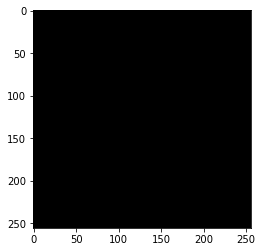

In [281]:
plt.imshow(mo_1)
plt.show()

#### 对每次输入的图片进行尺寸统一


### lb_lj_ng_list[6]

## 填充数据

### 计算长和宽的差值
dim_diff = np.abs(dissa.shape[0]-dissa.shape[1])  

### 计算上下左右分别需要填充多少个维度
pad1, pad2 = dim_diff // 2, dim_diff - dim_diff // 2
pad = (0, 0, pad1, pad2) if high <= width else (pad1, pad2, 0, 0)
top, bottom, left, right = pad

### 使用opencv的copyMakeBorder函数进行填充
pad_value = 0
img_pad = cv2.copyMakeBorder(img, top, bottom, left, right, cv2.BORDER_CONSTANT, None, pad_value)
print(img_dst.shape)

In [ ]:
from __future__ import division
import numpy as np

"""
This dataset is part of MNIST dataset,but there is only 3 classes,classes = {0:'0',1:'1',2:'2'},
and images are compressed to 14*14  pixels and stored in a matrix with the corresponding label, 
at the end the shape of the data matrix is num_of_images x 14*14(pixels)+1(lable)
"""

def load_data(split_ratio):
    tmp=np.load("data.npy")
    data=tmp[:,:-1]         
    label=tmp[:,-1]
    
    #取除最后一列的数据，因为最后一列数据为标签
    #二维的   行是图片的个数，列是
    
    mean_data=np.mean(data,axis=0)           #算出数据集在每个像素点的平均灰度   80%train  20%test
    train_data=data[int(split_ratio * data.shape[0]):]-mean_data
    train_label=label[int(split_ratio * data.shape[0]):]
    
    test_data=data[:int(split_ratio*data.shape[0])]-mean_data
    test_label=label[:int(split_ratio*data.shape[0])]
    return train_data,train_label,test_data,test_label


"""
compute the hingle loss without using vector operation,   ##向量运算
While dealing with a huge dataset（庞大的数据集）,this will have low efficiency（效率） 
X's shape [n,14*14+1],Y's shape [n,],W's shape [num_class,14*14+1]

"""
def lossAndGradNaive(X,Y,W,reg):
    dW=np.zeros(W.shape)
    loss = 0.0
    num_class=W.shape[0]   # 类别个数 3
    num_X=X.shape[0]       #图形个数  128
    for i in range(num_X):   #取每个图片  
        scores=np.dot(W,X[i])  #计算每张图片的各类得分
        cur_scores=scores[int(Y[i])]  #取出对应的类别 的得分 
        for j in range(num_class):   #遍历类别
            if j==Y[i]:              #更新得分
                continue
            margin=scores[j]-cur_scores+1   #其他类得分与本类得分的差值
            if margin>0:                    #如果有其他类高过本类
                loss+=margin                #损失加给他
                dW[j,:]+=X[i]               #对应权重 a += b  就相当于  a = a + b  加上x的值
                dW[int(Y[i]),:]-=X[i]       #再本身的x的值加上去
#                                           # 根据公式：  ∇Wyi   Li = - xiT(∑j≠yi1(xiWj - xiWyi +1>0)) + 2λWyi
#                                           dW[:, y[i]] += -X[i, :]   # y[i] 是正确的类
#                                           # 根据公式：  ∇Wj    Li = xiT 1(xiWj - xiWyi +1>0) + 2λWj ,
#                                           dW[:, j] += X[i, :]       
                                            
    loss/=num_X
    dW/=num_X
    loss+=reg*np.sum(W*W)                  #正则损失项                       
    dW+=2*reg*W                            #算的是步长                     
    return loss,dW                         

###因为一组样本，甚至可以有好多个决策界限   

# w1会有好几种取值的可能，取出来的值都可以使该样本在分类时的得分完全满足损失函数的要求

#加了正则损失项后，模型就有了偏好

#没迭代一次样本，更新一次w？
#iterations（迭代）：每一次迭代都是一次权重更新，每一次权重更新需要batch_size个数据进行Forward运算得到损失函数，
# 再BP算法更新参数。 1个iteration等于使用batchsize个样本训练一次。

def lossAndGradVector(X,Y,W,reg):
    dW=np.zeros(W.shape)
    N=X.shape[0]
    Y_=X.dot(W.T)
    margin=Y_-Y_[range(N),Y.astype(int)].reshape([-1,1])+1.0
    margin[range(N),Y.astype(int)]=0.0
    margin=(margin>0)*margin
    loss=0.0
    loss+=np.sum(margin)/N
    loss+=reg*np.sum(W*W)
    
    """For one data,the X[Y[i]] has to be substracted several times"""
    countsX=(margin>0).astype(int)
    countsX[range(N),Y.astype(int)]=-np.sum(countsX,axis=1)
    dW+=np.dot(countsX.T,X)/N+2*reg*W
    return loss,dW

def predict(X,W):                                   #图像集和每次迭代后的
    X=np.hstack([X,np.ones((X.shape[0],1))])        #生成一个没有类别的数据集 
    Y_=np.dot(X,W.T)                                #算出每张照片的得分       
    Y_pre=np.argmax(Y_,axis=1)                      #取出每找照片最大值的索引  128*1
    return Y_pre

def accuracy(X,Y,W):
    Y_pre=predict(X,W)                                    
    acc=(Y_pre==Y).mean()
    return acc

def model(X,Y,alpha,steps,reg):
    X=np.hstack([X,np.ones((X.shape[0], 1))])      #代入模型中的数据
    W = np.random.randn(3,X.shape[1]) * 0.0001      #生成初始的w矩阵
    for step in range(steps):                       #循环的次数
        loss,grad=lossAndGradNaive(X,Y,W,reg)
        W-=alpha*grad                               #学习率乘以梯度值    所有的样本已经过了一遍了  爱情对我的消息
        print("The {} step,loss={}, accuracy={}".format(step,loss,accuracy(X[:,:-1],Y,W)))
    return


train_data,train_label,test_data,test_label=load_data(0.2)
W=model(train_data,train_label,0.0001,25,0.5)
print("Test accuracy of the model is {}".format(accuracy(test_data,test_label,W)))    ###输出测试集的损失和占比  结束掉这个算法

In [75]:
print('size:',data.size)

size: 136006351


In [76]:
data.nbytes    # 20

544025404

In [84]:
print(type(data))   

<class 'numpy.ndarray'>


In [90]:
data.shape[0]*data.shape[1]

136006351

In [94]:
136006351*24/1024/1024

3112.938331604004

In [ ]:
sys.getsizeof(data)/1024/1024   

In [95]:
a=4
print(sys.getsizeof(a))     

28


In [104]:
data[0][1].size

1

In [105]:
data.size

136006351

In [88]:
import sys
print(sys.getsizeof(m)/1024/1024)           #MB大小  
print(sys.getsizeof(data)/1024/1024)     
print(sys.getsizeof(train_data)/1024/1024)
print(sys.getsizeof(test_data)/1024/1024)         

1.1251373291015625
518.823169708252
830.2670059204102
207.37933349609375


In [82]:
def test():
    nums = []
    for _ in range(900000):
        nums.append(np.random.randn())
    nums1 = np.array(nums)
    print(round(sys.getsizeof(nums)/1024/1024,2))   #7.37M
    print(round(sys.getsizeof(nums1)/1024/1024,2))  #6.87M--准确大小

0.70625

In [83]:
test()

7.37
6.87


In [ ]:
#对步长进行训练  输出一个正常与否
#涨到20块钱
#爱情丢在了最远处
#最基本的就是他的类是从0开始的,1是它的爱情

In [ ]:
a=w * X
w(10,100)
x(100,1)

In [48]:
a=np.array([[1,2,11],[2,4,3],[4,6,11],[5,4,1]])
b=np.array([[1],[2],[2],[1]])

In [49]:
np.argmax(a,axis=1)  

array([2, 1, 2, 0], dtype=int64)

In [51]:
a==b   

array([[ True, False, False],
       [ True, False, False],
       [False, False, False],
       [False, False,  True]])

In [ ]:
a=[1,0,0,0]
b=[0.25,0.25,0.25,0.25]
x=[1,1,1,1]
#w有2个权重，但是算出来的得分是一样的，那我应该怎样选择呢?
#如果我选择第二个，那就是可以让我的模型有偏好

In [24]:
a=[[1],[2],[3],[2],[2],[1]]
b=[[1],[2],[2],[1],[2],[3]]

In [27]:
(a==b).mean()

AttributeError: 'bool' object has no attribute 'mean'

In [213]:
test_data

array([[-4.51319118, -4.51319118, -4.51319118, ..., -0.17925551,
        -0.17925551,  0.        ],
       [-4.51319118, -4.51319118, -4.51319118, ..., -0.17925551,
        -0.17925551,  0.        ],
       [77.48680882, 77.48680882, 77.48680882, ..., -0.17925551,
        -0.17925551,  0.        ],
       ...,
       [-4.51319118, -4.51319118, -4.51319118, ..., -0.17925551,
        -0.17925551,  0.        ],
       [-4.51319118, -4.51319118, -4.51319118, ..., -0.17925551,
        -0.17925551,  0.        ],
       [-4.51319118, -4.51319118, -4.51319118, ..., -0.17925551,
        -0.17925551,  0.        ]])

In [22]:
np.array()

9.600000000000001

In [110]:
woshuo=np.ones((10,6,3))
woshuo[1]

array([[1., 1., 1.],
       [1., 1., 1.],
       [1., 1., 1.],
       [1., 1., 1.],
       [1., 1., 1.],
       [1., 1., 1.]])

In [112]:
m.shape

(3, 49153)

In [113]:
m[1:20]

array([[-6.78986359e-06,  1.87244335e-06,  5.46672964e-06, ...,
        -5.41277499e-06,  1.19292572e-05, -5.11365864e-06],
       [ 1.00755064e-05, -1.15688475e-05, -4.44626311e-07, ...,
         3.82902544e-06, -2.09869774e-06,  5.68606964e-06]])

In [114]:
np.sum(m)

0.0009673848624159828

In [118]:
cengj=[[-6.78986359e-06,  1.87244335e-06,  5.46672964e-06,
-5.41277499e-06,  1.19292572e-05, -5.11365864e-06],
[ 1.00755064e-05, -1.15688475e-05, -4.44626311e-07,
3.82902544e-06, -2.09869774e-06,  5.68606964e-06]]

In [122]:
cengj

[[-6.78986359e-06,
  1.87244335e-06,
  5.46672964e-06,
  -5.41277499e-06,
  1.19292572e-05,
  -5.11365864e-06],
 [1.00755064e-05,
  -1.15688475e-05,
  -4.44626311e-07,
  3.82902544e-06,
  -2.09869774e-06,
  5.68606964e-06]]

In [121]:
np.array(cengj).shape

(2, 6)

In [126]:
cejin_=np.array([1.00755064e-05,-1.15688475e-05,-4.44626311e-07,3.82902544e-06, -2.09869774e-06,5.68606964e-06])

In [127]:
cejin_.shape

(6,)

In [129]:
aiqings=np.array(cejin_)

In [130]:
aiqings.shape

(6,)